In [42]:
from math import ceil
import numpy as np
import time
import os

import tensorflow as tf
from tensorflow.examples.tutorials.mnist import input_data

from matplotlib import pyplot as plt
%matplotlib inline

In [3]:
x_height, x_width = [28, 28]
num_channels = 1
num_classes = 10
latent_size = 100
labeled_rate = 0.1

log_path = './SSL_GAN_log.csv'
model_path ='./SSL_GAN_model.ckpt'

In [4]:
def normalize(x):
    # normalize data
    x = (x - 127.5) / 127.5
    return x.reshape((-1, x_height, x_width, 1))

In [5]:
 def get_data():
    # MNIST data
    mnist_data = input_data.read_data_sets('mnist_data', one_hot = True)
    return mnist_data

In [6]:
def D(x, dropout_rate, is_training, reuse = True, print_summary = True):
    # discriminator (x -> n + 1 class)

    with tf.variable_scope('Discriminator', reuse = reuse) as scope:
        # layer1 - do not use Batch Normalization on the first layer of Discriminator
        conv1 = tf.layers.conv2d(x, 32, [5, 5],
                                 strides = [2, 2],
                                 padding = 'same')
        lrelu1 = tf.maximum(0.2 * conv1, conv1) #leaky relu
        dropout1 = tf.layers.dropout(lrelu1, dropout_rate)

        # layer2
        conv2 = tf.layers.conv2d(dropout1, 64, [3, 3],
                                 strides = [2, 2],
                                 padding = 'same')
        batch_norm2 = tf.layers.batch_normalization(conv2, training = is_training)
        lrelu2 = tf.maximum(0.2 * batch_norm2, batch_norm2)

        # layer3
        conv3 = tf.layers.conv2d(lrelu2, 128, [2, 2],
                                 strides = [2, 2],
                                 padding = 'same')
        batch_norm3 = tf.layers.batch_normalization(conv3, training = is_training)
        lrelu3 = tf.maximum(0.2 * batch_norm3, batch_norm3)
        dropout3 = tf.layers.dropout(lrelu3, dropout_rate)

        # layer 4
        conv4 = tf.layers.conv2d(dropout3, 128, [2, 2],
                                 strides = [2, 2],
                                 padding = 'same')
        # do not use batch_normalization on this layer - next layer, "flatten5",
        # will be used for "Feature Matching"
        lrelu4 = tf.maximum(0.2 * conv4, conv4)

        # layer 5
        flatten_length = lrelu4.get_shape().as_list()[1] * \
                         lrelu4.get_shape().as_list()[2] * lrelu4.get_shape().as_list()[3]
        flatten5 = tf.reshape(lrelu4, (-1, flatten_length)) # used for "Feature Matching" 
        fc5 = tf.layers.dense(flatten5, (num_classes + 1))
        output = tf.nn.softmax(fc5)

        assert output.get_shape()[1:] == [num_classes + 1]

        if print_summary:
            print('Discriminator summary:\n x: %s\n' \
                  ' D1: %s\n D2: %s\n D3: %s\n D4: %s\n' %(x.get_shape(), 
                                                           dropout1.get_shape(),
                                                           lrelu2.get_shape(), 
                                                           dropout3.get_shape(),
                                                           lrelu4.get_shape()))
        return flatten5, fc5, output

In [7]:
def G(z, is_training, reuse = False, print_summary = False):
    # generator (z -> x)

    with tf.variable_scope('Generator', reuse = reuse) as scope:
        # layer 0
        z_reshaped = tf.reshape(z, [-1, 1, 1, latent_size])

        # layer 1
        deconv1 = tf.layers.conv2d_transpose(z_reshaped,
                                             filters = latent_size,
                                             kernel_size = [2, 2],
                                             strides = [1, 1],
                                             padding = 'valid')
        batch_norm1 = tf.layers.batch_normalization(deconv1, training = is_training)
        relu1 = tf.nn.relu(batch_norm1)

        # layer 2
        deconv2 = tf.layers.conv2d_transpose(relu1,
                                             filters = 64,
                                             kernel_size = [3, 3],
                                             strides = [2, 2],
                                             padding = 'valid')
        batch_norm2 = tf.layers.batch_normalization(deconv2, training = is_training)
        relu2 = tf.nn.relu(batch_norm2)

        # layer 3
        deconv3 = tf.layers.conv2d_transpose(relu2,
                                             filters = 32,
                                             kernel_size = [4, 4],
                                             strides = [2, 2],
                                             padding = 'valid')
        batch_norm3 = tf.layers.batch_normalization(deconv3, training = is_training)
        relu3 = tf.nn.relu(batch_norm3)

        # layer 4 - do not use Batch Normalization on the last layer of Generator
        deconv4 = tf.layers.conv2d_transpose(relu3,
                                             filters = num_channels,
                                             kernel_size = [6, 6],
                                             strides = [2, 2],
                                             padding = 'valid')
        tanh4 = tf.tanh(deconv4)

        assert tanh4.get_shape()[1:] == [x_height, x_width, num_channels]
        if print_summary:
            print('Generator summary:\n z: %s\n' \
                  ' G0: %s\n G1: %s\n G2: %s\n G3: %s\n G4: %s\n' %(z.get_shape(),
                                                                    z_reshaped.get_shape(),
                                                                    relu1.get_shape(),
                                                                    relu2.get_shape(),
                                                                    relu3.get_shape(),
                                                                    tanh4.get_shape()))
        return tanh4

In [8]:
def build_model(x_real, z, label, dropout_rate, is_training, print_summary = False):
    # build model
    D_real_features, D_real_logit, D_real_prob = D(x_real, dropout_rate, is_training,
                                                   reuse = False, print_summary = print_summary)
    x_fake = G(z, is_training, reuse = False, print_summary = print_summary)
    D_fake_features, D_fake_logit, D_fake_prob = D(x_fake, dropout_rate, is_training,
                                                   reuse = True, print_summary = print_summary)

    return D_real_features, D_real_logit, D_real_prob, D_fake_features, D_fake_logit, D_fake_prob, x_fake

In [9]:
def prepare_labels(label):
    # add extra label for fake data
    extended_label = tf.concat([label, tf.zeros([tf.shape(label)[0], 1])], axis = 1)

    return extended_label

In [67]:
def loss_accuracy(D_real_features, D_real_logit, D_real_prob, D_fake_features,
                  D_fake_logit, D_fake_prob, extended_label, labeled_mask):
    epsilon = 1e-8 # used to avoid NAN loss
    # *** Discriminator loss ***
    # supervised loss
    # which class the real data belongs to
    tmp = tf.nn.softmax_cross_entropy_with_logits(logits = D_real_logit,
                                              labels = extended_label)
    D_L_supervised = tf.reduce_sum(labeled_mask * tmp) / (tf.reduce_sum(labeled_mask) + epsilon) # to ignore
                                                                                                 # unlabeled
                                                                                                 # data

    # unsupervised loss
    # data is real
    prob_real_be_real = 1 - D_real_prob[:, -1] + epsilon
    tmp_log = tf.log(prob_real_be_real)
    D_L_unsupervised1 = -1 * tf.reduce_mean(tmp_log)

    # data is fake
    prob_fake_be_fake = D_fake_prob[:, -1] + epsilon
    tmp_log = tf.log(prob_fake_be_fake)
    D_L_unsupervised2 = -1 * tf.reduce_mean(tmp_log)

    D_L = D_L_supervised + D_L_unsupervised1 + D_L_unsupervised2

    # *** Generator loss ***
    # fake data is mistaken to be real
    prob_fake_be_real = 1 - D_fake_prob[:, -1] + epsilon
    tmp_log =  tf.log(prob_fake_be_real)
    G_L1 = -1 * tf.reduce_mean(tmp_log)

    # Feature Maching
    tmp1 = tf.reduce_mean(D_real_features, axis = 0)
    tmp2 = tf.reduce_mean(D_fake_features, axis = 0)
    G_L2 = tf.reduce_mean(tf.square(tmp1 - tmp2))

    G_L = G_L1 + G_L2

    # accuracy
    correct_prediction = tf.equal(tf.argmax(D_real_prob[:, :-1], 1),
                                  tf.argmax(extended_label[:, :-1], 1))
    accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))

    return D_L_supervised, D_L_unsupervised1, D_L_unsupervised2, D_L, G_L, accuracy

In [68]:
def optimizer(D_Loss, G_Loss, D_learning_rate, G_learning_rate):
    # D and G optimizer
    extra_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    with tf.control_dependencies(extra_update_ops):
        all_vars = tf.trainable_variables()
        D_vars = [var for var in all_vars if var.name.startswith('Discriminator')]
        G_vars = [var for var in all_vars if var.name.startswith('Generator')]

        D_optimizer = tf.train.AdamOptimizer(D_learning_rate).minimize(D_Loss, var_list = D_vars)
        G_optimizer = tf.train.AdamOptimizer(G_learning_rate).minimize(G_Loss, var_list = G_vars)
        return D_optimizer, G_optimizer

In [83]:
def plot_fake_data(data, grid_size = [5, 5]):
    # visualize some data generated by G
    _, axes = plt.subplots(figsize = grid_size, nrows = grid_size[0], ncols = grid_size[1],
                           sharey = True, sharex = True)

    size = grid_size[0] * grid_size[1]
    index = np.int_(np.random.uniform(0, data.shape[0], size = (size)))
    figs = data[index].reshape(-1, x_height, x_width)

    for idx, ax in enumerate(axes.flatten()):
        ax.axis('off')
        ax.imshow(figs[idx], cmap = 'gray')
    plt.tight_layout()
    plt.show()

In [84]:
def save_model_on_imporvemnet(file_path, sess, cv_acc, cv_accs):
  #  # save model when there is improvemnet in cv_acc value
    if cv_accs == [] or cv_acc > np.max(cv_accs):
        saver = tf.train.Saver(max_to_keep = 1)
        saver.save(sess, file_path)
        print('Model saved')
    print('')

In [91]:
def get_labled_mask(labeled_rate, batch_size, use_special, batch_with_special=False):
    # get labeled mask to mask some data unlabeled
    labeled_mask = np.zeros([batch_size], dtype = np.float32)
    if use_special:
        if not batch_with_special:
            return labeled_mask 
        labeled_mask[special_indexes] = 1.0
    else:
        true_labeled_count = batch_size * labeled_rate
        labeled_count = int(true_labeled_count)
        labeled_count += int(np.random.random() < true_labeled_count - labeled_count)
        labeled_mask[range(labeled_count)] = 1.0
    #np.random.shuffle(labeled_mask)

    return labeled_mask

In [92]:
def log_loss_acc(file_path, epoch, train_loss_D, train_loss_G, train_Acc,
                 cv_loss_D, cv_loss_G, cv_Acc, log_mode = 'a'):
    # log train and cv losses as well as accuracy
    mode = log_mode if epoch == 0 else 'a'

    with open(file_path, mode) as f:
        if mode == 'w':
            header = 'epoch, train_loss_D, train_loss_G,' \
                     'train_Acc, cv_loss_D, cv_loss_G, cv_Acc\n'
            f.write(header)

        line = '%d, %f, %f, %f, %f, %f, %f\n' %(epoch, train_loss_D, train_loss_G, train_Acc,
                                                cv_loss_D, cv_loss_G, cv_Acc)
        f.write(line)

In [93]:
def train_SSL_GAN(batch_size, epochs):
    # train Semi-Supervised Learning GAN
    train_D_losses, train_G_losses, train_Accs = [], [], []
    cv_D_losses, cv_G_losses, cv_Accs = [], [], []

    tf.reset_default_graph()

    x = tf.placeholder(tf.float32, name = 'x', shape = [None, x_height, x_width, num_channels])
    label = tf.placeholder(tf.float32, name = 'label', shape = [None, num_classes])
    labeled_mask = tf.placeholder(tf.float32, name = 'labeled_mask', shape = [None])
    z = tf.placeholder(tf.float32, name = 'z', shape = [None, latent_size])
    dropout_rate = tf.placeholder(tf.float32, name = 'dropout_rate')
    is_training = tf.placeholder(tf.bool, name = 'is_training')
    G_learning_rate = tf.placeholder(tf.float32, name = 'G_learning_rate')
    D_learning_rate = tf.placeholder(tf.float32, name = 'D_learning_rate')

    model = build_model(x, z, label, dropout_rate, is_training, print_summary = True)
    D_real_features, D_real_logit, D_real_prob, D_fake_features, D_fake_logit, D_fake_prob, fake_data = model
    extended_label = prepare_labels(label)
    loss_acc  = loss_accuracy(D_real_features, D_real_logit, D_real_prob,
                              D_fake_features, D_fake_logit, D_fake_prob,
                              extended_label, labeled_mask)
    _, _, _, D_L, G_L, accuracy = loss_acc
    D_optimizer, G_optimizer = optimizer(D_L, G_L, G_learning_rate, D_learning_rate)

    print('training....')

    with tf.Session() as sess:       
        sess.run(tf.global_variables_initializer())
        mnist_set = get_data()

        for epoch in range(epochs):
            t_total = 0
            for iter in range(ceil(mnist_set.train.images.shape[0] / batch_size)):
                t_start = time.time()
                batch = mnist_set.train.next_batch(batch_size, shuffle = False)
                batch_z = np.random.uniform(-1.0, 1.0, size = (batch_size, latent_size))
                mask = get_labled_mask(labeled_rate, batch_size, bool(special_indexes), iter==0)
                test = batch[1][mask.astype(bool)]
                train_feed_dictionary = {x:  normalize(batch[0]),
                                         z: batch_z,
                                         label: batch[1],
                                         labeled_mask: mask,
                                         dropout_rate: 0.5,
                                         G_learning_rate: 1e-5,
                                         D_learning_rate: 1e-5,
                                         is_training: True}

                D_optimizer.run(feed_dict = train_feed_dictionary)
                G_optimizer.run(feed_dict = train_feed_dictionary)

                train_D_loss = D_L.eval(feed_dict = train_feed_dictionary)
                train_G_loss = G_L.eval(feed_dict = train_feed_dictionary)
                train_accuracy = accuracy.eval(feed_dict = train_feed_dictionary)
                t_total += (time.time() - t_start)

                print('epoch: %d, time: %f | train_G_Loss: %f, ' \
                      'train_D_loss: %f, train_acc: %f' %(epoch, t_total,
                                                          train_G_loss, train_D_loss,
                                                          train_accuracy), end = '\r')
            train_D_losses.append(train_D_loss)
            train_G_losses.append(train_G_loss)
            train_Accs.append(train_accuracy)

            # Cross-Validation
            cv_size = mnist_set.test.labels.shape[0]
            cv_batch_z = np.random.uniform(-1.0, 1.0, size = (cv_size, latent_size))
            mask = get_labled_mask(1, cv_size, False)
            cv_feed_dictionary = {x: normalize(mnist_set.test.images),
                                  z: cv_batch_z,
                                  label: mnist_set.test.labels,
                                  labeled_mask: mask,
                                  dropout_rate: 0.0,
                                  is_training: False}

            cv_D_loss = D_L.eval(feed_dict = cv_feed_dictionary)
            cv_G_loss = G_L.eval(feed_dict = cv_feed_dictionary)
            cv_accuracy = accuracy.eval(feed_dict = cv_feed_dictionary)

            log_loss_acc(log_path, epoch, train_D_loss, train_G_loss, train_accuracy,
                         cv_D_loss, cv_G_loss, cv_accuracy, log_mode = 'w')
            print('\ncv_G_Loss: %f, cv_D_loss: %f, cv_acc: %f' %(cv_G_loss,
                                                                 cv_D_loss,
                                                                 cv_accuracy))
            save_model_on_imporvemnet(model_path, sess, cv_accuracy, cv_Accs)
            cv_D_losses.append(cv_D_loss)
            cv_G_losses.append(cv_G_loss)
            cv_Accs.append(cv_accuracy)

            if epoch % 10 == 0:
                fakes = fake_data.eval(feed_dict = cv_feed_dictionary)
                plot_fake_data(fakes, [5, 5])

    return train_D_losses, train_G_losses, train_Accs, cv_D_losses, cv_G_losses, cv_Accs

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

Generator summary:
 z: (?, 100)
 G0: (?, 1, 1, 100)
 G1: (?, 2, 2, 100)
 G2: (?, 5, 5, 64)
 G3: (?, 12, 12, 32)
 G4: (?, 28, 28, 1)

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

training....
Extracting mnist_data\train-images-idx3-ubyte.gz
Extracting mnist_data\train-labels-idx1-ubyte.gz
Extracting mnist_data\t10k-images-idx3-ubyte.gz
Extracting mnist_data\t10k-labels-idx1-ubyte.gz
epoch: 0, time: 6.144967 | train_G_Loss: 0.318730, train_D_loss: 4.481139, train_acc: 0.107422
cv_G_Loss: 0.292365, cv_D_loss: 4.370147, cv_acc: 0.098000
Model saved



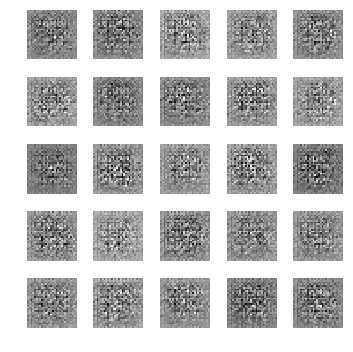

epoch: 1, time: 5.009204 | train_G_Loss: 0.353703, train_D_loss: 4.720971, train_acc: 0.101562
cv_G_Loss: 0.998192, cv_D_loss: 4.193202, cv_acc: 0.102800
Model saved

epoch: 2, time: 5.129424 | train_G_Loss: 0.419427, train_D_loss: 4.998209, train_acc: 0.111328
cv_G_Loss: 1.479385, cv_D_loss: 4.045045, cv_acc: 0.102800

epoch: 3, time: 5.024029 | train_G_Loss: 0.613900, train_D_loss: 1.276727, train_acc: 0.111328
cv_G_Loss: 2.502373, cv_D_loss: 4.050542, cv_acc: 0.102800

epoch: 4, time: 5.001459 | train_G_Loss: 0.872791, train_D_loss: 3.313154, train_acc: 0.101562
cv_G_Loss: 3.696443, cv_D_loss: 4.203012, cv_acc: 0.102800

epoch: 5, time: 4.982966 | train_G_Loss: 1.149647, train_D_loss: 0.656731, train_acc: 0.109375
cv_G_Loss: 4.706063, cv_D_loss: 4.571195, cv_acc: 0.102800

epoch: 6, time: 5.061508 | train_G_Loss: 1.329325, train_D_loss: 3.006792, train_acc: 0.109375
cv_G_Loss: 5.470274, cv_D_loss: 4.808558, cv_acc: 0.102800

epoch: 7, time: 5.043177 | train_G_Loss: 1.390438, train_D

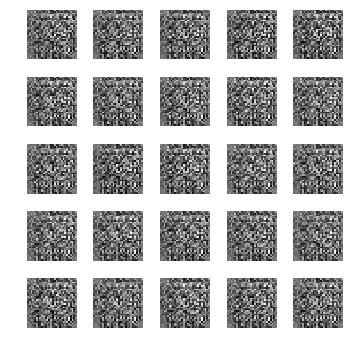

epoch: 11, time: 5.010890 | train_G_Loss: 2.055477, train_D_loss: 0.247380, train_acc: 0.132812
cv_G_Loss: 8.941488, cv_D_loss: 7.123857, cv_acc: 0.114800
Model saved

epoch: 12, time: 5.084561 | train_G_Loss: 2.345270, train_D_loss: 2.782741, train_acc: 0.121094
cv_G_Loss: 9.340755, cv_D_loss: 7.481768, cv_acc: 0.103200

epoch: 13, time: 5.052163 | train_G_Loss: 2.543370, train_D_loss: 2.549311, train_acc: 0.111328
cv_G_Loss: 9.939366, cv_D_loss: 7.741049, cv_acc: 0.103200

epoch: 14, time: 5.085487 | train_G_Loss: 2.612372, train_D_loss: 0.143889, train_acc: 0.111328
cv_G_Loss: 10.586220, cv_D_loss: 8.345862, cv_acc: 0.103200

epoch: 15, time: 4.967688 | train_G_Loss: 2.785524, train_D_loss: 2.654509, train_acc: 0.111328
cv_G_Loss: 11.496770, cv_D_loss: 8.676579, cv_acc: 0.095800

epoch: 16, time: 4.992752 | train_G_Loss: 2.730329, train_D_loss: 0.131322, train_acc: 0.107422
cv_G_Loss: 12.578347, cv_D_loss: 8.516414, cv_acc: 0.095800

epoch: 17, time: 5.049152 | train_G_Loss: 2.76395

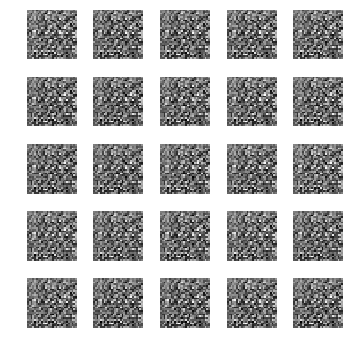

epoch: 21, time: 5.054694 | train_G_Loss: 3.117523, train_D_loss: 0.083389, train_acc: 0.091797
cv_G_Loss: 17.329567, cv_D_loss: 10.730324, cv_acc: 0.089200

epoch: 22, time: 5.085158 | train_G_Loss: 3.199215, train_D_loss: 2.030288, train_acc: 0.089844
cv_G_Loss: 17.355740, cv_D_loss: 11.159096, cv_acc: 0.089200

epoch: 23, time: 5.046616 | train_G_Loss: 3.252710, train_D_loss: 0.073466, train_acc: 0.103516
cv_G_Loss: 17.372372, cv_D_loss: 11.665774, cv_acc: 0.089200

epoch: 24, time: 5.035583 | train_G_Loss: 3.326223, train_D_loss: 2.125321, train_acc: 0.109375
cv_G_Loss: 17.636806, cv_D_loss: 11.804878, cv_acc: 0.089200

epoch: 25, time: 5.148356 | train_G_Loss: 3.177549, train_D_loss: 1.843964, train_acc: 0.101562
cv_G_Loss: 17.629951, cv_D_loss: 12.114393, cv_acc: 0.089200

epoch: 26, time: 5.007374 | train_G_Loss: 3.123250, train_D_loss: 2.599317, train_acc: 0.101562
cv_G_Loss: 17.806337, cv_D_loss: 11.818071, cv_acc: 0.089200

epoch: 27, time: 5.028913 | train_G_Loss: 3.349234, 

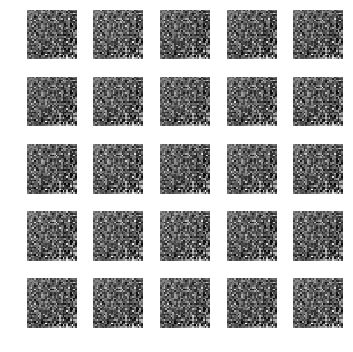

epoch: 31, time: 5.069199 | train_G_Loss: 3.361150, train_D_loss: 0.064906, train_acc: 0.085938
cv_G_Loss: 18.979549, cv_D_loss: 10.579744, cv_acc: 0.089200

epoch: 32, time: 5.010327 | train_G_Loss: 3.212663, train_D_loss: 0.075120, train_acc: 0.111328
cv_G_Loss: 17.674339, cv_D_loss: 11.306803, cv_acc: 0.089200

epoch: 33, time: 4.979758 | train_G_Loss: 3.313599, train_D_loss: 2.207917, train_acc: 0.126953
cv_G_Loss: 17.304176, cv_D_loss: 11.291400, cv_acc: 0.089200

epoch: 34, time: 4.934388 | train_G_Loss: 3.350365, train_D_loss: 0.065634, train_acc: 0.095703
cv_G_Loss: 16.712557, cv_D_loss: 10.225579, cv_acc: 0.089200

epoch: 35, time: 4.943204 | train_G_Loss: 3.199929, train_D_loss: 0.076271, train_acc: 0.109375
cv_G_Loss: 15.454479, cv_D_loss: 10.257808, cv_acc: 0.089200

epoch: 36, time: 4.943046 | train_G_Loss: 3.072467, train_D_loss: 0.084295, train_acc: 0.125000
cv_G_Loss: 14.204553, cv_D_loss: 9.703440, cv_acc: 0.089200

epoch: 37, time: 4.948794 | train_G_Loss: 3.022254, t

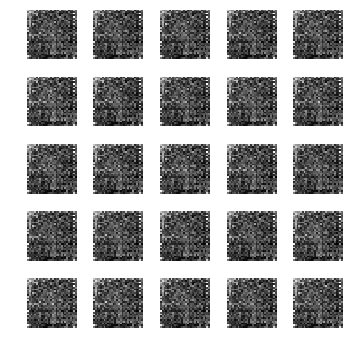

epoch: 41, time: 4.980719 | train_G_Loss: 2.310624, train_D_loss: 2.346870, train_acc: 0.091797
cv_G_Loss: 6.980781, cv_D_loss: 10.788218, cv_acc: 0.101000

epoch: 42, time: 4.928226 | train_G_Loss: 2.275295, train_D_loss: 0.193423, train_acc: 0.099609
cv_G_Loss: 6.356666, cv_D_loss: 11.608401, cv_acc: 0.084900

epoch: 43, time: 4.940125 | train_G_Loss: 2.225624, train_D_loss: 2.544471, train_acc: 0.121094
cv_G_Loss: 5.841475, cv_D_loss: 12.521991, cv_acc: 0.100200

epoch: 44, time: 4.953100 | train_G_Loss: 2.088798, train_D_loss: 0.236275, train_acc: 0.097656
cv_G_Loss: 4.821164, cv_D_loss: 11.300810, cv_acc: 0.101000

epoch: 45, time: 4.925363 | train_G_Loss: 1.721977, train_D_loss: 2.444750, train_acc: 0.097656
cv_G_Loss: 3.586524, cv_D_loss: 9.435188, cv_acc: 0.101000

epoch: 46, time: 4.928276 | train_G_Loss: 1.953171, train_D_loss: 3.035937, train_acc: 0.085938
cv_G_Loss: 3.527175, cv_D_loss: 11.522010, cv_acc: 0.101000

epoch: 47, time: 4.934939 | train_G_Loss: 1.864872, train_D

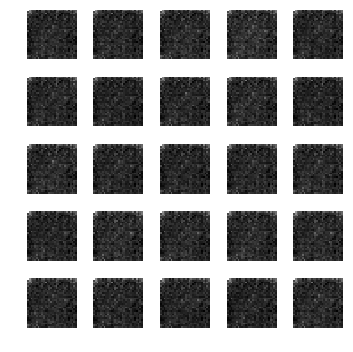

epoch: 51, time: 4.958351 | train_G_Loss: 1.407590, train_D_loss: 2.835834, train_acc: 0.091797
cv_G_Loss: 1.663463, cv_D_loss: 10.188852, cv_acc: 0.101000

epoch: 52, time: 4.934101 | train_G_Loss: 1.209610, train_D_loss: 2.846276, train_acc: 0.103516
cv_G_Loss: 1.509441, cv_D_loss: 8.561625, cv_acc: 0.089200

epoch: 53, time: 4.917767 | train_G_Loss: 1.413385, train_D_loss: 2.993363, train_acc: 0.111328
cv_G_Loss: 1.841396, cv_D_loss: 9.891273, cv_acc: 0.100800

epoch: 54, time: 4.926067 | train_G_Loss: 1.240472, train_D_loss: 2.991758, train_acc: 0.097656
cv_G_Loss: 1.498700, cv_D_loss: 7.872825, cv_acc: 0.105200

epoch: 55, time: 4.949969 | train_G_Loss: 1.173614, train_D_loss: 0.618705, train_acc: 0.091797
cv_G_Loss: 1.610819, cv_D_loss: 9.068277, cv_acc: 0.101000

epoch: 56, time: 4.978560 | train_G_Loss: 1.320642, train_D_loss: 0.647647, train_acc: 0.111328
cv_G_Loss: 1.549524, cv_D_loss: 9.557782, cv_acc: 0.101000

epoch: 57, time: 4.949444 | train_G_Loss: 1.139003, train_D_los

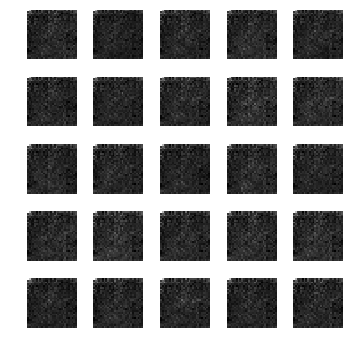

epoch: 61, time: 4.959855 | train_G_Loss: 0.873025, train_D_loss: 3.216532, train_acc: 0.099609
cv_G_Loss: 1.109096, cv_D_loss: 7.854710, cv_acc: 0.096200

epoch: 62, time: 4.922128 | train_G_Loss: 0.940022, train_D_loss: 3.622241, train_acc: 0.091797
cv_G_Loss: 0.950513, cv_D_loss: 7.450129, cv_acc: 0.100800

epoch: 63, time: 4.920489 | train_G_Loss: 0.623314, train_D_loss: 3.479574, train_acc: 0.091797
cv_G_Loss: 0.653256, cv_D_loss: 4.820123, cv_acc: 0.098000

epoch: 64, time: 4.935964 | train_G_Loss: 0.603945, train_D_loss: 3.506360, train_acc: 0.119141
cv_G_Loss: 0.575802, cv_D_loss: 4.978195, cv_acc: 0.121400
Model saved

epoch: 65, time: 4.965382 | train_G_Loss: 1.090200, train_D_loss: 1.036019, train_acc: 0.109375
cv_G_Loss: 1.113162, cv_D_loss: 7.267912, cv_acc: 0.113500

epoch: 66, time: 4.935534 | train_G_Loss: 0.645336, train_D_loss: 3.807329, train_acc: 0.140625
cv_G_Loss: 0.625633, cv_D_loss: 5.538447, cv_acc: 0.101000

epoch: 67, time: 4.943223 | train_G_Loss: 0.691215, 

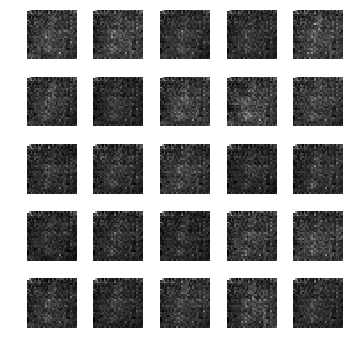

epoch: 71, time: 4.966855 | train_G_Loss: 0.572234, train_D_loss: 3.738607, train_acc: 0.087891
cv_G_Loss: 0.589882, cv_D_loss: 5.182309, cv_acc: 0.095800

epoch: 72, time: 4.928298 | train_G_Loss: 0.452826, train_D_loss: 3.378555, train_acc: 0.119141
cv_G_Loss: 0.293553, cv_D_loss: 4.882350, cv_acc: 0.113500

epoch: 73, time: 4.950039 | train_G_Loss: 0.747435, train_D_loss: 4.167483, train_acc: 0.097656
cv_G_Loss: 0.909424, cv_D_loss: 6.089050, cv_acc: 0.103500

epoch: 74, time: 4.934292 | train_G_Loss: 0.853128, train_D_loss: 1.198627, train_acc: 0.105469
cv_G_Loss: 0.729217, cv_D_loss: 5.376256, cv_acc: 0.095800

epoch: 75, time: 4.943681 | train_G_Loss: 0.572045, train_D_loss: 3.538947, train_acc: 0.117188
cv_G_Loss: 0.557897, cv_D_loss: 5.358756, cv_acc: 0.147000

epoch: 76, time: 4.927436 | train_G_Loss: 0.995357, train_D_loss: 1.321154, train_acc: 0.082031
cv_G_Loss: 1.466391, cv_D_loss: 7.760871, cv_acc: 0.100500

epoch: 77, time: 4.923413 | train_G_Loss: 0.368767, train_D_loss

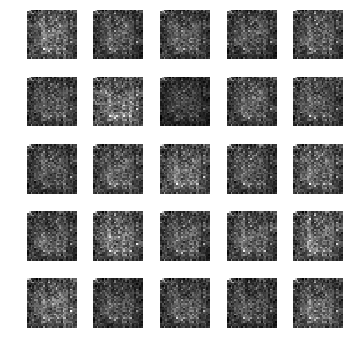

epoch: 81, time: 4.985671 | train_G_Loss: 0.422979, train_D_loss: 4.174996, train_acc: 0.095703
cv_G_Loss: 0.315066, cv_D_loss: 4.668808, cv_acc: 0.095800

epoch: 82, time: 4.941398 | train_G_Loss: 0.564065, train_D_loss: 1.343417, train_acc: 0.117188
cv_G_Loss: 0.628305, cv_D_loss: 4.977290, cv_acc: 0.100900

epoch: 83, time: 4.940247 | train_G_Loss: 0.612623, train_D_loss: 4.333291, train_acc: 0.093750
cv_G_Loss: 0.754820, cv_D_loss: 5.948609, cv_acc: 0.101000

epoch: 84, time: 4.942007 | train_G_Loss: 0.607195, train_D_loss: 4.390600, train_acc: 0.105469
cv_G_Loss: 0.477413, cv_D_loss: 4.800808, cv_acc: 0.102800

epoch: 85, time: 4.947998 | train_G_Loss: 0.344277, train_D_loss: 3.932909, train_acc: 0.105469
cv_G_Loss: 0.272844, cv_D_loss: 4.777677, cv_acc: 0.101200

epoch: 86, time: 4.939677 | train_G_Loss: 0.759365, train_D_loss: 1.345425, train_acc: 0.099609
cv_G_Loss: 0.932774, cv_D_loss: 5.829805, cv_acc: 0.101000

epoch: 87, time: 4.952437 | train_G_Loss: 0.814514, train_D_loss

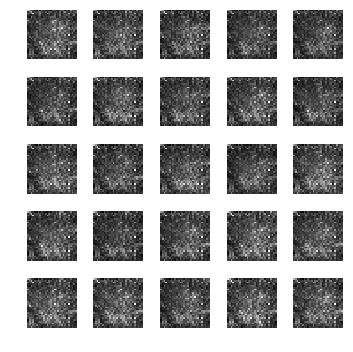

epoch: 91, time: 5.386303 | train_G_Loss: 0.647997, train_D_loss: 1.327233, train_acc: 0.142578
cv_G_Loss: 1.146232, cv_D_loss: 6.088827, cv_acc: 0.101000

epoch: 92, time: 4.913401 | train_G_Loss: 0.629035, train_D_loss: 1.378550, train_acc: 0.105469
cv_G_Loss: 0.409175, cv_D_loss: 4.880073, cv_acc: 0.100900

epoch: 93, time: 4.899523 | train_G_Loss: 0.737314, train_D_loss: 4.255012, train_acc: 0.121094
cv_G_Loss: 0.674830, cv_D_loss: 5.083917, cv_acc: 0.101000

epoch: 94, time: 4.918154 | train_G_Loss: 0.386457, train_D_loss: 4.280133, train_acc: 0.109375
cv_G_Loss: 0.344314, cv_D_loss: 4.657497, cv_acc: 0.118200

epoch: 95, time: 4.905239 | train_G_Loss: 0.508011, train_D_loss: 1.428620, train_acc: 0.113281
cv_G_Loss: 0.519440, cv_D_loss: 5.195223, cv_acc: 0.100900

epoch: 96, time: 4.909909 | train_G_Loss: 0.397058, train_D_loss: 4.260127, train_acc: 0.166016
cv_G_Loss: 0.282852, cv_D_loss: 4.778097, cv_acc: 0.095200

epoch: 97, time: 4.901171 | train_G_Loss: 0.500805, train_D_loss

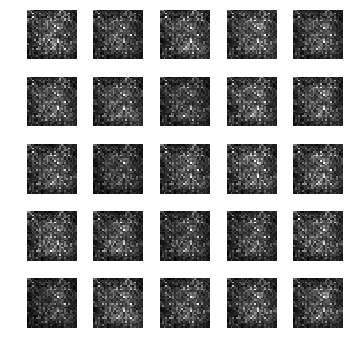

epoch: 101, time: 4.932791 | train_G_Loss: 0.468291, train_D_loss: 4.018030, train_acc: 0.113281
cv_G_Loss: 0.576082, cv_D_loss: 4.698849, cv_acc: 0.101000

epoch: 102, time: 4.893777 | train_G_Loss: 0.580826, train_D_loss: 4.231640, train_acc: 0.095703
cv_G_Loss: 0.464976, cv_D_loss: 4.655916, cv_acc: 0.098200

epoch: 103, time: 4.911188 | train_G_Loss: 0.491270, train_D_loss: 1.435298, train_acc: 0.099609
cv_G_Loss: 0.466882, cv_D_loss: 4.900778, cv_acc: 0.106500

epoch: 104, time: 4.924444 | train_G_Loss: 0.605612, train_D_loss: 4.490839, train_acc: 0.078125
cv_G_Loss: 0.504260, cv_D_loss: 4.816378, cv_acc: 0.089200

epoch: 105, time: 4.909299 | train_G_Loss: 0.673430, train_D_loss: 4.389692, train_acc: 0.087891
cv_G_Loss: 1.387426, cv_D_loss: 6.290581, cv_acc: 0.097400

epoch: 106, time: 4.903117 | train_G_Loss: 0.579257, train_D_loss: 1.410610, train_acc: 0.123047
cv_G_Loss: 0.466239, cv_D_loss: 4.610037, cv_acc: 0.170900

epoch: 107, time: 4.901689 | train_G_Loss: 0.594964, train

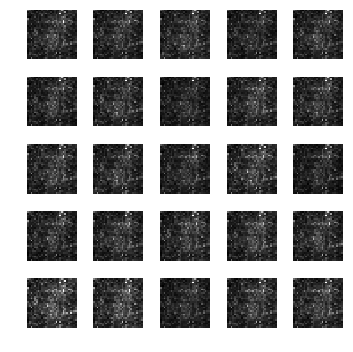

epoch: 111, time: 4.922914 | train_G_Loss: 0.760242, train_D_loss: 1.412030, train_acc: 0.103516
cv_G_Loss: 0.786220, cv_D_loss: 5.256152, cv_acc: 0.097800

epoch: 112, time: 4.916506 | train_G_Loss: 0.459649, train_D_loss: 4.167940, train_acc: 0.085938
cv_G_Loss: 0.404580, cv_D_loss: 4.467805, cv_acc: 0.097400

epoch: 113, time: 4.893494 | train_G_Loss: 0.541735, train_D_loss: 1.423484, train_acc: 0.085938
cv_G_Loss: 0.582746, cv_D_loss: 4.579336, cv_acc: 0.097400

epoch: 114, time: 4.901795 | train_G_Loss: 0.857712, train_D_loss: 1.372137, train_acc: 0.093750
cv_G_Loss: 2.038967, cv_D_loss: 6.719906, cv_acc: 0.100900

epoch: 115, time: 4.906063 | train_G_Loss: 0.428656, train_D_loss: 1.495417, train_acc: 0.099609
cv_G_Loss: 0.376448, cv_D_loss: 4.424252, cv_acc: 0.101000

epoch: 116, time: 4.906027 | train_G_Loss: 0.513099, train_D_loss: 1.430788, train_acc: 0.085938
cv_G_Loss: 0.469192, cv_D_loss: 4.577269, cv_acc: 0.089200

epoch: 117, time: 4.902851 | train_G_Loss: 0.513205, train

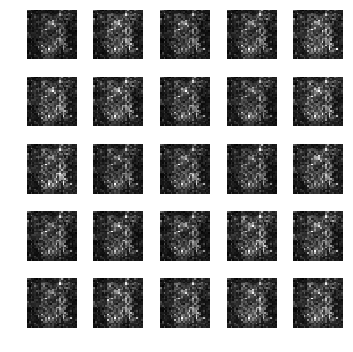

epoch: 121, time: 4.942142 | train_G_Loss: 0.442472, train_D_loss: 4.183219, train_acc: 0.097656
cv_G_Loss: 0.548943, cv_D_loss: 4.439447, cv_acc: 0.089200

epoch: 122, time: 4.889949 | train_G_Loss: 0.449917, train_D_loss: 4.376083, train_acc: 0.097656
cv_G_Loss: 0.440726, cv_D_loss: 4.515902, cv_acc: 0.089200

epoch: 123, time: 4.895126 | train_G_Loss: 0.551579, train_D_loss: 4.589433, train_acc: 0.117188
cv_G_Loss: 0.571920, cv_D_loss: 4.461105, cv_acc: 0.113500

epoch: 124, time: 4.895251 | train_G_Loss: 0.307719, train_D_loss: 4.600079, train_acc: 0.087891
cv_G_Loss: 0.215915, cv_D_loss: 4.497372, cv_acc: 0.087400

epoch: 125, time: 4.904842 | train_G_Loss: 0.824633, train_D_loss: 1.428897, train_acc: 0.105469
cv_G_Loss: 1.681407, cv_D_loss: 6.198131, cv_acc: 0.100900

epoch: 126, time: 4.905680 | train_G_Loss: 0.688796, train_D_loss: 4.676204, train_acc: 0.119141
cv_G_Loss: 0.941184, cv_D_loss: 4.972612, cv_acc: 0.113500

epoch: 127, time: 4.914515 | train_G_Loss: 0.610387, train

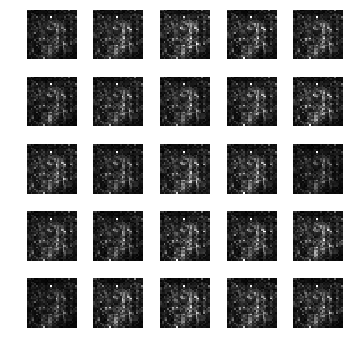

epoch: 131, time: 4.928626 | train_G_Loss: 0.568503, train_D_loss: 4.239914, train_acc: 0.134766
cv_G_Loss: 0.705824, cv_D_loss: 4.665247, cv_acc: 0.103200

epoch: 132, time: 4.892750 | train_G_Loss: 0.565812, train_D_loss: 4.337157, train_acc: 0.111328
cv_G_Loss: 0.778431, cv_D_loss: 4.585527, cv_acc: 0.119300

epoch: 133, time: 4.895577 | train_G_Loss: 0.555090, train_D_loss: 1.427185, train_acc: 0.138672
cv_G_Loss: 0.629004, cv_D_loss: 4.501169, cv_acc: 0.101000

epoch: 134, time: 4.903778 | train_G_Loss: 0.528424, train_D_loss: 3.904719, train_acc: 0.119141
cv_G_Loss: 0.616996, cv_D_loss: 4.571486, cv_acc: 0.098000

epoch: 135, time: 4.885159 | train_G_Loss: 0.467859, train_D_loss: 4.150540, train_acc: 0.072266
cv_G_Loss: 0.399745, cv_D_loss: 4.544284, cv_acc: 0.101000

epoch: 136, time: 4.904158 | train_G_Loss: 0.437746, train_D_loss: 1.496414, train_acc: 0.101562
cv_G_Loss: 0.389695, cv_D_loss: 4.557881, cv_acc: 0.142100

epoch: 137, time: 4.892926 | train_G_Loss: 0.427367, train

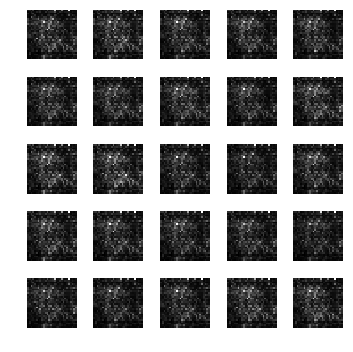

epoch: 141, time: 4.929561 | train_G_Loss: 0.534298, train_D_loss: 4.027492, train_acc: 0.164062
cv_G_Loss: 0.502233, cv_D_loss: 4.496620, cv_acc: 0.097900

epoch: 142, time: 4.909059 | train_G_Loss: 0.497005, train_D_loss: 1.463669, train_acc: 0.111328
cv_G_Loss: 0.424174, cv_D_loss: 4.426090, cv_acc: 0.113500

epoch: 143, time: 4.905891 | train_G_Loss: 0.477888, train_D_loss: 1.466949, train_acc: 0.126953
cv_G_Loss: 0.460568, cv_D_loss: 4.346764, cv_acc: 0.134700

epoch: 144, time: 4.893557 | train_G_Loss: 0.480172, train_D_loss: 1.460168, train_acc: 0.099609
cv_G_Loss: 0.613982, cv_D_loss: 4.403943, cv_acc: 0.097400

epoch: 145, time: 4.905932 | train_G_Loss: 0.442212, train_D_loss: 1.490029, train_acc: 0.111328
cv_G_Loss: 0.346958, cv_D_loss: 4.328387, cv_acc: 0.128100

epoch: 146, time: 4.911960 | train_G_Loss: 0.397262, train_D_loss: 1.526271, train_acc: 0.113281
cv_G_Loss: 0.302658, cv_D_loss: 4.413158, cv_acc: 0.095800

epoch: 147, time: 4.907876 | train_G_Loss: 0.460410, train

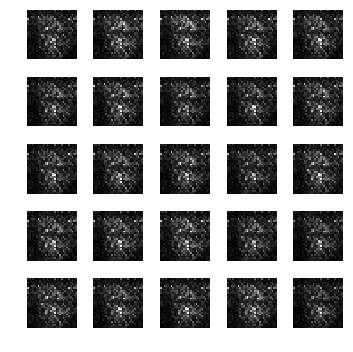

epoch: 151, time: 4.936045 | train_G_Loss: 0.470644, train_D_loss: 1.452379, train_acc: 0.097656
cv_G_Loss: 0.467778, cv_D_loss: 4.285877, cv_acc: 0.103200

epoch: 152, time: 4.888794 | train_G_Loss: 0.458029, train_D_loss: 1.477864, train_acc: 0.093750
cv_G_Loss: 0.462174, cv_D_loss: 4.362070, cv_acc: 0.103300

epoch: 153, time: 4.905385 | train_G_Loss: 0.398561, train_D_loss: 4.125132, train_acc: 0.144531
cv_G_Loss: 0.346985, cv_D_loss: 4.332858, cv_acc: 0.102800

epoch: 154, time: 4.897493 | train_G_Loss: 0.596715, train_D_loss: 4.463326, train_acc: 0.103516
cv_G_Loss: 0.711901, cv_D_loss: 4.556145, cv_acc: 0.097400

epoch: 155, time: 4.888997 | train_G_Loss: 0.548607, train_D_loss: 4.517754, train_acc: 0.099609
cv_G_Loss: 0.574842, cv_D_loss: 4.380553, cv_acc: 0.101100

epoch: 156, time: 4.900872 | train_G_Loss: 0.556297, train_D_loss: 1.416335, train_acc: 0.103516
cv_G_Loss: 0.625887, cv_D_loss: 4.409082, cv_acc: 0.098000

epoch: 157, time: 4.894644 | train_G_Loss: 0.525878, train

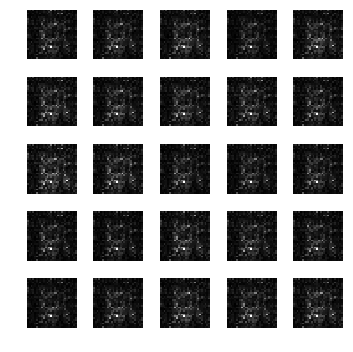

epoch: 161, time: 4.945131 | train_G_Loss: 0.441942, train_D_loss: 4.570666, train_acc: 0.146484
cv_G_Loss: 0.427724, cv_D_loss: 4.298553, cv_acc: 0.104400

epoch: 162, time: 4.909760 | train_G_Loss: 0.432779, train_D_loss: 1.497963, train_acc: 0.085938
cv_G_Loss: 0.373979, cv_D_loss: 4.345314, cv_acc: 0.089200

epoch: 163, time: 4.914407 | train_G_Loss: 0.523625, train_D_loss: 1.424875, train_acc: 0.097656
cv_G_Loss: 0.517206, cv_D_loss: 4.371875, cv_acc: 0.100900

epoch: 164, time: 4.900310 | train_G_Loss: 0.673491, train_D_loss: 1.398503, train_acc: 0.095703
cv_G_Loss: 0.835870, cv_D_loss: 4.695843, cv_acc: 0.102800

epoch: 165, time: 4.900820 | train_G_Loss: 0.515403, train_D_loss: 1.442483, train_acc: 0.101562
cv_G_Loss: 0.549056, cv_D_loss: 4.405957, cv_acc: 0.115000

epoch: 166, time: 4.915227 | train_G_Loss: 0.523105, train_D_loss: 1.430033, train_acc: 0.097656
cv_G_Loss: 0.626572, cv_D_loss: 4.426995, cv_acc: 0.100900

epoch: 167, time: 4.910086 | train_G_Loss: 0.606193, train

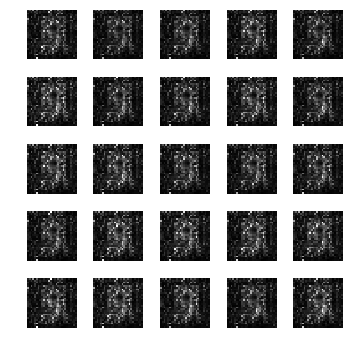

epoch: 171, time: 4.938558 | train_G_Loss: 0.546486, train_D_loss: 1.419533, train_acc: 0.107422
cv_G_Loss: 0.593801, cv_D_loss: 4.341220, cv_acc: 0.155800

epoch: 172, time: 4.905337 | train_G_Loss: 0.460186, train_D_loss: 1.469867, train_acc: 0.097656
cv_G_Loss: 0.444913, cv_D_loss: 4.287554, cv_acc: 0.113500

epoch: 173, time: 4.927810 | train_G_Loss: 0.442553, train_D_loss: 1.483011, train_acc: 0.095703
cv_G_Loss: 0.406666, cv_D_loss: 4.301385, cv_acc: 0.097400

epoch: 174, time: 4.907509 | train_G_Loss: 0.498569, train_D_loss: 4.106527, train_acc: 0.089844
cv_G_Loss: 0.531577, cv_D_loss: 4.332713, cv_acc: 0.097400

epoch: 175, time: 4.903464 | train_G_Loss: 0.518920, train_D_loss: 1.435873, train_acc: 0.117188
cv_G_Loss: 0.502014, cv_D_loss: 4.303390, cv_acc: 0.153200

epoch: 176, time: 4.902915 | train_G_Loss: 0.524444, train_D_loss: 1.439615, train_acc: 0.111328
cv_G_Loss: 0.566796, cv_D_loss: 4.387399, cv_acc: 0.113500

epoch: 177, time: 4.904706 | train_G_Loss: 0.389669, train

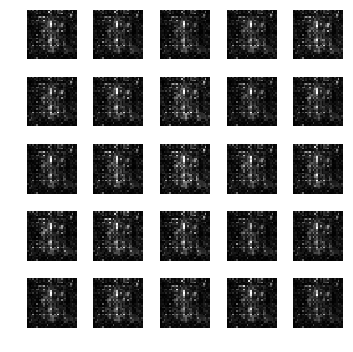

epoch: 181, time: 4.920652 | train_G_Loss: 0.597641, train_D_loss: 1.407519, train_acc: 0.103516
cv_G_Loss: 0.700743, cv_D_loss: 4.558101, cv_acc: 0.098000

epoch: 182, time: 4.911824 | train_G_Loss: 0.439571, train_D_loss: 4.460372, train_acc: 0.095703
cv_G_Loss: 0.396952, cv_D_loss: 4.291604, cv_acc: 0.098000

epoch: 183, time: 4.899800 | train_G_Loss: 0.625650, train_D_loss: 3.981494, train_acc: 0.099609
cv_G_Loss: 0.739256, cv_D_loss: 4.570796, cv_acc: 0.098000

epoch: 184, time: 4.915305 | train_G_Loss: 0.673472, train_D_loss: 1.392393, train_acc: 0.093750
cv_G_Loss: 0.867870, cv_D_loss: 4.704043, cv_acc: 0.097400

epoch: 185, time: 4.915624 | train_G_Loss: 0.669567, train_D_loss: 1.410835, train_acc: 0.134766
cv_G_Loss: 0.778652, cv_D_loss: 4.636942, cv_acc: 0.111100

epoch: 186, time: 4.911630 | train_G_Loss: 0.507104, train_D_loss: 4.194031, train_acc: 0.101562
cv_G_Loss: 0.539789, cv_D_loss: 4.344586, cv_acc: 0.097400

epoch: 187, time: 4.901226 | train_G_Loss: 0.595787, train

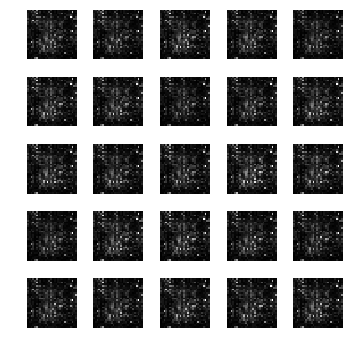

epoch: 191, time: 4.931678 | train_G_Loss: 0.516596, train_D_loss: 4.333706, train_acc: 0.085938
cv_G_Loss: 0.556746, cv_D_loss: 4.293903, cv_acc: 0.101900

epoch: 192, time: 4.898448 | train_G_Loss: 0.440210, train_D_loss: 4.292593, train_acc: 0.111328
cv_G_Loss: 0.398030, cv_D_loss: 4.258929, cv_acc: 0.113500

epoch: 193, time: 4.903704 | train_G_Loss: 0.453857, train_D_loss: 1.466232, train_acc: 0.113281
cv_G_Loss: 0.432154, cv_D_loss: 4.232346, cv_acc: 0.113500

epoch: 194, time: 4.905930 | train_G_Loss: 0.458622, train_D_loss: 4.178911, train_acc: 0.119141
cv_G_Loss: 0.467979, cv_D_loss: 4.249121, cv_acc: 0.113500

epoch: 195, time: 4.904059 | train_G_Loss: 0.440811, train_D_loss: 4.851663, train_acc: 0.121094
cv_G_Loss: 0.411662, cv_D_loss: 4.266952, cv_acc: 0.103200

epoch: 196, time: 4.918258 | train_G_Loss: 0.491043, train_D_loss: 4.153507, train_acc: 0.132812
cv_G_Loss: 0.471658, cv_D_loss: 4.322970, cv_acc: 0.161800

epoch: 197, time: 4.916924 | train_G_Loss: 0.558424, train

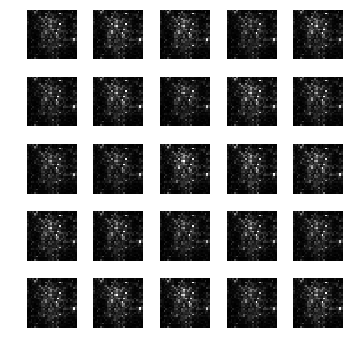

epoch: 201, time: 4.952316 | train_G_Loss: 0.469274, train_D_loss: 1.461099, train_acc: 0.101562
cv_G_Loss: 0.437898, cv_D_loss: 4.280431, cv_acc: 0.113500

epoch: 202, time: 4.907687 | train_G_Loss: 0.497538, train_D_loss: 4.098670, train_acc: 0.103516
cv_G_Loss: 0.436961, cv_D_loss: 4.300984, cv_acc: 0.113500

epoch: 203, time: 4.903265 | train_G_Loss: 0.509715, train_D_loss: 1.428847, train_acc: 0.121094
cv_G_Loss: 0.639523, cv_D_loss: 4.357726, cv_acc: 0.120100

epoch: 204, time: 4.902519 | train_G_Loss: 0.457922, train_D_loss: 4.342436, train_acc: 0.167969
cv_G_Loss: 0.380506, cv_D_loss: 4.260590, cv_acc: 0.124800

epoch: 205, time: 4.905749 | train_G_Loss: 0.571421, train_D_loss: 1.410768, train_acc: 0.130859
cv_G_Loss: 0.640931, cv_D_loss: 4.390738, cv_acc: 0.140400

epoch: 206, time: 4.906716 | train_G_Loss: 0.454559, train_D_loss: 1.472218, train_acc: 0.107422
cv_G_Loss: 0.473215, cv_D_loss: 4.257628, cv_acc: 0.113500

epoch: 207, time: 4.906671 | train_G_Loss: 0.633477, train

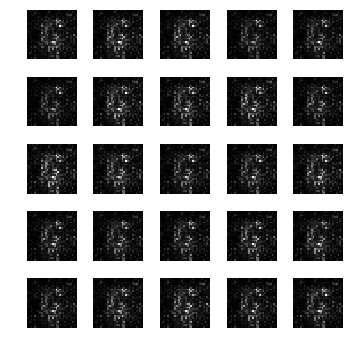

epoch: 211, time: 4.916000 | train_G_Loss: 0.568913, train_D_loss: 1.407122, train_acc: 0.093750
cv_G_Loss: 0.741976, cv_D_loss: 4.428733, cv_acc: 0.098200

epoch: 212, time: 4.906094 | train_G_Loss: 0.513186, train_D_loss: 4.414961, train_acc: 0.097656
cv_G_Loss: 0.567432, cv_D_loss: 4.285696, cv_acc: 0.123900

epoch: 213, time: 4.905901 | train_G_Loss: 0.602830, train_D_loss: 1.408212, train_acc: 0.091797
cv_G_Loss: 0.663645, cv_D_loss: 4.385274, cv_acc: 0.095900

epoch: 214, time: 4.900212 | train_G_Loss: 0.577548, train_D_loss: 1.415961, train_acc: 0.097656
cv_G_Loss: 0.725499, cv_D_loss: 4.424382, cv_acc: 0.131300

epoch: 215, time: 4.903261 | train_G_Loss: 0.439830, train_D_loss: 1.482139, train_acc: 0.107422
cv_G_Loss: 0.428243, cv_D_loss: 4.224661, cv_acc: 0.098400

epoch: 216, time: 4.907340 | train_G_Loss: 0.539177, train_D_loss: 4.394214, train_acc: 0.103516
cv_G_Loss: 0.552862, cv_D_loss: 4.355003, cv_acc: 0.103200

epoch: 217, time: 4.915945 | train_G_Loss: 0.468006, train

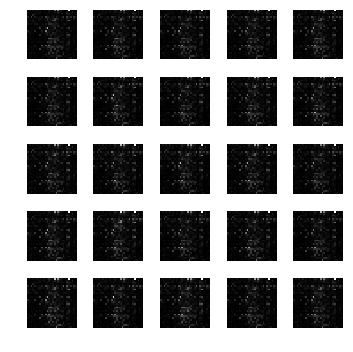

epoch: 221, time: 4.931765 | train_G_Loss: 0.585972, train_D_loss: 1.418625, train_acc: 0.109375
cv_G_Loss: 0.642446, cv_D_loss: 4.433938, cv_acc: 0.098200

epoch: 222, time: 4.896497 | train_G_Loss: 0.461345, train_D_loss: 1.464361, train_acc: 0.093750
cv_G_Loss: 0.435943, cv_D_loss: 4.271493, cv_acc: 0.103200

epoch: 223, time: 4.903682 | train_G_Loss: 0.565885, train_D_loss: 1.413860, train_acc: 0.125000
cv_G_Loss: 0.630732, cv_D_loss: 4.332188, cv_acc: 0.113500

epoch: 224, time: 4.897909 | train_G_Loss: 0.532492, train_D_loss: 1.425629, train_acc: 0.125000
cv_G_Loss: 0.573974, cv_D_loss: 4.313353, cv_acc: 0.189100

epoch: 225, time: 4.906265 | train_G_Loss: 0.500377, train_D_loss: 1.445517, train_acc: 0.109375
cv_G_Loss: 0.539191, cv_D_loss: 4.323022, cv_acc: 0.117400

epoch: 226, time: 4.905792 | train_G_Loss: 0.618215, train_D_loss: 4.897332, train_acc: 0.119141
cv_G_Loss: 0.675547, cv_D_loss: 4.451725, cv_acc: 0.114300

epoch: 227, time: 4.900346 | train_G_Loss: 0.527498, train

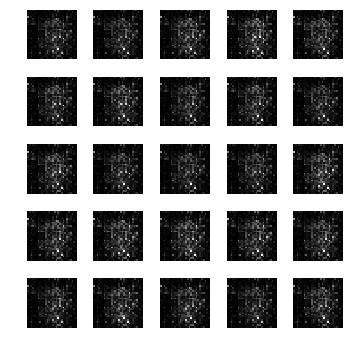

epoch: 231, time: 4.926466 | train_G_Loss: 0.606206, train_D_loss: 4.314889, train_acc: 0.089844
cv_G_Loss: 0.690802, cv_D_loss: 4.474060, cv_acc: 0.090900

epoch: 232, time: 4.891613 | train_G_Loss: 0.442904, train_D_loss: 4.138701, train_acc: 0.095703
cv_G_Loss: 0.394607, cv_D_loss: 4.243208, cv_acc: 0.108200

epoch: 233, time: 4.900026 | train_G_Loss: 0.491873, train_D_loss: 1.444461, train_acc: 0.085938
cv_G_Loss: 0.502528, cv_D_loss: 4.269308, cv_acc: 0.089200

epoch: 234, time: 4.899891 | train_G_Loss: 0.475999, train_D_loss: 4.266070, train_acc: 0.089844
cv_G_Loss: 0.492560, cv_D_loss: 4.279385, cv_acc: 0.101100

epoch: 235, time: 4.900360 | train_G_Loss: 0.565781, train_D_loss: 4.056323, train_acc: 0.107422
cv_G_Loss: 0.755712, cv_D_loss: 4.410506, cv_acc: 0.100900

epoch: 236, time: 4.891545 | train_G_Loss: 0.497857, train_D_loss: 1.436889, train_acc: 0.087891
cv_G_Loss: 0.515005, cv_D_loss: 4.260730, cv_acc: 0.098200

epoch: 237, time: 4.906173 | train_G_Loss: 0.499968, train

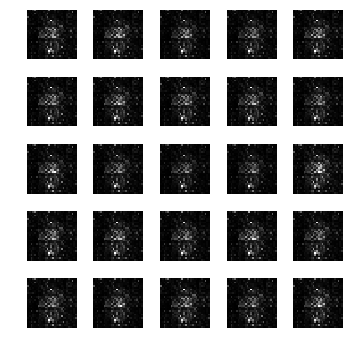

epoch: 241, time: 4.935079 | train_G_Loss: 0.533741, train_D_loss: 1.432795, train_acc: 0.087891
cv_G_Loss: 0.555548, cv_D_loss: 4.333432, cv_acc: 0.100900

epoch: 242, time: 4.895805 | train_G_Loss: 0.546028, train_D_loss: 4.428646, train_acc: 0.089844
cv_G_Loss: 0.573311, cv_D_loss: 4.332691, cv_acc: 0.100900

epoch: 243, time: 4.907182 | train_G_Loss: 0.445324, train_D_loss: 1.478363, train_acc: 0.072266
cv_G_Loss: 0.432133, cv_D_loss: 4.251395, cv_acc: 0.097400

epoch: 244, time: 4.897334 | train_G_Loss: 0.487160, train_D_loss: 4.525616, train_acc: 0.093750
cv_G_Loss: 0.510240, cv_D_loss: 4.266439, cv_acc: 0.092900

epoch: 245, time: 4.897777 | train_G_Loss: 0.381263, train_D_loss: 1.536374, train_acc: 0.162109
cv_G_Loss: 0.349935, cv_D_loss: 4.245011, cv_acc: 0.144100

epoch: 246, time: 4.898002 | train_G_Loss: 0.563437, train_D_loss: 4.390120, train_acc: 0.093750
cv_G_Loss: 0.576328, cv_D_loss: 4.324073, cv_acc: 0.100900

epoch: 247, time: 4.888159 | train_G_Loss: 0.511712, train

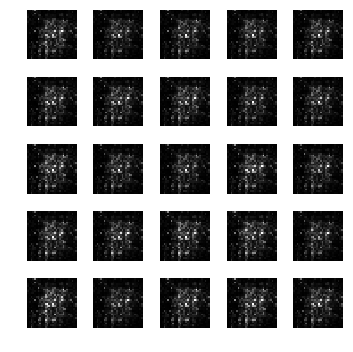

epoch: 251, time: 4.937812 | train_G_Loss: 0.434938, train_D_loss: 1.486076, train_acc: 0.095703
cv_G_Loss: 0.448692, cv_D_loss: 4.259481, cv_acc: 0.098200

epoch: 252, time: 4.916521 | train_G_Loss: 0.360907, train_D_loss: 3.965855, train_acc: 0.111328
cv_G_Loss: 0.259194, cv_D_loss: 4.325512, cv_acc: 0.113500

epoch: 253, time: 4.906075 | train_G_Loss: 0.425814, train_D_loss: 1.488015, train_acc: 0.085938
cv_G_Loss: 0.391538, cv_D_loss: 4.248210, cv_acc: 0.100900

epoch: 254, time: 4.910564 | train_G_Loss: 0.462768, train_D_loss: 4.282786, train_acc: 0.083984
cv_G_Loss: 0.453828, cv_D_loss: 4.253799, cv_acc: 0.101700

epoch: 255, time: 4.904874 | train_G_Loss: 0.519288, train_D_loss: 1.428245, train_acc: 0.095703
cv_G_Loss: 0.512583, cv_D_loss: 4.282148, cv_acc: 0.087600

epoch: 256, time: 4.906072 | train_G_Loss: 0.547285, train_D_loss: 1.416074, train_acc: 0.121094
cv_G_Loss: 0.616495, cv_D_loss: 4.361003, cv_acc: 0.113700

epoch: 257, time: 4.913023 | train_G_Loss: 0.673917, train

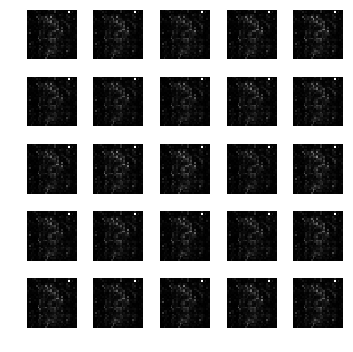

epoch: 261, time: 4.943216 | train_G_Loss: 0.485577, train_D_loss: 1.447527, train_acc: 0.097656
cv_G_Loss: 0.469990, cv_D_loss: 4.260893, cv_acc: 0.101000

epoch: 262, time: 4.902957 | train_G_Loss: 0.404407, train_D_loss: 3.986878, train_acc: 0.103516
cv_G_Loss: 0.373634, cv_D_loss: 4.265519, cv_acc: 0.101000

epoch: 263, time: 4.911610 | train_G_Loss: 0.458231, train_D_loss: 1.462871, train_acc: 0.148438
cv_G_Loss: 0.449516, cv_D_loss: 4.300815, cv_acc: 0.177500

epoch: 264, time: 4.912220 | train_G_Loss: 0.460045, train_D_loss: 1.465891, train_acc: 0.091797
cv_G_Loss: 0.396637, cv_D_loss: 4.282434, cv_acc: 0.101000

epoch: 265, time: 4.904338 | train_G_Loss: 0.478993, train_D_loss: 1.454021, train_acc: 0.107422
cv_G_Loss: 0.482741, cv_D_loss: 4.277952, cv_acc: 0.113500

epoch: 266, time: 4.905437 | train_G_Loss: 0.597030, train_D_loss: 1.404738, train_acc: 0.113281
cv_G_Loss: 0.638850, cv_D_loss: 4.388474, cv_acc: 0.113500

epoch: 267, time: 4.907621 | train_G_Loss: 0.606415, train

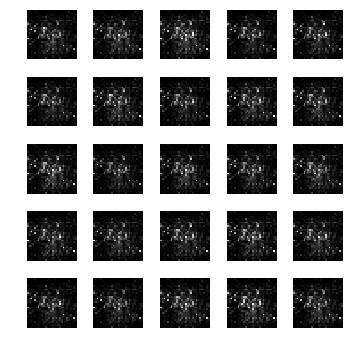

epoch: 271, time: 4.947289 | train_G_Loss: 0.615858, train_D_loss: 3.827407, train_acc: 0.109375
cv_G_Loss: 0.717578, cv_D_loss: 4.484873, cv_acc: 0.106900

epoch: 272, time: 4.907924 | train_G_Loss: 0.634227, train_D_loss: 4.390137, train_acc: 0.109375
cv_G_Loss: 0.668074, cv_D_loss: 4.397126, cv_acc: 0.125000

epoch: 273, time: 4.908270 | train_G_Loss: 0.546245, train_D_loss: 4.641636, train_acc: 0.119141
cv_G_Loss: 0.555916, cv_D_loss: 4.344455, cv_acc: 0.100900

epoch: 274, time: 4.907723 | train_G_Loss: 0.573837, train_D_loss: 4.169296, train_acc: 0.095703
cv_G_Loss: 0.641684, cv_D_loss: 4.361651, cv_acc: 0.097400

epoch: 275, time: 4.900113 | train_G_Loss: 0.461046, train_D_loss: 4.588645, train_acc: 0.095703
cv_G_Loss: 0.456531, cv_D_loss: 4.244316, cv_acc: 0.098200

epoch: 276, time: 4.903865 | train_G_Loss: 0.524000, train_D_loss: 1.424358, train_acc: 0.089844
cv_G_Loss: 0.537831, cv_D_loss: 4.315925, cv_acc: 0.098200

epoch: 277, time: 4.900698 | train_G_Loss: 0.401875, train

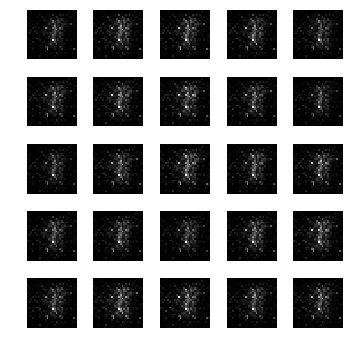

epoch: 281, time: 4.941747 | train_G_Loss: 0.550059, train_D_loss: 4.559281, train_acc: 0.101562
cv_G_Loss: 0.664415, cv_D_loss: 4.336282, cv_acc: 0.098000

epoch: 282, time: 4.916140 | train_G_Loss: 0.417999, train_D_loss: 4.209099, train_acc: 0.093750
cv_G_Loss: 0.388929, cv_D_loss: 4.210444, cv_acc: 0.106000

epoch: 283, time: 4.914041 | train_G_Loss: 0.425136, train_D_loss: 1.492982, train_acc: 0.105469
cv_G_Loss: 0.384099, cv_D_loss: 4.221138, cv_acc: 0.100900

epoch: 284, time: 4.901002 | train_G_Loss: 0.422435, train_D_loss: 1.493045, train_acc: 0.087891
cv_G_Loss: 0.389369, cv_D_loss: 4.215661, cv_acc: 0.103200

epoch: 285, time: 4.919152 | train_G_Loss: 0.409130, train_D_loss: 1.505037, train_acc: 0.101562
cv_G_Loss: 0.352477, cv_D_loss: 4.253071, cv_acc: 0.103200

epoch: 286, time: 4.918383 | train_G_Loss: 0.406010, train_D_loss: 1.505052, train_acc: 0.107422
cv_G_Loss: 0.351059, cv_D_loss: 4.229855, cv_acc: 0.161000

epoch: 287, time: 4.927506 | train_G_Loss: 0.515440, train

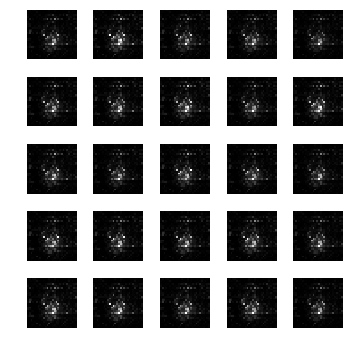

epoch: 291, time: 4.949771 | train_G_Loss: 0.503321, train_D_loss: 3.918871, train_acc: 0.111328
cv_G_Loss: 0.540606, cv_D_loss: 4.289295, cv_acc: 0.102800

epoch: 292, time: 4.901861 | train_G_Loss: 0.480128, train_D_loss: 1.449754, train_acc: 0.093750
cv_G_Loss: 0.470210, cv_D_loss: 4.269104, cv_acc: 0.101000

epoch: 293, time: 4.912863 | train_G_Loss: 0.435933, train_D_loss: 1.478072, train_acc: 0.101562
cv_G_Loss: 0.426024, cv_D_loss: 4.247541, cv_acc: 0.097400

epoch: 294, time: 4.893669 | train_G_Loss: 0.476180, train_D_loss: 1.450627, train_acc: 0.214844
cv_G_Loss: 0.520122, cv_D_loss: 4.241210, cv_acc: 0.103100

epoch: 295, time: 4.912316 | train_G_Loss: 0.478806, train_D_loss: 3.925206, train_acc: 0.097656
cv_G_Loss: 0.481825, cv_D_loss: 4.210535, cv_acc: 0.098200

epoch: 296, time: 4.910322 | train_G_Loss: 0.440996, train_D_loss: 3.971551, train_acc: 0.109375
cv_G_Loss: 0.410768, cv_D_loss: 4.237659, cv_acc: 0.097400

epoch: 297, time: 4.892096 | train_G_Loss: 0.418432, train

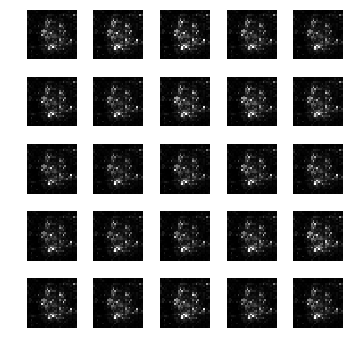

epoch: 301, time: 4.929087 | train_G_Loss: 0.464032, train_D_loss: 4.447909, train_acc: 0.101562
cv_G_Loss: 0.480865, cv_D_loss: 4.236195, cv_acc: 0.097400

epoch: 302, time: 4.908821 | train_G_Loss: 0.445922, train_D_loss: 1.472550, train_acc: 0.115234
cv_G_Loss: 0.404047, cv_D_loss: 4.242024, cv_acc: 0.098200

epoch: 303, time: 4.914821 | train_G_Loss: 0.401006, train_D_loss: 4.242141, train_acc: 0.111328
cv_G_Loss: 0.346154, cv_D_loss: 4.246706, cv_acc: 0.113500

epoch: 304, time: 4.889042 | train_G_Loss: 0.486703, train_D_loss: 4.239220, train_acc: 0.101562
cv_G_Loss: 0.448215, cv_D_loss: 4.249063, cv_acc: 0.110800

epoch: 305, time: 4.900389 | train_G_Loss: 0.466486, train_D_loss: 1.457423, train_acc: 0.099609
cv_G_Loss: 0.425669, cv_D_loss: 4.240742, cv_acc: 0.103700

epoch: 306, time: 4.914684 | train_G_Loss: 0.432258, train_D_loss: 4.194948, train_acc: 0.109375
cv_G_Loss: 0.398061, cv_D_loss: 4.236008, cv_acc: 0.101000

epoch: 307, time: 4.893863 | train_G_Loss: 0.506639, train

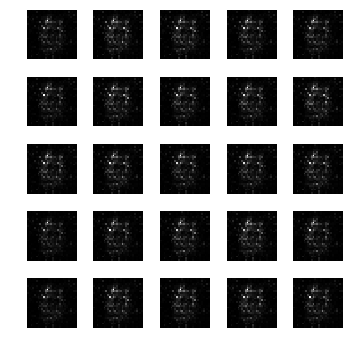

epoch: 311, time: 4.949046 | train_G_Loss: 0.501069, train_D_loss: 4.182232, train_acc: 0.093750
cv_G_Loss: 0.523482, cv_D_loss: 4.284585, cv_acc: 0.105300

epoch: 312, time: 4.897608 | train_G_Loss: 0.499276, train_D_loss: 4.031753, train_acc: 0.109375
cv_G_Loss: 0.486572, cv_D_loss: 4.257933, cv_acc: 0.100900

epoch: 313, time: 4.894073 | train_G_Loss: 0.459937, train_D_loss: 1.461052, train_acc: 0.080078
cv_G_Loss: 0.414377, cv_D_loss: 4.233415, cv_acc: 0.098300

epoch: 314, time: 4.892193 | train_G_Loss: 0.512784, train_D_loss: 1.431150, train_acc: 0.103516
cv_G_Loss: 0.579285, cv_D_loss: 4.282494, cv_acc: 0.113500

epoch: 315, time: 4.903013 | train_G_Loss: 0.531626, train_D_loss: 4.189507, train_acc: 0.177734
cv_G_Loss: 0.549296, cv_D_loss: 4.300002, cv_acc: 0.178400

epoch: 316, time: 4.906625 | train_G_Loss: 0.522667, train_D_loss: 1.425170, train_acc: 0.091797
cv_G_Loss: 0.552441, cv_D_loss: 4.304964, cv_acc: 0.100900

epoch: 317, time: 4.904725 | train_G_Loss: 0.514196, train

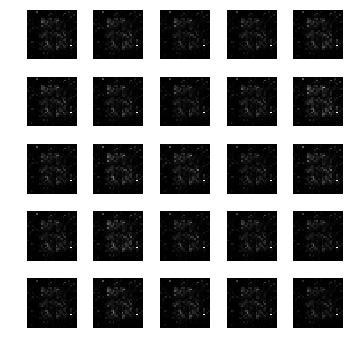

epoch: 321, time: 4.945661 | train_G_Loss: 0.589990, train_D_loss: 3.868196, train_acc: 0.105469
cv_G_Loss: 0.647818, cv_D_loss: 4.357469, cv_acc: 0.113500

epoch: 322, time: 4.926985 | train_G_Loss: 0.428395, train_D_loss: 3.891777, train_acc: 0.097656
cv_G_Loss: 0.374578, cv_D_loss: 4.242911, cv_acc: 0.100900

epoch: 323, time: 4.918595 | train_G_Loss: 0.555070, train_D_loss: 1.412324, train_acc: 0.136719
cv_G_Loss: 0.608774, cv_D_loss: 4.312175, cv_acc: 0.134600

epoch: 324, time: 4.917494 | train_G_Loss: 0.358745, train_D_loss: 4.472465, train_acc: 0.126953
cv_G_Loss: 0.285292, cv_D_loss: 4.277060, cv_acc: 0.101000

epoch: 325, time: 4.909750 | train_G_Loss: 0.496628, train_D_loss: 1.442652, train_acc: 0.150391
cv_G_Loss: 0.466029, cv_D_loss: 4.260393, cv_acc: 0.114000

epoch: 326, time: 4.925631 | train_G_Loss: 0.541025, train_D_loss: 1.415210, train_acc: 0.103516
cv_G_Loss: 0.567046, cv_D_loss: 4.310093, cv_acc: 0.095800

epoch: 327, time: 4.911288 | train_G_Loss: 0.457611, train

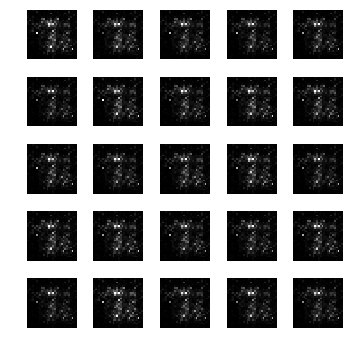

epoch: 331, time: 4.930799 | train_G_Loss: 0.524865, train_D_loss: 1.421948, train_acc: 0.099609
cv_G_Loss: 0.496299, cv_D_loss: 4.250863, cv_acc: 0.106800

epoch: 332, time: 4.901028 | train_G_Loss: 0.624473, train_D_loss: 4.163659, train_acc: 0.101562
cv_G_Loss: 0.709874, cv_D_loss: 4.446698, cv_acc: 0.113500

epoch: 333, time: 4.929966 | train_G_Loss: 0.461573, train_D_loss: 1.459818, train_acc: 0.111328
cv_G_Loss: 0.406524, cv_D_loss: 4.235323, cv_acc: 0.095800

epoch: 334, time: 4.909057 | train_G_Loss: 0.517618, train_D_loss: 4.273711, train_acc: 0.119141
cv_G_Loss: 0.527034, cv_D_loss: 4.276932, cv_acc: 0.101900

epoch: 335, time: 4.916754 | train_G_Loss: 0.500195, train_D_loss: 4.252013, train_acc: 0.085938
cv_G_Loss: 0.557827, cv_D_loss: 4.279033, cv_acc: 0.097400

epoch: 336, time: 4.904673 | train_G_Loss: 0.438311, train_D_loss: 1.481416, train_acc: 0.109375
cv_G_Loss: 0.373213, cv_D_loss: 4.203909, cv_acc: 0.101000

epoch: 337, time: 4.902688 | train_G_Loss: 0.492552, train

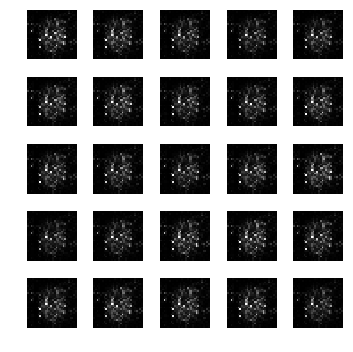

epoch: 341, time: 4.932244 | train_G_Loss: 0.429607, train_D_loss: 3.909200, train_acc: 0.087891
cv_G_Loss: 0.392659, cv_D_loss: 4.225417, cv_acc: 0.103200

epoch: 342, time: 4.914845 | train_G_Loss: 0.476826, train_D_loss: 3.903885, train_acc: 0.076172
cv_G_Loss: 0.460453, cv_D_loss: 4.243214, cv_acc: 0.103200

epoch: 343, time: 4.910744 | train_G_Loss: 0.477650, train_D_loss: 3.943872, train_acc: 0.091797
cv_G_Loss: 0.459570, cv_D_loss: 4.234661, cv_acc: 0.098200

epoch: 344, time: 4.908145 | train_G_Loss: 0.572629, train_D_loss: 1.405855, train_acc: 0.177734
cv_G_Loss: 0.632744, cv_D_loss: 4.324911, cv_acc: 0.175300

epoch: 345, time: 4.910909 | train_G_Loss: 0.504739, train_D_loss: 4.053514, train_acc: 0.087891
cv_G_Loss: 0.482565, cv_D_loss: 4.244843, cv_acc: 0.089200

epoch: 346, time: 4.896196 | train_G_Loss: 0.627548, train_D_loss: 1.392493, train_acc: 0.121094
cv_G_Loss: 0.691217, cv_D_loss: 4.389993, cv_acc: 0.117200

epoch: 347, time: 4.906348 | train_G_Loss: 0.437686, train

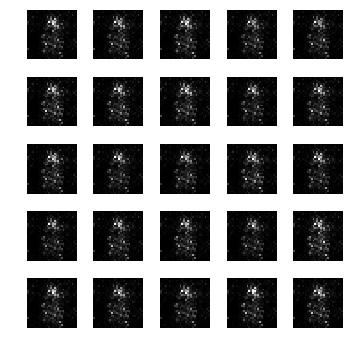

epoch: 351, time: 4.930310 | train_G_Loss: 0.564427, train_D_loss: 4.083278, train_acc: 0.121094
cv_G_Loss: 0.596415, cv_D_loss: 4.344499, cv_acc: 0.101400

epoch: 352, time: 4.919352 | train_G_Loss: 0.457158, train_D_loss: 1.464305, train_acc: 0.111328
cv_G_Loss: 0.429946, cv_D_loss: 4.236089, cv_acc: 0.101000

epoch: 353, time: 4.921920 | train_G_Loss: 0.486261, train_D_loss: 1.443315, train_acc: 0.119141
cv_G_Loss: 0.493308, cv_D_loss: 4.257700, cv_acc: 0.100900

epoch: 354, time: 4.910169 | train_G_Loss: 0.438333, train_D_loss: 1.478441, train_acc: 0.097656
cv_G_Loss: 0.404899, cv_D_loss: 4.251886, cv_acc: 0.102800

epoch: 355, time: 4.919538 | train_G_Loss: 0.481022, train_D_loss: 4.721395, train_acc: 0.109375
cv_G_Loss: 0.510176, cv_D_loss: 4.274910, cv_acc: 0.102800

epoch: 356, time: 4.933266 | train_G_Loss: 0.526555, train_D_loss: 1.423748, train_acc: 0.109375
cv_G_Loss: 0.549478, cv_D_loss: 4.284078, cv_acc: 0.102800

epoch: 357, time: 4.935198 | train_G_Loss: 0.451258, train

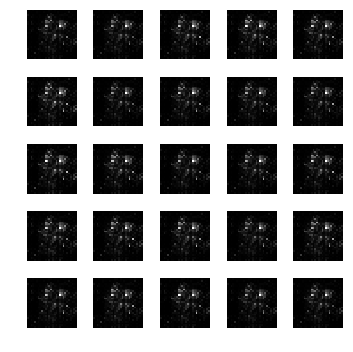

epoch: 361, time: 4.930736 | train_G_Loss: 0.573743, train_D_loss: 1.406041, train_acc: 0.082031
cv_G_Loss: 0.680996, cv_D_loss: 4.379875, cv_acc: 0.103200

epoch: 362, time: 4.905816 | train_G_Loss: 0.573579, train_D_loss: 4.160094, train_acc: 0.119141
cv_G_Loss: 0.655101, cv_D_loss: 4.310033, cv_acc: 0.113500

epoch: 363, time: 4.912080 | train_G_Loss: 0.525758, train_D_loss: 4.483384, train_acc: 0.162109
cv_G_Loss: 0.573830, cv_D_loss: 4.256058, cv_acc: 0.107500

epoch: 364, time: 4.905381 | train_G_Loss: 0.514495, train_D_loss: 1.427537, train_acc: 0.121094
cv_G_Loss: 0.537005, cv_D_loss: 4.249941, cv_acc: 0.103200

epoch: 365, time: 4.912310 | train_G_Loss: 0.479680, train_D_loss: 4.512271, train_acc: 0.117188
cv_G_Loss: 0.468521, cv_D_loss: 4.260408, cv_acc: 0.103000

epoch: 366, time: 4.914471 | train_G_Loss: 0.547990, train_D_loss: 3.947381, train_acc: 0.117188
cv_G_Loss: 0.646005, cv_D_loss: 4.381354, cv_acc: 0.113500

epoch: 367, time: 4.910780 | train_G_Loss: 0.430838, train

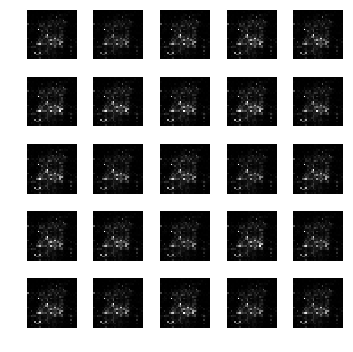

epoch: 371, time: 4.945646 | train_G_Loss: 0.587722, train_D_loss: 3.713261, train_acc: 0.082031
cv_G_Loss: 0.703699, cv_D_loss: 4.434730, cv_acc: 0.089200

epoch: 372, time: 4.901266 | train_G_Loss: 0.595132, train_D_loss: 4.762193, train_acc: 0.070312
cv_G_Loss: 0.660042, cv_D_loss: 4.395155, cv_acc: 0.089200

epoch: 373, time: 4.907520 | train_G_Loss: 0.483716, train_D_loss: 1.443789, train_acc: 0.179688
cv_G_Loss: 0.481588, cv_D_loss: 4.235621, cv_acc: 0.175500

epoch: 374, time: 4.909705 | train_G_Loss: 0.468839, train_D_loss: 3.687239, train_acc: 0.103516
cv_G_Loss: 0.443945, cv_D_loss: 4.243368, cv_acc: 0.098000

epoch: 375, time: 4.908926 | train_G_Loss: 0.449108, train_D_loss: 1.469187, train_acc: 0.080078
cv_G_Loss: 0.411004, cv_D_loss: 4.223927, cv_acc: 0.098000

epoch: 376, time: 4.905325 | train_G_Loss: 0.478414, train_D_loss: 1.449131, train_acc: 0.083984
cv_G_Loss: 0.482455, cv_D_loss: 4.255082, cv_acc: 0.104200

epoch: 377, time: 4.910419 | train_G_Loss: 0.441429, train

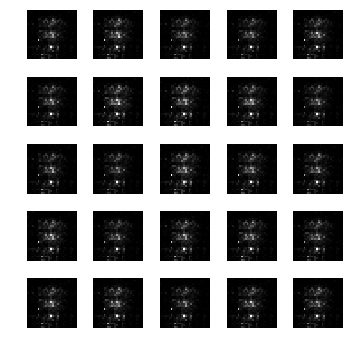

epoch: 381, time: 4.929716 | train_G_Loss: 0.588651, train_D_loss: 1.402520, train_acc: 0.117188
cv_G_Loss: 0.620898, cv_D_loss: 4.348837, cv_acc: 0.097400

epoch: 382, time: 4.898420 | train_G_Loss: 0.485043, train_D_loss: 1.444209, train_acc: 0.103516
cv_G_Loss: 0.456466, cv_D_loss: 4.221073, cv_acc: 0.107400

epoch: 383, time: 4.897029 | train_G_Loss: 0.498903, train_D_loss: 4.127000, train_acc: 0.138672
cv_G_Loss: 0.513428, cv_D_loss: 4.217342, cv_acc: 0.121100

epoch: 384, time: 4.907070 | train_G_Loss: 0.539847, train_D_loss: 1.420850, train_acc: 0.085938
cv_G_Loss: 0.576296, cv_D_loss: 4.292417, cv_acc: 0.100900

epoch: 385, time: 4.900698 | train_G_Loss: 0.507276, train_D_loss: 4.332318, train_acc: 0.117188
cv_G_Loss: 0.520290, cv_D_loss: 4.245630, cv_acc: 0.101000

epoch: 386, time: 4.907741 | train_G_Loss: 0.651657, train_D_loss: 1.392043, train_acc: 0.091797
cv_G_Loss: 0.812136, cv_D_loss: 4.527896, cv_acc: 0.100900

epoch: 387, time: 4.901665 | train_G_Loss: 0.478400, train

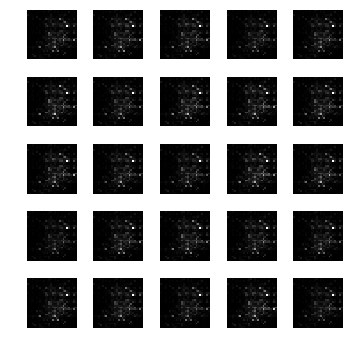

epoch: 391, time: 4.954759 | train_G_Loss: 0.517821, train_D_loss: 4.020192, train_acc: 0.103516
cv_G_Loss: 0.565218, cv_D_loss: 4.295230, cv_acc: 0.120900

epoch: 392, time: 4.914506 | train_G_Loss: 0.536498, train_D_loss: 3.954073, train_acc: 0.095703
cv_G_Loss: 0.551578, cv_D_loss: 4.285908, cv_acc: 0.095800

epoch: 393, time: 4.911463 | train_G_Loss: 0.480295, train_D_loss: 4.036609, train_acc: 0.087891
cv_G_Loss: 0.452507, cv_D_loss: 4.238925, cv_acc: 0.103200

epoch: 394, time: 4.909014 | train_G_Loss: 0.464481, train_D_loss: 1.460254, train_acc: 0.099609
cv_G_Loss: 0.457505, cv_D_loss: 4.211883, cv_acc: 0.113500

epoch: 395, time: 4.907031 | train_G_Loss: 0.353101, train_D_loss: 1.568824, train_acc: 0.101562
cv_G_Loss: 0.262329, cv_D_loss: 4.302285, cv_acc: 0.113500

epoch: 396, time: 4.924972 | train_G_Loss: 0.354870, train_D_loss: 4.244920, train_acc: 0.121094
cv_G_Loss: 0.289506, cv_D_loss: 4.270969, cv_acc: 0.113500

epoch: 397, time: 4.919021 | train_G_Loss: 0.478961, train

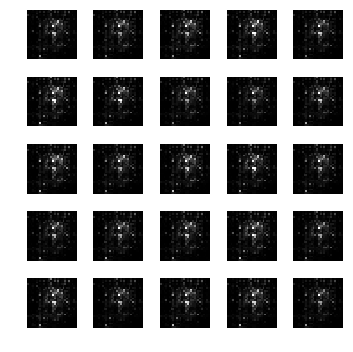

epoch: 401, time: 4.958575 | train_G_Loss: 0.491268, train_D_loss: 1.438531, train_acc: 0.105469
cv_G_Loss: 0.515365, cv_D_loss: 4.236553, cv_acc: 0.103900

epoch: 402, time: 4.916112 | train_G_Loss: 0.516104, train_D_loss: 1.426839, train_acc: 0.093750
cv_G_Loss: 0.492713, cv_D_loss: 4.218604, cv_acc: 0.090300

epoch: 403, time: 4.911404 | train_G_Loss: 0.495426, train_D_loss: 1.439576, train_acc: 0.175781
cv_G_Loss: 0.537728, cv_D_loss: 4.266962, cv_acc: 0.163700

epoch: 404, time: 4.919346 | train_G_Loss: 0.492492, train_D_loss: 1.441575, train_acc: 0.160156
cv_G_Loss: 0.493925, cv_D_loss: 4.232899, cv_acc: 0.162800

epoch: 405, time: 4.912067 | train_G_Loss: 0.533870, train_D_loss: 4.418499, train_acc: 0.173828
cv_G_Loss: 0.650928, cv_D_loss: 4.362906, cv_acc: 0.129800

epoch: 406, time: 4.926109 | train_G_Loss: 0.515861, train_D_loss: 4.135075, train_acc: 0.089844
cv_G_Loss: 0.509852, cv_D_loss: 4.250912, cv_acc: 0.098300

epoch: 407, time: 4.910368 | train_G_Loss: 0.536878, train

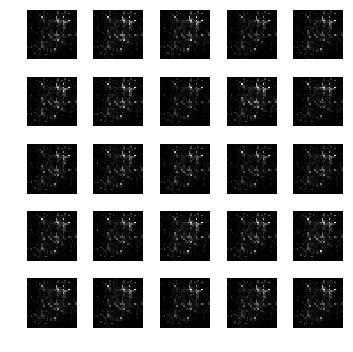

epoch: 411, time: 4.940414 | train_G_Loss: 0.570704, train_D_loss: 1.407324, train_acc: 0.095703
cv_G_Loss: 0.652247, cv_D_loss: 4.347560, cv_acc: 0.103200

epoch: 412, time: 4.912282 | train_G_Loss: 0.403642, train_D_loss: 4.399783, train_acc: 0.117188
cv_G_Loss: 0.338131, cv_D_loss: 4.217305, cv_acc: 0.113500

epoch: 413, time: 4.915048 | train_G_Loss: 0.518592, train_D_loss: 1.425383, train_acc: 0.091797
cv_G_Loss: 0.577624, cv_D_loss: 4.275278, cv_acc: 0.098200

epoch: 414, time: 4.905640 | train_G_Loss: 0.483466, train_D_loss: 3.828844, train_acc: 0.119141
cv_G_Loss: 0.460661, cv_D_loss: 4.225343, cv_acc: 0.101000

epoch: 415, time: 4.920112 | train_G_Loss: 0.428938, train_D_loss: 3.827321, train_acc: 0.111328
cv_G_Loss: 0.364989, cv_D_loss: 4.230346, cv_acc: 0.148800

epoch: 416, time: 5.002247 | train_G_Loss: 0.558681, train_D_loss: 3.898804, train_acc: 0.121094
cv_G_Loss: 0.569001, cv_D_loss: 4.318189, cv_acc: 0.117700

epoch: 417, time: 4.920398 | train_G_Loss: 0.543433, train

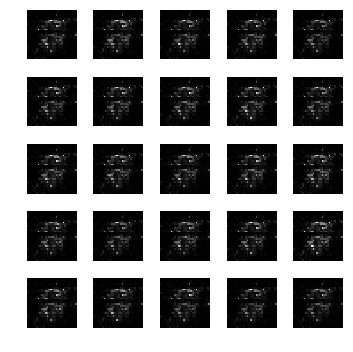

epoch: 421, time: 4.947121 | train_G_Loss: 0.434033, train_D_loss: 4.299297, train_acc: 0.121094
cv_G_Loss: 0.379484, cv_D_loss: 4.201018, cv_acc: 0.134400

epoch: 422, time: 4.917737 | train_G_Loss: 0.478022, train_D_loss: 4.285007, train_acc: 0.093750
cv_G_Loss: 0.475624, cv_D_loss: 4.214043, cv_acc: 0.097400

epoch: 423, time: 4.917478 | train_G_Loss: 0.517764, train_D_loss: 4.559404, train_acc: 0.080078
cv_G_Loss: 0.550109, cv_D_loss: 4.260904, cv_acc: 0.175800

epoch: 424, time: 4.922469 | train_G_Loss: 0.521666, train_D_loss: 1.424924, train_acc: 0.103516
cv_G_Loss: 0.534290, cv_D_loss: 4.234417, cv_acc: 0.097400

epoch: 425, time: 4.923800 | train_G_Loss: 0.507944, train_D_loss: 1.431082, train_acc: 0.103516
cv_G_Loss: 0.522168, cv_D_loss: 4.244401, cv_acc: 0.097400

epoch: 426, time: 4.925810 | train_G_Loss: 0.480858, train_D_loss: 1.448190, train_acc: 0.117188
cv_G_Loss: 0.486966, cv_D_loss: 4.233114, cv_acc: 0.113500

epoch: 427, time: 4.915220 | train_G_Loss: 0.600248, train

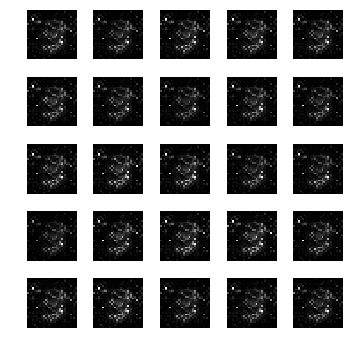

epoch: 431, time: 4.946328 | train_G_Loss: 0.479533, train_D_loss: 4.681791, train_acc: 0.191406
cv_G_Loss: 0.480738, cv_D_loss: 4.247879, cv_acc: 0.113500

epoch: 432, time: 4.931939 | train_G_Loss: 0.469722, train_D_loss: 1.452909, train_acc: 0.095703
cv_G_Loss: 0.440938, cv_D_loss: 4.224869, cv_acc: 0.101000

epoch: 433, time: 4.919296 | train_G_Loss: 0.564234, train_D_loss: 1.409358, train_acc: 0.121094
cv_G_Loss: 0.587308, cv_D_loss: 4.321583, cv_acc: 0.097400

epoch: 434, time: 4.924098 | train_G_Loss: 0.610763, train_D_loss: 1.396240, train_acc: 0.111328
cv_G_Loss: 0.696151, cv_D_loss: 4.445450, cv_acc: 0.113500

epoch: 435, time: 4.922868 | train_G_Loss: 0.592302, train_D_loss: 1.399431, train_acc: 0.101562
cv_G_Loss: 0.655516, cv_D_loss: 4.387236, cv_acc: 0.113500

epoch: 436, time: 4.907610 | train_G_Loss: 0.447924, train_D_loss: 4.015704, train_acc: 0.097656
cv_G_Loss: 0.426629, cv_D_loss: 4.252624, cv_acc: 0.102800

epoch: 437, time: 4.916829 | train_G_Loss: 0.559683, train

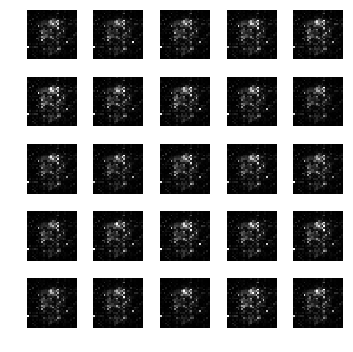

epoch: 441, time: 4.953697 | train_G_Loss: 0.481454, train_D_loss: 3.953153, train_acc: 0.103516
cv_G_Loss: 0.463671, cv_D_loss: 4.265173, cv_acc: 0.097400

epoch: 442, time: 4.921494 | train_G_Loss: 0.522496, train_D_loss: 1.425156, train_acc: 0.119141
cv_G_Loss: 0.505332, cv_D_loss: 4.279409, cv_acc: 0.187300

epoch: 443, time: 4.919296 | train_G_Loss: 0.544496, train_D_loss: 4.424685, train_acc: 0.109375
cv_G_Loss: 0.581699, cv_D_loss: 4.304801, cv_acc: 0.113500

epoch: 444, time: 4.925033 | train_G_Loss: 0.612249, train_D_loss: 1.396948, train_acc: 0.105469
cv_G_Loss: 0.728106, cv_D_loss: 4.460474, cv_acc: 0.100900

epoch: 445, time: 4.924151 | train_G_Loss: 0.595173, train_D_loss: 1.400570, train_acc: 0.167969
cv_G_Loss: 0.647563, cv_D_loss: 4.353950, cv_acc: 0.155900

epoch: 446, time: 4.929251 | train_G_Loss: 0.453866, train_D_loss: 4.531009, train_acc: 0.089844
cv_G_Loss: 0.423167, cv_D_loss: 4.201008, cv_acc: 0.098000

epoch: 447, time: 4.930446 | train_G_Loss: 0.487821, train

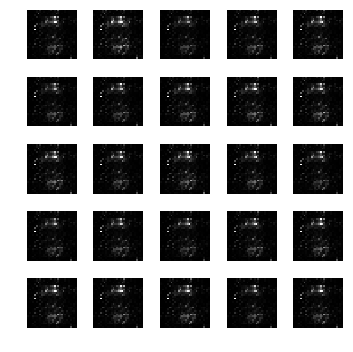

epoch: 451, time: 4.940978 | train_G_Loss: 0.559114, train_D_loss: 4.204419, train_acc: 0.095703
cv_G_Loss: 0.578750, cv_D_loss: 4.303163, cv_acc: 0.103200

epoch: 452, time: 4.911795 | train_G_Loss: 0.506727, train_D_loss: 1.433170, train_acc: 0.089844
cv_G_Loss: 0.567405, cv_D_loss: 4.286805, cv_acc: 0.102800

epoch: 453, time: 4.905057 | train_G_Loss: 0.506378, train_D_loss: 4.274547, train_acc: 0.093750
cv_G_Loss: 0.487083, cv_D_loss: 4.236368, cv_acc: 0.102800

epoch: 454, time: 4.913602 | train_G_Loss: 0.418632, train_D_loss: 4.413292, train_acc: 0.117188
cv_G_Loss: 0.409589, cv_D_loss: 4.226713, cv_acc: 0.113500

epoch: 455, time: 4.906656 | train_G_Loss: 0.450357, train_D_loss: 1.468057, train_acc: 0.111328
cv_G_Loss: 0.406090, cv_D_loss: 4.206505, cv_acc: 0.120300

epoch: 456, time: 4.921888 | train_G_Loss: 0.512468, train_D_loss: 4.335590, train_acc: 0.119141
cv_G_Loss: 0.603647, cv_D_loss: 4.257299, cv_acc: 0.113500

epoch: 457, time: 4.913192 | train_G_Loss: 0.484196, train

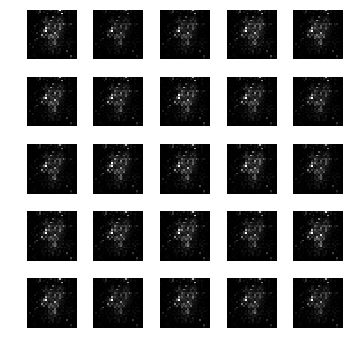

epoch: 461, time: 4.945482 | train_G_Loss: 0.464205, train_D_loss: 1.456467, train_acc: 0.095703
cv_G_Loss: 0.418740, cv_D_loss: 4.221526, cv_acc: 0.095800

epoch: 462, time: 4.923756 | train_G_Loss: 0.457102, train_D_loss: 4.550105, train_acc: 0.095703
cv_G_Loss: 0.432335, cv_D_loss: 4.231408, cv_acc: 0.097400

epoch: 463, time: 4.908801 | train_G_Loss: 0.487201, train_D_loss: 1.445240, train_acc: 0.101562
cv_G_Loss: 0.489134, cv_D_loss: 4.236478, cv_acc: 0.102800

epoch: 464, time: 4.911217 | train_G_Loss: 0.410408, train_D_loss: 1.501426, train_acc: 0.089844
cv_G_Loss: 0.337981, cv_D_loss: 4.235913, cv_acc: 0.100900

epoch: 465, time: 4.924735 | train_G_Loss: 0.585293, train_D_loss: 1.401747, train_acc: 0.089844
cv_G_Loss: 0.670984, cv_D_loss: 4.365775, cv_acc: 0.100900

epoch: 466, time: 4.922606 | train_G_Loss: 0.500694, train_D_loss: 4.209049, train_acc: 0.082031
cv_G_Loss: 0.513546, cv_D_loss: 4.274254, cv_acc: 0.098200

epoch: 467, time: 4.914736 | train_G_Loss: 0.471917, train

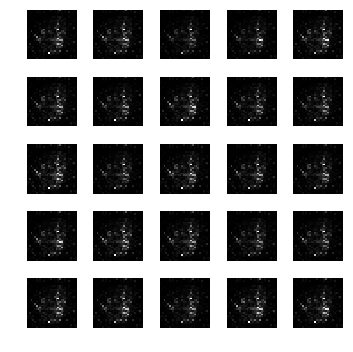

epoch: 471, time: 4.962355 | train_G_Loss: 0.490310, train_D_loss: 4.174584, train_acc: 0.105469
cv_G_Loss: 0.533994, cv_D_loss: 4.269988, cv_acc: 0.098000

epoch: 472, time: 4.923008 | train_G_Loss: 0.455965, train_D_loss: 4.716100, train_acc: 0.132812
cv_G_Loss: 0.442540, cv_D_loss: 4.227845, cv_acc: 0.097600

epoch: 473, time: 4.920232 | train_G_Loss: 0.648315, train_D_loss: 4.437169, train_acc: 0.111328
cv_G_Loss: 0.826953, cv_D_loss: 4.521854, cv_acc: 0.158300

epoch: 474, time: 4.917005 | train_G_Loss: 0.511402, train_D_loss: 4.238237, train_acc: 0.107422
cv_G_Loss: 0.523156, cv_D_loss: 4.267162, cv_acc: 0.122600

epoch: 475, time: 4.924282 | train_G_Loss: 0.498905, train_D_loss: 1.436719, train_acc: 0.103516
cv_G_Loss: 0.474311, cv_D_loss: 4.241195, cv_acc: 0.100900

epoch: 476, time: 4.911958 | train_G_Loss: 0.551685, train_D_loss: 4.194322, train_acc: 0.105469
cv_G_Loss: 0.571465, cv_D_loss: 4.275023, cv_acc: 0.113500

epoch: 477, time: 4.920115 | train_G_Loss: 0.585472, train

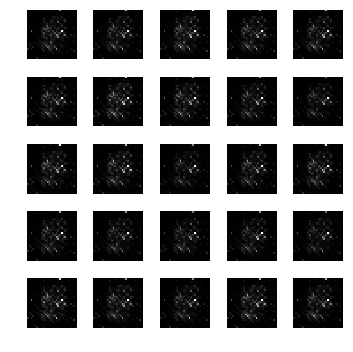

epoch: 481, time: 4.947162 | train_G_Loss: 0.588055, train_D_loss: 4.037095, train_acc: 0.117188
cv_G_Loss: 0.648977, cv_D_loss: 4.332581, cv_acc: 0.134500

epoch: 482, time: 4.910918 | train_G_Loss: 0.458116, train_D_loss: 4.404934, train_acc: 0.097656
cv_G_Loss: 0.431525, cv_D_loss: 4.225881, cv_acc: 0.102800

epoch: 483, time: 4.913063 | train_G_Loss: 0.463717, train_D_loss: 3.995558, train_acc: 0.121094
cv_G_Loss: 0.425617, cv_D_loss: 4.229513, cv_acc: 0.098000

epoch: 484, time: 4.909533 | train_G_Loss: 0.475824, train_D_loss: 1.451225, train_acc: 0.130859
cv_G_Loss: 0.444530, cv_D_loss: 4.248726, cv_acc: 0.092400

epoch: 485, time: 4.912230 | train_G_Loss: 0.421736, train_D_loss: 4.145028, train_acc: 0.097656
cv_G_Loss: 0.372856, cv_D_loss: 4.268393, cv_acc: 0.102800

epoch: 486, time: 4.916435 | train_G_Loss: 0.494090, train_D_loss: 4.018488, train_acc: 0.117188
cv_G_Loss: 0.535189, cv_D_loss: 4.292728, cv_acc: 0.100100

epoch: 487, time: 4.914515 | train_G_Loss: 0.520571, train

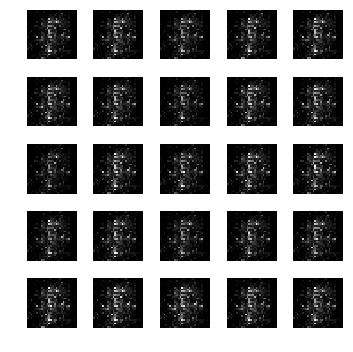

epoch: 491, time: 4.948290 | train_G_Loss: 0.538890, train_D_loss: 4.313326, train_acc: 0.156250
cv_G_Loss: 0.585812, cv_D_loss: 4.298681, cv_acc: 0.132200

epoch: 492, time: 4.921420 | train_G_Loss: 0.492944, train_D_loss: 1.438101, train_acc: 0.099609
cv_G_Loss: 0.471881, cv_D_loss: 4.239963, cv_acc: 0.098200

epoch: 493, time: 4.934190 | train_G_Loss: 0.513700, train_D_loss: 4.124869, train_acc: 0.119141
cv_G_Loss: 0.516030, cv_D_loss: 4.262307, cv_acc: 0.113500

epoch: 494, time: 4.911745 | train_G_Loss: 0.606047, train_D_loss: 1.396599, train_acc: 0.097656
cv_G_Loss: 0.689021, cv_D_loss: 4.389970, cv_acc: 0.113500

epoch: 495, time: 4.910967 | train_G_Loss: 0.567846, train_D_loss: 1.407359, train_acc: 0.123047
cv_G_Loss: 0.607184, cv_D_loss: 4.333037, cv_acc: 0.098000

epoch: 496, time: 4.906855 | train_G_Loss: 0.478826, train_D_loss: 3.959093, train_acc: 0.132812
cv_G_Loss: 0.427819, cv_D_loss: 4.204991, cv_acc: 0.113500

epoch: 497, time: 4.907762 | train_G_Loss: 0.466970, train

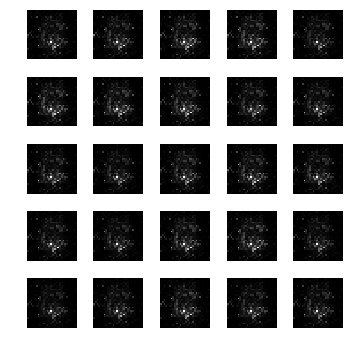

epoch: 501, time: 4.944953 | train_G_Loss: 0.615163, train_D_loss: 4.483202, train_acc: 0.117188
cv_G_Loss: 0.677786, cv_D_loss: 4.356825, cv_acc: 0.087100

epoch: 502, time: 4.906853 | train_G_Loss: 0.463629, train_D_loss: 1.457412, train_acc: 0.093750
cv_G_Loss: 0.428722, cv_D_loss: 4.204551, cv_acc: 0.100900

epoch: 503, time: 4.909107 | train_G_Loss: 0.501511, train_D_loss: 4.394524, train_acc: 0.121094
cv_G_Loss: 0.503727, cv_D_loss: 4.230027, cv_acc: 0.100900

epoch: 504, time: 4.911633 | train_G_Loss: 0.494032, train_D_loss: 1.437749, train_acc: 0.103516
cv_G_Loss: 0.480628, cv_D_loss: 4.222727, cv_acc: 0.114000

epoch: 505, time: 4.917469 | train_G_Loss: 0.525447, train_D_loss: 4.522544, train_acc: 0.115234
cv_G_Loss: 0.611020, cv_D_loss: 4.318985, cv_acc: 0.113700

epoch: 506, time: 4.908182 | train_G_Loss: 0.522537, train_D_loss: 4.382560, train_acc: 0.099609
cv_G_Loss: 0.539312, cv_D_loss: 4.253366, cv_acc: 0.113500

epoch: 507, time: 4.909888 | train_G_Loss: 0.499371, train

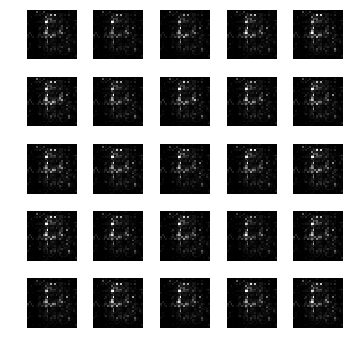

epoch: 511, time: 4.934187 | train_G_Loss: 0.543908, train_D_loss: 3.934581, train_acc: 0.130859
cv_G_Loss: 0.599502, cv_D_loss: 4.278228, cv_acc: 0.113500

epoch: 512, time: 4.899144 | train_G_Loss: 0.560724, train_D_loss: 4.497434, train_acc: 0.095703
cv_G_Loss: 0.604345, cv_D_loss: 4.317699, cv_acc: 0.113500

epoch: 513, time: 4.903241 | train_G_Loss: 0.506727, train_D_loss: 4.460273, train_acc: 0.136719
cv_G_Loss: 0.509785, cv_D_loss: 4.239142, cv_acc: 0.204200

epoch: 514, time: 4.904084 | train_G_Loss: 0.595768, train_D_loss: 4.189620, train_acc: 0.140625
cv_G_Loss: 0.675077, cv_D_loss: 4.371813, cv_acc: 0.091500

epoch: 515, time: 4.914281 | train_G_Loss: 0.533776, train_D_loss: 1.423589, train_acc: 0.111328
cv_G_Loss: 0.594217, cv_D_loss: 4.326651, cv_acc: 0.104200

epoch: 516, time: 4.940746 | train_G_Loss: 0.440492, train_D_loss: 4.133624, train_acc: 0.091797
cv_G_Loss: 0.416345, cv_D_loss: 4.228246, cv_acc: 0.095800

epoch: 517, time: 4.911361 | train_G_Loss: 0.477310, train

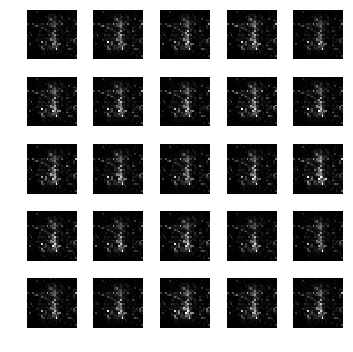

epoch: 521, time: 4.926806 | train_G_Loss: 0.489579, train_D_loss: 1.440785, train_acc: 0.105469
cv_G_Loss: 0.469877, cv_D_loss: 4.217482, cv_acc: 0.113500

epoch: 522, time: 4.906716 | train_G_Loss: 0.489755, train_D_loss: 4.081279, train_acc: 0.142578
cv_G_Loss: 0.482812, cv_D_loss: 4.232596, cv_acc: 0.150900

epoch: 523, time: 4.915614 | train_G_Loss: 0.629436, train_D_loss: 4.071172, train_acc: 0.101562
cv_G_Loss: 0.732579, cv_D_loss: 4.431313, cv_acc: 0.095800

epoch: 524, time: 4.920991 | train_G_Loss: 0.494600, train_D_loss: 1.437992, train_acc: 0.181641
cv_G_Loss: 0.505519, cv_D_loss: 4.252956, cv_acc: 0.155200

epoch: 525, time: 4.912125 | train_G_Loss: 0.530172, train_D_loss: 1.420653, train_acc: 0.158203
cv_G_Loss: 0.515927, cv_D_loss: 4.278124, cv_acc: 0.123600

epoch: 526, time: 4.918634 | train_G_Loss: 0.470019, train_D_loss: 1.452127, train_acc: 0.103516
cv_G_Loss: 0.461288, cv_D_loss: 4.233303, cv_acc: 0.097400

epoch: 527, time: 4.918744 | train_G_Loss: 0.542477, train

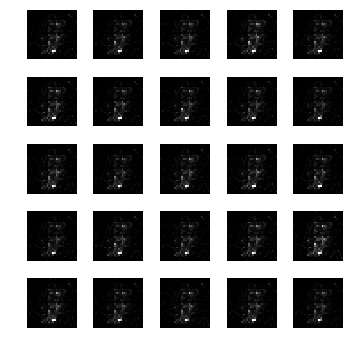

epoch: 531, time: 4.935339 | train_G_Loss: 0.473338, train_D_loss: 4.162908, train_acc: 0.101562
cv_G_Loss: 0.464340, cv_D_loss: 4.256617, cv_acc: 0.101000

epoch: 532, time: 4.911987 | train_G_Loss: 0.425829, train_D_loss: 1.486559, train_acc: 0.091797
cv_G_Loss: 0.402827, cv_D_loss: 4.230233, cv_acc: 0.098000

epoch: 533, time: 4.912302 | train_G_Loss: 0.508738, train_D_loss: 1.431785, train_acc: 0.134766
cv_G_Loss: 0.500020, cv_D_loss: 4.256919, cv_acc: 0.133700

epoch: 534, time: 4.908814 | train_G_Loss: 0.516329, train_D_loss: 1.428955, train_acc: 0.095703
cv_G_Loss: 0.508604, cv_D_loss: 4.270166, cv_acc: 0.098000

epoch: 535, time: 4.915635 | train_G_Loss: 0.474137, train_D_loss: 3.913026, train_acc: 0.107422
cv_G_Loss: 0.467921, cv_D_loss: 4.213695, cv_acc: 0.098000

epoch: 536, time: 4.920343 | train_G_Loss: 0.528730, train_D_loss: 3.892699, train_acc: 0.103516
cv_G_Loss: 0.515701, cv_D_loss: 4.235659, cv_acc: 0.097400

epoch: 537, time: 4.909237 | train_G_Loss: 0.475312, train

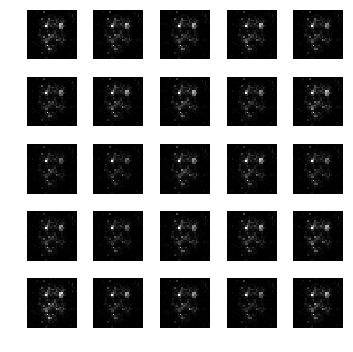

epoch: 541, time: 4.934618 | train_G_Loss: 0.544100, train_D_loss: 4.215327, train_acc: 0.099609
cv_G_Loss: 0.653632, cv_D_loss: 4.327106, cv_acc: 0.153100

epoch: 542, time: 4.906378 | train_G_Loss: 0.470075, train_D_loss: 1.453008, train_acc: 0.093750
cv_G_Loss: 0.421094, cv_D_loss: 4.206679, cv_acc: 0.101000

epoch: 543, time: 4.911978 | train_G_Loss: 0.453949, train_D_loss: 1.463720, train_acc: 0.111328
cv_G_Loss: 0.408272, cv_D_loss: 4.210431, cv_acc: 0.101000

epoch: 544, time: 4.918011 | train_G_Loss: 0.443790, train_D_loss: 3.968638, train_acc: 0.099609
cv_G_Loss: 0.408397, cv_D_loss: 4.211932, cv_acc: 0.103200

epoch: 545, time: 4.916515 | train_G_Loss: 0.556277, train_D_loss: 1.410112, train_acc: 0.119141
cv_G_Loss: 0.577998, cv_D_loss: 4.286223, cv_acc: 0.102800

epoch: 546, time: 4.914785 | train_G_Loss: 0.496670, train_D_loss: 4.446571, train_acc: 0.134766
cv_G_Loss: 0.519287, cv_D_loss: 4.218200, cv_acc: 0.102800

epoch: 547, time: 4.898539 | train_G_Loss: 0.585848, train

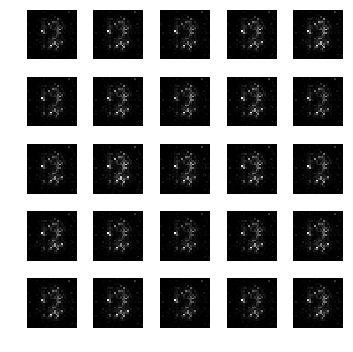

epoch: 551, time: 4.945867 | train_G_Loss: 0.517508, train_D_loss: 3.884475, train_acc: 0.095703
cv_G_Loss: 0.513111, cv_D_loss: 4.288190, cv_acc: 0.100900

epoch: 552, time: 4.915965 | train_G_Loss: 0.543143, train_D_loss: 1.413331, train_acc: 0.101562
cv_G_Loss: 0.604211, cv_D_loss: 4.311345, cv_acc: 0.098200

epoch: 553, time: 4.909266 | train_G_Loss: 0.405383, train_D_loss: 4.260076, train_acc: 0.164062
cv_G_Loss: 0.359027, cv_D_loss: 4.212945, cv_acc: 0.109100

epoch: 554, time: 4.904754 | train_G_Loss: 0.505944, train_D_loss: 1.431635, train_acc: 0.105469
cv_G_Loss: 0.511424, cv_D_loss: 4.237465, cv_acc: 0.102800

epoch: 555, time: 4.913200 | train_G_Loss: 0.490490, train_D_loss: 4.313676, train_acc: 0.113281
cv_G_Loss: 0.481968, cv_D_loss: 4.222548, cv_acc: 0.105600

epoch: 556, time: 4.913290 | train_G_Loss: 0.600771, train_D_loss: 4.075784, train_acc: 0.113281
cv_G_Loss: 0.684673, cv_D_loss: 4.379935, cv_acc: 0.153600

epoch: 557, time: 4.918018 | train_G_Loss: 0.545700, train

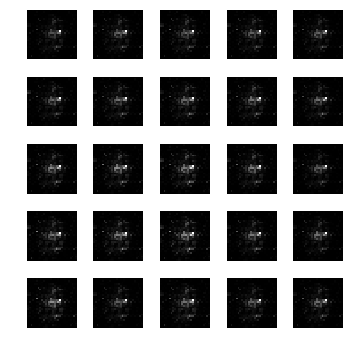

epoch: 561, time: 4.949128 | train_G_Loss: 0.489190, train_D_loss: 1.439588, train_acc: 0.113281
cv_G_Loss: 0.458565, cv_D_loss: 4.237929, cv_acc: 0.101000

epoch: 562, time: 4.915834 | train_G_Loss: 0.521989, train_D_loss: 4.261666, train_acc: 0.099609
cv_G_Loss: 0.533236, cv_D_loss: 4.266088, cv_acc: 0.089200

epoch: 563, time: 4.909129 | train_G_Loss: 0.621794, train_D_loss: 4.705233, train_acc: 0.107422
cv_G_Loss: 0.724478, cv_D_loss: 4.421784, cv_acc: 0.101000

epoch: 564, time: 4.912371 | train_G_Loss: 0.558024, train_D_loss: 1.408672, train_acc: 0.095703
cv_G_Loss: 0.649476, cv_D_loss: 4.347358, cv_acc: 0.102900

epoch: 565, time: 4.901052 | train_G_Loss: 0.493451, train_D_loss: 4.242735, train_acc: 0.085938
cv_G_Loss: 0.469650, cv_D_loss: 4.211404, cv_acc: 0.095800

epoch: 566, time: 4.916468 | train_G_Loss: 0.581945, train_D_loss: 1.403331, train_acc: 0.089844
cv_G_Loss: 0.631302, cv_D_loss: 4.309076, cv_acc: 0.095800

epoch: 567, time: 4.916973 | train_G_Loss: 0.416539, train

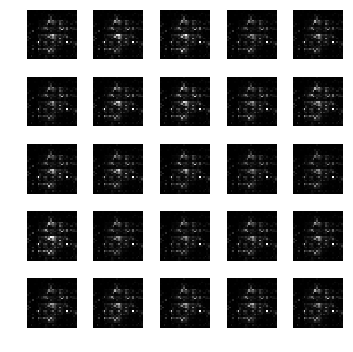

epoch: 571, time: 4.931681 | train_G_Loss: 0.474470, train_D_loss: 1.450296, train_acc: 0.080078
cv_G_Loss: 0.432294, cv_D_loss: 4.209697, cv_acc: 0.100900

epoch: 572, time: 4.914875 | train_G_Loss: 0.509929, train_D_loss: 1.429690, train_acc: 0.082031
cv_G_Loss: 0.530750, cv_D_loss: 4.246831, cv_acc: 0.100900

epoch: 573, time: 4.921996 | train_G_Loss: 0.579610, train_D_loss: 4.400467, train_acc: 0.093750
cv_G_Loss: 0.592485, cv_D_loss: 4.305069, cv_acc: 0.100900

epoch: 574, time: 4.894885 | train_G_Loss: 0.563637, train_D_loss: 4.295262, train_acc: 0.103516
cv_G_Loss: 0.627378, cv_D_loss: 4.331501, cv_acc: 0.113500

epoch: 575, time: 4.901780 | train_G_Loss: 0.469018, train_D_loss: 1.453639, train_acc: 0.113281
cv_G_Loss: 0.456725, cv_D_loss: 4.236005, cv_acc: 0.113500

epoch: 576, time: 4.910036 | train_G_Loss: 0.482587, train_D_loss: 1.448426, train_acc: 0.109375
cv_G_Loss: 0.475060, cv_D_loss: 4.281478, cv_acc: 0.113500

epoch: 577, time: 4.902897 | train_G_Loss: 0.569131, train

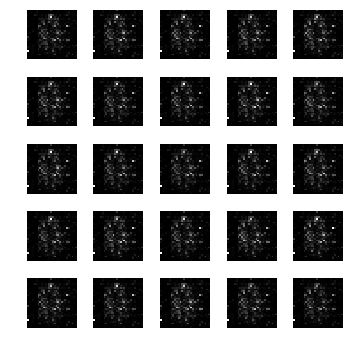

epoch: 581, time: 4.925494 | train_G_Loss: 0.516824, train_D_loss: 1.425811, train_acc: 0.101562
cv_G_Loss: 0.537902, cv_D_loss: 4.279415, cv_acc: 0.102800

epoch: 582, time: 4.898887 | train_G_Loss: 0.550111, train_D_loss: 3.906693, train_acc: 0.136719
cv_G_Loss: 0.526551, cv_D_loss: 4.281821, cv_acc: 0.148200

epoch: 583, time: 4.897956 | train_G_Loss: 0.468745, train_D_loss: 1.454275, train_acc: 0.091797
cv_G_Loss: 0.454665, cv_D_loss: 4.229038, cv_acc: 0.095800

epoch: 584, time: 4.914366 | train_G_Loss: 0.438258, train_D_loss: 1.474907, train_acc: 0.107422
cv_G_Loss: 0.389490, cv_D_loss: 4.206189, cv_acc: 0.113500

epoch: 585, time: 4.909240 | train_G_Loss: 0.592127, train_D_loss: 1.397895, train_acc: 0.148438
cv_G_Loss: 0.654083, cv_D_loss: 4.326447, cv_acc: 0.209300

epoch: 586, time: 4.901674 | train_G_Loss: 0.616167, train_D_loss: 1.394391, train_acc: 0.181641
cv_G_Loss: 0.692873, cv_D_loss: 4.372693, cv_acc: 0.151300

epoch: 587, time: 4.903546 | train_G_Loss: 0.466233, train

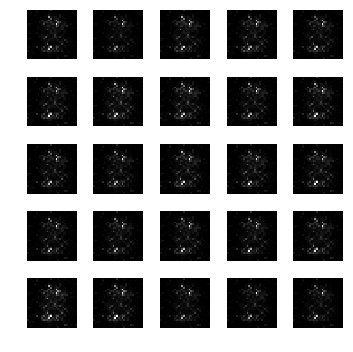

epoch: 591, time: 4.943022 | train_G_Loss: 0.484307, train_D_loss: 4.329000, train_acc: 0.117188
cv_G_Loss: 0.488944, cv_D_loss: 4.220542, cv_acc: 0.100900

epoch: 592, time: 4.907883 | train_G_Loss: 0.551777, train_D_loss: 4.524002, train_acc: 0.099609
cv_G_Loss: 0.611251, cv_D_loss: 4.294202, cv_acc: 0.100900

epoch: 593, time: 4.903221 | train_G_Loss: 0.529466, train_D_loss: 4.355815, train_acc: 0.089844
cv_G_Loss: 0.574106, cv_D_loss: 4.265187, cv_acc: 0.103100

epoch: 594, time: 4.908634 | train_G_Loss: 0.509007, train_D_loss: 1.430209, train_acc: 0.160156
cv_G_Loss: 0.504572, cv_D_loss: 4.246741, cv_acc: 0.152700

epoch: 595, time: 4.908567 | train_G_Loss: 0.424704, train_D_loss: 4.241366, train_acc: 0.093750
cv_G_Loss: 0.393584, cv_D_loss: 4.204604, cv_acc: 0.100900

epoch: 596, time: 4.907785 | train_G_Loss: 0.539122, train_D_loss: 1.416922, train_acc: 0.103516
cv_G_Loss: 0.585879, cv_D_loss: 4.276618, cv_acc: 0.107700

epoch: 597, time: 4.903751 | train_G_Loss: 0.455439, train

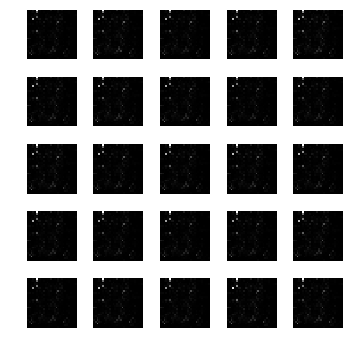

epoch: 601, time: 4.929604 | train_G_Loss: 0.500739, train_D_loss: 4.252137, train_acc: 0.115234
cv_G_Loss: 0.477579, cv_D_loss: 4.216791, cv_acc: 0.100900

epoch: 602, time: 4.907678 | train_G_Loss: 0.502701, train_D_loss: 1.432430, train_acc: 0.136719
cv_G_Loss: 0.515927, cv_D_loss: 4.246694, cv_acc: 0.120600

epoch: 603, time: 4.896913 | train_G_Loss: 0.488522, train_D_loss: 4.387476, train_acc: 0.113281
cv_G_Loss: 0.500743, cv_D_loss: 4.254510, cv_acc: 0.113500

epoch: 604, time: 4.905504 | train_G_Loss: 0.482703, train_D_loss: 4.152294, train_acc: 0.138672
cv_G_Loss: 0.440130, cv_D_loss: 4.228583, cv_acc: 0.231300

epoch: 605, time: 4.900166 | train_G_Loss: 0.466112, train_D_loss: 4.158866, train_acc: 0.111328
cv_G_Loss: 0.407842, cv_D_loss: 4.227803, cv_acc: 0.101000

epoch: 606, time: 4.906867 | train_G_Loss: 0.512258, train_D_loss: 1.428854, train_acc: 0.107422
cv_G_Loss: 0.508304, cv_D_loss: 4.258348, cv_acc: 0.101000

epoch: 607, time: 4.919990 | train_G_Loss: 0.520342, train

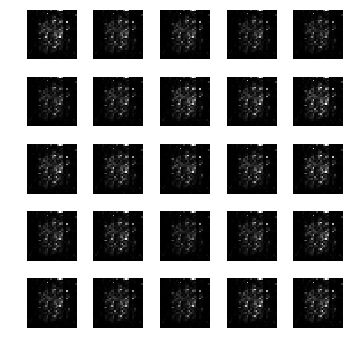

epoch: 611, time: 4.940125 | train_G_Loss: 0.579292, train_D_loss: 1.403288, train_acc: 0.177734
cv_G_Loss: 0.771412, cv_D_loss: 4.451070, cv_acc: 0.206500

epoch: 612, time: 4.896522 | train_G_Loss: 0.547560, train_D_loss: 1.413999, train_acc: 0.091797
cv_G_Loss: 0.560517, cv_D_loss: 4.275034, cv_acc: 0.102800

epoch: 613, time: 4.918194 | train_G_Loss: 0.485640, train_D_loss: 3.968252, train_acc: 0.171875
cv_G_Loss: 0.495478, cv_D_loss: 4.225397, cv_acc: 0.176400

epoch: 614, time: 4.893057 | train_G_Loss: 0.483959, train_D_loss: 1.445665, train_acc: 0.148438
cv_G_Loss: 0.500331, cv_D_loss: 4.234130, cv_acc: 0.169200

epoch: 615, time: 4.905639 | train_G_Loss: 0.492756, train_D_loss: 4.288845, train_acc: 0.240234
cv_G_Loss: 0.515965, cv_D_loss: 4.245331, cv_acc: 0.236000

epoch: 616, time: 4.908054 | train_G_Loss: 0.462848, train_D_loss: 4.239445, train_acc: 0.107422
cv_G_Loss: 0.426124, cv_D_loss: 4.216104, cv_acc: 0.103200

epoch: 617, time: 4.909565 | train_G_Loss: 0.522263, train

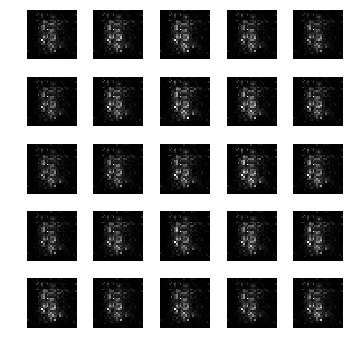

epoch: 621, time: 4.935378 | train_G_Loss: 0.558698, train_D_loss: 4.584053, train_acc: 0.105469
cv_G_Loss: 0.592953, cv_D_loss: 4.340017, cv_acc: 0.113500

epoch: 622, time: 4.900136 | train_G_Loss: 0.480960, train_D_loss: 4.057760, train_acc: 0.199219
cv_G_Loss: 0.441053, cv_D_loss: 4.231182, cv_acc: 0.226200

epoch: 623, time: 4.904073 | train_G_Loss: 0.493578, train_D_loss: 4.059620, train_acc: 0.117188
cv_G_Loss: 0.471076, cv_D_loss: 4.251286, cv_acc: 0.101000

epoch: 624, time: 4.906229 | train_G_Loss: 0.481239, train_D_loss: 4.539337, train_acc: 0.095703
cv_G_Loss: 0.449282, cv_D_loss: 4.219537, cv_acc: 0.101000

epoch: 625, time: 4.900995 | train_G_Loss: 0.477653, train_D_loss: 4.050494, train_acc: 0.195312
cv_G_Loss: 0.448804, cv_D_loss: 4.259057, cv_acc: 0.189400

epoch: 626, time: 4.900560 | train_G_Loss: 0.519922, train_D_loss: 4.022089, train_acc: 0.189453
cv_G_Loss: 0.596487, cv_D_loss: 4.310235, cv_acc: 0.187400

epoch: 627, time: 4.906991 | train_G_Loss: 0.553684, train

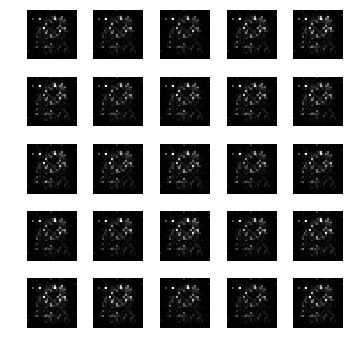

epoch: 631, time: 4.934549 | train_G_Loss: 0.451632, train_D_loss: 4.180037, train_acc: 0.158203
cv_G_Loss: 0.390411, cv_D_loss: 4.218964, cv_acc: 0.102300

epoch: 632, time: 4.912565 | train_G_Loss: 0.519913, train_D_loss: 4.161165, train_acc: 0.103516
cv_G_Loss: 0.550661, cv_D_loss: 4.276848, cv_acc: 0.109800

epoch: 633, time: 4.902109 | train_G_Loss: 0.502759, train_D_loss: 3.973780, train_acc: 0.167969
cv_G_Loss: 0.474396, cv_D_loss: 4.242676, cv_acc: 0.189700

epoch: 634, time: 4.920585 | train_G_Loss: 0.556526, train_D_loss: 1.408951, train_acc: 0.087891
cv_G_Loss: 0.602563, cv_D_loss: 4.303865, cv_acc: 0.095800

epoch: 635, time: 4.925117 | train_G_Loss: 0.504002, train_D_loss: 1.431544, train_acc: 0.105469
cv_G_Loss: 0.524054, cv_D_loss: 4.220212, cv_acc: 0.100900

epoch: 636, time: 4.917830 | train_G_Loss: 0.462831, train_D_loss: 1.455895, train_acc: 0.091797
cv_G_Loss: 0.425644, cv_D_loss: 4.185527, cv_acc: 0.099900

epoch: 637, time: 4.923997 | train_G_Loss: 0.543258, train

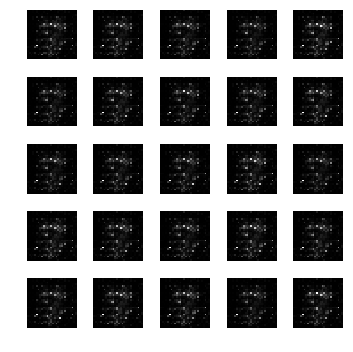

epoch: 641, time: 4.949084 | train_G_Loss: 0.495009, train_D_loss: 4.312709, train_acc: 0.197266
cv_G_Loss: 0.508574, cv_D_loss: 4.231487, cv_acc: 0.274200
Model saved

epoch: 642, time: 4.932565 | train_G_Loss: 0.452941, train_D_loss: 4.051004, train_acc: 0.109375
cv_G_Loss: 0.427444, cv_D_loss: 4.210295, cv_acc: 0.108300

epoch: 643, time: 4.900618 | train_G_Loss: 0.388547, train_D_loss: 1.523441, train_acc: 0.111328
cv_G_Loss: 0.323968, cv_D_loss: 4.238793, cv_acc: 0.102800

epoch: 644, time: 4.889154 | train_G_Loss: 0.488192, train_D_loss: 3.980836, train_acc: 0.080078
cv_G_Loss: 0.447895, cv_D_loss: 4.230970, cv_acc: 0.134200

epoch: 645, time: 4.910706 | train_G_Loss: 0.442872, train_D_loss: 1.474533, train_acc: 0.107422
cv_G_Loss: 0.404522, cv_D_loss: 4.202314, cv_acc: 0.113500

epoch: 646, time: 4.911691 | train_G_Loss: 0.489009, train_D_loss: 1.439990, train_acc: 0.144531
cv_G_Loss: 0.479788, cv_D_loss: 4.209766, cv_acc: 0.191100

epoch: 647, time: 4.899203 | train_G_Loss: 0.5

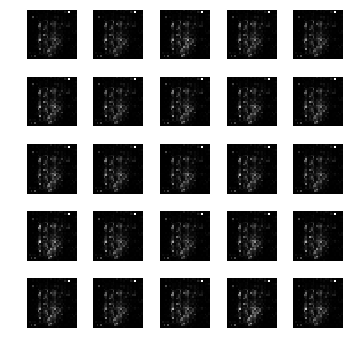

epoch: 651, time: 4.929457 | train_G_Loss: 0.521993, train_D_loss: 4.115441, train_acc: 0.107422
cv_G_Loss: 0.523846, cv_D_loss: 4.260146, cv_acc: 0.113600

epoch: 652, time: 4.920147 | train_G_Loss: 0.622806, train_D_loss: 4.643526, train_acc: 0.091797
cv_G_Loss: 0.723871, cv_D_loss: 4.419650, cv_acc: 0.097400

epoch: 653, time: 4.935298 | train_G_Loss: 0.427687, train_D_loss: 1.484553, train_acc: 0.099609
cv_G_Loss: 0.393763, cv_D_loss: 4.205610, cv_acc: 0.098500

epoch: 654, time: 4.904621 | train_G_Loss: 0.525144, train_D_loss: 1.420789, train_acc: 0.160156
cv_G_Loss: 0.515395, cv_D_loss: 4.221465, cv_acc: 0.102700

epoch: 655, time: 4.898416 | train_G_Loss: 0.514511, train_D_loss: 4.138096, train_acc: 0.226562
cv_G_Loss: 0.527149, cv_D_loss: 4.235773, cv_acc: 0.252200

epoch: 656, time: 4.908705 | train_G_Loss: 0.467879, train_D_loss: 4.344594, train_acc: 0.105469
cv_G_Loss: 0.463228, cv_D_loss: 4.233959, cv_acc: 0.143100

epoch: 657, time: 4.897496 | train_G_Loss: 0.522956, train

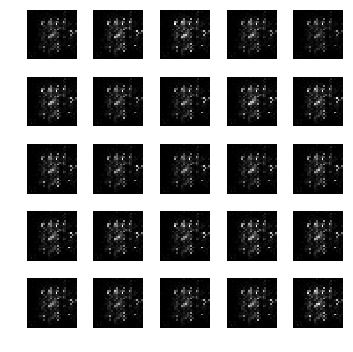

epoch: 661, time: 4.921248 | train_G_Loss: 0.527522, train_D_loss: 4.530953, train_acc: 0.117188
cv_G_Loss: 0.499174, cv_D_loss: 4.246956, cv_acc: 0.109800

epoch: 662, time: 4.902120 | train_G_Loss: 0.559816, train_D_loss: 3.871079, train_acc: 0.167969
cv_G_Loss: 0.618887, cv_D_loss: 4.325206, cv_acc: 0.154300

epoch: 663, time: 4.898668 | train_G_Loss: 0.499164, train_D_loss: 1.437446, train_acc: 0.093750
cv_G_Loss: 0.534020, cv_D_loss: 4.269022, cv_acc: 0.098300

epoch: 664, time: 4.905880 | train_G_Loss: 0.508963, train_D_loss: 1.430377, train_acc: 0.111328
cv_G_Loss: 0.516414, cv_D_loss: 4.251767, cv_acc: 0.098300

epoch: 665, time: 4.907832 | train_G_Loss: 0.481293, train_D_loss: 1.445187, train_acc: 0.109375
cv_G_Loss: 0.480317, cv_D_loss: 4.238842, cv_acc: 0.100900

epoch: 666, time: 4.898741 | train_G_Loss: 0.542071, train_D_loss: 1.414698, train_acc: 0.119141
cv_G_Loss: 0.551395, cv_D_loss: 4.267533, cv_acc: 0.100900

epoch: 667, time: 4.896694 | train_G_Loss: 0.445072, train

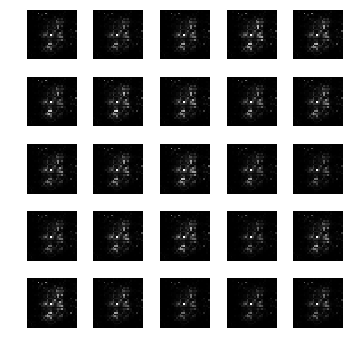

epoch: 671, time: 4.914348 | train_G_Loss: 0.465307, train_D_loss: 1.454974, train_acc: 0.111328
cv_G_Loss: 0.466133, cv_D_loss: 4.228889, cv_acc: 0.088600

epoch: 672, time: 4.904443 | train_G_Loss: 0.506589, train_D_loss: 1.432430, train_acc: 0.091797
cv_G_Loss: 0.511302, cv_D_loss: 4.250999, cv_acc: 0.111900

epoch: 673, time: 4.907676 | train_G_Loss: 0.478136, train_D_loss: 1.448430, train_acc: 0.091797
cv_G_Loss: 0.459533, cv_D_loss: 4.218239, cv_acc: 0.100900

epoch: 674, time: 4.908222 | train_G_Loss: 0.491846, train_D_loss: 1.439822, train_acc: 0.097656
cv_G_Loss: 0.504282, cv_D_loss: 4.233280, cv_acc: 0.097400

epoch: 675, time: 4.905809 | train_G_Loss: 0.482993, train_D_loss: 4.057956, train_acc: 0.095703
cv_G_Loss: 0.475918, cv_D_loss: 4.219558, cv_acc: 0.116500

epoch: 676, time: 4.931568 | train_G_Loss: 0.562566, train_D_loss: 3.764944, train_acc: 0.097656
cv_G_Loss: 0.591235, cv_D_loss: 4.299062, cv_acc: 0.102800

epoch: 677, time: 4.917526 | train_G_Loss: 0.639852, train

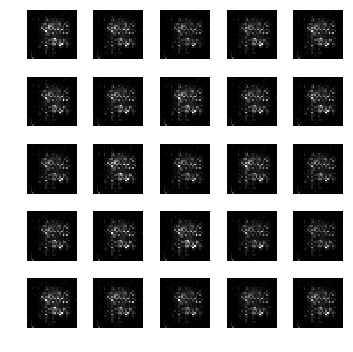

epoch: 681, time: 4.931915 | train_G_Loss: 0.461614, train_D_loss: 4.271698, train_acc: 0.097656
cv_G_Loss: 0.452961, cv_D_loss: 4.181019, cv_acc: 0.102800

epoch: 682, time: 4.889869 | train_G_Loss: 0.577765, train_D_loss: 1.403243, train_acc: 0.099609
cv_G_Loss: 0.632458, cv_D_loss: 4.289945, cv_acc: 0.098200

epoch: 683, time: 4.906824 | train_G_Loss: 0.491106, train_D_loss: 1.438476, train_acc: 0.087891
cv_G_Loss: 0.448029, cv_D_loss: 4.213213, cv_acc: 0.098200

epoch: 684, time: 4.902210 | train_G_Loss: 0.535932, train_D_loss: 4.115369, train_acc: 0.130859
cv_G_Loss: 0.654344, cv_D_loss: 4.332002, cv_acc: 0.144200

epoch: 685, time: 4.898772 | train_G_Loss: 0.547918, train_D_loss: 1.415483, train_acc: 0.123047
cv_G_Loss: 0.568331, cv_D_loss: 4.287951, cv_acc: 0.113500

epoch: 686, time: 4.904132 | train_G_Loss: 0.522038, train_D_loss: 1.422682, train_acc: 0.117188
cv_G_Loss: 0.568671, cv_D_loss: 4.272891, cv_acc: 0.101000

epoch: 687, time: 4.893070 | train_G_Loss: 0.502795, train

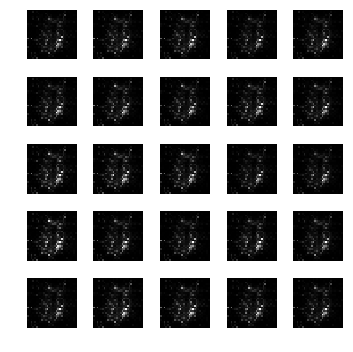

epoch: 691, time: 4.926963 | train_G_Loss: 0.514395, train_D_loss: 4.175482, train_acc: 0.097656
cv_G_Loss: 0.523028, cv_D_loss: 4.260352, cv_acc: 0.097600

epoch: 692, time: 4.900150 | train_G_Loss: 0.507265, train_D_loss: 1.431639, train_acc: 0.101562
cv_G_Loss: 0.485979, cv_D_loss: 4.222790, cv_acc: 0.098000

epoch: 693, time: 4.898003 | train_G_Loss: 0.566894, train_D_loss: 4.225129, train_acc: 0.167969
cv_G_Loss: 0.594140, cv_D_loss: 4.278354, cv_acc: 0.171200

epoch: 694, time: 4.896709 | train_G_Loss: 0.540515, train_D_loss: 4.163596, train_acc: 0.101562
cv_G_Loss: 0.521305, cv_D_loss: 4.249201, cv_acc: 0.113500

epoch: 695, time: 4.898233 | train_G_Loss: 0.478607, train_D_loss: 4.313436, train_acc: 0.128906
cv_G_Loss: 0.436408, cv_D_loss: 4.207907, cv_acc: 0.144500

epoch: 696, time: 4.908498 | train_G_Loss: 0.522535, train_D_loss: 1.422454, train_acc: 0.128906
cv_G_Loss: 0.528381, cv_D_loss: 4.264168, cv_acc: 0.113700

epoch: 697, time: 4.899533 | train_G_Loss: 0.571709, train

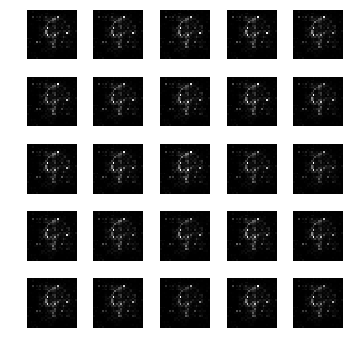

epoch: 701, time: 4.951960 | train_G_Loss: 0.476515, train_D_loss: 1.448257, train_acc: 0.089844
cv_G_Loss: 0.479280, cv_D_loss: 4.206376, cv_acc: 0.105200

epoch: 702, time: 4.901113 | train_G_Loss: 0.508585, train_D_loss: 3.878826, train_acc: 0.128906
cv_G_Loss: 0.506172, cv_D_loss: 4.210379, cv_acc: 0.113500

epoch: 703, time: 4.889056 | train_G_Loss: 0.534774, train_D_loss: 1.417188, train_acc: 0.191406
cv_G_Loss: 0.556382, cv_D_loss: 4.253106, cv_acc: 0.120000

epoch: 704, time: 4.904520 | train_G_Loss: 0.515780, train_D_loss: 1.427610, train_acc: 0.089844
cv_G_Loss: 0.494489, cv_D_loss: 4.214091, cv_acc: 0.100900

epoch: 705, time: 4.901585 | train_G_Loss: 0.540666, train_D_loss: 1.414642, train_acc: 0.095703
cv_G_Loss: 0.577792, cv_D_loss: 4.259062, cv_acc: 0.113600

epoch: 706, time: 4.906014 | train_G_Loss: 0.413735, train_D_loss: 1.497444, train_acc: 0.179688
cv_G_Loss: 0.323451, cv_D_loss: 4.206968, cv_acc: 0.181000

epoch: 707, time: 4.897512 | train_G_Loss: 0.589590, train

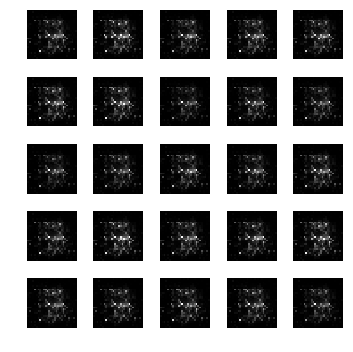

epoch: 711, time: 4.941364 | train_G_Loss: 0.490782, train_D_loss: 1.441833, train_acc: 0.187500
cv_G_Loss: 0.556855, cv_D_loss: 4.248621, cv_acc: 0.171600

epoch: 712, time: 4.902357 | train_G_Loss: 0.516310, train_D_loss: 4.302491, train_acc: 0.111328
cv_G_Loss: 0.517704, cv_D_loss: 4.230165, cv_acc: 0.121800

epoch: 713, time: 4.892234 | train_G_Loss: 0.525182, train_D_loss: 1.421794, train_acc: 0.117188
cv_G_Loss: 0.602545, cv_D_loss: 4.268204, cv_acc: 0.119900

epoch: 714, time: 4.905576 | train_G_Loss: 0.454136, train_D_loss: 4.054096, train_acc: 0.304688
cv_G_Loss: 0.425796, cv_D_loss: 4.176331, cv_acc: 0.298000
Model saved

epoch: 715, time: 4.934180 | train_G_Loss: 0.523406, train_D_loss: 1.422451, train_acc: 0.107422
cv_G_Loss: 0.495308, cv_D_loss: 4.220104, cv_acc: 0.097400

epoch: 716, time: 4.900519 | train_G_Loss: 0.478585, train_D_loss: 1.447843, train_acc: 0.097656
cv_G_Loss: 0.456059, cv_D_loss: 4.225902, cv_acc: 0.097400

epoch: 717, time: 4.898956 | train_G_Loss: 0.5

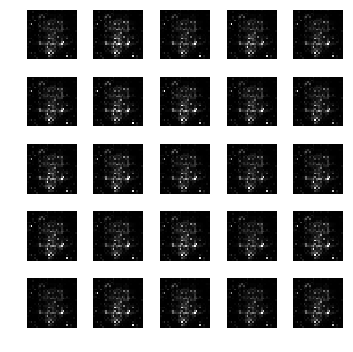

epoch: 721, time: 4.940845 | train_G_Loss: 0.557382, train_D_loss: 4.319542, train_acc: 0.169922
cv_G_Loss: 0.593686, cv_D_loss: 4.278967, cv_acc: 0.143100

epoch: 722, time: 4.925179 | train_G_Loss: 0.435824, train_D_loss: 4.166078, train_acc: 0.171875
cv_G_Loss: 0.378139, cv_D_loss: 4.211156, cv_acc: 0.179800

epoch: 723, time: 4.905902 | train_G_Loss: 0.478157, train_D_loss: 4.288949, train_acc: 0.099609
cv_G_Loss: 0.427719, cv_D_loss: 4.218401, cv_acc: 0.103200

epoch: 724, time: 4.923960 | train_G_Loss: 0.492335, train_D_loss: 4.434930, train_acc: 0.263672
cv_G_Loss: 0.476908, cv_D_loss: 4.220084, cv_acc: 0.158800

epoch: 725, time: 4.904642 | train_G_Loss: 0.557259, train_D_loss: 4.365399, train_acc: 0.181641
cv_G_Loss: 0.565051, cv_D_loss: 4.266048, cv_acc: 0.228500

epoch: 726, time: 4.903482 | train_G_Loss: 0.569673, train_D_loss: 4.613632, train_acc: 0.119141
cv_G_Loss: 0.618373, cv_D_loss: 4.319292, cv_acc: 0.098400

epoch: 727, time: 4.911723 | train_G_Loss: 0.499422, train

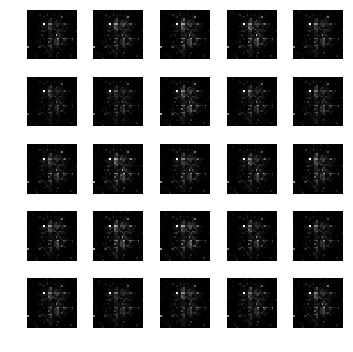

epoch: 731, time: 4.936530 | train_G_Loss: 0.575979, train_D_loss: 1.402682, train_acc: 0.146484
cv_G_Loss: 0.634711, cv_D_loss: 4.327362, cv_acc: 0.117300

epoch: 732, time: 4.916125 | train_G_Loss: 0.515013, train_D_loss: 4.193794, train_acc: 0.087891
cv_G_Loss: 0.569817, cv_D_loss: 4.259240, cv_acc: 0.101000

epoch: 733, time: 4.894735 | train_G_Loss: 0.441367, train_D_loss: 4.085873, train_acc: 0.078125
cv_G_Loss: 0.465383, cv_D_loss: 4.204553, cv_acc: 0.178500

epoch: 734, time: 4.915018 | train_G_Loss: 0.467734, train_D_loss: 4.120717, train_acc: 0.109375
cv_G_Loss: 0.432000, cv_D_loss: 4.195612, cv_acc: 0.100100

epoch: 735, time: 4.914654 | train_G_Loss: 0.423069, train_D_loss: 4.054966, train_acc: 0.070312
cv_G_Loss: 0.350578, cv_D_loss: 4.203031, cv_acc: 0.113700

epoch: 736, time: 4.917118 | train_G_Loss: 0.468765, train_D_loss: 4.385144, train_acc: 0.113281
cv_G_Loss: 0.425344, cv_D_loss: 4.226286, cv_acc: 0.103200

epoch: 737, time: 4.918673 | train_G_Loss: 0.530781, train

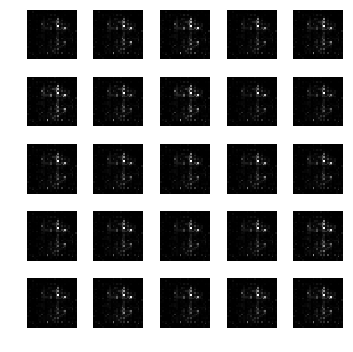

epoch: 741, time: 4.949111 | train_G_Loss: 0.499755, train_D_loss: 4.203143, train_acc: 0.099609
cv_G_Loss: 0.495356, cv_D_loss: 4.236042, cv_acc: 0.098000

epoch: 742, time: 4.909551 | train_G_Loss: 0.491278, train_D_loss: 4.249926, train_acc: 0.085938
cv_G_Loss: 0.472254, cv_D_loss: 4.214421, cv_acc: 0.097400

epoch: 743, time: 4.904929 | train_G_Loss: 0.571819, train_D_loss: 4.339503, train_acc: 0.097656
cv_G_Loss: 0.586811, cv_D_loss: 4.290009, cv_acc: 0.123300

epoch: 744, time: 4.930997 | train_G_Loss: 0.566773, train_D_loss: 1.407737, train_acc: 0.113281
cv_G_Loss: 0.653468, cv_D_loss: 4.339396, cv_acc: 0.101000

epoch: 745, time: 4.918262 | train_G_Loss: 0.500324, train_D_loss: 1.433678, train_acc: 0.177734
cv_G_Loss: 0.528707, cv_D_loss: 4.228231, cv_acc: 0.140400

epoch: 746, time: 4.905485 | train_G_Loss: 0.529550, train_D_loss: 4.182213, train_acc: 0.074219
cv_G_Loss: 0.530680, cv_D_loss: 4.253178, cv_acc: 0.097400

epoch: 747, time: 4.914813 | train_G_Loss: 0.523653, train

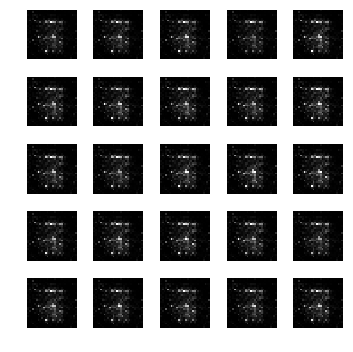

epoch: 751, time: 4.938759 | train_G_Loss: 0.539331, train_D_loss: 4.011661, train_acc: 0.083984
cv_G_Loss: 0.593565, cv_D_loss: 4.316534, cv_acc: 0.098200

epoch: 752, time: 4.908695 | train_G_Loss: 0.484224, train_D_loss: 1.443317, train_acc: 0.253906
cv_G_Loss: 0.436956, cv_D_loss: 4.182834, cv_acc: 0.254900

epoch: 753, time: 4.912637 | train_G_Loss: 0.517340, train_D_loss: 1.427606, train_acc: 0.103516
cv_G_Loss: 0.547743, cv_D_loss: 4.268603, cv_acc: 0.101300

epoch: 754, time: 4.899240 | train_G_Loss: 0.445864, train_D_loss: 1.471708, train_acc: 0.115234
cv_G_Loss: 0.434554, cv_D_loss: 4.210475, cv_acc: 0.098000

epoch: 755, time: 4.912400 | train_G_Loss: 0.636356, train_D_loss: 4.120838, train_acc: 0.080078
cv_G_Loss: 0.788282, cv_D_loss: 4.479918, cv_acc: 0.159000

epoch: 756, time: 4.914764 | train_G_Loss: 0.540246, train_D_loss: 1.414954, train_acc: 0.115234
cv_G_Loss: 0.574960, cv_D_loss: 4.262363, cv_acc: 0.103200

epoch: 757, time: 4.911902 | train_G_Loss: 0.448416, train

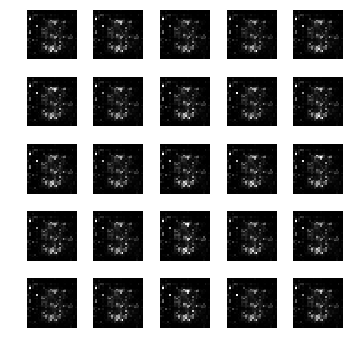

epoch: 761, time: 4.915699 | train_G_Loss: 0.591012, train_D_loss: 3.841333, train_acc: 0.160156
cv_G_Loss: 0.639243, cv_D_loss: 4.302084, cv_acc: 0.162700

epoch: 762, time: 4.897036 | train_G_Loss: 0.482556, train_D_loss: 1.444260, train_acc: 0.103516
cv_G_Loss: 0.462186, cv_D_loss: 4.194201, cv_acc: 0.117000

epoch: 763, time: 4.902639 | train_G_Loss: 0.525037, train_D_loss: 1.423818, train_acc: 0.240234
cv_G_Loss: 0.570210, cv_D_loss: 4.242034, cv_acc: 0.180500

epoch: 764, time: 4.913806 | train_G_Loss: 0.502897, train_D_loss: 1.438169, train_acc: 0.197266
cv_G_Loss: 0.534711, cv_D_loss: 4.217284, cv_acc: 0.196300

epoch: 765, time: 4.903692 | train_G_Loss: 0.496447, train_D_loss: 4.499566, train_acc: 0.255859
cv_G_Loss: 0.470248, cv_D_loss: 4.199733, cv_acc: 0.260700

epoch: 766, time: 4.909926 | train_G_Loss: 0.493946, train_D_loss: 4.268645, train_acc: 0.109375
cv_G_Loss: 0.551649, cv_D_loss: 4.219059, cv_acc: 0.191900

epoch: 767, time: 4.923514 | train_G_Loss: 0.497899, train

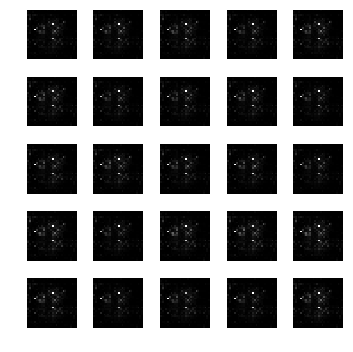

epoch: 771, time: 4.936011 | train_G_Loss: 0.563788, train_D_loss: 4.247272, train_acc: 0.093750
cv_G_Loss: 0.638635, cv_D_loss: 4.310503, cv_acc: 0.091100

epoch: 772, time: 4.905721 | train_G_Loss: 0.488091, train_D_loss: 3.919673, train_acc: 0.267578
cv_G_Loss: 0.475836, cv_D_loss: 4.218885, cv_acc: 0.216300

epoch: 773, time: 4.904398 | train_G_Loss: 0.460650, train_D_loss: 4.581666, train_acc: 0.175781
cv_G_Loss: 0.436280, cv_D_loss: 4.205467, cv_acc: 0.187000

epoch: 774, time: 4.895345 | train_G_Loss: 0.530428, train_D_loss: 1.416645, train_acc: 0.113281
cv_G_Loss: 0.587005, cv_D_loss: 4.244879, cv_acc: 0.120400

epoch: 775, time: 4.907235 | train_G_Loss: 0.528429, train_D_loss: 1.421907, train_acc: 0.125000
cv_G_Loss: 0.526481, cv_D_loss: 4.212085, cv_acc: 0.160400

epoch: 776, time: 4.894740 | train_G_Loss: 0.549152, train_D_loss: 4.348550, train_acc: 0.087891
cv_G_Loss: 0.582164, cv_D_loss: 4.246158, cv_acc: 0.098300

epoch: 777, time: 4.899392 | train_G_Loss: 0.447552, train

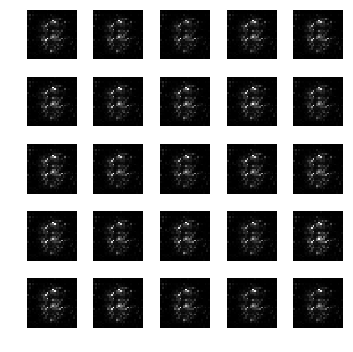

epoch: 781, time: 4.925755 | train_G_Loss: 0.476090, train_D_loss: 3.983300, train_acc: 0.156250
cv_G_Loss: 0.441852, cv_D_loss: 4.208906, cv_acc: 0.164000

epoch: 782, time: 4.902882 | train_G_Loss: 0.521652, train_D_loss: 4.340651, train_acc: 0.103516
cv_G_Loss: 0.627987, cv_D_loss: 4.307127, cv_acc: 0.105600

epoch: 783, time: 4.909431 | train_G_Loss: 0.539619, train_D_loss: 1.415561, train_acc: 0.242188
cv_G_Loss: 0.590374, cv_D_loss: 4.272015, cv_acc: 0.302300
Model saved

epoch: 784, time: 4.929828 | train_G_Loss: 0.498181, train_D_loss: 3.860615, train_acc: 0.111328
cv_G_Loss: 0.543870, cv_D_loss: 4.236382, cv_acc: 0.103800

epoch: 785, time: 4.905083 | train_G_Loss: 0.500603, train_D_loss: 1.435377, train_acc: 0.101562
cv_G_Loss: 0.461243, cv_D_loss: 4.214332, cv_acc: 0.098200

epoch: 786, time: 4.901890 | train_G_Loss: 0.539688, train_D_loss: 4.175974, train_acc: 0.119141
cv_G_Loss: 0.579886, cv_D_loss: 4.266488, cv_acc: 0.140900

epoch: 787, time: 4.909311 | train_G_Loss: 0.4

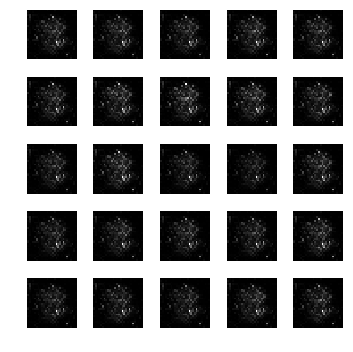

epoch: 791, time: 4.951995 | train_G_Loss: 0.485277, train_D_loss: 3.956634, train_acc: 0.207031
cv_G_Loss: 0.451534, cv_D_loss: 4.178484, cv_acc: 0.234800

epoch: 792, time: 4.909783 | train_G_Loss: 0.467887, train_D_loss: 4.446774, train_acc: 0.101562
cv_G_Loss: 0.447404, cv_D_loss: 4.182936, cv_acc: 0.100900

epoch: 793, time: 4.913657 | train_G_Loss: 0.479968, train_D_loss: 1.443431, train_acc: 0.144531
cv_G_Loss: 0.460682, cv_D_loss: 4.180784, cv_acc: 0.125700

epoch: 794, time: 4.907638 | train_G_Loss: 0.525614, train_D_loss: 1.421456, train_acc: 0.248047
cv_G_Loss: 0.550780, cv_D_loss: 4.221118, cv_acc: 0.234500

epoch: 795, time: 4.904184 | train_G_Loss: 0.472244, train_D_loss: 4.414901, train_acc: 0.212891
cv_G_Loss: 0.434596, cv_D_loss: 4.167648, cv_acc: 0.172600

epoch: 796, time: 4.909946 | train_G_Loss: 0.554502, train_D_loss: 4.107953, train_acc: 0.187500
cv_G_Loss: 0.604159, cv_D_loss: 4.241751, cv_acc: 0.212200

epoch: 797, time: 4.914927 | train_G_Loss: 0.475950, train

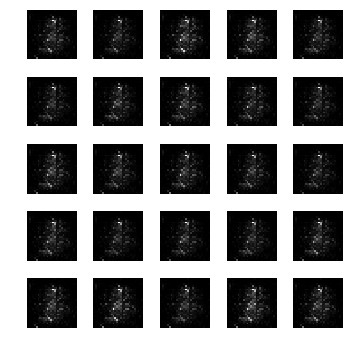

epoch: 801, time: 4.934255 | train_G_Loss: 0.447875, train_D_loss: 1.460715, train_acc: 0.179688
cv_G_Loss: 0.441229, cv_D_loss: 4.201421, cv_acc: 0.200100

epoch: 802, time: 4.900543 | train_G_Loss: 0.550524, train_D_loss: 1.412432, train_acc: 0.076172
cv_G_Loss: 0.553974, cv_D_loss: 4.255883, cv_acc: 0.097400

epoch: 803, time: 4.919545 | train_G_Loss: 0.548045, train_D_loss: 4.216076, train_acc: 0.140625
cv_G_Loss: 0.634008, cv_D_loss: 4.325450, cv_acc: 0.101700

epoch: 804, time: 4.911750 | train_G_Loss: 0.513729, train_D_loss: 1.429260, train_acc: 0.181641
cv_G_Loss: 0.525277, cv_D_loss: 4.202707, cv_acc: 0.207300

epoch: 805, time: 4.904731 | train_G_Loss: 0.460171, train_D_loss: 4.136081, train_acc: 0.117188
cv_G_Loss: 0.429700, cv_D_loss: 4.203693, cv_acc: 0.089200

epoch: 806, time: 4.899914 | train_G_Loss: 0.458212, train_D_loss: 4.169733, train_acc: 0.125000
cv_G_Loss: 0.397251, cv_D_loss: 4.154210, cv_acc: 0.089300

epoch: 807, time: 4.906176 | train_G_Loss: 0.480290, train

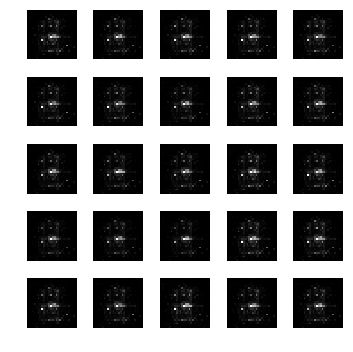

epoch: 811, time: 4.939940 | train_G_Loss: 0.510448, train_D_loss: 1.430284, train_acc: 0.214844
cv_G_Loss: 0.533980, cv_D_loss: 4.224561, cv_acc: 0.119100

epoch: 812, time: 4.913856 | train_G_Loss: 0.556358, train_D_loss: 1.406285, train_acc: 0.111328
cv_G_Loss: 0.645795, cv_D_loss: 4.277314, cv_acc: 0.215100

epoch: 813, time: 4.922693 | train_G_Loss: 0.521497, train_D_loss: 4.076309, train_acc: 0.191406
cv_G_Loss: 0.546205, cv_D_loss: 4.203380, cv_acc: 0.126900

epoch: 814, time: 4.917181 | train_G_Loss: 0.515678, train_D_loss: 3.881882, train_acc: 0.220703
cv_G_Loss: 0.522885, cv_D_loss: 4.197066, cv_acc: 0.147400

epoch: 815, time: 4.915709 | train_G_Loss: 0.501084, train_D_loss: 1.432771, train_acc: 0.183594
cv_G_Loss: 0.499041, cv_D_loss: 4.203880, cv_acc: 0.199100

epoch: 816, time: 4.918228 | train_G_Loss: 0.454857, train_D_loss: 1.460990, train_acc: 0.078125
cv_G_Loss: 0.480190, cv_D_loss: 4.204618, cv_acc: 0.098200

epoch: 817, time: 4.909273 | train_G_Loss: 0.480706, train

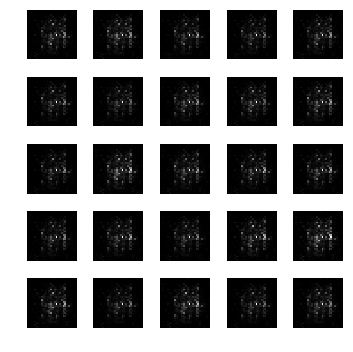

epoch: 821, time: 4.937946 | train_G_Loss: 0.524903, train_D_loss: 3.984762, train_acc: 0.183594
cv_G_Loss: 0.566238, cv_D_loss: 4.252756, cv_acc: 0.225500

epoch: 822, time: 4.903423 | train_G_Loss: 0.580554, train_D_loss: 1.401135, train_acc: 0.281250
cv_G_Loss: 0.599824, cv_D_loss: 4.269665, cv_acc: 0.212900

epoch: 823, time: 4.908955 | train_G_Loss: 0.548387, train_D_loss: 4.361251, train_acc: 0.421875
cv_G_Loss: 0.695121, cv_D_loss: 4.323190, cv_acc: 0.213700

epoch: 824, time: 4.908921 | train_G_Loss: 0.569844, train_D_loss: 4.390867, train_acc: 0.083984
cv_G_Loss: 0.625495, cv_D_loss: 4.292847, cv_acc: 0.098200

epoch: 825, time: 4.916832 | train_G_Loss: 0.490684, train_D_loss: 4.317341, train_acc: 0.142578
cv_G_Loss: 0.451024, cv_D_loss: 4.187586, cv_acc: 0.173000

epoch: 826, time: 4.900300 | train_G_Loss: 0.477216, train_D_loss: 1.447456, train_acc: 0.203125
cv_G_Loss: 0.469564, cv_D_loss: 4.193182, cv_acc: 0.115900

epoch: 827, time: 4.903808 | train_G_Loss: 0.529096, train

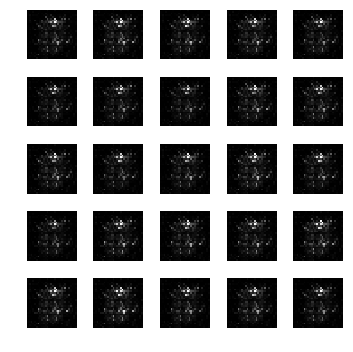

epoch: 831, time: 4.930587 | train_G_Loss: 0.507690, train_D_loss: 3.987062, train_acc: 0.277344
cv_G_Loss: 0.523295, cv_D_loss: 4.176198, cv_acc: 0.184500

epoch: 832, time: 4.918789 | train_G_Loss: 0.537888, train_D_loss: 4.127298, train_acc: 0.193359
cv_G_Loss: 0.538361, cv_D_loss: 4.191496, cv_acc: 0.256500

epoch: 833, time: 4.903785 | train_G_Loss: 0.481737, train_D_loss: 3.919537, train_acc: 0.103516
cv_G_Loss: 0.464223, cv_D_loss: 4.211689, cv_acc: 0.101000

epoch: 834, time: 4.904772 | train_G_Loss: 0.436463, train_D_loss: 1.471562, train_acc: 0.187500
cv_G_Loss: 0.376309, cv_D_loss: 4.192451, cv_acc: 0.102900

epoch: 835, time: 4.911661 | train_G_Loss: 0.507841, train_D_loss: 1.430206, train_acc: 0.189453
cv_G_Loss: 0.483752, cv_D_loss: 4.198163, cv_acc: 0.205300

epoch: 836, time: 4.936976 | train_G_Loss: 0.467701, train_D_loss: 1.453379, train_acc: 0.101562
cv_G_Loss: 0.464811, cv_D_loss: 4.197346, cv_acc: 0.101000

epoch: 837, time: 4.910724 | train_G_Loss: 0.595178, train

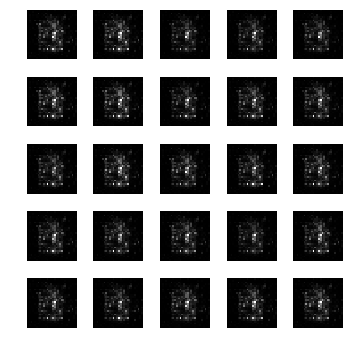

epoch: 841, time: 4.930664 | train_G_Loss: 0.492886, train_D_loss: 1.438143, train_acc: 0.246094
cv_G_Loss: 0.458189, cv_D_loss: 4.214933, cv_acc: 0.186700

epoch: 842, time: 4.902441 | train_G_Loss: 0.443708, train_D_loss: 1.473777, train_acc: 0.302734
cv_G_Loss: 0.393323, cv_D_loss: 4.191932, cv_acc: 0.294300

epoch: 843, time: 4.901947 | train_G_Loss: 0.514437, train_D_loss: 1.420419, train_acc: 0.142578
cv_G_Loss: 0.532651, cv_D_loss: 4.227961, cv_acc: 0.128300

epoch: 844, time: 4.896223 | train_G_Loss: 0.477079, train_D_loss: 4.693074, train_acc: 0.201172
cv_G_Loss: 0.459912, cv_D_loss: 4.199766, cv_acc: 0.186700

epoch: 845, time: 4.906596 | train_G_Loss: 0.518488, train_D_loss: 1.424405, train_acc: 0.162109
cv_G_Loss: 0.501691, cv_D_loss: 4.228456, cv_acc: 0.113500

epoch: 846, time: 4.898602 | train_G_Loss: 0.562857, train_D_loss: 4.205186, train_acc: 0.099609
cv_G_Loss: 0.736167, cv_D_loss: 4.448477, cv_acc: 0.166700

epoch: 847, time: 4.894950 | train_G_Loss: 0.558093, train

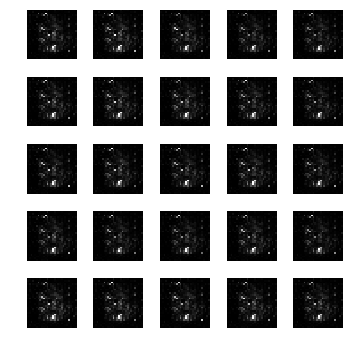

epoch: 851, time: 4.936342 | train_G_Loss: 0.442163, train_D_loss: 1.472663, train_acc: 0.189453
cv_G_Loss: 0.405226, cv_D_loss: 4.196425, cv_acc: 0.199900

epoch: 852, time: 4.903654 | train_G_Loss: 0.607323, train_D_loss: 1.394924, train_acc: 0.154297
cv_G_Loss: 0.752503, cv_D_loss: 4.400845, cv_acc: 0.168800

epoch: 853, time: 4.892144 | train_G_Loss: 0.532545, train_D_loss: 4.149180, train_acc: 0.148438
cv_G_Loss: 0.522322, cv_D_loss: 4.201406, cv_acc: 0.124600

epoch: 854, time: 4.894510 | train_G_Loss: 0.519863, train_D_loss: 1.422666, train_acc: 0.316406
cv_G_Loss: 0.536881, cv_D_loss: 4.176751, cv_acc: 0.250900

epoch: 855, time: 4.895039 | train_G_Loss: 0.523126, train_D_loss: 4.093796, train_acc: 0.347656
cv_G_Loss: 0.558222, cv_D_loss: 4.245064, cv_acc: 0.237500

epoch: 856, time: 4.906324 | train_G_Loss: 0.588575, train_D_loss: 1.395323, train_acc: 0.164062
cv_G_Loss: 0.641913, cv_D_loss: 4.293191, cv_acc: 0.242500

epoch: 857, time: 4.901393 | train_G_Loss: 0.515086, train

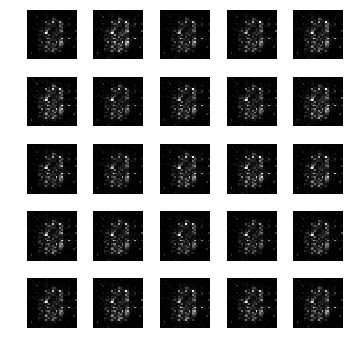

epoch: 861, time: 4.924035 | train_G_Loss: 0.423615, train_D_loss: 4.209967, train_acc: 0.181641
cv_G_Loss: 0.386899, cv_D_loss: 4.127483, cv_acc: 0.181700

epoch: 862, time: 4.915710 | train_G_Loss: 0.618407, train_D_loss: 1.391715, train_acc: 0.251953
cv_G_Loss: 0.771355, cv_D_loss: 4.395617, cv_acc: 0.280800

epoch: 863, time: 4.919420 | train_G_Loss: 0.494543, train_D_loss: 3.990777, train_acc: 0.140625
cv_G_Loss: 0.541354, cv_D_loss: 4.195745, cv_acc: 0.205600

epoch: 864, time: 4.902447 | train_G_Loss: 0.598613, train_D_loss: 3.770047, train_acc: 0.105469
cv_G_Loss: 0.717991, cv_D_loss: 4.394945, cv_acc: 0.103400

epoch: 865, time: 4.915098 | train_G_Loss: 0.458670, train_D_loss: 4.327318, train_acc: 0.191406
cv_G_Loss: 0.435756, cv_D_loss: 4.167925, cv_acc: 0.213600

epoch: 866, time: 4.912210 | train_G_Loss: 0.456035, train_D_loss: 1.462084, train_acc: 0.234375
cv_G_Loss: 0.439464, cv_D_loss: 4.166279, cv_acc: 0.260300

epoch: 867, time: 4.902597 | train_G_Loss: 0.538867, train

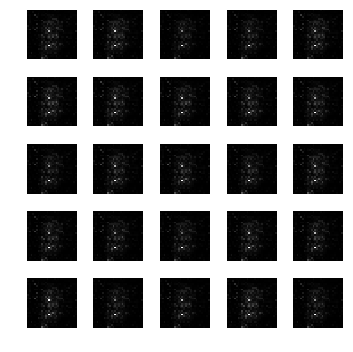

epoch: 871, time: 4.938423 | train_G_Loss: 0.521101, train_D_loss: 3.841365, train_acc: 0.089844
cv_G_Loss: 0.572075, cv_D_loss: 4.198305, cv_acc: 0.096500

epoch: 872, time: 4.903922 | train_G_Loss: 0.562645, train_D_loss: 1.400230, train_acc: 0.171875
cv_G_Loss: 0.620380, cv_D_loss: 4.221693, cv_acc: 0.179600

epoch: 873, time: 4.910568 | train_G_Loss: 0.486911, train_D_loss: 4.312136, train_acc: 0.343750
cv_G_Loss: 0.502409, cv_D_loss: 4.183293, cv_acc: 0.157600

epoch: 874, time: 4.904649 | train_G_Loss: 0.484751, train_D_loss: 4.302516, train_acc: 0.177734
cv_G_Loss: 0.419259, cv_D_loss: 4.133992, cv_acc: 0.122200

epoch: 875, time: 4.914277 | train_G_Loss: 0.509051, train_D_loss: 1.438643, train_acc: 0.154297
cv_G_Loss: 0.498528, cv_D_loss: 4.142185, cv_acc: 0.225300

epoch: 876, time: 4.899837 | train_G_Loss: 0.458009, train_D_loss: 4.209624, train_acc: 0.216797
cv_G_Loss: 0.445086, cv_D_loss: 4.094930, cv_acc: 0.215800

epoch: 877, time: 4.910138 | train_G_Loss: 0.486216, train

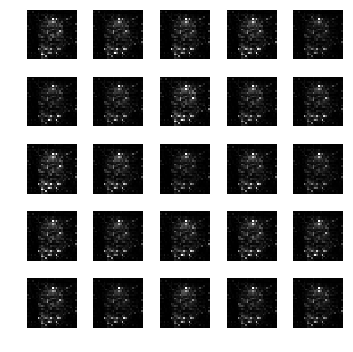

epoch: 881, time: 4.945065 | train_G_Loss: 0.559223, train_D_loss: 1.410024, train_acc: 0.195312
cv_G_Loss: 0.594161, cv_D_loss: 4.226269, cv_acc: 0.205600

epoch: 882, time: 4.914590 | train_G_Loss: 0.488522, train_D_loss: 4.204350, train_acc: 0.136719
cv_G_Loss: 0.463634, cv_D_loss: 4.150330, cv_acc: 0.177000

epoch: 883, time: 4.921762 | train_G_Loss: 0.608408, train_D_loss: 1.394318, train_acc: 0.191406
cv_G_Loss: 0.717228, cv_D_loss: 4.348838, cv_acc: 0.103500

epoch: 884, time: 4.914488 | train_G_Loss: 0.476057, train_D_loss: 1.447927, train_acc: 0.351562
cv_G_Loss: 0.476983, cv_D_loss: 4.162570, cv_acc: 0.193700

epoch: 885, time: 4.918797 | train_G_Loss: 0.501138, train_D_loss: 4.114859, train_acc: 0.240234
cv_G_Loss: 0.469415, cv_D_loss: 4.155652, cv_acc: 0.185600

epoch: 886, time: 4.908439 | train_G_Loss: 0.533042, train_D_loss: 4.549657, train_acc: 0.310547
cv_G_Loss: 0.566554, cv_D_loss: 4.197348, cv_acc: 0.285600

epoch: 887, time: 4.908236 | train_G_Loss: 0.483671, train

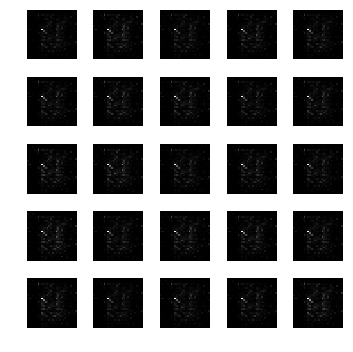

epoch: 891, time: 4.930328 | train_G_Loss: 0.478278, train_D_loss: 4.258440, train_acc: 0.099609
cv_G_Loss: 0.477967, cv_D_loss: 4.159585, cv_acc: 0.100900

epoch: 892, time: 4.898633 | train_G_Loss: 0.497811, train_D_loss: 1.432227, train_acc: 0.269531
cv_G_Loss: 0.477135, cv_D_loss: 4.120600, cv_acc: 0.309200

epoch: 893, time: 4.905187 | train_G_Loss: 0.556361, train_D_loss: 1.405779, train_acc: 0.232422
cv_G_Loss: 0.612434, cv_D_loss: 4.190834, cv_acc: 0.230600

epoch: 894, time: 4.904803 | train_G_Loss: 0.563140, train_D_loss: 4.198960, train_acc: 0.234375
cv_G_Loss: 0.687000, cv_D_loss: 4.271308, cv_acc: 0.211700

epoch: 895, time: 4.901703 | train_G_Loss: 0.483213, train_D_loss: 4.140843, train_acc: 0.207031
cv_G_Loss: 0.461991, cv_D_loss: 4.151144, cv_acc: 0.163400

epoch: 896, time: 4.896354 | train_G_Loss: 0.557779, train_D_loss: 1.406717, train_acc: 0.173828
cv_G_Loss: 0.554406, cv_D_loss: 4.226053, cv_acc: 0.187600

epoch: 897, time: 4.899687 | train_G_Loss: 0.623437, train

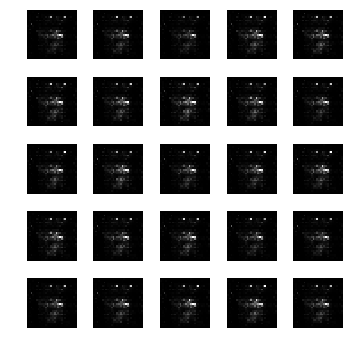

epoch: 901, time: 4.933660 | train_G_Loss: 0.449929, train_D_loss: 4.334511, train_acc: 0.119141
cv_G_Loss: 0.416841, cv_D_loss: 4.145797, cv_acc: 0.102500

epoch: 902, time: 4.895843 | train_G_Loss: 0.420904, train_D_loss: 1.489749, train_acc: 0.208984
cv_G_Loss: 0.375484, cv_D_loss: 4.133168, cv_acc: 0.189700

epoch: 903, time: 4.903703 | train_G_Loss: 0.465120, train_D_loss: 4.225720, train_acc: 0.199219
cv_G_Loss: 0.439563, cv_D_loss: 4.124835, cv_acc: 0.183500

epoch: 904, time: 4.917970 | train_G_Loss: 0.428832, train_D_loss: 3.705065, train_acc: 0.291016
cv_G_Loss: 0.342862, cv_D_loss: 4.179146, cv_acc: 0.258200

epoch: 905, time: 4.905319 | train_G_Loss: 0.501418, train_D_loss: 1.430309, train_acc: 0.212891
cv_G_Loss: 0.476063, cv_D_loss: 4.131085, cv_acc: 0.224000

epoch: 906, time: 4.898402 | train_G_Loss: 0.541639, train_D_loss: 4.460482, train_acc: 0.228516
cv_G_Loss: 0.570037, cv_D_loss: 4.199757, cv_acc: 0.202700

epoch: 907, time: 4.900839 | train_G_Loss: 0.482813, train

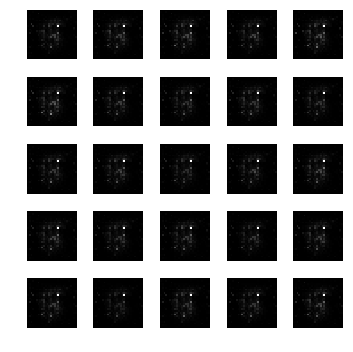

epoch: 911, time: 4.941369 | train_G_Loss: 0.495797, train_D_loss: 1.437251, train_acc: 0.283203
cv_G_Loss: 0.537566, cv_D_loss: 4.141241, cv_acc: 0.236800

epoch: 912, time: 4.901849 | train_G_Loss: 0.511117, train_D_loss: 4.386188, train_acc: 0.207031
cv_G_Loss: 0.558717, cv_D_loss: 4.152155, cv_acc: 0.227700

epoch: 913, time: 4.899471 | train_G_Loss: 0.476161, train_D_loss: 4.116853, train_acc: 0.160156
cv_G_Loss: 0.452927, cv_D_loss: 4.094138, cv_acc: 0.171300

epoch: 914, time: 4.908115 | train_G_Loss: 0.479396, train_D_loss: 4.415226, train_acc: 0.095703
cv_G_Loss: 0.513620, cv_D_loss: 4.131724, cv_acc: 0.115700

epoch: 915, time: 4.915028 | train_G_Loss: 0.541998, train_D_loss: 1.407778, train_acc: 0.140625
cv_G_Loss: 0.516487, cv_D_loss: 4.168285, cv_acc: 0.156300

epoch: 916, time: 4.906860 | train_G_Loss: 0.506915, train_D_loss: 4.422044, train_acc: 0.208984
cv_G_Loss: 0.479847, cv_D_loss: 4.169760, cv_acc: 0.152200

epoch: 917, time: 4.907317 | train_G_Loss: 0.449552, train

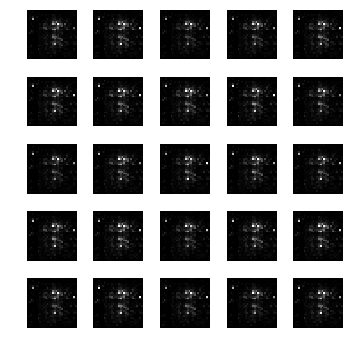

epoch: 921, time: 4.929731 | train_G_Loss: 0.541365, train_D_loss: 1.416075, train_acc: 0.246094
cv_G_Loss: 0.567146, cv_D_loss: 4.200960, cv_acc: 0.269500

epoch: 922, time: 4.901092 | train_G_Loss: 0.477515, train_D_loss: 1.442511, train_acc: 0.292969
cv_G_Loss: 0.471163, cv_D_loss: 4.161008, cv_acc: 0.211400

epoch: 923, time: 4.905714 | train_G_Loss: 0.520502, train_D_loss: 1.425671, train_acc: 0.287109
cv_G_Loss: 0.526099, cv_D_loss: 4.184738, cv_acc: 0.283500

epoch: 924, time: 4.890141 | train_G_Loss: 0.506162, train_D_loss: 1.428087, train_acc: 0.232422
cv_G_Loss: 0.480784, cv_D_loss: 4.118337, cv_acc: 0.250800

epoch: 925, time: 4.902715 | train_G_Loss: 0.569568, train_D_loss: 1.400180, train_acc: 0.167969
cv_G_Loss: 0.593397, cv_D_loss: 4.200229, cv_acc: 0.101000

epoch: 926, time: 4.901714 | train_G_Loss: 0.476070, train_D_loss: 3.888182, train_acc: 0.339844
cv_G_Loss: 0.422217, cv_D_loss: 4.129537, cv_acc: 0.247400

epoch: 927, time: 4.916001 | train_G_Loss: 0.521316, train

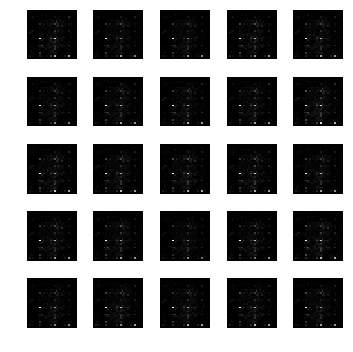

epoch: 931, time: 4.932296 | train_G_Loss: 0.546763, train_D_loss: 1.402587, train_acc: 0.146484
cv_G_Loss: 0.567048, cv_D_loss: 4.186117, cv_acc: 0.205800

epoch: 932, time: 4.906054 | train_G_Loss: 0.540177, train_D_loss: 4.327544, train_acc: 0.316406
cv_G_Loss: 0.625897, cv_D_loss: 4.216406, cv_acc: 0.385500
Model saved

epoch: 933, time: 4.935600 | train_G_Loss: 0.506460, train_D_loss: 4.066081, train_acc: 0.347656
cv_G_Loss: 0.550060, cv_D_loss: 4.161933, cv_acc: 0.341900

epoch: 934, time: 4.908709 | train_G_Loss: 0.503295, train_D_loss: 1.423895, train_acc: 0.416016
cv_G_Loss: 0.472002, cv_D_loss: 4.072590, cv_acc: 0.238700

epoch: 935, time: 4.893941 | train_G_Loss: 0.501130, train_D_loss: 4.427104, train_acc: 0.261719
cv_G_Loss: 0.535260, cv_D_loss: 4.140702, cv_acc: 0.182000

epoch: 936, time: 4.904292 | train_G_Loss: 0.507975, train_D_loss: 1.428872, train_acc: 0.255859
cv_G_Loss: 0.533664, cv_D_loss: 4.091854, cv_acc: 0.266700

epoch: 937, time: 4.895952 | train_G_Loss: 0.6

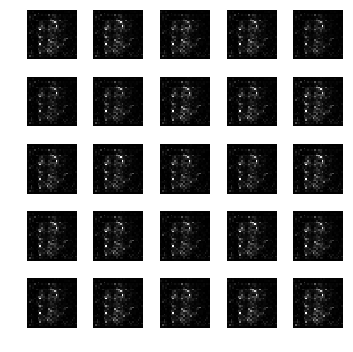

epoch: 941, time: 4.932905 | train_G_Loss: 0.473538, train_D_loss: 4.558450, train_acc: 0.302734
cv_G_Loss: 0.422252, cv_D_loss: 4.085284, cv_acc: 0.300300

epoch: 942, time: 4.915657 | train_G_Loss: 0.485493, train_D_loss: 3.927248, train_acc: 0.294922
cv_G_Loss: 0.428676, cv_D_loss: 4.101878, cv_acc: 0.298400

epoch: 943, time: 4.907992 | train_G_Loss: 0.537557, train_D_loss: 1.412215, train_acc: 0.296875
cv_G_Loss: 0.564638, cv_D_loss: 4.150988, cv_acc: 0.319500

epoch: 944, time: 4.906736 | train_G_Loss: 0.472802, train_D_loss: 4.056556, train_acc: 0.244141
cv_G_Loss: 0.452236, cv_D_loss: 4.109392, cv_acc: 0.198700

epoch: 945, time: 4.904098 | train_G_Loss: 0.540643, train_D_loss: 4.285841, train_acc: 0.457031
cv_G_Loss: 0.560605, cv_D_loss: 4.207209, cv_acc: 0.330800

epoch: 946, time: 4.921961 | train_G_Loss: 0.486774, train_D_loss: 1.433628, train_acc: 0.197266
cv_G_Loss: 0.429008, cv_D_loss: 4.095739, cv_acc: 0.201600

epoch: 947, time: 4.907673 | train_G_Loss: 0.506099, train

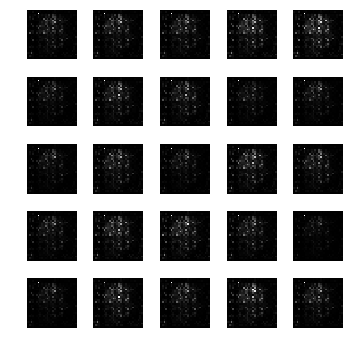

epoch: 951, time: 4.927328 | train_G_Loss: 0.459628, train_D_loss: 4.004816, train_acc: 0.230469
cv_G_Loss: 0.453812, cv_D_loss: 4.088956, cv_acc: 0.232000

epoch: 952, time: 4.897855 | train_G_Loss: 0.529525, train_D_loss: 4.322573, train_acc: 0.205078
cv_G_Loss: 0.510361, cv_D_loss: 4.075321, cv_acc: 0.206000

epoch: 953, time: 4.896948 | train_G_Loss: 0.477007, train_D_loss: 1.443499, train_acc: 0.148438
cv_G_Loss: 0.445929, cv_D_loss: 4.101851, cv_acc: 0.116100

epoch: 954, time: 4.903284 | train_G_Loss: 0.513185, train_D_loss: 1.427552, train_acc: 0.322266
cv_G_Loss: 0.466099, cv_D_loss: 4.089281, cv_acc: 0.296200

epoch: 955, time: 4.900192 | train_G_Loss: 0.476123, train_D_loss: 4.451924, train_acc: 0.275391
cv_G_Loss: 0.555061, cv_D_loss: 4.158472, cv_acc: 0.203300

epoch: 956, time: 4.896901 | train_G_Loss: 0.567843, train_D_loss: 1.400779, train_acc: 0.152344
cv_G_Loss: 0.627809, cv_D_loss: 4.193937, cv_acc: 0.156300

epoch: 957, time: 4.911272 | train_G_Loss: 0.524337, train

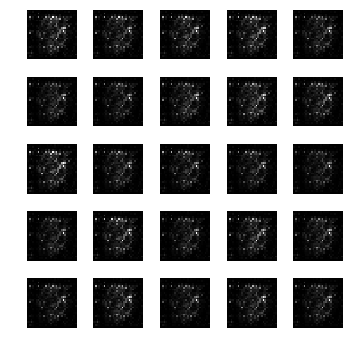

epoch: 961, time: 4.939747 | train_G_Loss: 0.573474, train_D_loss: 4.152025, train_acc: 0.132812
cv_G_Loss: 0.629671, cv_D_loss: 4.197265, cv_acc: 0.131100

epoch: 962, time: 4.911871 | train_G_Loss: 0.419055, train_D_loss: 3.834554, train_acc: 0.228516
cv_G_Loss: 0.362876, cv_D_loss: 4.087274, cv_acc: 0.201400

epoch: 963, time: 4.902403 | train_G_Loss: 0.622641, train_D_loss: 1.390750, train_acc: 0.380859
cv_G_Loss: 0.790660, cv_D_loss: 4.366369, cv_acc: 0.251700

epoch: 964, time: 4.913499 | train_G_Loss: 0.511752, train_D_loss: 4.025295, train_acc: 0.308594
cv_G_Loss: 0.537339, cv_D_loss: 4.176030, cv_acc: 0.345400

epoch: 965, time: 4.913005 | train_G_Loss: 0.558726, train_D_loss: 4.021174, train_acc: 0.480469
cv_G_Loss: 0.510725, cv_D_loss: 4.110738, cv_acc: 0.186500

epoch: 966, time: 4.910829 | train_G_Loss: 0.555654, train_D_loss: 1.409134, train_acc: 0.333984
cv_G_Loss: 0.576624, cv_D_loss: 4.145511, cv_acc: 0.272000

epoch: 967, time: 4.924621 | train_G_Loss: 0.548235, train

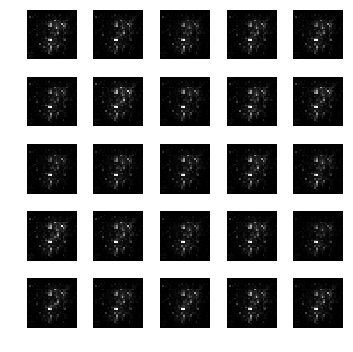

epoch: 971, time: 4.931215 | train_G_Loss: 0.564214, train_D_loss: 4.016776, train_acc: 0.185547
cv_G_Loss: 0.669611, cv_D_loss: 4.206499, cv_acc: 0.214200

epoch: 972, time: 4.895681 | train_G_Loss: 0.444043, train_D_loss: 1.466140, train_acc: 0.343750
cv_G_Loss: 0.403967, cv_D_loss: 4.031127, cv_acc: 0.315100

epoch: 973, time: 4.926654 | train_G_Loss: 0.470405, train_D_loss: 1.450052, train_acc: 0.386719
cv_G_Loss: 0.477654, cv_D_loss: 4.087876, cv_acc: 0.331000

epoch: 974, time: 4.903793 | train_G_Loss: 0.599102, train_D_loss: 4.458600, train_acc: 0.208984
cv_G_Loss: 0.882852, cv_D_loss: 4.419035, cv_acc: 0.168100

epoch: 975, time: 4.902088 | train_G_Loss: 0.392523, train_D_loss: 3.591861, train_acc: 0.369141
cv_G_Loss: 0.306423, cv_D_loss: 4.067615, cv_acc: 0.322400

epoch: 976, time: 4.906422 | train_G_Loss: 0.495518, train_D_loss: 4.394335, train_acc: 0.308594
cv_G_Loss: 0.460226, cv_D_loss: 4.094365, cv_acc: 0.297400

epoch: 977, time: 4.900187 | train_G_Loss: 0.577638, train

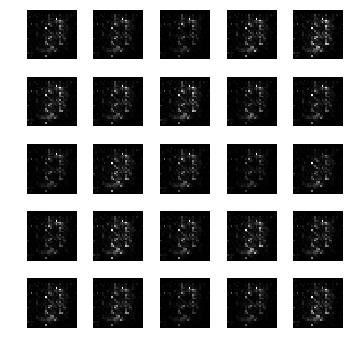

epoch: 981, time: 4.926008 | train_G_Loss: 0.475005, train_D_loss: 1.449930, train_acc: 0.308594
cv_G_Loss: 0.461897, cv_D_loss: 4.097983, cv_acc: 0.326500

epoch: 982, time: 4.913696 | train_G_Loss: 0.507775, train_D_loss: 1.431153, train_acc: 0.363281
cv_G_Loss: 0.570976, cv_D_loss: 4.112407, cv_acc: 0.361200

epoch: 983, time: 4.919141 | train_G_Loss: 0.524884, train_D_loss: 4.124348, train_acc: 0.271484
cv_G_Loss: 0.548081, cv_D_loss: 4.091328, cv_acc: 0.255700

epoch: 984, time: 4.909043 | train_G_Loss: 0.545611, train_D_loss: 4.061808, train_acc: 0.324219
cv_G_Loss: 0.560886, cv_D_loss: 4.116161, cv_acc: 0.294600

epoch: 985, time: 4.914963 | train_G_Loss: 0.518149, train_D_loss: 1.425549, train_acc: 0.339844
cv_G_Loss: 0.598201, cv_D_loss: 4.210128, cv_acc: 0.313600

epoch: 986, time: 4.911478 | train_G_Loss: 0.476966, train_D_loss: 3.901945, train_acc: 0.392578
cv_G_Loss: 0.543457, cv_D_loss: 4.125653, cv_acc: 0.351700

epoch: 987, time: 4.919763 | train_G_Loss: 0.481634, train

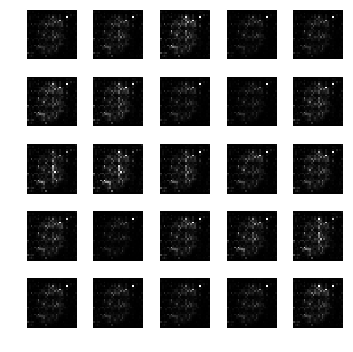

epoch: 991, time: 4.919974 | train_G_Loss: 0.662838, train_D_loss: 1.378775, train_acc: 0.445312
cv_G_Loss: 0.829037, cv_D_loss: 4.356383, cv_acc: 0.369900

epoch: 992, time: 4.916137 | train_G_Loss: 0.474753, train_D_loss: 4.298594, train_acc: 0.267578
cv_G_Loss: 0.556831, cv_D_loss: 4.085031, cv_acc: 0.328400

epoch: 993, time: 4.909370 | train_G_Loss: 0.412663, train_D_loss: 3.943253, train_acc: 0.375000
cv_G_Loss: 0.310026, cv_D_loss: 4.124588, cv_acc: 0.333800

epoch: 994, time: 4.910308 | train_G_Loss: 0.523779, train_D_loss: 1.417509, train_acc: 0.369141
cv_G_Loss: 0.568727, cv_D_loss: 4.106022, cv_acc: 0.201500

epoch: 995, time: 4.954649 | train_G_Loss: 0.563344, train_D_loss: 4.171957, train_acc: 0.441406
cv_G_Loss: 0.578281, cv_D_loss: 4.101256, cv_acc: 0.423100

epoch: 996, time: 4.928606 | train_G_Loss: 0.620027, train_D_loss: 1.374963, train_acc: 0.148438
cv_G_Loss: 0.720748, cv_D_loss: 4.335550, cv_acc: 0.091800

epoch: 997, time: 4.923143 | train_G_Loss: 0.510225, train

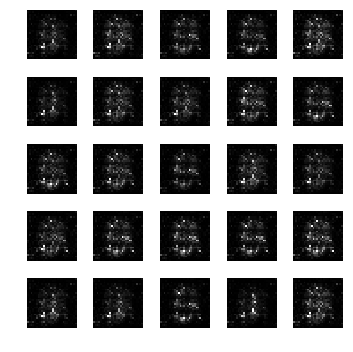

epoch: 1001, time: 4.923117 | train_G_Loss: 0.537752, train_D_loss: 1.409281, train_acc: 0.220703
cv_G_Loss: 0.575227, cv_D_loss: 4.066046, cv_acc: 0.263000

epoch: 1002, time: 4.916009 | train_G_Loss: 0.505553, train_D_loss: 1.436850, train_acc: 0.304688
cv_G_Loss: 0.599725, cv_D_loss: 4.149374, cv_acc: 0.428600

epoch: 1003, time: 4.906220 | train_G_Loss: 0.441721, train_D_loss: 3.871710, train_acc: 0.304688
cv_G_Loss: 0.394845, cv_D_loss: 4.028006, cv_acc: 0.298500

epoch: 1004, time: 4.917176 | train_G_Loss: 0.482618, train_D_loss: 3.557472, train_acc: 0.462891
cv_G_Loss: 0.520089, cv_D_loss: 4.138615, cv_acc: 0.277300

epoch: 1005, time: 4.902641 | train_G_Loss: 0.491154, train_D_loss: 4.213665, train_acc: 0.333984
cv_G_Loss: 0.499035, cv_D_loss: 4.046090, cv_acc: 0.329500

epoch: 1006, time: 4.915061 | train_G_Loss: 0.566390, train_D_loss: 1.398125, train_acc: 0.513672
cv_G_Loss: 0.659792, cv_D_loss: 4.200408, cv_acc: 0.300900

epoch: 1007, time: 4.911759 | train_G_Loss: 0.494013

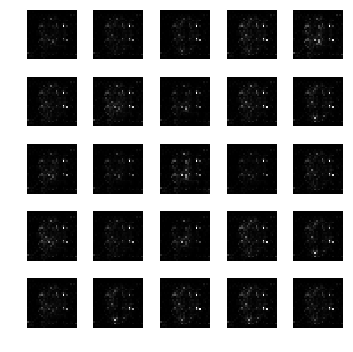

epoch: 1011, time: 4.923537 | train_G_Loss: 0.623426, train_D_loss: 1.395608, train_acc: 0.279297
cv_G_Loss: 0.735825, cv_D_loss: 4.268209, cv_acc: 0.192700

epoch: 1012, time: 4.894520 | train_G_Loss: 0.449212, train_D_loss: 1.465858, train_acc: 0.406250
cv_G_Loss: 0.435106, cv_D_loss: 4.021588, cv_acc: 0.315100

epoch: 1013, time: 4.903773 | train_G_Loss: 0.451618, train_D_loss: 3.859159, train_acc: 0.273438
cv_G_Loss: 0.367116, cv_D_loss: 4.009755, cv_acc: 0.418400

epoch: 1014, time: 4.888788 | train_G_Loss: 0.506866, train_D_loss: 4.302323, train_acc: 0.273438
cv_G_Loss: 0.484923, cv_D_loss: 4.008454, cv_acc: 0.260500

epoch: 1015, time: 4.905915 | train_G_Loss: 0.472286, train_D_loss: 4.115434, train_acc: 0.347656
cv_G_Loss: 0.429111, cv_D_loss: 3.970885, cv_acc: 0.271800

epoch: 1016, time: 4.893661 | train_G_Loss: 0.463248, train_D_loss: 4.166580, train_acc: 0.386719
cv_G_Loss: 0.480188, cv_D_loss: 3.989599, cv_acc: 0.392600

epoch: 1017, time: 4.899478 | train_G_Loss: 0.430405

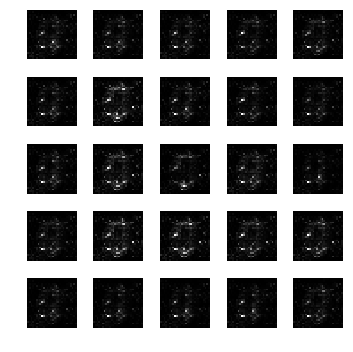

epoch: 1021, time: 4.930595 | train_G_Loss: 0.446448, train_D_loss: 1.466132, train_acc: 0.300781
cv_G_Loss: 0.340550, cv_D_loss: 3.970581, cv_acc: 0.348200

epoch: 1022, time: 4.899301 | train_G_Loss: 0.578109, train_D_loss: 4.059177, train_acc: 0.322266
cv_G_Loss: 0.584197, cv_D_loss: 4.081721, cv_acc: 0.342400

epoch: 1023, time: 4.899593 | train_G_Loss: 0.515759, train_D_loss: 1.435317, train_acc: 0.476562
cv_G_Loss: 0.526868, cv_D_loss: 4.039035, cv_acc: 0.471700

epoch: 1024, time: 4.898660 | train_G_Loss: 0.475225, train_D_loss: 4.248133, train_acc: 0.109375
cv_G_Loss: 0.415474, cv_D_loss: 4.085433, cv_acc: 0.101100

epoch: 1025, time: 4.902861 | train_G_Loss: 0.391063, train_D_loss: 4.158216, train_acc: 0.466797
cv_G_Loss: 0.355501, cv_D_loss: 4.004631, cv_acc: 0.405600

epoch: 1026, time: 4.891188 | train_G_Loss: 0.519764, train_D_loss: 1.421706, train_acc: 0.435547
cv_G_Loss: 0.573487, cv_D_loss: 4.100885, cv_acc: 0.251300

epoch: 1027, time: 4.890536 | train_G_Loss: 0.582294

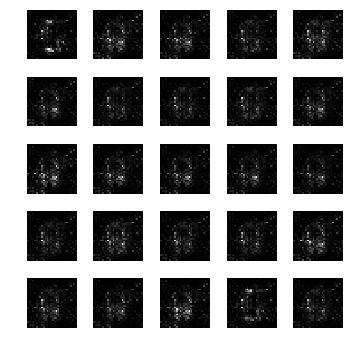

epoch: 1031, time: 4.939852 | train_G_Loss: 0.478458, train_D_loss: 1.460177, train_acc: 0.375000
cv_G_Loss: 0.500071, cv_D_loss: 3.992811, cv_acc: 0.353900

epoch: 1032, time: 4.897553 | train_G_Loss: 0.433014, train_D_loss: 3.962472, train_acc: 0.390625
cv_G_Loss: 0.345552, cv_D_loss: 3.935057, cv_acc: 0.382800

epoch: 1033, time: 4.898767 | train_G_Loss: 0.593064, train_D_loss: 1.398637, train_acc: 0.460938
cv_G_Loss: 0.812701, cv_D_loss: 4.253175, cv_acc: 0.426900

epoch: 1034, time: 4.897887 | train_G_Loss: 0.494362, train_D_loss: 3.846847, train_acc: 0.326172
cv_G_Loss: 0.468394, cv_D_loss: 3.968111, cv_acc: 0.254300

epoch: 1035, time: 4.902525 | train_G_Loss: 0.543438, train_D_loss: 4.015985, train_acc: 0.289062
cv_G_Loss: 0.546884, cv_D_loss: 3.961283, cv_acc: 0.219500

epoch: 1036, time: 4.896720 | train_G_Loss: 0.465771, train_D_loss: 3.972642, train_acc: 0.371094
cv_G_Loss: 0.491582, cv_D_loss: 4.021649, cv_acc: 0.331200

epoch: 1037, time: 4.902014 | train_G_Loss: 0.577725

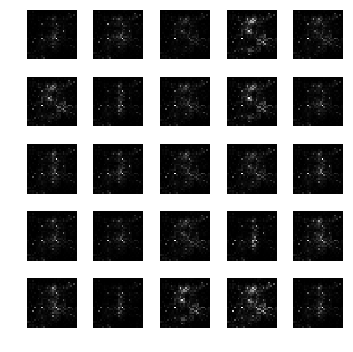

epoch: 1041, time: 4.958626 | train_G_Loss: 0.471332, train_D_loss: 1.438952, train_acc: 0.458984
cv_G_Loss: 0.521729, cv_D_loss: 4.137976, cv_acc: 0.247100

epoch: 1042, time: 4.899523 | train_G_Loss: 0.494269, train_D_loss: 1.440277, train_acc: 0.355469
cv_G_Loss: 0.454060, cv_D_loss: 3.929877, cv_acc: 0.312900

epoch: 1043, time: 4.902531 | train_G_Loss: 0.525462, train_D_loss: 1.431927, train_acc: 0.412109
cv_G_Loss: 0.696480, cv_D_loss: 4.123473, cv_acc: 0.458500

epoch: 1044, time: 4.921143 | train_G_Loss: 0.533229, train_D_loss: 1.410558, train_acc: 0.376953
cv_G_Loss: 0.519058, cv_D_loss: 4.020812, cv_acc: 0.273100

epoch: 1045, time: 4.894191 | train_G_Loss: 0.476939, train_D_loss: 1.452316, train_acc: 0.521484
cv_G_Loss: 0.410591, cv_D_loss: 3.947400, cv_acc: 0.540100

epoch: 1046, time: 4.899512 | train_G_Loss: 0.482335, train_D_loss: 1.447610, train_acc: 0.449219
cv_G_Loss: 0.383986, cv_D_loss: 3.913402, cv_acc: 0.356200

epoch: 1047, time: 4.900043 | train_G_Loss: 0.481372

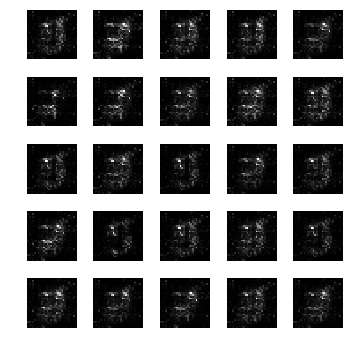

epoch: 1051, time: 4.925897 | train_G_Loss: 0.462311, train_D_loss: 3.483411, train_acc: 0.457031
cv_G_Loss: 0.427081, cv_D_loss: 3.888854, cv_acc: 0.482400

epoch: 1052, time: 4.898697 | train_G_Loss: 0.457076, train_D_loss: 1.469428, train_acc: 0.378906
cv_G_Loss: 0.508520, cv_D_loss: 3.972613, cv_acc: 0.506600

epoch: 1053, time: 4.890620 | train_G_Loss: 0.546748, train_D_loss: 3.948839, train_acc: 0.345703
cv_G_Loss: 0.576682, cv_D_loss: 4.000535, cv_acc: 0.359300

epoch: 1054, time: 4.896084 | train_G_Loss: 0.452286, train_D_loss: 1.477252, train_acc: 0.484375
cv_G_Loss: 0.455004, cv_D_loss: 3.905224, cv_acc: 0.560700
Model saved

epoch: 1055, time: 4.926148 | train_G_Loss: 0.496037, train_D_loss: 1.447165, train_acc: 0.296875
cv_G_Loss: 0.526765, cv_D_loss: 4.016938, cv_acc: 0.274200

epoch: 1056, time: 4.903252 | train_G_Loss: 0.457435, train_D_loss: 1.474835, train_acc: 0.568359
cv_G_Loss: 0.441285, cv_D_loss: 3.949885, cv_acc: 0.506400

epoch: 1057, time: 4.897229 | train_G_Lo

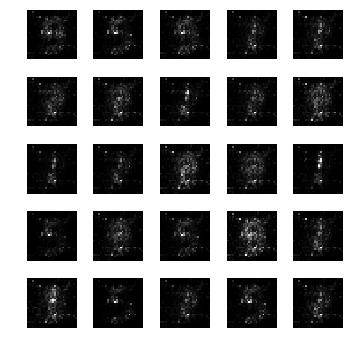

epoch: 1061, time: 4.933989 | train_G_Loss: 0.513458, train_D_loss: 1.434551, train_acc: 0.384766
cv_G_Loss: 0.608171, cv_D_loss: 4.030693, cv_acc: 0.383000

epoch: 1062, time: 4.908292 | train_G_Loss: 0.523917, train_D_loss: 1.428216, train_acc: 0.376953
cv_G_Loss: 0.609909, cv_D_loss: 4.016845, cv_acc: 0.348500

epoch: 1063, time: 4.906167 | train_G_Loss: 0.528982, train_D_loss: 3.526184, train_acc: 0.587891
cv_G_Loss: 0.650919, cv_D_loss: 4.009731, cv_acc: 0.483100

epoch: 1064, time: 4.910667 | train_G_Loss: 0.499756, train_D_loss: 3.749551, train_acc: 0.466797
cv_G_Loss: 0.721008, cv_D_loss: 4.156224, cv_acc: 0.315700

epoch: 1065, time: 4.910885 | train_G_Loss: 0.482493, train_D_loss: 3.923676, train_acc: 0.341797
cv_G_Loss: 0.459544, cv_D_loss: 3.933913, cv_acc: 0.266200

epoch: 1066, time: 4.909463 | train_G_Loss: 0.454392, train_D_loss: 1.484652, train_acc: 0.490234
cv_G_Loss: 0.464738, cv_D_loss: 3.895455, cv_acc: 0.442700

epoch: 1067, time: 4.915976 | train_G_Loss: 0.538866

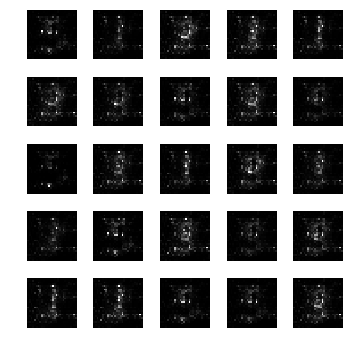

epoch: 1071, time: 4.945567 | train_G_Loss: 0.537969, train_D_loss: 4.079992, train_acc: 0.464844
cv_G_Loss: 0.463219, cv_D_loss: 3.908638, cv_acc: 0.354900

epoch: 1072, time: 4.906320 | train_G_Loss: 0.471080, train_D_loss: 3.478261, train_acc: 0.507812
cv_G_Loss: 0.464797, cv_D_loss: 3.877542, cv_acc: 0.519900

epoch: 1073, time: 4.917248 | train_G_Loss: 0.476409, train_D_loss: 3.772416, train_acc: 0.439453
cv_G_Loss: 0.406170, cv_D_loss: 3.891551, cv_acc: 0.379600

epoch: 1074, time: 4.917543 | train_G_Loss: 0.421270, train_D_loss: 1.499685, train_acc: 0.605469
cv_G_Loss: 0.417915, cv_D_loss: 3.823008, cv_acc: 0.519600

epoch: 1075, time: 4.910007 | train_G_Loss: 0.505582, train_D_loss: 4.301959, train_acc: 0.498047
cv_G_Loss: 0.573148, cv_D_loss: 3.968720, cv_acc: 0.275700

epoch: 1076, time: 4.905933 | train_G_Loss: 0.435777, train_D_loss: 3.662586, train_acc: 0.480469
cv_G_Loss: 0.502543, cv_D_loss: 3.908783, cv_acc: 0.399000

epoch: 1077, time: 4.914855 | train_G_Loss: 0.465485

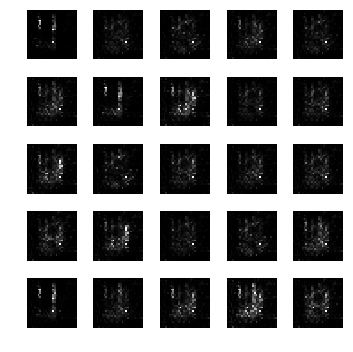

epoch: 1081, time: 4.951612 | train_G_Loss: 0.515020, train_D_loss: 1.435392, train_acc: 0.599609
cv_G_Loss: 0.756913, cv_D_loss: 4.214771, cv_acc: 0.417200

epoch: 1082, time: 4.904084 | train_G_Loss: 0.511724, train_D_loss: 1.437331, train_acc: 0.494141
cv_G_Loss: 0.519141, cv_D_loss: 3.860039, cv_acc: 0.479500

epoch: 1083, time: 4.899442 | train_G_Loss: 0.460227, train_D_loss: 1.467578, train_acc: 0.382812
cv_G_Loss: 0.463508, cv_D_loss: 3.847836, cv_acc: 0.387100

epoch: 1084, time: 4.912340 | train_G_Loss: 0.505216, train_D_loss: 1.449556, train_acc: 0.482422
cv_G_Loss: 0.457301, cv_D_loss: 3.847201, cv_acc: 0.508700

epoch: 1085, time: 4.904140 | train_G_Loss: 0.488937, train_D_loss: 1.450649, train_acc: 0.445312
cv_G_Loss: 0.447714, cv_D_loss: 3.847149, cv_acc: 0.512500

epoch: 1086, time: 4.904116 | train_G_Loss: 0.609696, train_D_loss: 1.415124, train_acc: 0.419922
cv_G_Loss: 0.878739, cv_D_loss: 4.332922, cv_acc: 0.402500

epoch: 1087, time: 4.932386 | train_G_Loss: 0.506252

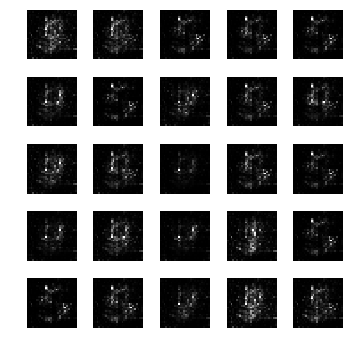

epoch: 1091, time: 4.934148 | train_G_Loss: 0.467758, train_D_loss: 3.826459, train_acc: 0.408203
cv_G_Loss: 0.390258, cv_D_loss: 3.912372, cv_acc: 0.327300

epoch: 1092, time: 4.892573 | train_G_Loss: 0.503274, train_D_loss: 3.398962, train_acc: 0.570312
cv_G_Loss: 0.423523, cv_D_loss: 3.829947, cv_acc: 0.576300
Model saved

epoch: 1093, time: 4.937877 | train_G_Loss: 0.466585, train_D_loss: 4.328495, train_acc: 0.513672
cv_G_Loss: 0.474013, cv_D_loss: 3.827072, cv_acc: 0.546600

epoch: 1094, time: 4.909665 | train_G_Loss: 0.506582, train_D_loss: 3.780469, train_acc: 0.451172
cv_G_Loss: 0.575814, cv_D_loss: 3.909726, cv_acc: 0.481000

epoch: 1095, time: 4.892730 | train_G_Loss: 0.447580, train_D_loss: 3.137426, train_acc: 0.447266
cv_G_Loss: 0.394615, cv_D_loss: 3.836070, cv_acc: 0.486200

epoch: 1096, time: 4.905924 | train_G_Loss: 0.529921, train_D_loss: 3.220623, train_acc: 0.464844
cv_G_Loss: 0.529178, cv_D_loss: 3.908094, cv_acc: 0.309400

epoch: 1097, time: 4.904911 | train_G_Lo

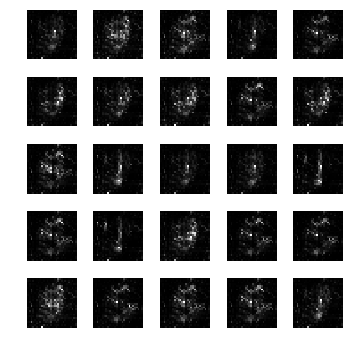

epoch: 1101, time: 5.060463 | train_G_Loss: 0.478248, train_D_loss: 3.541778, train_acc: 0.519531
cv_G_Loss: 0.493967, cv_D_loss: 3.872349, cv_acc: 0.531100

epoch: 1102, time: 4.897668 | train_G_Loss: 0.539900, train_D_loss: 1.412757, train_acc: 0.367188
cv_G_Loss: 0.659608, cv_D_loss: 4.017131, cv_acc: 0.316400

epoch: 1103, time: 4.896302 | train_G_Loss: 0.489824, train_D_loss: 3.934268, train_acc: 0.541016
cv_G_Loss: 0.511128, cv_D_loss: 3.853662, cv_acc: 0.526700

epoch: 1104, time: 4.908650 | train_G_Loss: 0.529002, train_D_loss: 3.898388, train_acc: 0.472656
cv_G_Loss: 0.485395, cv_D_loss: 3.832330, cv_acc: 0.432400

epoch: 1105, time: 4.918422 | train_G_Loss: 0.504644, train_D_loss: 3.823620, train_acc: 0.589844
cv_G_Loss: 0.485794, cv_D_loss: 3.796311, cv_acc: 0.555100

epoch: 1106, time: 4.901379 | train_G_Loss: 0.463733, train_D_loss: 1.462045, train_acc: 0.453125
cv_G_Loss: 0.367705, cv_D_loss: 3.821845, cv_acc: 0.459400

epoch: 1107, time: 4.899149 | train_G_Loss: 0.566145

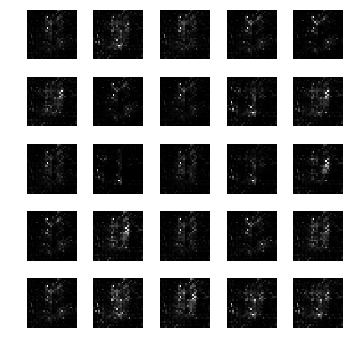

epoch: 1111, time: 4.941507 | train_G_Loss: 0.470278, train_D_loss: 1.461911, train_acc: 0.564453
cv_G_Loss: 0.525742, cv_D_loss: 3.866618, cv_acc: 0.489900

epoch: 1112, time: 4.894058 | train_G_Loss: 0.508754, train_D_loss: 1.454190, train_acc: 0.570312
cv_G_Loss: 0.498175, cv_D_loss: 3.818663, cv_acc: 0.484600

epoch: 1113, time: 4.903931 | train_G_Loss: 0.481041, train_D_loss: 1.450755, train_acc: 0.544922
cv_G_Loss: 0.448634, cv_D_loss: 3.763548, cv_acc: 0.489000

epoch: 1114, time: 4.903723 | train_G_Loss: 0.474505, train_D_loss: 3.651613, train_acc: 0.533203
cv_G_Loss: 0.615345, cv_D_loss: 3.851815, cv_acc: 0.540000

epoch: 1115, time: 4.919036 | train_G_Loss: 0.458679, train_D_loss: 1.471314, train_acc: 0.519531
cv_G_Loss: 0.462136, cv_D_loss: 3.806901, cv_acc: 0.512900

epoch: 1116, time: 4.892272 | train_G_Loss: 0.517963, train_D_loss: 3.145920, train_acc: 0.537109
cv_G_Loss: 0.673493, cv_D_loss: 3.898930, cv_acc: 0.497100

epoch: 1117, time: 4.906723 | train_G_Loss: 0.448313

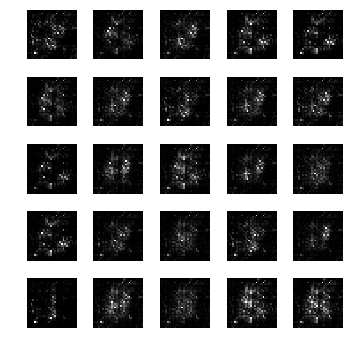

epoch: 1121, time: 4.942091 | train_G_Loss: 0.488516, train_D_loss: 3.931249, train_acc: 0.597656
cv_G_Loss: 0.529009, cv_D_loss: 3.790991, cv_acc: 0.590700
Model saved

epoch: 1122, time: 4.911743 | train_G_Loss: 0.509796, train_D_loss: 3.483436, train_acc: 0.451172
cv_G_Loss: 0.607525, cv_D_loss: 3.873104, cv_acc: 0.483500

epoch: 1123, time: 4.916313 | train_G_Loss: 0.484824, train_D_loss: 4.530632, train_acc: 0.513672
cv_G_Loss: 0.457175, cv_D_loss: 3.820361, cv_acc: 0.502000

epoch: 1124, time: 4.898555 | train_G_Loss: 0.494521, train_D_loss: 3.835513, train_acc: 0.498047
cv_G_Loss: 0.418245, cv_D_loss: 3.797586, cv_acc: 0.443300

epoch: 1125, time: 4.908430 | train_G_Loss: 0.449533, train_D_loss: 1.478068, train_acc: 0.533203
cv_G_Loss: 0.393497, cv_D_loss: 3.722904, cv_acc: 0.534600

epoch: 1126, time: 4.910707 | train_G_Loss: 0.453234, train_D_loss: 1.475897, train_acc: 0.533203
cv_G_Loss: 0.489012, cv_D_loss: 3.726056, cv_acc: 0.549500

epoch: 1127, time: 4.910376 | train_G_Lo

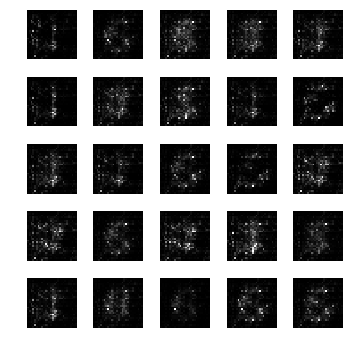

epoch: 1131, time: 4.931613 | train_G_Loss: 0.445662, train_D_loss: 3.703177, train_acc: 0.558594
cv_G_Loss: 0.390366, cv_D_loss: 3.765477, cv_acc: 0.451700

epoch: 1132, time: 4.932614 | train_G_Loss: 0.522576, train_D_loss: 1.449947, train_acc: 0.537109
cv_G_Loss: 0.627795, cv_D_loss: 3.850711, cv_acc: 0.499400

epoch: 1133, time: 4.908176 | train_G_Loss: 0.459354, train_D_loss: 3.280789, train_acc: 0.548828
cv_G_Loss: 0.445813, cv_D_loss: 3.706139, cv_acc: 0.542400

epoch: 1134, time: 4.906099 | train_G_Loss: 0.457323, train_D_loss: 3.470473, train_acc: 0.521484
cv_G_Loss: 0.471709, cv_D_loss: 3.749145, cv_acc: 0.481900

epoch: 1135, time: 4.898849 | train_G_Loss: 0.539989, train_D_loss: 4.314678, train_acc: 0.585938
cv_G_Loss: 0.654243, cv_D_loss: 3.896772, cv_acc: 0.496400

epoch: 1136, time: 4.899054 | train_G_Loss: 0.438217, train_D_loss: 1.497049, train_acc: 0.513672
cv_G_Loss: 0.482393, cv_D_loss: 3.755880, cv_acc: 0.560700

epoch: 1137, time: 4.895680 | train_G_Loss: 0.422396

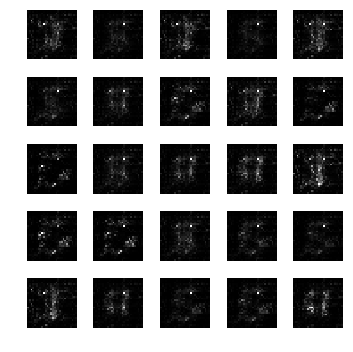

epoch: 1141, time: 4.939003 | train_G_Loss: 0.472311, train_D_loss: 1.482801, train_acc: 0.490234
cv_G_Loss: 0.658829, cv_D_loss: 3.910246, cv_acc: 0.483600

epoch: 1142, time: 4.906356 | train_G_Loss: 0.513496, train_D_loss: 3.552764, train_acc: 0.576172
cv_G_Loss: 0.872671, cv_D_loss: 4.168232, cv_acc: 0.454600

epoch: 1143, time: 4.906699 | train_G_Loss: 0.468836, train_D_loss: 3.276528, train_acc: 0.542969
cv_G_Loss: 0.429380, cv_D_loss: 3.729779, cv_acc: 0.503900

epoch: 1144, time: 4.884295 | train_G_Loss: 0.467044, train_D_loss: 3.438525, train_acc: 0.527344
cv_G_Loss: 0.511640, cv_D_loss: 3.773924, cv_acc: 0.489200

epoch: 1145, time: 4.912040 | train_G_Loss: 0.454278, train_D_loss: 1.479717, train_acc: 0.515625
cv_G_Loss: 0.427734, cv_D_loss: 3.753011, cv_acc: 0.503000

epoch: 1146, time: 4.901475 | train_G_Loss: 0.591810, train_D_loss: 1.362265, train_acc: 0.539062
cv_G_Loss: 0.750865, cv_D_loss: 3.937847, cv_acc: 0.487300

epoch: 1147, time: 4.902179 | train_G_Loss: 0.503906

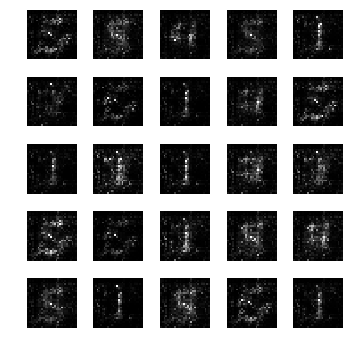

epoch: 1151, time: 4.942741 | train_G_Loss: 0.486839, train_D_loss: 4.081389, train_acc: 0.537109
cv_G_Loss: 0.481204, cv_D_loss: 3.764422, cv_acc: 0.431200

epoch: 1152, time: 4.890793 | train_G_Loss: 0.612244, train_D_loss: 1.421694, train_acc: 0.583984
cv_G_Loss: 0.627925, cv_D_loss: 3.803040, cv_acc: 0.626400
Model saved

epoch: 1153, time: 4.925214 | train_G_Loss: 0.679480, train_D_loss: 1.422236, train_acc: 0.587891
cv_G_Loss: 1.086669, cv_D_loss: 4.396992, cv_acc: 0.450000

epoch: 1154, time: 4.907186 | train_G_Loss: 0.484802, train_D_loss: 1.466776, train_acc: 0.554688
cv_G_Loss: 0.432786, cv_D_loss: 3.770322, cv_acc: 0.456800

epoch: 1155, time: 4.918583 | train_G_Loss: 0.577513, train_D_loss: 1.426480, train_acc: 0.566406
cv_G_Loss: 0.783919, cv_D_loss: 3.931814, cv_acc: 0.591800

epoch: 1156, time: 4.902278 | train_G_Loss: 0.443299, train_D_loss: 2.924077, train_acc: 0.466797
cv_G_Loss: 0.462316, cv_D_loss: 3.715160, cv_acc: 0.576600

epoch: 1157, time: 4.909461 | train_G_Lo

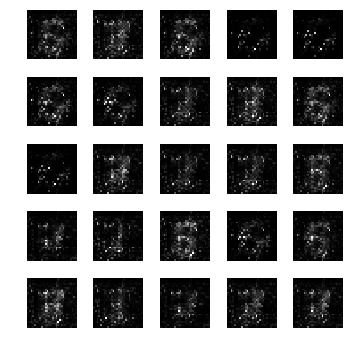

epoch: 1161, time: 4.942195 | train_G_Loss: 0.507391, train_D_loss: 1.461833, train_acc: 0.400391
cv_G_Loss: 0.527019, cv_D_loss: 3.804164, cv_acc: 0.430000

epoch: 1162, time: 4.895279 | train_G_Loss: 0.544295, train_D_loss: 1.415105, train_acc: 0.458984
cv_G_Loss: 0.699616, cv_D_loss: 3.948480, cv_acc: 0.427000

epoch: 1163, time: 4.897482 | train_G_Loss: 0.454995, train_D_loss: 1.478223, train_acc: 0.560547
cv_G_Loss: 0.448266, cv_D_loss: 3.719557, cv_acc: 0.465100

epoch: 1164, time: 4.908473 | train_G_Loss: 0.554823, train_D_loss: 4.542100, train_acc: 0.605469
cv_G_Loss: 0.684763, cv_D_loss: 3.902126, cv_acc: 0.555700

epoch: 1165, time: 4.898442 | train_G_Loss: 0.531686, train_D_loss: 3.844937, train_acc: 0.583984
cv_G_Loss: 0.661679, cv_D_loss: 3.923667, cv_acc: 0.510000

epoch: 1166, time: 4.926261 | train_G_Loss: 0.451345, train_D_loss: 3.406321, train_acc: 0.591797
cv_G_Loss: 0.540504, cv_D_loss: 3.737396, cv_acc: 0.584800

epoch: 1167, time: 4.907691 | train_G_Loss: 0.500978

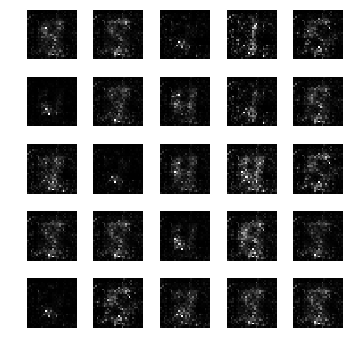

epoch: 1171, time: 4.929273 | train_G_Loss: 0.453140, train_D_loss: 1.485757, train_acc: 0.574219
cv_G_Loss: 0.460332, cv_D_loss: 3.689610, cv_acc: 0.535800

epoch: 1172, time: 4.909231 | train_G_Loss: 0.487861, train_D_loss: 3.246983, train_acc: 0.597656
cv_G_Loss: 0.481125, cv_D_loss: 3.685075, cv_acc: 0.494400

epoch: 1173, time: 4.902172 | train_G_Loss: 0.434403, train_D_loss: 3.922708, train_acc: 0.562500
cv_G_Loss: 0.392668, cv_D_loss: 3.761515, cv_acc: 0.546900

epoch: 1174, time: 4.902549 | train_G_Loss: 0.502440, train_D_loss: 3.172240, train_acc: 0.521484
cv_G_Loss: 0.741363, cv_D_loss: 3.874872, cv_acc: 0.506700

epoch: 1175, time: 4.904352 | train_G_Loss: 0.542066, train_D_loss: 4.598504, train_acc: 0.550781
cv_G_Loss: 0.523913, cv_D_loss: 3.686402, cv_acc: 0.600900

epoch: 1176, time: 4.908670 | train_G_Loss: 0.546736, train_D_loss: 1.441354, train_acc: 0.656250
cv_G_Loss: 0.594493, cv_D_loss: 3.710804, cv_acc: 0.612200

epoch: 1177, time: 4.926548 | train_G_Loss: 0.494163

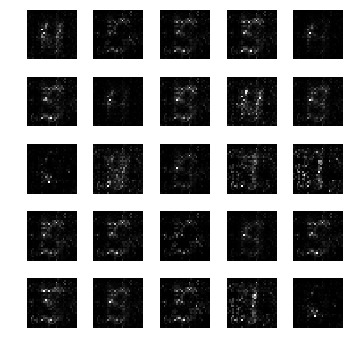

epoch: 1181, time: 4.923524 | train_G_Loss: 0.436812, train_D_loss: 1.494642, train_acc: 0.558594
cv_G_Loss: 0.418936, cv_D_loss: 3.617404, cv_acc: 0.660300
Model saved

epoch: 1182, time: 4.932041 | train_G_Loss: 0.452527, train_D_loss: 3.698430, train_acc: 0.548828
cv_G_Loss: 0.390883, cv_D_loss: 3.657467, cv_acc: 0.587600

epoch: 1183, time: 4.898542 | train_G_Loss: 0.537201, train_D_loss: 3.067725, train_acc: 0.607422
cv_G_Loss: 0.588869, cv_D_loss: 3.739812, cv_acc: 0.587200

epoch: 1184, time: 4.907254 | train_G_Loss: 0.595270, train_D_loss: 3.638223, train_acc: 0.675781
cv_G_Loss: 0.573672, cv_D_loss: 3.754227, cv_acc: 0.618600

epoch: 1185, time: 4.904091 | train_G_Loss: 0.485015, train_D_loss: 1.468306, train_acc: 0.636719
cv_G_Loss: 0.645572, cv_D_loss: 3.781430, cv_acc: 0.544100

epoch: 1186, time: 4.899582 | train_G_Loss: 0.465369, train_D_loss: 3.131192, train_acc: 0.662109
cv_G_Loss: 0.528538, cv_D_loss: 3.720285, cv_acc: 0.615000

epoch: 1187, time: 4.900077 | train_G_Lo

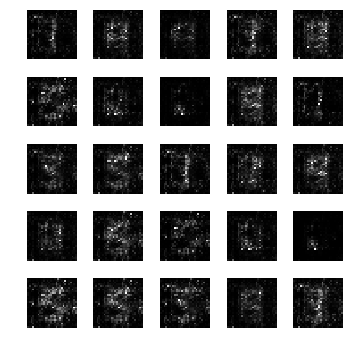

epoch: 1191, time: 4.937986 | train_G_Loss: 0.615272, train_D_loss: 1.432063, train_acc: 0.476562
cv_G_Loss: 0.807843, cv_D_loss: 4.046612, cv_acc: 0.332200

epoch: 1192, time: 4.897098 | train_G_Loss: 0.608524, train_D_loss: 1.415619, train_acc: 0.646484
cv_G_Loss: 0.806020, cv_D_loss: 3.849480, cv_acc: 0.607900

epoch: 1193, time: 4.904603 | train_G_Loss: 0.506584, train_D_loss: 3.131199, train_acc: 0.587891
cv_G_Loss: 0.515444, cv_D_loss: 3.608670, cv_acc: 0.560000

epoch: 1194, time: 4.906014 | train_G_Loss: 0.519182, train_D_loss: 1.466018, train_acc: 0.511719
cv_G_Loss: 0.593245, cv_D_loss: 3.842770, cv_acc: 0.279100

epoch: 1195, time: 4.906801 | train_G_Loss: 0.517164, train_D_loss: 3.447479, train_acc: 0.617188
cv_G_Loss: 0.711583, cv_D_loss: 3.800267, cv_acc: 0.582100

epoch: 1196, time: 4.897469 | train_G_Loss: 0.442704, train_D_loss: 1.498947, train_acc: 0.595703
cv_G_Loss: 0.419252, cv_D_loss: 3.684759, cv_acc: 0.563700

epoch: 1197, time: 4.909309 | train_G_Loss: 0.606457

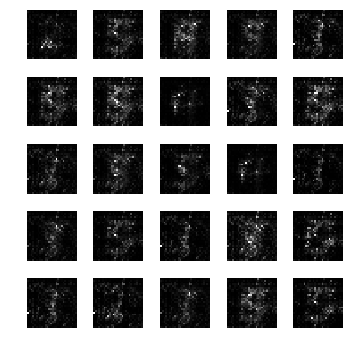

epoch: 1201, time: 4.947288 | train_G_Loss: 0.534794, train_D_loss: 1.459492, train_acc: 0.591797
cv_G_Loss: 0.661170, cv_D_loss: 3.762391, cv_acc: 0.581400

epoch: 1202, time: 4.907440 | train_G_Loss: 0.520437, train_D_loss: 1.455102, train_acc: 0.500000
cv_G_Loss: 0.548587, cv_D_loss: 3.667782, cv_acc: 0.571800

epoch: 1203, time: 4.904336 | train_G_Loss: 0.413431, train_D_loss: 4.619951, train_acc: 0.636719
cv_G_Loss: 0.467299, cv_D_loss: 3.659793, cv_acc: 0.625500

epoch: 1204, time: 4.909302 | train_G_Loss: 0.421068, train_D_loss: 3.654830, train_acc: 0.484375
cv_G_Loss: 0.352446, cv_D_loss: 3.739933, cv_acc: 0.401800

epoch: 1205, time: 4.906338 | train_G_Loss: 0.449207, train_D_loss: 1.484283, train_acc: 0.638672
cv_G_Loss: 0.429057, cv_D_loss: 3.625186, cv_acc: 0.552600

epoch: 1206, time: 4.913332 | train_G_Loss: 0.411002, train_D_loss: 1.527802, train_acc: 0.556641
cv_G_Loss: 0.420577, cv_D_loss: 3.811925, cv_acc: 0.445400

epoch: 1207, time: 4.917489 | train_G_Loss: 0.551741

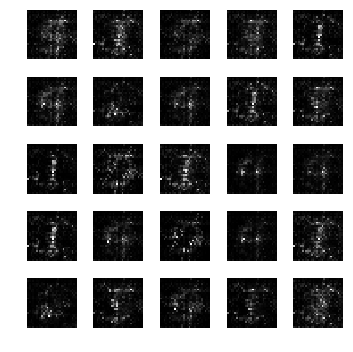

epoch: 1211, time: 4.925162 | train_G_Loss: 0.491698, train_D_loss: 1.455299, train_acc: 0.626953
cv_G_Loss: 0.517331, cv_D_loss: 3.691272, cv_acc: 0.490900

epoch: 1212, time: 4.909439 | train_G_Loss: 0.408293, train_D_loss: 3.048189, train_acc: 0.654297
cv_G_Loss: 0.420860, cv_D_loss: 3.557909, cv_acc: 0.627200

epoch: 1213, time: 4.907219 | train_G_Loss: 0.601481, train_D_loss: 3.555196, train_acc: 0.486328
cv_G_Loss: 0.759906, cv_D_loss: 3.917349, cv_acc: 0.491800

epoch: 1214, time: 4.911670 | train_G_Loss: 0.506566, train_D_loss: 1.472090, train_acc: 0.652344
cv_G_Loss: 0.563320, cv_D_loss: 3.662756, cv_acc: 0.588100

epoch: 1215, time: 4.920474 | train_G_Loss: 0.471672, train_D_loss: 1.503091, train_acc: 0.470703
cv_G_Loss: 0.483061, cv_D_loss: 3.690893, cv_acc: 0.479500

epoch: 1216, time: 4.912397 | train_G_Loss: 0.451305, train_D_loss: 3.679053, train_acc: 0.554688
cv_G_Loss: 0.534337, cv_D_loss: 3.657110, cv_acc: 0.565100

epoch: 1217, time: 4.915925 | train_G_Loss: 0.512306

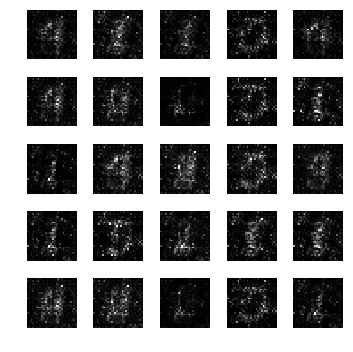

epoch: 1221, time: 4.940181 | train_G_Loss: 0.579051, train_D_loss: 1.471786, train_acc: 0.609375
cv_G_Loss: 0.804322, cv_D_loss: 3.918956, cv_acc: 0.520400

epoch: 1222, time: 4.900204 | train_G_Loss: 0.429787, train_D_loss: 2.988383, train_acc: 0.552734
cv_G_Loss: 0.473958, cv_D_loss: 3.605832, cv_acc: 0.531800

epoch: 1223, time: 4.934832 | train_G_Loss: 0.460744, train_D_loss: 1.488473, train_acc: 0.681641
cv_G_Loss: 0.438075, cv_D_loss: 3.617047, cv_acc: 0.631300

epoch: 1224, time: 4.918948 | train_G_Loss: 0.510472, train_D_loss: 3.983061, train_acc: 0.531250
cv_G_Loss: 0.737579, cv_D_loss: 3.919253, cv_acc: 0.504700

epoch: 1225, time: 4.910950 | train_G_Loss: 0.450571, train_D_loss: 1.534078, train_acc: 0.500000
cv_G_Loss: 0.439145, cv_D_loss: 3.589874, cv_acc: 0.500200

epoch: 1226, time: 4.913951 | train_G_Loss: 0.561015, train_D_loss: 4.562595, train_acc: 0.558594
cv_G_Loss: 0.702560, cv_D_loss: 3.754863, cv_acc: 0.561200

epoch: 1227, time: 4.912490 | train_G_Loss: 0.527339

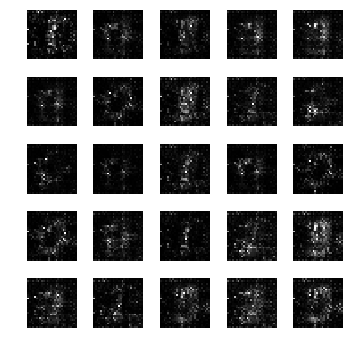

epoch: 1231, time: 4.935473 | train_G_Loss: 0.391979, train_D_loss: 1.553119, train_acc: 0.636719
cv_G_Loss: 0.332788, cv_D_loss: 3.587394, cv_acc: 0.650400

epoch: 1232, time: 4.912467 | train_G_Loss: 0.461378, train_D_loss: 1.494303, train_acc: 0.625000
cv_G_Loss: 0.556447, cv_D_loss: 3.800221, cv_acc: 0.488200

epoch: 1233, time: 4.920660 | train_G_Loss: 0.478179, train_D_loss: 1.482811, train_acc: 0.558594
cv_G_Loss: 0.575622, cv_D_loss: 3.627293, cv_acc: 0.601400

epoch: 1234, time: 4.921305 | train_G_Loss: 0.574624, train_D_loss: 3.942208, train_acc: 0.568359
cv_G_Loss: 0.632506, cv_D_loss: 3.705084, cv_acc: 0.605900

epoch: 1235, time: 4.920391 | train_G_Loss: 0.581976, train_D_loss: 1.444881, train_acc: 0.605469
cv_G_Loss: 0.831059, cv_D_loss: 3.860856, cv_acc: 0.629500

epoch: 1236, time: 4.924234 | train_G_Loss: 0.483551, train_D_loss: 3.180188, train_acc: 0.648438
cv_G_Loss: 0.515476, cv_D_loss: 3.612261, cv_acc: 0.637700

epoch: 1237, time: 4.906200 | train_G_Loss: 0.558392

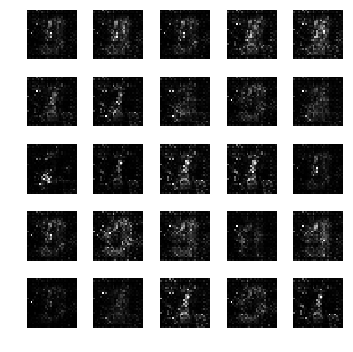

epoch: 1241, time: 4.922930 | train_G_Loss: 0.543667, train_D_loss: 1.469763, train_acc: 0.576172
cv_G_Loss: 0.596485, cv_D_loss: 3.697651, cv_acc: 0.547300

epoch: 1242, time: 4.899724 | train_G_Loss: 0.554990, train_D_loss: 1.458308, train_acc: 0.654297
cv_G_Loss: 0.612300, cv_D_loss: 3.646384, cv_acc: 0.649000

epoch: 1243, time: 4.896144 | train_G_Loss: 0.488454, train_D_loss: 1.475490, train_acc: 0.666016
cv_G_Loss: 0.955937, cv_D_loss: 3.980625, cv_acc: 0.669100
Model saved

epoch: 1244, time: 4.926300 | train_G_Loss: 0.523997, train_D_loss: 1.439473, train_acc: 0.589844
cv_G_Loss: 0.676484, cv_D_loss: 3.727012, cv_acc: 0.576300

epoch: 1245, time: 4.897211 | train_G_Loss: 0.481580, train_D_loss: 3.224711, train_acc: 0.638672
cv_G_Loss: 0.899072, cv_D_loss: 3.950480, cv_acc: 0.590900

epoch: 1246, time: 4.934676 | train_G_Loss: 0.483176, train_D_loss: 3.259731, train_acc: 0.652344
cv_G_Loss: 0.437786, cv_D_loss: 3.634105, cv_acc: 0.593400

epoch: 1247, time: 4.899077 | train_G_Lo

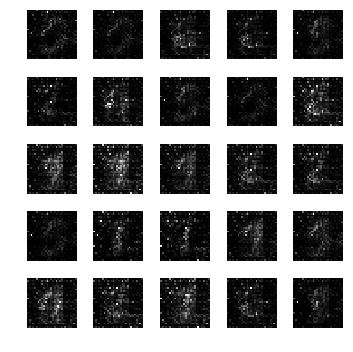

epoch: 1251, time: 4.912498 | train_G_Loss: 0.408625, train_D_loss: 1.535512, train_acc: 0.636719
cv_G_Loss: 0.504433, cv_D_loss: 3.529821, cv_acc: 0.602400

epoch: 1252, time: 4.909240 | train_G_Loss: 0.461401, train_D_loss: 1.490438, train_acc: 0.632812
cv_G_Loss: 0.521356, cv_D_loss: 3.518100, cv_acc: 0.650700

epoch: 1253, time: 4.892355 | train_G_Loss: 0.483815, train_D_loss: 3.376174, train_acc: 0.607422
cv_G_Loss: 0.490576, cv_D_loss: 3.551858, cv_acc: 0.650400

epoch: 1254, time: 4.891125 | train_G_Loss: 0.468822, train_D_loss: 4.447591, train_acc: 0.621094
cv_G_Loss: 0.522347, cv_D_loss: 3.510796, cv_acc: 0.661500

epoch: 1255, time: 4.892795 | train_G_Loss: 0.465092, train_D_loss: 3.373914, train_acc: 0.673828
cv_G_Loss: 0.466015, cv_D_loss: 3.596188, cv_acc: 0.617200

epoch: 1256, time: 4.914685 | train_G_Loss: 0.390827, train_D_loss: 3.529181, train_acc: 0.664062
cv_G_Loss: 0.360195, cv_D_loss: 3.547206, cv_acc: 0.615100

epoch: 1257, time: 4.907454 | train_G_Loss: 0.398530

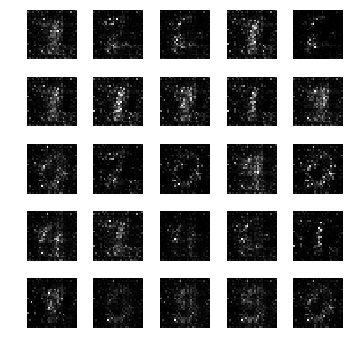

epoch: 1261, time: 4.952062 | train_G_Loss: 0.478324, train_D_loss: 3.916109, train_acc: 0.722656
cv_G_Loss: 0.528509, cv_D_loss: 3.581956, cv_acc: 0.659700

epoch: 1262, time: 4.934112 | train_G_Loss: 0.454535, train_D_loss: 4.546592, train_acc: 0.658203
cv_G_Loss: 0.419408, cv_D_loss: 3.518096, cv_acc: 0.589800

epoch: 1263, time: 4.893252 | train_G_Loss: 0.479764, train_D_loss: 3.140986, train_acc: 0.640625
cv_G_Loss: 0.451224, cv_D_loss: 3.535596, cv_acc: 0.633600

epoch: 1264, time: 4.907606 | train_G_Loss: 0.425474, train_D_loss: 2.971327, train_acc: 0.566406
cv_G_Loss: 0.438932, cv_D_loss: 3.571917, cv_acc: 0.595100

epoch: 1265, time: 4.906039 | train_G_Loss: 0.577581, train_D_loss: 3.279918, train_acc: 0.638672
cv_G_Loss: 0.811653, cv_D_loss: 3.866186, cv_acc: 0.603600

epoch: 1266, time: 4.904204 | train_G_Loss: 0.504983, train_D_loss: 1.459208, train_acc: 0.564453
cv_G_Loss: 0.614450, cv_D_loss: 3.703637, cv_acc: 0.541500

epoch: 1267, time: 4.974080 | train_G_Loss: 0.485124

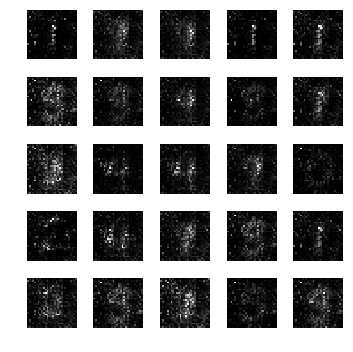

epoch: 1271, time: 4.941989 | train_G_Loss: 0.476822, train_D_loss: 1.475611, train_acc: 0.636719
cv_G_Loss: 0.553360, cv_D_loss: 3.628155, cv_acc: 0.608700

epoch: 1272, time: 4.901148 | train_G_Loss: 0.450894, train_D_loss: 4.804481, train_acc: 0.669922
cv_G_Loss: 0.501698, cv_D_loss: 3.620548, cv_acc: 0.518400

epoch: 1273, time: 4.913023 | train_G_Loss: 0.481362, train_D_loss: 1.472744, train_acc: 0.630859
cv_G_Loss: 0.521721, cv_D_loss: 3.697225, cv_acc: 0.533400

epoch: 1274, time: 4.898504 | train_G_Loss: 0.497403, train_D_loss: 2.556677, train_acc: 0.562500
cv_G_Loss: 0.471487, cv_D_loss: 3.580653, cv_acc: 0.599100

epoch: 1275, time: 4.905686 | train_G_Loss: 0.511411, train_D_loss: 1.471429, train_acc: 0.613281
cv_G_Loss: 0.853083, cv_D_loss: 3.932646, cv_acc: 0.499600

epoch: 1276, time: 4.895025 | train_G_Loss: 0.434228, train_D_loss: 1.519359, train_acc: 0.585938
cv_G_Loss: 0.451462, cv_D_loss: 3.525223, cv_acc: 0.611100

epoch: 1277, time: 4.912650 | train_G_Loss: 0.406817

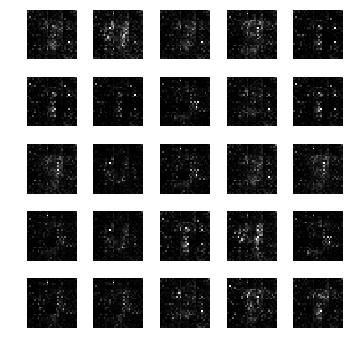

epoch: 1281, time: 4.925624 | train_G_Loss: 0.474626, train_D_loss: 1.493242, train_acc: 0.605469
cv_G_Loss: 0.512926, cv_D_loss: 3.661566, cv_acc: 0.551500

epoch: 1282, time: 4.904256 | train_G_Loss: 0.504269, train_D_loss: 3.815885, train_acc: 0.740234
cv_G_Loss: 0.519789, cv_D_loss: 3.528080, cv_acc: 0.675600
Model saved

epoch: 1283, time: 4.929800 | train_G_Loss: 0.502683, train_D_loss: 1.462373, train_acc: 0.640625
cv_G_Loss: 0.444585, cv_D_loss: 3.522348, cv_acc: 0.638700

epoch: 1284, time: 4.919688 | train_G_Loss: 0.522123, train_D_loss: 1.449582, train_acc: 0.640625
cv_G_Loss: 0.555797, cv_D_loss: 3.621514, cv_acc: 0.628700

epoch: 1285, time: 4.917344 | train_G_Loss: 0.542802, train_D_loss: 3.643290, train_acc: 0.638672
cv_G_Loss: 0.948250, cv_D_loss: 3.928037, cv_acc: 0.652900

epoch: 1286, time: 4.915355 | train_G_Loss: 0.411188, train_D_loss: 1.530054, train_acc: 0.679688
cv_G_Loss: 0.367650, cv_D_loss: 3.496171, cv_acc: 0.607500

epoch: 1287, time: 4.915106 | train_G_Lo

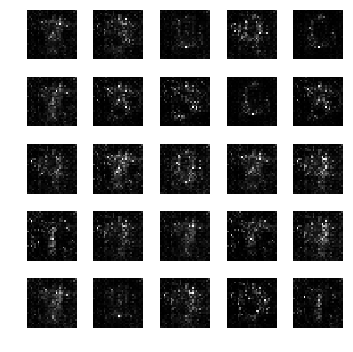

epoch: 1291, time: 4.950273 | train_G_Loss: 0.456420, train_D_loss: 4.131211, train_acc: 0.644531
cv_G_Loss: 0.476638, cv_D_loss: 3.570554, cv_acc: 0.625100

epoch: 1292, time: 4.921972 | train_G_Loss: 0.472216, train_D_loss: 4.022216, train_acc: 0.568359
cv_G_Loss: 0.455230, cv_D_loss: 3.567198, cv_acc: 0.659500

epoch: 1293, time: 4.911930 | train_G_Loss: 0.544710, train_D_loss: 4.255090, train_acc: 0.673828
cv_G_Loss: 0.767644, cv_D_loss: 3.772599, cv_acc: 0.653500

epoch: 1294, time: 4.917914 | train_G_Loss: 0.495782, train_D_loss: 1.466802, train_acc: 0.718750
cv_G_Loss: 0.528275, cv_D_loss: 3.509729, cv_acc: 0.668000

epoch: 1295, time: 4.922654 | train_G_Loss: 0.363864, train_D_loss: 3.166686, train_acc: 0.695312
cv_G_Loss: 0.329562, cv_D_loss: 3.525028, cv_acc: 0.669700

epoch: 1296, time: 4.916539 | train_G_Loss: 0.523211, train_D_loss: 1.467981, train_acc: 0.691406
cv_G_Loss: 0.567628, cv_D_loss: 3.515319, cv_acc: 0.660400

epoch: 1297, time: 4.922900 | train_G_Loss: 0.433136

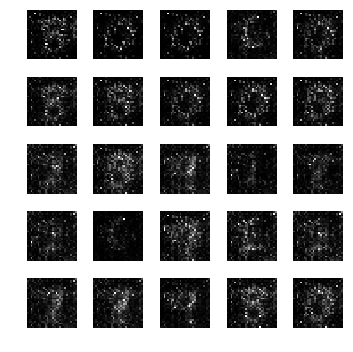

epoch: 1301, time: 4.945763 | train_G_Loss: 0.509328, train_D_loss: 3.052402, train_acc: 0.449219
cv_G_Loss: 0.560091, cv_D_loss: 3.666106, cv_acc: 0.448600

epoch: 1302, time: 4.914363 | train_G_Loss: 0.544195, train_D_loss: 1.473734, train_acc: 0.628906
cv_G_Loss: 0.692760, cv_D_loss: 3.658591, cv_acc: 0.672400

epoch: 1303, time: 4.919378 | train_G_Loss: 0.473991, train_D_loss: 3.777534, train_acc: 0.591797
cv_G_Loss: 0.608266, cv_D_loss: 3.675468, cv_acc: 0.573900

epoch: 1304, time: 4.914975 | train_G_Loss: 0.497086, train_D_loss: 1.474593, train_acc: 0.666016
cv_G_Loss: 0.478179, cv_D_loss: 3.579948, cv_acc: 0.536000

epoch: 1305, time: 4.908419 | train_G_Loss: 0.536140, train_D_loss: 3.853676, train_acc: 0.650391
cv_G_Loss: 0.859798, cv_D_loss: 3.785789, cv_acc: 0.622400

epoch: 1306, time: 4.923428 | train_G_Loss: 0.466374, train_D_loss: 4.395257, train_acc: 0.689453
cv_G_Loss: 0.539889, cv_D_loss: 3.612808, cv_acc: 0.649600

epoch: 1307, time: 4.904591 | train_G_Loss: 0.444940

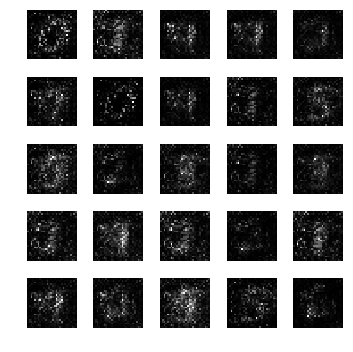

epoch: 1311, time: 4.937940 | train_G_Loss: 0.531661, train_D_loss: 1.465042, train_acc: 0.574219
cv_G_Loss: 0.570130, cv_D_loss: 3.645530, cv_acc: 0.529900

epoch: 1312, time: 4.923760 | train_G_Loss: 0.446961, train_D_loss: 3.721999, train_acc: 0.611328
cv_G_Loss: 0.524514, cv_D_loss: 3.812624, cv_acc: 0.431700

epoch: 1313, time: 4.944661 | train_G_Loss: 0.547872, train_D_loss: 1.443992, train_acc: 0.595703
cv_G_Loss: 0.683221, cv_D_loss: 3.598090, cv_acc: 0.638000

epoch: 1314, time: 4.919553 | train_G_Loss: 0.452559, train_D_loss: 3.439220, train_acc: 0.679688
cv_G_Loss: 0.459595, cv_D_loss: 3.499429, cv_acc: 0.667300

epoch: 1315, time: 4.932756 | train_G_Loss: 0.490310, train_D_loss: 1.486795, train_acc: 0.621094
cv_G_Loss: 0.448453, cv_D_loss: 3.552237, cv_acc: 0.578200

epoch: 1316, time: 4.918937 | train_G_Loss: 0.438967, train_D_loss: 1.511836, train_acc: 0.687500
cv_G_Loss: 0.477238, cv_D_loss: 3.478478, cv_acc: 0.675900
Model saved

epoch: 1317, time: 4.919682 | train_G_Lo

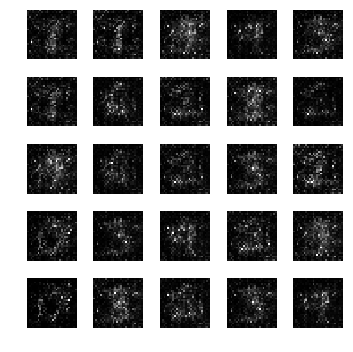

epoch: 1321, time: 4.958489 | train_G_Loss: 0.466313, train_D_loss: 1.498238, train_acc: 0.683594
cv_G_Loss: 0.488701, cv_D_loss: 3.494567, cv_acc: 0.626300

epoch: 1322, time: 4.920792 | train_G_Loss: 0.462630, train_D_loss: 3.551226, train_acc: 0.646484
cv_G_Loss: 0.625727, cv_D_loss: 3.612698, cv_acc: 0.633000

epoch: 1323, time: 4.912465 | train_G_Loss: 0.483363, train_D_loss: 2.892491, train_acc: 0.626953
cv_G_Loss: 0.536228, cv_D_loss: 3.463346, cv_acc: 0.670100

epoch: 1324, time: 4.914693 | train_G_Loss: 0.545425, train_D_loss: 1.468415, train_acc: 0.603516
cv_G_Loss: 0.551782, cv_D_loss: 3.528613, cv_acc: 0.647600

epoch: 1325, time: 4.912791 | train_G_Loss: 0.459948, train_D_loss: 1.513862, train_acc: 0.556641
cv_G_Loss: 0.532981, cv_D_loss: 3.458897, cv_acc: 0.593900

epoch: 1326, time: 4.917716 | train_G_Loss: 0.462089, train_D_loss: 1.516101, train_acc: 0.589844
cv_G_Loss: 0.534963, cv_D_loss: 3.441412, cv_acc: 0.678900
Model saved

epoch: 1327, time: 4.926530 | train_G_Lo

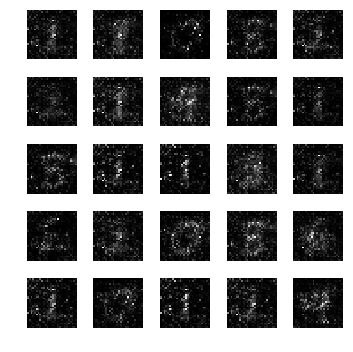

epoch: 1331, time: 4.939214 | train_G_Loss: 0.540579, train_D_loss: 4.909497, train_acc: 0.658203
cv_G_Loss: 0.569279, cv_D_loss: 3.592262, cv_acc: 0.613900

epoch: 1332, time: 4.902849 | train_G_Loss: 0.587404, train_D_loss: 2.663326, train_acc: 0.636719
cv_G_Loss: 0.790914, cv_D_loss: 3.725404, cv_acc: 0.632600

epoch: 1333, time: 4.911914 | train_G_Loss: 0.566204, train_D_loss: 1.456201, train_acc: 0.617188
cv_G_Loss: 0.651687, cv_D_loss: 3.567824, cv_acc: 0.669600

epoch: 1334, time: 4.888263 | train_G_Loss: 0.483248, train_D_loss: 4.373379, train_acc: 0.605469
cv_G_Loss: 0.557014, cv_D_loss: 3.534384, cv_acc: 0.600400

epoch: 1335, time: 4.932573 | train_G_Loss: 0.456797, train_D_loss: 1.499478, train_acc: 0.685547
cv_G_Loss: 0.502308, cv_D_loss: 3.439240, cv_acc: 0.671600

epoch: 1336, time: 4.899678 | train_G_Loss: 0.469854, train_D_loss: 1.491630, train_acc: 0.611328
cv_G_Loss: 0.581945, cv_D_loss: 3.593409, cv_acc: 0.567900

epoch: 1337, time: 4.915751 | train_G_Loss: 0.468110

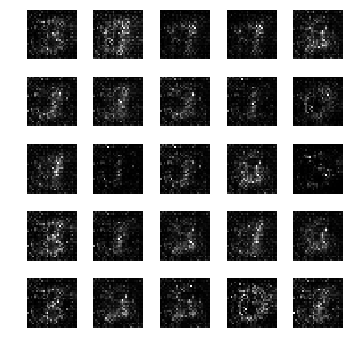

epoch: 1341, time: 4.937343 | train_G_Loss: 0.402005, train_D_loss: 2.805556, train_acc: 0.535156
cv_G_Loss: 0.385567, cv_D_loss: 3.592649, cv_acc: 0.619000

epoch: 1342, time: 4.904474 | train_G_Loss: 0.580415, train_D_loss: 1.467277, train_acc: 0.539062
cv_G_Loss: 0.881308, cv_D_loss: 3.917955, cv_acc: 0.511600

epoch: 1343, time: 4.895852 | train_G_Loss: 0.538576, train_D_loss: 2.806296, train_acc: 0.630859
cv_G_Loss: 0.718260, cv_D_loss: 3.730470, cv_acc: 0.670100

epoch: 1344, time: 4.900258 | train_G_Loss: 0.481011, train_D_loss: 3.088286, train_acc: 0.576172
cv_G_Loss: 0.534386, cv_D_loss: 3.586006, cv_acc: 0.550300

epoch: 1345, time: 4.892368 | train_G_Loss: 0.534781, train_D_loss: 1.480031, train_acc: 0.685547
cv_G_Loss: 0.806985, cv_D_loss: 3.743825, cv_acc: 0.584600

epoch: 1346, time: 4.892344 | train_G_Loss: 0.568113, train_D_loss: 3.725107, train_acc: 0.654297
cv_G_Loss: 0.727287, cv_D_loss: 3.680691, cv_acc: 0.659100

epoch: 1347, time: 4.904504 | train_G_Loss: 0.409858

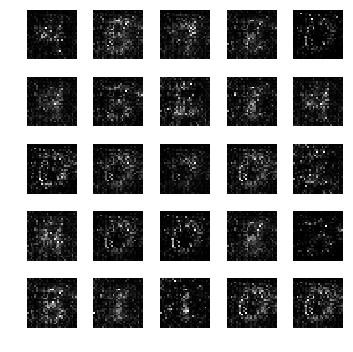

epoch: 1351, time: 4.936877 | train_G_Loss: 0.530440, train_D_loss: 3.641969, train_acc: 0.673828
cv_G_Loss: 0.652774, cv_D_loss: 3.583062, cv_acc: 0.632100

epoch: 1352, time: 4.894965 | train_G_Loss: 0.487304, train_D_loss: 1.497738, train_acc: 0.660156
cv_G_Loss: 0.516301, cv_D_loss: 3.435982, cv_acc: 0.657900

epoch: 1353, time: 4.913022 | train_G_Loss: 0.516467, train_D_loss: 1.480772, train_acc: 0.677734
cv_G_Loss: 0.518541, cv_D_loss: 3.488389, cv_acc: 0.679300
Model saved

epoch: 1354, time: 4.957825 | train_G_Loss: 0.459283, train_D_loss: 2.921742, train_acc: 0.630859
cv_G_Loss: 0.504434, cv_D_loss: 3.452067, cv_acc: 0.658900

epoch: 1355, time: 4.919081 | train_G_Loss: 0.530723, train_D_loss: 1.470538, train_acc: 0.652344
cv_G_Loss: 0.631563, cv_D_loss: 3.566755, cv_acc: 0.670100

epoch: 1356, time: 4.927380 | train_G_Loss: 0.435666, train_D_loss: 3.586457, train_acc: 0.714844
cv_G_Loss: 0.416764, cv_D_loss: 3.641009, cv_acc: 0.557300

epoch: 1357, time: 4.921528 | train_G_Lo

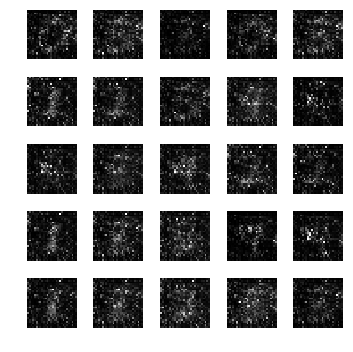

epoch: 1361, time: 4.944779 | train_G_Loss: 0.433562, train_D_loss: 1.530851, train_acc: 0.656250
cv_G_Loss: 0.424606, cv_D_loss: 3.610683, cv_acc: 0.552200

epoch: 1362, time: 4.920407 | train_G_Loss: 0.523948, train_D_loss: 1.487039, train_acc: 0.703125
cv_G_Loss: 0.688480, cv_D_loss: 3.560651, cv_acc: 0.676800

epoch: 1363, time: 4.919041 | train_G_Loss: 0.525053, train_D_loss: 2.735409, train_acc: 0.644531
cv_G_Loss: 0.709456, cv_D_loss: 3.738027, cv_acc: 0.593900

epoch: 1364, time: 4.916612 | train_G_Loss: 0.511237, train_D_loss: 2.960303, train_acc: 0.675781
cv_G_Loss: 0.535379, cv_D_loss: 3.510546, cv_acc: 0.685500
Model saved

epoch: 1365, time: 4.916545 | train_G_Loss: 0.472718, train_D_loss: 1.498041, train_acc: 0.677734
cv_G_Loss: 0.526054, cv_D_loss: 3.510609, cv_acc: 0.657500

epoch: 1366, time: 4.894731 | train_G_Loss: 0.536520, train_D_loss: 3.331882, train_acc: 0.666016
cv_G_Loss: 0.800823, cv_D_loss: 3.725144, cv_acc: 0.664100

epoch: 1367, time: 4.901844 | train_G_Lo

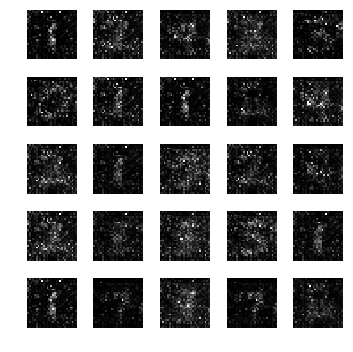

epoch: 1371, time: 4.925557 | train_G_Loss: 0.384689, train_D_loss: 1.566240, train_acc: 0.746094
cv_G_Loss: 0.419369, cv_D_loss: 3.649159, cv_acc: 0.534400

epoch: 1372, time: 4.903064 | train_G_Loss: 0.573597, train_D_loss: 2.874377, train_acc: 0.730469
cv_G_Loss: 0.797677, cv_D_loss: 3.654119, cv_acc: 0.657000

epoch: 1373, time: 4.898271 | train_G_Loss: 0.529960, train_D_loss: 1.470779, train_acc: 0.666016
cv_G_Loss: 0.736120, cv_D_loss: 3.519131, cv_acc: 0.675600

epoch: 1374, time: 4.892668 | train_G_Loss: 0.596211, train_D_loss: 1.458204, train_acc: 0.681641
cv_G_Loss: 0.830957, cv_D_loss: 3.669781, cv_acc: 0.671100

epoch: 1375, time: 4.905123 | train_G_Loss: 0.489794, train_D_loss: 1.487736, train_acc: 0.660156
cv_G_Loss: 0.475494, cv_D_loss: 3.470433, cv_acc: 0.627300

epoch: 1376, time: 4.897343 | train_G_Loss: 0.470870, train_D_loss: 1.510801, train_acc: 0.687500
cv_G_Loss: 0.555771, cv_D_loss: 3.424823, cv_acc: 0.665800

epoch: 1377, time: 4.893834 | train_G_Loss: 0.474256

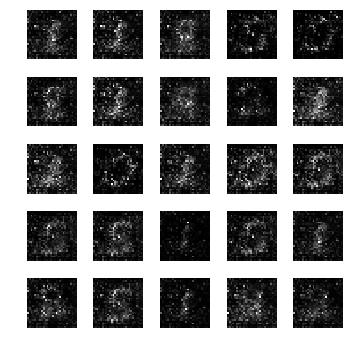

epoch: 1381, time: 4.976737 | train_G_Loss: 0.542254, train_D_loss: 2.739626, train_acc: 0.667969
cv_G_Loss: 0.667763, cv_D_loss: 3.551437, cv_acc: 0.681800

epoch: 1382, time: 4.918281 | train_G_Loss: 0.504210, train_D_loss: 2.882876, train_acc: 0.589844
cv_G_Loss: 0.661333, cv_D_loss: 3.579107, cv_acc: 0.498600

epoch: 1383, time: 4.915155 | train_G_Loss: 0.522802, train_D_loss: 3.060039, train_acc: 0.691406
cv_G_Loss: 0.599097, cv_D_loss: 3.524634, cv_acc: 0.679500

epoch: 1384, time: 4.911510 | train_G_Loss: 0.452826, train_D_loss: 1.505469, train_acc: 0.615234
cv_G_Loss: 0.543165, cv_D_loss: 3.402823, cv_acc: 0.655400

epoch: 1385, time: 4.923060 | train_G_Loss: 0.498102, train_D_loss: 1.489702, train_acc: 0.595703
cv_G_Loss: 0.546364, cv_D_loss: 3.585547, cv_acc: 0.591500

epoch: 1386, time: 4.915563 | train_G_Loss: 0.579697, train_D_loss: 1.455043, train_acc: 0.644531
cv_G_Loss: 0.752376, cv_D_loss: 3.591089, cv_acc: 0.681900

epoch: 1387, time: 4.914043 | train_G_Loss: 0.477995

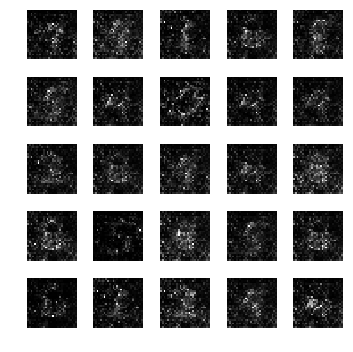

epoch: 1391, time: 4.921516 | train_G_Loss: 0.468665, train_D_loss: 3.095546, train_acc: 0.658203
cv_G_Loss: 0.610055, cv_D_loss: 3.460498, cv_acc: 0.680100

epoch: 1392, time: 4.907503 | train_G_Loss: 0.453720, train_D_loss: 3.152369, train_acc: 0.593750
cv_G_Loss: 0.467535, cv_D_loss: 3.482520, cv_acc: 0.629900

epoch: 1393, time: 4.902267 | train_G_Loss: 0.387295, train_D_loss: 3.900631, train_acc: 0.507812
cv_G_Loss: 0.381131, cv_D_loss: 3.411756, cv_acc: 0.621900

epoch: 1394, time: 4.901923 | train_G_Loss: 0.463537, train_D_loss: 3.399239, train_acc: 0.650391
cv_G_Loss: 0.480715, cv_D_loss: 3.423795, cv_acc: 0.645900

epoch: 1395, time: 4.912149 | train_G_Loss: 0.498054, train_D_loss: 1.491000, train_acc: 0.673828
cv_G_Loss: 0.599070, cv_D_loss: 3.479896, cv_acc: 0.614300

epoch: 1396, time: 4.902972 | train_G_Loss: 0.513139, train_D_loss: 1.493222, train_acc: 0.664062
cv_G_Loss: 0.525950, cv_D_loss: 3.469069, cv_acc: 0.671600

epoch: 1397, time: 4.903860 | train_G_Loss: 0.490578

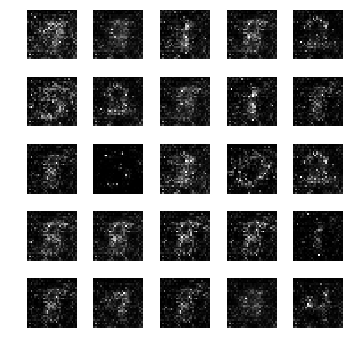

epoch: 1401, time: 4.936177 | train_G_Loss: 0.587371, train_D_loss: 1.484286, train_acc: 0.580078
cv_G_Loss: 0.739781, cv_D_loss: 3.719372, cv_acc: 0.627200

epoch: 1402, time: 4.895490 | train_G_Loss: 0.389129, train_D_loss: 1.572709, train_acc: 0.560547
cv_G_Loss: 0.428432, cv_D_loss: 3.427566, cv_acc: 0.628500

epoch: 1403, time: 4.913351 | train_G_Loss: 0.430676, train_D_loss: 2.781060, train_acc: 0.605469
cv_G_Loss: 0.429194, cv_D_loss: 3.425709, cv_acc: 0.659600

epoch: 1404, time: 4.907838 | train_G_Loss: 0.516480, train_D_loss: 1.478825, train_acc: 0.634766
cv_G_Loss: 0.646972, cv_D_loss: 3.568411, cv_acc: 0.638100

epoch: 1405, time: 4.907975 | train_G_Loss: 0.488766, train_D_loss: 1.483438, train_acc: 0.671875
cv_G_Loss: 0.551916, cv_D_loss: 3.493179, cv_acc: 0.625100

epoch: 1406, time: 4.902260 | train_G_Loss: 0.485992, train_D_loss: 1.514581, train_acc: 0.652344
cv_G_Loss: 0.523749, cv_D_loss: 3.519858, cv_acc: 0.634200

epoch: 1407, time: 4.900150 | train_G_Loss: 0.489251

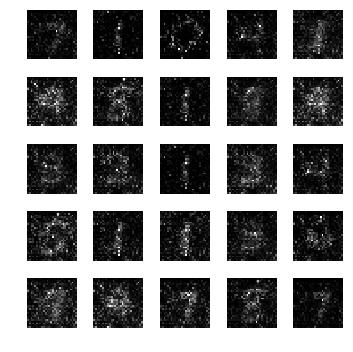

epoch: 1411, time: 4.946659 | train_G_Loss: 0.483606, train_D_loss: 4.436105, train_acc: 0.660156
cv_G_Loss: 0.699949, cv_D_loss: 3.536260, cv_acc: 0.638800

epoch: 1412, time: 4.913646 | train_G_Loss: 0.424751, train_D_loss: 1.540448, train_acc: 0.625000
cv_G_Loss: 0.458569, cv_D_loss: 3.472186, cv_acc: 0.612300

epoch: 1413, time: 4.902835 | train_G_Loss: 0.512352, train_D_loss: 1.499926, train_acc: 0.572266
cv_G_Loss: 0.560306, cv_D_loss: 3.507270, cv_acc: 0.552900

epoch: 1414, time: 4.898246 | train_G_Loss: 0.513254, train_D_loss: 1.484003, train_acc: 0.689453
cv_G_Loss: 0.519712, cv_D_loss: 3.495390, cv_acc: 0.647500

epoch: 1415, time: 4.895270 | train_G_Loss: 0.453550, train_D_loss: 3.101161, train_acc: 0.726562
cv_G_Loss: 0.570042, cv_D_loss: 3.413531, cv_acc: 0.679200

epoch: 1416, time: 4.907311 | train_G_Loss: 0.492946, train_D_loss: 4.449795, train_acc: 0.626953
cv_G_Loss: 0.515009, cv_D_loss: 3.523914, cv_acc: 0.592100

epoch: 1417, time: 4.914042 | train_G_Loss: 0.481914

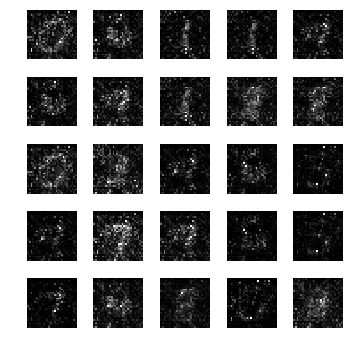

epoch: 1421, time: 4.922148 | train_G_Loss: 0.486227, train_D_loss: 1.484774, train_acc: 0.621094
cv_G_Loss: 0.647557, cv_D_loss: 3.488405, cv_acc: 0.628200

epoch: 1422, time: 4.903650 | train_G_Loss: 0.475244, train_D_loss: 1.489757, train_acc: 0.599609
cv_G_Loss: 0.505318, cv_D_loss: 3.548514, cv_acc: 0.567300

epoch: 1423, time: 4.903688 | train_G_Loss: 0.518850, train_D_loss: 3.748174, train_acc: 0.544922
cv_G_Loss: 0.692915, cv_D_loss: 3.533149, cv_acc: 0.610800

epoch: 1424, time: 4.906286 | train_G_Loss: 0.468907, train_D_loss: 2.749217, train_acc: 0.542969
cv_G_Loss: 0.500875, cv_D_loss: 3.438702, cv_acc: 0.601100

epoch: 1425, time: 4.906464 | train_G_Loss: 0.424231, train_D_loss: 1.533242, train_acc: 0.591797
cv_G_Loss: 0.516723, cv_D_loss: 3.383698, cv_acc: 0.641500

epoch: 1426, time: 4.920056 | train_G_Loss: 0.473258, train_D_loss: 1.501238, train_acc: 0.591797
cv_G_Loss: 0.449618, cv_D_loss: 3.446436, cv_acc: 0.629800

epoch: 1427, time: 4.913343 | train_G_Loss: 0.425716

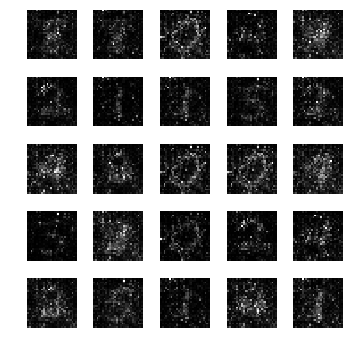

epoch: 1431, time: 4.935729 | train_G_Loss: 0.517410, train_D_loss: 3.384159, train_acc: 0.671875
cv_G_Loss: 0.618226, cv_D_loss: 3.509846, cv_acc: 0.659800

epoch: 1432, time: 4.901484 | train_G_Loss: 0.562499, train_D_loss: 3.452249, train_acc: 0.626953
cv_G_Loss: 0.759419, cv_D_loss: 3.584982, cv_acc: 0.585900

epoch: 1433, time: 4.901180 | train_G_Loss: 0.465195, train_D_loss: 1.508152, train_acc: 0.636719
cv_G_Loss: 0.520989, cv_D_loss: 3.350160, cv_acc: 0.706900
Model saved

epoch: 1434, time: 4.953210 | train_G_Loss: 0.447061, train_D_loss: 1.508774, train_acc: 0.685547
cv_G_Loss: 0.566721, cv_D_loss: 3.542506, cv_acc: 0.582600

epoch: 1435, time: 4.932222 | train_G_Loss: 0.483419, train_D_loss: 1.499848, train_acc: 0.664062
cv_G_Loss: 0.460896, cv_D_loss: 3.499522, cv_acc: 0.599600

epoch: 1436, time: 4.916529 | train_G_Loss: 0.459734, train_D_loss: 1.507110, train_acc: 0.693359
cv_G_Loss: 0.453530, cv_D_loss: 3.598037, cv_acc: 0.491600

epoch: 1437, time: 4.926701 | train_G_Lo

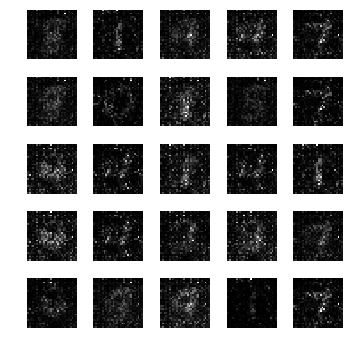

epoch: 1441, time: 4.965744 | train_G_Loss: 0.456556, train_D_loss: 3.607419, train_acc: 0.707031
cv_G_Loss: 0.717002, cv_D_loss: 3.443645, cv_acc: 0.648500

epoch: 1442, time: 4.916665 | train_G_Loss: 0.446883, train_D_loss: 4.084050, train_acc: 0.740234
cv_G_Loss: 0.435987, cv_D_loss: 3.439404, cv_acc: 0.661200

epoch: 1443, time: 4.926818 | train_G_Loss: 0.423632, train_D_loss: 1.528246, train_acc: 0.644531
cv_G_Loss: 0.423491, cv_D_loss: 3.685076, cv_acc: 0.374300

epoch: 1444, time: 4.920544 | train_G_Loss: 0.441672, train_D_loss: 5.292202, train_acc: 0.591797
cv_G_Loss: 0.450951, cv_D_loss: 3.469238, cv_acc: 0.602500

epoch: 1445, time: 4.918337 | train_G_Loss: 0.427617, train_D_loss: 3.039605, train_acc: 0.662109
cv_G_Loss: 0.473880, cv_D_loss: 3.533735, cv_acc: 0.563100

epoch: 1446, time: 4.913166 | train_G_Loss: 0.503093, train_D_loss: 3.264224, train_acc: 0.671875
cv_G_Loss: 0.539470, cv_D_loss: 3.520984, cv_acc: 0.618000

epoch: 1447, time: 4.921541 | train_G_Loss: 0.490857

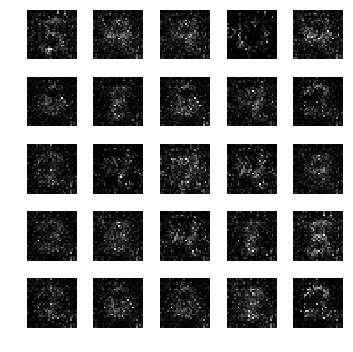

epoch: 1451, time: 4.944768 | train_G_Loss: 0.401897, train_D_loss: 1.548512, train_acc: 0.658203
cv_G_Loss: 0.373520, cv_D_loss: 3.617226, cv_acc: 0.508500

epoch: 1452, time: 4.917003 | train_G_Loss: 0.460228, train_D_loss: 1.497204, train_acc: 0.699219
cv_G_Loss: 0.471330, cv_D_loss: 3.394284, cv_acc: 0.664300

epoch: 1453, time: 4.910960 | train_G_Loss: 0.415541, train_D_loss: 3.493255, train_acc: 0.648438
cv_G_Loss: 0.455366, cv_D_loss: 3.376111, cv_acc: 0.642700

epoch: 1454, time: 4.918967 | train_G_Loss: 0.416908, train_D_loss: 3.349509, train_acc: 0.628906
cv_G_Loss: 0.448852, cv_D_loss: 3.404723, cv_acc: 0.623300

epoch: 1455, time: 4.922174 | train_G_Loss: 0.527679, train_D_loss: 3.037359, train_acc: 0.669922
cv_G_Loss: 0.685331, cv_D_loss: 3.928951, cv_acc: 0.390500

epoch: 1456, time: 4.908518 | train_G_Loss: 0.529531, train_D_loss: 1.472440, train_acc: 0.699219
cv_G_Loss: 0.603968, cv_D_loss: 3.518599, cv_acc: 0.683100

epoch: 1457, time: 4.918183 | train_G_Loss: 0.470981

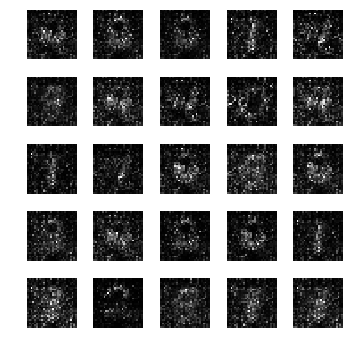

epoch: 1461, time: 4.932744 | train_G_Loss: 0.440800, train_D_loss: 3.548653, train_acc: 0.662109
cv_G_Loss: 0.587892, cv_D_loss: 3.381174, cv_acc: 0.654400

epoch: 1462, time: 4.912523 | train_G_Loss: 0.450868, train_D_loss: 1.507130, train_acc: 0.593750
cv_G_Loss: 0.484332, cv_D_loss: 3.469619, cv_acc: 0.642500

epoch: 1463, time: 4.912223 | train_G_Loss: 0.458489, train_D_loss: 2.759653, train_acc: 0.701172
cv_G_Loss: 0.452341, cv_D_loss: 3.391746, cv_acc: 0.677300

epoch: 1464, time: 4.912057 | train_G_Loss: 0.447577, train_D_loss: 3.268811, train_acc: 0.666016
cv_G_Loss: 0.491890, cv_D_loss: 3.455882, cv_acc: 0.667800

epoch: 1465, time: 4.909613 | train_G_Loss: 0.497874, train_D_loss: 3.255291, train_acc: 0.611328
cv_G_Loss: 0.566028, cv_D_loss: 3.639578, cv_acc: 0.551100

epoch: 1466, time: 4.908927 | train_G_Loss: 0.535474, train_D_loss: 1.466793, train_acc: 0.638672
cv_G_Loss: 0.849076, cv_D_loss: 3.653732, cv_acc: 0.567800

epoch: 1467, time: 4.915556 | train_G_Loss: 0.448981

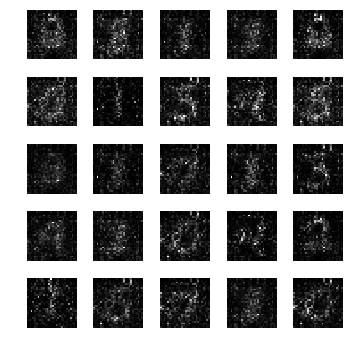

epoch: 1471, time: 4.946758 | train_G_Loss: 0.520764, train_D_loss: 1.476424, train_acc: 0.689453
cv_G_Loss: 0.683501, cv_D_loss: 3.481606, cv_acc: 0.675400

epoch: 1472, time: 4.940889 | train_G_Loss: 0.522058, train_D_loss: 1.472631, train_acc: 0.748047
cv_G_Loss: 0.521434, cv_D_loss: 3.386524, cv_acc: 0.683800

epoch: 1473, time: 4.921285 | train_G_Loss: 0.526237, train_D_loss: 4.931763, train_acc: 0.732422
cv_G_Loss: 0.606142, cv_D_loss: 3.463288, cv_acc: 0.665400

epoch: 1474, time: 4.911707 | train_G_Loss: 0.386717, train_D_loss: 3.500073, train_acc: 0.755859
cv_G_Loss: 0.493079, cv_D_loss: 3.329274, cv_acc: 0.704000

epoch: 1475, time: 4.923567 | train_G_Loss: 0.393134, train_D_loss: 2.453687, train_acc: 0.736328
cv_G_Loss: 0.366983, cv_D_loss: 3.517376, cv_acc: 0.561800

epoch: 1476, time: 4.905023 | train_G_Loss: 0.447153, train_D_loss: 3.674302, train_acc: 0.732422
cv_G_Loss: 0.572777, cv_D_loss: 3.426405, cv_acc: 0.669600

epoch: 1477, time: 4.919238 | train_G_Loss: 0.391941

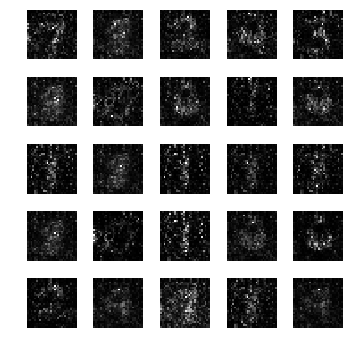

epoch: 1481, time: 4.949974 | train_G_Loss: 0.442162, train_D_loss: 3.281870, train_acc: 0.669922
cv_G_Loss: 0.506741, cv_D_loss: 3.652611, cv_acc: 0.457700

epoch: 1482, time: 4.928068 | train_G_Loss: 0.436389, train_D_loss: 5.161021, train_acc: 0.751953
cv_G_Loss: 0.530811, cv_D_loss: 3.589207, cv_acc: 0.598400

epoch: 1483, time: 4.916051 | train_G_Loss: 0.415470, train_D_loss: 3.663418, train_acc: 0.712891
cv_G_Loss: 0.477345, cv_D_loss: 3.402639, cv_acc: 0.697900

epoch: 1484, time: 4.912284 | train_G_Loss: 0.473273, train_D_loss: 1.484412, train_acc: 0.755859
cv_G_Loss: 0.616184, cv_D_loss: 3.725760, cv_acc: 0.506000

epoch: 1485, time: 4.908054 | train_G_Loss: 0.492010, train_D_loss: 1.478427, train_acc: 0.699219
cv_G_Loss: 0.588634, cv_D_loss: 3.477408, cv_acc: 0.667200

epoch: 1486, time: 4.912119 | train_G_Loss: 0.466676, train_D_loss: 1.502445, train_acc: 0.658203
cv_G_Loss: 0.474676, cv_D_loss: 3.426570, cv_acc: 0.651500

epoch: 1487, time: 4.927064 | train_G_Loss: 0.558720

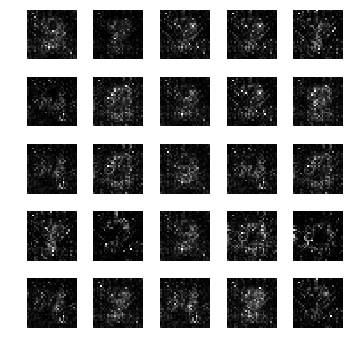

epoch: 1491, time: 4.955552 | train_G_Loss: 0.469438, train_D_loss: 1.495739, train_acc: 0.732422
cv_G_Loss: 0.499493, cv_D_loss: 3.388816, cv_acc: 0.692700

epoch: 1492, time: 4.914860 | train_G_Loss: 0.486459, train_D_loss: 4.382587, train_acc: 0.634766
cv_G_Loss: 0.508159, cv_D_loss: 3.685547, cv_acc: 0.427500

epoch: 1493, time: 4.908064 | train_G_Loss: 0.500906, train_D_loss: 1.484192, train_acc: 0.666016
cv_G_Loss: 0.711699, cv_D_loss: 3.629430, cv_acc: 0.687200

epoch: 1494, time: 4.915197 | train_G_Loss: 0.520178, train_D_loss: 3.154150, train_acc: 0.630859
cv_G_Loss: 0.610422, cv_D_loss: 3.760229, cv_acc: 0.562300

epoch: 1495, time: 4.943070 | train_G_Loss: 0.568287, train_D_loss: 1.460785, train_acc: 0.656250
cv_G_Loss: 0.633573, cv_D_loss: 3.600637, cv_acc: 0.637900

epoch: 1496, time: 4.916965 | train_G_Loss: 0.670882, train_D_loss: 3.149066, train_acc: 0.595703
cv_G_Loss: 1.069541, cv_D_loss: 3.960766, cv_acc: 0.649000

epoch: 1497, time: 4.917909 | train_G_Loss: 0.531289

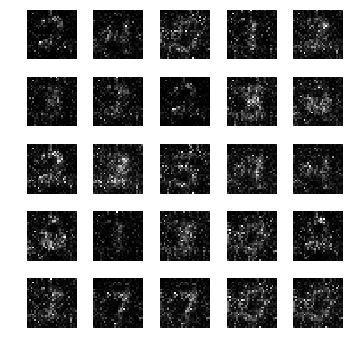

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

Generator summary:
 z: (?, 100)
 G0: (?, 1, 1, 100)
 G1: (?, 2, 2, 100)
 G2: (?, 5, 5, 64)
 G3: (?, 12, 12, 32)
 G4: (?, 28, 28, 1)

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

training....
Extracting mnist_data\train-images-idx3-ubyte.gz
Extracting mnist_data\train-labels-idx1-ubyte.gz
Extracting mnist_data\t10k-images-idx3-ubyte.gz
Extracting mnist_data\t10k-labels-idx1-ubyte.gz
epoch: 0, time: 6.151386 | train_G_Loss: 0.458152, train_D_loss: 4.095050, train_acc: 0.107422
cv_G_Loss: 0.649504, cv_D_loss: 4.238688, cv_acc: 0.113500
Model saved



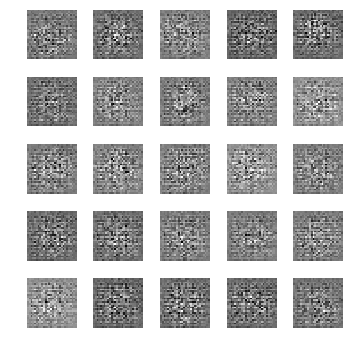

epoch: 1, time: 5.000881 | train_G_Loss: 0.789267, train_D_loss: 3.295396, train_acc: 0.101562
cv_G_Loss: 2.899713, cv_D_loss: 6.232319, cv_acc: 0.113500

epoch: 2, time: 4.980602 | train_G_Loss: 1.255099, train_D_loss: 2.895331, train_acc: 0.060547
cv_G_Loss: 4.690255, cv_D_loss: 9.994544, cv_acc: 0.113500

epoch: 3, time: 4.974912 | train_G_Loss: 1.714014, train_D_loss: 2.675411, train_acc: 0.103516
cv_G_Loss: 6.137350, cv_D_loss: 13.002031, cv_acc: 0.113500

epoch: 4, time: 4.990913 | train_G_Loss: 2.035115, train_D_loss: 2.574281, train_acc: 0.117188
cv_G_Loss: 7.374882, cv_D_loss: 15.574031, cv_acc: 0.113500

epoch: 5, time: 4.971221 | train_G_Loss: 2.400647, train_D_loss: 2.509624, train_acc: 0.109375
cv_G_Loss: 8.612790, cv_D_loss: 17.585472, cv_acc: 0.113500

epoch: 6, time: 4.969187 | train_G_Loss: 2.642721, train_D_loss: 2.439342, train_acc: 0.109375
cv_G_Loss: 9.626210, cv_D_loss: 19.137146, cv_acc: 0.113500

epoch: 7, time: 4.978666 | train_G_Loss: 2.842690, train_D_loss: 2

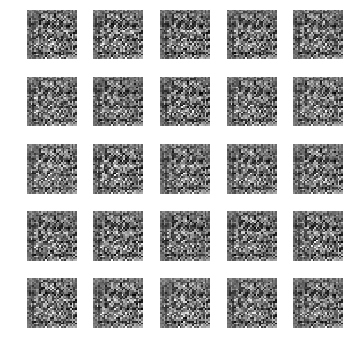

epoch: 11, time: 5.000251 | train_G_Loss: 3.521685, train_D_loss: 2.347056, train_acc: 0.203125
cv_G_Loss: 11.620569, cv_D_loss: 28.034466, cv_acc: 0.113500

epoch: 12, time: 4.980228 | train_G_Loss: 3.365860, train_D_loss: 2.350094, train_acc: 0.185547
cv_G_Loss: 11.106241, cv_D_loss: 29.635782, cv_acc: 0.113500

epoch: 13, time: 4.972921 | train_G_Loss: 3.502345, train_D_loss: 2.364119, train_acc: 0.195312
cv_G_Loss: 11.330056, cv_D_loss: 29.998535, cv_acc: 0.113500

epoch: 14, time: 4.973310 | train_G_Loss: 3.601662, train_D_loss: 2.366244, train_acc: 0.111328
cv_G_Loss: 11.516535, cv_D_loss: 29.725983, cv_acc: 0.113500

epoch: 15, time: 4.994642 | train_G_Loss: 3.634979, train_D_loss: 2.329735, train_acc: 0.119141
cv_G_Loss: 11.959557, cv_D_loss: 31.248358, cv_acc: 0.113500

epoch: 16, time: 4.979138 | train_G_Loss: 3.752911, train_D_loss: 2.341153, train_acc: 0.111328
cv_G_Loss: 11.569809, cv_D_loss: 32.739479, cv_acc: 0.113500

epoch: 17, time: 4.975726 | train_G_Loss: 3.996682, 

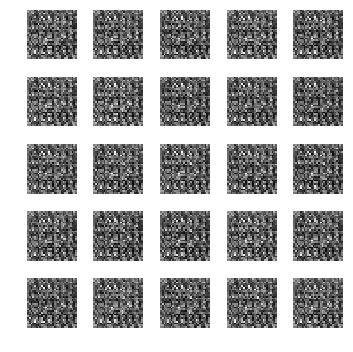

epoch: 21, time: 5.005023 | train_G_Loss: 4.360371, train_D_loss: 2.303901, train_acc: 0.091797
cv_G_Loss: 10.385416, cv_D_loss: 34.601570, cv_acc: 0.113500

epoch: 22, time: 4.966477 | train_G_Loss: 4.436910, train_D_loss: 2.315019, train_acc: 0.091797
cv_G_Loss: 9.824160, cv_D_loss: 34.712578, cv_acc: 0.113500

epoch: 23, time: 4.975154 | train_G_Loss: 4.390484, train_D_loss: 2.325332, train_acc: 0.089844
cv_G_Loss: 9.264906, cv_D_loss: 34.128895, cv_acc: 0.113500

epoch: 24, time: 4.961886 | train_G_Loss: 4.340687, train_D_loss: 2.330648, train_acc: 0.201172
cv_G_Loss: 8.950593, cv_D_loss: 32.293648, cv_acc: 0.113500

epoch: 25, time: 4.974996 | train_G_Loss: 4.388407, train_D_loss: 2.307135, train_acc: 0.144531
cv_G_Loss: 8.652348, cv_D_loss: 32.216785, cv_acc: 0.113500

epoch: 26, time: 4.967937 | train_G_Loss: 4.207265, train_D_loss: 2.309225, train_acc: 0.189453
cv_G_Loss: 7.367770, cv_D_loss: 31.901201, cv_acc: 0.113500

epoch: 27, time: 4.959202 | train_G_Loss: 3.923591, train

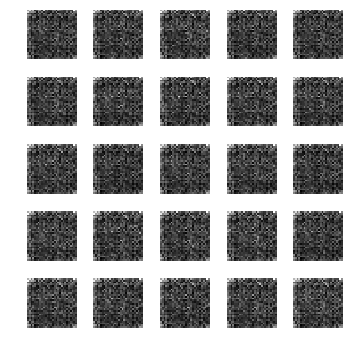

epoch: 31, time: 4.992481 | train_G_Loss: 3.077039, train_D_loss: 2.371298, train_acc: 0.169922
cv_G_Loss: 3.791555, cv_D_loss: 27.188026, cv_acc: 0.113500

epoch: 32, time: 4.969894 | train_G_Loss: 3.059778, train_D_loss: 2.365118, train_acc: 0.314453
cv_G_Loss: 3.304017, cv_D_loss: 27.598312, cv_acc: 0.113500

epoch: 33, time: 4.974272 | train_G_Loss: 2.939362, train_D_loss: 2.348191, train_acc: 0.259766
cv_G_Loss: 3.054559, cv_D_loss: 27.229723, cv_acc: 0.113500

epoch: 34, time: 4.962124 | train_G_Loss: 2.740426, train_D_loss: 2.360115, train_acc: 0.314453
cv_G_Loss: 2.645635, cv_D_loss: 24.295202, cv_acc: 0.113500

epoch: 35, time: 4.957253 | train_G_Loss: 2.677444, train_D_loss: 2.395889, train_acc: 0.193359
cv_G_Loss: 2.615066, cv_D_loss: 22.164021, cv_acc: 0.113500

epoch: 36, time: 4.954820 | train_G_Loss: 2.547488, train_D_loss: 2.433636, train_acc: 0.240234
cv_G_Loss: 2.532665, cv_D_loss: 21.104132, cv_acc: 0.113600
Model saved

epoch: 37, time: 4.973236 | train_G_Loss: 2.30

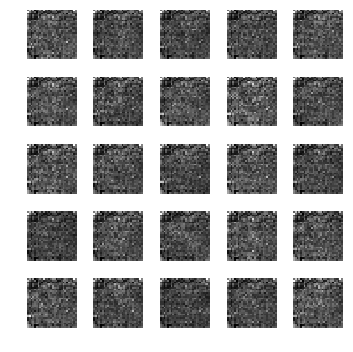

epoch: 41, time: 4.980675 | train_G_Loss: 1.546178, train_D_loss: 2.634278, train_acc: 0.500000
cv_G_Loss: 1.439805, cv_D_loss: 13.654294, cv_acc: 0.131600

epoch: 42, time: 4.970147 | train_G_Loss: 1.363500, train_D_loss: 2.690584, train_acc: 0.339844
cv_G_Loss: 1.333131, cv_D_loss: 11.542480, cv_acc: 0.113500

epoch: 43, time: 5.056016 | train_G_Loss: 1.435930, train_D_loss: 2.764933, train_acc: 0.417969
cv_G_Loss: 1.467920, cv_D_loss: 11.676002, cv_acc: 0.114400

epoch: 44, time: 4.961994 | train_G_Loss: 1.193601, train_D_loss: 2.783756, train_acc: 0.416016
cv_G_Loss: 1.115009, cv_D_loss: 8.746328, cv_acc: 0.114500

epoch: 45, time: 4.960424 | train_G_Loss: 1.084216, train_D_loss: 2.862766, train_acc: 0.542969
cv_G_Loss: 1.131260, cv_D_loss: 9.619349, cv_acc: 0.118300

epoch: 46, time: 4.965031 | train_G_Loss: 1.068586, train_D_loss: 2.941982, train_acc: 0.457031
cv_G_Loss: 1.055742, cv_D_loss: 10.058726, cv_acc: 0.114300

epoch: 47, time: 4.954889 | train_G_Loss: 1.088034, train_D_

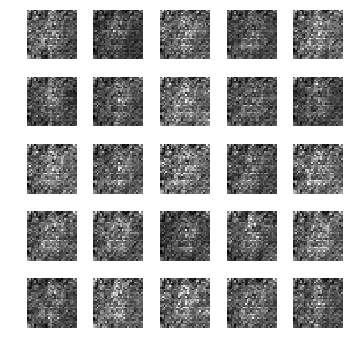

epoch: 51, time: 4.973548 | train_G_Loss: 0.828436, train_D_loss: 3.195947, train_acc: 0.533203
cv_G_Loss: 0.892677, cv_D_loss: 8.119144, cv_acc: 0.300500
Model saved

epoch: 52, time: 4.976463 | train_G_Loss: 0.988690, train_D_loss: 3.256481, train_acc: 0.552734
cv_G_Loss: 1.296267, cv_D_loss: 9.554724, cv_acc: 0.284900

epoch: 53, time: 4.969229 | train_G_Loss: 0.756218, train_D_loss: 3.121909, train_acc: 0.556641
cv_G_Loss: 0.725789, cv_D_loss: 6.481080, cv_acc: 0.366800
Model saved

epoch: 54, time: 4.981118 | train_G_Loss: 0.824089, train_D_loss: 3.202187, train_acc: 0.529297
cv_G_Loss: 3.120411, cv_D_loss: 11.963820, cv_acc: 0.245800

epoch: 55, time: 4.946139 | train_G_Loss: 0.735234, train_D_loss: 3.173636, train_acc: 0.605469
cv_G_Loss: 0.762111, cv_D_loss: 6.294479, cv_acc: 0.327700

epoch: 56, time: 4.952321 | train_G_Loss: 0.718561, train_D_loss: 3.151942, train_acc: 0.527344
cv_G_Loss: 0.548062, cv_D_loss: 5.417867, cv_acc: 0.403100
Model saved

epoch: 57, time: 4.976955 |

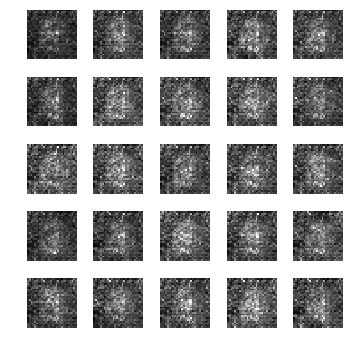

epoch: 61, time: 4.975181 | train_G_Loss: 0.681323, train_D_loss: 3.149612, train_acc: 0.628906
cv_G_Loss: 0.594880, cv_D_loss: 5.693191, cv_acc: 0.474400
Model saved

epoch: 62, time: 4.978652 | train_G_Loss: 0.623746, train_D_loss: 3.203112, train_acc: 0.660156
cv_G_Loss: 0.510307, cv_D_loss: 4.655361, cv_acc: 0.489100
Model saved

epoch: 63, time: 4.978628 | train_G_Loss: 0.567918, train_D_loss: 3.246706, train_acc: 0.589844
cv_G_Loss: 0.845428, cv_D_loss: 6.130757, cv_acc: 0.296400

epoch: 64, time: 4.947773 | train_G_Loss: 0.611986, train_D_loss: 3.149196, train_acc: 0.695312
cv_G_Loss: 0.142977, cv_D_loss: 4.708275, cv_acc: 0.370300

epoch: 65, time: 4.946558 | train_G_Loss: 0.645362, train_D_loss: 3.190510, train_acc: 0.572266
cv_G_Loss: 0.284993, cv_D_loss: 4.777689, cv_acc: 0.205100

epoch: 66, time: 4.951900 | train_G_Loss: 0.593402, train_D_loss: 3.117207, train_acc: 0.611328
cv_G_Loss: 0.298738, cv_D_loss: 4.398300, cv_acc: 0.450000

epoch: 67, time: 4.951340 | train_G_Loss

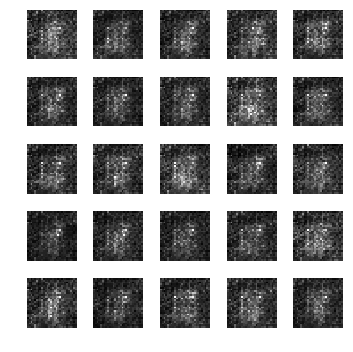

epoch: 71, time: 4.972560 | train_G_Loss: 0.536254, train_D_loss: 3.116451, train_acc: 0.673828
cv_G_Loss: 0.257261, cv_D_loss: 3.941061, cv_acc: 0.408300

epoch: 72, time: 4.941862 | train_G_Loss: 0.863775, train_D_loss: 2.850685, train_acc: 0.636719
cv_G_Loss: 0.448209, cv_D_loss: 3.884730, cv_acc: 0.501600

epoch: 73, time: 4.960129 | train_G_Loss: 0.606879, train_D_loss: 3.028347, train_acc: 0.664062
cv_G_Loss: 0.091782, cv_D_loss: 4.636957, cv_acc: 0.493700

epoch: 74, time: 4.939773 | train_G_Loss: 0.529914, train_D_loss: 3.024731, train_acc: 0.648438
cv_G_Loss: 0.159758, cv_D_loss: 4.077044, cv_acc: 0.632600
Model saved

epoch: 75, time: 4.980874 | train_G_Loss: 0.541789, train_D_loss: 3.014368, train_acc: 0.626953
cv_G_Loss: 0.268670, cv_D_loss: 4.142793, cv_acc: 0.390900

epoch: 76, time: 4.945518 | train_G_Loss: 0.734414, train_D_loss: 2.859967, train_acc: 0.660156
cv_G_Loss: 0.172267, cv_D_loss: 4.012010, cv_acc: 0.602500

epoch: 77, time: 4.942328 | train_G_Loss: 0.613764, 

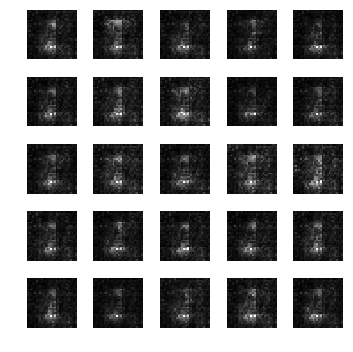

epoch: 81, time: 4.960760 | train_G_Loss: 0.703658, train_D_loss: 2.748492, train_acc: 0.617188
cv_G_Loss: 0.186651, cv_D_loss: 4.276735, cv_acc: 0.248100

epoch: 82, time: 4.956914 | train_G_Loss: 0.744736, train_D_loss: 2.780334, train_acc: 0.695312
cv_G_Loss: 0.672191, cv_D_loss: 2.984275, cv_acc: 0.669700
Model saved

epoch: 83, time: 4.989417 | train_G_Loss: 0.639744, train_D_loss: 2.543808, train_acc: 0.677734
cv_G_Loss: 0.218499, cv_D_loss: 3.666290, cv_acc: 0.428000

epoch: 84, time: 4.956199 | train_G_Loss: 0.553725, train_D_loss: 2.735657, train_acc: 0.630859
cv_G_Loss: 0.095325, cv_D_loss: 4.003215, cv_acc: 0.714100
Model saved

epoch: 85, time: 4.943355 | train_G_Loss: 0.668178, train_D_loss: 2.886896, train_acc: 0.679688
cv_G_Loss: 0.424021, cv_D_loss: 3.568829, cv_acc: 0.539200

epoch: 86, time: 4.930264 | train_G_Loss: 0.714287, train_D_loss: 2.593949, train_acc: 0.689453
cv_G_Loss: 0.470855, cv_D_loss: 2.918584, cv_acc: 0.665800

epoch: 87, time: 4.941816 | train_G_Loss

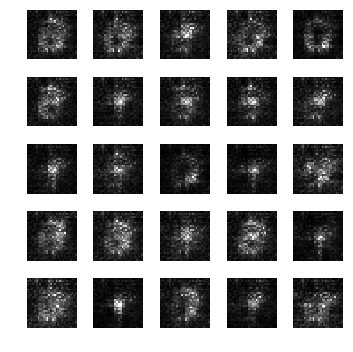

epoch: 91, time: 4.969905 | train_G_Loss: 0.613315, train_D_loss: 2.885787, train_acc: 0.718750
cv_G_Loss: 0.340995, cv_D_loss: 3.169579, cv_acc: 0.670300

epoch: 92, time: 4.946930 | train_G_Loss: 0.554774, train_D_loss: 2.872331, train_acc: 0.662109
cv_G_Loss: 0.168813, cv_D_loss: 3.374908, cv_acc: 0.726400
Model saved

epoch: 93, time: 4.970453 | train_G_Loss: 0.784582, train_D_loss: 2.871805, train_acc: 0.714844
cv_G_Loss: 0.716354, cv_D_loss: 3.037766, cv_acc: 0.681700

epoch: 94, time: 4.931494 | train_G_Loss: 0.631118, train_D_loss: 2.501417, train_acc: 0.728516
cv_G_Loss: 0.376594, cv_D_loss: 2.894696, cv_acc: 0.721100

epoch: 95, time: 4.932009 | train_G_Loss: 0.465283, train_D_loss: 2.661427, train_acc: 0.703125
cv_G_Loss: 0.291831, cv_D_loss: 3.035405, cv_acc: 0.679700

epoch: 96, time: 4.929375 | train_G_Loss: 0.458665, train_D_loss: 2.865832, train_acc: 0.726562
cv_G_Loss: 0.266995, cv_D_loss: 3.099375, cv_acc: 0.717500

epoch: 97, time: 4.935712 | train_G_Loss: 0.512840, 

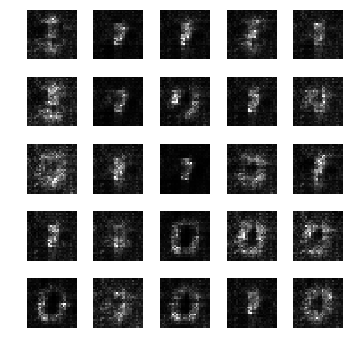

epoch: 101, time: 4.967816 | train_G_Loss: 0.574119, train_D_loss: 2.778648, train_acc: 0.783203
cv_G_Loss: 0.362999, cv_D_loss: 2.914665, cv_acc: 0.786300
Model saved

epoch: 102, time: 4.966905 | train_G_Loss: 0.481530, train_D_loss: 2.718260, train_acc: 0.826172
cv_G_Loss: 0.199268, cv_D_loss: 3.199972, cv_acc: 0.725600

epoch: 103, time: 4.946433 | train_G_Loss: 0.548618, train_D_loss: 2.652803, train_acc: 0.792969
cv_G_Loss: 0.245418, cv_D_loss: 3.035237, cv_acc: 0.783900

epoch: 104, time: 4.970762 | train_G_Loss: 0.407913, train_D_loss: 2.826391, train_acc: 0.794922
cv_G_Loss: 0.518076, cv_D_loss: 2.975608, cv_acc: 0.738100

epoch: 105, time: 4.967702 | train_G_Loss: 0.569526, train_D_loss: 2.620144, train_acc: 0.785156
cv_G_Loss: 0.062785, cv_D_loss: 4.181107, cv_acc: 0.700200

epoch: 106, time: 4.942231 | train_G_Loss: 0.510720, train_D_loss: 2.525321, train_acc: 0.798828
cv_G_Loss: 0.211236, cv_D_loss: 3.214397, cv_acc: 0.692600

epoch: 107, time: 4.949721 | train_G_Loss: 0.4

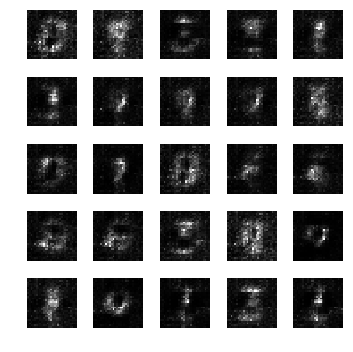

epoch: 111, time: 4.971800 | train_G_Loss: 0.412696, train_D_loss: 2.583506, train_acc: 0.787109
cv_G_Loss: 0.164061, cv_D_loss: 3.302128, cv_acc: 0.733300

epoch: 112, time: 4.942386 | train_G_Loss: 0.440919, train_D_loss: 2.599331, train_acc: 0.796875
cv_G_Loss: 0.207916, cv_D_loss: 3.106674, cv_acc: 0.771400

epoch: 113, time: 4.955804 | train_G_Loss: 0.484855, train_D_loss: 2.843009, train_acc: 0.794922
cv_G_Loss: 0.228716, cv_D_loss: 3.082838, cv_acc: 0.783300

epoch: 114, time: 4.951749 | train_G_Loss: 0.518084, train_D_loss: 2.753330, train_acc: 0.826172
cv_G_Loss: 0.341740, cv_D_loss: 2.848362, cv_acc: 0.809700
Model saved

epoch: 115, time: 4.957561 | train_G_Loss: 0.497229, train_D_loss: 2.507421, train_acc: 0.847656
cv_G_Loss: 0.802531, cv_D_loss: 2.983814, cv_acc: 0.795100

epoch: 116, time: 4.928418 | train_G_Loss: 0.400349, train_D_loss: 2.547582, train_acc: 0.763672
cv_G_Loss: 0.972374, cv_D_loss: 3.028812, cv_acc: 0.793900

epoch: 117, time: 4.931423 | train_G_Loss: 0.3

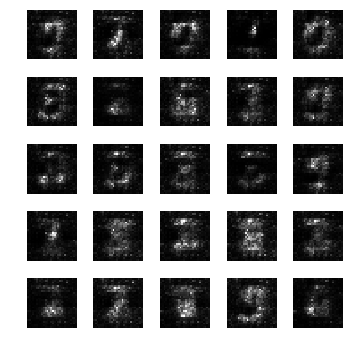

epoch: 121, time: 4.970504 | train_G_Loss: 0.550025, train_D_loss: 2.579279, train_acc: 0.814453
cv_G_Loss: 0.260193, cv_D_loss: 2.872459, cv_acc: 0.813300
Model saved

epoch: 122, time: 4.965597 | train_G_Loss: 0.514849, train_D_loss: 2.532948, train_acc: 0.779297
cv_G_Loss: 0.429133, cv_D_loss: 2.737725, cv_acc: 0.809600

epoch: 123, time: 4.943279 | train_G_Loss: 0.323396, train_D_loss: 2.759314, train_acc: 0.761719
cv_G_Loss: 0.190912, cv_D_loss: 3.058440, cv_acc: 0.796300

epoch: 124, time: 4.938474 | train_G_Loss: 0.387841, train_D_loss: 2.974482, train_acc: 0.789062
cv_G_Loss: 0.646298, cv_D_loss: 2.890132, cv_acc: 0.778900

epoch: 125, time: 4.954013 | train_G_Loss: 0.501851, train_D_loss: 2.807735, train_acc: 0.792969
cv_G_Loss: 0.687417, cv_D_loss: 2.722211, cv_acc: 0.789200

epoch: 126, time: 4.941686 | train_G_Loss: 0.468902, train_D_loss: 2.731496, train_acc: 0.785156
cv_G_Loss: 0.686967, cv_D_loss: 2.588941, cv_acc: 0.805400

epoch: 127, time: 4.980923 | train_G_Loss: 0.5

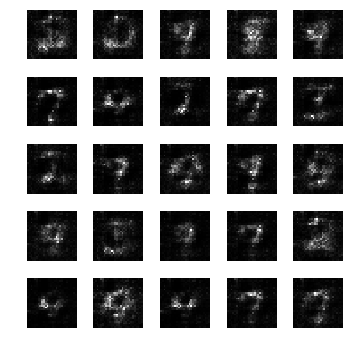

epoch: 131, time: 4.990877 | train_G_Loss: 0.635911, train_D_loss: 2.607445, train_acc: 0.806641
cv_G_Loss: 0.734408, cv_D_loss: 2.732472, cv_acc: 0.813000

epoch: 132, time: 4.950056 | train_G_Loss: 0.496741, train_D_loss: 2.720494, train_acc: 0.750000
cv_G_Loss: 0.484513, cv_D_loss: 2.739496, cv_acc: 0.796500

epoch: 133, time: 4.952160 | train_G_Loss: 0.434129, train_D_loss: 2.835694, train_acc: 0.789062
cv_G_Loss: 0.332942, cv_D_loss: 2.786111, cv_acc: 0.807200

epoch: 134, time: 4.953849 | train_G_Loss: 0.435979, train_D_loss: 2.471846, train_acc: 0.830078
cv_G_Loss: 0.566984, cv_D_loss: 2.819045, cv_acc: 0.784700

epoch: 135, time: 4.945925 | train_G_Loss: 0.419393, train_D_loss: 2.736773, train_acc: 0.798828
cv_G_Loss: 0.580175, cv_D_loss: 2.727374, cv_acc: 0.794600

epoch: 136, time: 4.949457 | train_G_Loss: 0.614466, train_D_loss: 2.791191, train_acc: 0.796875
cv_G_Loss: 1.019643, cv_D_loss: 3.258576, cv_acc: 0.782200

epoch: 137, time: 4.947197 | train_G_Loss: 0.537014, train

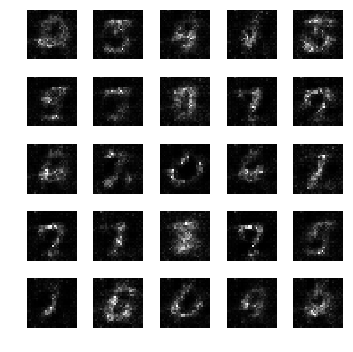

epoch: 141, time: 4.965508 | train_G_Loss: 0.495304, train_D_loss: 2.595222, train_acc: 0.841797
cv_G_Loss: 0.674556, cv_D_loss: 3.139794, cv_acc: 0.753700

epoch: 142, time: 4.950052 | train_G_Loss: 0.463734, train_D_loss: 2.423157, train_acc: 0.812500
cv_G_Loss: 1.986745, cv_D_loss: 4.567613, cv_acc: 0.790200

epoch: 143, time: 4.938818 | train_G_Loss: 0.366334, train_D_loss: 2.701427, train_acc: 0.798828
cv_G_Loss: 0.298823, cv_D_loss: 2.942996, cv_acc: 0.765400

epoch: 144, time: 4.939312 | train_G_Loss: 0.403934, train_D_loss: 2.861906, train_acc: 0.828125
cv_G_Loss: 0.191592, cv_D_loss: 3.280686, cv_acc: 0.710400

epoch: 145, time: 4.957855 | train_G_Loss: 0.455025, train_D_loss: 2.581102, train_acc: 0.847656
cv_G_Loss: 0.266814, cv_D_loss: 3.048454, cv_acc: 0.762500

epoch: 146, time: 4.959158 | train_G_Loss: 0.481149, train_D_loss: 2.574686, train_acc: 0.839844
cv_G_Loss: 0.635492, cv_D_loss: 3.503476, cv_acc: 0.692300

epoch: 147, time: 4.945191 | train_G_Loss: 0.333019, train

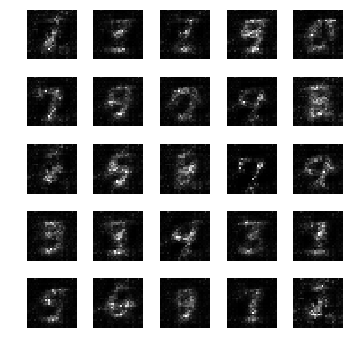

epoch: 151, time: 4.978312 | train_G_Loss: 0.381064, train_D_loss: 3.230536, train_acc: 0.781250
cv_G_Loss: 0.310289, cv_D_loss: 2.799248, cv_acc: 0.805000

epoch: 152, time: 4.976016 | train_G_Loss: 0.449671, train_D_loss: 2.629652, train_acc: 0.833984
cv_G_Loss: 0.207627, cv_D_loss: 3.044755, cv_acc: 0.764000

epoch: 153, time: 4.948569 | train_G_Loss: 0.551814, train_D_loss: 2.672908, train_acc: 0.810547
cv_G_Loss: 1.083249, cv_D_loss: 3.301101, cv_acc: 0.812400

epoch: 154, time: 4.946326 | train_G_Loss: 0.350736, train_D_loss: 3.080268, train_acc: 0.767578
cv_G_Loss: 0.235951, cv_D_loss: 2.947065, cv_acc: 0.790500

epoch: 155, time: 4.944739 | train_G_Loss: 0.465114, train_D_loss: 2.778616, train_acc: 0.794922
cv_G_Loss: 0.388029, cv_D_loss: 2.790658, cv_acc: 0.798400

epoch: 156, time: 4.947179 | train_G_Loss: 0.424198, train_D_loss: 2.504390, train_acc: 0.804688
cv_G_Loss: 0.288511, cv_D_loss: 2.869817, cv_acc: 0.796900

epoch: 157, time: 4.942386 | train_G_Loss: 0.567820, train

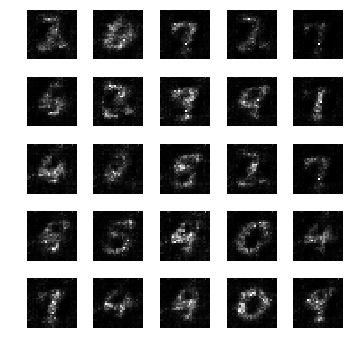

epoch: 161, time: 4.984162 | train_G_Loss: 0.456673, train_D_loss: 2.423853, train_acc: 0.814453
cv_G_Loss: 0.772164, cv_D_loss: 2.899085, cv_acc: 0.799900

epoch: 162, time: 4.949009 | train_G_Loss: 0.422405, train_D_loss: 2.840801, train_acc: 0.791016
cv_G_Loss: 0.174509, cv_D_loss: 3.011094, cv_acc: 0.828300
Model saved

epoch: 163, time: 4.977081 | train_G_Loss: 0.451690, train_D_loss: 2.569281, train_acc: 0.839844
cv_G_Loss: 0.477707, cv_D_loss: 2.804260, cv_acc: 0.807400

epoch: 164, time: 4.936043 | train_G_Loss: 0.407603, train_D_loss: 2.401989, train_acc: 0.843750
cv_G_Loss: 0.180040, cv_D_loss: 3.015770, cv_acc: 0.815900

epoch: 165, time: 4.944856 | train_G_Loss: 0.343314, train_D_loss: 2.726460, train_acc: 0.812500
cv_G_Loss: 0.511460, cv_D_loss: 2.831854, cv_acc: 0.818900

epoch: 166, time: 4.955922 | train_G_Loss: 0.504828, train_D_loss: 2.666380, train_acc: 0.826172
cv_G_Loss: 0.236397, cv_D_loss: 2.972507, cv_acc: 0.800800

epoch: 167, time: 4.942647 | train_G_Loss: 0.3

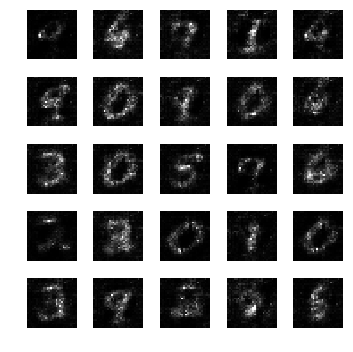

epoch: 171, time: 4.978423 | train_G_Loss: 0.479016, train_D_loss: 2.524367, train_acc: 0.833984
cv_G_Loss: 0.859060, cv_D_loss: 3.033979, cv_acc: 0.816900

epoch: 172, time: 4.998863 | train_G_Loss: 0.462247, train_D_loss: 2.509891, train_acc: 0.847656
cv_G_Loss: 1.612080, cv_D_loss: 4.090066, cv_acc: 0.794000

epoch: 173, time: 4.950518 | train_G_Loss: 0.436999, train_D_loss: 2.378339, train_acc: 0.833984
cv_G_Loss: 1.487302, cv_D_loss: 3.828779, cv_acc: 0.811100

epoch: 174, time: 4.962183 | train_G_Loss: 0.426698, train_D_loss: 2.516737, train_acc: 0.847656
cv_G_Loss: 1.412313, cv_D_loss: 3.803521, cv_acc: 0.812200

epoch: 175, time: 4.962167 | train_G_Loss: 0.463024, train_D_loss: 2.511340, train_acc: 0.832031
cv_G_Loss: 1.528367, cv_D_loss: 3.902228, cv_acc: 0.814600

epoch: 176, time: 4.954203 | train_G_Loss: 0.649007, train_D_loss: 2.399062, train_acc: 0.849609
cv_G_Loss: 1.939075, cv_D_loss: 4.587314, cv_acc: 0.819600

epoch: 177, time: 4.951456 | train_G_Loss: 0.418913, train

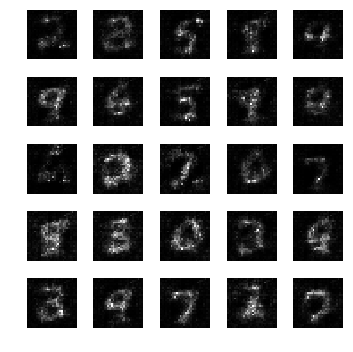

epoch: 181, time: 4.963413 | train_G_Loss: 0.459130, train_D_loss: 2.428828, train_acc: 0.888672
cv_G_Loss: 0.640814, cv_D_loss: 2.663924, cv_acc: 0.828900
Model saved

epoch: 182, time: 4.973284 | train_G_Loss: 0.543394, train_D_loss: 2.359216, train_acc: 0.935547
cv_G_Loss: 0.632300, cv_D_loss: 2.633860, cv_acc: 0.827000

epoch: 183, time: 4.946341 | train_G_Loss: 0.448303, train_D_loss: 2.255044, train_acc: 0.890625
cv_G_Loss: 0.636072, cv_D_loss: 2.680633, cv_acc: 0.833600
Model saved

epoch: 184, time: 4.982277 | train_G_Loss: 0.400689, train_D_loss: 2.495141, train_acc: 0.855469
cv_G_Loss: 0.880105, cv_D_loss: 2.933121, cv_acc: 0.818700

epoch: 185, time: 4.955779 | train_G_Loss: 0.489910, train_D_loss: 2.400378, train_acc: 0.861328
cv_G_Loss: 0.722906, cv_D_loss: 2.759283, cv_acc: 0.826700

epoch: 186, time: 4.946984 | train_G_Loss: 0.509080, train_D_loss: 2.061640, train_acc: 0.832031
cv_G_Loss: 0.668890, cv_D_loss: 2.700120, cv_acc: 0.809600

epoch: 187, time: 4.947358 | train

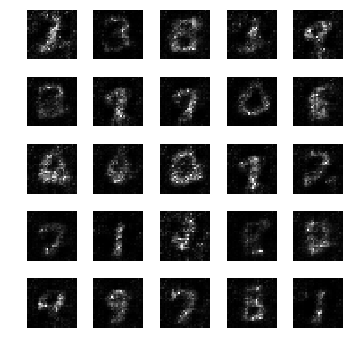

epoch: 191, time: 4.984500 | train_G_Loss: 0.397102, train_D_loss: 2.450570, train_acc: 0.875000
cv_G_Loss: 0.199770, cv_D_loss: 3.234846, cv_acc: 0.700000

epoch: 192, time: 4.941213 | train_G_Loss: 0.389437, train_D_loss: 2.554146, train_acc: 0.828125
cv_G_Loss: 0.117780, cv_D_loss: 3.280900, cv_acc: 0.818100

epoch: 193, time: 4.950338 | train_G_Loss: 0.507770, train_D_loss: 2.790403, train_acc: 0.791016
cv_G_Loss: 0.413369, cv_D_loss: 2.673113, cv_acc: 0.792100

epoch: 194, time: 4.987743 | train_G_Loss: 0.429306, train_D_loss: 2.925734, train_acc: 0.796875
cv_G_Loss: 0.606318, cv_D_loss: 2.664020, cv_acc: 0.834000
Model saved

epoch: 195, time: 4.964034 | train_G_Loss: 0.370407, train_D_loss: 2.765039, train_acc: 0.789062
cv_G_Loss: 0.370752, cv_D_loss: 2.630010, cv_acc: 0.824700

epoch: 196, time: 4.943361 | train_G_Loss: 0.414025, train_D_loss: 2.683671, train_acc: 0.804688
cv_G_Loss: 0.522028, cv_D_loss: 2.687172, cv_acc: 0.829100

epoch: 197, time: 4.955013 | train_G_Loss: 0.4

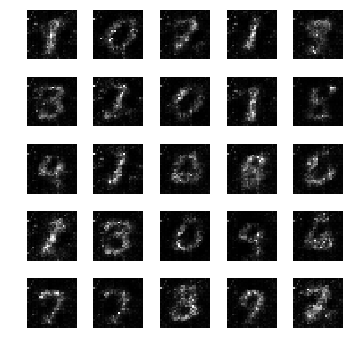

epoch: 201, time: 4.970555 | train_G_Loss: 0.454528, train_D_loss: 2.561763, train_acc: 0.814453
cv_G_Loss: 0.938637, cv_D_loss: 3.031463, cv_acc: 0.819800

epoch: 202, time: 4.952945 | train_G_Loss: 0.440009, train_D_loss: 2.711398, train_acc: 0.847656
cv_G_Loss: 1.096835, cv_D_loss: 3.869802, cv_acc: 0.764800

epoch: 203, time: 4.947756 | train_G_Loss: 0.471598, train_D_loss: 2.282964, train_acc: 0.847656
cv_G_Loss: 0.450799, cv_D_loss: 2.595244, cv_acc: 0.830700

epoch: 204, time: 4.944812 | train_G_Loss: 0.359778, train_D_loss: 2.729478, train_acc: 0.873047
cv_G_Loss: 0.136745, cv_D_loss: 3.206050, cv_acc: 0.786900

epoch: 205, time: 4.958161 | train_G_Loss: 0.526651, train_D_loss: 2.457745, train_acc: 0.861328
cv_G_Loss: 1.202727, cv_D_loss: 3.367172, cv_acc: 0.816700

epoch: 206, time: 4.958328 | train_G_Loss: 0.499757, train_D_loss: 2.571006, train_acc: 0.853516
cv_G_Loss: 1.115325, cv_D_loss: 3.371251, cv_acc: 0.832700

epoch: 207, time: 4.951300 | train_G_Loss: 0.423300, train

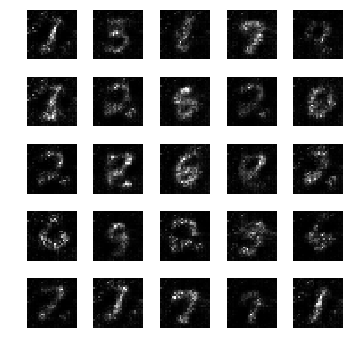

epoch: 211, time: 4.988850 | train_G_Loss: 0.321855, train_D_loss: 2.725175, train_acc: 0.804688
cv_G_Loss: 0.473862, cv_D_loss: 2.661245, cv_acc: 0.833900

epoch: 212, time: 4.949825 | train_G_Loss: 0.437944, train_D_loss: 2.742455, train_acc: 0.810547
cv_G_Loss: 1.754679, cv_D_loss: 4.214153, cv_acc: 0.829500

epoch: 213, time: 4.955320 | train_G_Loss: 0.380236, train_D_loss: 2.489521, train_acc: 0.783203
cv_G_Loss: 1.656225, cv_D_loss: 4.154486, cv_acc: 0.811100

epoch: 214, time: 4.956641 | train_G_Loss: 0.294081, train_D_loss: 2.747991, train_acc: 0.843750
cv_G_Loss: 0.941069, cv_D_loss: 3.179486, cv_acc: 0.830200

epoch: 215, time: 4.966564 | train_G_Loss: 0.510068, train_D_loss: 2.427801, train_acc: 0.847656
cv_G_Loss: 0.569250, cv_D_loss: 2.720654, cv_acc: 0.811600

epoch: 216, time: 4.963909 | train_G_Loss: 0.467063, train_D_loss: 2.668565, train_acc: 0.794922
cv_G_Loss: 0.220602, cv_D_loss: 3.147303, cv_acc: 0.698400

epoch: 217, time: 4.978785 | train_G_Loss: 0.434676, train

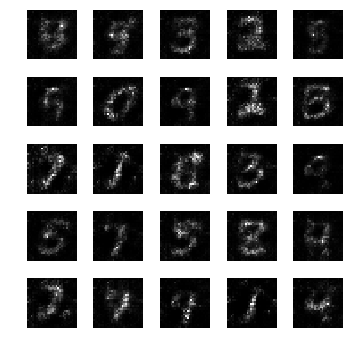

epoch: 221, time: 4.980875 | train_G_Loss: 0.519937, train_D_loss: 2.517559, train_acc: 0.861328
cv_G_Loss: 0.445713, cv_D_loss: 2.577735, cv_acc: 0.833900

epoch: 222, time: 4.955391 | train_G_Loss: 0.389641, train_D_loss: 2.515311, train_acc: 0.796875
cv_G_Loss: 0.848718, cv_D_loss: 2.871176, cv_acc: 0.836200
Model saved

epoch: 223, time: 4.956796 | train_G_Loss: 0.345768, train_D_loss: 2.783213, train_acc: 0.800781
cv_G_Loss: 0.872560, cv_D_loss: 2.960324, cv_acc: 0.833900

epoch: 224, time: 4.944960 | train_G_Loss: 0.418857, train_D_loss: 2.427055, train_acc: 0.859375
cv_G_Loss: 0.955025, cv_D_loss: 3.019337, cv_acc: 0.832800

epoch: 225, time: 4.951227 | train_G_Loss: 0.500003, train_D_loss: 2.366994, train_acc: 0.849609
cv_G_Loss: 0.879992, cv_D_loss: 2.841067, cv_acc: 0.839300
Model saved

epoch: 226, time: 4.974108 | train_G_Loss: 0.431886, train_D_loss: 2.580708, train_acc: 0.818359
cv_G_Loss: 0.457846, cv_D_loss: 2.568459, cv_acc: 0.844200
Model saved

epoch: 227, time: 4.96

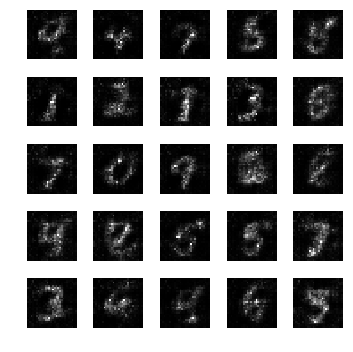

epoch: 231, time: 4.964804 | train_G_Loss: 0.494117, train_D_loss: 2.404036, train_acc: 0.871094
cv_G_Loss: 0.235894, cv_D_loss: 2.969931, cv_acc: 0.781600

epoch: 232, time: 4.944420 | train_G_Loss: 0.442524, train_D_loss: 2.684966, train_acc: 0.890625
cv_G_Loss: 0.340567, cv_D_loss: 2.804837, cv_acc: 0.784800

epoch: 233, time: 4.951431 | train_G_Loss: 0.407682, train_D_loss: 2.274478, train_acc: 0.867188
cv_G_Loss: 0.708160, cv_D_loss: 2.804329, cv_acc: 0.835200

epoch: 234, time: 4.957053 | train_G_Loss: 0.355084, train_D_loss: 2.685697, train_acc: 0.832031
cv_G_Loss: 2.057082, cv_D_loss: 5.163420, cv_acc: 0.820700

epoch: 235, time: 4.958320 | train_G_Loss: 0.490850, train_D_loss: 2.452102, train_acc: 0.859375
cv_G_Loss: 0.588833, cv_D_loss: 2.613881, cv_acc: 0.843300

epoch: 236, time: 4.950107 | train_G_Loss: 0.453260, train_D_loss: 2.411397, train_acc: 0.867188
cv_G_Loss: 1.078217, cv_D_loss: 3.409821, cv_acc: 0.831500

epoch: 237, time: 4.958871 | train_G_Loss: 0.420378, train

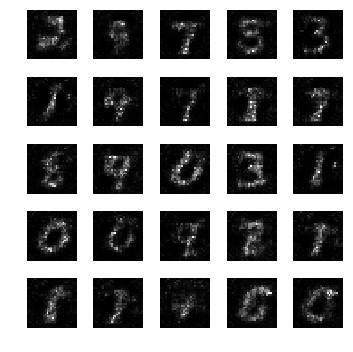

epoch: 241, time: 4.993270 | train_G_Loss: 0.338573, train_D_loss: 2.474557, train_acc: 0.849609
cv_G_Loss: 1.686442, cv_D_loss: 4.353888, cv_acc: 0.806000

epoch: 242, time: 4.953471 | train_G_Loss: 0.396714, train_D_loss: 2.720969, train_acc: 0.875000
cv_G_Loss: 0.692010, cv_D_loss: 2.754548, cv_acc: 0.836200

epoch: 243, time: 4.952519 | train_G_Loss: 0.450208, train_D_loss: 2.576864, train_acc: 0.869141
cv_G_Loss: 0.155540, cv_D_loss: 3.027498, cv_acc: 0.833400

epoch: 244, time: 4.946994 | train_G_Loss: 0.512759, train_D_loss: 2.532593, train_acc: 0.828125
cv_G_Loss: 1.745691, cv_D_loss: 4.400894, cv_acc: 0.826200

epoch: 245, time: 4.951028 | train_G_Loss: 0.450068, train_D_loss: 2.480216, train_acc: 0.808594
cv_G_Loss: 1.174121, cv_D_loss: 3.367985, cv_acc: 0.828000

epoch: 246, time: 4.955251 | train_G_Loss: 0.371657, train_D_loss: 2.802643, train_acc: 0.828125
cv_G_Loss: 0.190978, cv_D_loss: 2.855270, cv_acc: 0.846100
Model saved

epoch: 247, time: 4.972654 | train_G_Loss: 0.3

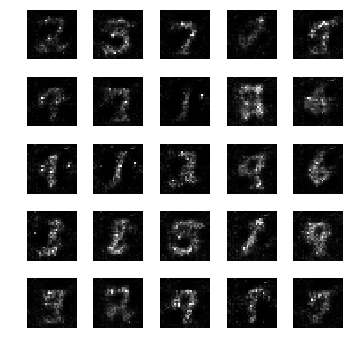

epoch: 251, time: 4.968287 | train_G_Loss: 0.376115, train_D_loss: 2.541032, train_acc: 0.833984
cv_G_Loss: 0.432257, cv_D_loss: 2.746217, cv_acc: 0.819200

epoch: 252, time: 4.956784 | train_G_Loss: 0.525774, train_D_loss: 2.612101, train_acc: 0.828125
cv_G_Loss: 1.942567, cv_D_loss: 4.734843, cv_acc: 0.837800

epoch: 253, time: 4.945699 | train_G_Loss: 0.575712, train_D_loss: 2.709003, train_acc: 0.824219
cv_G_Loss: 0.965635, cv_D_loss: 2.987818, cv_acc: 0.839200

epoch: 254, time: 4.964326 | train_G_Loss: 0.416328, train_D_loss: 2.731064, train_acc: 0.837891
cv_G_Loss: 0.401902, cv_D_loss: 2.535785, cv_acc: 0.851600
Model saved

epoch: 255, time: 4.970096 | train_G_Loss: 0.344573, train_D_loss: 2.635411, train_acc: 0.878906
cv_G_Loss: 0.273001, cv_D_loss: 2.622269, cv_acc: 0.851000

epoch: 256, time: 4.951269 | train_G_Loss: 0.353966, train_D_loss: 2.544500, train_acc: 0.863281
cv_G_Loss: 0.575877, cv_D_loss: 2.689419, cv_acc: 0.839600

epoch: 257, time: 4.957443 | train_G_Loss: 0.3

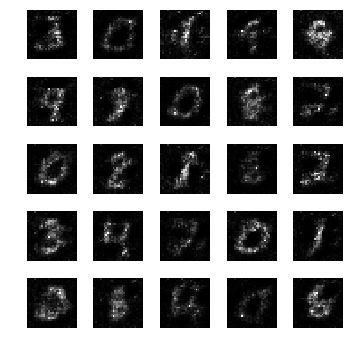

epoch: 261, time: 4.990623 | train_G_Loss: 0.444433, train_D_loss: 2.645475, train_acc: 0.839844
cv_G_Loss: 0.922054, cv_D_loss: 3.032212, cv_acc: 0.846300

epoch: 262, time: 4.940261 | train_G_Loss: 0.363398, train_D_loss: 2.612909, train_acc: 0.861328
cv_G_Loss: 0.269874, cv_D_loss: 2.707956, cv_acc: 0.849300

epoch: 263, time: 4.943301 | train_G_Loss: 0.402946, train_D_loss: 2.650946, train_acc: 0.873047
cv_G_Loss: 0.677175, cv_D_loss: 2.772113, cv_acc: 0.837400

epoch: 264, time: 4.942157 | train_G_Loss: 0.404368, train_D_loss: 2.459701, train_acc: 0.867188
cv_G_Loss: 0.252557, cv_D_loss: 2.749858, cv_acc: 0.836100

epoch: 265, time: 4.938862 | train_G_Loss: 0.387813, train_D_loss: 2.523013, train_acc: 0.857422
cv_G_Loss: 0.680518, cv_D_loss: 2.738305, cv_acc: 0.842300

epoch: 266, time: 4.946209 | train_G_Loss: 0.398900, train_D_loss: 2.567127, train_acc: 0.857422
cv_G_Loss: 0.324952, cv_D_loss: 2.604980, cv_acc: 0.855400
Model saved

epoch: 267, time: 4.983858 | train_G_Loss: 0.3

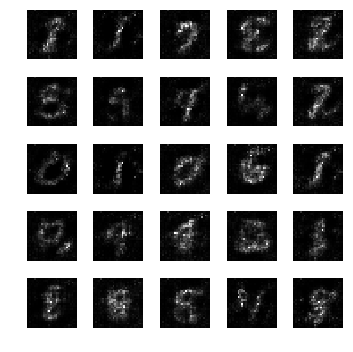

epoch: 271, time: 4.990521 | train_G_Loss: 0.378760, train_D_loss: 2.687471, train_acc: 0.810547
cv_G_Loss: 0.219599, cv_D_loss: 2.886437, cv_acc: 0.831700

epoch: 272, time: 4.935212 | train_G_Loss: 0.351890, train_D_loss: 2.637691, train_acc: 0.822266
cv_G_Loss: 0.250699, cv_D_loss: 2.781160, cv_acc: 0.833100

epoch: 273, time: 4.945831 | train_G_Loss: 0.383097, train_D_loss: 2.780701, train_acc: 0.818359
cv_G_Loss: 0.731236, cv_D_loss: 2.879273, cv_acc: 0.853400

epoch: 274, time: 4.942237 | train_G_Loss: 0.431857, train_D_loss: 2.590502, train_acc: 0.824219
cv_G_Loss: 0.604531, cv_D_loss: 2.809630, cv_acc: 0.848400

epoch: 275, time: 5.042002 | train_G_Loss: 0.347073, train_D_loss: 2.778913, train_acc: 0.798828
cv_G_Loss: 0.659699, cv_D_loss: 2.789155, cv_acc: 0.844800

epoch: 276, time: 4.950126 | train_G_Loss: 0.428234, train_D_loss: 2.549080, train_acc: 0.835938
cv_G_Loss: 0.718889, cv_D_loss: 2.870428, cv_acc: 0.839400

epoch: 277, time: 4.949058 | train_G_Loss: 0.422334, train

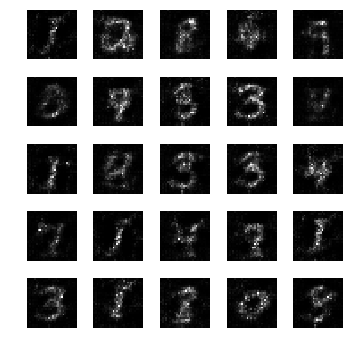

epoch: 281, time: 4.966366 | train_G_Loss: 0.444075, train_D_loss: 2.541681, train_acc: 0.839844
cv_G_Loss: 0.956364, cv_D_loss: 3.117008, cv_acc: 0.854100

epoch: 282, time: 4.939611 | train_G_Loss: 0.434841, train_D_loss: 2.463343, train_acc: 0.876953
cv_G_Loss: 0.882896, cv_D_loss: 3.026864, cv_acc: 0.850200

epoch: 283, time: 4.933545 | train_G_Loss: 0.301061, train_D_loss: 2.669507, train_acc: 0.916016
cv_G_Loss: 0.159788, cv_D_loss: 2.984760, cv_acc: 0.845100

epoch: 284, time: 4.974488 | train_G_Loss: 0.450393, train_D_loss: 2.261704, train_acc: 0.902344
cv_G_Loss: 0.731124, cv_D_loss: 2.932545, cv_acc: 0.847000

epoch: 285, time: 4.942897 | train_G_Loss: 0.416816, train_D_loss: 2.413671, train_acc: 0.861328
cv_G_Loss: 0.470894, cv_D_loss: 2.645695, cv_acc: 0.858500
Model saved

epoch: 286, time: 4.986752 | train_G_Loss: 0.395649, train_D_loss: 2.619706, train_acc: 0.814453
cv_G_Loss: 0.245680, cv_D_loss: 2.792703, cv_acc: 0.839400

epoch: 287, time: 4.955357 | train_G_Loss: 0.3

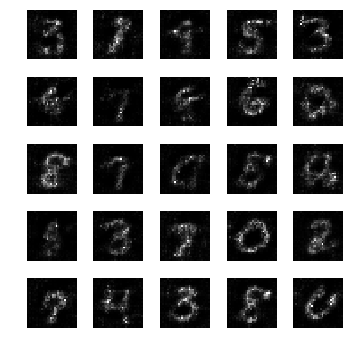

epoch: 291, time: 4.981858 | train_G_Loss: 0.342409, train_D_loss: 2.663342, train_acc: 0.845703
cv_G_Loss: 0.198411, cv_D_loss: 2.999946, cv_acc: 0.802500

epoch: 292, time: 4.949445 | train_G_Loss: 0.387509, train_D_loss: 2.487706, train_acc: 0.886719
cv_G_Loss: 0.503969, cv_D_loss: 2.838567, cv_acc: 0.833600

epoch: 293, time: 4.954061 | train_G_Loss: 0.356737, train_D_loss: 2.512836, train_acc: 0.894531
cv_G_Loss: 0.315558, cv_D_loss: 2.638045, cv_acc: 0.860300
Model saved

epoch: 294, time: 4.960309 | train_G_Loss: 0.371590, train_D_loss: 2.603990, train_acc: 0.855469
cv_G_Loss: 0.647557, cv_D_loss: 2.719568, cv_acc: 0.858600

epoch: 295, time: 4.946198 | train_G_Loss: 0.360519, train_D_loss: 2.580750, train_acc: 0.796875
cv_G_Loss: 0.523120, cv_D_loss: 2.662623, cv_acc: 0.858700

epoch: 296, time: 4.940433 | train_G_Loss: 0.363501, train_D_loss: 2.935559, train_acc: 0.820312
cv_G_Loss: 0.116698, cv_D_loss: 3.136661, cv_acc: 0.858300

epoch: 297, time: 4.937045 | train_G_Loss: 0.4

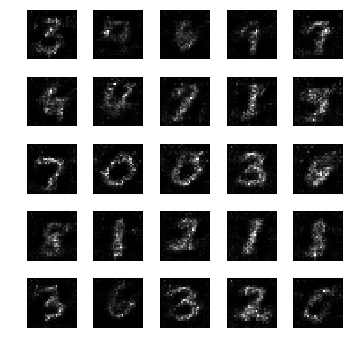

epoch: 301, time: 4.975158 | train_G_Loss: 0.406216, train_D_loss: 2.484905, train_acc: 0.871094
cv_G_Loss: 0.740931, cv_D_loss: 2.870059, cv_acc: 0.853100

epoch: 302, time: 4.941088 | train_G_Loss: 0.400969, train_D_loss: 2.455585, train_acc: 0.845703
cv_G_Loss: 0.541674, cv_D_loss: 2.759955, cv_acc: 0.843600

epoch: 303, time: 4.942291 | train_G_Loss: 0.344455, train_D_loss: 2.702995, train_acc: 0.845703
cv_G_Loss: 0.180934, cv_D_loss: 2.898578, cv_acc: 0.847500

epoch: 304, time: 4.962712 | train_G_Loss: 0.364983, train_D_loss: 2.801527, train_acc: 0.826172
cv_G_Loss: 0.374956, cv_D_loss: 2.709325, cv_acc: 0.844400

epoch: 305, time: 4.945008 | train_G_Loss: 0.583423, train_D_loss: 2.727893, train_acc: 0.876953
cv_G_Loss: 0.383377, cv_D_loss: 2.734550, cv_acc: 0.851900

epoch: 306, time: 4.991608 | train_G_Loss: 0.362697, train_D_loss: 2.618320, train_acc: 0.882812
cv_G_Loss: 0.386850, cv_D_loss: 2.590851, cv_acc: 0.862800
Model saved

epoch: 307, time: 4.988527 | train_G_Loss: 0.3

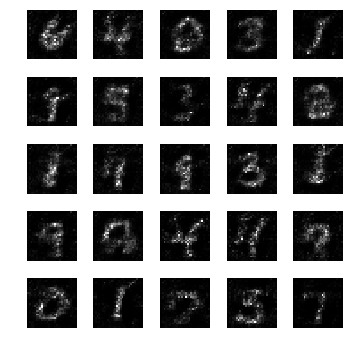

epoch: 311, time: 4.969144 | train_G_Loss: 0.483143, train_D_loss: 2.412578, train_acc: 0.851562
cv_G_Loss: 1.380800, cv_D_loss: 3.814798, cv_acc: 0.860600

epoch: 312, time: 4.944506 | train_G_Loss: 0.532026, train_D_loss: 2.829598, train_acc: 0.828125
cv_G_Loss: 0.800626, cv_D_loss: 3.030209, cv_acc: 0.858200

epoch: 313, time: 4.947284 | train_G_Loss: 0.458956, train_D_loss: 2.835444, train_acc: 0.859375
cv_G_Loss: 0.823091, cv_D_loss: 3.072098, cv_acc: 0.834300

epoch: 314, time: 4.939915 | train_G_Loss: 0.380077, train_D_loss: 2.411127, train_acc: 0.824219
cv_G_Loss: 0.188045, cv_D_loss: 2.871128, cv_acc: 0.859500

epoch: 315, time: 4.939596 | train_G_Loss: 0.408358, train_D_loss: 2.869228, train_acc: 0.857422
cv_G_Loss: 0.682218, cv_D_loss: 2.997982, cv_acc: 0.830500

epoch: 316, time: 4.953186 | train_G_Loss: 0.435811, train_D_loss: 2.329637, train_acc: 0.884766
cv_G_Loss: 1.168338, cv_D_loss: 3.506106, cv_acc: 0.859700

epoch: 317, time: 4.934551 | train_G_Loss: 0.409048, train

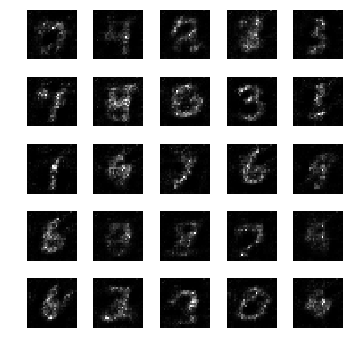

epoch: 321, time: 4.970438 | train_G_Loss: 0.362586, train_D_loss: 2.662511, train_acc: 0.859375
cv_G_Loss: 0.394653, cv_D_loss: 2.811566, cv_acc: 0.832100

epoch: 322, time: 4.931307 | train_G_Loss: 0.509936, train_D_loss: 2.805739, train_acc: 0.863281
cv_G_Loss: 0.808205, cv_D_loss: 2.966299, cv_acc: 0.866500

epoch: 323, time: 4.933599 | train_G_Loss: 0.403393, train_D_loss: 2.672466, train_acc: 0.833984
cv_G_Loss: 0.578145, cv_D_loss: 2.915715, cv_acc: 0.826700

epoch: 324, time: 4.928800 | train_G_Loss: 0.299704, train_D_loss: 2.521341, train_acc: 0.849609
cv_G_Loss: 0.455626, cv_D_loss: 2.617584, cv_acc: 0.855300

epoch: 325, time: 4.929095 | train_G_Loss: 0.351374, train_D_loss: 2.704966, train_acc: 0.849609
cv_G_Loss: 0.544320, cv_D_loss: 2.914588, cv_acc: 0.842200

epoch: 326, time: 4.944635 | train_G_Loss: 0.356690, train_D_loss: 2.717234, train_acc: 0.871094
cv_G_Loss: 0.554810, cv_D_loss: 2.761551, cv_acc: 0.849200

epoch: 327, time: 4.927671 | train_G_Loss: 0.379359, train

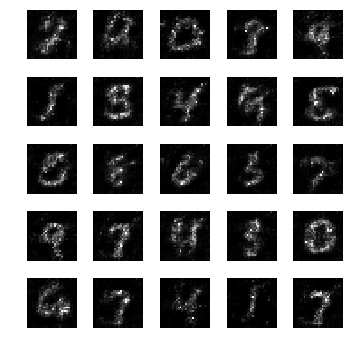

epoch: 331, time: 4.967816 | train_G_Loss: 0.319972, train_D_loss: 2.450471, train_acc: 0.896484
cv_G_Loss: 0.399442, cv_D_loss: 2.543746, cv_acc: 0.872900
Model saved

epoch: 332, time: 4.965861 | train_G_Loss: 0.441144, train_D_loss: 2.569224, train_acc: 0.886719
cv_G_Loss: 0.652840, cv_D_loss: 3.007036, cv_acc: 0.817300

epoch: 333, time: 4.940501 | train_G_Loss: 0.440715, train_D_loss: 2.762911, train_acc: 0.890625
cv_G_Loss: 0.732019, cv_D_loss: 2.754829, cv_acc: 0.871700

epoch: 334, time: 4.948557 | train_G_Loss: 0.352020, train_D_loss: 2.534718, train_acc: 0.863281
cv_G_Loss: 0.261525, cv_D_loss: 2.638944, cv_acc: 0.859900

epoch: 335, time: 4.937738 | train_G_Loss: 0.277446, train_D_loss: 2.869750, train_acc: 0.843750
cv_G_Loss: 0.194236, cv_D_loss: 2.860592, cv_acc: 0.862700

epoch: 336, time: 4.937288 | train_G_Loss: 0.288039, train_D_loss: 2.537809, train_acc: 0.839844
cv_G_Loss: 0.385771, cv_D_loss: 2.647492, cv_acc: 0.864700

epoch: 337, time: 4.947429 | train_G_Loss: 0.3

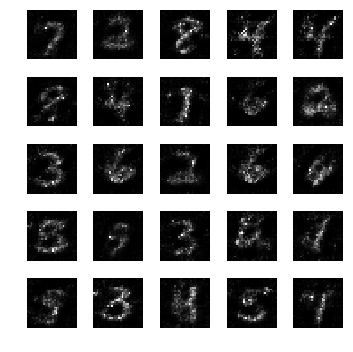

epoch: 341, time: 4.973512 | train_G_Loss: 0.329585, train_D_loss: 2.574376, train_acc: 0.865234
cv_G_Loss: 0.219359, cv_D_loss: 2.762667, cv_acc: 0.861600

epoch: 342, time: 4.931675 | train_G_Loss: 0.368678, train_D_loss: 2.471943, train_acc: 0.863281
cv_G_Loss: 0.286325, cv_D_loss: 2.611360, cv_acc: 0.870800

epoch: 343, time: 4.951295 | train_G_Loss: 0.560374, train_D_loss: 2.624953, train_acc: 0.902344
cv_G_Loss: 1.928020, cv_D_loss: 4.805146, cv_acc: 0.848500

epoch: 344, time: 4.939041 | train_G_Loss: 0.461904, train_D_loss: 2.429014, train_acc: 0.880859
cv_G_Loss: 0.818088, cv_D_loss: 2.938506, cv_acc: 0.858500

epoch: 345, time: 4.951506 | train_G_Loss: 0.275820, train_D_loss: 2.515478, train_acc: 0.845703
cv_G_Loss: 0.344393, cv_D_loss: 2.741685, cv_acc: 0.833400

epoch: 346, time: 4.951064 | train_G_Loss: 0.361905, train_D_loss: 2.645272, train_acc: 0.880859
cv_G_Loss: 0.300057, cv_D_loss: 2.638411, cv_acc: 0.867500

epoch: 347, time: 4.947860 | train_G_Loss: 0.304385, train

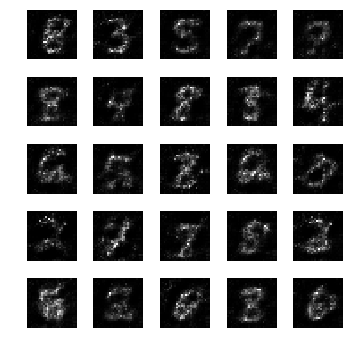

epoch: 351, time: 4.994381 | train_G_Loss: 0.417680, train_D_loss: 2.495814, train_acc: 0.871094
cv_G_Loss: 1.269004, cv_D_loss: 3.601464, cv_acc: 0.863600

epoch: 352, time: 4.960624 | train_G_Loss: 0.417123, train_D_loss: 2.764468, train_acc: 0.878906
cv_G_Loss: 1.152774, cv_D_loss: 3.540827, cv_acc: 0.841100

epoch: 353, time: 4.964326 | train_G_Loss: 0.547414, train_D_loss: 2.487857, train_acc: 0.896484
cv_G_Loss: 0.555416, cv_D_loss: 2.744904, cv_acc: 0.857900

epoch: 354, time: 4.957680 | train_G_Loss: 0.391069, train_D_loss: 2.526515, train_acc: 0.859375
cv_G_Loss: 0.988699, cv_D_loss: 3.100294, cv_acc: 0.865400

epoch: 355, time: 4.961517 | train_G_Loss: 0.472636, train_D_loss: 2.933004, train_acc: 0.873047
cv_G_Loss: 0.293774, cv_D_loss: 2.680867, cv_acc: 0.865900

epoch: 356, time: 4.945522 | train_G_Loss: 0.367864, train_D_loss: 2.613420, train_acc: 0.894531
cv_G_Loss: 0.230881, cv_D_loss: 2.691499, cv_acc: 0.865300

epoch: 357, time: 4.954933 | train_G_Loss: 0.335504, train

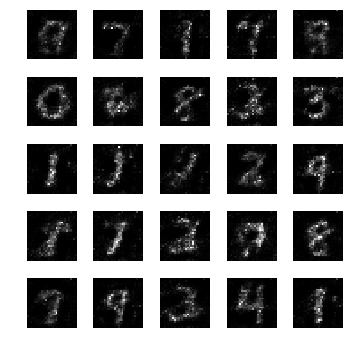

epoch: 361, time: 4.969695 | train_G_Loss: 0.444946, train_D_loss: 2.627689, train_acc: 0.888672
cv_G_Loss: 1.074016, cv_D_loss: 3.361048, cv_acc: 0.832300

epoch: 362, time: 4.931615 | train_G_Loss: 0.451945, train_D_loss: 2.328228, train_acc: 0.878906
cv_G_Loss: 0.657347, cv_D_loss: 2.734934, cv_acc: 0.869300

epoch: 363, time: 4.937804 | train_G_Loss: 0.365562, train_D_loss: 2.689816, train_acc: 0.861328
cv_G_Loss: 0.272500, cv_D_loss: 2.638769, cv_acc: 0.871400

epoch: 364, time: 4.941186 | train_G_Loss: 0.513546, train_D_loss: 2.559401, train_acc: 0.888672
cv_G_Loss: 0.461512, cv_D_loss: 2.696750, cv_acc: 0.860500

epoch: 365, time: 4.943455 | train_G_Loss: 0.387487, train_D_loss: 2.432253, train_acc: 0.917969
cv_G_Loss: 0.686015, cv_D_loss: 2.777376, cv_acc: 0.867400

epoch: 366, time: 4.936960 | train_G_Loss: 0.530687, train_D_loss: 2.377912, train_acc: 0.939453
cv_G_Loss: 0.430423, cv_D_loss: 2.619316, cv_acc: 0.865000

epoch: 367, time: 4.923279 | train_G_Loss: 0.434813, train

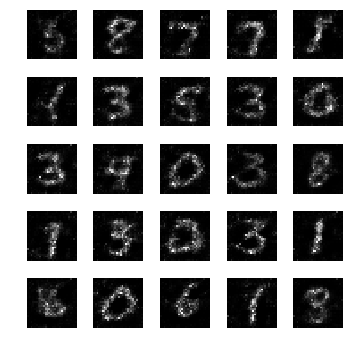

epoch: 371, time: 4.966024 | train_G_Loss: 0.433324, train_D_loss: 2.344938, train_acc: 0.914062
cv_G_Loss: 0.433022, cv_D_loss: 2.573640, cv_acc: 0.868400

epoch: 372, time: 4.934679 | train_G_Loss: 0.407042, train_D_loss: 2.617794, train_acc: 0.876953
cv_G_Loss: 0.443341, cv_D_loss: 2.594293, cv_acc: 0.865300

epoch: 373, time: 4.969482 | train_G_Loss: 0.346634, train_D_loss: 2.402017, train_acc: 0.898438
cv_G_Loss: 0.445134, cv_D_loss: 2.565457, cv_acc: 0.877200
Model saved

epoch: 374, time: 4.964737 | train_G_Loss: 0.356847, train_D_loss: 2.418498, train_acc: 0.894531
cv_G_Loss: 0.641322, cv_D_loss: 2.782711, cv_acc: 0.868900

epoch: 375, time: 4.948506 | train_G_Loss: 0.320817, train_D_loss: 2.498049, train_acc: 0.886719
cv_G_Loss: 0.435019, cv_D_loss: 2.557873, cv_acc: 0.872100

epoch: 376, time: 4.956572 | train_G_Loss: 0.424585, train_D_loss: 2.474803, train_acc: 0.871094
cv_G_Loss: 0.663139, cv_D_loss: 2.724872, cv_acc: 0.868700

epoch: 377, time: 4.960053 | train_G_Loss: 0.4

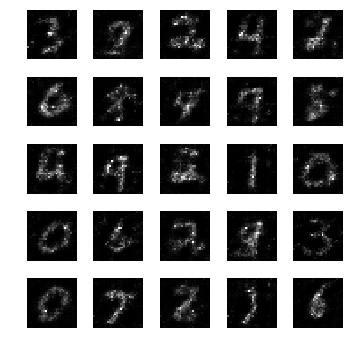

epoch: 381, time: 4.970553 | train_G_Loss: 0.438128, train_D_loss: 2.382548, train_acc: 0.863281
cv_G_Loss: 1.102842, cv_D_loss: 3.355880, cv_acc: 0.854300

epoch: 382, time: 4.949134 | train_G_Loss: 0.431613, train_D_loss: 2.578113, train_acc: 0.861328
cv_G_Loss: 0.782129, cv_D_loss: 2.934989, cv_acc: 0.856600

epoch: 383, time: 4.939620 | train_G_Loss: 0.526550, train_D_loss: 2.614105, train_acc: 0.873047
cv_G_Loss: 0.489086, cv_D_loss: 2.562701, cv_acc: 0.876100

epoch: 384, time: 4.944978 | train_G_Loss: 0.515987, train_D_loss: 2.828886, train_acc: 0.851562
cv_G_Loss: 1.511182, cv_D_loss: 3.974967, cv_acc: 0.870600

epoch: 385, time: 4.952624 | train_G_Loss: 0.368200, train_D_loss: 2.704720, train_acc: 0.869141
cv_G_Loss: 0.499500, cv_D_loss: 2.635419, cv_acc: 0.837200

epoch: 386, time: 4.944298 | train_G_Loss: 0.390879, train_D_loss: 2.365342, train_acc: 0.880859
cv_G_Loss: 0.585105, cv_D_loss: 2.761751, cv_acc: 0.867000

epoch: 387, time: 4.936238 | train_G_Loss: 0.409512, train

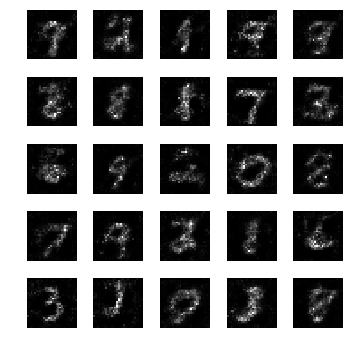

epoch: 391, time: 4.976405 | train_G_Loss: 0.449781, train_D_loss: 2.240642, train_acc: 0.904297
cv_G_Loss: 1.821511, cv_D_loss: 4.583364, cv_acc: 0.868800

epoch: 392, time: 4.942554 | train_G_Loss: 0.327405, train_D_loss: 2.466277, train_acc: 0.916016
cv_G_Loss: 0.229956, cv_D_loss: 2.740111, cv_acc: 0.856500

epoch: 393, time: 4.942689 | train_G_Loss: 0.374410, train_D_loss: 2.457237, train_acc: 0.880859
cv_G_Loss: 1.103288, cv_D_loss: 3.454586, cv_acc: 0.851700

epoch: 394, time: 4.938385 | train_G_Loss: 0.502057, train_D_loss: 2.432768, train_acc: 0.843750
cv_G_Loss: 0.952659, cv_D_loss: 3.061497, cv_acc: 0.878100
Model saved

epoch: 395, time: 5.005875 | train_G_Loss: 0.337941, train_D_loss: 2.856211, train_acc: 0.857422
cv_G_Loss: 0.208328, cv_D_loss: 2.746725, cv_acc: 0.862700

epoch: 396, time: 4.953954 | train_G_Loss: 0.347284, train_D_loss: 2.375548, train_acc: 0.871094
cv_G_Loss: 0.530389, cv_D_loss: 2.700445, cv_acc: 0.848300

epoch: 397, time: 4.947130 | train_G_Loss: 0.2

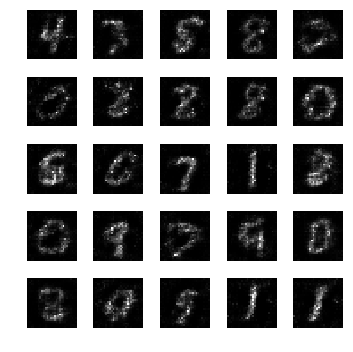

epoch: 401, time: 4.978697 | train_G_Loss: 0.452827, train_D_loss: 2.452949, train_acc: 0.861328
cv_G_Loss: 0.395462, cv_D_loss: 2.674158, cv_acc: 0.841600

epoch: 402, time: 4.956092 | train_G_Loss: 0.289718, train_D_loss: 2.452943, train_acc: 0.851562
cv_G_Loss: 0.210669, cv_D_loss: 2.686028, cv_acc: 0.876300

epoch: 403, time: 4.942781 | train_G_Loss: 0.429253, train_D_loss: 2.653698, train_acc: 0.845703
cv_G_Loss: 1.019612, cv_D_loss: 3.259389, cv_acc: 0.858900

epoch: 404, time: 4.951217 | train_G_Loss: 0.447160, train_D_loss: 2.761397, train_acc: 0.814453
cv_G_Loss: 1.218424, cv_D_loss: 3.327383, cv_acc: 0.873000

epoch: 405, time: 4.954678 | train_G_Loss: 0.307660, train_D_loss: 2.916266, train_acc: 0.839844
cv_G_Loss: 2.716693, cv_D_loss: 6.301621, cv_acc: 0.849100

epoch: 406, time: 4.951214 | train_G_Loss: 0.518699, train_D_loss: 2.456502, train_acc: 0.875000
cv_G_Loss: 0.277286, cv_D_loss: 2.726488, cv_acc: 0.845200

epoch: 407, time: 4.960882 | train_G_Loss: 0.546169, train

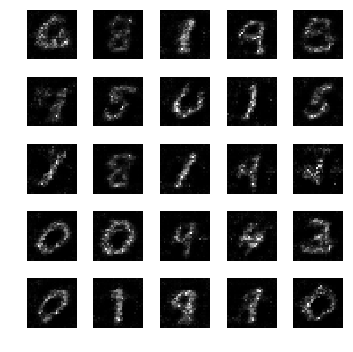

epoch: 411, time: 4.977910 | train_G_Loss: 0.418518, train_D_loss: 2.515252, train_acc: 0.869141
cv_G_Loss: 2.060072, cv_D_loss: 5.149431, cv_acc: 0.859500

epoch: 412, time: 4.951382 | train_G_Loss: 0.415926, train_D_loss: 2.719058, train_acc: 0.851562
cv_G_Loss: 0.524307, cv_D_loss: 2.673688, cv_acc: 0.861700

epoch: 413, time: 4.946248 | train_G_Loss: 0.286484, train_D_loss: 2.695782, train_acc: 0.865234
cv_G_Loss: 0.363278, cv_D_loss: 2.536955, cv_acc: 0.878500

epoch: 414, time: 4.937776 | train_G_Loss: 0.322292, train_D_loss: 2.517423, train_acc: 0.865234
cv_G_Loss: 1.188770, cv_D_loss: 3.467232, cv_acc: 0.879400
Model saved

epoch: 415, time: 4.970461 | train_G_Loss: 0.354924, train_D_loss: 2.670237, train_acc: 0.886719
cv_G_Loss: 0.268277, cv_D_loss: 2.606593, cv_acc: 0.877000

epoch: 416, time: 4.949319 | train_G_Loss: 0.379553, train_D_loss: 2.394902, train_acc: 0.904297
cv_G_Loss: 0.509391, cv_D_loss: 2.560945, cv_acc: 0.875500

epoch: 417, time: 4.943060 | train_G_Loss: 0.3

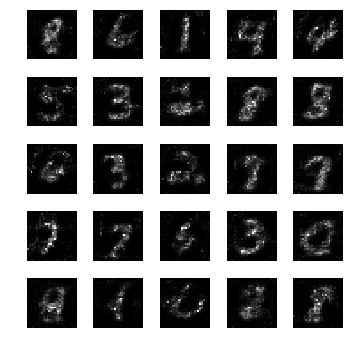

epoch: 421, time: 4.959377 | train_G_Loss: 0.341786, train_D_loss: 2.437064, train_acc: 0.902344
cv_G_Loss: 0.203682, cv_D_loss: 2.779721, cv_acc: 0.860200

epoch: 422, time: 4.954999 | train_G_Loss: 0.422892, train_D_loss: 2.313391, train_acc: 0.884766
cv_G_Loss: 0.883722, cv_D_loss: 3.029606, cv_acc: 0.862700

epoch: 423, time: 4.938673 | train_G_Loss: 0.319894, train_D_loss: 2.638624, train_acc: 0.892578
cv_G_Loss: 0.741327, cv_D_loss: 2.811124, cv_acc: 0.874700

epoch: 424, time: 4.944388 | train_G_Loss: 0.381959, train_D_loss: 2.456384, train_acc: 0.896484
cv_G_Loss: 0.537414, cv_D_loss: 2.574592, cv_acc: 0.875100

epoch: 425, time: 4.947759 | train_G_Loss: 0.312175, train_D_loss: 2.374188, train_acc: 0.867188
cv_G_Loss: 1.017152, cv_D_loss: 3.128397, cv_acc: 0.867000

epoch: 426, time: 4.941791 | train_G_Loss: 0.610468, train_D_loss: 2.645693, train_acc: 0.878906
cv_G_Loss: 0.998343, cv_D_loss: 3.139467, cv_acc: 0.876800

epoch: 427, time: 4.951987 | train_G_Loss: 0.374846, train

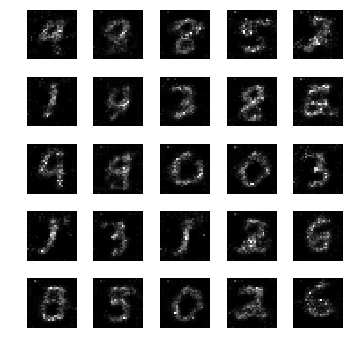

epoch: 431, time: 4.951974 | train_G_Loss: 0.407205, train_D_loss: 2.405935, train_acc: 0.841797
cv_G_Loss: 0.664748, cv_D_loss: 2.748002, cv_acc: 0.857800

epoch: 432, time: 4.951304 | train_G_Loss: 0.381594, train_D_loss: 2.505213, train_acc: 0.880859
cv_G_Loss: 1.839393, cv_D_loss: 4.458301, cv_acc: 0.862200

epoch: 433, time: 4.940707 | train_G_Loss: 0.376183, train_D_loss: 2.345280, train_acc: 0.884766
cv_G_Loss: 1.016894, cv_D_loss: 3.215178, cv_acc: 0.881100

epoch: 434, time: 4.937934 | train_G_Loss: 0.470755, train_D_loss: 2.329899, train_acc: 0.898438
cv_G_Loss: 0.300799, cv_D_loss: 2.640128, cv_acc: 0.839800

epoch: 435, time: 4.925564 | train_G_Loss: 0.383968, train_D_loss: 2.477386, train_acc: 0.884766
cv_G_Loss: 0.418350, cv_D_loss: 2.698689, cv_acc: 0.853100

epoch: 436, time: 4.928210 | train_G_Loss: 0.411953, train_D_loss: 2.656587, train_acc: 0.880859
cv_G_Loss: 0.727524, cv_D_loss: 2.644736, cv_acc: 0.881300

epoch: 437, time: 4.939464 | train_G_Loss: 0.365482, train

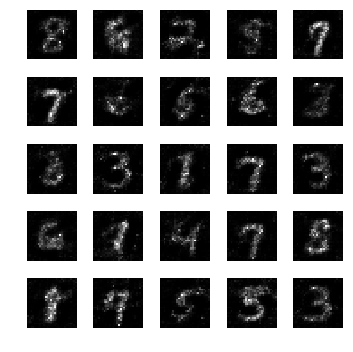

epoch: 441, time: 4.980672 | train_G_Loss: 0.400303, train_D_loss: 2.414268, train_acc: 0.916016
cv_G_Loss: 0.919828, cv_D_loss: 3.036972, cv_acc: 0.866600

epoch: 442, time: 4.941161 | train_G_Loss: 0.423537, train_D_loss: 2.422162, train_acc: 0.898438
cv_G_Loss: 0.640798, cv_D_loss: 2.581751, cv_acc: 0.882000

epoch: 443, time: 5.048508 | train_G_Loss: 0.319060, train_D_loss: 2.535252, train_acc: 0.902344
cv_G_Loss: 0.417776, cv_D_loss: 2.725629, cv_acc: 0.830100

epoch: 444, time: 4.960436 | train_G_Loss: 0.528635, train_D_loss: 2.407873, train_acc: 0.867188
cv_G_Loss: 0.484202, cv_D_loss: 2.503539, cv_acc: 0.875100

epoch: 445, time: 4.960829 | train_G_Loss: 0.410814, train_D_loss: 2.632548, train_acc: 0.857422
cv_G_Loss: 0.388371, cv_D_loss: 2.499420, cv_acc: 0.867700

epoch: 446, time: 4.944089 | train_G_Loss: 0.446152, train_D_loss: 2.439411, train_acc: 0.876953
cv_G_Loss: 0.390689, cv_D_loss: 2.461287, cv_acc: 0.875200

epoch: 447, time: 4.943532 | train_G_Loss: 0.415119, train

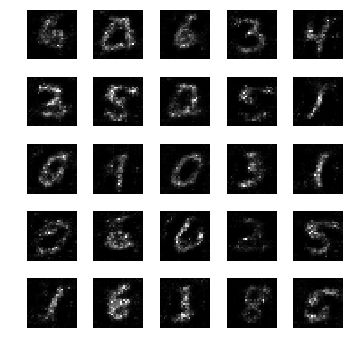

epoch: 451, time: 4.984993 | train_G_Loss: 0.352009, train_D_loss: 2.376293, train_acc: 0.880859
cv_G_Loss: 0.467652, cv_D_loss: 2.474828, cv_acc: 0.874100

epoch: 452, time: 4.951473 | train_G_Loss: 0.404184, train_D_loss: 2.424467, train_acc: 0.882812
cv_G_Loss: 0.236662, cv_D_loss: 2.590339, cv_acc: 0.881100

epoch: 453, time: 4.953223 | train_G_Loss: 0.343880, train_D_loss: 2.408606, train_acc: 0.853516
cv_G_Loss: 0.319091, cv_D_loss: 2.462008, cv_acc: 0.885700
Model saved

epoch: 454, time: 4.970792 | train_G_Loss: 0.387169, train_D_loss: 2.625916, train_acc: 0.865234
cv_G_Loss: 0.462945, cv_D_loss: 2.462768, cv_acc: 0.880200

epoch: 455, time: 4.930023 | train_G_Loss: 0.368585, train_D_loss: 2.511405, train_acc: 0.859375
cv_G_Loss: 0.422020, cv_D_loss: 2.606120, cv_acc: 0.867000

epoch: 456, time: 4.930314 | train_G_Loss: 0.386653, train_D_loss: 2.419276, train_acc: 0.841797
cv_G_Loss: 0.524995, cv_D_loss: 2.632542, cv_acc: 0.861100

epoch: 457, time: 4.937165 | train_G_Loss: 0.3

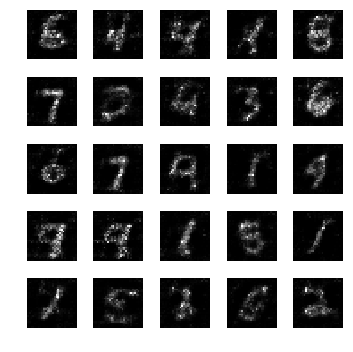

epoch: 461, time: 4.951894 | train_G_Loss: 0.370548, train_D_loss: 2.580398, train_acc: 0.843750
cv_G_Loss: 0.596102, cv_D_loss: 2.525377, cv_acc: 0.875800

epoch: 462, time: 4.956734 | train_G_Loss: 0.396417, train_D_loss: 2.435631, train_acc: 0.861328
cv_G_Loss: 1.037364, cv_D_loss: 3.058537, cv_acc: 0.884300

epoch: 463, time: 4.925213 | train_G_Loss: 0.414976, train_D_loss: 2.494149, train_acc: 0.849609
cv_G_Loss: 0.362958, cv_D_loss: 2.506346, cv_acc: 0.874900

epoch: 464, time: 4.930429 | train_G_Loss: 0.352365, train_D_loss: 2.666647, train_acc: 0.835938
cv_G_Loss: 0.734079, cv_D_loss: 2.788288, cv_acc: 0.886000
Model saved

epoch: 465, time: 4.978433 | train_G_Loss: 0.359360, train_D_loss: 2.601797, train_acc: 0.873047
cv_G_Loss: 0.373984, cv_D_loss: 2.479034, cv_acc: 0.885600

epoch: 466, time: 4.935655 | train_G_Loss: 0.596500, train_D_loss: 2.671977, train_acc: 0.884766
cv_G_Loss: 1.177075, cv_D_loss: 3.336395, cv_acc: 0.872200

epoch: 467, time: 4.937598 | train_G_Loss: 0.4

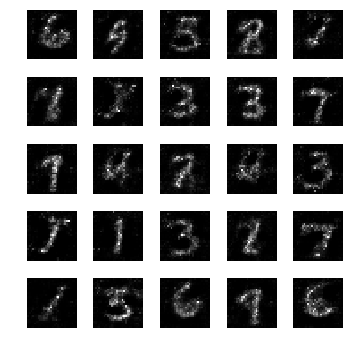

epoch: 471, time: 4.968476 | train_G_Loss: 0.513178, train_D_loss: 2.363122, train_acc: 0.886719
cv_G_Loss: 0.984299, cv_D_loss: 3.094350, cv_acc: 0.860100

epoch: 472, time: 4.930542 | train_G_Loss: 0.468472, train_D_loss: 2.523065, train_acc: 0.867188
cv_G_Loss: 0.711430, cv_D_loss: 2.691131, cv_acc: 0.882500

epoch: 473, time: 4.936892 | train_G_Loss: 0.427919, train_D_loss: 2.703754, train_acc: 0.886719
cv_G_Loss: 1.419106, cv_D_loss: 3.933388, cv_acc: 0.836600

epoch: 474, time: 4.927036 | train_G_Loss: 0.325401, train_D_loss: 2.502782, train_acc: 0.902344
cv_G_Loss: 0.276247, cv_D_loss: 2.593789, cv_acc: 0.881700

epoch: 475, time: 4.943245 | train_G_Loss: 0.476469, train_D_loss: 2.471888, train_acc: 0.886719
cv_G_Loss: 1.087788, cv_D_loss: 3.266331, cv_acc: 0.886200
Model saved

epoch: 476, time: 4.955344 | train_G_Loss: 0.408152, train_D_loss: 2.363248, train_acc: 0.876953
cv_G_Loss: 0.741713, cv_D_loss: 2.837012, cv_acc: 0.874900

epoch: 477, time: 4.938962 | train_G_Loss: 0.3

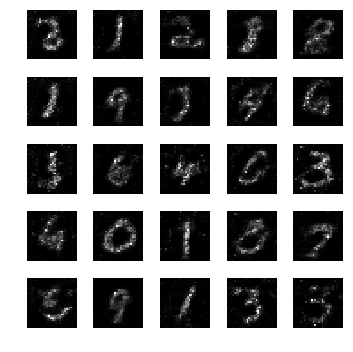

epoch: 481, time: 4.970139 | train_G_Loss: 0.397985, train_D_loss: 2.518503, train_acc: 0.824219
cv_G_Loss: 0.332916, cv_D_loss: 2.512378, cv_acc: 0.885800

epoch: 482, time: 4.931013 | train_G_Loss: 0.318049, train_D_loss: 2.720567, train_acc: 0.863281
cv_G_Loss: 0.163438, cv_D_loss: 2.784616, cv_acc: 0.886200

epoch: 483, time: 4.939052 | train_G_Loss: 0.391222, train_D_loss: 2.415520, train_acc: 0.904297
cv_G_Loss: 0.503639, cv_D_loss: 2.565138, cv_acc: 0.880600

epoch: 484, time: 4.933562 | train_G_Loss: 0.369892, train_D_loss: 2.580061, train_acc: 0.884766
cv_G_Loss: 0.313030, cv_D_loss: 2.557347, cv_acc: 0.883500

epoch: 485, time: 4.971934 | train_G_Loss: 0.398955, train_D_loss: 2.595343, train_acc: 0.888672
cv_G_Loss: 0.260103, cv_D_loss: 2.712181, cv_acc: 0.846000

epoch: 486, time: 4.940705 | train_G_Loss: 0.455841, train_D_loss: 2.388271, train_acc: 0.921875
cv_G_Loss: 0.785340, cv_D_loss: 2.723660, cv_acc: 0.881100

epoch: 487, time: 4.935890 | train_G_Loss: 0.347274, train

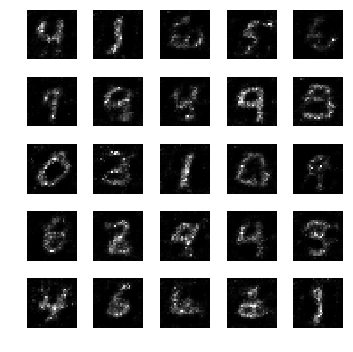

epoch: 491, time: 4.970715 | train_G_Loss: 0.411429, train_D_loss: 2.443527, train_acc: 0.906250
cv_G_Loss: 1.117569, cv_D_loss: 3.230429, cv_acc: 0.883100

epoch: 492, time: 4.940206 | train_G_Loss: 0.424793, train_D_loss: 2.414155, train_acc: 0.916016
cv_G_Loss: 0.135854, cv_D_loss: 2.956451, cv_acc: 0.883700

epoch: 493, time: 4.926554 | train_G_Loss: 0.438718, train_D_loss: 2.337918, train_acc: 0.902344
cv_G_Loss: 1.570601, cv_D_loss: 4.005208, cv_acc: 0.874600

epoch: 494, time: 4.929008 | train_G_Loss: 0.323377, train_D_loss: 2.538848, train_acc: 0.863281
cv_G_Loss: 0.794003, cv_D_loss: 2.827221, cv_acc: 0.883500

epoch: 495, time: 4.933437 | train_G_Loss: 0.338083, train_D_loss: 2.724433, train_acc: 0.843750
cv_G_Loss: 0.455965, cv_D_loss: 2.890851, cv_acc: 0.763000

epoch: 496, time: 4.932577 | train_G_Loss: 0.471743, train_D_loss: 2.432486, train_acc: 0.884766
cv_G_Loss: 0.425258, cv_D_loss: 2.532880, cv_acc: 0.880900

epoch: 497, time: 4.935510 | train_G_Loss: 0.410823, train

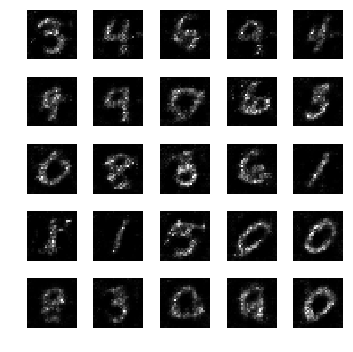

epoch: 501, time: 4.962506 | train_G_Loss: 0.421787, train_D_loss: 2.585611, train_acc: 0.910156
cv_G_Loss: 1.257303, cv_D_loss: 3.424023, cv_acc: 0.882900

epoch: 502, time: 4.929568 | train_G_Loss: 0.498842, train_D_loss: 2.333271, train_acc: 0.886719
cv_G_Loss: 0.992896, cv_D_loss: 3.084792, cv_acc: 0.887900
Model saved

epoch: 503, time: 4.960401 | train_G_Loss: 0.400543, train_D_loss: 2.383776, train_acc: 0.875000
cv_G_Loss: 0.359126, cv_D_loss: 2.590917, cv_acc: 0.869400

epoch: 504, time: 4.932148 | train_G_Loss: 0.308003, train_D_loss: 2.481158, train_acc: 0.878906
cv_G_Loss: 0.174318, cv_D_loss: 2.709019, cv_acc: 0.888500
Model saved

epoch: 505, time: 4.956954 | train_G_Loss: 0.400368, train_D_loss: 2.449335, train_acc: 0.912109
cv_G_Loss: 0.607470, cv_D_loss: 2.487526, cv_acc: 0.890000
Model saved

epoch: 506, time: 4.957555 | train_G_Loss: 0.333728, train_D_loss: 2.312315, train_acc: 0.902344
cv_G_Loss: 0.462006, cv_D_loss: 2.641739, cv_acc: 0.867100

epoch: 507, time: 4.97

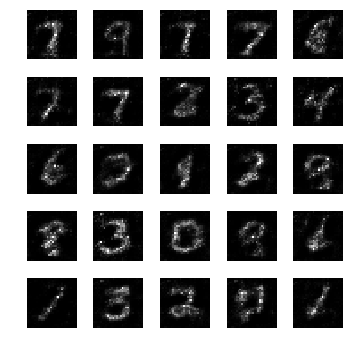

epoch: 511, time: 4.978889 | train_G_Loss: 0.389850, train_D_loss: 2.551867, train_acc: 0.892578
cv_G_Loss: 0.530388, cv_D_loss: 2.518111, cv_acc: 0.888000

epoch: 512, time: 4.949400 | train_G_Loss: 0.438874, train_D_loss: 2.629992, train_acc: 0.900391
cv_G_Loss: 0.244702, cv_D_loss: 2.571214, cv_acc: 0.891700

epoch: 513, time: 4.942643 | train_G_Loss: 0.498976, train_D_loss: 2.377565, train_acc: 0.880859
cv_G_Loss: 0.539856, cv_D_loss: 2.509028, cv_acc: 0.879000

epoch: 514, time: 4.943517 | train_G_Loss: 0.292657, train_D_loss: 2.377941, train_acc: 0.869141
cv_G_Loss: 0.492580, cv_D_loss: 2.504249, cv_acc: 0.887000

epoch: 515, time: 4.936987 | train_G_Loss: 0.432255, train_D_loss: 2.659137, train_acc: 0.876953
cv_G_Loss: 1.005937, cv_D_loss: 3.258598, cv_acc: 0.839900

epoch: 516, time: 4.956367 | train_G_Loss: 0.357147, train_D_loss: 2.394320, train_acc: 0.890625
cv_G_Loss: 0.514675, cv_D_loss: 2.606452, cv_acc: 0.875000

epoch: 517, time: 4.944866 | train_G_Loss: 0.437820, train

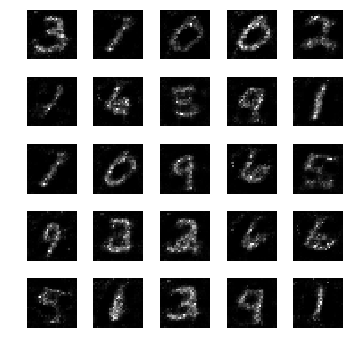

epoch: 521, time: 4.980967 | train_G_Loss: 0.289718, train_D_loss: 2.803788, train_acc: 0.865234
cv_G_Loss: 0.612859, cv_D_loss: 2.607859, cv_acc: 0.880400

epoch: 522, time: 4.950053 | train_G_Loss: 0.366944, train_D_loss: 2.286063, train_acc: 0.853516
cv_G_Loss: 0.407901, cv_D_loss: 2.462361, cv_acc: 0.887700

epoch: 523, time: 4.943588 | train_G_Loss: 0.556191, train_D_loss: 2.604187, train_acc: 0.886719
cv_G_Loss: 0.577198, cv_D_loss: 2.501064, cv_acc: 0.893200

epoch: 524, time: 4.952931 | train_G_Loss: 0.427807, train_D_loss: 2.927226, train_acc: 0.880859
cv_G_Loss: 1.630385, cv_D_loss: 4.115431, cv_acc: 0.867500

epoch: 525, time: 4.956238 | train_G_Loss: 0.403783, train_D_loss: 2.453101, train_acc: 0.861328
cv_G_Loss: 1.178211, cv_D_loss: 3.440538, cv_acc: 0.880200

epoch: 526, time: 4.947654 | train_G_Loss: 0.333938, train_D_loss: 2.480303, train_acc: 0.869141
cv_G_Loss: 0.973095, cv_D_loss: 3.041434, cv_acc: 0.883700

epoch: 527, time: 4.950289 | train_G_Loss: 0.259559, train

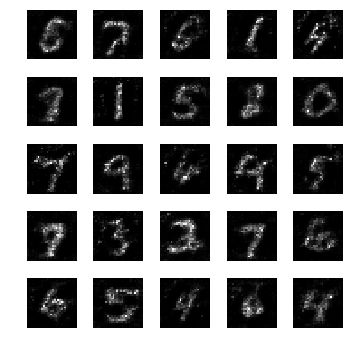

epoch: 531, time: 4.963529 | train_G_Loss: 0.358425, train_D_loss: 2.453602, train_acc: 0.875000
cv_G_Loss: 0.242726, cv_D_loss: 2.517969, cv_acc: 0.885500

epoch: 532, time: 4.953622 | train_G_Loss: 0.322922, train_D_loss: 2.429244, train_acc: 0.904297
cv_G_Loss: 0.272598, cv_D_loss: 2.512005, cv_acc: 0.896500
Model saved

epoch: 533, time: 4.961588 | train_G_Loss: 0.394670, train_D_loss: 2.196038, train_acc: 0.863281
cv_G_Loss: 0.619904, cv_D_loss: 2.636401, cv_acc: 0.879900

epoch: 534, time: 4.920599 | train_G_Loss: 0.422218, train_D_loss: 2.694010, train_acc: 0.880859
cv_G_Loss: 0.696976, cv_D_loss: 2.663412, cv_acc: 0.888900

epoch: 535, time: 4.947131 | train_G_Loss: 0.489410, train_D_loss: 2.536829, train_acc: 0.894531
cv_G_Loss: 1.292957, cv_D_loss: 3.520566, cv_acc: 0.884300

epoch: 536, time: 4.955524 | train_G_Loss: 0.494467, train_D_loss: 2.379691, train_acc: 0.900391
cv_G_Loss: 0.600302, cv_D_loss: 2.659947, cv_acc: 0.871800

epoch: 537, time: 4.932721 | train_G_Loss: 0.3

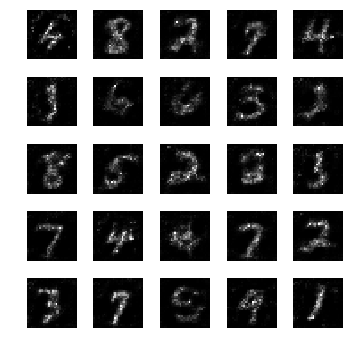

epoch: 541, time: 4.960004 | train_G_Loss: 0.397456, train_D_loss: 2.448195, train_acc: 0.914062
cv_G_Loss: 0.279473, cv_D_loss: 2.608966, cv_acc: 0.877600

epoch: 542, time: 4.934171 | train_G_Loss: 0.454218, train_D_loss: 2.247952, train_acc: 0.929688
cv_G_Loss: 0.710671, cv_D_loss: 2.624451, cv_acc: 0.893300

epoch: 543, time: 4.934974 | train_G_Loss: 0.357707, train_D_loss: 2.397090, train_acc: 0.935547
cv_G_Loss: 0.247118, cv_D_loss: 2.570763, cv_acc: 0.888800

epoch: 544, time: 4.933576 | train_G_Loss: 0.368903, train_D_loss: 2.284220, train_acc: 0.916016
cv_G_Loss: 0.201222, cv_D_loss: 2.626743, cv_acc: 0.899500
Model saved

epoch: 545, time: 4.985130 | train_G_Loss: 0.495321, train_D_loss: 2.332315, train_acc: 0.906250
cv_G_Loss: 0.758816, cv_D_loss: 2.713003, cv_acc: 0.897300

epoch: 546, time: 4.949512 | train_G_Loss: 0.499128, train_D_loss: 2.240631, train_acc: 0.904297
cv_G_Loss: 0.842799, cv_D_loss: 2.885263, cv_acc: 0.886600

epoch: 547, time: 4.975569 | train_G_Loss: 0.3

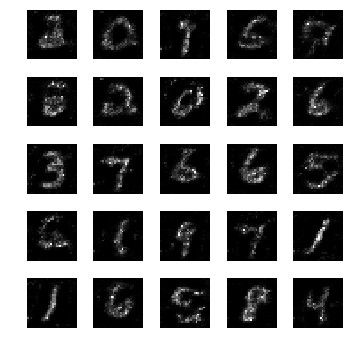

epoch: 551, time: 5.012125 | train_G_Loss: 0.459823, train_D_loss: 2.335701, train_acc: 0.943359
cv_G_Loss: 0.252124, cv_D_loss: 2.600749, cv_acc: 0.882100

epoch: 552, time: 4.958854 | train_G_Loss: 0.401090, train_D_loss: 2.049192, train_acc: 0.947266
cv_G_Loss: 0.370877, cv_D_loss: 2.437025, cv_acc: 0.887100

epoch: 553, time: 4.948722 | train_G_Loss: 0.504256, train_D_loss: 2.160906, train_acc: 0.953125
cv_G_Loss: 0.852356, cv_D_loss: 3.008878, cv_acc: 0.852300

epoch: 554, time: 4.954310 | train_G_Loss: 0.373450, train_D_loss: 2.418868, train_acc: 0.970703
cv_G_Loss: 0.699636, cv_D_loss: 2.767357, cv_acc: 0.886800

epoch: 555, time: 4.948493 | train_G_Loss: 0.346247, train_D_loss: 2.219228, train_acc: 0.937500
cv_G_Loss: 0.605781, cv_D_loss: 2.563585, cv_acc: 0.893200

epoch: 556, time: 4.956073 | train_G_Loss: 0.386081, train_D_loss: 2.476590, train_acc: 0.929688
cv_G_Loss: 0.487057, cv_D_loss: 2.441429, cv_acc: 0.885900

epoch: 557, time: 4.945790 | train_G_Loss: 0.580509, train

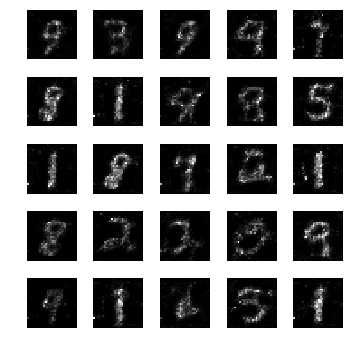

epoch: 561, time: 4.990960 | train_G_Loss: 0.193586, train_D_loss: 2.807603, train_acc: 0.910156
cv_G_Loss: 0.153126, cv_D_loss: 2.907029, cv_acc: 0.870300

epoch: 562, time: 4.964597 | train_G_Loss: 0.367471, train_D_loss: 2.332613, train_acc: 0.910156
cv_G_Loss: 0.661223, cv_D_loss: 2.600619, cv_acc: 0.884300

epoch: 563, time: 4.958416 | train_G_Loss: 0.443000, train_D_loss: 2.410682, train_acc: 0.875000
cv_G_Loss: 1.124354, cv_D_loss: 3.301566, cv_acc: 0.890700

epoch: 564, time: 4.949752 | train_G_Loss: 0.386818, train_D_loss: 2.376686, train_acc: 0.875000
cv_G_Loss: 0.681332, cv_D_loss: 2.710603, cv_acc: 0.886300

epoch: 565, time: 4.960062 | train_G_Loss: 0.363401, train_D_loss: 2.366006, train_acc: 0.900391
cv_G_Loss: 0.197445, cv_D_loss: 2.754787, cv_acc: 0.864900

epoch: 566, time: 4.952415 | train_G_Loss: 0.318600, train_D_loss: 2.578613, train_acc: 0.906250
cv_G_Loss: 0.170559, cv_D_loss: 2.730089, cv_acc: 0.892300

epoch: 567, time: 4.976430 | train_G_Loss: 0.371778, train

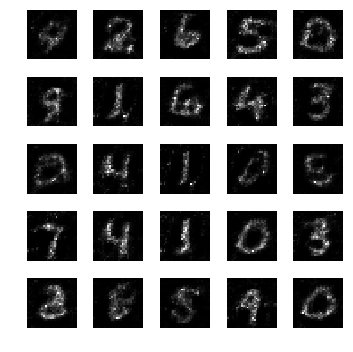

epoch: 571, time: 4.988334 | train_G_Loss: 0.310876, train_D_loss: 2.480213, train_acc: 0.882812
cv_G_Loss: 0.166190, cv_D_loss: 2.736611, cv_acc: 0.895500

epoch: 572, time: 4.966082 | train_G_Loss: 0.352514, train_D_loss: 2.470835, train_acc: 0.888672
cv_G_Loss: 0.178099, cv_D_loss: 2.755063, cv_acc: 0.883000

epoch: 573, time: 4.974460 | train_G_Loss: 0.489728, train_D_loss: 2.533254, train_acc: 0.914062
cv_G_Loss: 0.775928, cv_D_loss: 2.809432, cv_acc: 0.893500

epoch: 574, time: 4.977334 | train_G_Loss: 0.611574, train_D_loss: 2.247170, train_acc: 0.914062
cv_G_Loss: 0.622533, cv_D_loss: 2.579127, cv_acc: 0.895000

epoch: 575, time: 4.955748 | train_G_Loss: 0.374559, train_D_loss: 2.367783, train_acc: 0.914062
cv_G_Loss: 0.316287, cv_D_loss: 2.525758, cv_acc: 0.886800

epoch: 576, time: 4.967013 | train_G_Loss: 0.299239, train_D_loss: 2.390310, train_acc: 0.945312
cv_G_Loss: 0.180567, cv_D_loss: 2.692472, cv_acc: 0.894400

epoch: 577, time: 4.962351 | train_G_Loss: 0.456504, train

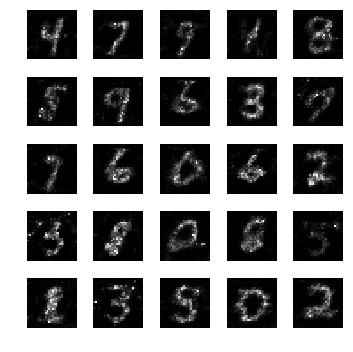

epoch: 581, time: 4.984381 | train_G_Loss: 0.324222, train_D_loss: 2.469942, train_acc: 0.894531
cv_G_Loss: 0.781134, cv_D_loss: 2.737833, cv_acc: 0.872100

epoch: 582, time: 4.953080 | train_G_Loss: 0.361410, train_D_loss: 2.416736, train_acc: 0.896484
cv_G_Loss: 0.661748, cv_D_loss: 2.477237, cv_acc: 0.887600

epoch: 583, time: 4.951869 | train_G_Loss: 0.398968, train_D_loss: 2.382374, train_acc: 0.871094
cv_G_Loss: 0.513125, cv_D_loss: 2.528586, cv_acc: 0.887000

epoch: 584, time: 4.963958 | train_G_Loss: 0.355244, train_D_loss: 2.687563, train_acc: 0.869141
cv_G_Loss: 0.307474, cv_D_loss: 2.483172, cv_acc: 0.893700

epoch: 585, time: 4.949879 | train_G_Loss: 0.456850, train_D_loss: 2.526990, train_acc: 0.894531
cv_G_Loss: 0.208871, cv_D_loss: 2.655534, cv_acc: 0.890400

epoch: 586, time: 4.953568 | train_G_Loss: 0.401640, train_D_loss: 2.384245, train_acc: 0.910156
cv_G_Loss: 0.224900, cv_D_loss: 2.566858, cv_acc: 0.902800
Model saved

epoch: 587, time: 4.976874 | train_G_Loss: 0.4

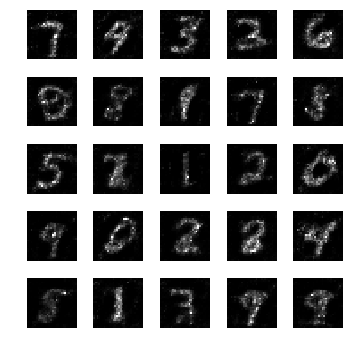

epoch: 591, time: 4.991977 | train_G_Loss: 0.371266, train_D_loss: 2.835557, train_acc: 0.873047
cv_G_Loss: 0.521031, cv_D_loss: 2.476235, cv_acc: 0.897300

epoch: 592, time: 4.952786 | train_G_Loss: 0.563437, train_D_loss: 2.344802, train_acc: 0.898438
cv_G_Loss: 0.430108, cv_D_loss: 2.461204, cv_acc: 0.893300

epoch: 593, time: 4.944191 | train_G_Loss: 0.392535, train_D_loss: 2.378638, train_acc: 0.878906
cv_G_Loss: 0.108205, cv_D_loss: 3.165514, cv_acc: 0.853200

epoch: 594, time: 4.949821 | train_G_Loss: 0.436198, train_D_loss: 2.390723, train_acc: 0.851562
cv_G_Loss: 0.714897, cv_D_loss: 2.701069, cv_acc: 0.889100

epoch: 595, time: 4.951495 | train_G_Loss: 0.367685, train_D_loss: 2.526541, train_acc: 0.900391
cv_G_Loss: 0.462897, cv_D_loss: 2.468661, cv_acc: 0.896500

epoch: 596, time: 4.942597 | train_G_Loss: 0.329413, train_D_loss: 2.356759, train_acc: 0.910156
cv_G_Loss: 0.591940, cv_D_loss: 2.520560, cv_acc: 0.887500

epoch: 597, time: 4.976138 | train_G_Loss: 0.446386, train

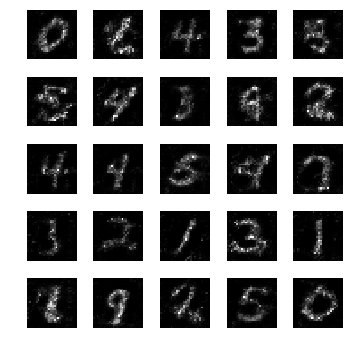

epoch: 601, time: 4.985028 | train_G_Loss: 0.472268, train_D_loss: 2.561333, train_acc: 0.906250
cv_G_Loss: 1.129219, cv_D_loss: 3.190843, cv_acc: 0.898100

epoch: 602, time: 4.949887 | train_G_Loss: 0.454028, train_D_loss: 2.393484, train_acc: 0.925781
cv_G_Loss: 0.363141, cv_D_loss: 2.428859, cv_acc: 0.903400
Model saved

epoch: 603, time: 4.968742 | train_G_Loss: 0.420752, train_D_loss: 2.258915, train_acc: 0.933594
cv_G_Loss: 0.880223, cv_D_loss: 2.918581, cv_acc: 0.885400

epoch: 604, time: 4.929898 | train_G_Loss: 0.460802, train_D_loss: 2.450774, train_acc: 0.929688
cv_G_Loss: 0.926592, cv_D_loss: 2.978621, cv_acc: 0.880200

epoch: 605, time: 4.948295 | train_G_Loss: 0.445953, train_D_loss: 2.288898, train_acc: 0.925781
cv_G_Loss: 0.447003, cv_D_loss: 2.534585, cv_acc: 0.891500

epoch: 606, time: 4.955480 | train_G_Loss: 0.420524, train_D_loss: 2.371331, train_acc: 0.902344
cv_G_Loss: 0.500623, cv_D_loss: 2.614275, cv_acc: 0.882900

epoch: 607, time: 4.953981 | train_G_Loss: 0.3

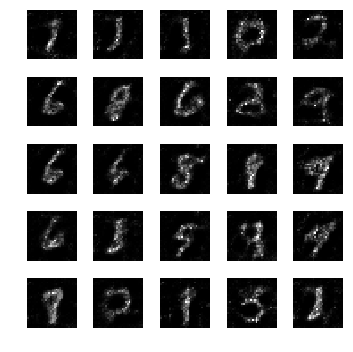

epoch: 611, time: 5.048716 | train_G_Loss: 0.364338, train_D_loss: 2.421932, train_acc: 0.890625
cv_G_Loss: 0.201923, cv_D_loss: 2.645614, cv_acc: 0.898200

epoch: 612, time: 4.934289 | train_G_Loss: 0.363065, train_D_loss: 2.729263, train_acc: 0.894531
cv_G_Loss: 0.669674, cv_D_loss: 2.581703, cv_acc: 0.893800

epoch: 613, time: 4.939711 | train_G_Loss: 0.317416, train_D_loss: 2.258565, train_acc: 0.914062
cv_G_Loss: 0.403380, cv_D_loss: 2.459014, cv_acc: 0.896600

epoch: 614, time: 4.944176 | train_G_Loss: 0.387179, train_D_loss: 2.357001, train_acc: 0.929688
cv_G_Loss: 0.361018, cv_D_loss: 2.529696, cv_acc: 0.883600

epoch: 615, time: 4.947546 | train_G_Loss: 0.554018, train_D_loss: 2.248695, train_acc: 0.904297
cv_G_Loss: 3.267469, cv_D_loss: 7.311770, cv_acc: 0.853000

epoch: 616, time: 4.935913 | train_G_Loss: 0.269868, train_D_loss: 2.651963, train_acc: 0.859375
cv_G_Loss: 0.099795, cv_D_loss: 3.057818, cv_acc: 0.899800

epoch: 617, time: 4.931810 | train_G_Loss: 0.433554, train

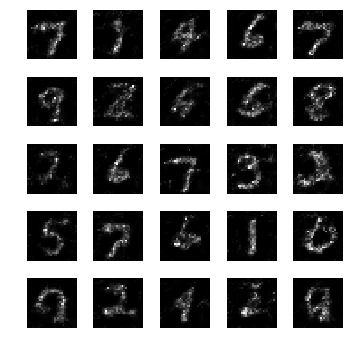

epoch: 621, time: 4.975538 | train_G_Loss: 0.407465, train_D_loss: 2.412357, train_acc: 0.898438
cv_G_Loss: 1.286031, cv_D_loss: 3.498796, cv_acc: 0.873400

epoch: 622, time: 4.945878 | train_G_Loss: 0.467307, train_D_loss: 2.313854, train_acc: 0.900391
cv_G_Loss: 1.341076, cv_D_loss: 3.475550, cv_acc: 0.890500

epoch: 623, time: 4.934866 | train_G_Loss: 0.393464, train_D_loss: 2.512546, train_acc: 0.875000
cv_G_Loss: 0.394126, cv_D_loss: 2.461703, cv_acc: 0.896600

epoch: 624, time: 4.941156 | train_G_Loss: 0.333438, train_D_loss: 2.570635, train_acc: 0.876953
cv_G_Loss: 0.327630, cv_D_loss: 2.444363, cv_acc: 0.895400

epoch: 625, time: 4.939595 | train_G_Loss: 0.528672, train_D_loss: 2.511980, train_acc: 0.888672
cv_G_Loss: 1.100475, cv_D_loss: 3.193514, cv_acc: 0.878200

epoch: 626, time: 4.941546 | train_G_Loss: 0.377904, train_D_loss: 2.380291, train_acc: 0.916016
cv_G_Loss: 0.917275, cv_D_loss: 2.838820, cv_acc: 0.898400

epoch: 627, time: 4.927555 | train_G_Loss: 0.441811, train

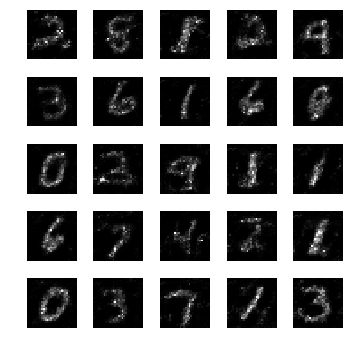

epoch: 631, time: 4.966670 | train_G_Loss: 0.379582, train_D_loss: 2.511882, train_acc: 0.894531
cv_G_Loss: 0.488211, cv_D_loss: 2.444154, cv_acc: 0.900300

epoch: 632, time: 4.936908 | train_G_Loss: 0.357344, train_D_loss: 2.575177, train_acc: 0.902344
cv_G_Loss: 0.402551, cv_D_loss: 2.498734, cv_acc: 0.886100

epoch: 633, time: 4.927442 | train_G_Loss: 0.349350, train_D_loss: 2.682893, train_acc: 0.900391
cv_G_Loss: 0.975134, cv_D_loss: 2.958987, cv_acc: 0.891100

epoch: 634, time: 4.934471 | train_G_Loss: 0.377246, train_D_loss: 2.320071, train_acc: 0.912109
cv_G_Loss: 0.471695, cv_D_loss: 2.504772, cv_acc: 0.884200

epoch: 635, time: 4.937142 | train_G_Loss: 0.446869, train_D_loss: 2.416363, train_acc: 0.921875
cv_G_Loss: 1.110758, cv_D_loss: 3.139884, cv_acc: 0.893100

epoch: 636, time: 4.951766 | train_G_Loss: 0.360118, train_D_loss: 2.293970, train_acc: 0.917969
cv_G_Loss: 0.598017, cv_D_loss: 2.461537, cv_acc: 0.903700
Model saved

epoch: 637, time: 4.977534 | train_G_Loss: 0.4

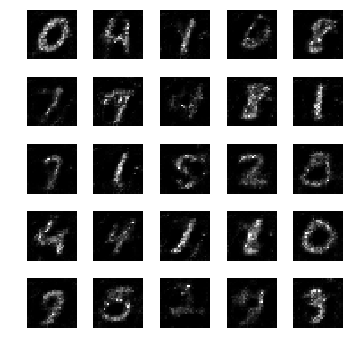

epoch: 641, time: 4.993787 | train_G_Loss: 0.325318, train_D_loss: 2.400331, train_acc: 0.878906
cv_G_Loss: 0.493103, cv_D_loss: 2.418307, cv_acc: 0.892100

epoch: 642, time: 4.954483 | train_G_Loss: 0.406022, train_D_loss: 2.556163, train_acc: 0.859375
cv_G_Loss: 0.596958, cv_D_loss: 2.473651, cv_acc: 0.898800

epoch: 643, time: 4.956584 | train_G_Loss: 0.407753, train_D_loss: 2.641599, train_acc: 0.875000
cv_G_Loss: 1.349436, cv_D_loss: 3.617536, cv_acc: 0.872400

epoch: 644, time: 4.947251 | train_G_Loss: 0.342685, train_D_loss: 2.443179, train_acc: 0.869141
cv_G_Loss: 0.384437, cv_D_loss: 2.482090, cv_acc: 0.895500

epoch: 645, time: 4.947742 | train_G_Loss: 0.361829, train_D_loss: 2.418917, train_acc: 0.886719
cv_G_Loss: 0.485040, cv_D_loss: 2.462758, cv_acc: 0.881500

epoch: 646, time: 4.959910 | train_G_Loss: 0.431433, train_D_loss: 2.487056, train_acc: 0.888672
cv_G_Loss: 1.219972, cv_D_loss: 3.344566, cv_acc: 0.900300

epoch: 647, time: 4.960619 | train_G_Loss: 0.336724, train

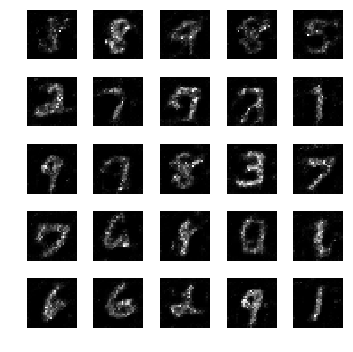

epoch: 651, time: 4.983060 | train_G_Loss: 0.398132, train_D_loss: 2.629665, train_acc: 0.906250
cv_G_Loss: 0.186371, cv_D_loss: 2.655497, cv_acc: 0.900000

epoch: 652, time: 4.962584 | train_G_Loss: 0.375078, train_D_loss: 2.519436, train_acc: 0.908203
cv_G_Loss: 0.278431, cv_D_loss: 2.464776, cv_acc: 0.899500

epoch: 653, time: 4.949428 | train_G_Loss: 0.355134, train_D_loss: 2.292585, train_acc: 0.906250
cv_G_Loss: 0.909574, cv_D_loss: 2.962945, cv_acc: 0.879800

epoch: 654, time: 4.955087 | train_G_Loss: 0.492747, train_D_loss: 2.453263, train_acc: 0.910156
cv_G_Loss: 0.577281, cv_D_loss: 2.584993, cv_acc: 0.878300

epoch: 655, time: 4.958104 | train_G_Loss: 0.332889, train_D_loss: 2.354454, train_acc: 0.931641
cv_G_Loss: 0.710639, cv_D_loss: 2.635027, cv_acc: 0.887000

epoch: 656, time: 4.949239 | train_G_Loss: 0.397464, train_D_loss: 2.343075, train_acc: 0.914062
cv_G_Loss: 1.110031, cv_D_loss: 3.184546, cv_acc: 0.886300

epoch: 657, time: 4.959369 | train_G_Loss: 0.390524, train

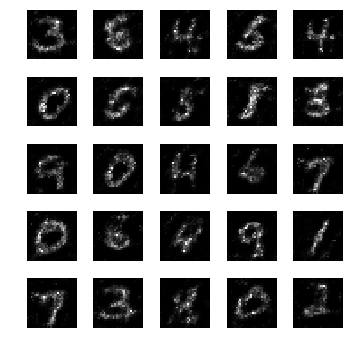

epoch: 661, time: 4.977751 | train_G_Loss: 0.446711, train_D_loss: 2.548688, train_acc: 0.916016
cv_G_Loss: 0.892274, cv_D_loss: 3.059780, cv_acc: 0.874200

epoch: 662, time: 4.950748 | train_G_Loss: 0.371218, train_D_loss: 2.280803, train_acc: 0.906250
cv_G_Loss: 0.446903, cv_D_loss: 2.451355, cv_acc: 0.894100

epoch: 663, time: 4.953511 | train_G_Loss: 0.409850, train_D_loss: 2.541437, train_acc: 0.898438
cv_G_Loss: 0.089548, cv_D_loss: 3.205240, cv_acc: 0.885200

epoch: 664, time: 4.970384 | train_G_Loss: 0.352821, train_D_loss: 2.338556, train_acc: 0.916016
cv_G_Loss: 0.416781, cv_D_loss: 2.389959, cv_acc: 0.901000

epoch: 665, time: 4.956628 | train_G_Loss: 0.363275, train_D_loss: 2.340051, train_acc: 0.916016
cv_G_Loss: 0.832123, cv_D_loss: 2.810044, cv_acc: 0.899900

epoch: 666, time: 4.945515 | train_G_Loss: 0.523323, train_D_loss: 2.285526, train_acc: 0.880859
cv_G_Loss: 0.214837, cv_D_loss: 2.766326, cv_acc: 0.846300

epoch: 667, time: 4.958929 | train_G_Loss: 0.435787, train

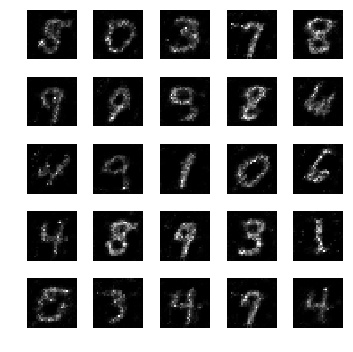

epoch: 671, time: 5.008073 | train_G_Loss: 0.405805, train_D_loss: 2.383826, train_acc: 0.916016
cv_G_Loss: 0.196755, cv_D_loss: 2.653053, cv_acc: 0.895000

epoch: 672, time: 4.963992 | train_G_Loss: 0.344276, train_D_loss: 2.262806, train_acc: 0.929688
cv_G_Loss: 0.777095, cv_D_loss: 2.635925, cv_acc: 0.896700

epoch: 673, time: 4.956003 | train_G_Loss: 0.358406, train_D_loss: 2.304615, train_acc: 0.896484
cv_G_Loss: 0.898753, cv_D_loss: 2.949366, cv_acc: 0.891100

epoch: 674, time: 4.971194 | train_G_Loss: 0.341147, train_D_loss: 2.714946, train_acc: 0.890625
cv_G_Loss: 0.119710, cv_D_loss: 3.066843, cv_acc: 0.869000

epoch: 675, time: 4.954064 | train_G_Loss: 0.389297, train_D_loss: 2.340349, train_acc: 0.896484
cv_G_Loss: 1.702120, cv_D_loss: 4.177275, cv_acc: 0.892000

epoch: 676, time: 4.988144 | train_G_Loss: 0.379585, train_D_loss: 2.496462, train_acc: 0.900391
cv_G_Loss: 0.545457, cv_D_loss: 2.607769, cv_acc: 0.888900

epoch: 677, time: 4.970122 | train_G_Loss: 0.508172, train

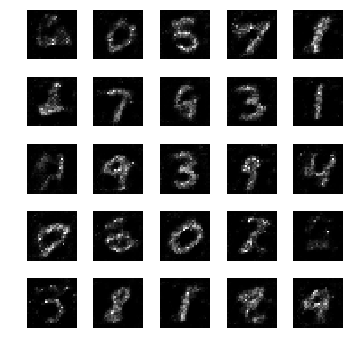

epoch: 681, time: 4.987606 | train_G_Loss: 0.373585, train_D_loss: 2.624036, train_acc: 0.904297
cv_G_Loss: 0.290563, cv_D_loss: 2.431101, cv_acc: 0.907700
Model saved

epoch: 682, time: 4.984603 | train_G_Loss: 0.414822, train_D_loss: 2.255122, train_acc: 0.919922
cv_G_Loss: 0.576151, cv_D_loss: 2.513161, cv_acc: 0.892600

epoch: 683, time: 4.939318 | train_G_Loss: 0.549154, train_D_loss: 2.369178, train_acc: 0.882812
cv_G_Loss: 0.704195, cv_D_loss: 2.780835, cv_acc: 0.880900

epoch: 684, time: 4.947867 | train_G_Loss: 0.477571, train_D_loss: 2.382734, train_acc: 0.882812
cv_G_Loss: 1.110252, cv_D_loss: 3.345368, cv_acc: 0.873500

epoch: 685, time: 4.953144 | train_G_Loss: 0.290426, train_D_loss: 2.325674, train_acc: 0.892578
cv_G_Loss: 0.257478, cv_D_loss: 2.565166, cv_acc: 0.886900

epoch: 686, time: 4.953770 | train_G_Loss: 0.394022, train_D_loss: 2.426397, train_acc: 0.875000
cv_G_Loss: 0.574746, cv_D_loss: 2.622355, cv_acc: 0.880800

epoch: 687, time: 4.968228 | train_G_Loss: 0.4

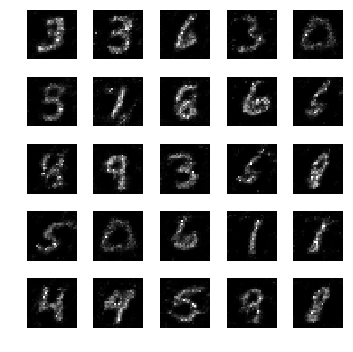

epoch: 691, time: 4.978511 | train_G_Loss: 0.382929, train_D_loss: 2.438827, train_acc: 0.943359
cv_G_Loss: 0.707627, cv_D_loss: 2.558101, cv_acc: 0.905700

epoch: 692, time: 4.942322 | train_G_Loss: 0.307505, train_D_loss: 2.276876, train_acc: 0.906250
cv_G_Loss: 0.807452, cv_D_loss: 2.693882, cv_acc: 0.896300

epoch: 693, time: 4.939247 | train_G_Loss: 0.455962, train_D_loss: 2.352326, train_acc: 0.935547
cv_G_Loss: 0.860229, cv_D_loss: 2.783341, cv_acc: 0.906000

epoch: 694, time: 4.942798 | train_G_Loss: 0.436450, train_D_loss: 2.249369, train_acc: 0.898438
cv_G_Loss: 0.788783, cv_D_loss: 2.692747, cv_acc: 0.898500

epoch: 695, time: 4.944782 | train_G_Loss: 0.378583, train_D_loss: 2.463601, train_acc: 0.875000
cv_G_Loss: 0.448868, cv_D_loss: 2.500763, cv_acc: 0.892900

epoch: 696, time: 4.937247 | train_G_Loss: 0.370731, train_D_loss: 2.485864, train_acc: 0.878906
cv_G_Loss: 0.501289, cv_D_loss: 2.472410, cv_acc: 0.899300

epoch: 697, time: 4.951153 | train_G_Loss: 0.310626, train

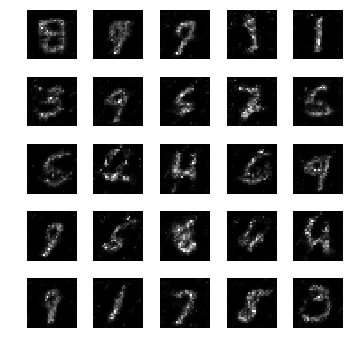

epoch: 701, time: 4.955530 | train_G_Loss: 0.324782, train_D_loss: 2.624299, train_acc: 0.884766
cv_G_Loss: 0.208379, cv_D_loss: 2.742072, cv_acc: 0.854600

epoch: 702, time: 4.951536 | train_G_Loss: 0.300738, train_D_loss: 2.711498, train_acc: 0.896484
cv_G_Loss: 0.145040, cv_D_loss: 2.813242, cv_acc: 0.896300

epoch: 703, time: 4.943945 | train_G_Loss: 0.413813, train_D_loss: 2.423427, train_acc: 0.912109
cv_G_Loss: 0.797704, cv_D_loss: 2.725054, cv_acc: 0.899700

epoch: 704, time: 4.938728 | train_G_Loss: 0.518903, train_D_loss: 2.213531, train_acc: 0.914062
cv_G_Loss: 1.088875, cv_D_loss: 3.199754, cv_acc: 0.893400

epoch: 705, time: 4.951793 | train_G_Loss: 0.430723, train_D_loss: 2.412705, train_acc: 0.902344
cv_G_Loss: 0.883586, cv_D_loss: 2.809527, cv_acc: 0.903600

epoch: 706, time: 4.948232 | train_G_Loss: 0.387010, train_D_loss: 2.421947, train_acc: 0.884766
cv_G_Loss: 0.670612, cv_D_loss: 2.525345, cv_acc: 0.899200

epoch: 707, time: 4.944521 | train_G_Loss: 0.293432, train

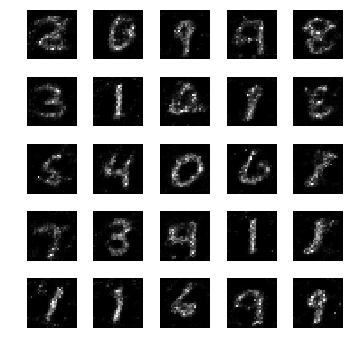

epoch: 711, time: 4.966169 | train_G_Loss: 0.366123, train_D_loss: 2.348680, train_acc: 0.882812
cv_G_Loss: 0.590616, cv_D_loss: 2.513033, cv_acc: 0.898100

epoch: 712, time: 4.943764 | train_G_Loss: 0.339007, train_D_loss: 2.550918, train_acc: 0.876953
cv_G_Loss: 0.453972, cv_D_loss: 2.589255, cv_acc: 0.879600

epoch: 713, time: 4.951624 | train_G_Loss: 0.362524, train_D_loss: 2.382364, train_acc: 0.904297
cv_G_Loss: 0.447069, cv_D_loss: 2.434321, cv_acc: 0.899600

epoch: 714, time: 5.024008 | train_G_Loss: 0.320318, train_D_loss: 2.394646, train_acc: 0.916016
cv_G_Loss: 0.616261, cv_D_loss: 2.491848, cv_acc: 0.907000

epoch: 715, time: 4.929872 | train_G_Loss: 0.499622, train_D_loss: 2.307942, train_acc: 0.935547
cv_G_Loss: 1.582469, cv_D_loss: 3.841538, cv_acc: 0.898300

epoch: 716, time: 4.954753 | train_G_Loss: 0.446235, train_D_loss: 2.397012, train_acc: 0.906250
cv_G_Loss: 0.510157, cv_D_loss: 2.416794, cv_acc: 0.909700
Model saved

epoch: 717, time: 4.957548 | train_G_Loss: 0.3

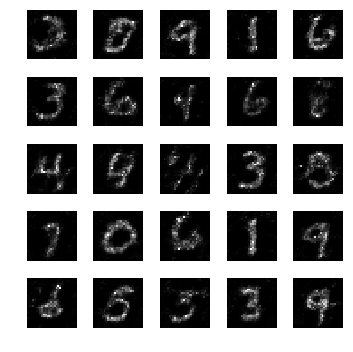

epoch: 721, time: 4.980997 | train_G_Loss: 0.425175, train_D_loss: 2.373387, train_acc: 0.908203
cv_G_Loss: 0.463198, cv_D_loss: 2.341719, cv_acc: 0.906800

epoch: 722, time: 4.969251 | train_G_Loss: 0.420236, train_D_loss: 2.358215, train_acc: 0.900391
cv_G_Loss: 0.852089, cv_D_loss: 2.712515, cv_acc: 0.899400

epoch: 723, time: 4.954853 | train_G_Loss: 0.409735, train_D_loss: 2.275502, train_acc: 0.904297
cv_G_Loss: 0.905344, cv_D_loss: 2.816059, cv_acc: 0.896300

epoch: 724, time: 4.968788 | train_G_Loss: 0.374047, train_D_loss: 2.353806, train_acc: 0.910156
cv_G_Loss: 0.186005, cv_D_loss: 2.597336, cv_acc: 0.907400

epoch: 725, time: 4.959003 | train_G_Loss: 0.398496, train_D_loss: 2.367865, train_acc: 0.919922
cv_G_Loss: 0.357227, cv_D_loss: 2.399325, cv_acc: 0.909100

epoch: 726, time: 4.955566 | train_G_Loss: 0.377501, train_D_loss: 2.197614, train_acc: 0.906250
cv_G_Loss: 0.466477, cv_D_loss: 2.517847, cv_acc: 0.879300

epoch: 727, time: 4.947333 | train_G_Loss: 0.348906, train

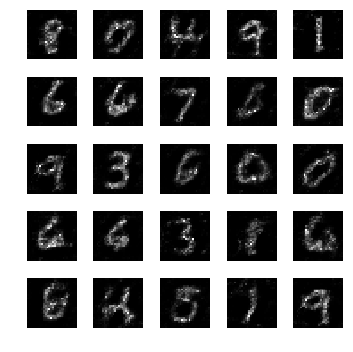

epoch: 731, time: 5.010365 | train_G_Loss: 0.417147, train_D_loss: 2.401670, train_acc: 0.904297
cv_G_Loss: 0.223153, cv_D_loss: 2.574394, cv_acc: 0.896000

epoch: 732, time: 4.981643 | train_G_Loss: 0.485878, train_D_loss: 2.612715, train_acc: 0.904297
cv_G_Loss: 0.204235, cv_D_loss: 2.598882, cv_acc: 0.893500

epoch: 733, time: 4.969019 | train_G_Loss: 0.486810, train_D_loss: 2.284929, train_acc: 0.925781
cv_G_Loss: 0.487500, cv_D_loss: 2.472417, cv_acc: 0.904800

epoch: 734, time: 4.962209 | train_G_Loss: 0.326928, train_D_loss: 2.445277, train_acc: 0.910156
cv_G_Loss: 0.793710, cv_D_loss: 2.692500, cv_acc: 0.902900

epoch: 735, time: 4.967475 | train_G_Loss: 0.374175, train_D_loss: 2.328048, train_acc: 0.916016
cv_G_Loss: 0.253568, cv_D_loss: 2.504545, cv_acc: 0.896100

epoch: 736, time: 4.960333 | train_G_Loss: 0.370163, train_D_loss: 2.404534, train_acc: 0.919922
cv_G_Loss: 0.758252, cv_D_loss: 2.628022, cv_acc: 0.895200

epoch: 737, time: 4.966261 | train_G_Loss: 0.456236, train

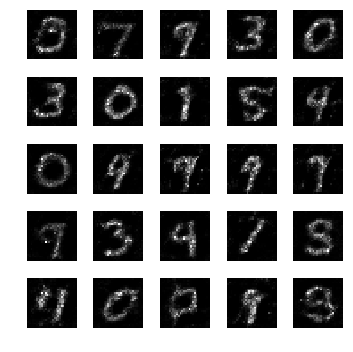

epoch: 741, time: 5.006618 | train_G_Loss: 0.415158, train_D_loss: 2.147064, train_acc: 0.935547
cv_G_Loss: 0.714557, cv_D_loss: 2.548866, cv_acc: 0.907100

epoch: 742, time: 4.961875 | train_G_Loss: 0.360203, train_D_loss: 2.385694, train_acc: 0.943359
cv_G_Loss: 0.309803, cv_D_loss: 2.515051, cv_acc: 0.881600

epoch: 743, time: 4.960688 | train_G_Loss: 0.405464, train_D_loss: 2.707962, train_acc: 0.937500
cv_G_Loss: 0.221954, cv_D_loss: 2.525632, cv_acc: 0.909400

epoch: 744, time: 4.964222 | train_G_Loss: 0.356666, train_D_loss: 2.305033, train_acc: 0.900391
cv_G_Loss: 0.148485, cv_D_loss: 2.816584, cv_acc: 0.887600

epoch: 745, time: 4.963658 | train_G_Loss: 0.349435, train_D_loss: 2.464346, train_acc: 0.916016
cv_G_Loss: 0.319501, cv_D_loss: 2.419039, cv_acc: 0.908500

epoch: 746, time: 4.955089 | train_G_Loss: 0.256142, train_D_loss: 2.522735, train_acc: 0.927734
cv_G_Loss: 0.515037, cv_D_loss: 2.378620, cv_acc: 0.909700

epoch: 747, time: 4.968161 | train_G_Loss: 0.325735, train

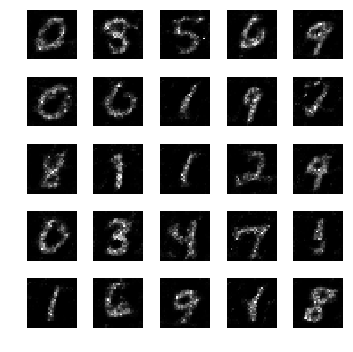

epoch: 751, time: 4.999744 | train_G_Loss: 0.382524, train_D_loss: 2.248206, train_acc: 0.910156
cv_G_Loss: 0.177075, cv_D_loss: 2.741563, cv_acc: 0.885900

epoch: 752, time: 4.956287 | train_G_Loss: 0.308373, train_D_loss: 2.338588, train_acc: 0.914062
cv_G_Loss: 0.374718, cv_D_loss: 2.460747, cv_acc: 0.900700

epoch: 753, time: 4.963831 | train_G_Loss: 0.373516, train_D_loss: 2.380857, train_acc: 0.902344
cv_G_Loss: 0.511137, cv_D_loss: 2.515681, cv_acc: 0.888800

epoch: 754, time: 4.992945 | train_G_Loss: 0.452506, train_D_loss: 2.466195, train_acc: 0.904297
cv_G_Loss: 0.457301, cv_D_loss: 2.587905, cv_acc: 0.872200

epoch: 755, time: 4.966628 | train_G_Loss: 0.365969, train_D_loss: 2.446657, train_acc: 0.884766
cv_G_Loss: 0.187921, cv_D_loss: 2.787241, cv_acc: 0.855500

epoch: 756, time: 4.964556 | train_G_Loss: 0.328968, train_D_loss: 2.225763, train_acc: 0.880859
cv_G_Loss: 1.023519, cv_D_loss: 2.939964, cv_acc: 0.897200

epoch: 757, time: 4.957806 | train_G_Loss: 0.311129, train

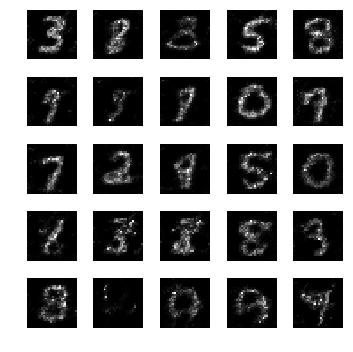

epoch: 761, time: 4.994905 | train_G_Loss: 0.385807, train_D_loss: 2.438180, train_acc: 0.933594
cv_G_Loss: 1.485423, cv_D_loss: 3.776855, cv_acc: 0.897300

epoch: 762, time: 4.967740 | train_G_Loss: 0.386456, train_D_loss: 2.128046, train_acc: 0.949219
cv_G_Loss: 0.358009, cv_D_loss: 2.378639, cv_acc: 0.911200

epoch: 763, time: 4.959387 | train_G_Loss: 0.547390, train_D_loss: 2.289094, train_acc: 0.937500
cv_G_Loss: 0.260046, cv_D_loss: 2.548695, cv_acc: 0.885800

epoch: 764, time: 4.967352 | train_G_Loss: 0.554226, train_D_loss: 2.247975, train_acc: 0.939453
cv_G_Loss: 0.581835, cv_D_loss: 2.514042, cv_acc: 0.902800

epoch: 765, time: 4.958142 | train_G_Loss: 0.372744, train_D_loss: 2.309889, train_acc: 0.898438
cv_G_Loss: 0.321243, cv_D_loss: 2.396307, cv_acc: 0.908700

epoch: 766, time: 4.958251 | train_G_Loss: 0.274843, train_D_loss: 2.606425, train_acc: 0.873047
cv_G_Loss: 0.431483, cv_D_loss: 2.410922, cv_acc: 0.895400

epoch: 767, time: 4.961281 | train_G_Loss: 0.344424, train

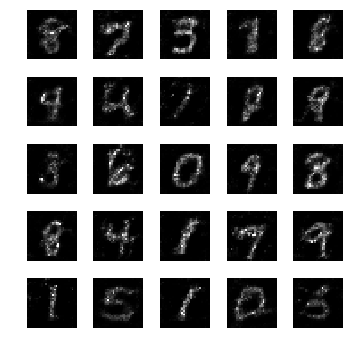

epoch: 771, time: 4.997174 | train_G_Loss: 0.343752, train_D_loss: 2.633606, train_acc: 0.902344
cv_G_Loss: 0.975397, cv_D_loss: 2.976888, cv_acc: 0.899000

epoch: 772, time: 4.961756 | train_G_Loss: 0.449237, train_D_loss: 2.330382, train_acc: 0.919922
cv_G_Loss: 0.753376, cv_D_loss: 2.634616, cv_acc: 0.903800

epoch: 773, time: 4.972585 | train_G_Loss: 0.369853, train_D_loss: 2.212811, train_acc: 0.900391
cv_G_Loss: 0.480446, cv_D_loss: 2.365843, cv_acc: 0.903300

epoch: 774, time: 4.974052 | train_G_Loss: 0.402230, train_D_loss: 2.375889, train_acc: 0.873047
cv_G_Loss: 0.425075, cv_D_loss: 2.376954, cv_acc: 0.907200

epoch: 775, time: 4.965534 | train_G_Loss: 0.370808, train_D_loss: 2.363089, train_acc: 0.875000
cv_G_Loss: 0.185897, cv_D_loss: 2.582336, cv_acc: 0.908700

epoch: 776, time: 4.974305 | train_G_Loss: 0.380582, train_D_loss: 2.526508, train_acc: 0.865234
cv_G_Loss: 0.218410, cv_D_loss: 2.551816, cv_acc: 0.905900

epoch: 777, time: 4.976109 | train_G_Loss: 0.347319, train

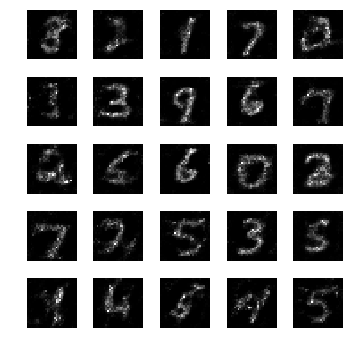

epoch: 781, time: 4.998077 | train_G_Loss: 0.294239, train_D_loss: 2.399202, train_acc: 0.919922
cv_G_Loss: 0.126719, cv_D_loss: 2.889566, cv_acc: 0.903400

epoch: 782, time: 4.970942 | train_G_Loss: 0.377589, train_D_loss: 2.374830, train_acc: 0.929688
cv_G_Loss: 1.214373, cv_D_loss: 3.416209, cv_acc: 0.872200

epoch: 783, time: 4.977357 | train_G_Loss: 0.509940, train_D_loss: 2.419915, train_acc: 0.904297
cv_G_Loss: 0.679002, cv_D_loss: 2.521679, cv_acc: 0.911200

epoch: 784, time: 4.972794 | train_G_Loss: 0.368707, train_D_loss: 2.332039, train_acc: 0.906250
cv_G_Loss: 0.281092, cv_D_loss: 2.421419, cv_acc: 0.906900

epoch: 785, time: 4.969882 | train_G_Loss: 0.400277, train_D_loss: 2.338543, train_acc: 0.919922
cv_G_Loss: 1.503600, cv_D_loss: 3.684277, cv_acc: 0.901500

epoch: 786, time: 4.963561 | train_G_Loss: 0.391229, train_D_loss: 2.253137, train_acc: 0.900391
cv_G_Loss: 0.389234, cv_D_loss: 2.399321, cv_acc: 0.902100

epoch: 787, time: 4.974390 | train_G_Loss: 0.366317, train

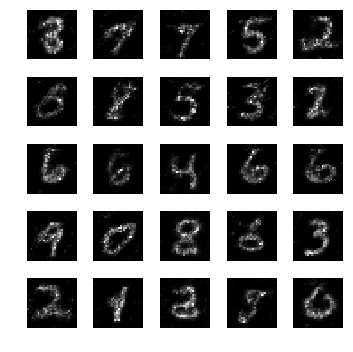

epoch: 791, time: 4.996488 | train_G_Loss: 0.432619, train_D_loss: 2.226447, train_acc: 0.943359
cv_G_Loss: 0.402759, cv_D_loss: 2.444502, cv_acc: 0.899200

epoch: 792, time: 4.956744 | train_G_Loss: 0.447389, train_D_loss: 2.399354, train_acc: 0.917969
cv_G_Loss: 1.304135, cv_D_loss: 3.419719, cv_acc: 0.904000

epoch: 793, time: 4.962313 | train_G_Loss: 0.309905, train_D_loss: 2.539140, train_acc: 0.914062
cv_G_Loss: 0.321949, cv_D_loss: 2.376823, cv_acc: 0.909500

epoch: 794, time: 4.948885 | train_G_Loss: 0.367310, train_D_loss: 2.389024, train_acc: 0.892578
cv_G_Loss: 0.614647, cv_D_loss: 2.457956, cv_acc: 0.907600

epoch: 795, time: 4.965481 | train_G_Loss: 0.537664, train_D_loss: 2.274797, train_acc: 0.925781
cv_G_Loss: 0.344042, cv_D_loss: 2.374309, cv_acc: 0.914600
Model saved

epoch: 796, time: 4.975906 | train_G_Loss: 0.446068, train_D_loss: 2.126209, train_acc: 0.912109
cv_G_Loss: 0.502346, cv_D_loss: 2.546247, cv_acc: 0.893000

epoch: 797, time: 4.948285 | train_G_Loss: 0.3

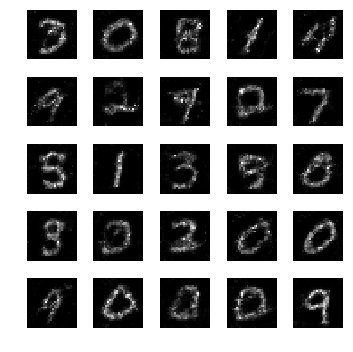

epoch: 801, time: 4.991048 | train_G_Loss: 0.378637, train_D_loss: 2.272417, train_acc: 0.914062
cv_G_Loss: 1.430787, cv_D_loss: 3.631434, cv_acc: 0.894400

epoch: 802, time: 4.936314 | train_G_Loss: 0.265627, train_D_loss: 2.661798, train_acc: 0.886719
cv_G_Loss: 0.407335, cv_D_loss: 2.404210, cv_acc: 0.897400

epoch: 803, time: 4.945343 | train_G_Loss: 0.365099, train_D_loss: 2.663421, train_acc: 0.888672
cv_G_Loss: 0.380427, cv_D_loss: 2.395360, cv_acc: 0.907400

epoch: 804, time: 4.948421 | train_G_Loss: 0.406412, train_D_loss: 2.401081, train_acc: 0.917969
cv_G_Loss: 0.354526, cv_D_loss: 2.391251, cv_acc: 0.909400

epoch: 805, time: 4.939901 | train_G_Loss: 0.348033, train_D_loss: 2.496404, train_acc: 0.925781
cv_G_Loss: 0.308875, cv_D_loss: 2.442329, cv_acc: 0.903800

epoch: 806, time: 4.946726 | train_G_Loss: 0.429894, train_D_loss: 2.298948, train_acc: 0.912109
cv_G_Loss: 1.040290, cv_D_loss: 2.985731, cv_acc: 0.911900

epoch: 807, time: 4.951918 | train_G_Loss: 0.297245, train

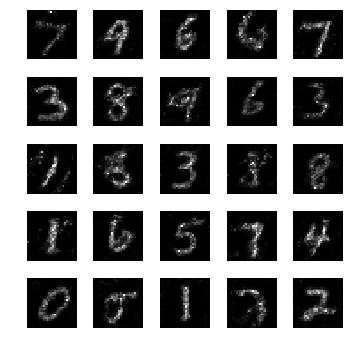

epoch: 811, time: 4.973500 | train_G_Loss: 0.442201, train_D_loss: 2.399018, train_acc: 0.892578
cv_G_Loss: 0.869532, cv_D_loss: 2.808332, cv_acc: 0.883500

epoch: 812, time: 4.946259 | train_G_Loss: 0.419183, train_D_loss: 2.309607, train_acc: 0.912109
cv_G_Loss: 0.789468, cv_D_loss: 2.667673, cv_acc: 0.912000

epoch: 813, time: 4.963641 | train_G_Loss: 0.396302, train_D_loss: 2.222181, train_acc: 0.927734
cv_G_Loss: 0.357491, cv_D_loss: 2.362418, cv_acc: 0.909900

epoch: 814, time: 4.962708 | train_G_Loss: 0.290879, train_D_loss: 2.281481, train_acc: 0.927734
cv_G_Loss: 0.242680, cv_D_loss: 2.511320, cv_acc: 0.910000

epoch: 815, time: 4.956173 | train_G_Loss: 0.326937, train_D_loss: 2.333449, train_acc: 0.919922
cv_G_Loss: 0.700754, cv_D_loss: 2.535173, cv_acc: 0.901500

epoch: 816, time: 4.944943 | train_G_Loss: 0.420583, train_D_loss: 2.385982, train_acc: 0.880859
cv_G_Loss: 0.457275, cv_D_loss: 2.470737, cv_acc: 0.877500

epoch: 817, time: 4.958112 | train_G_Loss: 0.429844, train

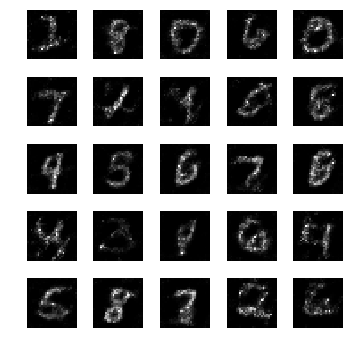

epoch: 821, time: 5.001516 | train_G_Loss: 0.442643, train_D_loss: 2.344535, train_acc: 0.929688
cv_G_Loss: 2.038270, cv_D_loss: 4.725159, cv_acc: 0.892300

epoch: 822, time: 4.950818 | train_G_Loss: 0.419580, train_D_loss: 2.240089, train_acc: 0.916016
cv_G_Loss: 0.494132, cv_D_loss: 2.399415, cv_acc: 0.906000

epoch: 823, time: 4.938036 | train_G_Loss: 0.378657, train_D_loss: 2.361687, train_acc: 0.912109
cv_G_Loss: 0.498933, cv_D_loss: 2.402666, cv_acc: 0.900500

epoch: 824, time: 4.942773 | train_G_Loss: 0.384197, train_D_loss: 2.372228, train_acc: 0.919922
cv_G_Loss: 0.414605, cv_D_loss: 2.369967, cv_acc: 0.914800
Model saved

epoch: 825, time: 4.979726 | train_G_Loss: 0.332022, train_D_loss: 2.352975, train_acc: 0.896484
cv_G_Loss: 0.316411, cv_D_loss: 2.377748, cv_acc: 0.912400

epoch: 826, time: 4.953907 | train_G_Loss: 0.474751, train_D_loss: 2.655296, train_acc: 0.904297
cv_G_Loss: 0.590351, cv_D_loss: 2.458619, cv_acc: 0.909500

epoch: 827, time: 4.960377 | train_G_Loss: 0.3

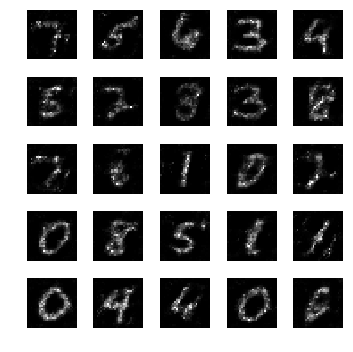

epoch: 831, time: 4.985693 | train_G_Loss: 0.358799, train_D_loss: 2.347517, train_acc: 0.900391
cv_G_Loss: 0.198717, cv_D_loss: 2.538025, cv_acc: 0.913500

epoch: 832, time: 4.968441 | train_G_Loss: 0.331612, train_D_loss: 2.341022, train_acc: 0.906250
cv_G_Loss: 0.267021, cv_D_loss: 2.449256, cv_acc: 0.913200

epoch: 833, time: 4.960798 | train_G_Loss: 0.457314, train_D_loss: 2.402565, train_acc: 0.902344
cv_G_Loss: 0.335224, cv_D_loss: 2.474080, cv_acc: 0.889000

epoch: 834, time: 4.948997 | train_G_Loss: 0.518372, train_D_loss: 2.563965, train_acc: 0.882812
cv_G_Loss: 0.653340, cv_D_loss: 2.495163, cv_acc: 0.912000

epoch: 835, time: 4.953848 | train_G_Loss: 0.312953, train_D_loss: 2.404621, train_acc: 0.869141
cv_G_Loss: 0.379680, cv_D_loss: 2.388710, cv_acc: 0.913500

epoch: 836, time: 4.956975 | train_G_Loss: 0.384852, train_D_loss: 2.597430, train_acc: 0.876953
cv_G_Loss: 0.959385, cv_D_loss: 2.909462, cv_acc: 0.898200

epoch: 837, time: 4.965784 | train_G_Loss: 0.507147, train

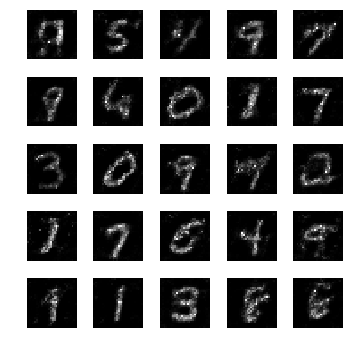

epoch: 841, time: 4.994489 | train_G_Loss: 0.396940, train_D_loss: 2.299204, train_acc: 0.949219
cv_G_Loss: 0.610047, cv_D_loss: 2.545021, cv_acc: 0.903500

epoch: 842, time: 4.963331 | train_G_Loss: 0.535961, train_D_loss: 2.394360, train_acc: 0.919922
cv_G_Loss: 0.443113, cv_D_loss: 2.570922, cv_acc: 0.874500

epoch: 843, time: 4.979178 | train_G_Loss: 0.345700, train_D_loss: 2.240261, train_acc: 0.890625
cv_G_Loss: 0.401403, cv_D_loss: 2.371587, cv_acc: 0.914700

epoch: 844, time: 4.996674 | train_G_Loss: 0.408561, train_D_loss: 2.401333, train_acc: 0.910156
cv_G_Loss: 0.717753, cv_D_loss: 2.585871, cv_acc: 0.909700

epoch: 845, time: 4.979570 | train_G_Loss: 0.406543, train_D_loss: 2.429626, train_acc: 0.927734
cv_G_Loss: 0.885744, cv_D_loss: 2.806670, cv_acc: 0.891400

epoch: 846, time: 4.970975 | train_G_Loss: 0.428792, train_D_loss: 2.431690, train_acc: 0.919922
cv_G_Loss: 1.140928, cv_D_loss: 3.189407, cv_acc: 0.903600

epoch: 847, time: 4.980505 | train_G_Loss: 0.405225, train

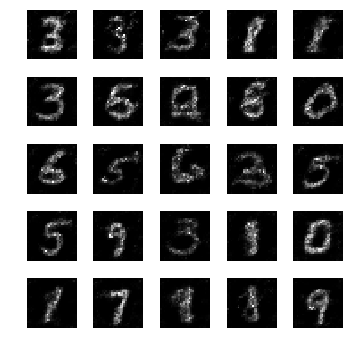

epoch: 851, time: 5.003301 | train_G_Loss: 0.332575, train_D_loss: 2.303476, train_acc: 0.916016
cv_G_Loss: 0.449066, cv_D_loss: 2.478197, cv_acc: 0.888300

epoch: 852, time: 4.955050 | train_G_Loss: 0.449123, train_D_loss: 2.283984, train_acc: 0.878906
cv_G_Loss: 1.846340, cv_D_loss: 4.388113, cv_acc: 0.907000

epoch: 853, time: 4.956378 | train_G_Loss: 0.318445, train_D_loss: 2.508879, train_acc: 0.867188
cv_G_Loss: 0.376503, cv_D_loss: 2.491342, cv_acc: 0.875700

epoch: 854, time: 4.961160 | train_G_Loss: 0.458020, train_D_loss: 2.449383, train_acc: 0.917969
cv_G_Loss: 0.800545, cv_D_loss: 2.746454, cv_acc: 0.910800

epoch: 855, time: 4.952480 | train_G_Loss: 0.383681, train_D_loss: 2.263705, train_acc: 0.923828
cv_G_Loss: 0.396574, cv_D_loss: 2.362753, cv_acc: 0.916800
Model saved

epoch: 856, time: 4.966187 | train_G_Loss: 0.396296, train_D_loss: 2.263527, train_acc: 0.904297
cv_G_Loss: 0.645035, cv_D_loss: 2.655041, cv_acc: 0.872600

epoch: 857, time: 4.935884 | train_G_Loss: 0.5

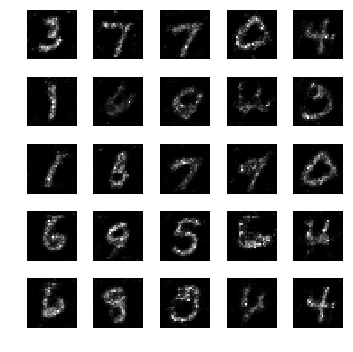

epoch: 861, time: 4.971311 | train_G_Loss: 0.405726, train_D_loss: 2.428686, train_acc: 0.914062
cv_G_Loss: 0.397668, cv_D_loss: 2.330521, cv_acc: 0.918600
Model saved

epoch: 862, time: 4.981355 | train_G_Loss: 0.453743, train_D_loss: 2.323303, train_acc: 0.925781
cv_G_Loss: 0.231998, cv_D_loss: 2.497230, cv_acc: 0.912600

epoch: 863, time: 4.965350 | train_G_Loss: 0.448815, train_D_loss: 2.368627, train_acc: 0.927734
cv_G_Loss: 0.574275, cv_D_loss: 2.448280, cv_acc: 0.908300

epoch: 864, time: 4.962006 | train_G_Loss: 0.389100, train_D_loss: 2.324559, train_acc: 0.923828
cv_G_Loss: 0.628195, cv_D_loss: 2.428668, cv_acc: 0.914600

epoch: 865, time: 4.968107 | train_G_Loss: 0.260444, train_D_loss: 2.380754, train_acc: 0.906250
cv_G_Loss: 0.510550, cv_D_loss: 2.478993, cv_acc: 0.902100

epoch: 866, time: 4.999731 | train_G_Loss: 0.308370, train_D_loss: 2.341659, train_acc: 0.882812
cv_G_Loss: 0.310606, cv_D_loss: 2.402931, cv_acc: 0.909900

epoch: 867, time: 4.970213 | train_G_Loss: 0.4

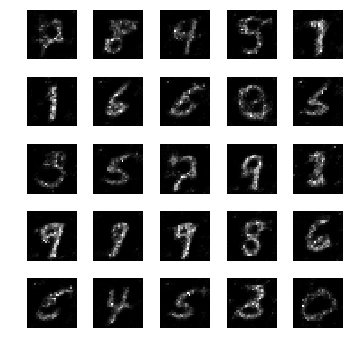

epoch: 871, time: 4.996524 | train_G_Loss: 0.338555, train_D_loss: 2.292084, train_acc: 0.902344
cv_G_Loss: 0.445550, cv_D_loss: 2.360466, cv_acc: 0.907100

epoch: 872, time: 4.954044 | train_G_Loss: 0.372493, train_D_loss: 2.362619, train_acc: 0.912109
cv_G_Loss: 0.380148, cv_D_loss: 2.387461, cv_acc: 0.915500

epoch: 873, time: 4.959452 | train_G_Loss: 0.381347, train_D_loss: 2.445449, train_acc: 0.941406
cv_G_Loss: 0.577079, cv_D_loss: 2.446537, cv_acc: 0.915200

epoch: 874, time: 4.972301 | train_G_Loss: 0.510210, train_D_loss: 2.289267, train_acc: 0.925781
cv_G_Loss: 1.312695, cv_D_loss: 3.647354, cv_acc: 0.894400

epoch: 875, time: 4.965371 | train_G_Loss: 0.407832, train_D_loss: 2.402015, train_acc: 0.906250
cv_G_Loss: 0.619392, cv_D_loss: 2.591961, cv_acc: 0.891800

epoch: 876, time: 4.962245 | train_G_Loss: 0.311457, train_D_loss: 2.467719, train_acc: 0.927734
cv_G_Loss: 0.253966, cv_D_loss: 2.438032, cv_acc: 0.915800

epoch: 877, time: 4.959534 | train_G_Loss: 0.336375, train

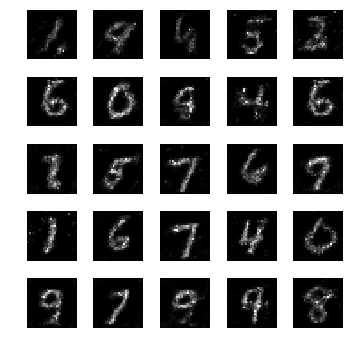

epoch: 881, time: 4.972242 | train_G_Loss: 0.347770, train_D_loss: 2.388420, train_acc: 0.888672
cv_G_Loss: 0.501234, cv_D_loss: 2.380823, cv_acc: 0.917900

epoch: 882, time: 4.938766 | train_G_Loss: 0.335469, train_D_loss: 2.539760, train_acc: 0.886719
cv_G_Loss: 0.202831, cv_D_loss: 2.556413, cv_acc: 0.911000

epoch: 883, time: 4.941345 | train_G_Loss: 0.370210, train_D_loss: 2.281718, train_acc: 0.912109
cv_G_Loss: 0.196309, cv_D_loss: 2.573138, cv_acc: 0.913200

epoch: 884, time: 4.941724 | train_G_Loss: 0.444239, train_D_loss: 2.265727, train_acc: 0.927734
cv_G_Loss: 0.731894, cv_D_loss: 2.605533, cv_acc: 0.911700

epoch: 885, time: 4.971283 | train_G_Loss: 0.434374, train_D_loss: 2.205358, train_acc: 0.914062
cv_G_Loss: 0.423332, cv_D_loss: 2.362016, cv_acc: 0.915000

epoch: 886, time: 4.939421 | train_G_Loss: 0.415752, train_D_loss: 2.174494, train_acc: 0.894531
cv_G_Loss: 0.296664, cv_D_loss: 2.370101, cv_acc: 0.916500

epoch: 887, time: 4.944831 | train_G_Loss: 0.349406, train

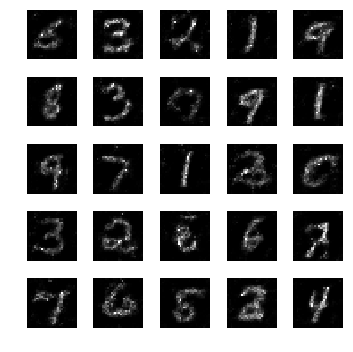

epoch: 891, time: 4.981596 | train_G_Loss: 0.379613, train_D_loss: 2.443201, train_acc: 0.904297
cv_G_Loss: 0.992853, cv_D_loss: 3.026384, cv_acc: 0.897800

epoch: 892, time: 4.945715 | train_G_Loss: 0.330589, train_D_loss: 2.277925, train_acc: 0.896484
cv_G_Loss: 1.563852, cv_D_loss: 3.723106, cv_acc: 0.865200

epoch: 893, time: 4.947606 | train_G_Loss: 0.322894, train_D_loss: 2.371551, train_acc: 0.882812
cv_G_Loss: 0.461864, cv_D_loss: 2.484590, cv_acc: 0.880700

epoch: 894, time: 4.951829 | train_G_Loss: 0.409073, train_D_loss: 2.264836, train_acc: 0.865234
cv_G_Loss: 0.451096, cv_D_loss: 2.403274, cv_acc: 0.910600

epoch: 895, time: 4.951985 | train_G_Loss: 0.503218, train_D_loss: 2.241490, train_acc: 0.914062
cv_G_Loss: 0.854039, cv_D_loss: 2.780171, cv_acc: 0.903100

epoch: 896, time: 4.950543 | train_G_Loss: 0.418576, train_D_loss: 2.409311, train_acc: 0.900391
cv_G_Loss: 0.670006, cv_D_loss: 2.530575, cv_acc: 0.915600

epoch: 897, time: 4.957640 | train_G_Loss: 0.274686, train

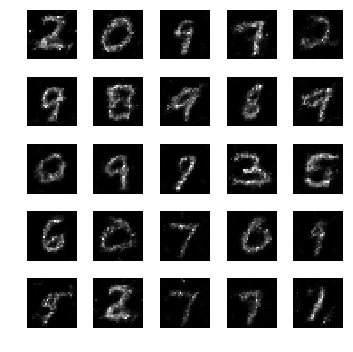

epoch: 901, time: 4.982597 | train_G_Loss: 0.665469, train_D_loss: 2.446012, train_acc: 0.935547
cv_G_Loss: 0.830797, cv_D_loss: 2.752531, cv_acc: 0.889200

epoch: 902, time: 4.943790 | train_G_Loss: 0.360356, train_D_loss: 2.259782, train_acc: 0.902344
cv_G_Loss: 0.464061, cv_D_loss: 2.359089, cv_acc: 0.913700

epoch: 903, time: 4.938231 | train_G_Loss: 0.394353, train_D_loss: 2.564212, train_acc: 0.914062
cv_G_Loss: 0.444677, cv_D_loss: 2.392430, cv_acc: 0.907800

epoch: 904, time: 4.957865 | train_G_Loss: 0.335544, train_D_loss: 2.345247, train_acc: 0.908203
cv_G_Loss: 0.661085, cv_D_loss: 2.543987, cv_acc: 0.902800

epoch: 905, time: 4.946821 | train_G_Loss: 0.276846, train_D_loss: 2.614718, train_acc: 0.869141
cv_G_Loss: 0.254885, cv_D_loss: 2.409694, cv_acc: 0.920200
Model saved

epoch: 906, time: 4.994886 | train_G_Loss: 0.463607, train_D_loss: 2.439599, train_acc: 0.919922
cv_G_Loss: 0.430874, cv_D_loss: 2.368217, cv_acc: 0.919000

epoch: 907, time: 4.960184 | train_G_Loss: 0.4

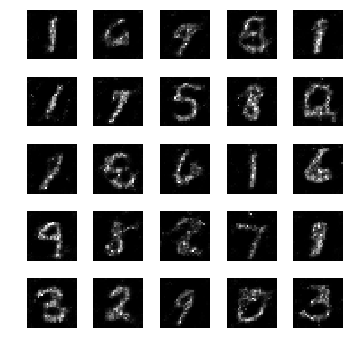

epoch: 911, time: 5.019876 | train_G_Loss: 0.495294, train_D_loss: 2.223405, train_acc: 0.921875
cv_G_Loss: 2.101037, cv_D_loss: 4.841851, cv_acc: 0.861200

epoch: 912, time: 4.958851 | train_G_Loss: 0.418348, train_D_loss: 2.199187, train_acc: 0.921875
cv_G_Loss: 0.752427, cv_D_loss: 2.623200, cv_acc: 0.914500

epoch: 913, time: 4.953464 | train_G_Loss: 0.459743, train_D_loss: 2.195658, train_acc: 0.935547
cv_G_Loss: 0.675001, cv_D_loss: 2.569484, cv_acc: 0.911900

epoch: 914, time: 4.940652 | train_G_Loss: 0.381541, train_D_loss: 2.356338, train_acc: 0.941406
cv_G_Loss: 0.622510, cv_D_loss: 2.520953, cv_acc: 0.911100

epoch: 915, time: 4.946982 | train_G_Loss: 0.333886, train_D_loss: 2.289769, train_acc: 0.937500
cv_G_Loss: 0.235373, cv_D_loss: 2.423323, cv_acc: 0.919200

epoch: 916, time: 4.959808 | train_G_Loss: 0.405634, train_D_loss: 2.167888, train_acc: 0.949219
cv_G_Loss: 0.558888, cv_D_loss: 2.411390, cv_acc: 0.916700

epoch: 917, time: 4.953480 | train_G_Loss: 0.426658, train

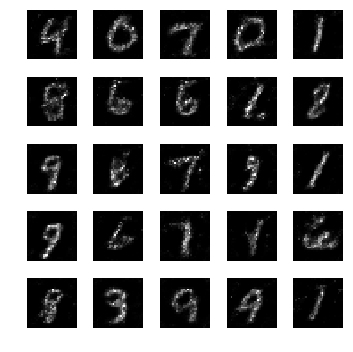

epoch: 921, time: 4.982207 | train_G_Loss: 0.313605, train_D_loss: 2.288095, train_acc: 0.917969
cv_G_Loss: 0.238129, cv_D_loss: 2.454565, cv_acc: 0.917900

epoch: 922, time: 4.966118 | train_G_Loss: 0.373624, train_D_loss: 2.540610, train_acc: 0.951172
cv_G_Loss: 0.437462, cv_D_loss: 2.344532, cv_acc: 0.903700

epoch: 923, time: 4.944485 | train_G_Loss: 0.415401, train_D_loss: 2.122512, train_acc: 0.958984
cv_G_Loss: 0.167075, cv_D_loss: 2.660248, cv_acc: 0.913300

epoch: 924, time: 4.946656 | train_G_Loss: 0.437056, train_D_loss: 2.205674, train_acc: 0.949219
cv_G_Loss: 1.082366, cv_D_loss: 2.962958, cv_acc: 0.916100

epoch: 925, time: 4.948085 | train_G_Loss: 0.331042, train_D_loss: 2.253341, train_acc: 0.962891
cv_G_Loss: 0.241104, cv_D_loss: 2.466420, cv_acc: 0.909600

epoch: 926, time: 4.940623 | train_G_Loss: 0.434182, train_D_loss: 2.060868, train_acc: 0.962891
cv_G_Loss: 0.349419, cv_D_loss: 2.397326, cv_acc: 0.909900

epoch: 927, time: 4.948618 | train_G_Loss: 0.299540, train

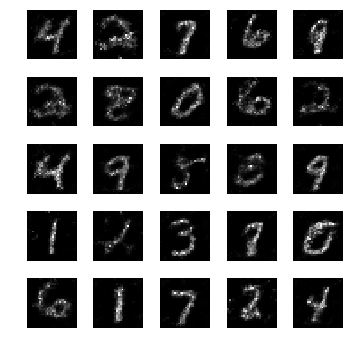

epoch: 931, time: 4.979158 | train_G_Loss: 0.360789, train_D_loss: 2.374140, train_acc: 0.923828
cv_G_Loss: 0.742214, cv_D_loss: 2.602690, cv_acc: 0.909300

epoch: 932, time: 4.952853 | train_G_Loss: 0.365303, train_D_loss: 2.356532, train_acc: 0.939453
cv_G_Loss: 0.380404, cv_D_loss: 2.355073, cv_acc: 0.918200

epoch: 933, time: 4.953582 | train_G_Loss: 0.373215, train_D_loss: 2.248064, train_acc: 0.949219
cv_G_Loss: 0.220197, cv_D_loss: 2.449695, cv_acc: 0.920600
Model saved

epoch: 934, time: 5.018849 | train_G_Loss: 0.398964, train_D_loss: 2.364242, train_acc: 0.927734
cv_G_Loss: 0.250717, cv_D_loss: 2.454122, cv_acc: 0.917200

epoch: 935, time: 4.954485 | train_G_Loss: 0.406820, train_D_loss: 2.148010, train_acc: 0.896484
cv_G_Loss: 0.357264, cv_D_loss: 2.523618, cv_acc: 0.878100

epoch: 936, time: 4.970999 | train_G_Loss: 0.310098, train_D_loss: 2.519321, train_acc: 0.882812
cv_G_Loss: 0.435474, cv_D_loss: 2.500279, cv_acc: 0.894800

epoch: 937, time: 4.959735 | train_G_Loss: 0.3

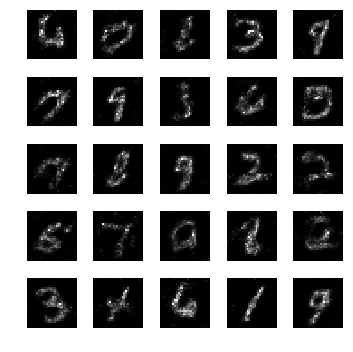

epoch: 941, time: 4.968761 | train_G_Loss: 0.431544, train_D_loss: 2.246839, train_acc: 0.890625
cv_G_Loss: 0.268403, cv_D_loss: 2.455873, cv_acc: 0.908000

epoch: 942, time: 4.950155 | train_G_Loss: 0.353270, train_D_loss: 2.486958, train_acc: 0.886719
cv_G_Loss: 0.302310, cv_D_loss: 2.524582, cv_acc: 0.891400

epoch: 943, time: 4.952093 | train_G_Loss: 0.307088, train_D_loss: 2.363094, train_acc: 0.921875
cv_G_Loss: 0.329102, cv_D_loss: 2.687372, cv_acc: 0.840800

epoch: 944, time: 4.960711 | train_G_Loss: 0.318510, train_D_loss: 2.454950, train_acc: 0.916016
cv_G_Loss: 0.151153, cv_D_loss: 2.838734, cv_acc: 0.879400

epoch: 945, time: 4.958340 | train_G_Loss: 0.368165, train_D_loss: 2.284632, train_acc: 0.937500
cv_G_Loss: 0.359177, cv_D_loss: 2.363005, cv_acc: 0.906000

epoch: 946, time: 4.956550 | train_G_Loss: 0.511528, train_D_loss: 2.193889, train_acc: 0.916016
cv_G_Loss: 0.423486, cv_D_loss: 2.480052, cv_acc: 0.895200

epoch: 947, time: 4.950721 | train_G_Loss: 0.449648, train

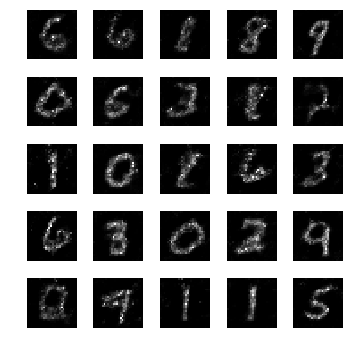

epoch: 951, time: 4.984404 | train_G_Loss: 0.376392, train_D_loss: 2.170643, train_acc: 0.892578
cv_G_Loss: 0.774585, cv_D_loss: 3.135751, cv_acc: 0.755300

epoch: 952, time: 4.962633 | train_G_Loss: 0.333761, train_D_loss: 2.574576, train_acc: 0.886719
cv_G_Loss: 1.213612, cv_D_loss: 3.117691, cv_acc: 0.912700

epoch: 953, time: 4.954127 | train_G_Loss: 0.424160, train_D_loss: 2.372560, train_acc: 0.912109
cv_G_Loss: 0.419764, cv_D_loss: 2.409416, cv_acc: 0.913900

epoch: 954, time: 4.963807 | train_G_Loss: 0.396678, train_D_loss: 2.434045, train_acc: 0.892578
cv_G_Loss: 0.329509, cv_D_loss: 2.427546, cv_acc: 0.900500

epoch: 955, time: 4.948227 | train_G_Loss: 0.354102, train_D_loss: 2.543491, train_acc: 0.900391
cv_G_Loss: 0.329692, cv_D_loss: 2.340034, cv_acc: 0.920900
Model saved

epoch: 956, time: 5.020084 | train_G_Loss: 0.595878, train_D_loss: 2.505677, train_acc: 0.906250
cv_G_Loss: 1.036437, cv_D_loss: 3.016840, cv_acc: 0.910900

epoch: 957, time: 4.954565 | train_G_Loss: 0.3

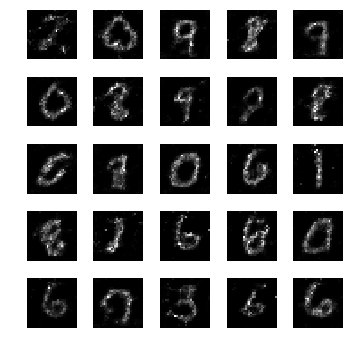

epoch: 961, time: 4.980328 | train_G_Loss: 0.355108, train_D_loss: 2.448794, train_acc: 0.871094
cv_G_Loss: 0.300704, cv_D_loss: 2.396839, cv_acc: 0.910700

epoch: 962, time: 4.952864 | train_G_Loss: 0.318136, train_D_loss: 2.691257, train_acc: 0.875000
cv_G_Loss: 0.493209, cv_D_loss: 2.441152, cv_acc: 0.902400

epoch: 963, time: 4.943459 | train_G_Loss: 0.535125, train_D_loss: 2.426314, train_acc: 0.935547
cv_G_Loss: 1.248357, cv_D_loss: 3.336358, cv_acc: 0.907300

epoch: 964, time: 4.952025 | train_G_Loss: 0.373813, train_D_loss: 2.352399, train_acc: 0.937500
cv_G_Loss: 0.529650, cv_D_loss: 2.378007, cv_acc: 0.919500

epoch: 965, time: 4.961746 | train_G_Loss: 0.397653, train_D_loss: 2.306059, train_acc: 0.908203
cv_G_Loss: 0.389362, cv_D_loss: 2.338103, cv_acc: 0.919100

epoch: 966, time: 4.950240 | train_G_Loss: 0.315845, train_D_loss: 2.730623, train_acc: 0.896484
cv_G_Loss: 0.220163, cv_D_loss: 2.479764, cv_acc: 0.921600
Model saved

epoch: 967, time: 5.013401 | train_G_Loss: 0.3

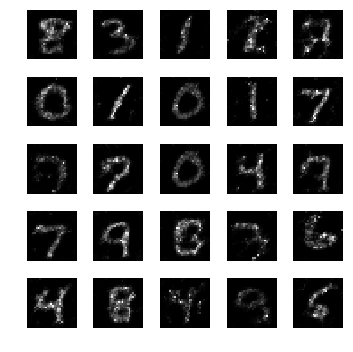

epoch: 971, time: 5.009385 | train_G_Loss: 0.448334, train_D_loss: 2.532681, train_acc: 0.921875
cv_G_Loss: 0.905248, cv_D_loss: 2.830453, cv_acc: 0.910000

epoch: 972, time: 4.982851 | train_G_Loss: 0.317422, train_D_loss: 2.440479, train_acc: 0.908203
cv_G_Loss: 0.359652, cv_D_loss: 2.452895, cv_acc: 0.886400

epoch: 973, time: 4.966087 | train_G_Loss: 0.412455, train_D_loss: 2.417654, train_acc: 0.921875
cv_G_Loss: 0.630864, cv_D_loss: 2.478728, cv_acc: 0.914300

epoch: 974, time: 4.961463 | train_G_Loss: 0.515628, train_D_loss: 2.262521, train_acc: 0.943359
cv_G_Loss: 0.479114, cv_D_loss: 2.365072, cv_acc: 0.911900

epoch: 975, time: 4.966117 | train_G_Loss: 0.330344, train_D_loss: 2.430491, train_acc: 0.931641
cv_G_Loss: 0.690547, cv_D_loss: 2.680156, cv_acc: 0.857300

epoch: 976, time: 4.982615 | train_G_Loss: 0.424653, train_D_loss: 2.347455, train_acc: 0.943359
cv_G_Loss: 0.638103, cv_D_loss: 2.559054, cv_acc: 0.911100

epoch: 977, time: 4.977864 | train_G_Loss: 0.414835, train

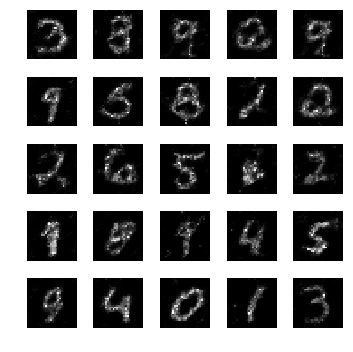

epoch: 981, time: 5.011181 | train_G_Loss: 0.288434, train_D_loss: 2.582787, train_acc: 0.917969
cv_G_Loss: 0.406682, cv_D_loss: 2.462796, cv_acc: 0.884500

epoch: 982, time: 4.981207 | train_G_Loss: 0.529060, train_D_loss: 2.136826, train_acc: 0.900391
cv_G_Loss: 0.392465, cv_D_loss: 2.438200, cv_acc: 0.902900

epoch: 983, time: 4.962676 | train_G_Loss: 0.385024, train_D_loss: 2.405686, train_acc: 0.906250
cv_G_Loss: 1.004330, cv_D_loss: 3.038937, cv_acc: 0.905700

epoch: 984, time: 4.977502 | train_G_Loss: 0.359365, train_D_loss: 2.188745, train_acc: 0.947266
cv_G_Loss: 0.443735, cv_D_loss: 2.358041, cv_acc: 0.912400

epoch: 985, time: 4.972628 | train_G_Loss: 0.362409, train_D_loss: 2.424409, train_acc: 0.941406
cv_G_Loss: 0.617182, cv_D_loss: 2.393388, cv_acc: 0.915500

epoch: 986, time: 4.962610 | train_G_Loss: 0.474583, train_D_loss: 2.291433, train_acc: 0.943359
cv_G_Loss: 1.295887, cv_D_loss: 3.385748, cv_acc: 0.904700

epoch: 987, time: 4.971801 | train_G_Loss: 0.411631, train

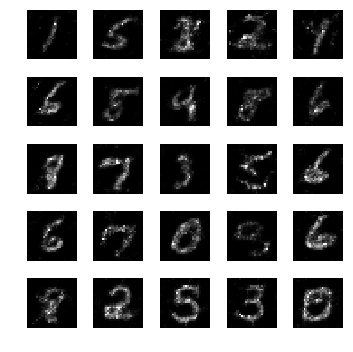

epoch: 991, time: 5.007051 | train_G_Loss: 0.434511, train_D_loss: 2.212665, train_acc: 0.933594
cv_G_Loss: 0.796602, cv_D_loss: 2.740462, cv_acc: 0.879600

epoch: 992, time: 4.992532 | train_G_Loss: 0.368758, train_D_loss: 2.305344, train_acc: 0.914062
cv_G_Loss: 1.640146, cv_D_loss: 4.156869, cv_acc: 0.871100

epoch: 993, time: 4.979818 | train_G_Loss: 0.377706, train_D_loss: 2.413159, train_acc: 0.919922
cv_G_Loss: 0.347640, cv_D_loss: 2.374612, cv_acc: 0.912300

epoch: 994, time: 4.977932 | train_G_Loss: 0.389576, train_D_loss: 2.370838, train_acc: 0.912109
cv_G_Loss: 0.601644, cv_D_loss: 2.428446, cv_acc: 0.921800
Model saved

epoch: 995, time: 5.002251 | train_G_Loss: 0.387689, train_D_loss: 2.251963, train_acc: 0.908203
cv_G_Loss: 0.565877, cv_D_loss: 2.388210, cv_acc: 0.918100

epoch: 996, time: 4.968090 | train_G_Loss: 0.363309, train_D_loss: 2.516023, train_acc: 0.890625
cv_G_Loss: 0.343898, cv_D_loss: 2.354768, cv_acc: 0.918300

epoch: 997, time: 4.974303 | train_G_Loss: 0.4

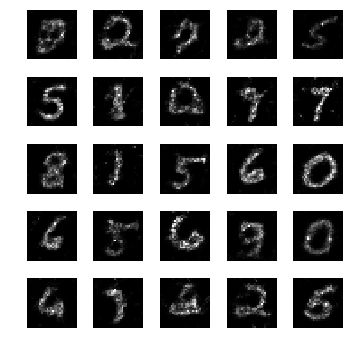

epoch: 1001, time: 5.017473 | train_G_Loss: 0.365492, train_D_loss: 2.198084, train_acc: 0.927734
cv_G_Loss: 0.722428, cv_D_loss: 2.534571, cv_acc: 0.910100

epoch: 1002, time: 4.976078 | train_G_Loss: 0.394557, train_D_loss: 2.608731, train_acc: 0.890625
cv_G_Loss: 0.555698, cv_D_loss: 2.482592, cv_acc: 0.904200

epoch: 1003, time: 4.972500 | train_G_Loss: 0.337053, train_D_loss: 2.344002, train_acc: 0.914062
cv_G_Loss: 0.215567, cv_D_loss: 2.624191, cv_acc: 0.880600

epoch: 1004, time: 4.959881 | train_G_Loss: 0.416677, train_D_loss: 2.269305, train_acc: 0.921875
cv_G_Loss: 0.483370, cv_D_loss: 2.342848, cv_acc: 0.921600

epoch: 1005, time: 4.975099 | train_G_Loss: 0.402699, train_D_loss: 2.310708, train_acc: 0.941406
cv_G_Loss: 0.572179, cv_D_loss: 2.392921, cv_acc: 0.922000

epoch: 1006, time: 4.963069 | train_G_Loss: 0.412638, train_D_loss: 2.188158, train_acc: 0.927734
cv_G_Loss: 1.752939, cv_D_loss: 4.215022, cv_acc: 0.901000

epoch: 1007, time: 4.973502 | train_G_Loss: 0.420166

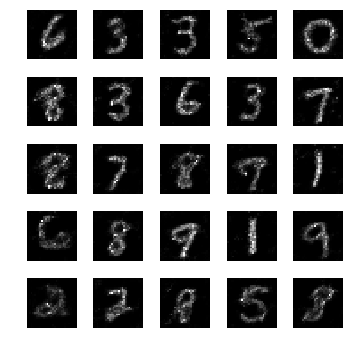

epoch: 1011, time: 4.998067 | train_G_Loss: 0.422109, train_D_loss: 2.363484, train_acc: 0.910156
cv_G_Loss: 0.385339, cv_D_loss: 2.442532, cv_acc: 0.904000

epoch: 1012, time: 4.973512 | train_G_Loss: 0.427390, train_D_loss: 2.382313, train_acc: 0.921875
cv_G_Loss: 0.583395, cv_D_loss: 2.429493, cv_acc: 0.910700

epoch: 1013, time: 5.001835 | train_G_Loss: 0.350222, train_D_loss: 2.453447, train_acc: 0.890625
cv_G_Loss: 1.524035, cv_D_loss: 3.768531, cv_acc: 0.893300

epoch: 1014, time: 4.969735 | train_G_Loss: 0.322470, train_D_loss: 2.549937, train_acc: 0.896484
cv_G_Loss: 0.384652, cv_D_loss: 2.367907, cv_acc: 0.912000

epoch: 1015, time: 4.968731 | train_G_Loss: 0.437516, train_D_loss: 2.244588, train_acc: 0.912109
cv_G_Loss: 0.297753, cv_D_loss: 2.445300, cv_acc: 0.911700

epoch: 1016, time: 4.972281 | train_G_Loss: 0.334019, train_D_loss: 2.398320, train_acc: 0.902344
cv_G_Loss: 0.420181, cv_D_loss: 2.311560, cv_acc: 0.920600

epoch: 1017, time: 4.971339 | train_G_Loss: 0.487586

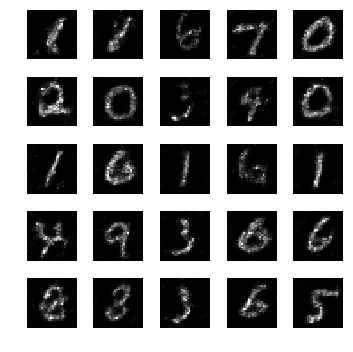

epoch: 1021, time: 4.995173 | train_G_Loss: 0.282602, train_D_loss: 2.512980, train_acc: 0.869141
cv_G_Loss: 0.201338, cv_D_loss: 2.499616, cv_acc: 0.916400

epoch: 1022, time: 4.978568 | train_G_Loss: 0.431685, train_D_loss: 2.476821, train_acc: 0.886719
cv_G_Loss: 1.391764, cv_D_loss: 3.617342, cv_acc: 0.904600

epoch: 1023, time: 5.005715 | train_G_Loss: 0.431736, train_D_loss: 2.174441, train_acc: 0.931641
cv_G_Loss: 0.851958, cv_D_loss: 2.662024, cv_acc: 0.908000

epoch: 1024, time: 4.989983 | train_G_Loss: 0.369887, train_D_loss: 2.372433, train_acc: 0.923828
cv_G_Loss: 2.083506, cv_D_loss: 4.940895, cv_acc: 0.863400

epoch: 1025, time: 4.964117 | train_G_Loss: 0.395279, train_D_loss: 2.374825, train_acc: 0.912109
cv_G_Loss: 0.433326, cv_D_loss: 2.365315, cv_acc: 0.912300

epoch: 1026, time: 4.964815 | train_G_Loss: 0.306878, train_D_loss: 2.357920, train_acc: 0.937500
cv_G_Loss: 0.083388, cv_D_loss: 3.154160, cv_acc: 0.908100

epoch: 1027, time: 4.977923 | train_G_Loss: 0.390533

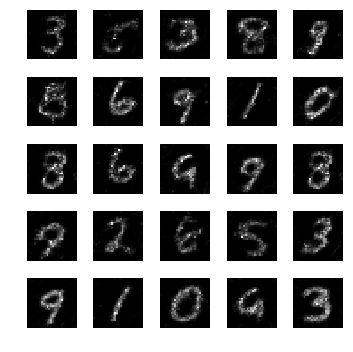

epoch: 1031, time: 4.969402 | train_G_Loss: 0.479326, train_D_loss: 2.162339, train_acc: 0.939453
cv_G_Loss: 0.616344, cv_D_loss: 2.661180, cv_acc: 0.874700

epoch: 1032, time: 4.948556 | train_G_Loss: 0.505615, train_D_loss: 2.196784, train_acc: 0.933594
cv_G_Loss: 0.854760, cv_D_loss: 2.812995, cv_acc: 0.897100

epoch: 1033, time: 4.957317 | train_G_Loss: 0.370427, train_D_loss: 2.161142, train_acc: 0.931641
cv_G_Loss: 0.301783, cv_D_loss: 2.388727, cv_acc: 0.909800

epoch: 1034, time: 4.966487 | train_G_Loss: 0.364901, train_D_loss: 2.298146, train_acc: 0.929688
cv_G_Loss: 0.170338, cv_D_loss: 2.609843, cv_acc: 0.922100

epoch: 1035, time: 4.955554 | train_G_Loss: 0.458454, train_D_loss: 2.274981, train_acc: 0.929688
cv_G_Loss: 0.508420, cv_D_loss: 2.392640, cv_acc: 0.923700

epoch: 1036, time: 4.965481 | train_G_Loss: 0.314502, train_D_loss: 2.356143, train_acc: 0.929688
cv_G_Loss: 0.545876, cv_D_loss: 2.529222, cv_acc: 0.893400

epoch: 1037, time: 4.943419 | train_G_Loss: 0.418807

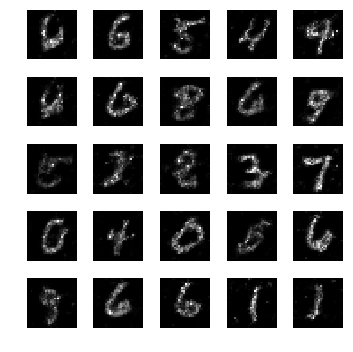

epoch: 1041, time: 4.980705 | train_G_Loss: 0.310137, train_D_loss: 2.360766, train_acc: 0.921875
cv_G_Loss: 0.622975, cv_D_loss: 2.861473, cv_acc: 0.825000

epoch: 1042, time: 4.955843 | train_G_Loss: 0.355913, train_D_loss: 2.398397, train_acc: 0.900391
cv_G_Loss: 0.617551, cv_D_loss: 2.471139, cv_acc: 0.917800

epoch: 1043, time: 4.962737 | train_G_Loss: 0.434179, train_D_loss: 2.434800, train_acc: 0.923828
cv_G_Loss: 0.837592, cv_D_loss: 2.712734, cv_acc: 0.907900

epoch: 1044, time: 4.960512 | train_G_Loss: 0.390103, train_D_loss: 2.155881, train_acc: 0.951172
cv_G_Loss: 1.106723, cv_D_loss: 3.103677, cv_acc: 0.913300

epoch: 1045, time: 4.959398 | train_G_Loss: 0.317279, train_D_loss: 2.313672, train_acc: 0.914062
cv_G_Loss: 0.700160, cv_D_loss: 2.532396, cv_acc: 0.916000

epoch: 1046, time: 4.995248 | train_G_Loss: 0.379570, train_D_loss: 2.577867, train_acc: 0.923828
cv_G_Loss: 0.650650, cv_D_loss: 2.499634, cv_acc: 0.916300

epoch: 1047, time: 4.966674 | train_G_Loss: 0.472829

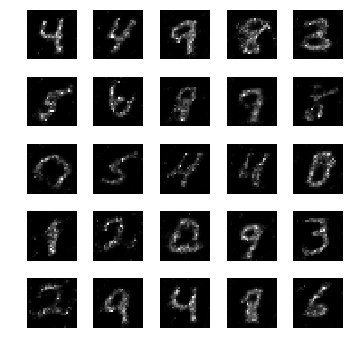

epoch: 1051, time: 4.978714 | train_G_Loss: 0.345032, train_D_loss: 2.185677, train_acc: 0.908203
cv_G_Loss: 0.848777, cv_D_loss: 3.021240, cv_acc: 0.829400

epoch: 1052, time: 4.953570 | train_G_Loss: 0.392560, train_D_loss: 2.266417, train_acc: 0.900391
cv_G_Loss: 0.893391, cv_D_loss: 2.766508, cv_acc: 0.916600

epoch: 1053, time: 4.952649 | train_G_Loss: 0.362266, train_D_loss: 2.307083, train_acc: 0.931641
cv_G_Loss: 0.535412, cv_D_loss: 2.363838, cv_acc: 0.921700

epoch: 1054, time: 4.962481 | train_G_Loss: 0.371018, train_D_loss: 2.396597, train_acc: 0.912109
cv_G_Loss: 0.537634, cv_D_loss: 2.388647, cv_acc: 0.920800

epoch: 1055, time: 4.967641 | train_G_Loss: 0.471136, train_D_loss: 2.336797, train_acc: 0.888672
cv_G_Loss: 0.323751, cv_D_loss: 2.474617, cv_acc: 0.902400

epoch: 1056, time: 4.949127 | train_G_Loss: 0.329347, train_D_loss: 2.338967, train_acc: 0.916016
cv_G_Loss: 0.918955, cv_D_loss: 3.032007, cv_acc: 0.876800

epoch: 1057, time: 4.958969 | train_G_Loss: 0.295838

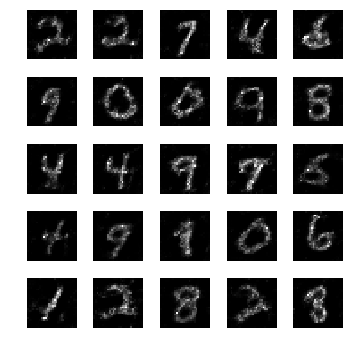

epoch: 1061, time: 4.999337 | train_G_Loss: 0.520782, train_D_loss: 2.298224, train_acc: 0.919922
cv_G_Loss: 0.688466, cv_D_loss: 2.569012, cv_acc: 0.924100

epoch: 1062, time: 4.965665 | train_G_Loss: 0.360826, train_D_loss: 2.305103, train_acc: 0.935547
cv_G_Loss: 0.336620, cv_D_loss: 2.301130, cv_acc: 0.925900
Model saved

epoch: 1063, time: 4.985133 | train_G_Loss: 0.450839, train_D_loss: 2.304566, train_acc: 0.939453
cv_G_Loss: 0.641084, cv_D_loss: 2.461927, cv_acc: 0.917400

epoch: 1064, time: 4.990618 | train_G_Loss: 0.346530, train_D_loss: 2.317125, train_acc: 0.912109
cv_G_Loss: 0.506761, cv_D_loss: 2.549893, cv_acc: 0.880200

epoch: 1065, time: 4.962133 | train_G_Loss: 0.373287, train_D_loss: 2.554315, train_acc: 0.916016
cv_G_Loss: 0.675244, cv_D_loss: 2.470996, cv_acc: 0.922200

epoch: 1066, time: 4.941298 | train_G_Loss: 0.445828, train_D_loss: 2.170504, train_acc: 0.916016
cv_G_Loss: 0.820202, cv_D_loss: 2.646014, cv_acc: 0.917200

epoch: 1067, time: 4.949766 | train_G_Lo

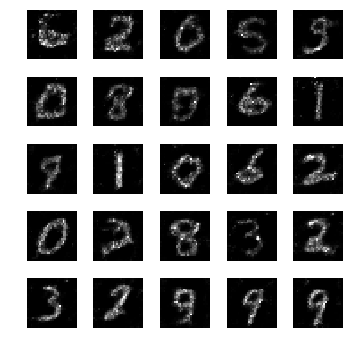

epoch: 1071, time: 4.994163 | train_G_Loss: 0.441260, train_D_loss: 2.245085, train_acc: 0.900391
cv_G_Loss: 0.664665, cv_D_loss: 2.707789, cv_acc: 0.884500

epoch: 1072, time: 4.962152 | train_G_Loss: 0.436929, train_D_loss: 2.233649, train_acc: 0.904297
cv_G_Loss: 0.606987, cv_D_loss: 2.453539, cv_acc: 0.913200

epoch: 1073, time: 4.964590 | train_G_Loss: 0.370414, train_D_loss: 2.333617, train_acc: 0.917969
cv_G_Loss: 0.905206, cv_D_loss: 2.875064, cv_acc: 0.900800

epoch: 1074, time: 4.965336 | train_G_Loss: 0.367246, train_D_loss: 2.273124, train_acc: 0.931641
cv_G_Loss: 1.051229, cv_D_loss: 3.051151, cv_acc: 0.896300

epoch: 1075, time: 4.958189 | train_G_Loss: 0.379183, train_D_loss: 2.268895, train_acc: 0.935547
cv_G_Loss: 0.398933, cv_D_loss: 2.339427, cv_acc: 0.918400

epoch: 1076, time: 4.945262 | train_G_Loss: 0.459384, train_D_loss: 2.275159, train_acc: 0.929688
cv_G_Loss: 0.522163, cv_D_loss: 2.524033, cv_acc: 0.887500

epoch: 1077, time: 4.963230 | train_G_Loss: 0.460349

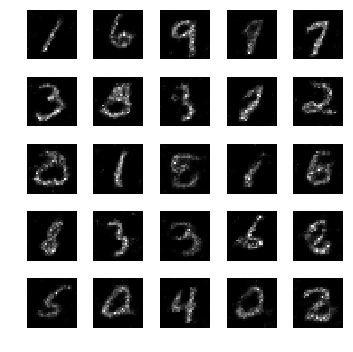

epoch: 1081, time: 4.989695 | train_G_Loss: 0.378084, train_D_loss: 2.288615, train_acc: 0.925781
cv_G_Loss: 1.907092, cv_D_loss: 4.697815, cv_acc: 0.825400

epoch: 1082, time: 4.952265 | train_G_Loss: 0.426564, train_D_loss: 2.344233, train_acc: 0.906250
cv_G_Loss: 1.277840, cv_D_loss: 3.460246, cv_acc: 0.909800

epoch: 1083, time: 4.959729 | train_G_Loss: 0.278817, train_D_loss: 2.600517, train_acc: 0.894531
cv_G_Loss: 0.473010, cv_D_loss: 2.376845, cv_acc: 0.907900

epoch: 1084, time: 4.962375 | train_G_Loss: 0.411413, train_D_loss: 2.244359, train_acc: 0.929688
cv_G_Loss: 1.835895, cv_D_loss: 4.289670, cv_acc: 0.902500

epoch: 1085, time: 4.958264 | train_G_Loss: 0.410846, train_D_loss: 2.201567, train_acc: 0.937500
cv_G_Loss: 0.831931, cv_D_loss: 2.770766, cv_acc: 0.913700

epoch: 1086, time: 4.957158 | train_G_Loss: 0.454975, train_D_loss: 2.426728, train_acc: 0.941406
cv_G_Loss: 0.606693, cv_D_loss: 2.404656, cv_acc: 0.924200

epoch: 1087, time: 4.952481 | train_G_Loss: 0.469889

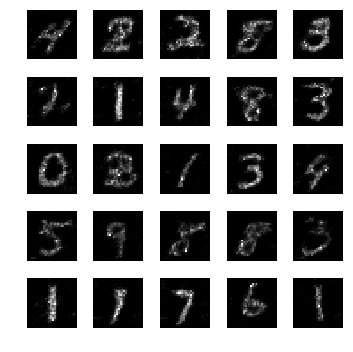

epoch: 1091, time: 4.993713 | train_G_Loss: 0.391440, train_D_loss: 2.477658, train_acc: 0.882812
cv_G_Loss: 1.267829, cv_D_loss: 3.441802, cv_acc: 0.865100

epoch: 1092, time: 4.936204 | train_G_Loss: 0.482747, train_D_loss: 2.435682, train_acc: 0.939453
cv_G_Loss: 0.931894, cv_D_loss: 3.014973, cv_acc: 0.894100

epoch: 1093, time: 4.948127 | train_G_Loss: 0.483350, train_D_loss: 2.157672, train_acc: 0.935547
cv_G_Loss: 1.744453, cv_D_loss: 4.334619, cv_acc: 0.863600

epoch: 1094, time: 4.956526 | train_G_Loss: 0.333442, train_D_loss: 2.491048, train_acc: 0.914062
cv_G_Loss: 0.929591, cv_D_loss: 2.837176, cv_acc: 0.918700

epoch: 1095, time: 4.956950 | train_G_Loss: 0.248502, train_D_loss: 2.364972, train_acc: 0.923828
cv_G_Loss: 0.823255, cv_D_loss: 2.966523, cv_acc: 0.829000

epoch: 1096, time: 4.943160 | train_G_Loss: 0.390413, train_D_loss: 2.110822, train_acc: 0.941406
cv_G_Loss: 0.472109, cv_D_loss: 2.449413, cv_acc: 0.890900

epoch: 1097, time: 4.951892 | train_G_Loss: 0.526084

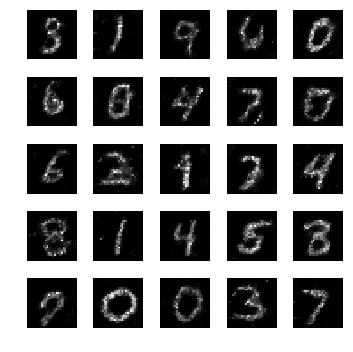

epoch: 1101, time: 4.977866 | train_G_Loss: 0.364797, train_D_loss: 2.257502, train_acc: 0.947266
cv_G_Loss: 0.276696, cv_D_loss: 2.380351, cv_acc: 0.924000

epoch: 1102, time: 4.959108 | train_G_Loss: 0.456542, train_D_loss: 2.205601, train_acc: 0.941406
cv_G_Loss: 0.798615, cv_D_loss: 2.590390, cv_acc: 0.925900

epoch: 1103, time: 4.965211 | train_G_Loss: 0.404018, train_D_loss: 2.219645, train_acc: 0.929688
cv_G_Loss: 0.935174, cv_D_loss: 2.849355, cv_acc: 0.908700

epoch: 1104, time: 4.945021 | train_G_Loss: 0.462355, train_D_loss: 2.289775, train_acc: 0.929688
cv_G_Loss: 0.612081, cv_D_loss: 2.459671, cv_acc: 0.922500

epoch: 1105, time: 4.958675 | train_G_Loss: 0.417643, train_D_loss: 2.178006, train_acc: 0.945312
cv_G_Loss: 0.863069, cv_D_loss: 2.740889, cv_acc: 0.917500

epoch: 1106, time: 4.947817 | train_G_Loss: 0.392437, train_D_loss: 2.151452, train_acc: 0.917969
cv_G_Loss: 0.580711, cv_D_loss: 2.480539, cv_acc: 0.908500

epoch: 1107, time: 4.960709 | train_G_Loss: 0.403386

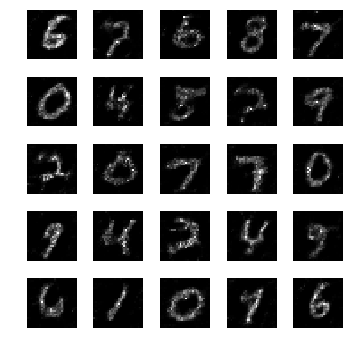

epoch: 1111, time: 4.991280 | train_G_Loss: 0.404642, train_D_loss: 2.237903, train_acc: 0.968750
cv_G_Loss: 0.475064, cv_D_loss: 2.335785, cv_acc: 0.920100

epoch: 1112, time: 4.973211 | train_G_Loss: 0.443646, train_D_loss: 2.012823, train_acc: 0.957031
cv_G_Loss: 1.010981, cv_D_loss: 2.878433, cv_acc: 0.914400

epoch: 1113, time: 5.102754 | train_G_Loss: 0.375637, train_D_loss: 2.208836, train_acc: 0.925781
cv_G_Loss: 0.299492, cv_D_loss: 2.453196, cv_acc: 0.906400

epoch: 1114, time: 4.971811 | train_G_Loss: 0.514155, train_D_loss: 2.169504, train_acc: 0.955078
cv_G_Loss: 0.372915, cv_D_loss: 2.414668, cv_acc: 0.888800

epoch: 1115, time: 4.960557 | train_G_Loss: 0.627154, train_D_loss: 2.179851, train_acc: 0.947266
cv_G_Loss: 1.342977, cv_D_loss: 3.754402, cv_acc: 0.795300

epoch: 1116, time: 4.956955 | train_G_Loss: 0.369328, train_D_loss: 2.433441, train_acc: 0.923828
cv_G_Loss: 0.446752, cv_D_loss: 2.343056, cv_acc: 0.923200

epoch: 1117, time: 4.953210 | train_G_Loss: 0.435532

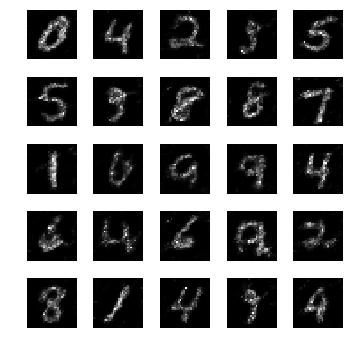

epoch: 1121, time: 4.987455 | train_G_Loss: 0.495395, train_D_loss: 2.270989, train_acc: 0.910156
cv_G_Loss: 1.411483, cv_D_loss: 3.608490, cv_acc: 0.909300

epoch: 1122, time: 4.958259 | train_G_Loss: 0.353816, train_D_loss: 2.555845, train_acc: 0.886719
cv_G_Loss: 1.261323, cv_D_loss: 3.345996, cv_acc: 0.897600

epoch: 1123, time: 4.966402 | train_G_Loss: 0.368038, train_D_loss: 2.476576, train_acc: 0.916016
cv_G_Loss: 0.198483, cv_D_loss: 2.562968, cv_acc: 0.910000

epoch: 1124, time: 4.964259 | train_G_Loss: 0.395011, train_D_loss: 2.311239, train_acc: 0.917969
cv_G_Loss: 0.606249, cv_D_loss: 2.397868, cv_acc: 0.926200
Model saved

epoch: 1125, time: 4.987922 | train_G_Loss: 0.383975, train_D_loss: 2.358940, train_acc: 0.923828
cv_G_Loss: 0.189214, cv_D_loss: 2.606894, cv_acc: 0.919300

epoch: 1126, time: 4.965313 | train_G_Loss: 0.414387, train_D_loss: 2.489170, train_acc: 0.927734
cv_G_Loss: 0.307226, cv_D_loss: 2.468054, cv_acc: 0.896900

epoch: 1127, time: 4.962868 | train_G_Lo

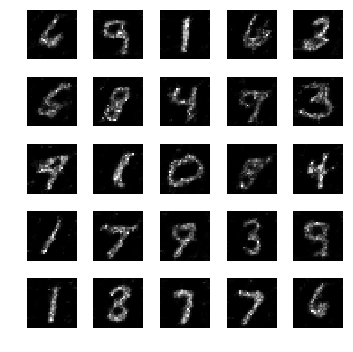

epoch: 1131, time: 5.020412 | train_G_Loss: 0.367330, train_D_loss: 2.403394, train_acc: 0.929688
cv_G_Loss: 0.573224, cv_D_loss: 2.428199, cv_acc: 0.916000

epoch: 1132, time: 4.989826 | train_G_Loss: 0.521663, train_D_loss: 2.228492, train_acc: 0.919922
cv_G_Loss: 0.295031, cv_D_loss: 2.423439, cv_acc: 0.900800

epoch: 1133, time: 4.982138 | train_G_Loss: 0.392397, train_D_loss: 2.294248, train_acc: 0.945312
cv_G_Loss: 0.473660, cv_D_loss: 2.506166, cv_acc: 0.880000

epoch: 1134, time: 4.990507 | train_G_Loss: 0.376699, train_D_loss: 2.099729, train_acc: 0.953125
cv_G_Loss: 0.478998, cv_D_loss: 2.336880, cv_acc: 0.908000

epoch: 1135, time: 4.977174 | train_G_Loss: 0.338601, train_D_loss: 2.395929, train_acc: 0.947266
cv_G_Loss: 0.132201, cv_D_loss: 2.797015, cv_acc: 0.909600

epoch: 1136, time: 5.021458 | train_G_Loss: 0.375656, train_D_loss: 2.146742, train_acc: 0.941406
cv_G_Loss: 1.378211, cv_D_loss: 3.475034, cv_acc: 0.914600

epoch: 1137, time: 4.977232 | train_G_Loss: 0.417693

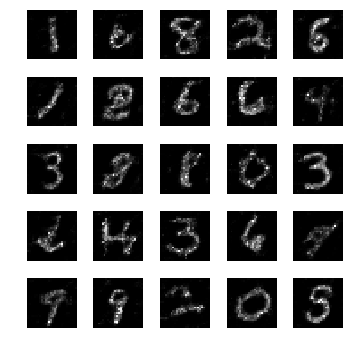

epoch: 1141, time: 5.002259 | train_G_Loss: 0.423048, train_D_loss: 2.265904, train_acc: 0.894531
cv_G_Loss: 0.582870, cv_D_loss: 2.564346, cv_acc: 0.900300

epoch: 1142, time: 4.963313 | train_G_Loss: 0.470127, train_D_loss: 2.251409, train_acc: 0.914062
cv_G_Loss: 0.395840, cv_D_loss: 2.318507, cv_acc: 0.922800

epoch: 1143, time: 4.963293 | train_G_Loss: 0.326829, train_D_loss: 2.425857, train_acc: 0.947266
cv_G_Loss: 1.035617, cv_D_loss: 2.965642, cv_acc: 0.915100

epoch: 1144, time: 4.962392 | train_G_Loss: 0.463276, train_D_loss: 2.179665, train_acc: 0.923828
cv_G_Loss: 0.303008, cv_D_loss: 2.362349, cv_acc: 0.930500
Model saved

epoch: 1145, time: 5.027673 | train_G_Loss: 0.423952, train_D_loss: 2.445915, train_acc: 0.898438
cv_G_Loss: 0.403957, cv_D_loss: 2.345091, cv_acc: 0.924400

epoch: 1146, time: 4.993572 | train_G_Loss: 0.302090, train_D_loss: 2.352038, train_acc: 0.906250
cv_G_Loss: 0.489819, cv_D_loss: 2.366742, cv_acc: 0.917500

epoch: 1147, time: 4.992744 | train_G_Lo

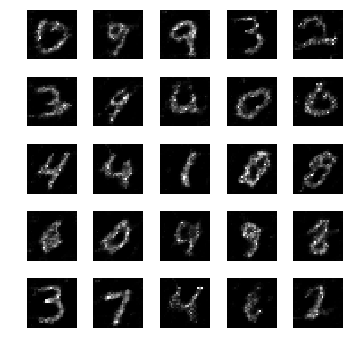

epoch: 1151, time: 5.020466 | train_G_Loss: 0.390483, train_D_loss: 2.341666, train_acc: 0.912109
cv_G_Loss: 0.388194, cv_D_loss: 2.412354, cv_acc: 0.916000

epoch: 1152, time: 4.985784 | train_G_Loss: 0.421897, train_D_loss: 2.296620, train_acc: 0.916016
cv_G_Loss: 0.912832, cv_D_loss: 3.005332, cv_acc: 0.870900

epoch: 1153, time: 4.994551 | train_G_Loss: 0.390125, train_D_loss: 2.231625, train_acc: 0.953125
cv_G_Loss: 0.391953, cv_D_loss: 2.319803, cv_acc: 0.915500

epoch: 1154, time: 4.997141 | train_G_Loss: 0.398727, train_D_loss: 2.283151, train_acc: 0.937500
cv_G_Loss: 0.551174, cv_D_loss: 2.414549, cv_acc: 0.922900

epoch: 1155, time: 4.987919 | train_G_Loss: 0.323876, train_D_loss: 2.404690, train_acc: 0.912109
cv_G_Loss: 0.811397, cv_D_loss: 2.621336, cv_acc: 0.918900

epoch: 1156, time: 4.991036 | train_G_Loss: 0.401393, train_D_loss: 2.385378, train_acc: 0.929688
cv_G_Loss: 0.270463, cv_D_loss: 2.372362, cv_acc: 0.923100

epoch: 1157, time: 4.994745 | train_G_Loss: 0.348544

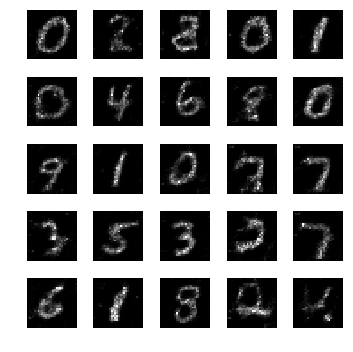

epoch: 1161, time: 5.028730 | train_G_Loss: 0.336165, train_D_loss: 2.318504, train_acc: 0.945312
cv_G_Loss: 0.358565, cv_D_loss: 2.338042, cv_acc: 0.917800

epoch: 1162, time: 4.994190 | train_G_Loss: 0.397958, train_D_loss: 2.132711, train_acc: 0.953125
cv_G_Loss: 1.686086, cv_D_loss: 4.204358, cv_acc: 0.852700

epoch: 1163, time: 5.001201 | train_G_Loss: 0.353523, train_D_loss: 2.208589, train_acc: 0.933594
cv_G_Loss: 1.281736, cv_D_loss: 3.402034, cv_acc: 0.899800

epoch: 1164, time: 5.001764 | train_G_Loss: 0.342601, train_D_loss: 2.415554, train_acc: 0.923828
cv_G_Loss: 0.230775, cv_D_loss: 2.471388, cv_acc: 0.912100

epoch: 1165, time: 4.997335 | train_G_Loss: 0.488045, train_D_loss: 2.155001, train_acc: 0.929688
cv_G_Loss: 0.520554, cv_D_loss: 2.411230, cv_acc: 0.920300

epoch: 1166, time: 5.004861 | train_G_Loss: 0.474252, train_D_loss: 2.313540, train_acc: 0.912109
cv_G_Loss: 1.025637, cv_D_loss: 2.908911, cv_acc: 0.918600

epoch: 1167, time: 4.989123 | train_G_Loss: 0.387110

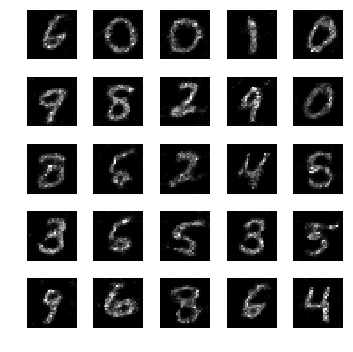

epoch: 1171, time: 5.009162 | train_G_Loss: 0.337546, train_D_loss: 2.373966, train_acc: 0.949219
cv_G_Loss: 1.176259, cv_D_loss: 3.297214, cv_acc: 0.913500

epoch: 1172, time: 4.973480 | train_G_Loss: 0.298509, train_D_loss: 2.332382, train_acc: 0.939453
cv_G_Loss: 0.236465, cv_D_loss: 2.440459, cv_acc: 0.926300

epoch: 1173, time: 4.974264 | train_G_Loss: 0.410780, train_D_loss: 2.143020, train_acc: 0.935547
cv_G_Loss: 0.654359, cv_D_loss: 2.473511, cv_acc: 0.914500

epoch: 1174, time: 4.984639 | train_G_Loss: 0.369928, train_D_loss: 2.244245, train_acc: 0.914062
cv_G_Loss: 1.214548, cv_D_loss: 3.311488, cv_acc: 0.907300

epoch: 1175, time: 4.987511 | train_G_Loss: 0.348813, train_D_loss: 2.340009, train_acc: 0.917969
cv_G_Loss: 0.348167, cv_D_loss: 2.442116, cv_acc: 0.909200

epoch: 1176, time: 4.989555 | train_G_Loss: 0.395643, train_D_loss: 2.235575, train_acc: 0.937500
cv_G_Loss: 0.543732, cv_D_loss: 2.443223, cv_acc: 0.911500

epoch: 1177, time: 4.983531 | train_G_Loss: 0.498930

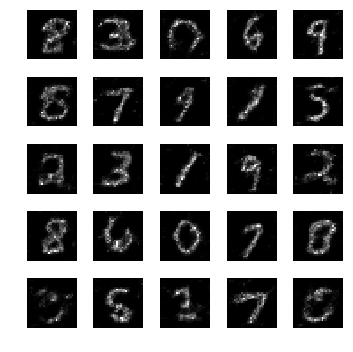

epoch: 1181, time: 5.048884 | train_G_Loss: 0.410272, train_D_loss: 2.299000, train_acc: 0.912109
cv_G_Loss: 1.119895, cv_D_loss: 3.111758, cv_acc: 0.909600

epoch: 1182, time: 4.993650 | train_G_Loss: 0.426994, train_D_loss: 2.308413, train_acc: 0.906250
cv_G_Loss: 0.329438, cv_D_loss: 2.384656, cv_acc: 0.915200

epoch: 1183, time: 5.011228 | train_G_Loss: 0.386360, train_D_loss: 2.307921, train_acc: 0.929688
cv_G_Loss: 0.498312, cv_D_loss: 2.298507, cv_acc: 0.928400

epoch: 1184, time: 4.987285 | train_G_Loss: 0.410467, train_D_loss: 2.153768, train_acc: 0.941406
cv_G_Loss: 1.011050, cv_D_loss: 3.039916, cv_acc: 0.884900

epoch: 1185, time: 4.996725 | train_G_Loss: 0.415121, train_D_loss: 2.363919, train_acc: 0.935547
cv_G_Loss: 0.334248, cv_D_loss: 2.467088, cv_acc: 0.890300

epoch: 1186, time: 4.997528 | train_G_Loss: 0.337654, train_D_loss: 2.233907, train_acc: 0.962891
cv_G_Loss: 0.317633, cv_D_loss: 2.319357, cv_acc: 0.923700

epoch: 1187, time: 4.995645 | train_G_Loss: 0.390938

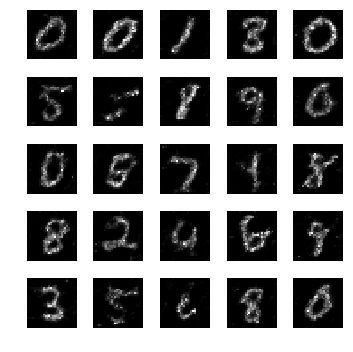

epoch: 1191, time: 5.035396 | train_G_Loss: 0.352807, train_D_loss: 2.231627, train_acc: 0.935547
cv_G_Loss: 1.211875, cv_D_loss: 3.504690, cv_acc: 0.861100

epoch: 1192, time: 4.996414 | train_G_Loss: 0.351734, train_D_loss: 2.282030, train_acc: 0.929688
cv_G_Loss: 0.236981, cv_D_loss: 2.487473, cv_acc: 0.903500

epoch: 1193, time: 4.987532 | train_G_Loss: 0.388069, train_D_loss: 2.188567, train_acc: 0.939453
cv_G_Loss: 0.343751, cv_D_loss: 2.442831, cv_acc: 0.898600

epoch: 1194, time: 4.986846 | train_G_Loss: 0.401642, train_D_loss: 2.175531, train_acc: 0.925781
cv_G_Loss: 0.438647, cv_D_loss: 2.687547, cv_acc: 0.776000

epoch: 1195, time: 5.000376 | train_G_Loss: 0.404993, train_D_loss: 2.207378, train_acc: 0.941406
cv_G_Loss: 0.709218, cv_D_loss: 2.485801, cv_acc: 0.928100

epoch: 1196, time: 4.999377 | train_G_Loss: 0.343723, train_D_loss: 2.186825, train_acc: 0.925781
cv_G_Loss: 0.465679, cv_D_loss: 2.309089, cv_acc: 0.925300

epoch: 1197, time: 5.002228 | train_G_Loss: 0.369680

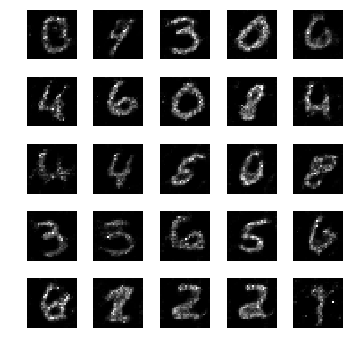

epoch: 1201, time: 5.031109 | train_G_Loss: 0.400097, train_D_loss: 2.208584, train_acc: 0.921875
cv_G_Loss: 0.465036, cv_D_loss: 2.382025, cv_acc: 0.915600

epoch: 1202, time: 4.990633 | train_G_Loss: 0.454890, train_D_loss: 2.417156, train_acc: 0.904297
cv_G_Loss: 0.296659, cv_D_loss: 2.340523, cv_acc: 0.924400

epoch: 1203, time: 5.025977 | train_G_Loss: 0.337550, train_D_loss: 2.451394, train_acc: 0.908203
cv_G_Loss: 0.707609, cv_D_loss: 2.470810, cv_acc: 0.926300

epoch: 1204, time: 4.991145 | train_G_Loss: 0.424594, train_D_loss: 2.472474, train_acc: 0.900391
cv_G_Loss: 1.050007, cv_D_loss: 3.118445, cv_acc: 0.875600

epoch: 1205, time: 4.980034 | train_G_Loss: 0.356944, train_D_loss: 2.177274, train_acc: 0.923828
cv_G_Loss: 0.672281, cv_D_loss: 2.413508, cv_acc: 0.925300

epoch: 1206, time: 4.985023 | train_G_Loss: 0.447633, train_D_loss: 2.272768, train_acc: 0.912109
cv_G_Loss: 1.571051, cv_D_loss: 3.810873, cv_acc: 0.921300

epoch: 1207, time: 5.013874 | train_G_Loss: 0.336073

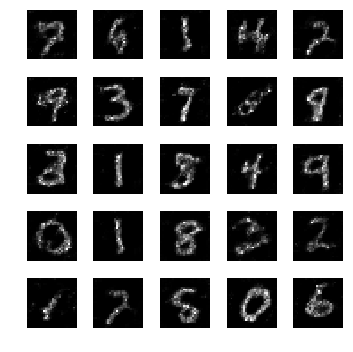

epoch: 1211, time: 5.030314 | train_G_Loss: 0.434727, train_D_loss: 2.308075, train_acc: 0.927734
cv_G_Loss: 0.715202, cv_D_loss: 2.613561, cv_acc: 0.908900

epoch: 1212, time: 4.982811 | train_G_Loss: 0.342115, train_D_loss: 2.172536, train_acc: 0.951172
cv_G_Loss: 0.378843, cv_D_loss: 2.296334, cv_acc: 0.928600

epoch: 1213, time: 4.986690 | train_G_Loss: 0.415301, train_D_loss: 2.109528, train_acc: 0.958984
cv_G_Loss: 0.476395, cv_D_loss: 2.367661, cv_acc: 0.916800

epoch: 1214, time: 4.972894 | train_G_Loss: 0.408082, train_D_loss: 2.130563, train_acc: 0.921875
cv_G_Loss: 0.877966, cv_D_loss: 2.850960, cv_acc: 0.904100

epoch: 1215, time: 4.983025 | train_G_Loss: 0.365604, train_D_loss: 2.283186, train_acc: 0.898438
cv_G_Loss: 0.910973, cv_D_loss: 2.744505, cv_acc: 0.922600

epoch: 1216, time: 4.998798 | train_G_Loss: 0.343624, train_D_loss: 2.343724, train_acc: 0.923828
cv_G_Loss: 0.319570, cv_D_loss: 2.393738, cv_acc: 0.917900

epoch: 1217, time: 4.999080 | train_G_Loss: 0.341757

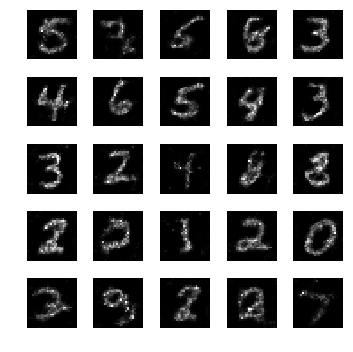

epoch: 1221, time: 5.027886 | train_G_Loss: 0.339587, train_D_loss: 2.322489, train_acc: 0.937500
cv_G_Loss: 0.261731, cv_D_loss: 2.793406, cv_acc: 0.828100

epoch: 1222, time: 5.025331 | train_G_Loss: 0.484762, train_D_loss: 2.226109, train_acc: 0.941406
cv_G_Loss: 1.264187, cv_D_loss: 3.860420, cv_acc: 0.758100

epoch: 1223, time: 5.003885 | train_G_Loss: 0.379459, train_D_loss: 2.361240, train_acc: 0.910156
cv_G_Loss: 0.988756, cv_D_loss: 2.908387, cv_acc: 0.923100

epoch: 1224, time: 5.005736 | train_G_Loss: 0.314016, train_D_loss: 2.422257, train_acc: 0.896484
cv_G_Loss: 0.529824, cv_D_loss: 2.435399, cv_acc: 0.920100

epoch: 1225, time: 5.029332 | train_G_Loss: 0.470266, train_D_loss: 2.397342, train_acc: 0.914062
cv_G_Loss: 0.654764, cv_D_loss: 2.568066, cv_acc: 0.913000

epoch: 1226, time: 5.008259 | train_G_Loss: 0.461058, train_D_loss: 2.355581, train_acc: 0.935547
cv_G_Loss: 1.275740, cv_D_loss: 3.381839, cv_acc: 0.906500

epoch: 1227, time: 4.991880 | train_G_Loss: 0.384280

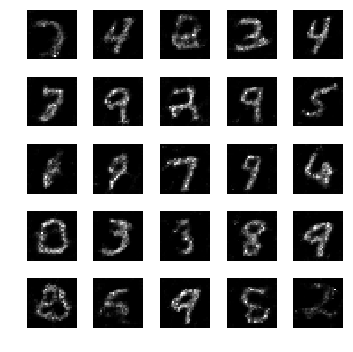

epoch: 1231, time: 5.030671 | train_G_Loss: 0.387531, train_D_loss: 2.229625, train_acc: 0.925781
cv_G_Loss: 0.450712, cv_D_loss: 2.680056, cv_acc: 0.829500

epoch: 1232, time: 4.992048 | train_G_Loss: 0.344660, train_D_loss: 2.324330, train_acc: 0.931641
cv_G_Loss: 0.362606, cv_D_loss: 2.476410, cv_acc: 0.896500

epoch: 1233, time: 4.995408 | train_G_Loss: 0.304557, train_D_loss: 2.359530, train_acc: 0.925781
cv_G_Loss: 0.311973, cv_D_loss: 2.332012, cv_acc: 0.925200

epoch: 1234, time: 5.010619 | train_G_Loss: 0.436885, train_D_loss: 2.327341, train_acc: 0.931641
cv_G_Loss: 0.973806, cv_D_loss: 3.101340, cv_acc: 0.875900

epoch: 1235, time: 5.008565 | train_G_Loss: 0.436861, train_D_loss: 2.305108, train_acc: 0.937500
cv_G_Loss: 0.921182, cv_D_loss: 2.802292, cv_acc: 0.926800

epoch: 1236, time: 5.002338 | train_G_Loss: 0.380264, train_D_loss: 2.294834, train_acc: 0.935547
cv_G_Loss: 0.553563, cv_D_loss: 2.490859, cv_acc: 0.894900

epoch: 1237, time: 5.006375 | train_G_Loss: 0.350448

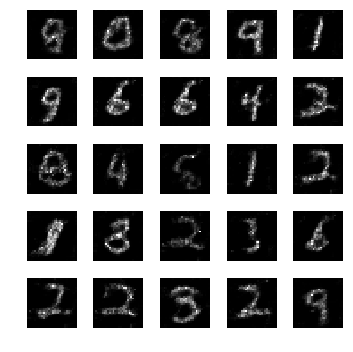

epoch: 1241, time: 5.011680 | train_G_Loss: 0.417823, train_D_loss: 2.282406, train_acc: 0.906250
cv_G_Loss: 0.893838, cv_D_loss: 2.790102, cv_acc: 0.910300

epoch: 1242, time: 4.990173 | train_G_Loss: 0.417484, train_D_loss: 2.435925, train_acc: 0.917969
cv_G_Loss: 0.356145, cv_D_loss: 2.322072, cv_acc: 0.926300

epoch: 1243, time: 4.992417 | train_G_Loss: 0.425937, train_D_loss: 2.138113, train_acc: 0.921875
cv_G_Loss: 0.600514, cv_D_loss: 2.423102, cv_acc: 0.925800

epoch: 1244, time: 4.983507 | train_G_Loss: 0.326604, train_D_loss: 2.341256, train_acc: 0.943359
cv_G_Loss: 0.201760, cv_D_loss: 2.530219, cv_acc: 0.919100

epoch: 1245, time: 4.985636 | train_G_Loss: 0.414957, train_D_loss: 2.111037, train_acc: 0.957031
cv_G_Loss: 0.201520, cv_D_loss: 2.493201, cv_acc: 0.931400
Model saved

epoch: 1246, time: 4.993412 | train_G_Loss: 0.504001, train_D_loss: 2.138883, train_acc: 0.933594
cv_G_Loss: 0.924735, cv_D_loss: 2.765391, cv_acc: 0.925000

epoch: 1247, time: 4.993629 | train_G_Lo

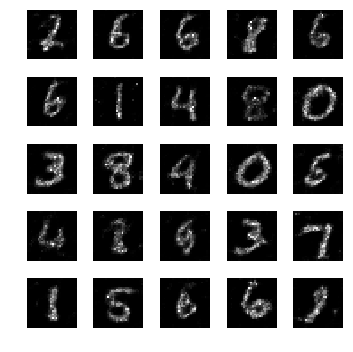

epoch: 1251, time: 4.991636 | train_G_Loss: 0.430629, train_D_loss: 2.385360, train_acc: 0.923828
cv_G_Loss: 1.528174, cv_D_loss: 3.768655, cv_acc: 0.917300

epoch: 1252, time: 4.963671 | train_G_Loss: 0.505701, train_D_loss: 2.236516, train_acc: 0.912109
cv_G_Loss: 1.225616, cv_D_loss: 3.380366, cv_acc: 0.908600

epoch: 1253, time: 4.963489 | train_G_Loss: 0.422496, train_D_loss: 2.187913, train_acc: 0.917969
cv_G_Loss: 0.467122, cv_D_loss: 2.399553, cv_acc: 0.909600

epoch: 1254, time: 4.964965 | train_G_Loss: 0.370982, train_D_loss: 2.348098, train_acc: 0.914062
cv_G_Loss: 0.367896, cv_D_loss: 2.362721, cv_acc: 0.917400

epoch: 1255, time: 4.968798 | train_G_Loss: 0.415751, train_D_loss: 2.505519, train_acc: 0.921875
cv_G_Loss: 0.408493, cv_D_loss: 2.296894, cv_acc: 0.926600

epoch: 1256, time: 4.966139 | train_G_Loss: 0.414881, train_D_loss: 2.285681, train_acc: 0.927734
cv_G_Loss: 0.506047, cv_D_loss: 2.375988, cv_acc: 0.926900

epoch: 1257, time: 4.956457 | train_G_Loss: 0.407752

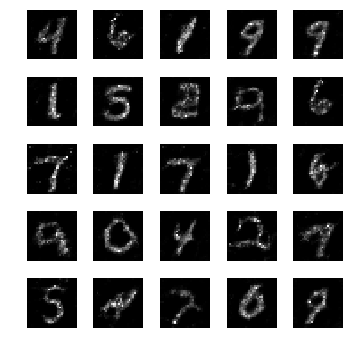

epoch: 1261, time: 4.990011 | train_G_Loss: 0.437763, train_D_loss: 2.276501, train_acc: 0.943359
cv_G_Loss: 0.612277, cv_D_loss: 2.449825, cv_acc: 0.927200

epoch: 1262, time: 4.963430 | train_G_Loss: 0.433893, train_D_loss: 2.453892, train_acc: 0.933594
cv_G_Loss: 0.964449, cv_D_loss: 2.731668, cv_acc: 0.924200

epoch: 1263, time: 4.967131 | train_G_Loss: 0.382056, train_D_loss: 2.260901, train_acc: 0.923828
cv_G_Loss: 0.622180, cv_D_loss: 2.483861, cv_acc: 0.925200

epoch: 1264, time: 4.975897 | train_G_Loss: 0.357128, train_D_loss: 2.563592, train_acc: 0.914062
cv_G_Loss: 0.645708, cv_D_loss: 2.499466, cv_acc: 0.908400

epoch: 1265, time: 4.960831 | train_G_Loss: 0.463008, train_D_loss: 2.289214, train_acc: 0.904297
cv_G_Loss: 0.647726, cv_D_loss: 2.557456, cv_acc: 0.906300

epoch: 1266, time: 4.971941 | train_G_Loss: 0.303007, train_D_loss: 2.610331, train_acc: 0.916016
cv_G_Loss: 0.945230, cv_D_loss: 2.863960, cv_acc: 0.890300

epoch: 1267, time: 4.969273 | train_G_Loss: 0.521232

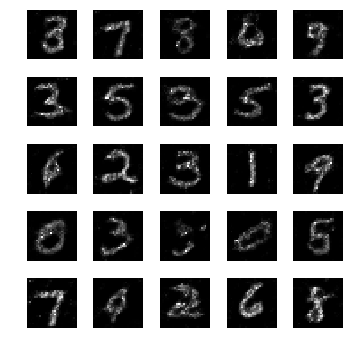

epoch: 1271, time: 4.988374 | train_G_Loss: 0.378672, train_D_loss: 2.261947, train_acc: 0.939453
cv_G_Loss: 0.253654, cv_D_loss: 2.378898, cv_acc: 0.928700

epoch: 1272, time: 4.959377 | train_G_Loss: 0.477313, train_D_loss: 2.393072, train_acc: 0.951172
cv_G_Loss: 0.758090, cv_D_loss: 2.551211, cv_acc: 0.930100

epoch: 1273, time: 4.971796 | train_G_Loss: 0.510401, train_D_loss: 2.235195, train_acc: 0.949219
cv_G_Loss: 1.719396, cv_D_loss: 4.281510, cv_acc: 0.858000

epoch: 1274, time: 4.969548 | train_G_Loss: 0.300472, train_D_loss: 2.167979, train_acc: 0.917969
cv_G_Loss: 0.891423, cv_D_loss: 2.742262, cv_acc: 0.924800

epoch: 1275, time: 4.976311 | train_G_Loss: 0.372339, train_D_loss: 2.333740, train_acc: 0.943359
cv_G_Loss: 0.439057, cv_D_loss: 2.312676, cv_acc: 0.925000

epoch: 1276, time: 4.956018 | train_G_Loss: 0.383733, train_D_loss: 2.150537, train_acc: 0.906250
cv_G_Loss: 0.683301, cv_D_loss: 2.493365, cv_acc: 0.929100

epoch: 1277, time: 4.973113 | train_G_Loss: 0.439837

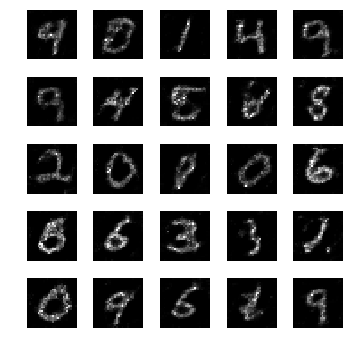

epoch: 1281, time: 4.991995 | train_G_Loss: 0.347498, train_D_loss: 2.453032, train_acc: 0.933594
cv_G_Loss: 0.365301, cv_D_loss: 2.417110, cv_acc: 0.898400

epoch: 1282, time: 4.961944 | train_G_Loss: 0.354670, train_D_loss: 2.223610, train_acc: 0.949219
cv_G_Loss: 2.989029, cv_D_loss: 6.628752, cv_acc: 0.885200

epoch: 1283, time: 4.961821 | train_G_Loss: 0.364603, train_D_loss: 2.427852, train_acc: 0.929688
cv_G_Loss: 0.420882, cv_D_loss: 2.322991, cv_acc: 0.921500

epoch: 1284, time: 5.102282 | train_G_Loss: 0.412423, train_D_loss: 2.499064, train_acc: 0.919922
cv_G_Loss: 1.036906, cv_D_loss: 2.904192, cv_acc: 0.929400

epoch: 1285, time: 4.958184 | train_G_Loss: 0.360236, train_D_loss: 2.285437, train_acc: 0.941406
cv_G_Loss: 1.409493, cv_D_loss: 3.760674, cv_acc: 0.876300

epoch: 1286, time: 4.972616 | train_G_Loss: 0.387334, train_D_loss: 2.204455, train_acc: 0.958984
cv_G_Loss: 0.707275, cv_D_loss: 2.537853, cv_acc: 0.923000

epoch: 1287, time: 4.963643 | train_G_Loss: 0.377331

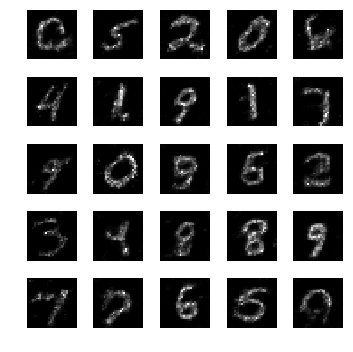

epoch: 1291, time: 4.995671 | train_G_Loss: 0.415857, train_D_loss: 2.141754, train_acc: 0.955078
cv_G_Loss: 0.594617, cv_D_loss: 2.404602, cv_acc: 0.930700

epoch: 1292, time: 5.006728 | train_G_Loss: 0.388685, train_D_loss: 2.254518, train_acc: 0.925781
cv_G_Loss: 0.691385, cv_D_loss: 2.841964, cv_acc: 0.784100

epoch: 1293, time: 4.962540 | train_G_Loss: 0.315611, train_D_loss: 2.270085, train_acc: 0.933594
cv_G_Loss: 0.357034, cv_D_loss: 2.288809, cv_acc: 0.930300

epoch: 1294, time: 4.961384 | train_G_Loss: 0.415692, train_D_loss: 2.103119, train_acc: 0.966797
cv_G_Loss: 0.943146, cv_D_loss: 2.804851, cv_acc: 0.928700

epoch: 1295, time: 4.974531 | train_G_Loss: 0.425281, train_D_loss: 2.194314, train_acc: 0.978516
cv_G_Loss: 1.381986, cv_D_loss: 3.522591, cv_acc: 0.889300

epoch: 1296, time: 4.971490 | train_G_Loss: 0.353749, train_D_loss: 2.318476, train_acc: 0.958984
cv_G_Loss: 1.127765, cv_D_loss: 3.400324, cv_acc: 0.843600

epoch: 1297, time: 4.964213 | train_G_Loss: 0.392518

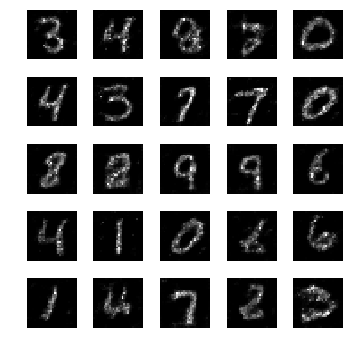

epoch: 1301, time: 4.997781 | train_G_Loss: 0.451396, train_D_loss: 2.315674, train_acc: 0.935547
cv_G_Loss: 0.635425, cv_D_loss: 2.441262, cv_acc: 0.925300

epoch: 1302, time: 4.970122 | train_G_Loss: 0.461075, train_D_loss: 2.190289, train_acc: 0.943359
cv_G_Loss: 0.523682, cv_D_loss: 2.407718, cv_acc: 0.920900

epoch: 1303, time: 4.963776 | train_G_Loss: 0.394315, train_D_loss: 2.191912, train_acc: 0.929688
cv_G_Loss: 1.879829, cv_D_loss: 4.579918, cv_acc: 0.862700

epoch: 1304, time: 4.969798 | train_G_Loss: 0.322602, train_D_loss: 2.279878, train_acc: 0.941406
cv_G_Loss: 0.182927, cv_D_loss: 2.560908, cv_acc: 0.918100

epoch: 1305, time: 4.975058 | train_G_Loss: 0.450989, train_D_loss: 2.345906, train_acc: 0.945312
cv_G_Loss: 0.888905, cv_D_loss: 2.777937, cv_acc: 0.911300

epoch: 1306, time: 4.956184 | train_G_Loss: 0.450533, train_D_loss: 2.213971, train_acc: 0.935547
cv_G_Loss: 0.359248, cv_D_loss: 2.339839, cv_acc: 0.923300

epoch: 1307, time: 4.959707 | train_G_Loss: 0.488595

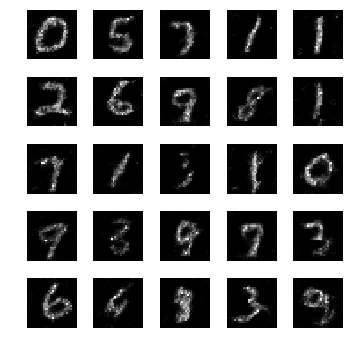

epoch: 1311, time: 5.000617 | train_G_Loss: 0.453378, train_D_loss: 2.418641, train_acc: 0.933594
cv_G_Loss: 1.407485, cv_D_loss: 3.533924, cv_acc: 0.916600

epoch: 1312, time: 4.965162 | train_G_Loss: 0.581837, train_D_loss: 2.212343, train_acc: 0.939453
cv_G_Loss: 1.275006, cv_D_loss: 3.335009, cv_acc: 0.920900

epoch: 1313, time: 4.966534 | train_G_Loss: 0.397845, train_D_loss: 2.569777, train_acc: 0.882812
cv_G_Loss: 0.699377, cv_D_loss: 2.540490, cv_acc: 0.924100

epoch: 1314, time: 4.958069 | train_G_Loss: 0.352480, train_D_loss: 2.680359, train_acc: 0.916016
cv_G_Loss: 0.216644, cv_D_loss: 2.595319, cv_acc: 0.892600

epoch: 1315, time: 4.999438 | train_G_Loss: 0.406184, train_D_loss: 2.116959, train_acc: 0.927734
cv_G_Loss: 1.082929, cv_D_loss: 3.108337, cv_acc: 0.911300

epoch: 1316, time: 4.970962 | train_G_Loss: 0.333259, train_D_loss: 2.356440, train_acc: 0.933594
cv_G_Loss: 0.166301, cv_D_loss: 2.663971, cv_acc: 0.909300

epoch: 1317, time: 4.963224 | train_G_Loss: 0.417204

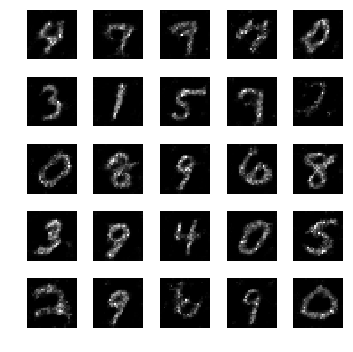

epoch: 1321, time: 5.002457 | train_G_Loss: 0.412091, train_D_loss: 2.149073, train_acc: 0.949219
cv_G_Loss: 1.325212, cv_D_loss: 3.581168, cv_acc: 0.890700

epoch: 1322, time: 4.968323 | train_G_Loss: 0.348311, train_D_loss: 2.198819, train_acc: 0.933594
cv_G_Loss: 0.584380, cv_D_loss: 2.466441, cv_acc: 0.905400

epoch: 1323, time: 4.965839 | train_G_Loss: 0.445012, train_D_loss: 2.208817, train_acc: 0.896484
cv_G_Loss: 0.380737, cv_D_loss: 2.653745, cv_acc: 0.841900

epoch: 1324, time: 4.961922 | train_G_Loss: 0.339097, train_D_loss: 2.546425, train_acc: 0.921875
cv_G_Loss: 0.463470, cv_D_loss: 2.378687, cv_acc: 0.924100

epoch: 1325, time: 4.980630 | train_G_Loss: 0.395383, train_D_loss: 2.241264, train_acc: 0.935547
cv_G_Loss: 0.376850, cv_D_loss: 2.349337, cv_acc: 0.920600

epoch: 1326, time: 4.980844 | train_G_Loss: 0.352083, train_D_loss: 2.267479, train_acc: 0.914062
cv_G_Loss: 0.321500, cv_D_loss: 2.329283, cv_acc: 0.930800

epoch: 1327, time: 4.971001 | train_G_Loss: 0.508981

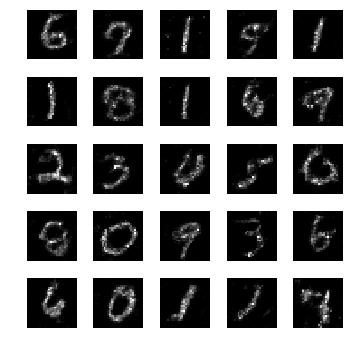

epoch: 1331, time: 4.988815 | train_G_Loss: 0.286792, train_D_loss: 2.261563, train_acc: 0.912109
cv_G_Loss: 0.274943, cv_D_loss: 2.783660, cv_acc: 0.804500

epoch: 1332, time: 4.958149 | train_G_Loss: 0.372068, train_D_loss: 2.388423, train_acc: 0.910156
cv_G_Loss: 0.996023, cv_D_loss: 2.907921, cv_acc: 0.905200

epoch: 1333, time: 4.971352 | train_G_Loss: 0.426415, train_D_loss: 2.478482, train_acc: 0.882812
cv_G_Loss: 0.637944, cv_D_loss: 2.556978, cv_acc: 0.899700

epoch: 1334, time: 4.963833 | train_G_Loss: 0.292073, train_D_loss: 2.589267, train_acc: 0.906250
cv_G_Loss: 0.225367, cv_D_loss: 2.586922, cv_acc: 0.891300

epoch: 1335, time: 4.968529 | train_G_Loss: 0.545726, train_D_loss: 2.221433, train_acc: 0.943359
cv_G_Loss: 1.417232, cv_D_loss: 3.526217, cv_acc: 0.930900

epoch: 1336, time: 4.967826 | train_G_Loss: 0.465775, train_D_loss: 2.319214, train_acc: 0.935547
cv_G_Loss: 1.610501, cv_D_loss: 3.870004, cv_acc: 0.918000

epoch: 1337, time: 4.952705 | train_G_Loss: 0.275009

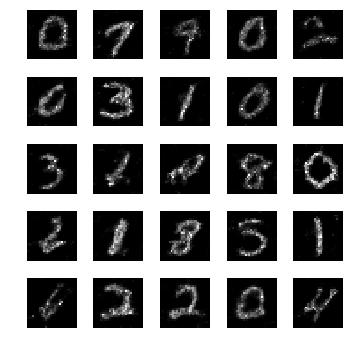

epoch: 1341, time: 4.993169 | train_G_Loss: 0.423861, train_D_loss: 2.263051, train_acc: 0.927734
cv_G_Loss: 0.698309, cv_D_loss: 2.562083, cv_acc: 0.912500

epoch: 1342, time: 4.958373 | train_G_Loss: 0.383848, train_D_loss: 2.323119, train_acc: 0.943359
cv_G_Loss: 0.359049, cv_D_loss: 2.401690, cv_acc: 0.920200

epoch: 1343, time: 4.976864 | train_G_Loss: 0.356865, train_D_loss: 2.133521, train_acc: 0.941406
cv_G_Loss: 0.169090, cv_D_loss: 2.599297, cv_acc: 0.920900

epoch: 1344, time: 4.966417 | train_G_Loss: 0.374570, train_D_loss: 2.240705, train_acc: 0.923828
cv_G_Loss: 0.600753, cv_D_loss: 2.509923, cv_acc: 0.912300

epoch: 1345, time: 4.978338 | train_G_Loss: 0.362928, train_D_loss: 2.185434, train_acc: 0.945312
cv_G_Loss: 0.484585, cv_D_loss: 2.415091, cv_acc: 0.910500

epoch: 1346, time: 4.965465 | train_G_Loss: 0.353796, train_D_loss: 2.290180, train_acc: 0.945312
cv_G_Loss: 0.294647, cv_D_loss: 2.320427, cv_acc: 0.934500
Model saved

epoch: 1347, time: 5.017589 | train_G_Lo

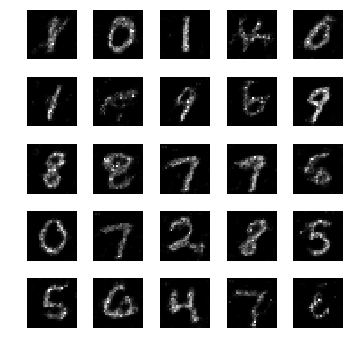

epoch: 1351, time: 5.034678 | train_G_Loss: 0.393161, train_D_loss: 2.197820, train_acc: 0.925781
cv_G_Loss: 0.728969, cv_D_loss: 2.476073, cv_acc: 0.932300

epoch: 1352, time: 5.003359 | train_G_Loss: 0.412238, train_D_loss: 2.267670, train_acc: 0.931641
cv_G_Loss: 0.430461, cv_D_loss: 2.327794, cv_acc: 0.924200

epoch: 1353, time: 4.999632 | train_G_Loss: 0.334688, train_D_loss: 2.239163, train_acc: 0.937500
cv_G_Loss: 0.535757, cv_D_loss: 2.335602, cv_acc: 0.935700
Model saved

epoch: 1354, time: 5.024387 | train_G_Loss: 0.374040, train_D_loss: 2.286796, train_acc: 0.908203
cv_G_Loss: 0.357508, cv_D_loss: 2.287660, cv_acc: 0.926900

epoch: 1355, time: 5.000819 | train_G_Loss: 0.339852, train_D_loss: 2.272169, train_acc: 0.929688
cv_G_Loss: 1.839372, cv_D_loss: 4.478103, cv_acc: 0.893100

epoch: 1356, time: 5.002918 | train_G_Loss: 0.469041, train_D_loss: 2.225396, train_acc: 0.947266
cv_G_Loss: 0.285208, cv_D_loss: 2.553782, cv_acc: 0.892100

epoch: 1357, time: 4.996624 | train_G_Lo

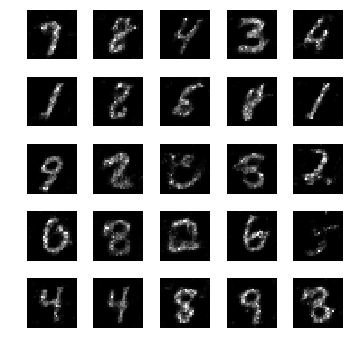

epoch: 1361, time: 5.033989 | train_G_Loss: 0.452602, train_D_loss: 2.344909, train_acc: 0.931641
cv_G_Loss: 1.886113, cv_D_loss: 4.509025, cv_acc: 0.923800

epoch: 1362, time: 4.997329 | train_G_Loss: 0.365678, train_D_loss: 2.108950, train_acc: 0.941406
cv_G_Loss: 2.650018, cv_D_loss: 6.016310, cv_acc: 0.762000

epoch: 1363, time: 4.987942 | train_G_Loss: 0.346391, train_D_loss: 2.221468, train_acc: 0.935547
cv_G_Loss: 0.462339, cv_D_loss: 2.502492, cv_acc: 0.872900

epoch: 1364, time: 5.005173 | train_G_Loss: 0.409913, train_D_loss: 2.158305, train_acc: 0.927734
cv_G_Loss: 1.949797, cv_D_loss: 4.781167, cv_acc: 0.861400

epoch: 1365, time: 4.996324 | train_G_Loss: 0.362009, train_D_loss: 2.374946, train_acc: 0.914062
cv_G_Loss: 0.930622, cv_D_loss: 2.833349, cv_acc: 0.927500

epoch: 1366, time: 5.004087 | train_G_Loss: 0.393249, train_D_loss: 2.190766, train_acc: 0.923828
cv_G_Loss: 0.368699, cv_D_loss: 2.521308, cv_acc: 0.850600

epoch: 1367, time: 4.990595 | train_G_Loss: 0.368982

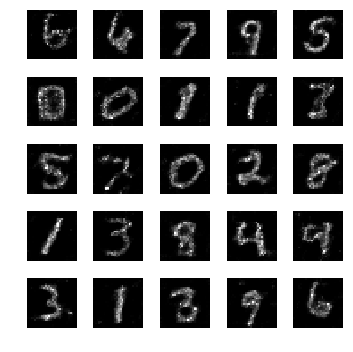

epoch: 1371, time: 5.022419 | train_G_Loss: 0.432124, train_D_loss: 2.201388, train_acc: 0.941406
cv_G_Loss: 0.876719, cv_D_loss: 2.870711, cv_acc: 0.874900

epoch: 1372, time: 4.998457 | train_G_Loss: 0.314571, train_D_loss: 2.268640, train_acc: 0.951172
cv_G_Loss: 1.603749, cv_D_loss: 4.089438, cv_acc: 0.850700

epoch: 1373, time: 4.993791 | train_G_Loss: 0.422735, train_D_loss: 2.183665, train_acc: 0.931641
cv_G_Loss: 0.261446, cv_D_loss: 2.414940, cv_acc: 0.921400

epoch: 1374, time: 4.991626 | train_G_Loss: 0.304197, train_D_loss: 2.429831, train_acc: 0.925781
cv_G_Loss: 0.983403, cv_D_loss: 3.080677, cv_acc: 0.890700

epoch: 1375, time: 4.996942 | train_G_Loss: 0.423977, train_D_loss: 2.126271, train_acc: 0.933594
cv_G_Loss: 2.336978, cv_D_loss: 5.861752, cv_acc: 0.636000

epoch: 1376, time: 4.994896 | train_G_Loss: 0.303371, train_D_loss: 2.413028, train_acc: 0.925781
cv_G_Loss: 0.090001, cv_D_loss: 3.021375, cv_acc: 0.923600

epoch: 1377, time: 4.999995 | train_G_Loss: 0.363077

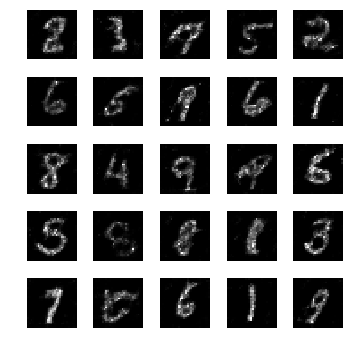

epoch: 1381, time: 5.024299 | train_G_Loss: 0.472847, train_D_loss: 2.178302, train_acc: 0.945312
cv_G_Loss: 1.029856, cv_D_loss: 2.954519, cv_acc: 0.925000

epoch: 1382, time: 5.021304 | train_G_Loss: 0.445226, train_D_loss: 2.245312, train_acc: 0.933594
cv_G_Loss: 1.936342, cv_D_loss: 4.894881, cv_acc: 0.780100

epoch: 1383, time: 5.002905 | train_G_Loss: 0.400725, train_D_loss: 2.350612, train_acc: 0.927734
cv_G_Loss: 0.761570, cv_D_loss: 2.629313, cv_acc: 0.911200

epoch: 1384, time: 4.995980 | train_G_Loss: 0.300469, train_D_loss: 2.210603, train_acc: 0.925781
cv_G_Loss: 0.210229, cv_D_loss: 2.485766, cv_acc: 0.931200

epoch: 1385, time: 4.992604 | train_G_Loss: 0.346714, train_D_loss: 2.280310, train_acc: 0.910156
cv_G_Loss: 0.334397, cv_D_loss: 2.345431, cv_acc: 0.915200

epoch: 1386, time: 4.994179 | train_G_Loss: 0.419459, train_D_loss: 2.437307, train_acc: 0.929688
cv_G_Loss: 1.235864, cv_D_loss: 3.588921, cv_acc: 0.737800

epoch: 1387, time: 5.069076 | train_G_Loss: 0.421473

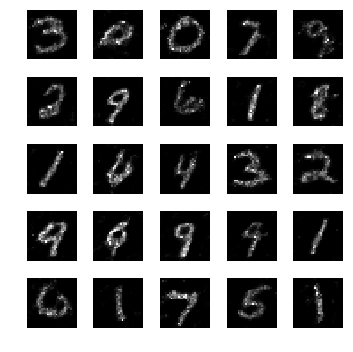

epoch: 1391, time: 5.025589 | train_G_Loss: 0.432424, train_D_loss: 2.288686, train_acc: 0.925781
cv_G_Loss: 0.889268, cv_D_loss: 2.796873, cv_acc: 0.902200

epoch: 1392, time: 4.988654 | train_G_Loss: 0.404323, train_D_loss: 2.299837, train_acc: 0.916016
cv_G_Loss: 0.470840, cv_D_loss: 2.349078, cv_acc: 0.927200

epoch: 1393, time: 4.995830 | train_G_Loss: 0.437284, train_D_loss: 2.338140, train_acc: 0.898438
cv_G_Loss: 0.604207, cv_D_loss: 2.848866, cv_acc: 0.772600

epoch: 1394, time: 4.987775 | train_G_Loss: 0.414322, train_D_loss: 2.536855, train_acc: 0.917969
cv_G_Loss: 1.208873, cv_D_loss: 3.352342, cv_acc: 0.869600

epoch: 1395, time: 5.004455 | train_G_Loss: 0.433823, train_D_loss: 2.292618, train_acc: 0.941406
cv_G_Loss: 0.366840, cv_D_loss: 2.324481, cv_acc: 0.933600

epoch: 1396, time: 5.004297 | train_G_Loss: 0.503933, train_D_loss: 2.168682, train_acc: 0.935547
cv_G_Loss: 0.697512, cv_D_loss: 2.524801, cv_acc: 0.919600

epoch: 1397, time: 4.994556 | train_G_Loss: 0.358735

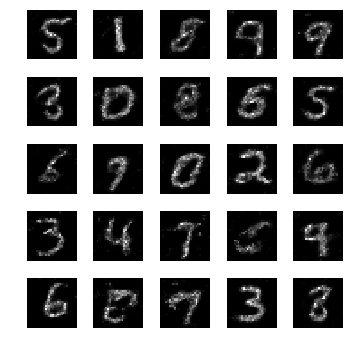

epoch: 1401, time: 5.019333 | train_G_Loss: 0.464556, train_D_loss: 2.219259, train_acc: 0.912109
cv_G_Loss: 1.096730, cv_D_loss: 3.319797, cv_acc: 0.841100

epoch: 1402, time: 4.996121 | train_G_Loss: 0.362983, train_D_loss: 2.210752, train_acc: 0.925781
cv_G_Loss: 2.517059, cv_D_loss: 5.591208, cv_acc: 0.873400

epoch: 1403, time: 4.998623 | train_G_Loss: 0.370108, train_D_loss: 2.240402, train_acc: 0.941406
cv_G_Loss: 0.970636, cv_D_loss: 2.984900, cv_acc: 0.886400

epoch: 1404, time: 4.978257 | train_G_Loss: 0.471103, train_D_loss: 2.292524, train_acc: 0.941406
cv_G_Loss: 0.295320, cv_D_loss: 2.340636, cv_acc: 0.921500

epoch: 1405, time: 5.030922 | train_G_Loss: 0.413110, train_D_loss: 2.236736, train_acc: 0.937500
cv_G_Loss: 0.652731, cv_D_loss: 2.447506, cv_acc: 0.927900

epoch: 1406, time: 5.002505 | train_G_Loss: 0.292173, train_D_loss: 2.371247, train_acc: 0.916016
cv_G_Loss: 0.420452, cv_D_loss: 2.500887, cv_acc: 0.890700

epoch: 1407, time: 5.000769 | train_G_Loss: 0.403192

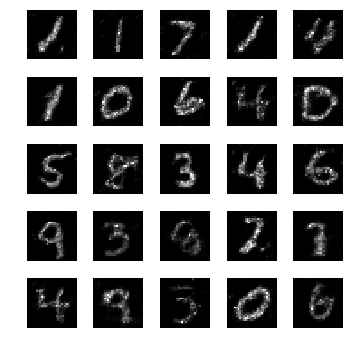

epoch: 1411, time: 5.018949 | train_G_Loss: 0.360529, train_D_loss: 2.458714, train_acc: 0.919922
cv_G_Loss: 0.517630, cv_D_loss: 2.378973, cv_acc: 0.925100

epoch: 1412, time: 5.006267 | train_G_Loss: 0.308265, train_D_loss: 2.259683, train_acc: 0.949219
cv_G_Loss: 0.215029, cv_D_loss: 2.607580, cv_acc: 0.890900

epoch: 1413, time: 5.009220 | train_G_Loss: 0.544055, train_D_loss: 2.323457, train_acc: 0.935547
cv_G_Loss: 2.277662, cv_D_loss: 5.124924, cv_acc: 0.903000

epoch: 1414, time: 4.987311 | train_G_Loss: 0.399931, train_D_loss: 2.344326, train_acc: 0.927734
cv_G_Loss: 0.566037, cv_D_loss: 2.682453, cv_acc: 0.796200

epoch: 1415, time: 5.000202 | train_G_Loss: 0.380958, train_D_loss: 2.306070, train_acc: 0.949219
cv_G_Loss: 0.913167, cv_D_loss: 2.874473, cv_acc: 0.930200

epoch: 1416, time: 4.999340 | train_G_Loss: 0.479715, train_D_loss: 2.200174, train_acc: 0.927734
cv_G_Loss: 0.596787, cv_D_loss: 2.556272, cv_acc: 0.889700

epoch: 1417, time: 4.990657 | train_G_Loss: 0.344129

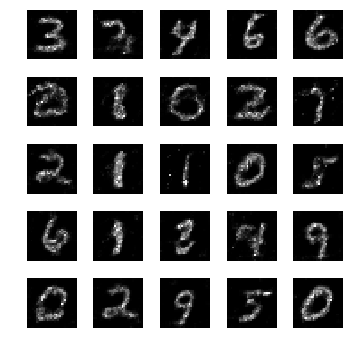

epoch: 1421, time: 5.015486 | train_G_Loss: 0.477444, train_D_loss: 2.148655, train_acc: 0.945312
cv_G_Loss: 1.409673, cv_D_loss: 4.101324, cv_acc: 0.656400

epoch: 1422, time: 5.002276 | train_G_Loss: 0.349676, train_D_loss: 2.203176, train_acc: 0.945312
cv_G_Loss: 0.497225, cv_D_loss: 2.342510, cv_acc: 0.914500

epoch: 1423, time: 4.995091 | train_G_Loss: 0.312994, train_D_loss: 2.386318, train_acc: 0.929688
cv_G_Loss: 0.291564, cv_D_loss: 2.389840, cv_acc: 0.919500

epoch: 1424, time: 5.011342 | train_G_Loss: 0.260951, train_D_loss: 2.485575, train_acc: 0.931641
cv_G_Loss: 0.353121, cv_D_loss: 2.222931, cv_acc: 0.932500

epoch: 1425, time: 4.990596 | train_G_Loss: 0.354713, train_D_loss: 2.354493, train_acc: 0.945312
cv_G_Loss: 1.833507, cv_D_loss: 4.452076, cv_acc: 0.783000

epoch: 1426, time: 4.999286 | train_G_Loss: 0.442548, train_D_loss: 2.226512, train_acc: 0.925781
cv_G_Loss: 0.613647, cv_D_loss: 2.997772, cv_acc: 0.758100

epoch: 1427, time: 5.036633 | train_G_Loss: 0.438834

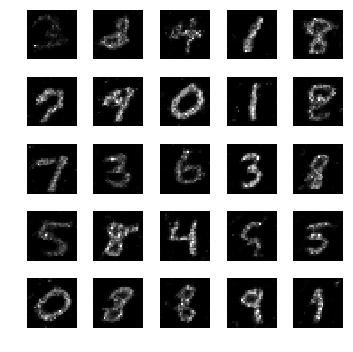

epoch: 1431, time: 5.033104 | train_G_Loss: 0.304589, train_D_loss: 2.289767, train_acc: 0.953125
cv_G_Loss: 1.215643, cv_D_loss: 3.091647, cv_acc: 0.902700

epoch: 1432, time: 5.007731 | train_G_Loss: 0.611689, train_D_loss: 2.450130, train_acc: 0.935547
cv_G_Loss: 0.991493, cv_D_loss: 2.988042, cv_acc: 0.918100

epoch: 1433, time: 5.000505 | train_G_Loss: 0.375851, train_D_loss: 2.319698, train_acc: 0.923828
cv_G_Loss: 1.265894, cv_D_loss: 3.335685, cv_acc: 0.920400

epoch: 1434, time: 4.992461 | train_G_Loss: 0.479020, train_D_loss: 2.198771, train_acc: 0.947266
cv_G_Loss: 1.650689, cv_D_loss: 4.015222, cv_acc: 0.912200

epoch: 1435, time: 5.004174 | train_G_Loss: 0.425291, train_D_loss: 2.113008, train_acc: 0.939453
cv_G_Loss: 1.183641, cv_D_loss: 3.796106, cv_acc: 0.801200

epoch: 1436, time: 4.994605 | train_G_Loss: 0.240302, train_D_loss: 2.525387, train_acc: 0.923828
cv_G_Loss: 0.567405, cv_D_loss: 2.474619, cv_acc: 0.915000

epoch: 1437, time: 5.003366 | train_G_Loss: 0.319955

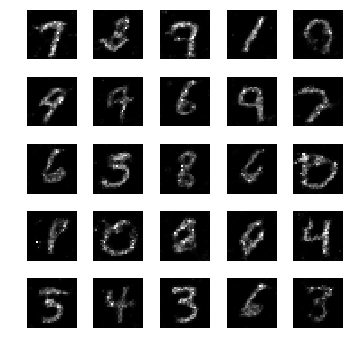

epoch: 1441, time: 5.041004 | train_G_Loss: 0.363510, train_D_loss: 2.363193, train_acc: 0.939453
cv_G_Loss: 1.083189, cv_D_loss: 3.111738, cv_acc: 0.885700

epoch: 1442, time: 5.009449 | train_G_Loss: 0.378251, train_D_loss: 2.222604, train_acc: 0.939453
cv_G_Loss: 0.709335, cv_D_loss: 2.690526, cv_acc: 0.870800

epoch: 1443, time: 4.997798 | train_G_Loss: 0.425733, train_D_loss: 2.188610, train_acc: 0.914062
cv_G_Loss: 0.707723, cv_D_loss: 2.665341, cv_acc: 0.889800

epoch: 1444, time: 4.995081 | train_G_Loss: 0.422124, train_D_loss: 2.563133, train_acc: 0.902344
cv_G_Loss: 0.432532, cv_D_loss: 2.410931, cv_acc: 0.911200

epoch: 1445, time: 5.013665 | train_G_Loss: 0.377092, train_D_loss: 2.235917, train_acc: 0.927734
cv_G_Loss: 0.319443, cv_D_loss: 2.306653, cv_acc: 0.937400
Model saved

epoch: 1446, time: 5.000602 | train_G_Loss: 0.396421, train_D_loss: 2.143547, train_acc: 0.947266
cv_G_Loss: 1.024665, cv_D_loss: 3.012789, cv_acc: 0.902600

epoch: 1447, time: 4.967678 | train_G_Lo

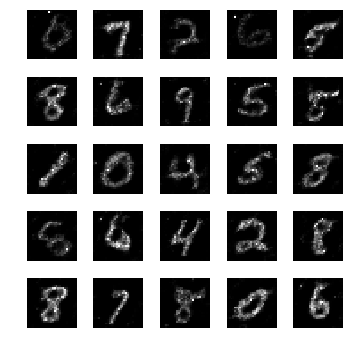

epoch: 1451, time: 5.003366 | train_G_Loss: 0.337253, train_D_loss: 2.231276, train_acc: 0.910156
cv_G_Loss: 0.782859, cv_D_loss: 2.593834, cv_acc: 0.907200

epoch: 1452, time: 4.964260 | train_G_Loss: 0.397645, train_D_loss: 2.397213, train_acc: 0.927734
cv_G_Loss: 0.198544, cv_D_loss: 2.605051, cv_acc: 0.919100

epoch: 1453, time: 4.972343 | train_G_Loss: 0.380269, train_D_loss: 2.488941, train_acc: 0.914062
cv_G_Loss: 0.945779, cv_D_loss: 2.854334, cv_acc: 0.915700

epoch: 1454, time: 4.963551 | train_G_Loss: 0.360758, train_D_loss: 2.285027, train_acc: 0.912109
cv_G_Loss: 1.197743, cv_D_loss: 3.267664, cv_acc: 0.877400

epoch: 1455, time: 4.976723 | train_G_Loss: 0.410838, train_D_loss: 2.258879, train_acc: 0.925781
cv_G_Loss: 1.095969, cv_D_loss: 2.994339, cv_acc: 0.932500

epoch: 1456, time: 4.970054 | train_G_Loss: 0.367432, train_D_loss: 2.268435, train_acc: 0.937500
cv_G_Loss: 0.901601, cv_D_loss: 2.820514, cv_acc: 0.916600

epoch: 1457, time: 4.967591 | train_G_Loss: 0.414416

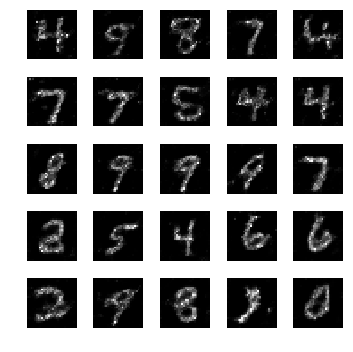

epoch: 1461, time: 5.000657 | train_G_Loss: 0.339676, train_D_loss: 2.283107, train_acc: 0.941406
cv_G_Loss: 0.478430, cv_D_loss: 2.304647, cv_acc: 0.935400

epoch: 1462, time: 4.977562 | train_G_Loss: 0.426547, train_D_loss: 2.177942, train_acc: 0.900391
cv_G_Loss: 0.878138, cv_D_loss: 3.163569, cv_acc: 0.797500

epoch: 1463, time: 4.976263 | train_G_Loss: 0.414232, train_D_loss: 2.388097, train_acc: 0.900391
cv_G_Loss: 1.111441, cv_D_loss: 3.908230, cv_acc: 0.513700

epoch: 1464, time: 4.976867 | train_G_Loss: 0.430733, train_D_loss: 2.319129, train_acc: 0.941406
cv_G_Loss: 0.429478, cv_D_loss: 2.326808, cv_acc: 0.933800

epoch: 1465, time: 4.964981 | train_G_Loss: 0.346294, train_D_loss: 2.121997, train_acc: 0.929688
cv_G_Loss: 0.293578, cv_D_loss: 2.303753, cv_acc: 0.938300
Model saved

epoch: 1466, time: 5.009356 | train_G_Loss: 0.407897, train_D_loss: 2.242821, train_acc: 0.933594
cv_G_Loss: 1.907448, cv_D_loss: 4.501819, cv_acc: 0.914100

epoch: 1467, time: 4.989581 | train_G_Lo

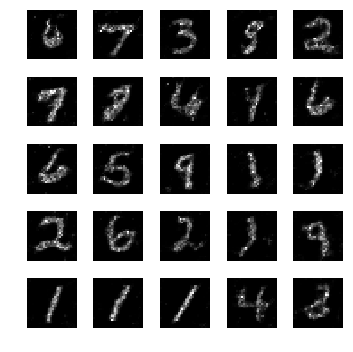

epoch: 1471, time: 5.034099 | train_G_Loss: 0.429809, train_D_loss: 2.179205, train_acc: 0.955078
cv_G_Loss: 0.687426, cv_D_loss: 2.709420, cv_acc: 0.885000

epoch: 1472, time: 4.986713 | train_G_Loss: 0.347411, train_D_loss: 2.265388, train_acc: 0.955078
cv_G_Loss: 1.122355, cv_D_loss: 3.134798, cv_acc: 0.914700

epoch: 1473, time: 4.970479 | train_G_Loss: 0.376543, train_D_loss: 2.178424, train_acc: 0.947266
cv_G_Loss: 0.365570, cv_D_loss: 2.282122, cv_acc: 0.927000

epoch: 1474, time: 4.971739 | train_G_Loss: 0.403621, train_D_loss: 2.175418, train_acc: 0.953125
cv_G_Loss: 1.658874, cv_D_loss: 4.215142, cv_acc: 0.838800

epoch: 1475, time: 4.986513 | train_G_Loss: 0.457986, train_D_loss: 2.113520, train_acc: 0.949219
cv_G_Loss: 0.915255, cv_D_loss: 3.107989, cv_acc: 0.788800

epoch: 1476, time: 4.970872 | train_G_Loss: 0.432073, train_D_loss: 2.080688, train_acc: 0.955078
cv_G_Loss: 0.713567, cv_D_loss: 2.696361, cv_acc: 0.891500

epoch: 1477, time: 4.987671 | train_G_Loss: 0.316486

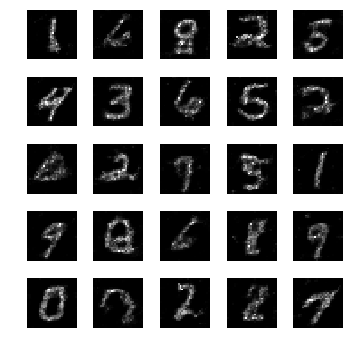

epoch: 1481, time: 4.991386 | train_G_Loss: 0.473514, train_D_loss: 1.984384, train_acc: 0.966797
cv_G_Loss: 0.176479, cv_D_loss: 2.576691, cv_acc: 0.925300

epoch: 1482, time: 4.993586 | train_G_Loss: 0.335903, train_D_loss: 2.175768, train_acc: 0.966797
cv_G_Loss: 0.587452, cv_D_loss: 2.347075, cv_acc: 0.925600

epoch: 1483, time: 4.982737 | train_G_Loss: 0.330494, train_D_loss: 2.255815, train_acc: 0.988281
cv_G_Loss: 0.913544, cv_D_loss: 2.856185, cv_acc: 0.917400

epoch: 1484, time: 4.979073 | train_G_Loss: 0.317525, train_D_loss: 2.126801, train_acc: 0.957031
cv_G_Loss: 0.647274, cv_D_loss: 2.528394, cv_acc: 0.882800

epoch: 1485, time: 4.984993 | train_G_Loss: 0.378461, train_D_loss: 2.357800, train_acc: 0.947266
cv_G_Loss: 0.608711, cv_D_loss: 2.630548, cv_acc: 0.859000

epoch: 1486, time: 4.980857 | train_G_Loss: 0.361503, train_D_loss: 2.184443, train_acc: 0.958984
cv_G_Loss: 0.513833, cv_D_loss: 2.670932, cv_acc: 0.847400

epoch: 1487, time: 4.963272 | train_G_Loss: 0.353540

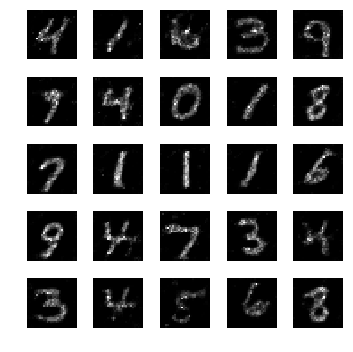

epoch: 1491, time: 5.002313 | train_G_Loss: 0.595905, train_D_loss: 2.276237, train_acc: 0.955078
cv_G_Loss: 0.591663, cv_D_loss: 2.428362, cv_acc: 0.923700

epoch: 1492, time: 4.983054 | train_G_Loss: 0.424328, train_D_loss: 2.291381, train_acc: 0.935547
cv_G_Loss: 0.630586, cv_D_loss: 2.497931, cv_acc: 0.912800

epoch: 1493, time: 4.977431 | train_G_Loss: 0.378804, train_D_loss: 2.169659, train_acc: 0.923828
cv_G_Loss: 0.747580, cv_D_loss: 2.777551, cv_acc: 0.892100

epoch: 1494, time: 5.002941 | train_G_Loss: 0.367142, train_D_loss: 2.458997, train_acc: 0.916016
cv_G_Loss: 2.185754, cv_D_loss: 5.609577, cv_acc: 0.613900

epoch: 1495, time: 4.988250 | train_G_Loss: 0.404021, train_D_loss: 2.439001, train_acc: 0.935547
cv_G_Loss: 1.141959, cv_D_loss: 3.909499, cv_acc: 0.687000

epoch: 1496, time: 4.964597 | train_G_Loss: 0.403423, train_D_loss: 2.270966, train_acc: 0.927734
cv_G_Loss: 1.519271, cv_D_loss: 3.915608, cv_acc: 0.855200

epoch: 1497, time: 4.987818 | train_G_Loss: 0.382561

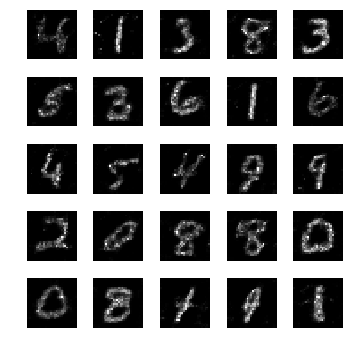

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

Generator summary:
 z: (?, 100)
 G0: (?, 1, 1, 100)
 G1: (?, 2, 2, 100)
 G2: (?, 5, 5, 64)
 G3: (?, 12, 12, 32)
 G4: (?, 28, 28, 1)

Discriminator summary:
 x: (?, 28, 28, 1)
 D1: (?, 14, 14, 32)
 D2: (?, 7, 7, 64)
 D3: (?, 4, 4, 128)
 D4: (?, 2, 2, 128)

training....
Extracting mnist_data\train-images-idx3-ubyte.gz
Extracting mnist_data\train-labels-idx1-ubyte.gz
Extracting mnist_data\t10k-images-idx3-ubyte.gz
Extracting mnist_data\t10k-labels-idx1-ubyte.gz
epoch: 0, time: 6.067626 | train_G_Loss: 0.505540, train_D_loss: 1.545125, train_acc: 0.087273
cv_G_Loss: 0.610527, cv_D_loss: 4.081620, cv_acc: 0.101000
Model saved



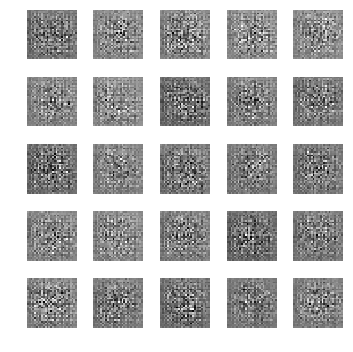

epoch: 1, time: 4.912080 | train_G_Loss: 0.981617, train_D_loss: 0.736443, train_acc: 0.087273
cv_G_Loss: 3.699279, cv_D_loss: 7.348621, cv_acc: 0.098000

epoch: 2, time: 4.891287 | train_G_Loss: 1.418712, train_D_loss: 0.444066, train_acc: 0.087273
cv_G_Loss: 5.498136, cv_D_loss: 11.124294, cv_acc: 0.098000

epoch: 3, time: 4.884306 | train_G_Loss: 1.919942, train_D_loss: 0.269459, train_acc: 0.087273
cv_G_Loss: 7.006984, cv_D_loss: 14.311800, cv_acc: 0.089200

epoch: 4, time: 4.880328 | train_G_Loss: 2.322367, train_D_loss: 0.178784, train_acc: 0.087273
cv_G_Loss: 8.226057, cv_D_loss: 16.535364, cv_acc: 0.089200

epoch: 5, time: 4.886189 | train_G_Loss: 2.626541, train_D_loss: 0.133063, train_acc: 0.087273
cv_G_Loss: 9.260927, cv_D_loss: 17.731161, cv_acc: 0.089200

epoch: 6, time: 4.888727 | train_G_Loss: 2.966033, train_D_loss: 0.098673, train_acc: 0.087273
cv_G_Loss: 10.484168, cv_D_loss: 18.183182, cv_acc: 0.089200

epoch: 7, time: 4.877650 | train_G_Loss: 3.131145, train_D_loss:

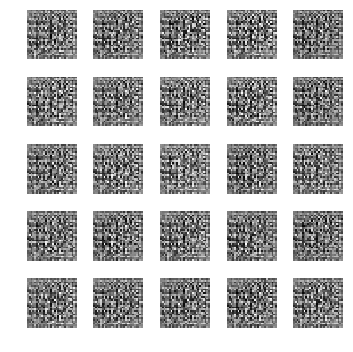

epoch: 11, time: 4.922654 | train_G_Loss: 3.636948, train_D_loss: 0.053925, train_acc: 0.087273
cv_G_Loss: 14.518857, cv_D_loss: 24.714371, cv_acc: 0.089200

epoch: 12, time: 4.875639 | train_G_Loss: 3.884558, train_D_loss: 0.041858, train_acc: 0.087273
cv_G_Loss: 14.925616, cv_D_loss: 25.133196, cv_acc: 0.089200

epoch: 13, time: 4.899999 | train_G_Loss: 4.007685, train_D_loss: 0.037092, train_acc: 0.087273
cv_G_Loss: 15.151478, cv_D_loss: 25.480642, cv_acc: 0.089200

epoch: 14, time: 4.878895 | train_G_Loss: 3.960838, train_D_loss: 0.037962, train_acc: 0.087273
cv_G_Loss: 15.391041, cv_D_loss: 26.324358, cv_acc: 0.089200

epoch: 15, time: 4.911868 | train_G_Loss: 4.177469, train_D_loss: 0.031522, train_acc: 0.087273
cv_G_Loss: 15.988036, cv_D_loss: 27.739464, cv_acc: 0.089200

epoch: 16, time: 4.883101 | train_G_Loss: 4.172750, train_D_loss: 0.031373, train_acc: 0.087273
cv_G_Loss: 16.560373, cv_D_loss: 28.984713, cv_acc: 0.089200

epoch: 17, time: 4.907198 | train_G_Loss: 4.275551, 

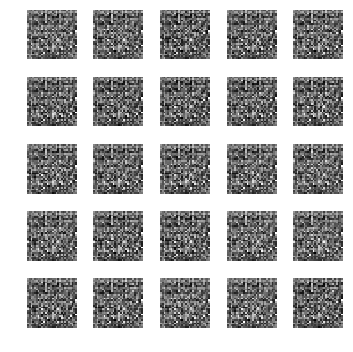

epoch: 21, time: 4.902004 | train_G_Loss: 4.514807, train_D_loss: 0.023367, train_acc: 0.087273
cv_G_Loss: 16.536137, cv_D_loss: 29.291658, cv_acc: 0.089200

epoch: 22, time: 4.871571 | train_G_Loss: 4.729271, train_D_loss: 0.019913, train_acc: 0.087273
cv_G_Loss: 16.510639, cv_D_loss: 29.268501, cv_acc: 0.089200

epoch: 23, time: 4.882552 | train_G_Loss: 4.811629, train_D_loss: 0.018348, train_acc: 0.087273
cv_G_Loss: 16.349144, cv_D_loss: 29.482489, cv_acc: 0.089200

epoch: 24, time: 4.876394 | train_G_Loss: 4.884017, train_D_loss: 0.017202, train_acc: 0.087273
cv_G_Loss: 15.975694, cv_D_loss: 30.344772, cv_acc: 0.089200

epoch: 25, time: 4.875954 | train_G_Loss: 4.990390, train_D_loss: 0.015567, train_acc: 0.087273
cv_G_Loss: 15.646310, cv_D_loss: 30.747540, cv_acc: 0.100900

epoch: 26, time: 4.881754 | train_G_Loss: 4.949100, train_D_loss: 0.015676, train_acc: 0.087273
cv_G_Loss: 15.271052, cv_D_loss: 30.495424, cv_acc: 0.100900

epoch: 27, time: 4.875138 | train_G_Loss: 4.779800, 

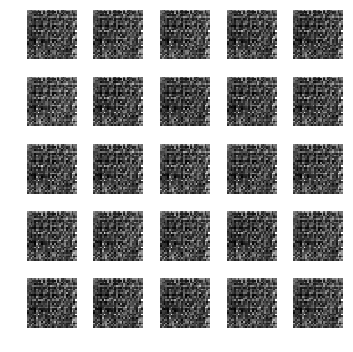

epoch: 31, time: 4.896432 | train_G_Loss: 4.992901, train_D_loss: 0.017205, train_acc: 0.087273
cv_G_Loss: 12.387918, cv_D_loss: 30.677225, cv_acc: 0.100900

epoch: 32, time: 4.880526 | train_G_Loss: 5.115581, train_D_loss: 0.015705, train_acc: 0.087273
cv_G_Loss: 12.211845, cv_D_loss: 31.389593, cv_acc: 0.100900

epoch: 33, time: 4.869178 | train_G_Loss: 5.232045, train_D_loss: 0.014331, train_acc: 0.105455
cv_G_Loss: 11.368006, cv_D_loss: 31.640150, cv_acc: 0.100900

epoch: 34, time: 4.874442 | train_G_Loss: 5.366159, train_D_loss: 0.012606, train_acc: 0.105455
cv_G_Loss: 10.848364, cv_D_loss: 30.453808, cv_acc: 0.089500

epoch: 35, time: 4.884921 | train_G_Loss: 5.419722, train_D_loss: 0.011573, train_acc: 0.105455
cv_G_Loss: 10.931997, cv_D_loss: 29.510347, cv_acc: 0.098000

epoch: 36, time: 4.874404 | train_G_Loss: 5.275919, train_D_loss: 0.012355, train_acc: 0.105455
cv_G_Loss: 10.552507, cv_D_loss: 29.050467, cv_acc: 0.098000

epoch: 37, time: 4.877370 | train_G_Loss: 4.973305, 

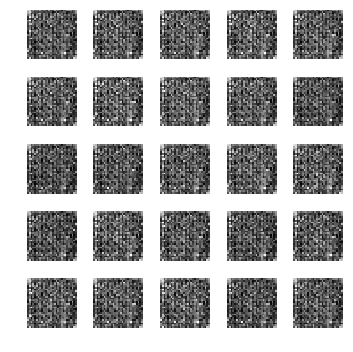

epoch: 41, time: 4.900175 | train_G_Loss: 4.461523, train_D_loss: 0.026838, train_acc: 0.087273
cv_G_Loss: 6.513141, cv_D_loss: 25.443214, cv_acc: 0.101000

epoch: 42, time: 4.855763 | train_G_Loss: 4.417957, train_D_loss: 0.027985, train_acc: 0.085455
cv_G_Loss: 6.391210, cv_D_loss: 24.233023, cv_acc: 0.101000

epoch: 43, time: 4.886140 | train_G_Loss: 4.389454, train_D_loss: 0.028708, train_acc: 0.087273
cv_G_Loss: 5.606352, cv_D_loss: 23.698980, cv_acc: 0.101000

epoch: 44, time: 4.873962 | train_G_Loss: 4.212974, train_D_loss: 0.033790, train_acc: 0.087273
cv_G_Loss: 5.261791, cv_D_loss: 24.128256, cv_acc: 0.101000

epoch: 45, time: 4.868561 | train_G_Loss: 3.988488, train_D_loss: 0.042200, train_acc: 0.087273
cv_G_Loss: 5.059046, cv_D_loss: 26.238495, cv_acc: 0.101000

epoch: 46, time: 4.863693 | train_G_Loss: 3.836081, train_D_loss: 0.048409, train_acc: 0.087273
cv_G_Loss: 4.800131, cv_D_loss: 28.242393, cv_acc: 0.101000

epoch: 47, time: 4.874566 | train_G_Loss: 3.668268, train_

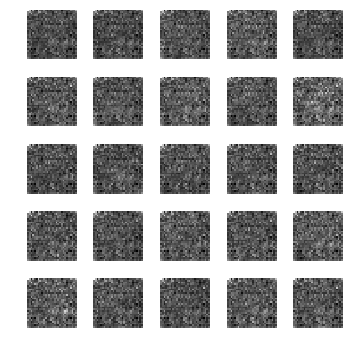

epoch: 51, time: 4.894927 | train_G_Loss: 2.895607, train_D_loss: 0.145909, train_acc: 0.087273
cv_G_Loss: 3.474631, cv_D_loss: 27.418726, cv_acc: 0.089200

epoch: 52, time: 4.881784 | train_G_Loss: 2.763292, train_D_loss: 0.184378, train_acc: 0.087273
cv_G_Loss: 3.002057, cv_D_loss: 25.602766, cv_acc: 0.089200

epoch: 53, time: 4.871704 | train_G_Loss: 2.644521, train_D_loss: 0.240474, train_acc: 0.087273
cv_G_Loss: 2.795055, cv_D_loss: 23.398125, cv_acc: 0.089200

epoch: 54, time: 4.876483 | train_G_Loss: 2.140906, train_D_loss: 0.284212, train_acc: 0.087273
cv_G_Loss: 1.818026, cv_D_loss: 20.072081, cv_acc: 0.089200

epoch: 55, time: 4.868588 | train_G_Loss: 1.889401, train_D_loss: 0.341548, train_acc: 0.087273
cv_G_Loss: 1.353558, cv_D_loss: 18.144276, cv_acc: 0.089200

epoch: 56, time: 4.868264 | train_G_Loss: 1.776361, train_D_loss: 0.405950, train_acc: 0.087273
cv_G_Loss: 1.277084, cv_D_loss: 17.589991, cv_acc: 0.089200

epoch: 57, time: 4.861810 | train_G_Loss: 1.788681, train_

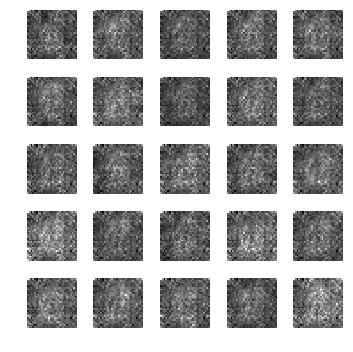

epoch: 61, time: 4.955110 | train_G_Loss: 1.278558, train_D_loss: 0.668159, train_acc: 0.087273
cv_G_Loss: 3.586379, cv_D_loss: 16.395687, cv_acc: 0.089200

epoch: 62, time: 4.869817 | train_G_Loss: 1.285511, train_D_loss: 0.726000, train_acc: 0.087273
cv_G_Loss: 1.763613, cv_D_loss: 15.203902, cv_acc: 0.089200

epoch: 63, time: 4.867219 | train_G_Loss: 1.127660, train_D_loss: 0.790858, train_acc: 0.087273
cv_G_Loss: 3.273923, cv_D_loss: 16.819033, cv_acc: 0.089200

epoch: 64, time: 4.878365 | train_G_Loss: 1.092525, train_D_loss: 0.862465, train_acc: 0.087273
cv_G_Loss: 1.486161, cv_D_loss: 11.690846, cv_acc: 0.089200

epoch: 65, time: 4.874852 | train_G_Loss: 1.075545, train_D_loss: 0.849769, train_acc: 0.087273
cv_G_Loss: 2.140382, cv_D_loss: 16.814753, cv_acc: 0.089200

epoch: 66, time: 4.870667 | train_G_Loss: 0.970531, train_D_loss: 0.983308, train_acc: 0.087273
cv_G_Loss: 2.991482, cv_D_loss: 15.584698, cv_acc: 0.089200

epoch: 67, time: 4.870236 | train_G_Loss: 1.004933, train_

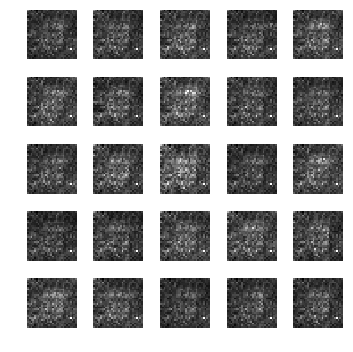

epoch: 71, time: 4.902424 | train_G_Loss: 0.856627, train_D_loss: 1.109266, train_acc: 0.087273
cv_G_Loss: 0.565759, cv_D_loss: 9.113812, cv_acc: 0.089200

epoch: 72, time: 4.871535 | train_G_Loss: 0.913577, train_D_loss: 0.987970, train_acc: 0.087273
cv_G_Loss: 0.849579, cv_D_loss: 9.184447, cv_acc: 0.089200

epoch: 73, time: 4.867554 | train_G_Loss: 0.838461, train_D_loss: 1.133211, train_acc: 0.087273
cv_G_Loss: 0.657009, cv_D_loss: 10.579951, cv_acc: 0.089200

epoch: 74, time: 4.870890 | train_G_Loss: 0.879056, train_D_loss: 1.075086, train_acc: 0.087273
cv_G_Loss: 1.333338, cv_D_loss: 10.150444, cv_acc: 0.089200

epoch: 75, time: 4.870777 | train_G_Loss: 0.845716, train_D_loss: 1.148710, train_acc: 0.087273
cv_G_Loss: 2.885582, cv_D_loss: 13.192185, cv_acc: 0.089200

epoch: 76, time: 4.869459 | train_G_Loss: 0.852719, train_D_loss: 1.115675, train_acc: 0.087273
cv_G_Loss: 0.987935, cv_D_loss: 9.475680, cv_acc: 0.089200

epoch: 77, time: 4.872441 | train_G_Loss: 0.838237, train_D_l

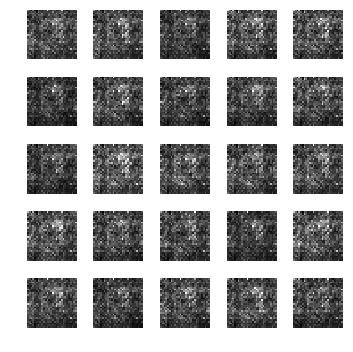

epoch: 81, time: 4.898577 | train_G_Loss: 0.822851, train_D_loss: 1.176976, train_acc: 0.087273
cv_G_Loss: 0.798049, cv_D_loss: 7.886389, cv_acc: 0.089200

epoch: 82, time: 4.870001 | train_G_Loss: 0.839831, train_D_loss: 1.132508, train_acc: 0.087273
cv_G_Loss: 0.274718, cv_D_loss: 6.816676, cv_acc: 0.089200

epoch: 83, time: 4.869317 | train_G_Loss: 0.801105, train_D_loss: 1.172601, train_acc: 0.087273
cv_G_Loss: 0.514837, cv_D_loss: 7.062889, cv_acc: 0.089200

epoch: 84, time: 4.923416 | train_G_Loss: 0.859268, train_D_loss: 1.129387, train_acc: 0.087273
cv_G_Loss: 1.118334, cv_D_loss: 7.364409, cv_acc: 0.089200

epoch: 85, time: 4.871923 | train_G_Loss: 0.846635, train_D_loss: 1.157173, train_acc: 0.087273
cv_G_Loss: 1.187229, cv_D_loss: 8.034269, cv_acc: 0.089200

epoch: 86, time: 4.870822 | train_G_Loss: 0.832264, train_D_loss: 1.157070, train_acc: 0.087273
cv_G_Loss: 0.373237, cv_D_loss: 6.525178, cv_acc: 0.089200

epoch: 87, time: 4.872019 | train_G_Loss: 0.860071, train_D_loss

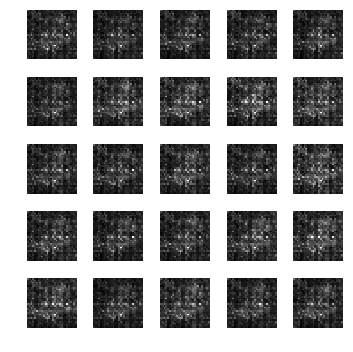

epoch: 91, time: 4.914122 | train_G_Loss: 0.809866, train_D_loss: 1.195046, train_acc: 0.087273
cv_G_Loss: 0.996281, cv_D_loss: 7.317812, cv_acc: 0.089200

epoch: 92, time: 4.867088 | train_G_Loss: 0.781540, train_D_loss: 1.232733, train_acc: 0.087273
cv_G_Loss: 0.368721, cv_D_loss: 6.415994, cv_acc: 0.089200

epoch: 93, time: 4.872764 | train_G_Loss: 0.756171, train_D_loss: 1.279704, train_acc: 0.087273
cv_G_Loss: 0.460432, cv_D_loss: 6.293589, cv_acc: 0.089200

epoch: 94, time: 4.867821 | train_G_Loss: 0.787400, train_D_loss: 1.218027, train_acc: 0.087273
cv_G_Loss: 2.781410, cv_D_loss: 9.654945, cv_acc: 0.089200

epoch: 95, time: 4.867473 | train_G_Loss: 0.764154, train_D_loss: 1.253186, train_acc: 0.087273
cv_G_Loss: 0.347747, cv_D_loss: 5.882081, cv_acc: 0.089200

epoch: 96, time: 4.864751 | train_G_Loss: 0.754155, train_D_loss: 1.256369, train_acc: 0.087273
cv_G_Loss: 0.512265, cv_D_loss: 6.336505, cv_acc: 0.089200

epoch: 97, time: 4.859205 | train_G_Loss: 0.742289, train_D_loss

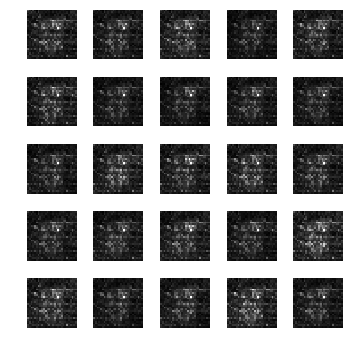

epoch: 101, time: 4.899893 | train_G_Loss: 0.765635, train_D_loss: 1.252613, train_acc: 0.087273
cv_G_Loss: 0.513908, cv_D_loss: 5.989328, cv_acc: 0.089200

epoch: 102, time: 4.869342 | train_G_Loss: 0.721278, train_D_loss: 1.354645, train_acc: 0.087273
cv_G_Loss: 0.610741, cv_D_loss: 6.215663, cv_acc: 0.089200

epoch: 103, time: 4.866053 | train_G_Loss: 0.714596, train_D_loss: 1.349471, train_acc: 0.087273
cv_G_Loss: 0.483042, cv_D_loss: 6.417200, cv_acc: 0.089200

epoch: 104, time: 4.874810 | train_G_Loss: 0.745358, train_D_loss: 1.310822, train_acc: 0.087273
cv_G_Loss: 2.279627, cv_D_loss: 9.146663, cv_acc: 0.089200

epoch: 105, time: 4.890346 | train_G_Loss: 0.732437, train_D_loss: 1.296624, train_acc: 0.087273
cv_G_Loss: 0.185065, cv_D_loss: 6.096373, cv_acc: 0.089200

epoch: 106, time: 4.898702 | train_G_Loss: 0.734920, train_D_loss: 1.306029, train_acc: 0.087273
cv_G_Loss: 0.435275, cv_D_loss: 6.184879, cv_acc: 0.089200

epoch: 107, time: 5.003132 | train_G_Loss: 0.756029, train

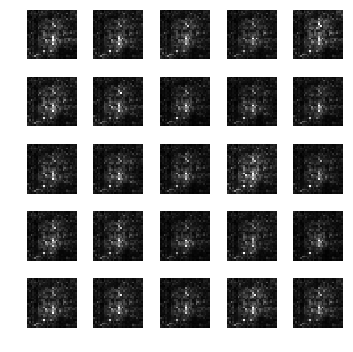

epoch: 111, time: 4.967557 | train_G_Loss: 0.748785, train_D_loss: 1.311800, train_acc: 0.087273
cv_G_Loss: 0.618051, cv_D_loss: 6.003506, cv_acc: 0.089200

epoch: 112, time: 4.984916 | train_G_Loss: 0.707875, train_D_loss: 1.363178, train_acc: 0.087273
cv_G_Loss: 0.169061, cv_D_loss: 5.767762, cv_acc: 0.089200

epoch: 113, time: 4.994191 | train_G_Loss: 0.734247, train_D_loss: 1.311632, train_acc: 0.087273
cv_G_Loss: 0.615414, cv_D_loss: 5.297400, cv_acc: 0.089200

epoch: 114, time: 4.871064 | train_G_Loss: 0.736728, train_D_loss: 1.305052, train_acc: 0.087273
cv_G_Loss: 0.326820, cv_D_loss: 5.142284, cv_acc: 0.089200

epoch: 115, time: 4.869643 | train_G_Loss: 0.732244, train_D_loss: 1.311777, train_acc: 0.087273
cv_G_Loss: 0.519760, cv_D_loss: 5.346598, cv_acc: 0.089200

epoch: 116, time: 4.866226 | train_G_Loss: 0.728970, train_D_loss: 1.320381, train_acc: 0.087273
cv_G_Loss: 0.488612, cv_D_loss: 5.286892, cv_acc: 0.089200

epoch: 117, time: 4.881840 | train_G_Loss: 0.712272, train

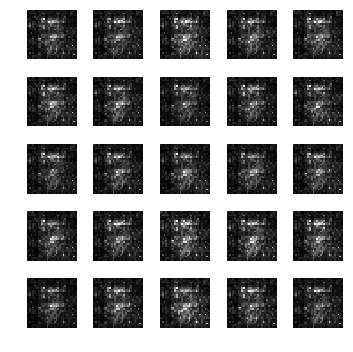

epoch: 121, time: 4.923364 | train_G_Loss: 0.733884, train_D_loss: 1.317038, train_acc: 0.087273
cv_G_Loss: 0.336980, cv_D_loss: 5.443629, cv_acc: 0.089200

epoch: 122, time: 4.969793 | train_G_Loss: 0.738981, train_D_loss: 1.311857, train_acc: 0.087273
cv_G_Loss: 0.671579, cv_D_loss: 5.654380, cv_acc: 0.089200

epoch: 123, time: 4.883466 | train_G_Loss: 0.724687, train_D_loss: 1.316364, train_acc: 0.087273
cv_G_Loss: 0.614083, cv_D_loss: 5.269381, cv_acc: 0.089200

epoch: 124, time: 4.875736 | train_G_Loss: 0.737174, train_D_loss: 1.309717, train_acc: 0.087273
cv_G_Loss: 2.520639, cv_D_loss: 8.190158, cv_acc: 0.089200

epoch: 125, time: 4.873196 | train_G_Loss: 0.714160, train_D_loss: 1.357460, train_acc: 0.087273
cv_G_Loss: 0.293125, cv_D_loss: 5.027876, cv_acc: 0.089200

epoch: 126, time: 4.865191 | train_G_Loss: 0.754575, train_D_loss: 1.261729, train_acc: 0.087273
cv_G_Loss: 1.134740, cv_D_loss: 6.434822, cv_acc: 0.089200

epoch: 127, time: 4.866155 | train_G_Loss: 0.725660, train

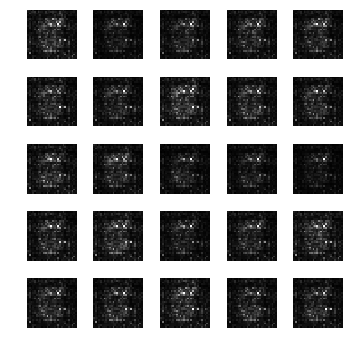

epoch: 131, time: 4.910836 | train_G_Loss: 0.706811, train_D_loss: 1.354801, train_acc: 0.087273
cv_G_Loss: 0.695733, cv_D_loss: 5.173354, cv_acc: 0.089200

epoch: 132, time: 4.872710 | train_G_Loss: 0.734681, train_D_loss: 1.307324, train_acc: 0.087273
cv_G_Loss: 0.253767, cv_D_loss: 5.069921, cv_acc: 0.089200

epoch: 133, time: 4.867598 | train_G_Loss: 0.738256, train_D_loss: 1.290826, train_acc: 0.087273
cv_G_Loss: 0.238576, cv_D_loss: 5.185268, cv_acc: 0.089200

epoch: 134, time: 4.886153 | train_G_Loss: 0.660671, train_D_loss: 1.423852, train_acc: 0.087273
cv_G_Loss: 0.613983, cv_D_loss: 5.244785, cv_acc: 0.089200

epoch: 135, time: 4.866106 | train_G_Loss: 0.694246, train_D_loss: 1.383953, train_acc: 0.087273
cv_G_Loss: 0.769162, cv_D_loss: 5.259881, cv_acc: 0.089200

epoch: 136, time: 4.872475 | train_G_Loss: 0.746068, train_D_loss: 1.284309, train_acc: 0.087273
cv_G_Loss: 1.901047, cv_D_loss: 7.034205, cv_acc: 0.089200

epoch: 137, time: 4.875898 | train_G_Loss: 0.762033, train

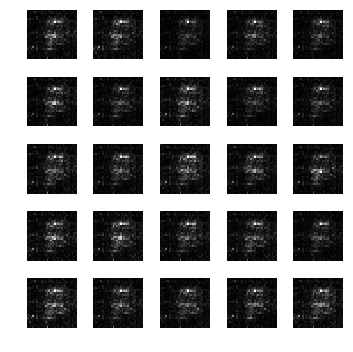

epoch: 141, time: 4.905328 | train_G_Loss: 0.729358, train_D_loss: 1.325143, train_acc: 0.087273
cv_G_Loss: 0.659954, cv_D_loss: 5.197863, cv_acc: 0.089200

epoch: 142, time: 4.878281 | train_G_Loss: 0.716167, train_D_loss: 1.364988, train_acc: 0.087273
cv_G_Loss: 1.723150, cv_D_loss: 6.764650, cv_acc: 0.089200

epoch: 143, time: 4.874328 | train_G_Loss: 0.725731, train_D_loss: 1.331575, train_acc: 0.087273
cv_G_Loss: 0.616544, cv_D_loss: 5.297287, cv_acc: 0.089200

epoch: 144, time: 4.879368 | train_G_Loss: 0.700519, train_D_loss: 1.379989, train_acc: 0.087273
cv_G_Loss: 1.446451, cv_D_loss: 6.016004, cv_acc: 0.089200

epoch: 145, time: 4.866213 | train_G_Loss: 0.690997, train_D_loss: 1.399725, train_acc: 0.087273
cv_G_Loss: 1.000592, cv_D_loss: 5.647948, cv_acc: 0.089200

epoch: 146, time: 4.861572 | train_G_Loss: 0.694821, train_D_loss: 1.371015, train_acc: 0.087273
cv_G_Loss: 1.439543, cv_D_loss: 6.476526, cv_acc: 0.089200

epoch: 147, time: 4.871054 | train_G_Loss: 0.681504, train

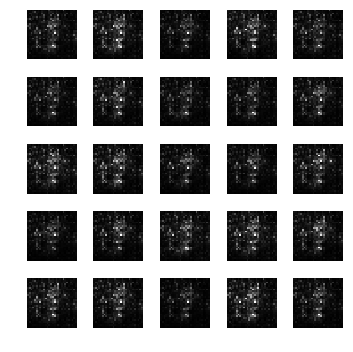

epoch: 151, time: 4.892434 | train_G_Loss: 0.720344, train_D_loss: 1.341586, train_acc: 0.087273
cv_G_Loss: 1.915568, cv_D_loss: 7.029130, cv_acc: 0.089200

epoch: 152, time: 4.866587 | train_G_Loss: 0.697708, train_D_loss: 1.394751, train_acc: 0.087273
cv_G_Loss: 0.501685, cv_D_loss: 4.797451, cv_acc: 0.089200

epoch: 153, time: 4.887926 | train_G_Loss: 0.727588, train_D_loss: 1.333052, train_acc: 0.087273
cv_G_Loss: 2.394892, cv_D_loss: 7.715751, cv_acc: 0.098100

epoch: 154, time: 4.880923 | train_G_Loss: 0.712584, train_D_loss: 1.349166, train_acc: 0.087273
cv_G_Loss: 1.080960, cv_D_loss: 5.282314, cv_acc: 0.089200

epoch: 155, time: 4.878579 | train_G_Loss: 0.704610, train_D_loss: 1.381995, train_acc: 0.100000
cv_G_Loss: 0.635019, cv_D_loss: 4.793824, cv_acc: 0.096300

epoch: 156, time: 4.875034 | train_G_Loss: 0.721237, train_D_loss: 1.339536, train_acc: 0.096364
cv_G_Loss: 1.176581, cv_D_loss: 5.334434, cv_acc: 0.098000

epoch: 157, time: 4.879901 | train_G_Loss: 0.702799, train

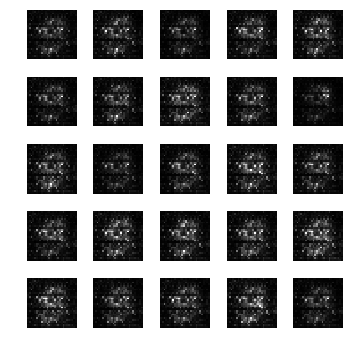

epoch: 161, time: 4.908558 | train_G_Loss: 0.685341, train_D_loss: 1.400492, train_acc: 0.087273
cv_G_Loss: 0.764173, cv_D_loss: 4.933954, cv_acc: 0.089100

epoch: 162, time: 4.866102 | train_G_Loss: 0.688462, train_D_loss: 1.402451, train_acc: 0.105455
cv_G_Loss: 2.758383, cv_D_loss: 8.948722, cv_acc: 0.098300

epoch: 163, time: 4.866324 | train_G_Loss: 0.705588, train_D_loss: 1.364642, train_acc: 0.105455
cv_G_Loss: 0.541990, cv_D_loss: 4.793215, cv_acc: 0.103200
Model saved

epoch: 164, time: 4.890365 | train_G_Loss: 0.702792, train_D_loss: 1.375705, train_acc: 0.105455
cv_G_Loss: 0.430261, cv_D_loss: 4.777975, cv_acc: 0.103200

epoch: 165, time: 4.876266 | train_G_Loss: 0.709394, train_D_loss: 1.363994, train_acc: 0.105455
cv_G_Loss: 0.497491, cv_D_loss: 4.816050, cv_acc: 0.103200

epoch: 166, time: 4.883352 | train_G_Loss: 0.690203, train_D_loss: 1.385137, train_acc: 0.105455
cv_G_Loss: 0.351278, cv_D_loss: 4.750343, cv_acc: 0.103200

epoch: 167, time: 4.873290 | train_G_Loss: 0.7

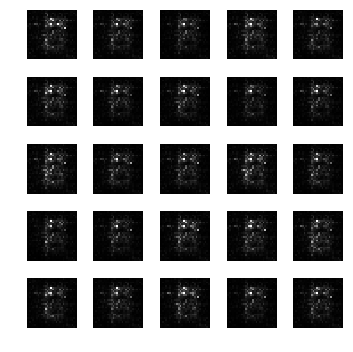

epoch: 171, time: 4.888948 | train_G_Loss: 0.715848, train_D_loss: 1.357543, train_acc: 0.089091
cv_G_Loss: 2.719890, cv_D_loss: 8.221766, cv_acc: 0.098000

epoch: 172, time: 4.852712 | train_G_Loss: 0.683589, train_D_loss: 1.410788, train_acc: 0.096364
cv_G_Loss: 0.650462, cv_D_loss: 4.731582, cv_acc: 0.098000

epoch: 173, time: 4.870191 | train_G_Loss: 0.694150, train_D_loss: 1.390218, train_acc: 0.096364
cv_G_Loss: 0.491007, cv_D_loss: 4.528638, cv_acc: 0.098000

epoch: 174, time: 4.865031 | train_G_Loss: 0.700535, train_D_loss: 1.371191, train_acc: 0.096364
cv_G_Loss: 0.854816, cv_D_loss: 4.863527, cv_acc: 0.098000

epoch: 175, time: 4.865699 | train_G_Loss: 0.694354, train_D_loss: 1.388424, train_acc: 0.096364
cv_G_Loss: 0.951870, cv_D_loss: 4.779804, cv_acc: 0.098000

epoch: 176, time: 4.902975 | train_G_Loss: 0.717532, train_D_loss: 1.346483, train_acc: 0.098182
cv_G_Loss: 0.518664, cv_D_loss: 4.323021, cv_acc: 0.076900

epoch: 177, time: 4.863289 | train_G_Loss: 0.700744, train

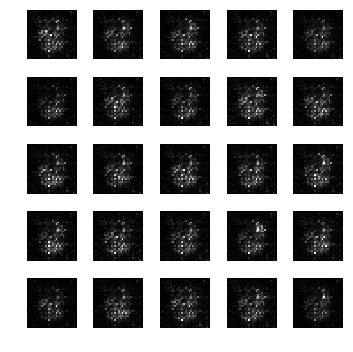

epoch: 181, time: 4.890672 | train_G_Loss: 0.694588, train_D_loss: 1.382637, train_acc: 0.094545
cv_G_Loss: 1.094836, cv_D_loss: 5.195414, cv_acc: 0.080200

epoch: 182, time: 4.867414 | train_G_Loss: 0.700409, train_D_loss: 1.382067, train_acc: 0.096364
cv_G_Loss: 1.370785, cv_D_loss: 5.500369, cv_acc: 0.098000

epoch: 183, time: 4.869955 | train_G_Loss: 0.695124, train_D_loss: 1.385040, train_acc: 0.096364
cv_G_Loss: 0.291749, cv_D_loss: 4.430885, cv_acc: 0.099300

epoch: 184, time: 4.863221 | train_G_Loss: 0.694702, train_D_loss: 1.378173, train_acc: 0.096364
cv_G_Loss: 0.379514, cv_D_loss: 4.402270, cv_acc: 0.098000

epoch: 185, time: 4.873753 | train_G_Loss: 0.699254, train_D_loss: 1.379873, train_acc: 0.096364
cv_G_Loss: 0.500701, cv_D_loss: 4.496622, cv_acc: 0.098000

epoch: 186, time: 4.864422 | train_G_Loss: 0.692869, train_D_loss: 1.399690, train_acc: 0.094545
cv_G_Loss: 0.693690, cv_D_loss: 4.930842, cv_acc: 0.098000

epoch: 187, time: 4.876180 | train_G_Loss: 0.702604, train

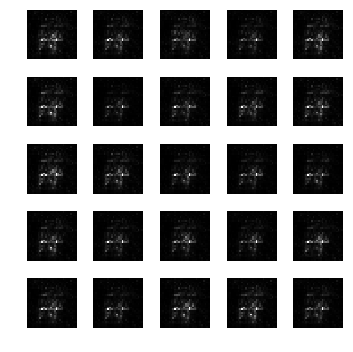

epoch: 191, time: 4.885894 | train_G_Loss: 0.700204, train_D_loss: 1.385828, train_acc: 0.096364
cv_G_Loss: 0.867869, cv_D_loss: 4.802245, cv_acc: 0.098000

epoch: 192, time: 4.877248 | train_G_Loss: 0.695727, train_D_loss: 1.386341, train_acc: 0.105455
cv_G_Loss: 0.663068, cv_D_loss: 4.757474, cv_acc: 0.103200

epoch: 193, time: 4.861024 | train_G_Loss: 0.685462, train_D_loss: 1.401022, train_acc: 0.105455
cv_G_Loss: 0.651507, cv_D_loss: 4.873281, cv_acc: 0.103200

epoch: 194, time: 4.866388 | train_G_Loss: 0.688952, train_D_loss: 1.410065, train_acc: 0.105455
cv_G_Loss: 0.739266, cv_D_loss: 4.929213, cv_acc: 0.103200

epoch: 195, time: 4.860820 | train_G_Loss: 0.680427, train_D_loss: 1.413249, train_acc: 0.098182
cv_G_Loss: 0.625679, cv_D_loss: 4.683399, cv_acc: 0.103000

epoch: 196, time: 4.878550 | train_G_Loss: 0.677484, train_D_loss: 1.417942, train_acc: 0.110909
cv_G_Loss: 0.340614, cv_D_loss: 4.449381, cv_acc: 0.114600

epoch: 197, time: 4.868000 | train_G_Loss: 0.685917, train

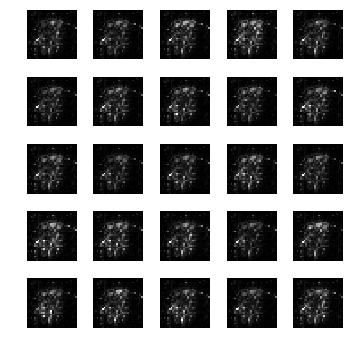

epoch: 201, time: 4.898167 | train_G_Loss: 0.694236, train_D_loss: 1.390228, train_acc: 0.098182
cv_G_Loss: 0.819919, cv_D_loss: 4.912211, cv_acc: 0.100900

epoch: 202, time: 4.859531 | train_G_Loss: 0.702159, train_D_loss: 1.370641, train_acc: 0.098182
cv_G_Loss: 1.549385, cv_D_loss: 6.080383, cv_acc: 0.100900

epoch: 203, time: 4.863902 | train_G_Loss: 0.686732, train_D_loss: 1.389437, train_acc: 0.098182
cv_G_Loss: 0.603132, cv_D_loss: 4.495892, cv_acc: 0.100900

epoch: 204, time: 4.869750 | train_G_Loss: 0.699900, train_D_loss: 1.375487, train_acc: 0.098182
cv_G_Loss: 0.541869, cv_D_loss: 4.414037, cv_acc: 0.100900

epoch: 205, time: 4.874771 | train_G_Loss: 0.713589, train_D_loss: 1.353744, train_acc: 0.098182
cv_G_Loss: 0.807958, cv_D_loss: 4.711294, cv_acc: 0.100900

epoch: 206, time: 4.866668 | train_G_Loss: 0.704194, train_D_loss: 1.364274, train_acc: 0.087273
cv_G_Loss: 0.628267, cv_D_loss: 4.393006, cv_acc: 0.089100

epoch: 207, time: 4.869464 | train_G_Loss: 0.706644, train

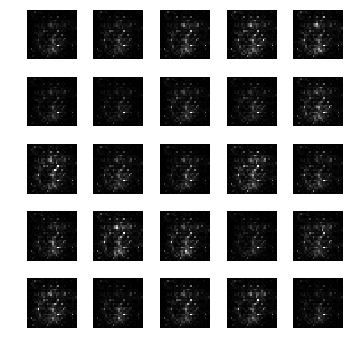

epoch: 211, time: 4.890503 | train_G_Loss: 0.704586, train_D_loss: 1.367817, train_acc: 0.118182
cv_G_Loss: 0.992322, cv_D_loss: 4.957718, cv_acc: 0.107100

epoch: 212, time: 4.866953 | train_G_Loss: 0.715324, train_D_loss: 1.366084, train_acc: 0.096364
cv_G_Loss: 0.805347, cv_D_loss: 4.766853, cv_acc: 0.104600

epoch: 213, time: 4.866945 | train_G_Loss: 0.680901, train_D_loss: 1.417060, train_acc: 0.109091
cv_G_Loss: 0.683762, cv_D_loss: 4.775776, cv_acc: 0.114200

epoch: 214, time: 4.863817 | train_G_Loss: 0.713934, train_D_loss: 1.379097, train_acc: 0.096364
cv_G_Loss: 1.030770, cv_D_loss: 4.990096, cv_acc: 0.098000

epoch: 215, time: 4.869217 | train_G_Loss: 0.691933, train_D_loss: 1.397721, train_acc: 0.096364
cv_G_Loss: 1.147868, cv_D_loss: 5.495120, cv_acc: 0.098000

epoch: 216, time: 4.871062 | train_G_Loss: 0.707326, train_D_loss: 1.367445, train_acc: 0.096364
cv_G_Loss: 1.298904, cv_D_loss: 5.635151, cv_acc: 0.098000

epoch: 217, time: 4.868348 | train_G_Loss: 0.701392, train

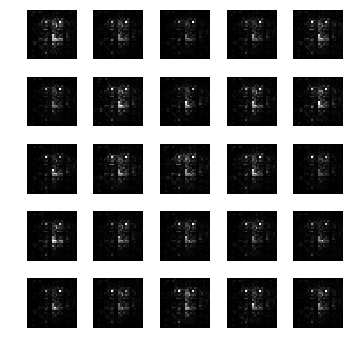

epoch: 221, time: 4.903575 | train_G_Loss: 0.693563, train_D_loss: 1.386487, train_acc: 0.114545
cv_G_Loss: 0.743352, cv_D_loss: 4.736163, cv_acc: 0.129000

epoch: 222, time: 4.924635 | train_G_Loss: 0.702507, train_D_loss: 1.382726, train_acc: 0.096364
cv_G_Loss: 0.937696, cv_D_loss: 5.047710, cv_acc: 0.103000

epoch: 223, time: 4.861514 | train_G_Loss: 0.703527, train_D_loss: 1.374329, train_acc: 0.096364
cv_G_Loss: 1.129702, cv_D_loss: 5.367911, cv_acc: 0.098000

epoch: 224, time: 4.864643 | train_G_Loss: 0.697687, train_D_loss: 1.375759, train_acc: 0.096364
cv_G_Loss: 0.833778, cv_D_loss: 4.720385, cv_acc: 0.098000

epoch: 225, time: 4.856068 | train_G_Loss: 0.695908, train_D_loss: 1.385805, train_acc: 0.070909
cv_G_Loss: 0.776217, cv_D_loss: 4.537238, cv_acc: 0.096900

epoch: 226, time: 4.867713 | train_G_Loss: 0.670195, train_D_loss: 1.419592, train_acc: 0.047273
cv_G_Loss: 0.368520, cv_D_loss: 4.182596, cv_acc: 0.089200

epoch: 227, time: 4.865705 | train_G_Loss: 0.695548, train

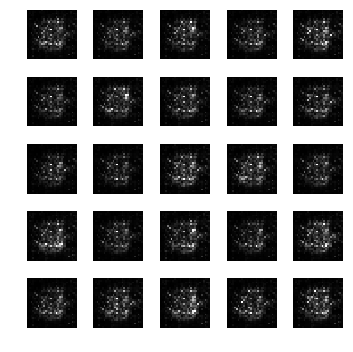

epoch: 231, time: 4.897698 | train_G_Loss: 0.667993, train_D_loss: 1.435633, train_acc: 0.096364
cv_G_Loss: 0.538952, cv_D_loss: 4.542188, cv_acc: 0.098000

epoch: 232, time: 4.866449 | train_G_Loss: 0.690885, train_D_loss: 1.392374, train_acc: 0.096364
cv_G_Loss: 1.086781, cv_D_loss: 5.531195, cv_acc: 0.098000

epoch: 233, time: 4.863090 | train_G_Loss: 0.710415, train_D_loss: 1.361780, train_acc: 0.096364
cv_G_Loss: 0.831668, cv_D_loss: 5.195347, cv_acc: 0.098000

epoch: 234, time: 4.868908 | train_G_Loss: 0.700851, train_D_loss: 1.371619, train_acc: 0.096364
cv_G_Loss: 0.633750, cv_D_loss: 4.613740, cv_acc: 0.098000

epoch: 235, time: 4.867671 | train_G_Loss: 0.696894, train_D_loss: 1.377457, train_acc: 0.096364
cv_G_Loss: 0.614718, cv_D_loss: 4.572733, cv_acc: 0.098000

epoch: 236, time: 4.866759 | train_G_Loss: 0.719087, train_D_loss: 1.363011, train_acc: 0.096364
cv_G_Loss: 1.720042, cv_D_loss: 6.552952, cv_acc: 0.098000

epoch: 237, time: 4.865731 | train_G_Loss: 0.689357, train

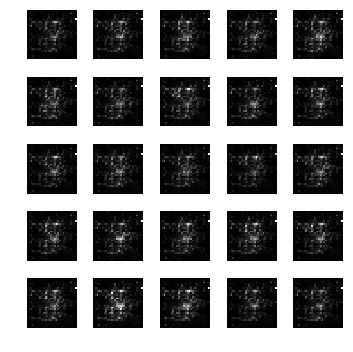

epoch: 241, time: 4.886227 | train_G_Loss: 0.685062, train_D_loss: 1.392570, train_acc: 0.096364
cv_G_Loss: 0.549941, cv_D_loss: 4.441274, cv_acc: 0.098000

epoch: 242, time: 4.867720 | train_G_Loss: 0.695373, train_D_loss: 1.383271, train_acc: 0.094545
cv_G_Loss: 1.292960, cv_D_loss: 5.319961, cv_acc: 0.098000

epoch: 243, time: 4.873834 | train_G_Loss: 0.709527, train_D_loss: 1.354233, train_acc: 0.072727
cv_G_Loss: 0.709444, cv_D_loss: 4.477329, cv_acc: 0.096000

epoch: 244, time: 4.866314 | train_G_Loss: 0.691359, train_D_loss: 1.395640, train_acc: 0.069091
cv_G_Loss: 0.797225, cv_D_loss: 4.667455, cv_acc: 0.092900

epoch: 245, time: 4.885632 | train_G_Loss: 0.679688, train_D_loss: 1.407426, train_acc: 0.092727
cv_G_Loss: 1.407357, cv_D_loss: 5.468007, cv_acc: 0.098000

epoch: 246, time: 4.882601 | train_G_Loss: 0.694418, train_D_loss: 1.383208, train_acc: 0.100000
cv_G_Loss: 1.087312, cv_D_loss: 4.914093, cv_acc: 0.096800

epoch: 247, time: 4.860659 | train_G_Loss: 0.684630, train

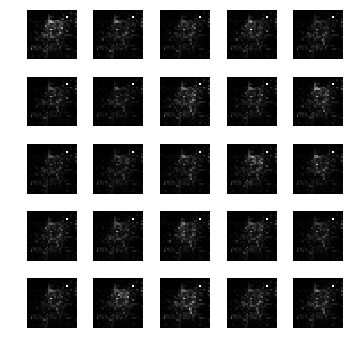

epoch: 251, time: 4.876932 | train_G_Loss: 0.695898, train_D_loss: 1.388935, train_acc: 0.098182
cv_G_Loss: 1.177824, cv_D_loss: 5.194834, cv_acc: 0.100900

epoch: 252, time: 4.868685 | train_G_Loss: 0.708772, train_D_loss: 1.357921, train_acc: 0.098182
cv_G_Loss: 1.220264, cv_D_loss: 5.259440, cv_acc: 0.100900

epoch: 253, time: 4.870366 | train_G_Loss: 0.702373, train_D_loss: 1.380191, train_acc: 0.098182
cv_G_Loss: 0.852858, cv_D_loss: 4.697845, cv_acc: 0.102900

epoch: 254, time: 4.867643 | train_G_Loss: 0.712487, train_D_loss: 1.355162, train_acc: 0.096364
cv_G_Loss: 0.694239, cv_D_loss: 4.452778, cv_acc: 0.101000

epoch: 255, time: 4.868568 | train_G_Loss: 0.693011, train_D_loss: 1.391385, train_acc: 0.096364
cv_G_Loss: 0.945891, cv_D_loss: 4.940195, cv_acc: 0.101000

epoch: 256, time: 4.860190 | train_G_Loss: 0.683490, train_D_loss: 1.397412, train_acc: 0.096364
cv_G_Loss: 1.005144, cv_D_loss: 4.983315, cv_acc: 0.101000

epoch: 257, time: 4.861995 | train_G_Loss: 0.694728, train

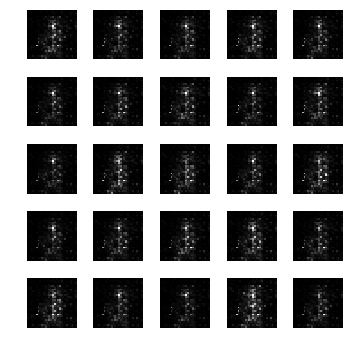

epoch: 261, time: 4.899011 | train_G_Loss: 0.692384, train_D_loss: 1.384364, train_acc: 0.096364
cv_G_Loss: 0.533850, cv_D_loss: 4.450804, cv_acc: 0.101000

epoch: 262, time: 4.871241 | train_G_Loss: 0.681382, train_D_loss: 1.408574, train_acc: 0.096364
cv_G_Loss: 0.642569, cv_D_loss: 4.535374, cv_acc: 0.101000

epoch: 263, time: 4.863478 | train_G_Loss: 0.699104, train_D_loss: 1.372713, train_acc: 0.101818
cv_G_Loss: 0.828701, cv_D_loss: 4.762116, cv_acc: 0.102600

epoch: 264, time: 4.864077 | train_G_Loss: 0.695842, train_D_loss: 1.375056, train_acc: 0.105455
cv_G_Loss: 0.551255, cv_D_loss: 4.421953, cv_acc: 0.103200

epoch: 265, time: 4.863724 | train_G_Loss: 0.692376, train_D_loss: 1.378748, train_acc: 0.105455
cv_G_Loss: 1.139004, cv_D_loss: 5.273999, cv_acc: 0.103200

epoch: 266, time: 4.869232 | train_G_Loss: 0.692936, train_D_loss: 1.382409, train_acc: 0.105455
cv_G_Loss: 0.804372, cv_D_loss: 4.685561, cv_acc: 0.102600

epoch: 267, time: 4.867853 | train_G_Loss: 0.702187, train

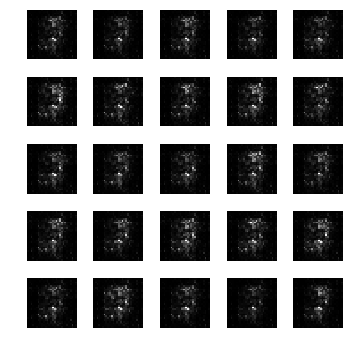

epoch: 271, time: 4.884334 | train_G_Loss: 0.687937, train_D_loss: 1.392442, train_acc: 0.105455
cv_G_Loss: 0.504387, cv_D_loss: 4.293103, cv_acc: 0.103200

epoch: 272, time: 4.866715 | train_G_Loss: 0.689892, train_D_loss: 1.393152, train_acc: 0.105455
cv_G_Loss: 1.142796, cv_D_loss: 4.992021, cv_acc: 0.103200

epoch: 273, time: 4.862554 | train_G_Loss: 0.702706, train_D_loss: 1.374686, train_acc: 0.105455
cv_G_Loss: 0.634445, cv_D_loss: 4.443421, cv_acc: 0.103200

epoch: 274, time: 4.876206 | train_G_Loss: 0.689010, train_D_loss: 1.395206, train_acc: 0.105455
cv_G_Loss: 0.958451, cv_D_loss: 5.016379, cv_acc: 0.103200

epoch: 275, time: 4.864878 | train_G_Loss: 0.702773, train_D_loss: 1.371103, train_acc: 0.105455
cv_G_Loss: 0.665274, cv_D_loss: 4.415800, cv_acc: 0.103200

epoch: 276, time: 4.866191 | train_G_Loss: 0.707750, train_D_loss: 1.363335, train_acc: 0.105455
cv_G_Loss: 0.670875, cv_D_loss: 4.385112, cv_acc: 0.103300

epoch: 277, time: 4.860302 | train_G_Loss: 0.689896, train

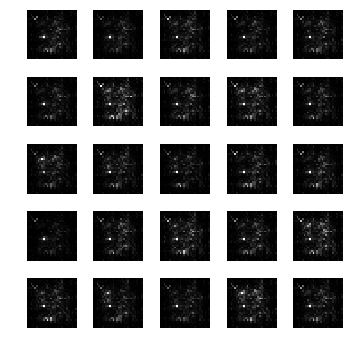

epoch: 281, time: 4.901693 | train_G_Loss: 0.688331, train_D_loss: 1.403531, train_acc: 0.089091
cv_G_Loss: 0.733929, cv_D_loss: 4.606703, cv_acc: 0.097400

epoch: 282, time: 4.870158 | train_G_Loss: 0.716094, train_D_loss: 1.346775, train_acc: 0.089091
cv_G_Loss: 0.557293, cv_D_loss: 4.408291, cv_acc: 0.097400

epoch: 283, time: 4.866426 | train_G_Loss: 0.693291, train_D_loss: 1.389407, train_acc: 0.089091
cv_G_Loss: 0.515355, cv_D_loss: 4.400943, cv_acc: 0.097400

epoch: 284, time: 4.871930 | train_G_Loss: 0.687835, train_D_loss: 1.397696, train_acc: 0.089091
cv_G_Loss: 0.958617, cv_D_loss: 5.009194, cv_acc: 0.101600

epoch: 285, time: 4.868985 | train_G_Loss: 0.687768, train_D_loss: 1.398328, train_acc: 0.096364
cv_G_Loss: 1.050915, cv_D_loss: 5.237632, cv_acc: 0.101000

epoch: 286, time: 4.863143 | train_G_Loss: 0.693799, train_D_loss: 1.373930, train_acc: 0.089091
cv_G_Loss: 1.760614, cv_D_loss: 6.235279, cv_acc: 0.103400

epoch: 287, time: 4.865960 | train_G_Loss: 0.710837, train

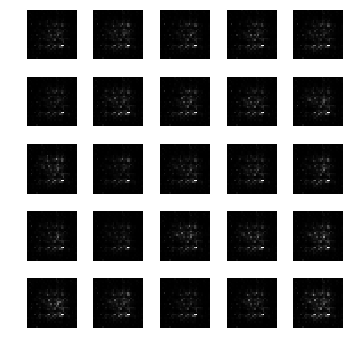

epoch: 291, time: 5.012263 | train_G_Loss: 0.693589, train_D_loss: 1.388992, train_acc: 0.089091
cv_G_Loss: 0.902145, cv_D_loss: 4.622883, cv_acc: 0.097400

epoch: 292, time: 4.875164 | train_G_Loss: 0.701292, train_D_loss: 1.372267, train_acc: 0.103636
cv_G_Loss: 0.866253, cv_D_loss: 4.590334, cv_acc: 0.103300

epoch: 293, time: 4.868167 | train_G_Loss: 0.694005, train_D_loss: 1.387510, train_acc: 0.096364
cv_G_Loss: 0.678918, cv_D_loss: 4.479357, cv_acc: 0.101000

epoch: 294, time: 4.874957 | train_G_Loss: 0.690271, train_D_loss: 1.391881, train_acc: 0.089091
cv_G_Loss: 0.726353, cv_D_loss: 4.647255, cv_acc: 0.097300

epoch: 295, time: 4.875905 | train_G_Loss: 0.687097, train_D_loss: 1.394866, train_acc: 0.089091
cv_G_Loss: 0.778062, cv_D_loss: 4.808506, cv_acc: 0.097400

epoch: 296, time: 4.871115 | train_G_Loss: 0.694605, train_D_loss: 1.385667, train_acc: 0.089091
cv_G_Loss: 0.694025, cv_D_loss: 4.587388, cv_acc: 0.097400

epoch: 297, time: 4.869921 | train_G_Loss: 0.711675, train

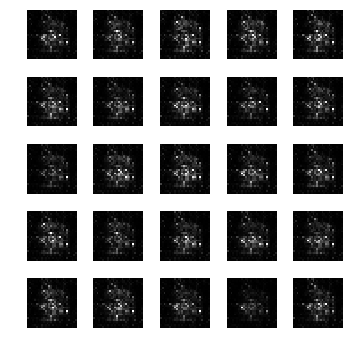

epoch: 301, time: 4.879084 | train_G_Loss: 0.685644, train_D_loss: 1.396332, train_acc: 0.109091
cv_G_Loss: 0.757724, cv_D_loss: 4.660773, cv_acc: 0.102800

epoch: 302, time: 4.877505 | train_G_Loss: 0.689548, train_D_loss: 1.391889, train_acc: 0.109091
cv_G_Loss: 0.829264, cv_D_loss: 4.603260, cv_acc: 0.114300

epoch: 303, time: 4.866381 | train_G_Loss: 0.716372, train_D_loss: 1.347610, train_acc: 0.096364
cv_G_Loss: 0.638908, cv_D_loss: 4.273124, cv_acc: 0.098000

epoch: 304, time: 4.874887 | train_G_Loss: 0.675176, train_D_loss: 1.419441, train_acc: 0.096364
cv_G_Loss: 0.658045, cv_D_loss: 4.467901, cv_acc: 0.098000

epoch: 305, time: 4.865617 | train_G_Loss: 0.700854, train_D_loss: 1.385526, train_acc: 0.109091
cv_G_Loss: 0.658318, cv_D_loss: 4.282431, cv_acc: 0.124200

epoch: 306, time: 4.867929 | train_G_Loss: 0.680363, train_D_loss: 1.411664, train_acc: 0.107273
cv_G_Loss: 0.564171, cv_D_loss: 4.517735, cv_acc: 0.113500

epoch: 307, time: 4.867313 | train_G_Loss: 0.689422, train

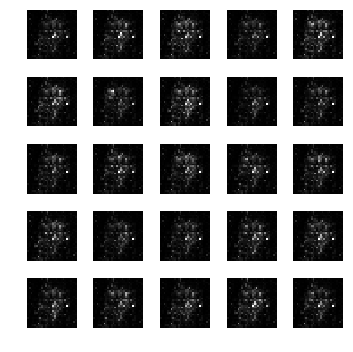

epoch: 311, time: 4.908303 | train_G_Loss: 0.689966, train_D_loss: 1.404963, train_acc: 0.098182
cv_G_Loss: 1.141827, cv_D_loss: 5.285492, cv_acc: 0.100900

epoch: 312, time: 4.859816 | train_G_Loss: 0.692306, train_D_loss: 1.398900, train_acc: 0.098182
cv_G_Loss: 0.888404, cv_D_loss: 4.753214, cv_acc: 0.100900

epoch: 313, time: 4.852869 | train_G_Loss: 0.689151, train_D_loss: 1.393949, train_acc: 0.096364
cv_G_Loss: 0.840771, cv_D_loss: 4.692249, cv_acc: 0.102100

epoch: 314, time: 4.878872 | train_G_Loss: 0.692047, train_D_loss: 1.390666, train_acc: 0.096364
cv_G_Loss: 0.877205, cv_D_loss: 4.740774, cv_acc: 0.101000

epoch: 315, time: 4.899804 | train_G_Loss: 0.689253, train_D_loss: 1.392243, train_acc: 0.096364
cv_G_Loss: 0.580231, cv_D_loss: 4.510872, cv_acc: 0.101000

epoch: 316, time: 4.869074 | train_G_Loss: 0.686402, train_D_loss: 1.399410, train_acc: 0.096364
cv_G_Loss: 0.654521, cv_D_loss: 4.512374, cv_acc: 0.101000

epoch: 317, time: 4.874943 | train_G_Loss: 0.695766, train

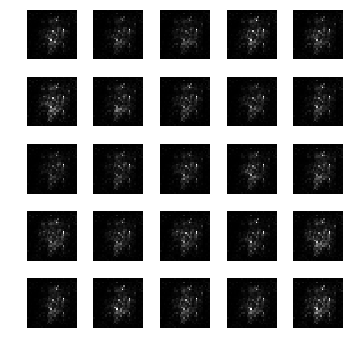

epoch: 321, time: 4.898210 | train_G_Loss: 0.697862, train_D_loss: 1.390585, train_acc: 0.116364
cv_G_Loss: 0.899034, cv_D_loss: 4.821591, cv_acc: 0.123500

epoch: 322, time: 4.864708 | train_G_Loss: 0.706238, train_D_loss: 1.358174, train_acc: 0.107273
cv_G_Loss: 0.746751, cv_D_loss: 4.583039, cv_acc: 0.113500

epoch: 323, time: 4.865527 | train_G_Loss: 0.704210, train_D_loss: 1.373070, train_acc: 0.107273
cv_G_Loss: 0.705590, cv_D_loss: 4.584035, cv_acc: 0.113500

epoch: 324, time: 4.863838 | train_G_Loss: 0.696348, train_D_loss: 1.380606, train_acc: 0.107273
cv_G_Loss: 0.775265, cv_D_loss: 4.800390, cv_acc: 0.113500

epoch: 325, time: 4.871836 | train_G_Loss: 0.700039, train_D_loss: 1.373958, train_acc: 0.107273
cv_G_Loss: 0.950486, cv_D_loss: 5.112949, cv_acc: 0.085800

epoch: 326, time: 4.859557 | train_G_Loss: 0.698278, train_D_loss: 1.381240, train_acc: 0.107273
cv_G_Loss: 0.697749, cv_D_loss: 4.606704, cv_acc: 0.113500

epoch: 327, time: 4.870945 | train_G_Loss: 0.692096, train

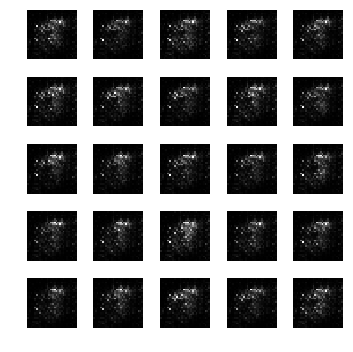

epoch: 331, time: 4.905267 | train_G_Loss: 0.672064, train_D_loss: 1.418088, train_acc: 0.098182
cv_G_Loss: 0.718260, cv_D_loss: 4.557346, cv_acc: 0.100900

epoch: 332, time: 4.877332 | train_G_Loss: 0.676908, train_D_loss: 1.401674, train_acc: 0.098182
cv_G_Loss: 0.649287, cv_D_loss: 4.626555, cv_acc: 0.100900

epoch: 333, time: 4.861145 | train_G_Loss: 0.689753, train_D_loss: 1.404042, train_acc: 0.098182
cv_G_Loss: 0.603193, cv_D_loss: 4.544072, cv_acc: 0.100900

epoch: 334, time: 4.871038 | train_G_Loss: 0.691196, train_D_loss: 1.391989, train_acc: 0.098182
cv_G_Loss: 0.798863, cv_D_loss: 4.585000, cv_acc: 0.100900

epoch: 335, time: 4.865081 | train_G_Loss: 0.686041, train_D_loss: 1.397953, train_acc: 0.138182
cv_G_Loss: 0.611021, cv_D_loss: 4.342841, cv_acc: 0.134900

epoch: 336, time: 4.877930 | train_G_Loss: 0.685894, train_D_loss: 1.395593, train_acc: 0.107273
cv_G_Loss: 0.635002, cv_D_loss: 4.346019, cv_acc: 0.113500

epoch: 337, time: 4.862054 | train_G_Loss: 0.684109, train

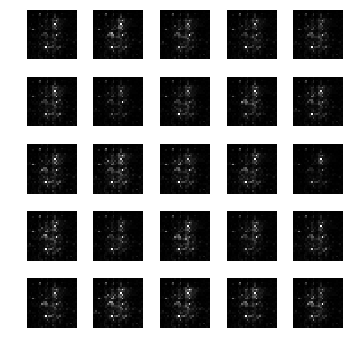

epoch: 341, time: 4.896956 | train_G_Loss: 0.702414, train_D_loss: 1.360002, train_acc: 0.096364
cv_G_Loss: 0.784057, cv_D_loss: 4.533712, cv_acc: 0.101000

epoch: 342, time: 4.881979 | train_G_Loss: 0.686266, train_D_loss: 1.402508, train_acc: 0.110909
cv_G_Loss: 0.781184, cv_D_loss: 4.611531, cv_acc: 0.102900

epoch: 343, time: 4.857045 | train_G_Loss: 0.693638, train_D_loss: 1.392923, train_acc: 0.098182
cv_G_Loss: 0.900622, cv_D_loss: 4.760798, cv_acc: 0.084200

epoch: 344, time: 4.866657 | train_G_Loss: 0.685449, train_D_loss: 1.397923, train_acc: 0.105455
cv_G_Loss: 0.516045, cv_D_loss: 4.418938, cv_acc: 0.103200

epoch: 345, time: 4.863823 | train_G_Loss: 0.686216, train_D_loss: 1.397630, train_acc: 0.105455
cv_G_Loss: 0.722219, cv_D_loss: 4.526116, cv_acc: 0.103200

epoch: 346, time: 4.866282 | train_G_Loss: 0.686944, train_D_loss: 1.390475, train_acc: 0.096364
cv_G_Loss: 0.495295, cv_D_loss: 4.354628, cv_acc: 0.103600

epoch: 347, time: 4.867296 | train_G_Loss: 0.694699, train

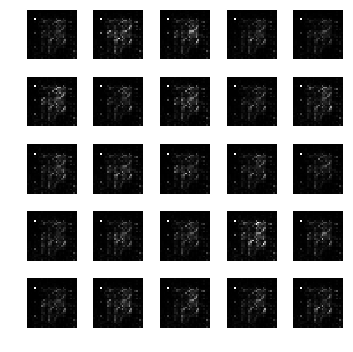

epoch: 351, time: 4.899897 | train_G_Loss: 0.702370, train_D_loss: 1.379240, train_acc: 0.100000
cv_G_Loss: 0.865609, cv_D_loss: 4.627477, cv_acc: 0.101000

epoch: 352, time: 4.866250 | train_G_Loss: 0.705265, train_D_loss: 1.368813, train_acc: 0.096364
cv_G_Loss: 0.624896, cv_D_loss: 4.322559, cv_acc: 0.101000

epoch: 353, time: 4.874058 | train_G_Loss: 0.698064, train_D_loss: 1.380569, train_acc: 0.096364
cv_G_Loss: 0.655387, cv_D_loss: 4.375225, cv_acc: 0.101000

epoch: 354, time: 4.868488 | train_G_Loss: 0.697559, train_D_loss: 1.386364, train_acc: 0.096364
cv_G_Loss: 0.785975, cv_D_loss: 4.553710, cv_acc: 0.101800

epoch: 355, time: 4.868141 | train_G_Loss: 0.694525, train_D_loss: 1.377591, train_acc: 0.096364
cv_G_Loss: 0.817129, cv_D_loss: 4.643705, cv_acc: 0.101000

epoch: 356, time: 4.867239 | train_G_Loss: 0.681847, train_D_loss: 1.403134, train_acc: 0.096364
cv_G_Loss: 0.749436, cv_D_loss: 4.655359, cv_acc: 0.101000

epoch: 357, time: 4.872516 | train_G_Loss: 0.700841, train

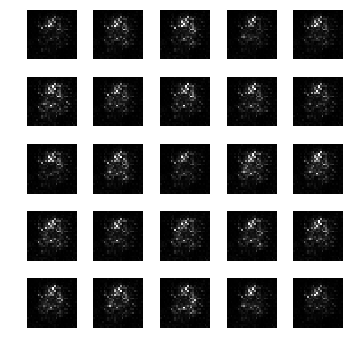

epoch: 361, time: 4.909803 | train_G_Loss: 0.692405, train_D_loss: 1.393819, train_acc: 0.107273
cv_G_Loss: 0.736158, cv_D_loss: 4.634252, cv_acc: 0.113500

epoch: 362, time: 4.903845 | train_G_Loss: 0.703058, train_D_loss: 1.375837, train_acc: 0.107273
cv_G_Loss: 0.774810, cv_D_loss: 4.521802, cv_acc: 0.113500

epoch: 363, time: 4.866643 | train_G_Loss: 0.697506, train_D_loss: 1.378477, train_acc: 0.070909
cv_G_Loss: 0.666014, cv_D_loss: 4.406202, cv_acc: 0.053800

epoch: 364, time: 4.876955 | train_G_Loss: 0.704925, train_D_loss: 1.373238, train_acc: 0.092727
cv_G_Loss: 1.153835, cv_D_loss: 5.163647, cv_acc: 0.098000

epoch: 365, time: 4.875707 | train_G_Loss: 0.692143, train_D_loss: 1.382954, train_acc: 0.096364
cv_G_Loss: 0.691821, cv_D_loss: 4.534796, cv_acc: 0.098000

epoch: 366, time: 4.870280 | train_G_Loss: 0.693317, train_D_loss: 1.382651, train_acc: 0.096364
cv_G_Loss: 0.574082, cv_D_loss: 4.388238, cv_acc: 0.098000

epoch: 367, time: 4.908726 | train_G_Loss: 0.694034, train

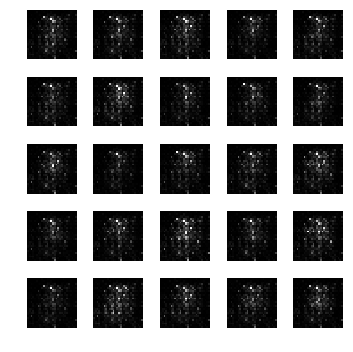

epoch: 371, time: 4.914807 | train_G_Loss: 0.706005, train_D_loss: 1.379009, train_acc: 0.089091
cv_G_Loss: 1.049150, cv_D_loss: 4.733867, cv_acc: 0.097400

epoch: 372, time: 4.869089 | train_G_Loss: 0.694038, train_D_loss: 1.390235, train_acc: 0.089091
cv_G_Loss: 0.826935, cv_D_loss: 4.619202, cv_acc: 0.101800

epoch: 373, time: 4.868579 | train_G_Loss: 0.691217, train_D_loss: 1.378838, train_acc: 0.089091
cv_G_Loss: 0.427010, cv_D_loss: 4.290043, cv_acc: 0.097400

epoch: 374, time: 4.865258 | train_G_Loss: 0.692016, train_D_loss: 1.386422, train_acc: 0.154545
cv_G_Loss: 0.622656, cv_D_loss: 4.423889, cv_acc: 0.148400
Model saved

epoch: 375, time: 4.898697 | train_G_Loss: 0.713461, train_D_loss: 1.348499, train_acc: 0.098182
cv_G_Loss: 1.471377, cv_D_loss: 5.640154, cv_acc: 0.100900

epoch: 376, time: 4.870640 | train_G_Loss: 0.703992, train_D_loss: 1.371713, train_acc: 0.118182
cv_G_Loss: 1.501087, cv_D_loss: 5.656092, cv_acc: 0.100900

epoch: 377, time: 4.877539 | train_G_Loss: 0.6

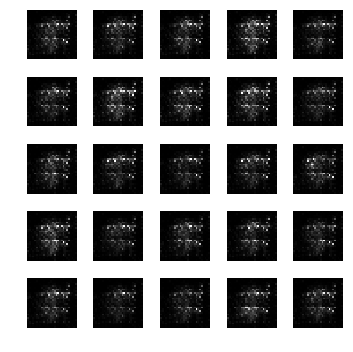

epoch: 381, time: 4.892450 | train_G_Loss: 0.692069, train_D_loss: 1.386152, train_acc: 0.107273
cv_G_Loss: 0.860259, cv_D_loss: 4.735234, cv_acc: 0.113500

epoch: 382, time: 4.867472 | train_G_Loss: 0.692735, train_D_loss: 1.385652, train_acc: 0.107273
cv_G_Loss: 0.758086, cv_D_loss: 4.641797, cv_acc: 0.170000
Model saved

epoch: 383, time: 4.916966 | train_G_Loss: 0.688731, train_D_loss: 1.401625, train_acc: 0.107273
cv_G_Loss: 0.760270, cv_D_loss: 4.645583, cv_acc: 0.118700

epoch: 384, time: 4.891346 | train_G_Loss: 0.698325, train_D_loss: 1.379992, train_acc: 0.107273
cv_G_Loss: 0.870966, cv_D_loss: 4.746146, cv_acc: 0.113700

epoch: 385, time: 4.861753 | train_G_Loss: 0.691348, train_D_loss: 1.383934, train_acc: 0.100000
cv_G_Loss: 0.721074, cv_D_loss: 4.429380, cv_acc: 0.099400

epoch: 386, time: 4.866695 | train_G_Loss: 0.698353, train_D_loss: 1.379274, train_acc: 0.100000
cv_G_Loss: 0.623434, cv_D_loss: 4.383589, cv_acc: 0.098200

epoch: 387, time: 4.868632 | train_G_Loss: 0.6

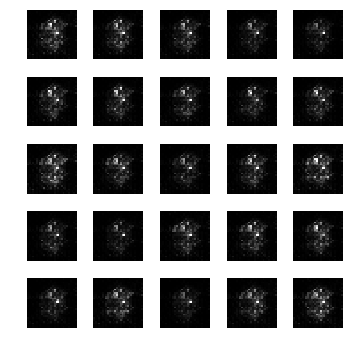

epoch: 391, time: 4.898928 | train_G_Loss: 0.684386, train_D_loss: 1.403337, train_acc: 0.107273
cv_G_Loss: 0.719074, cv_D_loss: 4.562976, cv_acc: 0.113500

epoch: 392, time: 4.866378 | train_G_Loss: 0.696189, train_D_loss: 1.380360, train_acc: 0.107273
cv_G_Loss: 0.918976, cv_D_loss: 4.730772, cv_acc: 0.113500

epoch: 393, time: 4.870069 | train_G_Loss: 0.690479, train_D_loss: 1.388748, train_acc: 0.107273
cv_G_Loss: 0.709623, cv_D_loss: 4.440149, cv_acc: 0.113500

epoch: 394, time: 4.858436 | train_G_Loss: 0.692771, train_D_loss: 1.382810, train_acc: 0.090909
cv_G_Loss: 0.448492, cv_D_loss: 4.222141, cv_acc: 0.098000

epoch: 395, time: 4.874491 | train_G_Loss: 0.694247, train_D_loss: 1.389974, train_acc: 0.096364
cv_G_Loss: 0.538614, cv_D_loss: 4.276677, cv_acc: 0.098000

epoch: 396, time: 4.870217 | train_G_Loss: 0.696908, train_D_loss: 1.377121, train_acc: 0.096364
cv_G_Loss: 0.825130, cv_D_loss: 4.528079, cv_acc: 0.098000

epoch: 397, time: 4.860744 | train_G_Loss: 0.697360, train

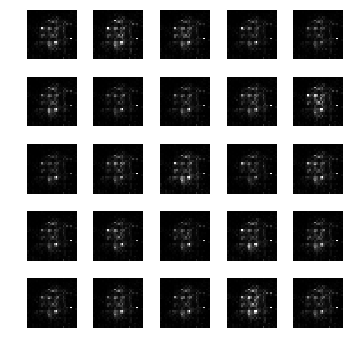

epoch: 401, time: 4.895175 | train_G_Loss: 0.698474, train_D_loss: 1.374911, train_acc: 0.109091
cv_G_Loss: 0.810780, cv_D_loss: 4.560414, cv_acc: 0.162300

epoch: 402, time: 4.871865 | train_G_Loss: 0.694757, train_D_loss: 1.382589, train_acc: 0.109091
cv_G_Loss: 0.738665, cv_D_loss: 4.515664, cv_acc: 0.102800

epoch: 403, time: 4.870502 | train_G_Loss: 0.701831, train_D_loss: 1.367592, train_acc: 0.090909
cv_G_Loss: 0.800618, cv_D_loss: 4.635482, cv_acc: 0.108100

epoch: 404, time: 4.858495 | train_G_Loss: 0.684522, train_D_loss: 1.393354, train_acc: 0.116364
cv_G_Loss: 0.689866, cv_D_loss: 4.475520, cv_acc: 0.123300

epoch: 405, time: 4.873607 | train_G_Loss: 0.689204, train_D_loss: 1.380852, train_acc: 0.109091
cv_G_Loss: 1.215504, cv_D_loss: 5.069928, cv_acc: 0.130300

epoch: 406, time: 4.895911 | train_G_Loss: 0.686147, train_D_loss: 1.394641, train_acc: 0.110909
cv_G_Loss: 0.631816, cv_D_loss: 4.313267, cv_acc: 0.134200

epoch: 407, time: 4.880087 | train_G_Loss: 0.690896, train

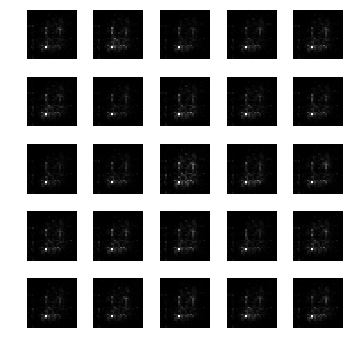

epoch: 411, time: 4.906348 | train_G_Loss: 0.714540, train_D_loss: 1.365311, train_acc: 0.109091
cv_G_Loss: 0.645968, cv_D_loss: 4.391375, cv_acc: 0.097400

epoch: 412, time: 4.869538 | train_G_Loss: 0.710191, train_D_loss: 1.366501, train_acc: 0.107273
cv_G_Loss: 0.955381, cv_D_loss: 4.836661, cv_acc: 0.116900

epoch: 413, time: 4.870130 | train_G_Loss: 0.683398, train_D_loss: 1.409157, train_acc: 0.109091
cv_G_Loss: 0.593599, cv_D_loss: 4.469597, cv_acc: 0.107700

epoch: 414, time: 4.870593 | train_G_Loss: 0.688215, train_D_loss: 1.391659, train_acc: 0.107273
cv_G_Loss: 0.671552, cv_D_loss: 4.446197, cv_acc: 0.113500

epoch: 415, time: 4.873781 | train_G_Loss: 0.690573, train_D_loss: 1.390350, train_acc: 0.107273
cv_G_Loss: 0.678690, cv_D_loss: 4.420148, cv_acc: 0.113700

epoch: 416, time: 4.857792 | train_G_Loss: 0.697742, train_D_loss: 1.379852, train_acc: 0.107273
cv_G_Loss: 0.895319, cv_D_loss: 4.649608, cv_acc: 0.113500

epoch: 417, time: 4.866169 | train_G_Loss: 0.700437, train

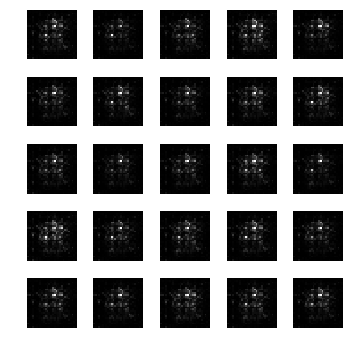

epoch: 421, time: 4.898917 | train_G_Loss: 0.687535, train_D_loss: 1.387165, train_acc: 0.089091
cv_G_Loss: 0.877634, cv_D_loss: 4.665299, cv_acc: 0.097400

epoch: 422, time: 4.874864 | train_G_Loss: 0.704823, train_D_loss: 1.363140, train_acc: 0.089091
cv_G_Loss: 0.705083, cv_D_loss: 4.495515, cv_acc: 0.097400

epoch: 423, time: 4.863303 | train_G_Loss: 0.700090, train_D_loss: 1.370633, train_acc: 0.089091
cv_G_Loss: 0.672655, cv_D_loss: 4.421045, cv_acc: 0.097400

epoch: 424, time: 4.874964 | train_G_Loss: 0.697354, train_D_loss: 1.382523, train_acc: 0.089091
cv_G_Loss: 0.652107, cv_D_loss: 4.399945, cv_acc: 0.097400

epoch: 425, time: 4.881570 | train_G_Loss: 0.695863, train_D_loss: 1.372661, train_acc: 0.089091
cv_G_Loss: 0.794968, cv_D_loss: 4.629271, cv_acc: 0.097400

epoch: 426, time: 4.870924 | train_G_Loss: 0.696024, train_D_loss: 1.381183, train_acc: 0.089091
cv_G_Loss: 0.774369, cv_D_loss: 4.663758, cv_acc: 0.097400

epoch: 427, time: 4.867481 | train_G_Loss: 0.703363, train

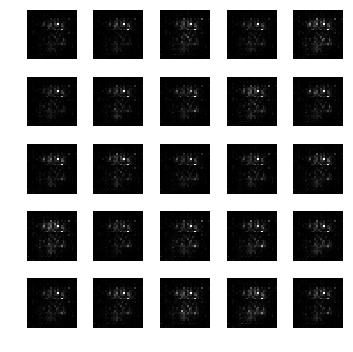

epoch: 431, time: 4.893788 | train_G_Loss: 0.699102, train_D_loss: 1.373929, train_acc: 0.089091
cv_G_Loss: 0.664621, cv_D_loss: 4.387323, cv_acc: 0.097500

epoch: 432, time: 4.867828 | train_G_Loss: 0.696290, train_D_loss: 1.376706, train_acc: 0.098182
cv_G_Loss: 0.613692, cv_D_loss: 4.337591, cv_acc: 0.100900

epoch: 433, time: 4.872182 | train_G_Loss: 0.687758, train_D_loss: 1.399848, train_acc: 0.096364
cv_G_Loss: 0.623162, cv_D_loss: 4.401983, cv_acc: 0.098000

epoch: 434, time: 4.856486 | train_G_Loss: 0.682973, train_D_loss: 1.407616, train_acc: 0.096364
cv_G_Loss: 0.664733, cv_D_loss: 4.462313, cv_acc: 0.098000

epoch: 435, time: 4.878755 | train_G_Loss: 0.695010, train_D_loss: 1.384668, train_acc: 0.096364
cv_G_Loss: 0.840294, cv_D_loss: 4.735518, cv_acc: 0.098000

epoch: 436, time: 4.877462 | train_G_Loss: 0.690506, train_D_loss: 1.387928, train_acc: 0.096364
cv_G_Loss: 0.876594, cv_D_loss: 4.693624, cv_acc: 0.098000

epoch: 437, time: 4.870518 | train_G_Loss: 0.693841, train

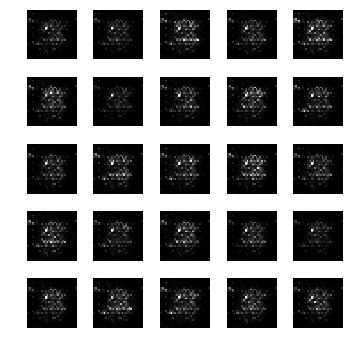

epoch: 441, time: 4.904142 | train_G_Loss: 0.692545, train_D_loss: 1.383178, train_acc: 0.109091
cv_G_Loss: 0.843614, cv_D_loss: 4.591113, cv_acc: 0.102800

epoch: 442, time: 4.882554 | train_G_Loss: 0.697077, train_D_loss: 1.379823, train_acc: 0.109091
cv_G_Loss: 1.148022, cv_D_loss: 4.990245, cv_acc: 0.102800

epoch: 443, time: 4.871115 | train_G_Loss: 0.693837, train_D_loss: 1.388413, train_acc: 0.109091
cv_G_Loss: 0.760769, cv_D_loss: 4.589687, cv_acc: 0.102800

epoch: 444, time: 4.876122 | train_G_Loss: 0.681199, train_D_loss: 1.406730, train_acc: 0.109091
cv_G_Loss: 0.887439, cv_D_loss: 4.732538, cv_acc: 0.102800

epoch: 445, time: 4.880453 | train_G_Loss: 0.694667, train_D_loss: 1.378986, train_acc: 0.109091
cv_G_Loss: 0.559830, cv_D_loss: 4.343319, cv_acc: 0.102800

epoch: 446, time: 4.858749 | train_G_Loss: 0.692855, train_D_loss: 1.378444, train_acc: 0.109091
cv_G_Loss: 0.571377, cv_D_loss: 4.329234, cv_acc: 0.102800

epoch: 447, time: 4.870225 | train_G_Loss: 0.692828, train

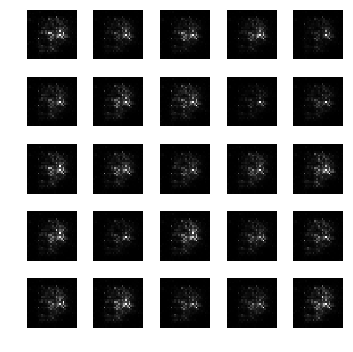

epoch: 451, time: 4.906300 | train_G_Loss: 0.697008, train_D_loss: 1.396362, train_acc: 0.096364
cv_G_Loss: 0.771316, cv_D_loss: 4.610102, cv_acc: 0.101000

epoch: 452, time: 4.891371 | train_G_Loss: 0.687860, train_D_loss: 1.396884, train_acc: 0.096364
cv_G_Loss: 0.737671, cv_D_loss: 4.537667, cv_acc: 0.101000

epoch: 453, time: 4.889428 | train_G_Loss: 0.691648, train_D_loss: 1.391565, train_acc: 0.096364
cv_G_Loss: 0.600152, cv_D_loss: 4.363201, cv_acc: 0.101000

epoch: 454, time: 4.867192 | train_G_Loss: 0.692476, train_D_loss: 1.391070, train_acc: 0.096364
cv_G_Loss: 0.726320, cv_D_loss: 4.496498, cv_acc: 0.101000

epoch: 455, time: 4.866119 | train_G_Loss: 0.691093, train_D_loss: 1.387262, train_acc: 0.096364
cv_G_Loss: 0.802533, cv_D_loss: 4.557676, cv_acc: 0.101000

epoch: 456, time: 4.872419 | train_G_Loss: 0.696487, train_D_loss: 1.382169, train_acc: 0.127273
cv_G_Loss: 0.740495, cv_D_loss: 4.458486, cv_acc: 0.115500

epoch: 457, time: 4.876789 | train_G_Loss: 0.700747, train

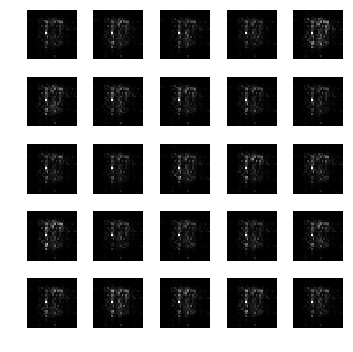

epoch: 461, time: 4.894817 | train_G_Loss: 0.692527, train_D_loss: 1.385096, train_acc: 0.109091
cv_G_Loss: 0.622856, cv_D_loss: 4.364632, cv_acc: 0.102800

epoch: 462, time: 4.875646 | train_G_Loss: 0.695986, train_D_loss: 1.379801, train_acc: 0.109091
cv_G_Loss: 0.660532, cv_D_loss: 4.396482, cv_acc: 0.102800

epoch: 463, time: 4.884649 | train_G_Loss: 0.694806, train_D_loss: 1.388489, train_acc: 0.129091
cv_G_Loss: 0.661401, cv_D_loss: 4.426723, cv_acc: 0.148000

epoch: 464, time: 4.868179 | train_G_Loss: 0.679814, train_D_loss: 1.406208, train_acc: 0.098182
cv_G_Loss: 0.914253, cv_D_loss: 4.803967, cv_acc: 0.100900

epoch: 465, time: 4.880521 | train_G_Loss: 0.691569, train_D_loss: 1.393815, train_acc: 0.098182
cv_G_Loss: 0.976619, cv_D_loss: 4.869560, cv_acc: 0.100900

epoch: 466, time: 4.862855 | train_G_Loss: 0.694783, train_D_loss: 1.389123, train_acc: 0.107273
cv_G_Loss: 0.732383, cv_D_loss: 4.456570, cv_acc: 0.113500

epoch: 467, time: 5.034478 | train_G_Loss: 0.693347, train

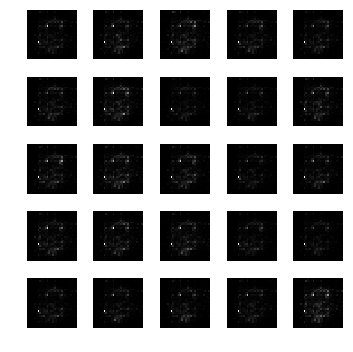

epoch: 471, time: 4.912460 | train_G_Loss: 0.693988, train_D_loss: 1.387598, train_acc: 0.096364
cv_G_Loss: 0.735411, cv_D_loss: 4.436570, cv_acc: 0.101400

epoch: 472, time: 4.871861 | train_G_Loss: 0.696482, train_D_loss: 1.371173, train_acc: 0.109091
cv_G_Loss: 0.798074, cv_D_loss: 4.457119, cv_acc: 0.127400

epoch: 473, time: 4.874471 | train_G_Loss: 0.692375, train_D_loss: 1.383635, train_acc: 0.129091
cv_G_Loss: 0.720119, cv_D_loss: 4.458000, cv_acc: 0.103800

epoch: 474, time: 4.874484 | train_G_Loss: 0.689012, train_D_loss: 1.404386, train_acc: 0.089091
cv_G_Loss: 0.794448, cv_D_loss: 4.642296, cv_acc: 0.097400

epoch: 475, time: 4.888892 | train_G_Loss: 0.678828, train_D_loss: 1.408763, train_acc: 0.089091
cv_G_Loss: 0.488983, cv_D_loss: 4.283440, cv_acc: 0.097400

epoch: 476, time: 4.901818 | train_G_Loss: 0.687537, train_D_loss: 1.394749, train_acc: 0.089091
cv_G_Loss: 0.756236, cv_D_loss: 4.482974, cv_acc: 0.097400

epoch: 477, time: 4.875739 | train_G_Loss: 0.692439, train

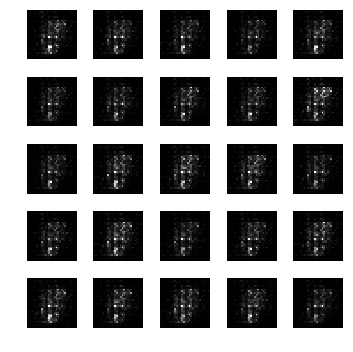

epoch: 481, time: 4.898609 | train_G_Loss: 0.680238, train_D_loss: 1.405259, train_acc: 0.096364
cv_G_Loss: 0.573245, cv_D_loss: 4.353413, cv_acc: 0.101000

epoch: 482, time: 4.872698 | train_G_Loss: 0.691876, train_D_loss: 1.385034, train_acc: 0.096364
cv_G_Loss: 0.778106, cv_D_loss: 4.537703, cv_acc: 0.101000

epoch: 483, time: 4.883242 | train_G_Loss: 0.696228, train_D_loss: 1.386748, train_acc: 0.096364
cv_G_Loss: 0.730563, cv_D_loss: 4.503562, cv_acc: 0.101000

epoch: 484, time: 4.867079 | train_G_Loss: 0.695083, train_D_loss: 1.384402, train_acc: 0.096364
cv_G_Loss: 0.757597, cv_D_loss: 4.502858, cv_acc: 0.101000

epoch: 485, time: 4.860232 | train_G_Loss: 0.692348, train_D_loss: 1.389865, train_acc: 0.096364
cv_G_Loss: 0.704686, cv_D_loss: 4.454654, cv_acc: 0.101000

epoch: 486, time: 4.873928 | train_G_Loss: 0.693759, train_D_loss: 1.386782, train_acc: 0.096364
cv_G_Loss: 0.754364, cv_D_loss: 4.531555, cv_acc: 0.101000

epoch: 487, time: 4.877358 | train_G_Loss: 0.693242, train

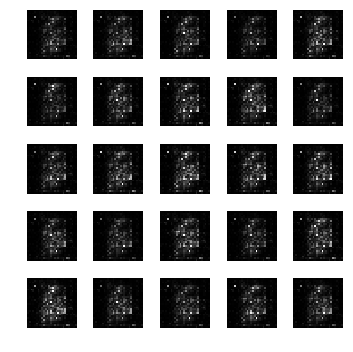

epoch: 491, time: 4.906119 | train_G_Loss: 0.695397, train_D_loss: 1.380252, train_acc: 0.096364
cv_G_Loss: 0.743552, cv_D_loss: 4.588972, cv_acc: 0.098000

epoch: 492, time: 4.876377 | train_G_Loss: 0.692495, train_D_loss: 1.390310, train_acc: 0.096364
cv_G_Loss: 0.622405, cv_D_loss: 4.405548, cv_acc: 0.098000

epoch: 493, time: 4.871062 | train_G_Loss: 0.693229, train_D_loss: 1.386311, train_acc: 0.096364
cv_G_Loss: 0.583878, cv_D_loss: 4.329580, cv_acc: 0.108900

epoch: 494, time: 4.872496 | train_G_Loss: 0.688977, train_D_loss: 1.399725, train_acc: 0.096364
cv_G_Loss: 0.787657, cv_D_loss: 4.589042, cv_acc: 0.101000

epoch: 495, time: 4.869790 | train_G_Loss: 0.698345, train_D_loss: 1.381091, train_acc: 0.096364
cv_G_Loss: 0.837596, cv_D_loss: 4.554780, cv_acc: 0.101000

epoch: 496, time: 4.878123 | train_G_Loss: 0.693515, train_D_loss: 1.385192, train_acc: 0.096364
cv_G_Loss: 0.764002, cv_D_loss: 4.445478, cv_acc: 0.101000

epoch: 497, time: 4.867692 | train_G_Loss: 0.690261, train

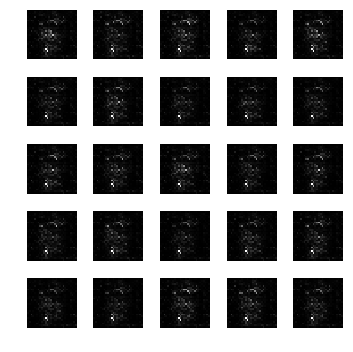

epoch: 501, time: 4.900666 | train_G_Loss: 0.692078, train_D_loss: 1.383669, train_acc: 0.109091
cv_G_Loss: 0.785339, cv_D_loss: 4.508555, cv_acc: 0.102800

epoch: 502, time: 4.873480 | train_G_Loss: 0.700172, train_D_loss: 1.376015, train_acc: 0.105455
cv_G_Loss: 0.741362, cv_D_loss: 4.520870, cv_acc: 0.103100

epoch: 503, time: 4.858370 | train_G_Loss: 0.705415, train_D_loss: 1.359880, train_acc: 0.105455
cv_G_Loss: 0.785027, cv_D_loss: 4.536121, cv_acc: 0.103200

epoch: 504, time: 4.864232 | train_G_Loss: 0.706740, train_D_loss: 1.360025, train_acc: 0.105455
cv_G_Loss: 0.704168, cv_D_loss: 4.460357, cv_acc: 0.103200

epoch: 505, time: 4.860638 | train_G_Loss: 0.711982, train_D_loss: 1.352375, train_acc: 0.105455
cv_G_Loss: 1.148330, cv_D_loss: 5.252910, cv_acc: 0.103200

epoch: 506, time: 4.879822 | train_G_Loss: 0.707123, train_D_loss: 1.362700, train_acc: 0.105455
cv_G_Loss: 0.851818, cv_D_loss: 4.656866, cv_acc: 0.103200

epoch: 507, time: 4.870991 | train_G_Loss: 0.704266, train

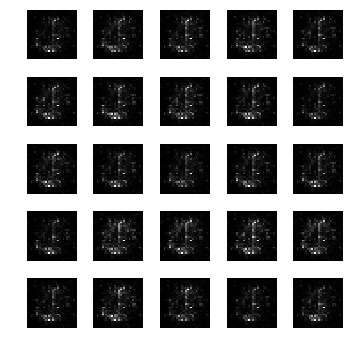

epoch: 511, time: 4.899486 | train_G_Loss: 0.689620, train_D_loss: 1.390784, train_acc: 0.105455
cv_G_Loss: 0.736488, cv_D_loss: 4.583580, cv_acc: 0.103200

epoch: 512, time: 4.861986 | train_G_Loss: 0.681505, train_D_loss: 1.414518, train_acc: 0.105455
cv_G_Loss: 0.764749, cv_D_loss: 4.719506, cv_acc: 0.103200

epoch: 513, time: 4.874404 | train_G_Loss: 0.692356, train_D_loss: 1.387565, train_acc: 0.096364
cv_G_Loss: 0.593124, cv_D_loss: 4.499804, cv_acc: 0.107100

epoch: 514, time: 4.858996 | train_G_Loss: 0.688911, train_D_loss: 1.394470, train_acc: 0.096364
cv_G_Loss: 0.609416, cv_D_loss: 4.468240, cv_acc: 0.101000

epoch: 515, time: 4.868005 | train_G_Loss: 0.696239, train_D_loss: 1.388926, train_acc: 0.096364
cv_G_Loss: 0.793579, cv_D_loss: 4.718983, cv_acc: 0.101000

epoch: 516, time: 4.868267 | train_G_Loss: 0.692490, train_D_loss: 1.386753, train_acc: 0.096364
cv_G_Loss: 0.763857, cv_D_loss: 4.524223, cv_acc: 0.101000

epoch: 517, time: 4.880587 | train_G_Loss: 0.693191, train

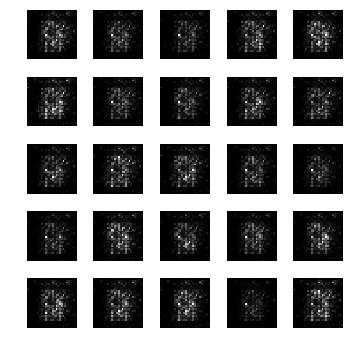

epoch: 521, time: 4.889598 | train_G_Loss: 0.700150, train_D_loss: 1.380539, train_acc: 0.096364
cv_G_Loss: 0.769454, cv_D_loss: 4.502968, cv_acc: 0.101000

epoch: 522, time: 4.890691 | train_G_Loss: 0.703002, train_D_loss: 1.381143, train_acc: 0.096364
cv_G_Loss: 0.686782, cv_D_loss: 4.427040, cv_acc: 0.101000

epoch: 523, time: 4.874936 | train_G_Loss: 0.695864, train_D_loss: 1.378205, train_acc: 0.100000
cv_G_Loss: 0.460940, cv_D_loss: 4.255558, cv_acc: 0.101000

epoch: 524, time: 4.863106 | train_G_Loss: 0.697657, train_D_loss: 1.386216, train_acc: 0.096364
cv_G_Loss: 0.859208, cv_D_loss: 4.559522, cv_acc: 0.098000

epoch: 525, time: 4.878384 | train_G_Loss: 0.688420, train_D_loss: 1.396220, train_acc: 0.096364
cv_G_Loss: 0.843531, cv_D_loss: 4.617597, cv_acc: 0.098000

epoch: 526, time: 4.870203 | train_G_Loss: 0.698835, train_D_loss: 1.380139, train_acc: 0.105455
cv_G_Loss: 0.829946, cv_D_loss: 4.585827, cv_acc: 0.082100

epoch: 527, time: 4.874199 | train_G_Loss: 0.690898, train

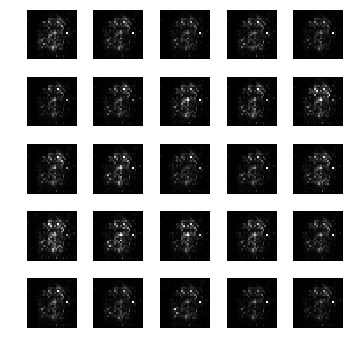

epoch: 531, time: 4.902153 | train_G_Loss: 0.692087, train_D_loss: 1.391269, train_acc: 0.096364
cv_G_Loss: 0.761007, cv_D_loss: 4.523021, cv_acc: 0.101000

epoch: 532, time: 4.873103 | train_G_Loss: 0.686562, train_D_loss: 1.395368, train_acc: 0.096364
cv_G_Loss: 0.730688, cv_D_loss: 4.471272, cv_acc: 0.101000

epoch: 533, time: 4.865559 | train_G_Loss: 0.695431, train_D_loss: 1.386821, train_acc: 0.107273
cv_G_Loss: 0.776478, cv_D_loss: 4.522124, cv_acc: 0.169200

epoch: 534, time: 4.875218 | train_G_Loss: 0.695503, train_D_loss: 1.384547, train_acc: 0.107273
cv_G_Loss: 0.675711, cv_D_loss: 4.425043, cv_acc: 0.123000

epoch: 535, time: 4.893362 | train_G_Loss: 0.696489, train_D_loss: 1.385274, train_acc: 0.110909
cv_G_Loss: 0.715727, cv_D_loss: 4.499146, cv_acc: 0.095800

epoch: 536, time: 4.874141 | train_G_Loss: 0.698071, train_D_loss: 1.380015, train_acc: 0.100000
cv_G_Loss: 0.674236, cv_D_loss: 4.444293, cv_acc: 0.101200

epoch: 537, time: 4.874073 | train_G_Loss: 0.694842, train

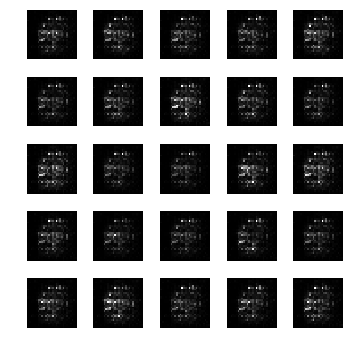

epoch: 541, time: 4.893924 | train_G_Loss: 0.712099, train_D_loss: 1.365053, train_acc: 0.109091
cv_G_Loss: 0.974274, cv_D_loss: 4.807203, cv_acc: 0.102800

epoch: 542, time: 4.866819 | train_G_Loss: 0.696125, train_D_loss: 1.381824, train_acc: 0.107273
cv_G_Loss: 0.961159, cv_D_loss: 4.805559, cv_acc: 0.105100

epoch: 543, time: 4.859395 | train_G_Loss: 0.692885, train_D_loss: 1.385921, train_acc: 0.107273
cv_G_Loss: 0.747506, cv_D_loss: 4.535848, cv_acc: 0.103500

epoch: 544, time: 4.875328 | train_G_Loss: 0.688293, train_D_loss: 1.393139, train_acc: 0.107273
cv_G_Loss: 0.942530, cv_D_loss: 4.725501, cv_acc: 0.165600

epoch: 545, time: 4.915114 | train_G_Loss: 0.705819, train_D_loss: 1.369536, train_acc: 0.096364
cv_G_Loss: 0.798624, cv_D_loss: 4.476166, cv_acc: 0.101000

epoch: 546, time: 4.878726 | train_G_Loss: 0.702559, train_D_loss: 1.369255, train_acc: 0.096364
cv_G_Loss: 0.793172, cv_D_loss: 4.473404, cv_acc: 0.101000

epoch: 547, time: 4.869197 | train_G_Loss: 0.702172, train

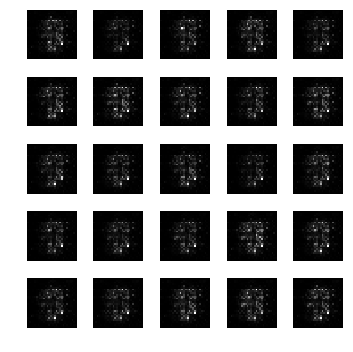

epoch: 551, time: 4.906578 | train_G_Loss: 0.697257, train_D_loss: 1.376004, train_acc: 0.098182
cv_G_Loss: 0.810210, cv_D_loss: 4.542338, cv_acc: 0.078000

epoch: 552, time: 4.878413 | train_G_Loss: 0.706667, train_D_loss: 1.366482, train_acc: 0.109091
cv_G_Loss: 0.846019, cv_D_loss: 4.543519, cv_acc: 0.102800

epoch: 553, time: 4.881027 | train_G_Loss: 0.699619, train_D_loss: 1.376902, train_acc: 0.109091
cv_G_Loss: 0.692776, cv_D_loss: 4.420467, cv_acc: 0.102800

epoch: 554, time: 4.875193 | train_G_Loss: 0.715122, train_D_loss: 1.342964, train_acc: 0.109091
cv_G_Loss: 0.725554, cv_D_loss: 4.460668, cv_acc: 0.102800

epoch: 555, time: 4.871425 | train_G_Loss: 0.697866, train_D_loss: 1.380903, train_acc: 0.109091
cv_G_Loss: 0.810782, cv_D_loss: 4.535824, cv_acc: 0.102800

epoch: 556, time: 4.874924 | train_G_Loss: 0.693099, train_D_loss: 1.375878, train_acc: 0.109091
cv_G_Loss: 0.798224, cv_D_loss: 4.684392, cv_acc: 0.102800

epoch: 557, time: 4.870795 | train_G_Loss: 0.690813, train

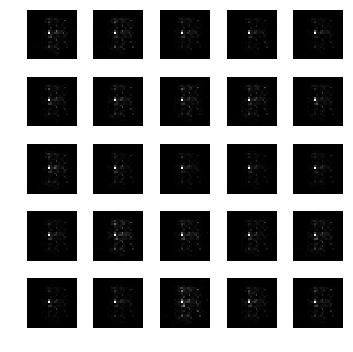

epoch: 561, time: 4.906281 | train_G_Loss: 0.690966, train_D_loss: 1.391019, train_acc: 0.098182
cv_G_Loss: 0.711215, cv_D_loss: 4.434524, cv_acc: 0.100900

epoch: 562, time: 4.863430 | train_G_Loss: 0.692876, train_D_loss: 1.388399, train_acc: 0.098182
cv_G_Loss: 0.842795, cv_D_loss: 4.589833, cv_acc: 0.100900

epoch: 563, time: 4.862509 | train_G_Loss: 0.690394, train_D_loss: 1.389851, train_acc: 0.098182
cv_G_Loss: 0.685138, cv_D_loss: 4.409653, cv_acc: 0.100900

epoch: 564, time: 4.870672 | train_G_Loss: 0.692995, train_D_loss: 1.388218, train_acc: 0.123636
cv_G_Loss: 0.702916, cv_D_loss: 4.434396, cv_acc: 0.113500

epoch: 565, time: 4.863989 | train_G_Loss: 0.691358, train_D_loss: 1.392593, train_acc: 0.107273
cv_G_Loss: 0.732177, cv_D_loss: 4.485013, cv_acc: 0.113500

epoch: 566, time: 4.869553 | train_G_Loss: 0.691855, train_D_loss: 1.391376, train_acc: 0.107273
cv_G_Loss: 0.757929, cv_D_loss: 4.518004, cv_acc: 0.113500

epoch: 567, time: 4.871570 | train_G_Loss: 0.694616, train

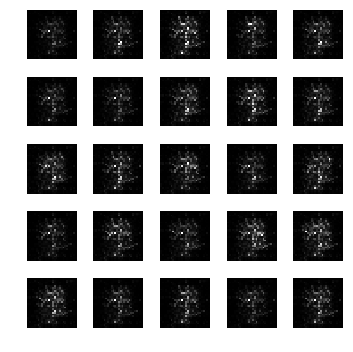

epoch: 571, time: 4.892899 | train_G_Loss: 0.687824, train_D_loss: 1.395508, train_acc: 0.089091
cv_G_Loss: 0.625052, cv_D_loss: 4.434097, cv_acc: 0.102400

epoch: 572, time: 4.866924 | train_G_Loss: 0.692022, train_D_loss: 1.382988, train_acc: 0.136364
cv_G_Loss: 0.603685, cv_D_loss: 4.368727, cv_acc: 0.100900

epoch: 573, time: 4.983381 | train_G_Loss: 0.687897, train_D_loss: 1.393511, train_acc: 0.096364
cv_G_Loss: 0.599883, cv_D_loss: 4.369012, cv_acc: 0.101000

epoch: 574, time: 4.872079 | train_G_Loss: 0.703261, train_D_loss: 1.371167, train_acc: 0.096364
cv_G_Loss: 0.899389, cv_D_loss: 4.656365, cv_acc: 0.101000

epoch: 575, time: 4.870259 | train_G_Loss: 0.706586, train_D_loss: 1.358226, train_acc: 0.098182
cv_G_Loss: 1.177600, cv_D_loss: 5.166645, cv_acc: 0.101000

epoch: 576, time: 4.894223 | train_G_Loss: 0.696317, train_D_loss: 1.381005, train_acc: 0.089091
cv_G_Loss: 0.824633, cv_D_loss: 4.586984, cv_acc: 0.137700

epoch: 577, time: 4.868649 | train_G_Loss: 0.694967, train

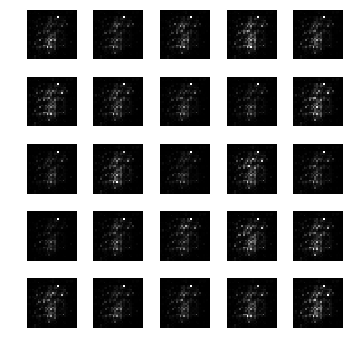

epoch: 581, time: 4.911662 | train_G_Loss: 0.692224, train_D_loss: 1.387047, train_acc: 0.107273
cv_G_Loss: 0.707692, cv_D_loss: 4.508645, cv_acc: 0.110900

epoch: 582, time: 4.880145 | train_G_Loss: 0.689799, train_D_loss: 1.390321, train_acc: 0.096364
cv_G_Loss: 0.667361, cv_D_loss: 4.388073, cv_acc: 0.098000

epoch: 583, time: 4.863933 | train_G_Loss: 0.687305, train_D_loss: 1.399023, train_acc: 0.096364
cv_G_Loss: 0.728578, cv_D_loss: 4.493081, cv_acc: 0.098000

epoch: 584, time: 4.875083 | train_G_Loss: 0.694329, train_D_loss: 1.381685, train_acc: 0.109091
cv_G_Loss: 0.712526, cv_D_loss: 4.478801, cv_acc: 0.102800

epoch: 585, time: 4.865994 | train_G_Loss: 0.699757, train_D_loss: 1.377828, train_acc: 0.109091
cv_G_Loss: 0.836981, cv_D_loss: 4.537490, cv_acc: 0.102800

epoch: 586, time: 4.865319 | train_G_Loss: 0.695463, train_D_loss: 1.383290, train_acc: 0.109091
cv_G_Loss: 0.731296, cv_D_loss: 4.432984, cv_acc: 0.102800

epoch: 587, time: 4.871994 | train_G_Loss: 0.692714, train

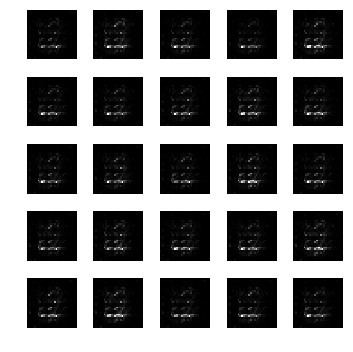

epoch: 591, time: 4.947010 | train_G_Loss: 0.693961, train_D_loss: 1.383000, train_acc: 0.100000
cv_G_Loss: 0.718846, cv_D_loss: 4.450098, cv_acc: 0.098200

epoch: 592, time: 4.876565 | train_G_Loss: 0.700025, train_D_loss: 1.382181, train_acc: 0.105455
cv_G_Loss: 1.202671, cv_D_loss: 5.011851, cv_acc: 0.100900

epoch: 593, time: 4.874332 | train_G_Loss: 0.691850, train_D_loss: 1.386028, train_acc: 0.098182
cv_G_Loss: 0.747528, cv_D_loss: 4.468691, cv_acc: 0.100900

epoch: 594, time: 4.869336 | train_G_Loss: 0.693699, train_D_loss: 1.384457, train_acc: 0.098182
cv_G_Loss: 0.750419, cv_D_loss: 4.482856, cv_acc: 0.103900

epoch: 595, time: 4.883301 | train_G_Loss: 0.694411, train_D_loss: 1.378799, train_acc: 0.107273
cv_G_Loss: 0.677260, cv_D_loss: 4.359539, cv_acc: 0.113500

epoch: 596, time: 4.867166 | train_G_Loss: 0.700953, train_D_loss: 1.371648, train_acc: 0.110909
cv_G_Loss: 0.709646, cv_D_loss: 4.361869, cv_acc: 0.113600

epoch: 597, time: 4.863922 | train_G_Loss: 0.690153, train

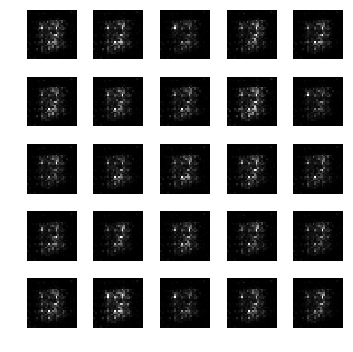

epoch: 601, time: 4.902810 | train_G_Loss: 0.693508, train_D_loss: 1.380548, train_acc: 0.087273
cv_G_Loss: 0.640231, cv_D_loss: 4.361814, cv_acc: 0.089200

epoch: 602, time: 4.875280 | train_G_Loss: 0.707927, train_D_loss: 1.373591, train_acc: 0.107273
cv_G_Loss: 0.764931, cv_D_loss: 4.522807, cv_acc: 0.113500

epoch: 603, time: 4.874294 | train_G_Loss: 0.685149, train_D_loss: 1.399057, train_acc: 0.107273
cv_G_Loss: 0.985587, cv_D_loss: 4.770999, cv_acc: 0.113500

epoch: 604, time: 4.876145 | train_G_Loss: 0.688179, train_D_loss: 1.396280, train_acc: 0.089091
cv_G_Loss: 0.542170, cv_D_loss: 4.346260, cv_acc: 0.097400

epoch: 605, time: 4.865769 | train_G_Loss: 0.692811, train_D_loss: 1.389051, train_acc: 0.109091
cv_G_Loss: 0.680909, cv_D_loss: 4.456370, cv_acc: 0.102800

epoch: 606, time: 4.874139 | train_G_Loss: 0.692503, train_D_loss: 1.387461, train_acc: 0.109091
cv_G_Loss: 0.675917, cv_D_loss: 4.496640, cv_acc: 0.102800

epoch: 607, time: 4.859847 | train_G_Loss: 0.693210, train

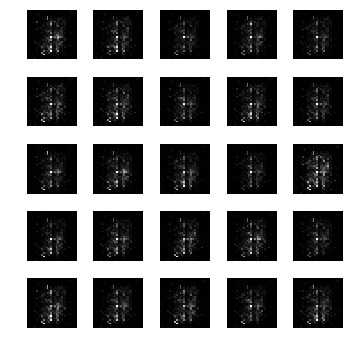

epoch: 611, time: 4.900485 | train_G_Loss: 0.690473, train_D_loss: 1.387733, train_acc: 0.096364
cv_G_Loss: 0.788345, cv_D_loss: 4.577704, cv_acc: 0.098000

epoch: 612, time: 4.864699 | train_G_Loss: 0.698618, train_D_loss: 1.377797, train_acc: 0.098182
cv_G_Loss: 0.744752, cv_D_loss: 4.487479, cv_acc: 0.098300

epoch: 613, time: 4.870273 | train_G_Loss: 0.696242, train_D_loss: 1.378080, train_acc: 0.096364
cv_G_Loss: 0.626625, cv_D_loss: 4.345211, cv_acc: 0.100900

epoch: 614, time: 4.915285 | train_G_Loss: 0.693130, train_D_loss: 1.386675, train_acc: 0.101818
cv_G_Loss: 0.784154, cv_D_loss: 4.494901, cv_acc: 0.098000

epoch: 615, time: 4.868117 | train_G_Loss: 0.694658, train_D_loss: 1.386511, train_acc: 0.094545
cv_G_Loss: 0.990698, cv_D_loss: 4.760865, cv_acc: 0.097400

epoch: 616, time: 4.872568 | train_G_Loss: 0.685692, train_D_loss: 1.399355, train_acc: 0.116364
cv_G_Loss: 0.954388, cv_D_loss: 4.718014, cv_acc: 0.124200

epoch: 617, time: 4.871831 | train_G_Loss: 0.689070, train

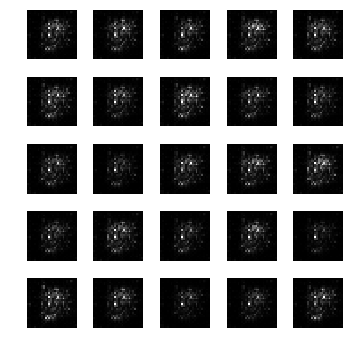

epoch: 621, time: 4.905872 | train_G_Loss: 0.700457, train_D_loss: 1.378798, train_acc: 0.110909
cv_G_Loss: 0.973483, cv_D_loss: 4.762766, cv_acc: 0.098000

epoch: 622, time: 4.881628 | train_G_Loss: 0.694164, train_D_loss: 1.382863, train_acc: 0.165455
cv_G_Loss: 0.726030, cv_D_loss: 4.437479, cv_acc: 0.167500

epoch: 623, time: 4.863682 | train_G_Loss: 0.690214, train_D_loss: 1.385261, train_acc: 0.096364
cv_G_Loss: 0.716343, cv_D_loss: 4.386477, cv_acc: 0.101000

epoch: 624, time: 4.869145 | train_G_Loss: 0.695643, train_D_loss: 1.380673, train_acc: 0.096364
cv_G_Loss: 0.733599, cv_D_loss: 4.438296, cv_acc: 0.101000

epoch: 625, time: 4.868884 | train_G_Loss: 0.692387, train_D_loss: 1.384956, train_acc: 0.096364
cv_G_Loss: 0.657841, cv_D_loss: 4.363015, cv_acc: 0.101000

epoch: 626, time: 4.861093 | train_G_Loss: 0.693968, train_D_loss: 1.387702, train_acc: 0.096364
cv_G_Loss: 0.870930, cv_D_loss: 4.594292, cv_acc: 0.101000

epoch: 627, time: 4.865232 | train_G_Loss: 0.694940, train

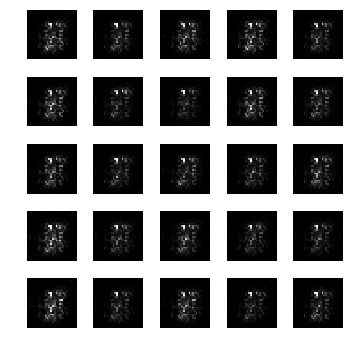

epoch: 631, time: 4.920118 | train_G_Loss: 0.700801, train_D_loss: 1.381169, train_acc: 0.098182
cv_G_Loss: 0.763447, cv_D_loss: 4.453968, cv_acc: 0.100900

epoch: 632, time: 4.869969 | train_G_Loss: 0.693574, train_D_loss: 1.388234, train_acc: 0.098182
cv_G_Loss: 0.834528, cv_D_loss: 4.594643, cv_acc: 0.081600

epoch: 633, time: 4.870050 | train_G_Loss: 0.692417, train_D_loss: 1.384086, train_acc: 0.092727
cv_G_Loss: 0.754336, cv_D_loss: 4.474185, cv_acc: 0.085600

epoch: 634, time: 4.868820 | train_G_Loss: 0.699921, train_D_loss: 1.372049, train_acc: 0.096364
cv_G_Loss: 0.664266, cv_D_loss: 4.323595, cv_acc: 0.097700

epoch: 635, time: 4.860238 | train_G_Loss: 0.694266, train_D_loss: 1.385212, train_acc: 0.096364
cv_G_Loss: 0.691594, cv_D_loss: 4.363660, cv_acc: 0.098000

epoch: 636, time: 4.875896 | train_G_Loss: 0.701019, train_D_loss: 1.370144, train_acc: 0.096364
cv_G_Loss: 0.932797, cv_D_loss: 4.699512, cv_acc: 0.098000

epoch: 637, time: 4.922262 | train_G_Loss: 0.699236, train

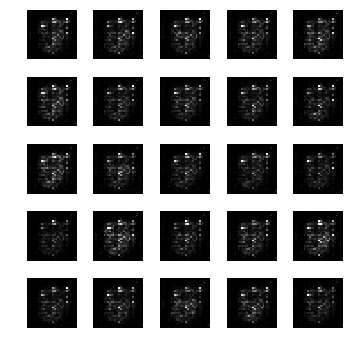

epoch: 641, time: 4.899637 | train_G_Loss: 0.689715, train_D_loss: 1.382184, train_acc: 0.105455
cv_G_Loss: 1.072590, cv_D_loss: 4.939071, cv_acc: 0.094700

epoch: 642, time: 4.864739 | train_G_Loss: 0.690063, train_D_loss: 1.391162, train_acc: 0.105455
cv_G_Loss: 0.735367, cv_D_loss: 4.489997, cv_acc: 0.103100

epoch: 643, time: 4.861127 | train_G_Loss: 0.700563, train_D_loss: 1.368921, train_acc: 0.098182
cv_G_Loss: 0.902050, cv_D_loss: 4.685565, cv_acc: 0.100900

epoch: 644, time: 4.870294 | train_G_Loss: 0.688571, train_D_loss: 1.386414, train_acc: 0.100000
cv_G_Loss: 0.620666, cv_D_loss: 4.350857, cv_acc: 0.097900

epoch: 645, time: 4.864254 | train_G_Loss: 0.692092, train_D_loss: 1.388955, train_acc: 0.101818
cv_G_Loss: 0.641629, cv_D_loss: 4.437685, cv_acc: 0.094200

epoch: 646, time: 4.861011 | train_G_Loss: 0.690963, train_D_loss: 1.388737, train_acc: 0.087273
cv_G_Loss: 0.696075, cv_D_loss: 4.432435, cv_acc: 0.089200

epoch: 647, time: 4.877105 | train_G_Loss: 0.690368, train

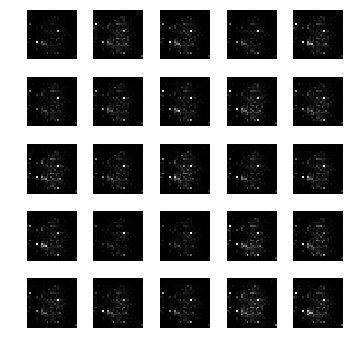

epoch: 651, time: 4.905469 | train_G_Loss: 0.688032, train_D_loss: 1.387238, train_acc: 0.110909
cv_G_Loss: 0.630758, cv_D_loss: 4.397795, cv_acc: 0.095800

epoch: 652, time: 4.862676 | train_G_Loss: 0.701136, train_D_loss: 1.368680, train_acc: 0.145455
cv_G_Loss: 0.731920, cv_D_loss: 4.391899, cv_acc: 0.095800

epoch: 653, time: 4.868742 | train_G_Loss: 0.695127, train_D_loss: 1.376327, train_acc: 0.110909
cv_G_Loss: 0.746663, cv_D_loss: 4.441172, cv_acc: 0.095800

epoch: 654, time: 4.868148 | train_G_Loss: 0.691202, train_D_loss: 1.385301, train_acc: 0.120000
cv_G_Loss: 0.639531, cv_D_loss: 4.385790, cv_acc: 0.102200

epoch: 655, time: 4.876043 | train_G_Loss: 0.692369, train_D_loss: 1.383568, train_acc: 0.087273
cv_G_Loss: 0.720363, cv_D_loss: 4.449434, cv_acc: 0.089200

epoch: 656, time: 4.862711 | train_G_Loss: 0.694965, train_D_loss: 1.386143, train_acc: 0.087273
cv_G_Loss: 0.670175, cv_D_loss: 4.380344, cv_acc: 0.089200

epoch: 657, time: 4.862664 | train_G_Loss: 0.693576, train

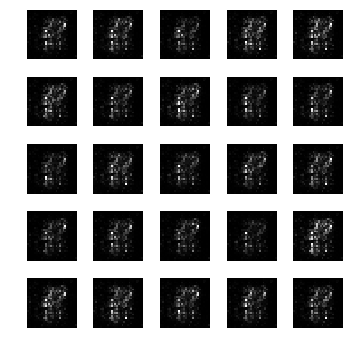

epoch: 661, time: 4.899931 | train_G_Loss: 0.695467, train_D_loss: 1.383625, train_acc: 0.096364
cv_G_Loss: 0.896141, cv_D_loss: 4.683469, cv_acc: 0.101000

epoch: 662, time: 4.875008 | train_G_Loss: 0.690592, train_D_loss: 1.390883, train_acc: 0.096364
cv_G_Loss: 0.676651, cv_D_loss: 4.396827, cv_acc: 0.101000

epoch: 663, time: 4.861528 | train_G_Loss: 0.688710, train_D_loss: 1.392209, train_acc: 0.100000
cv_G_Loss: 0.706929, cv_D_loss: 4.450524, cv_acc: 0.098200

epoch: 664, time: 4.879576 | train_G_Loss: 0.695156, train_D_loss: 1.378605, train_acc: 0.100000
cv_G_Loss: 0.670948, cv_D_loss: 4.413035, cv_acc: 0.098200

epoch: 665, time: 4.874405 | train_G_Loss: 0.692878, train_D_loss: 1.380286, train_acc: 0.100000
cv_G_Loss: 0.655052, cv_D_loss: 4.377674, cv_acc: 0.098200

epoch: 666, time: 4.872470 | train_G_Loss: 0.690755, train_D_loss: 1.393819, train_acc: 0.100000
cv_G_Loss: 0.652461, cv_D_loss: 4.357648, cv_acc: 0.098200

epoch: 667, time: 4.882990 | train_G_Loss: 0.688380, train

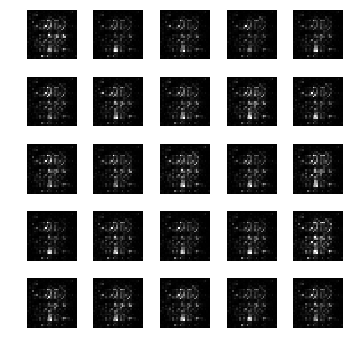

epoch: 671, time: 4.911337 | train_G_Loss: 0.699236, train_D_loss: 1.373029, train_acc: 0.089091
cv_G_Loss: 0.713443, cv_D_loss: 4.440811, cv_acc: 0.097400

epoch: 672, time: 4.878184 | train_G_Loss: 0.697849, train_D_loss: 1.377141, train_acc: 0.089091
cv_G_Loss: 0.856805, cv_D_loss: 4.626197, cv_acc: 0.097700

epoch: 673, time: 4.879707 | train_G_Loss: 0.695557, train_D_loss: 1.382468, train_acc: 0.110909
cv_G_Loss: 0.957607, cv_D_loss: 4.704069, cv_acc: 0.099700

epoch: 674, time: 4.869841 | train_G_Loss: 0.693170, train_D_loss: 1.385804, train_acc: 0.110909
cv_G_Loss: 0.806295, cv_D_loss: 4.544820, cv_acc: 0.110800

epoch: 675, time: 4.870095 | train_G_Loss: 0.694394, train_D_loss: 1.384787, train_acc: 0.089091
cv_G_Loss: 0.774614, cv_D_loss: 4.524028, cv_acc: 0.097400

epoch: 676, time: 4.873531 | train_G_Loss: 0.687484, train_D_loss: 1.396333, train_acc: 0.147273
cv_G_Loss: 0.687169, cv_D_loss: 4.436987, cv_acc: 0.097500

epoch: 677, time: 4.879624 | train_G_Loss: 0.691197, train

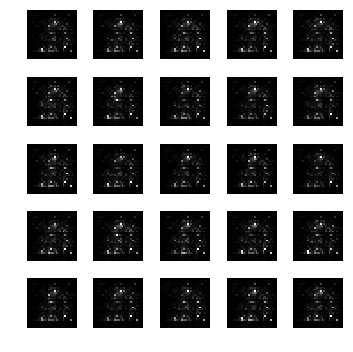

epoch: 681, time: 4.882662 | train_G_Loss: 0.704783, train_D_loss: 1.368205, train_acc: 0.087273
cv_G_Loss: 1.067944, cv_D_loss: 4.872993, cv_acc: 0.089200

epoch: 682, time: 4.872595 | train_G_Loss: 0.692644, train_D_loss: 1.389329, train_acc: 0.092727
cv_G_Loss: 0.818880, cv_D_loss: 4.484107, cv_acc: 0.097900

epoch: 683, time: 4.915127 | train_G_Loss: 0.691643, train_D_loss: 1.391439, train_acc: 0.089091
cv_G_Loss: 0.867121, cv_D_loss: 4.584840, cv_acc: 0.097400

epoch: 684, time: 4.869452 | train_G_Loss: 0.699402, train_D_loss: 1.375367, train_acc: 0.118182
cv_G_Loss: 0.773140, cv_D_loss: 4.462234, cv_acc: 0.108700

epoch: 685, time: 4.867445 | train_G_Loss: 0.695380, train_D_loss: 1.383933, train_acc: 0.143636
cv_G_Loss: 0.707646, cv_D_loss: 4.411498, cv_acc: 0.143200

epoch: 686, time: 4.867254 | train_G_Loss: 0.697625, train_D_loss: 1.381330, train_acc: 0.161818
cv_G_Loss: 0.695009, cv_D_loss: 4.390539, cv_acc: 0.097400

epoch: 687, time: 4.863028 | train_G_Loss: 0.699975, train

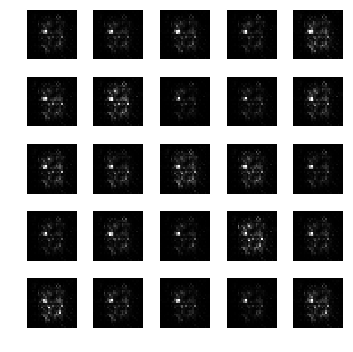

epoch: 691, time: 4.903053 | train_G_Loss: 0.690085, train_D_loss: 1.393018, train_acc: 0.127273
cv_G_Loss: 0.994377, cv_D_loss: 4.806198, cv_acc: 0.187600
Model saved

epoch: 692, time: 4.892070 | train_G_Loss: 0.688363, train_D_loss: 1.388088, train_acc: 0.127273
cv_G_Loss: 0.985830, cv_D_loss: 4.810616, cv_acc: 0.101000

epoch: 693, time: 4.878743 | train_G_Loss: 0.692289, train_D_loss: 1.388517, train_acc: 0.098182
cv_G_Loss: 0.779578, cv_D_loss: 4.520878, cv_acc: 0.172800

epoch: 694, time: 4.870430 | train_G_Loss: 0.689612, train_D_loss: 1.389379, train_acc: 0.096364
cv_G_Loss: 0.708046, cv_D_loss: 4.478084, cv_acc: 0.105200

epoch: 695, time: 4.868673 | train_G_Loss: 0.690134, train_D_loss: 1.395398, train_acc: 0.096364
cv_G_Loss: 0.694751, cv_D_loss: 4.454340, cv_acc: 0.098000

epoch: 696, time: 4.868585 | train_G_Loss: 0.707981, train_D_loss: 1.373511, train_acc: 0.163636
cv_G_Loss: 0.835903, cv_D_loss: 4.608112, cv_acc: 0.138700

epoch: 697, time: 4.868369 | train_G_Loss: 0.6

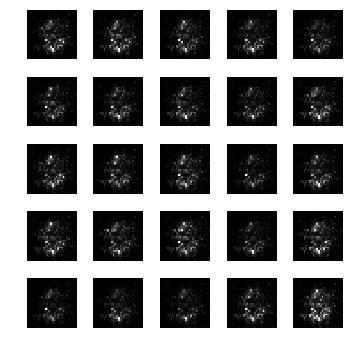

epoch: 701, time: 4.904107 | train_G_Loss: 0.692069, train_D_loss: 1.384684, train_acc: 0.100000
cv_G_Loss: 0.636437, cv_D_loss: 4.369973, cv_acc: 0.098200

epoch: 702, time: 4.870244 | train_G_Loss: 0.694960, train_D_loss: 1.383007, train_acc: 0.089091
cv_G_Loss: 0.740395, cv_D_loss: 4.483568, cv_acc: 0.097400

epoch: 703, time: 4.866957 | train_G_Loss: 0.695847, train_D_loss: 1.380541, train_acc: 0.145455
cv_G_Loss: 0.756874, cv_D_loss: 4.526947, cv_acc: 0.120200

epoch: 704, time: 4.871043 | train_G_Loss: 0.695917, train_D_loss: 1.382747, train_acc: 0.100000
cv_G_Loss: 0.886107, cv_D_loss: 4.602641, cv_acc: 0.150100

epoch: 705, time: 4.871148 | train_G_Loss: 0.693107, train_D_loss: 1.381945, train_acc: 0.098182
cv_G_Loss: 0.664009, cv_D_loss: 4.360074, cv_acc: 0.101400

epoch: 706, time: 4.913543 | train_G_Loss: 0.695958, train_D_loss: 1.383101, train_acc: 0.096364
cv_G_Loss: 0.754072, cv_D_loss: 4.458782, cv_acc: 0.101000

epoch: 707, time: 4.877911 | train_G_Loss: 0.695824, train

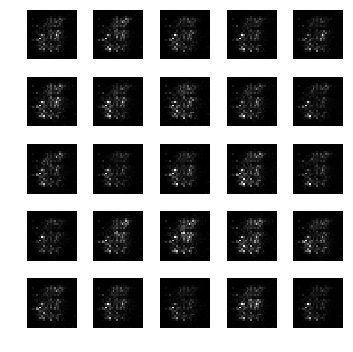

epoch: 711, time: 4.900006 | train_G_Loss: 0.690662, train_D_loss: 1.390791, train_acc: 0.101818
cv_G_Loss: 0.681731, cv_D_loss: 4.394751, cv_acc: 0.099200

epoch: 712, time: 4.869653 | train_G_Loss: 0.687990, train_D_loss: 1.391137, train_acc: 0.174545
cv_G_Loss: 0.700096, cv_D_loss: 4.405138, cv_acc: 0.142700

epoch: 713, time: 4.869462 | train_G_Loss: 0.692179, train_D_loss: 1.387380, train_acc: 0.170909
cv_G_Loss: 0.642137, cv_D_loss: 4.363705, cv_acc: 0.148800

epoch: 714, time: 4.869086 | train_G_Loss: 0.692032, train_D_loss: 1.395344, train_acc: 0.100000
cv_G_Loss: 0.730980, cv_D_loss: 4.493979, cv_acc: 0.158200

epoch: 715, time: 4.874933 | train_G_Loss: 0.696037, train_D_loss: 1.385461, train_acc: 0.129091
cv_G_Loss: 0.680480, cv_D_loss: 4.389554, cv_acc: 0.131800

epoch: 716, time: 4.877933 | train_G_Loss: 0.692993, train_D_loss: 1.386961, train_acc: 0.107273
cv_G_Loss: 0.692240, cv_D_loss: 4.424852, cv_acc: 0.113500

epoch: 717, time: 4.873020 | train_G_Loss: 0.695314, train

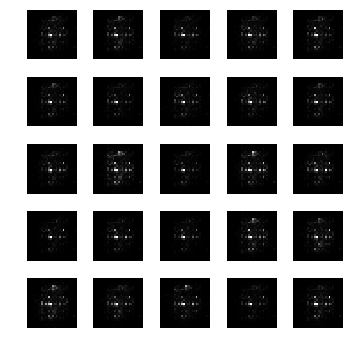

epoch: 721, time: 4.889317 | train_G_Loss: 0.696437, train_D_loss: 1.381345, train_acc: 0.110909
cv_G_Loss: 0.773492, cv_D_loss: 4.465677, cv_acc: 0.095800

epoch: 722, time: 4.873226 | train_G_Loss: 0.693647, train_D_loss: 1.387180, train_acc: 0.138182
cv_G_Loss: 0.650929, cv_D_loss: 4.349333, cv_acc: 0.102900

epoch: 723, time: 4.874424 | train_G_Loss: 0.692980, train_D_loss: 1.390952, train_acc: 0.152727
cv_G_Loss: 0.604134, cv_D_loss: 4.368418, cv_acc: 0.097400

epoch: 724, time: 4.871846 | train_G_Loss: 0.695400, train_D_loss: 1.386729, train_acc: 0.089091
cv_G_Loss: 0.592589, cv_D_loss: 4.359378, cv_acc: 0.100600

epoch: 725, time: 4.879860 | train_G_Loss: 0.689853, train_D_loss: 1.391832, train_acc: 0.105455
cv_G_Loss: 0.551307, cv_D_loss: 4.288843, cv_acc: 0.103200

epoch: 726, time: 4.868228 | train_G_Loss: 0.695200, train_D_loss: 1.388149, train_acc: 0.161818
cv_G_Loss: 0.716688, cv_D_loss: 4.425895, cv_acc: 0.102800

epoch: 727, time: 4.869486 | train_G_Loss: 0.687970, train

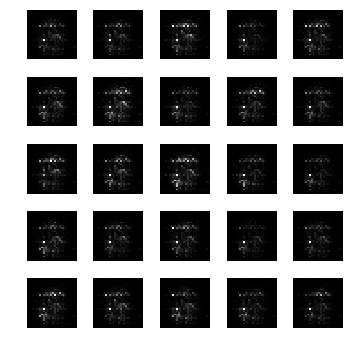

epoch: 731, time: 4.916139 | train_G_Loss: 0.699218, train_D_loss: 1.371945, train_acc: 0.096364
cv_G_Loss: 0.917681, cv_D_loss: 4.725971, cv_acc: 0.101000

epoch: 732, time: 4.873005 | train_G_Loss: 0.698461, train_D_loss: 1.375146, train_acc: 0.096364
cv_G_Loss: 0.728792, cv_D_loss: 4.502353, cv_acc: 0.101000

epoch: 733, time: 4.882788 | train_G_Loss: 0.687358, train_D_loss: 1.389076, train_acc: 0.096364
cv_G_Loss: 0.626616, cv_D_loss: 4.389351, cv_acc: 0.101000

epoch: 734, time: 4.867962 | train_G_Loss: 0.695849, train_D_loss: 1.378914, train_acc: 0.096364
cv_G_Loss: 0.692582, cv_D_loss: 4.390783, cv_acc: 0.108400

epoch: 735, time: 4.873845 | train_G_Loss: 0.698426, train_D_loss: 1.378657, train_acc: 0.100000
cv_G_Loss: 0.719971, cv_D_loss: 4.416741, cv_acc: 0.132700

epoch: 736, time: 4.872540 | train_G_Loss: 0.693915, train_D_loss: 1.384977, train_acc: 0.170909
cv_G_Loss: 1.225740, cv_D_loss: 5.182562, cv_acc: 0.113500

epoch: 737, time: 4.869714 | train_G_Loss: 0.697459, train

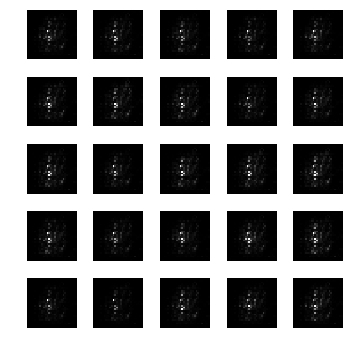

epoch: 741, time: 4.901441 | train_G_Loss: 0.690192, train_D_loss: 1.391768, train_acc: 0.096364
cv_G_Loss: 0.716799, cv_D_loss: 4.423969, cv_acc: 0.101000

epoch: 742, time: 4.875472 | train_G_Loss: 0.694655, train_D_loss: 1.384928, train_acc: 0.096364
cv_G_Loss: 0.454589, cv_D_loss: 4.229648, cv_acc: 0.101000

epoch: 743, time: 4.873269 | train_G_Loss: 0.687935, train_D_loss: 1.401422, train_acc: 0.096364
cv_G_Loss: 0.586740, cv_D_loss: 4.352839, cv_acc: 0.100500

epoch: 744, time: 4.874898 | train_G_Loss: 0.691029, train_D_loss: 1.393966, train_acc: 0.096364
cv_G_Loss: 0.732678, cv_D_loss: 4.515713, cv_acc: 0.100600

epoch: 745, time: 4.874526 | train_G_Loss: 0.692058, train_D_loss: 1.387924, train_acc: 0.141818
cv_G_Loss: 0.731977, cv_D_loss: 4.456764, cv_acc: 0.142900

epoch: 746, time: 4.875794 | train_G_Loss: 0.691484, train_D_loss: 1.388577, train_acc: 0.169091
cv_G_Loss: 0.677872, cv_D_loss: 4.416688, cv_acc: 0.145900

epoch: 747, time: 4.877886 | train_G_Loss: 0.693347, train

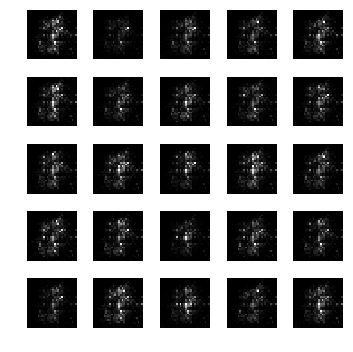

epoch: 751, time: 4.925362 | train_G_Loss: 0.698388, train_D_loss: 1.375066, train_acc: 0.098182
cv_G_Loss: 0.865296, cv_D_loss: 4.521506, cv_acc: 0.108000

epoch: 752, time: 4.933754 | train_G_Loss: 0.695362, train_D_loss: 1.383829, train_acc: 0.110909
cv_G_Loss: 0.756889, cv_D_loss: 4.450701, cv_acc: 0.095800

epoch: 753, time: 4.865815 | train_G_Loss: 0.695137, train_D_loss: 1.387167, train_acc: 0.110909
cv_G_Loss: 0.784782, cv_D_loss: 4.521161, cv_acc: 0.095800

epoch: 754, time: 4.875868 | train_G_Loss: 0.701119, train_D_loss: 1.379164, train_acc: 0.110909
cv_G_Loss: 0.658367, cv_D_loss: 4.385259, cv_acc: 0.095800

epoch: 755, time: 4.858284 | train_G_Loss: 0.693071, train_D_loss: 1.384741, train_acc: 0.110909
cv_G_Loss: 0.677791, cv_D_loss: 4.448974, cv_acc: 0.095800

epoch: 756, time: 4.865363 | train_G_Loss: 0.694952, train_D_loss: 1.383308, train_acc: 0.110909
cv_G_Loss: 0.795526, cv_D_loss: 4.521863, cv_acc: 0.095800

epoch: 757, time: 4.876145 | train_G_Loss: 0.695946, train

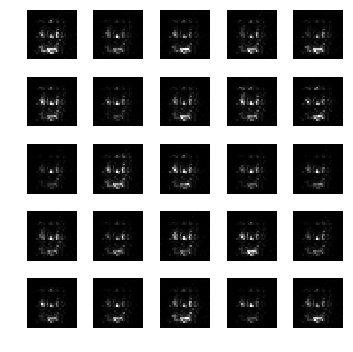

epoch: 761, time: 4.902734 | train_G_Loss: 0.695472, train_D_loss: 1.381210, train_acc: 0.109091
cv_G_Loss: 0.749053, cv_D_loss: 4.487129, cv_acc: 0.102800

epoch: 762, time: 4.879062 | train_G_Loss: 0.698734, train_D_loss: 1.371959, train_acc: 0.109091
cv_G_Loss: 0.766435, cv_D_loss: 4.490628, cv_acc: 0.102800

epoch: 763, time: 4.881781 | train_G_Loss: 0.691004, train_D_loss: 1.392627, train_acc: 0.109091
cv_G_Loss: 0.749079, cv_D_loss: 4.459777, cv_acc: 0.102800

epoch: 764, time: 4.863396 | train_G_Loss: 0.691726, train_D_loss: 1.386250, train_acc: 0.109091
cv_G_Loss: 0.866668, cv_D_loss: 4.616125, cv_acc: 0.102800

epoch: 765, time: 4.869900 | train_G_Loss: 0.690201, train_D_loss: 1.388112, train_acc: 0.112727
cv_G_Loss: 0.654780, cv_D_loss: 4.394116, cv_acc: 0.109400

epoch: 766, time: 4.872547 | train_G_Loss: 0.691829, train_D_loss: 1.389768, train_acc: 0.087273
cv_G_Loss: 0.639202, cv_D_loss: 4.382012, cv_acc: 0.089200

epoch: 767, time: 4.870451 | train_G_Loss: 0.692653, train

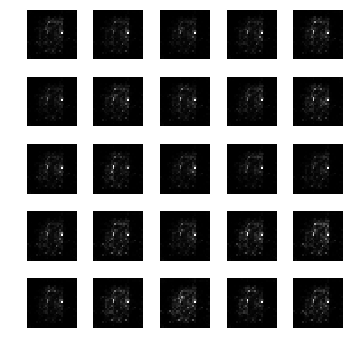

epoch: 771, time: 4.914808 | train_G_Loss: 0.690685, train_D_loss: 1.386042, train_acc: 0.165455
cv_G_Loss: 0.700526, cv_D_loss: 4.397731, cv_acc: 0.171400

epoch: 772, time: 4.873155 | train_G_Loss: 0.693738, train_D_loss: 1.386134, train_acc: 0.096364
cv_G_Loss: 0.778564, cv_D_loss: 4.513641, cv_acc: 0.101000

epoch: 773, time: 4.872637 | train_G_Loss: 0.695037, train_D_loss: 1.380304, train_acc: 0.096364
cv_G_Loss: 0.726657, cv_D_loss: 4.437393, cv_acc: 0.101000

epoch: 774, time: 4.872155 | train_G_Loss: 0.691721, train_D_loss: 1.389657, train_acc: 0.096364
cv_G_Loss: 0.754105, cv_D_loss: 4.458642, cv_acc: 0.101000

epoch: 775, time: 4.902963 | train_G_Loss: 0.694153, train_D_loss: 1.382620, train_acc: 0.100000
cv_G_Loss: 0.714895, cv_D_loss: 4.385999, cv_acc: 0.133800

epoch: 776, time: 4.876052 | train_G_Loss: 0.696025, train_D_loss: 1.381746, train_acc: 0.145455
cv_G_Loss: 0.749601, cv_D_loss: 4.428050, cv_acc: 0.137100

epoch: 777, time: 4.876745 | train_G_Loss: 0.693158, train

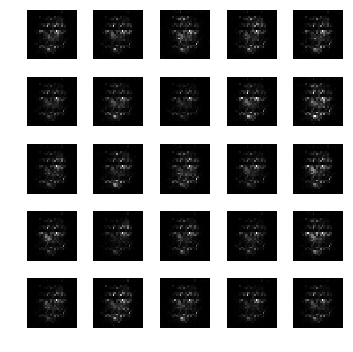

epoch: 781, time: 4.898240 | train_G_Loss: 0.695305, train_D_loss: 1.382208, train_acc: 0.110909
cv_G_Loss: 0.704098, cv_D_loss: 4.397824, cv_acc: 0.095800

epoch: 782, time: 4.882938 | train_G_Loss: 0.694064, train_D_loss: 1.383800, train_acc: 0.152727
cv_G_Loss: 0.737561, cv_D_loss: 4.391459, cv_acc: 0.096100

epoch: 783, time: 4.871728 | train_G_Loss: 0.694833, train_D_loss: 1.383165, train_acc: 0.109091
cv_G_Loss: 0.678931, cv_D_loss: 4.341756, cv_acc: 0.102800

epoch: 784, time: 4.876228 | train_G_Loss: 0.690548, train_D_loss: 1.393722, train_acc: 0.110909
cv_G_Loss: 0.910791, cv_D_loss: 4.678134, cv_acc: 0.183100

epoch: 785, time: 4.876592 | train_G_Loss: 0.697370, train_D_loss: 1.378997, train_acc: 0.149091
cv_G_Loss: 0.732617, cv_D_loss: 4.513172, cv_acc: 0.174100

epoch: 786, time: 4.867741 | train_G_Loss: 0.695959, train_D_loss: 1.384913, train_acc: 0.109091
cv_G_Loss: 0.795729, cv_D_loss: 4.541897, cv_acc: 0.102800

epoch: 787, time: 4.879977 | train_G_Loss: 0.691700, train

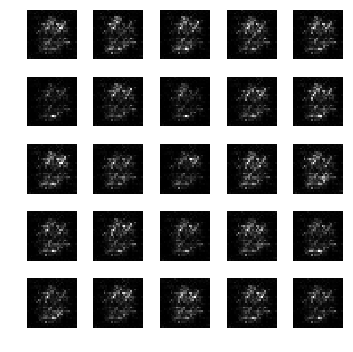

epoch: 791, time: 4.902350 | train_G_Loss: 0.686921, train_D_loss: 1.400283, train_acc: 0.118182
cv_G_Loss: 0.722999, cv_D_loss: 4.425193, cv_acc: 0.122100

epoch: 792, time: 4.865367 | train_G_Loss: 0.690467, train_D_loss: 1.394452, train_acc: 0.094545
cv_G_Loss: 0.690939, cv_D_loss: 4.412737, cv_acc: 0.101000

epoch: 793, time: 4.868736 | train_G_Loss: 0.697524, train_D_loss: 1.379262, train_acc: 0.096364
cv_G_Loss: 0.692424, cv_D_loss: 4.431757, cv_acc: 0.160400

epoch: 794, time: 4.866320 | train_G_Loss: 0.694968, train_D_loss: 1.380209, train_acc: 0.096364
cv_G_Loss: 0.768230, cv_D_loss: 4.481432, cv_acc: 0.098000

epoch: 795, time: 4.876613 | train_G_Loss: 0.691341, train_D_loss: 1.394790, train_acc: 0.096364
cv_G_Loss: 0.694129, cv_D_loss: 4.465834, cv_acc: 0.098000

epoch: 796, time: 4.872428 | train_G_Loss: 0.698389, train_D_loss: 1.393466, train_acc: 0.096364
cv_G_Loss: 1.080798, cv_D_loss: 4.963631, cv_acc: 0.098000

epoch: 797, time: 4.869613 | train_G_Loss: 0.693103, train

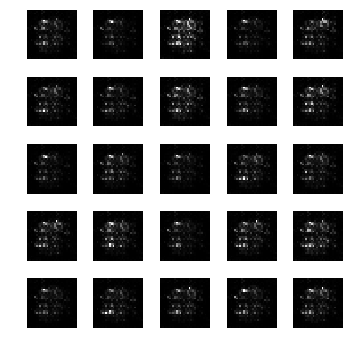

epoch: 801, time: 4.906900 | train_G_Loss: 0.697998, train_D_loss: 1.376731, train_acc: 0.096364
cv_G_Loss: 0.778321, cv_D_loss: 4.503360, cv_acc: 0.098000

epoch: 802, time: 4.863290 | train_G_Loss: 0.699199, train_D_loss: 1.367194, train_acc: 0.096364
cv_G_Loss: 0.877261, cv_D_loss: 4.627937, cv_acc: 0.098000

epoch: 803, time: 4.867888 | train_G_Loss: 0.697395, train_D_loss: 1.376846, train_acc: 0.096364
cv_G_Loss: 0.804644, cv_D_loss: 4.572031, cv_acc: 0.098000

epoch: 804, time: 4.875656 | train_G_Loss: 0.696881, train_D_loss: 1.377048, train_acc: 0.096364
cv_G_Loss: 0.848787, cv_D_loss: 4.572544, cv_acc: 0.106900

epoch: 805, time: 4.868942 | train_G_Loss: 0.698431, train_D_loss: 1.378536, train_acc: 0.096364
cv_G_Loss: 0.661902, cv_D_loss: 4.428578, cv_acc: 0.101000

epoch: 806, time: 4.873684 | train_G_Loss: 0.698148, train_D_loss: 1.378510, train_acc: 0.112727
cv_G_Loss: 0.891706, cv_D_loss: 4.662347, cv_acc: 0.101000

epoch: 807, time: 4.871576 | train_G_Loss: 0.690933, train

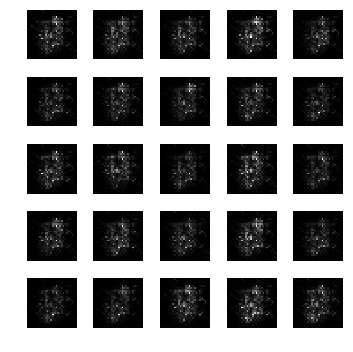

epoch: 811, time: 4.895066 | train_G_Loss: 0.691312, train_D_loss: 1.376944, train_acc: 0.098182
cv_G_Loss: 0.753412, cv_D_loss: 4.414506, cv_acc: 0.100900

epoch: 812, time: 4.940400 | train_G_Loss: 0.692517, train_D_loss: 1.390516, train_acc: 0.118182
cv_G_Loss: 0.601861, cv_D_loss: 4.359416, cv_acc: 0.095300

epoch: 813, time: 4.888760 | train_G_Loss: 0.698460, train_D_loss: 1.375451, train_acc: 0.090909
cv_G_Loss: 0.887571, cv_D_loss: 4.691496, cv_acc: 0.137700

epoch: 814, time: 4.876936 | train_G_Loss: 0.697829, train_D_loss: 1.383006, train_acc: 0.112727
cv_G_Loss: 0.775262, cv_D_loss: 4.484642, cv_acc: 0.156300

epoch: 815, time: 4.873389 | train_G_Loss: 0.705644, train_D_loss: 1.364067, train_acc: 0.087273
cv_G_Loss: 1.153840, cv_D_loss: 4.910242, cv_acc: 0.123500

epoch: 816, time: 4.876748 | train_G_Loss: 0.709079, train_D_loss: 1.366557, train_acc: 0.210909
cv_G_Loss: 0.733237, cv_D_loss: 4.502316, cv_acc: 0.101000

epoch: 817, time: 4.878143 | train_G_Loss: 0.695113, train

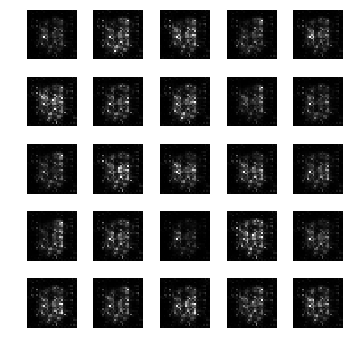

epoch: 821, time: 4.936055 | train_G_Loss: 0.692024, train_D_loss: 1.392449, train_acc: 0.098182
cv_G_Loss: 0.608922, cv_D_loss: 4.392331, cv_acc: 0.100900

epoch: 822, time: 4.880775 | train_G_Loss: 0.693948, train_D_loss: 1.393362, train_acc: 0.098182
cv_G_Loss: 0.965007, cv_D_loss: 4.855190, cv_acc: 0.146600

epoch: 823, time: 4.876553 | train_G_Loss: 0.697750, train_D_loss: 1.375904, train_acc: 0.098182
cv_G_Loss: 0.793358, cv_D_loss: 4.543535, cv_acc: 0.100900

epoch: 824, time: 4.871324 | train_G_Loss: 0.698501, train_D_loss: 1.382577, train_acc: 0.098182
cv_G_Loss: 0.640624, cv_D_loss: 4.433011, cv_acc: 0.100900

epoch: 825, time: 4.870477 | train_G_Loss: 0.688385, train_D_loss: 1.398350, train_acc: 0.110909
cv_G_Loss: 0.791017, cv_D_loss: 4.510415, cv_acc: 0.123400

epoch: 826, time: 4.886893 | train_G_Loss: 0.692673, train_D_loss: 1.384389, train_acc: 0.107273
cv_G_Loss: 0.727949, cv_D_loss: 4.462317, cv_acc: 0.113500

epoch: 827, time: 4.878398 | train_G_Loss: 0.694923, train

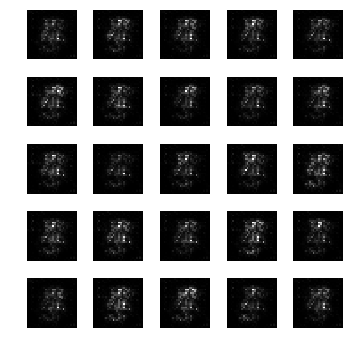

epoch: 831, time: 4.914531 | train_G_Loss: 0.691821, train_D_loss: 1.388848, train_acc: 0.098182
cv_G_Loss: 0.824203, cv_D_loss: 4.558856, cv_acc: 0.100900

epoch: 832, time: 4.861136 | train_G_Loss: 0.692609, train_D_loss: 1.386804, train_acc: 0.098182
cv_G_Loss: 0.626810, cv_D_loss: 4.401478, cv_acc: 0.100900

epoch: 833, time: 4.860483 | train_G_Loss: 0.687131, train_D_loss: 1.398370, train_acc: 0.160000
cv_G_Loss: 0.573014, cv_D_loss: 4.299376, cv_acc: 0.146100

epoch: 834, time: 4.870014 | train_G_Loss: 0.693872, train_D_loss: 1.384514, train_acc: 0.089091
cv_G_Loss: 0.654451, cv_D_loss: 4.340435, cv_acc: 0.097400

epoch: 835, time: 4.870340 | train_G_Loss: 0.692780, train_D_loss: 1.384510, train_acc: 0.096364
cv_G_Loss: 0.681948, cv_D_loss: 4.362094, cv_acc: 0.117700

epoch: 836, time: 4.871238 | train_G_Loss: 0.697960, train_D_loss: 1.373543, train_acc: 0.096364
cv_G_Loss: 0.707550, cv_D_loss: 4.399456, cv_acc: 0.101000

epoch: 837, time: 4.872798 | train_G_Loss: 0.696186, train

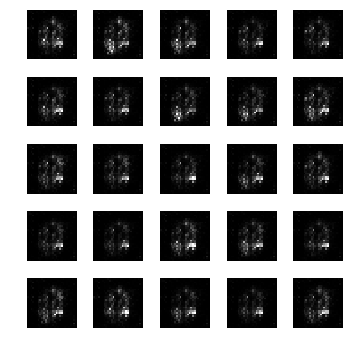

epoch: 841, time: 4.909340 | train_G_Loss: 0.690830, train_D_loss: 1.393451, train_acc: 0.136364
cv_G_Loss: 0.735234, cv_D_loss: 4.419241, cv_acc: 0.141900

epoch: 842, time: 4.875089 | train_G_Loss: 0.688274, train_D_loss: 1.396768, train_acc: 0.103636
cv_G_Loss: 0.731410, cv_D_loss: 4.448286, cv_acc: 0.100300

epoch: 843, time: 4.866467 | train_G_Loss: 0.690893, train_D_loss: 1.391496, train_acc: 0.100000
cv_G_Loss: 0.864602, cv_D_loss: 4.590470, cv_acc: 0.098200

epoch: 844, time: 4.906654 | train_G_Loss: 0.690465, train_D_loss: 1.395177, train_acc: 0.087273
cv_G_Loss: 0.683371, cv_D_loss: 4.388162, cv_acc: 0.089500

epoch: 845, time: 4.877671 | train_G_Loss: 0.690562, train_D_loss: 1.388455, train_acc: 0.103636
cv_G_Loss: 0.796273, cv_D_loss: 4.471944, cv_acc: 0.110800

epoch: 846, time: 4.870137 | train_G_Loss: 0.681310, train_D_loss: 1.414897, train_acc: 0.178182
cv_G_Loss: 0.754018, cv_D_loss: 4.452138, cv_acc: 0.158200

epoch: 847, time: 4.881601 | train_G_Loss: 0.695105, train

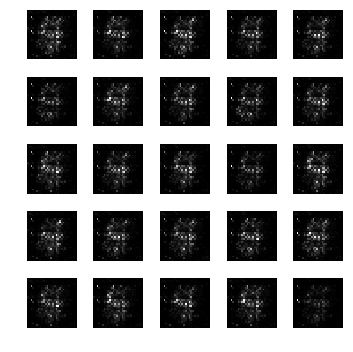

epoch: 851, time: 4.910010 | train_G_Loss: 0.690264, train_D_loss: 1.395143, train_acc: 0.107273
cv_G_Loss: 0.817627, cv_D_loss: 4.631132, cv_acc: 0.121500

epoch: 852, time: 4.886758 | train_G_Loss: 0.699296, train_D_loss: 1.377124, train_acc: 0.096364
cv_G_Loss: 0.749540, cv_D_loss: 4.499292, cv_acc: 0.098000

epoch: 853, time: 4.868749 | train_G_Loss: 0.693137, train_D_loss: 1.380797, train_acc: 0.169091
cv_G_Loss: 0.747216, cv_D_loss: 4.489383, cv_acc: 0.103900

epoch: 854, time: 4.868845 | train_G_Loss: 0.696024, train_D_loss: 1.379022, train_acc: 0.109091
cv_G_Loss: 0.702041, cv_D_loss: 4.449656, cv_acc: 0.102800

epoch: 855, time: 4.876947 | train_G_Loss: 0.693726, train_D_loss: 1.381662, train_acc: 0.109091
cv_G_Loss: 0.698871, cv_D_loss: 4.477007, cv_acc: 0.102800

epoch: 856, time: 4.874081 | train_G_Loss: 0.692725, train_D_loss: 1.386286, train_acc: 0.174545
cv_G_Loss: 0.757235, cv_D_loss: 4.508835, cv_acc: 0.150900

epoch: 857, time: 4.892606 | train_G_Loss: 0.697187, train

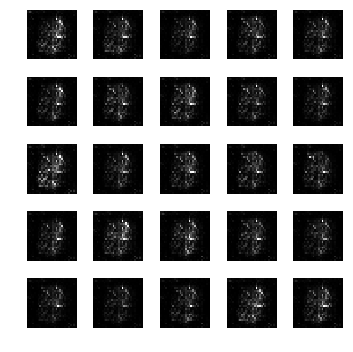

epoch: 861, time: 4.919101 | train_G_Loss: 0.688924, train_D_loss: 1.390315, train_acc: 0.101818
cv_G_Loss: 0.804419, cv_D_loss: 4.526620, cv_acc: 0.097400

epoch: 862, time: 4.872562 | train_G_Loss: 0.687665, train_D_loss: 1.391164, train_acc: 0.100000
cv_G_Loss: 0.724649, cv_D_loss: 4.448426, cv_acc: 0.098200

epoch: 863, time: 4.879950 | train_G_Loss: 0.691105, train_D_loss: 1.385816, train_acc: 0.100000
cv_G_Loss: 0.960757, cv_D_loss: 4.749167, cv_acc: 0.098200

epoch: 864, time: 4.867068 | train_G_Loss: 0.690982, train_D_loss: 1.390293, train_acc: 0.100000
cv_G_Loss: 0.792371, cv_D_loss: 4.495574, cv_acc: 0.098200

epoch: 865, time: 4.879496 | train_G_Loss: 0.698323, train_D_loss: 1.377929, train_acc: 0.100000
cv_G_Loss: 0.738820, cv_D_loss: 4.420635, cv_acc: 0.104100

epoch: 866, time: 4.861723 | train_G_Loss: 0.696013, train_D_loss: 1.376564, train_acc: 0.089091
cv_G_Loss: 0.642351, cv_D_loss: 4.342227, cv_acc: 0.097400

epoch: 867, time: 4.917081 | train_G_Loss: 0.698880, train

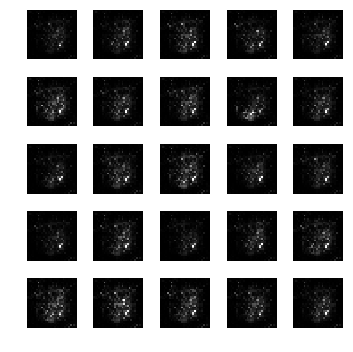

epoch: 871, time: 4.896248 | train_G_Loss: 0.689428, train_D_loss: 1.391477, train_acc: 0.101818
cv_G_Loss: 0.781684, cv_D_loss: 4.522829, cv_acc: 0.100500

epoch: 872, time: 4.871730 | train_G_Loss: 0.693417, train_D_loss: 1.383076, train_acc: 0.198182
cv_G_Loss: 0.749552, cv_D_loss: 4.466120, cv_acc: 0.139300

epoch: 873, time: 4.878488 | train_G_Loss: 0.695085, train_D_loss: 1.383082, train_acc: 0.161818
cv_G_Loss: 0.692728, cv_D_loss: 4.407765, cv_acc: 0.173400

epoch: 874, time: 4.870764 | train_G_Loss: 0.691889, train_D_loss: 1.386252, train_acc: 0.110909
cv_G_Loss: 0.708956, cv_D_loss: 4.456434, cv_acc: 0.098900

epoch: 875, time: 4.870118 | train_G_Loss: 0.690259, train_D_loss: 1.386279, train_acc: 0.207273
cv_G_Loss: 0.829264, cv_D_loss: 4.592486, cv_acc: 0.160800

epoch: 876, time: 4.869518 | train_G_Loss: 0.694415, train_D_loss: 1.383196, train_acc: 0.110909
cv_G_Loss: 0.777308, cv_D_loss: 4.483127, cv_acc: 0.095800

epoch: 877, time: 4.865405 | train_G_Loss: 0.695135, train

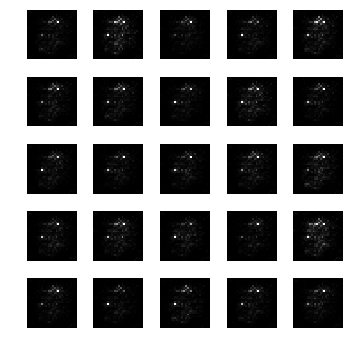

epoch: 881, time: 4.912754 | train_G_Loss: 0.690941, train_D_loss: 1.396825, train_acc: 0.161818
cv_G_Loss: 0.735168, cv_D_loss: 4.479061, cv_acc: 0.117100

epoch: 882, time: 4.869311 | train_G_Loss: 0.691316, train_D_loss: 1.384957, train_acc: 0.107273
cv_G_Loss: 0.702032, cv_D_loss: 4.407713, cv_acc: 0.113500

epoch: 883, time: 4.875076 | train_G_Loss: 0.690509, train_D_loss: 1.387405, train_acc: 0.100000
cv_G_Loss: 0.704086, cv_D_loss: 4.410847, cv_acc: 0.103000

epoch: 884, time: 4.865460 | train_G_Loss: 0.695808, train_D_loss: 1.382743, train_acc: 0.105455
cv_G_Loss: 0.936157, cv_D_loss: 4.713563, cv_acc: 0.101100

epoch: 885, time: 4.872498 | train_G_Loss: 0.693086, train_D_loss: 1.381631, train_acc: 0.190909
cv_G_Loss: 0.740984, cv_D_loss: 4.415370, cv_acc: 0.103400

epoch: 886, time: 4.867066 | train_G_Loss: 0.692377, train_D_loss: 1.385338, train_acc: 0.143636
cv_G_Loss: 0.697115, cv_D_loss: 4.382898, cv_acc: 0.098000

epoch: 887, time: 4.866932 | train_G_Loss: 0.693735, train

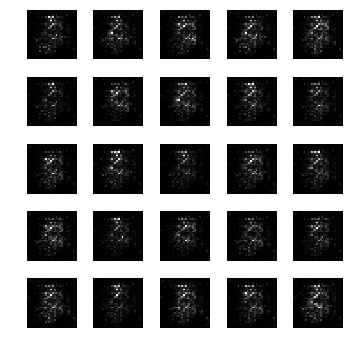

epoch: 891, time: 4.916989 | train_G_Loss: 0.698433, train_D_loss: 1.376627, train_acc: 0.110909
cv_G_Loss: 0.739503, cv_D_loss: 4.405154, cv_acc: 0.095800

epoch: 892, time: 4.877295 | train_G_Loss: 0.692951, train_D_loss: 1.383186, train_acc: 0.054545
cv_G_Loss: 0.654398, cv_D_loss: 4.417571, cv_acc: 0.072800

epoch: 893, time: 4.871161 | train_G_Loss: 0.693282, train_D_loss: 1.382707, train_acc: 0.105455
cv_G_Loss: 0.526496, cv_D_loss: 4.270624, cv_acc: 0.103200

epoch: 894, time: 4.863477 | train_G_Loss: 0.693341, train_D_loss: 1.385209, train_acc: 0.054545
cv_G_Loss: 0.599153, cv_D_loss: 4.265776, cv_acc: 0.096900

epoch: 895, time: 4.868689 | train_G_Loss: 0.698322, train_D_loss: 1.373304, train_acc: 0.096364
cv_G_Loss: 0.816626, cv_D_loss: 4.428802, cv_acc: 0.098000

epoch: 896, time: 4.866101 | train_G_Loss: 0.694714, train_D_loss: 1.374694, train_acc: 0.096364
cv_G_Loss: 0.778355, cv_D_loss: 4.445472, cv_acc: 0.098000

epoch: 897, time: 4.872346 | train_G_Loss: 0.693717, train

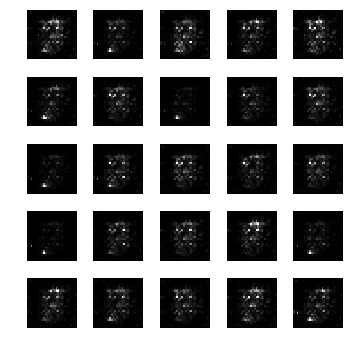

epoch: 901, time: 4.910396 | train_G_Loss: 0.692248, train_D_loss: 1.386638, train_acc: 0.109091
cv_G_Loss: 0.700966, cv_D_loss: 4.425911, cv_acc: 0.102800

epoch: 902, time: 4.868179 | train_G_Loss: 0.714909, train_D_loss: 1.377620, train_acc: 0.096364
cv_G_Loss: 1.005427, cv_D_loss: 4.757277, cv_acc: 0.098000

epoch: 903, time: 4.886277 | train_G_Loss: 0.692379, train_D_loss: 1.390521, train_acc: 0.096364
cv_G_Loss: 0.686709, cv_D_loss: 4.438301, cv_acc: 0.098000

epoch: 904, time: 4.868610 | train_G_Loss: 0.679045, train_D_loss: 1.403225, train_acc: 0.096364
cv_G_Loss: 0.747001, cv_D_loss: 4.573593, cv_acc: 0.098000

epoch: 905, time: 4.864388 | train_G_Loss: 0.699216, train_D_loss: 1.385090, train_acc: 0.105455
cv_G_Loss: 0.879244, cv_D_loss: 4.644798, cv_acc: 0.128700

epoch: 906, time: 4.866346 | train_G_Loss: 0.691301, train_D_loss: 1.387242, train_acc: 0.105455
cv_G_Loss: 0.746720, cv_D_loss: 4.489537, cv_acc: 0.103200

epoch: 907, time: 4.872216 | train_G_Loss: 0.688213, train

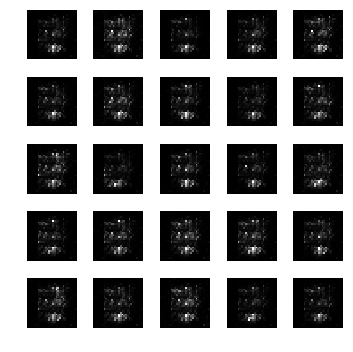

epoch: 911, time: 4.885715 | train_G_Loss: 0.700429, train_D_loss: 1.382897, train_acc: 0.110909
cv_G_Loss: 0.661214, cv_D_loss: 4.438663, cv_acc: 0.095800

epoch: 912, time: 4.870408 | train_G_Loss: 0.697340, train_D_loss: 1.381611, train_acc: 0.110909
cv_G_Loss: 0.706252, cv_D_loss: 4.449828, cv_acc: 0.095800

epoch: 913, time: 4.906728 | train_G_Loss: 0.698347, train_D_loss: 1.383745, train_acc: 0.121818
cv_G_Loss: 0.664399, cv_D_loss: 4.402164, cv_acc: 0.095800

epoch: 914, time: 4.878092 | train_G_Loss: 0.703364, train_D_loss: 1.368514, train_acc: 0.172727
cv_G_Loss: 0.424768, cv_D_loss: 4.247465, cv_acc: 0.129100

epoch: 915, time: 4.866246 | train_G_Loss: 0.695809, train_D_loss: 1.382463, train_acc: 0.120000
cv_G_Loss: 0.654230, cv_D_loss: 4.377898, cv_acc: 0.095800

epoch: 916, time: 4.862396 | train_G_Loss: 0.693331, train_D_loss: 1.385941, train_acc: 0.110909
cv_G_Loss: 0.744237, cv_D_loss: 4.509743, cv_acc: 0.095800

epoch: 917, time: 4.868721 | train_G_Loss: 0.695471, train

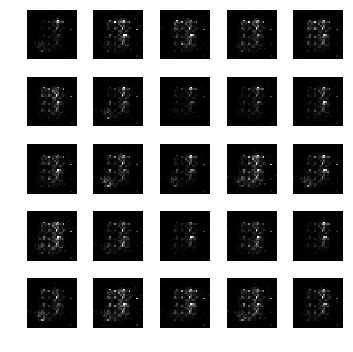

epoch: 921, time: 4.903736 | train_G_Loss: 0.693725, train_D_loss: 1.385061, train_acc: 0.087273
cv_G_Loss: 0.656435, cv_D_loss: 4.426171, cv_acc: 0.089200

epoch: 922, time: 4.878909 | train_G_Loss: 0.696624, train_D_loss: 1.380631, train_acc: 0.101818
cv_G_Loss: 0.676794, cv_D_loss: 4.414881, cv_acc: 0.091000

epoch: 923, time: 4.871762 | train_G_Loss: 0.695909, train_D_loss: 1.380156, train_acc: 0.110909
cv_G_Loss: 0.675627, cv_D_loss: 4.386519, cv_acc: 0.095700

epoch: 924, time: 4.863820 | train_G_Loss: 0.693773, train_D_loss: 1.387235, train_acc: 0.087273
cv_G_Loss: 0.745632, cv_D_loss: 4.452369, cv_acc: 0.089200

epoch: 925, time: 4.870755 | train_G_Loss: 0.699694, train_D_loss: 1.378635, train_acc: 0.087273
cv_G_Loss: 0.759185, cv_D_loss: 4.480192, cv_acc: 0.089200

epoch: 926, time: 4.876139 | train_G_Loss: 0.697330, train_D_loss: 1.379232, train_acc: 0.087273
cv_G_Loss: 0.737594, cv_D_loss: 4.436925, cv_acc: 0.089200

epoch: 927, time: 4.876417 | train_G_Loss: 0.697550, train

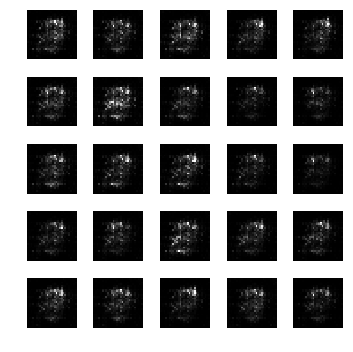

epoch: 931, time: 4.903354 | train_G_Loss: 0.697988, train_D_loss: 1.377526, train_acc: 0.087273
cv_G_Loss: 0.668523, cv_D_loss: 4.345079, cv_acc: 0.097500

epoch: 932, time: 4.863202 | train_G_Loss: 0.697575, train_D_loss: 1.377354, train_acc: 0.087273
cv_G_Loss: 0.752460, cv_D_loss: 4.430192, cv_acc: 0.089200

epoch: 933, time: 4.878765 | train_G_Loss: 0.690776, train_D_loss: 1.382921, train_acc: 0.087273
cv_G_Loss: 0.837362, cv_D_loss: 4.571917, cv_acc: 0.089200

epoch: 934, time: 4.879167 | train_G_Loss: 0.692457, train_D_loss: 1.386161, train_acc: 0.087273
cv_G_Loss: 0.695447, cv_D_loss: 4.387268, cv_acc: 0.089200

epoch: 935, time: 4.870464 | train_G_Loss: 0.692396, train_D_loss: 1.382970, train_acc: 0.087273
cv_G_Loss: 0.578396, cv_D_loss: 4.364515, cv_acc: 0.089200

epoch: 936, time: 5.031922 | train_G_Loss: 0.695920, train_D_loss: 1.381769, train_acc: 0.087273
cv_G_Loss: 0.721030, cv_D_loss: 4.399797, cv_acc: 0.089200

epoch: 937, time: 4.876251 | train_G_Loss: 0.695102, train

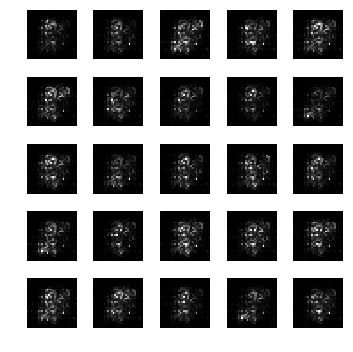

epoch: 941, time: 4.918422 | train_G_Loss: 0.688418, train_D_loss: 1.392894, train_acc: 0.100000
cv_G_Loss: 0.654038, cv_D_loss: 4.463204, cv_acc: 0.102800

epoch: 942, time: 4.870725 | train_G_Loss: 0.692745, train_D_loss: 1.384029, train_acc: 0.089091
cv_G_Loss: 0.753645, cv_D_loss: 4.534879, cv_acc: 0.089200

epoch: 943, time: 4.882430 | train_G_Loss: 0.696598, train_D_loss: 1.378286, train_acc: 0.110909
cv_G_Loss: 0.771447, cv_D_loss: 4.568794, cv_acc: 0.095800

epoch: 944, time: 4.867726 | train_G_Loss: 0.699568, train_D_loss: 1.377092, train_acc: 0.109091
cv_G_Loss: 0.589987, cv_D_loss: 4.301597, cv_acc: 0.102800

epoch: 945, time: 4.864925 | train_G_Loss: 0.705894, train_D_loss: 1.371063, train_acc: 0.109091
cv_G_Loss: 0.777416, cv_D_loss: 4.503731, cv_acc: 0.102800

epoch: 946, time: 4.870806 | train_G_Loss: 0.699308, train_D_loss: 1.377931, train_acc: 0.109091
cv_G_Loss: 0.812862, cv_D_loss: 4.564631, cv_acc: 0.102800

epoch: 947, time: 4.863406 | train_G_Loss: 0.690290, train

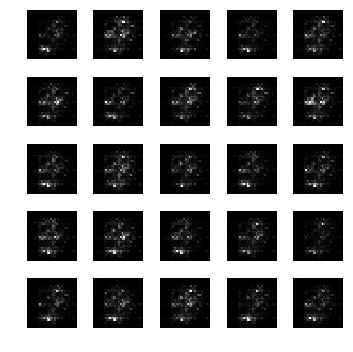

epoch: 951, time: 4.885956 | train_G_Loss: 0.689188, train_D_loss: 1.398506, train_acc: 0.109091
cv_G_Loss: 0.764648, cv_D_loss: 4.558670, cv_acc: 0.102800

epoch: 952, time: 4.868839 | train_G_Loss: 0.696513, train_D_loss: 1.377898, train_acc: 0.109091
cv_G_Loss: 0.566813, cv_D_loss: 4.325099, cv_acc: 0.102800

epoch: 953, time: 4.874299 | train_G_Loss: 0.698657, train_D_loss: 1.382523, train_acc: 0.109091
cv_G_Loss: 0.653454, cv_D_loss: 4.350446, cv_acc: 0.102800

epoch: 954, time: 4.863178 | train_G_Loss: 0.693814, train_D_loss: 1.384546, train_acc: 0.109091
cv_G_Loss: 0.652556, cv_D_loss: 4.363363, cv_acc: 0.102800

epoch: 955, time: 4.871491 | train_G_Loss: 0.687066, train_D_loss: 1.391623, train_acc: 0.109091
cv_G_Loss: 0.637372, cv_D_loss: 4.440331, cv_acc: 0.102800

epoch: 956, time: 4.880774 | train_G_Loss: 0.692058, train_D_loss: 1.391131, train_acc: 0.109091
cv_G_Loss: 0.903070, cv_D_loss: 4.684208, cv_acc: 0.102800

epoch: 957, time: 4.885820 | train_G_Loss: 0.690000, train

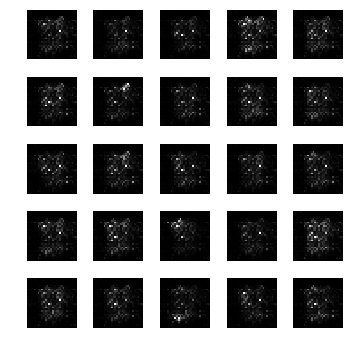

epoch: 961, time: 4.899311 | train_G_Loss: 0.688476, train_D_loss: 1.389471, train_acc: 0.105455
cv_G_Loss: 0.632360, cv_D_loss: 4.358956, cv_acc: 0.103200

epoch: 962, time: 4.869039 | train_G_Loss: 0.695882, train_D_loss: 1.377544, train_acc: 0.105455
cv_G_Loss: 0.634617, cv_D_loss: 4.326348, cv_acc: 0.103200

epoch: 963, time: 4.869133 | train_G_Loss: 0.697156, train_D_loss: 1.374025, train_acc: 0.087273
cv_G_Loss: 0.657078, cv_D_loss: 4.309256, cv_acc: 0.091600

epoch: 964, time: 4.877837 | train_G_Loss: 0.695450, train_D_loss: 1.376019, train_acc: 0.103636
cv_G_Loss: 0.645877, cv_D_loss: 4.324608, cv_acc: 0.110800

epoch: 965, time: 4.864290 | train_G_Loss: 0.698264, train_D_loss: 1.378410, train_acc: 0.098182
cv_G_Loss: 0.831765, cv_D_loss: 4.537467, cv_acc: 0.101000

epoch: 966, time: 4.879052 | train_G_Loss: 0.700805, train_D_loss: 1.373639, train_acc: 0.092727
cv_G_Loss: 0.710547, cv_D_loss: 4.363598, cv_acc: 0.106000

epoch: 967, time: 4.864869 | train_G_Loss: 0.684865, train

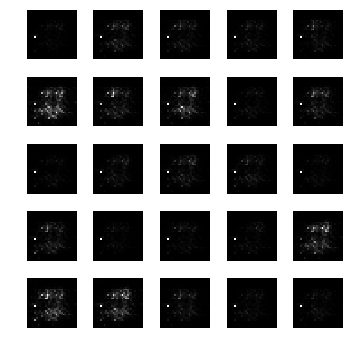

epoch: 971, time: 4.914720 | train_G_Loss: 0.699308, train_D_loss: 1.370446, train_acc: 0.132727
cv_G_Loss: 0.651821, cv_D_loss: 4.328835, cv_acc: 0.127000

epoch: 972, time: 4.871312 | train_G_Loss: 0.693609, train_D_loss: 1.386689, train_acc: 0.114545
cv_G_Loss: 0.825275, cv_D_loss: 4.578400, cv_acc: 0.195700

epoch: 973, time: 4.865190 | train_G_Loss: 0.699336, train_D_loss: 1.375833, train_acc: 0.140000
cv_G_Loss: 0.758828, cv_D_loss: 4.452556, cv_acc: 0.167600

epoch: 974, time: 4.877851 | train_G_Loss: 0.699676, train_D_loss: 1.371575, train_acc: 0.167273
cv_G_Loss: 0.745702, cv_D_loss: 4.422906, cv_acc: 0.167100

epoch: 975, time: 4.878326 | train_G_Loss: 0.696494, train_D_loss: 1.374038, train_acc: 0.258182
cv_G_Loss: 0.588659, cv_D_loss: 4.312380, cv_acc: 0.115900

epoch: 976, time: 4.876486 | train_G_Loss: 0.691981, train_D_loss: 1.387357, train_acc: 0.180000
cv_G_Loss: 0.632216, cv_D_loss: 4.344062, cv_acc: 0.216000

epoch: 977, time: 4.870900 | train_G_Loss: 0.696310, train

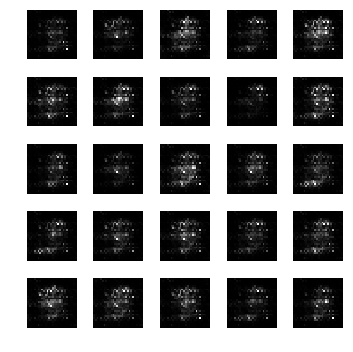

epoch: 981, time: 4.912942 | train_G_Loss: 0.703558, train_D_loss: 1.367265, train_acc: 0.136364
cv_G_Loss: 0.648857, cv_D_loss: 4.341509, cv_acc: 0.096200

epoch: 982, time: 4.898065 | train_G_Loss: 0.698859, train_D_loss: 1.377122, train_acc: 0.150909
cv_G_Loss: 0.535865, cv_D_loss: 4.233182, cv_acc: 0.138000

epoch: 983, time: 4.880396 | train_G_Loss: 0.704346, train_D_loss: 1.366324, train_acc: 0.105455
cv_G_Loss: 0.603411, cv_D_loss: 4.337751, cv_acc: 0.100900

epoch: 984, time: 4.867602 | train_G_Loss: 0.693779, train_D_loss: 1.386451, train_acc: 0.107273
cv_G_Loss: 0.813399, cv_D_loss: 4.513632, cv_acc: 0.110700

epoch: 985, time: 4.874739 | train_G_Loss: 0.692709, train_D_loss: 1.384271, train_acc: 0.098182
cv_G_Loss: 0.658230, cv_D_loss: 4.376822, cv_acc: 0.100900

epoch: 986, time: 4.876379 | train_G_Loss: 0.692704, train_D_loss: 1.390212, train_acc: 0.098182
cv_G_Loss: 0.757666, cv_D_loss: 4.427436, cv_acc: 0.100000

epoch: 987, time: 4.864021 | train_G_Loss: 0.692593, train

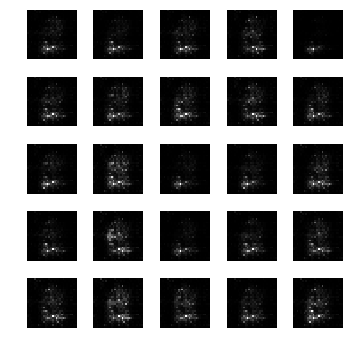

epoch: 991, time: 4.899110 | train_G_Loss: 0.697228, train_D_loss: 1.378174, train_acc: 0.096364
cv_G_Loss: 0.719260, cv_D_loss: 4.400773, cv_acc: 0.101000

epoch: 992, time: 4.881304 | train_G_Loss: 0.693403, train_D_loss: 1.386495, train_acc: 0.096364
cv_G_Loss: 0.770280, cv_D_loss: 4.458093, cv_acc: 0.101000

epoch: 993, time: 4.859984 | train_G_Loss: 0.697566, train_D_loss: 1.378722, train_acc: 0.107273
cv_G_Loss: 0.721655, cv_D_loss: 4.441900, cv_acc: 0.139500

epoch: 994, time: 4.868135 | train_G_Loss: 0.692285, train_D_loss: 1.391995, train_acc: 0.112727
cv_G_Loss: 0.795760, cv_D_loss: 4.555483, cv_acc: 0.113500

epoch: 995, time: 4.878935 | train_G_Loss: 0.693243, train_D_loss: 1.393575, train_acc: 0.187273
cv_G_Loss: 0.924719, cv_D_loss: 4.741742, cv_acc: 0.122900

epoch: 996, time: 4.875801 | train_G_Loss: 0.692629, train_D_loss: 1.391659, train_acc: 0.096364
cv_G_Loss: 0.841012, cv_D_loss: 4.630757, cv_acc: 0.098000

epoch: 997, time: 4.875231 | train_G_Loss: 0.693629, train

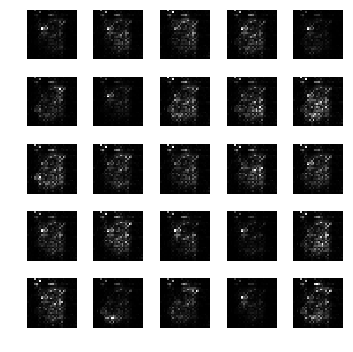

epoch: 1001, time: 4.894071 | train_G_Loss: 0.689550, train_D_loss: 1.393621, train_acc: 0.096364
cv_G_Loss: 0.694658, cv_D_loss: 4.399821, cv_acc: 0.101000

epoch: 1002, time: 4.868934 | train_G_Loss: 0.694186, train_D_loss: 1.384053, train_acc: 0.096364
cv_G_Loss: 0.633172, cv_D_loss: 4.371400, cv_acc: 0.101000

epoch: 1003, time: 4.867988 | train_G_Loss: 0.691945, train_D_loss: 1.387248, train_acc: 0.096364
cv_G_Loss: 0.686883, cv_D_loss: 4.464797, cv_acc: 0.101000

epoch: 1004, time: 4.866925 | train_G_Loss: 0.697839, train_D_loss: 1.378410, train_acc: 0.096364
cv_G_Loss: 0.800299, cv_D_loss: 4.566823, cv_acc: 0.101000

epoch: 1005, time: 4.901413 | train_G_Loss: 0.695900, train_D_loss: 1.382792, train_acc: 0.096364
cv_G_Loss: 0.675773, cv_D_loss: 4.402301, cv_acc: 0.101000

epoch: 1006, time: 4.875542 | train_G_Loss: 0.702674, train_D_loss: 1.374450, train_acc: 0.100000
cv_G_Loss: 0.607917, cv_D_loss: 4.303867, cv_acc: 0.098200

epoch: 1007, time: 4.870589 | train_G_Loss: 0.692215

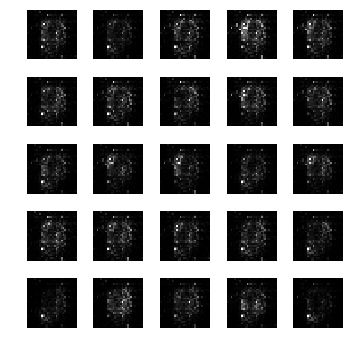

epoch: 1011, time: 4.890061 | train_G_Loss: 0.689644, train_D_loss: 1.394536, train_acc: 0.163636
cv_G_Loss: 0.808814, cv_D_loss: 4.624697, cv_acc: 0.140900

epoch: 1012, time: 4.865294 | train_G_Loss: 0.692610, train_D_loss: 1.404002, train_acc: 0.096364
cv_G_Loss: 0.863971, cv_D_loss: 4.565267, cv_acc: 0.177200

epoch: 1013, time: 4.877856 | train_G_Loss: 0.696755, train_D_loss: 1.377057, train_acc: 0.096364
cv_G_Loss: 0.638399, cv_D_loss: 4.395812, cv_acc: 0.101000

epoch: 1014, time: 4.868850 | train_G_Loss: 0.699947, train_D_loss: 1.376870, train_acc: 0.096364
cv_G_Loss: 0.842704, cv_D_loss: 4.582035, cv_acc: 0.101200

epoch: 1015, time: 4.879676 | train_G_Loss: 0.690591, train_D_loss: 1.387746, train_acc: 0.096364
cv_G_Loss: 0.669324, cv_D_loss: 4.389919, cv_acc: 0.098000

epoch: 1016, time: 4.873843 | train_G_Loss: 0.692216, train_D_loss: 1.381478, train_acc: 0.096364
cv_G_Loss: 0.856965, cv_D_loss: 4.626543, cv_acc: 0.098000

epoch: 1017, time: 4.878925 | train_G_Loss: 0.697527

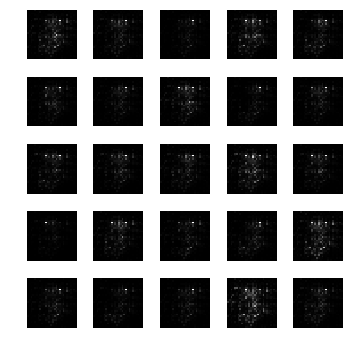

epoch: 1021, time: 4.900716 | train_G_Loss: 0.697372, train_D_loss: 1.384000, train_acc: 0.096364
cv_G_Loss: 0.687013, cv_D_loss: 4.418243, cv_acc: 0.098000

epoch: 1022, time: 4.873703 | train_G_Loss: 0.695165, train_D_loss: 1.379476, train_acc: 0.096364
cv_G_Loss: 0.734162, cv_D_loss: 4.472528, cv_acc: 0.098000

epoch: 1023, time: 4.865287 | train_G_Loss: 0.700458, train_D_loss: 1.374952, train_acc: 0.116364
cv_G_Loss: 0.743976, cv_D_loss: 4.437705, cv_acc: 0.098800

epoch: 1024, time: 4.868593 | train_G_Loss: 0.696333, train_D_loss: 1.373931, train_acc: 0.120000
cv_G_Loss: 0.666414, cv_D_loss: 4.296368, cv_acc: 0.105000

epoch: 1025, time: 4.884058 | train_G_Loss: 0.694459, train_D_loss: 1.384251, train_acc: 0.129091
cv_G_Loss: 0.689238, cv_D_loss: 4.313976, cv_acc: 0.196700

epoch: 1026, time: 4.858757 | train_G_Loss: 0.682662, train_D_loss: 1.400720, train_acc: 0.107273
cv_G_Loss: 0.618040, cv_D_loss: 4.301564, cv_acc: 0.170500

epoch: 1027, time: 4.882022 | train_G_Loss: 0.684672

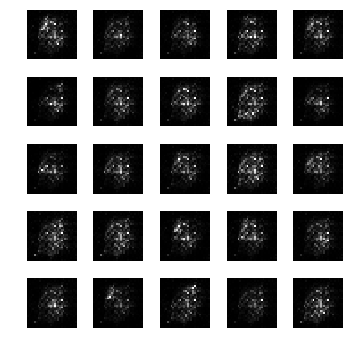

epoch: 1031, time: 4.917279 | train_G_Loss: 0.694191, train_D_loss: 1.380707, train_acc: 0.096364
cv_G_Loss: 0.544267, cv_D_loss: 4.315187, cv_acc: 0.099400

epoch: 1032, time: 4.869539 | train_G_Loss: 0.691233, train_D_loss: 1.382266, train_acc: 0.096364
cv_G_Loss: 0.436260, cv_D_loss: 4.245724, cv_acc: 0.109500

epoch: 1033, time: 4.871491 | train_G_Loss: 0.694704, train_D_loss: 1.383246, train_acc: 0.158182
cv_G_Loss: 0.852877, cv_D_loss: 4.625173, cv_acc: 0.174800

epoch: 1034, time: 4.871031 | train_G_Loss: 0.697474, train_D_loss: 1.376189, train_acc: 0.107273
cv_G_Loss: 1.015500, cv_D_loss: 4.790932, cv_acc: 0.113500

epoch: 1035, time: 4.877406 | train_G_Loss: 0.692474, train_D_loss: 1.386599, train_acc: 0.107273
cv_G_Loss: 0.756420, cv_D_loss: 4.461036, cv_acc: 0.113500

epoch: 1036, time: 4.880556 | train_G_Loss: 0.692291, train_D_loss: 1.391719, train_acc: 0.118182
cv_G_Loss: 0.871416, cv_D_loss: 4.549781, cv_acc: 0.113500

epoch: 1037, time: 4.877654 | train_G_Loss: 0.690523

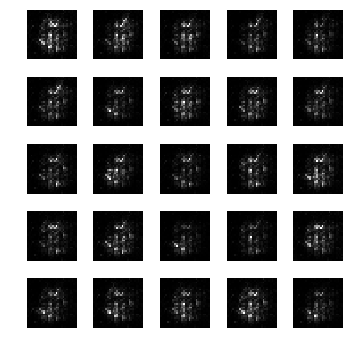

epoch: 1041, time: 4.894547 | train_G_Loss: 0.692964, train_D_loss: 1.379925, train_acc: 0.087273
cv_G_Loss: 0.606807, cv_D_loss: 4.374911, cv_acc: 0.089200

epoch: 1042, time: 4.883893 | train_G_Loss: 0.692697, train_D_loss: 1.386674, train_acc: 0.087273
cv_G_Loss: 0.752147, cv_D_loss: 4.481096, cv_acc: 0.089200

epoch: 1043, time: 4.883456 | train_G_Loss: 0.698505, train_D_loss: 1.373455, train_acc: 0.096364
cv_G_Loss: 0.795862, cv_D_loss: 4.462433, cv_acc: 0.098000

epoch: 1044, time: 4.881872 | train_G_Loss: 0.691685, train_D_loss: 1.388198, train_acc: 0.096364
cv_G_Loss: 0.754588, cv_D_loss: 4.468681, cv_acc: 0.098000

epoch: 1045, time: 4.869150 | train_G_Loss: 0.690135, train_D_loss: 1.394239, train_acc: 0.110909
cv_G_Loss: 0.724543, cv_D_loss: 4.451230, cv_acc: 0.104000

epoch: 1046, time: 4.873435 | train_G_Loss: 0.682878, train_D_loss: 1.400452, train_acc: 0.096364
cv_G_Loss: 0.704516, cv_D_loss: 4.391637, cv_acc: 0.098000

epoch: 1047, time: 4.860459 | train_G_Loss: 0.688588

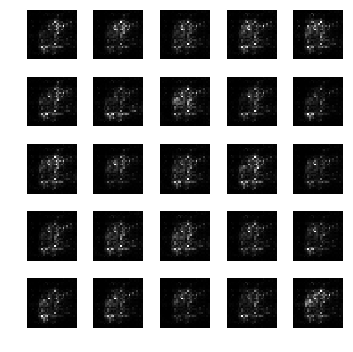

epoch: 1051, time: 4.942097 | train_G_Loss: 0.698776, train_D_loss: 1.377719, train_acc: 0.100000
cv_G_Loss: 0.707680, cv_D_loss: 4.387661, cv_acc: 0.098200

epoch: 1052, time: 4.879614 | train_G_Loss: 0.691337, train_D_loss: 1.388701, train_acc: 0.114545
cv_G_Loss: 0.682194, cv_D_loss: 4.422027, cv_acc: 0.116400

epoch: 1053, time: 4.869277 | train_G_Loss: 0.692312, train_D_loss: 1.385501, train_acc: 0.120000
cv_G_Loss: 0.617442, cv_D_loss: 4.317310, cv_acc: 0.136900

epoch: 1054, time: 4.894521 | train_G_Loss: 0.690347, train_D_loss: 1.390689, train_acc: 0.132727
cv_G_Loss: 0.741316, cv_D_loss: 4.401351, cv_acc: 0.198500

epoch: 1055, time: 4.880308 | train_G_Loss: 0.689367, train_D_loss: 1.393108, train_acc: 0.107273
cv_G_Loss: 0.803915, cv_D_loss: 4.525717, cv_acc: 0.113500

epoch: 1056, time: 4.884048 | train_G_Loss: 0.690691, train_D_loss: 1.389449, train_acc: 0.200000
cv_G_Loss: 0.667126, cv_D_loss: 4.381274, cv_acc: 0.201100

epoch: 1057, time: 4.879199 | train_G_Loss: 0.694831

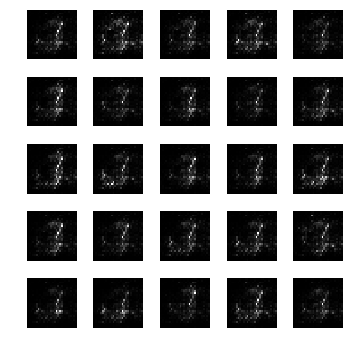

epoch: 1061, time: 4.915583 | train_G_Loss: 0.693967, train_D_loss: 1.386579, train_acc: 0.107273
cv_G_Loss: 0.672912, cv_D_loss: 4.373700, cv_acc: 0.113500

epoch: 1062, time: 4.868568 | train_G_Loss: 0.696140, train_D_loss: 1.386211, train_acc: 0.109091
cv_G_Loss: 0.641744, cv_D_loss: 4.340232, cv_acc: 0.102800

epoch: 1063, time: 4.872913 | train_G_Loss: 0.689708, train_D_loss: 1.387593, train_acc: 0.109091
cv_G_Loss: 0.679058, cv_D_loss: 4.346960, cv_acc: 0.102800

epoch: 1064, time: 4.857786 | train_G_Loss: 0.690217, train_D_loss: 1.385875, train_acc: 0.109091
cv_G_Loss: 0.709115, cv_D_loss: 4.463941, cv_acc: 0.102800

epoch: 1065, time: 4.874898 | train_G_Loss: 0.695559, train_D_loss: 1.382596, train_acc: 0.109091
cv_G_Loss: 0.665848, cv_D_loss: 4.450978, cv_acc: 0.115100

epoch: 1066, time: 4.877928 | train_G_Loss: 0.693598, train_D_loss: 1.380953, train_acc: 0.109091
cv_G_Loss: 0.646323, cv_D_loss: 4.412822, cv_acc: 0.103500

epoch: 1067, time: 4.875426 | train_G_Loss: 0.697795

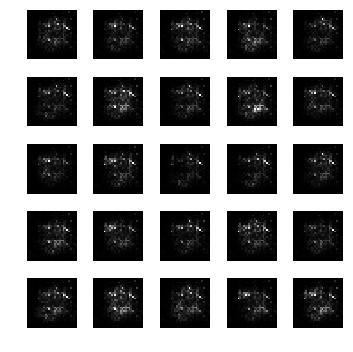

epoch: 1071, time: 4.898046 | train_G_Loss: 0.691717, train_D_loss: 1.389199, train_acc: 0.089091
cv_G_Loss: 0.810698, cv_D_loss: 4.504313, cv_acc: 0.097400

epoch: 1072, time: 4.865152 | train_G_Loss: 0.695999, train_D_loss: 1.375861, train_acc: 0.092727
cv_G_Loss: 0.735764, cv_D_loss: 4.384327, cv_acc: 0.133000

epoch: 1073, time: 4.883592 | train_G_Loss: 0.694992, train_D_loss: 1.382274, train_acc: 0.110909
cv_G_Loss: 0.676408, cv_D_loss: 4.354564, cv_acc: 0.102900

epoch: 1074, time: 4.899181 | train_G_Loss: 0.692034, train_D_loss: 1.387153, train_acc: 0.183636
cv_G_Loss: 0.677361, cv_D_loss: 4.375576, cv_acc: 0.168800

epoch: 1075, time: 4.894328 | train_G_Loss: 0.693906, train_D_loss: 1.379203, train_acc: 0.096364
cv_G_Loss: 0.682709, cv_D_loss: 4.360887, cv_acc: 0.101300

epoch: 1076, time: 4.872812 | train_G_Loss: 0.693971, train_D_loss: 1.383827, train_acc: 0.096364
cv_G_Loss: 0.802388, cv_D_loss: 4.517395, cv_acc: 0.101000

epoch: 1077, time: 4.867597 | train_G_Loss: 0.694417

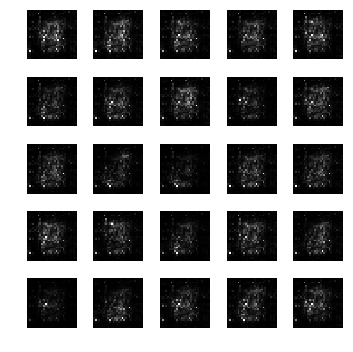

epoch: 1081, time: 4.896590 | train_G_Loss: 0.701085, train_D_loss: 1.369715, train_acc: 0.109091
cv_G_Loss: 0.873898, cv_D_loss: 4.629966, cv_acc: 0.102800

epoch: 1082, time: 4.879365 | train_G_Loss: 0.697181, train_D_loss: 1.375010, train_acc: 0.109091
cv_G_Loss: 0.794528, cv_D_loss: 4.496716, cv_acc: 0.108500

epoch: 1083, time: 4.869229 | train_G_Loss: 0.688757, train_D_loss: 1.381977, train_acc: 0.101818
cv_G_Loss: 0.764871, cv_D_loss: 4.449679, cv_acc: 0.142200

epoch: 1084, time: 4.872736 | train_G_Loss: 0.686510, train_D_loss: 1.394017, train_acc: 0.098182
cv_G_Loss: 0.795258, cv_D_loss: 4.444068, cv_acc: 0.100900

epoch: 1085, time: 4.869892 | train_G_Loss: 0.692878, train_D_loss: 1.390880, train_acc: 0.098182
cv_G_Loss: 0.633770, cv_D_loss: 4.301672, cv_acc: 0.100900

epoch: 1086, time: 4.867600 | train_G_Loss: 0.694192, train_D_loss: 1.387613, train_acc: 0.110909
cv_G_Loss: 0.699225, cv_D_loss: 4.375340, cv_acc: 0.095900

epoch: 1087, time: 4.875731 | train_G_Loss: 0.694942

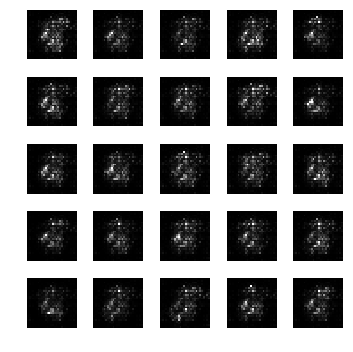

epoch: 1091, time: 4.903157 | train_G_Loss: 0.696753, train_D_loss: 1.390651, train_acc: 0.100000
cv_G_Loss: 0.829047, cv_D_loss: 4.510013, cv_acc: 0.098200

epoch: 1092, time: 4.905760 | train_G_Loss: 0.694204, train_D_loss: 1.387376, train_acc: 0.120000
cv_G_Loss: 0.642879, cv_D_loss: 4.328939, cv_acc: 0.117100

epoch: 1093, time: 4.869886 | train_G_Loss: 0.696181, train_D_loss: 1.383786, train_acc: 0.109091
cv_G_Loss: 0.723775, cv_D_loss: 4.400003, cv_acc: 0.102800

epoch: 1094, time: 4.873995 | train_G_Loss: 0.696742, train_D_loss: 1.380810, train_acc: 0.109091
cv_G_Loss: 0.778031, cv_D_loss: 4.491027, cv_acc: 0.102800

epoch: 1095, time: 4.874524 | train_G_Loss: 0.697209, train_D_loss: 1.381546, train_acc: 0.109091
cv_G_Loss: 0.698700, cv_D_loss: 4.404534, cv_acc: 0.102800

epoch: 1096, time: 4.873556 | train_G_Loss: 0.693292, train_D_loss: 1.384794, train_acc: 0.096364
cv_G_Loss: 0.730592, cv_D_loss: 4.440958, cv_acc: 0.098000

epoch: 1097, time: 4.897634 | train_G_Loss: 0.692944

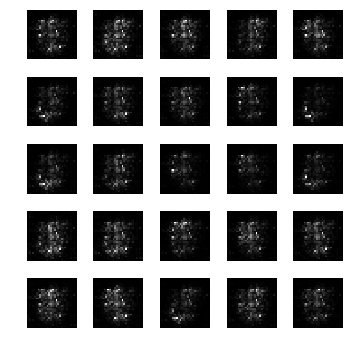

epoch: 1101, time: 4.913526 | train_G_Loss: 0.710820, train_D_loss: 1.349982, train_acc: 0.096364
cv_G_Loss: 0.782672, cv_D_loss: 4.468359, cv_acc: 0.121100

epoch: 1102, time: 4.874523 | train_G_Loss: 0.700069, train_D_loss: 1.378154, train_acc: 0.098182
cv_G_Loss: 0.733641, cv_D_loss: 4.429784, cv_acc: 0.099500

epoch: 1103, time: 4.881797 | train_G_Loss: 0.697412, train_D_loss: 1.380070, train_acc: 0.100000
cv_G_Loss: 0.790211, cv_D_loss: 4.545938, cv_acc: 0.102000

epoch: 1104, time: 4.863822 | train_G_Loss: 0.697132, train_D_loss: 1.379183, train_acc: 0.105455
cv_G_Loss: 0.656754, cv_D_loss: 4.400835, cv_acc: 0.103200

epoch: 1105, time: 4.870627 | train_G_Loss: 0.694969, train_D_loss: 1.379039, train_acc: 0.105455
cv_G_Loss: 0.722077, cv_D_loss: 4.453537, cv_acc: 0.103200

epoch: 1106, time: 4.877965 | train_G_Loss: 0.697985, train_D_loss: 1.373223, train_acc: 0.105455
cv_G_Loss: 0.597035, cv_D_loss: 4.295602, cv_acc: 0.103200

epoch: 1107, time: 4.881701 | train_G_Loss: 0.705219

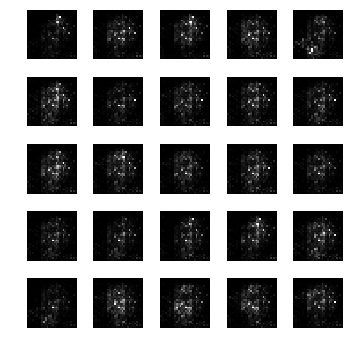

epoch: 1111, time: 4.901337 | train_G_Loss: 0.692912, train_D_loss: 1.387508, train_acc: 0.107273
cv_G_Loss: 0.757501, cv_D_loss: 4.503484, cv_acc: 0.113500

epoch: 1112, time: 4.875571 | train_G_Loss: 0.691742, train_D_loss: 1.390443, train_acc: 0.107273
cv_G_Loss: 0.799317, cv_D_loss: 4.449604, cv_acc: 0.113500

epoch: 1113, time: 4.877682 | train_G_Loss: 0.688855, train_D_loss: 1.391112, train_acc: 0.089091
cv_G_Loss: 0.822871, cv_D_loss: 4.534048, cv_acc: 0.097400

epoch: 1114, time: 4.883981 | train_G_Loss: 0.692862, train_D_loss: 1.389961, train_acc: 0.114545
cv_G_Loss: 0.693438, cv_D_loss: 4.390998, cv_acc: 0.099000

epoch: 1115, time: 4.873697 | train_G_Loss: 0.693606, train_D_loss: 1.388956, train_acc: 0.089091
cv_G_Loss: 0.787901, cv_D_loss: 4.513963, cv_acc: 0.097400

epoch: 1116, time: 4.883301 | train_G_Loss: 0.691182, train_D_loss: 1.390815, train_acc: 0.089091
cv_G_Loss: 0.982024, cv_D_loss: 4.763266, cv_acc: 0.097400

epoch: 1117, time: 4.883375 | train_G_Loss: 0.689173

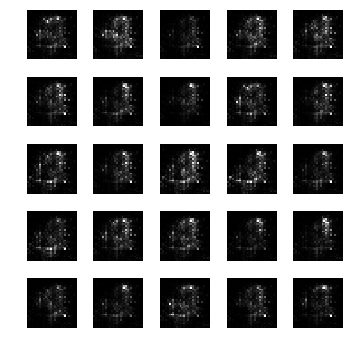

epoch: 1121, time: 4.922260 | train_G_Loss: 0.694363, train_D_loss: 1.382996, train_acc: 0.125455
cv_G_Loss: 0.737761, cv_D_loss: 4.400086, cv_acc: 0.102800

epoch: 1122, time: 4.872204 | train_G_Loss: 0.698581, train_D_loss: 1.382647, train_acc: 0.165455
cv_G_Loss: 0.703089, cv_D_loss: 4.402450, cv_acc: 0.193600

epoch: 1123, time: 4.866723 | train_G_Loss: 0.691889, train_D_loss: 1.390030, train_acc: 0.187273
cv_G_Loss: 0.670025, cv_D_loss: 4.382463, cv_acc: 0.211800

epoch: 1124, time: 4.887321 | train_G_Loss: 0.686029, train_D_loss: 1.396479, train_acc: 0.194545
cv_G_Loss: 1.021338, cv_D_loss: 4.801280, cv_acc: 0.194100

epoch: 1125, time: 4.870384 | train_G_Loss: 0.691982, train_D_loss: 1.390861, train_acc: 0.109091
cv_G_Loss: 0.629535, cv_D_loss: 4.360748, cv_acc: 0.102800

epoch: 1126, time: 4.867569 | train_G_Loss: 0.694833, train_D_loss: 1.380966, train_acc: 0.109091
cv_G_Loss: 0.649528, cv_D_loss: 4.369602, cv_acc: 0.102800

epoch: 1127, time: 4.860208 | train_G_Loss: 0.696436

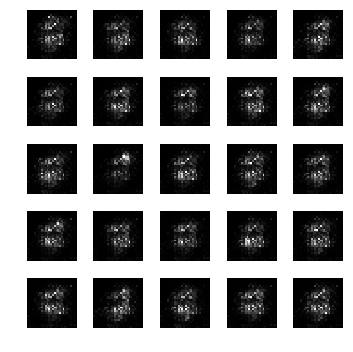

epoch: 1131, time: 4.911320 | train_G_Loss: 0.697411, train_D_loss: 1.374833, train_acc: 0.198182
cv_G_Loss: 1.076321, cv_D_loss: 4.812062, cv_acc: 0.161800

epoch: 1132, time: 4.873180 | train_G_Loss: 0.694675, train_D_loss: 1.379579, train_acc: 0.201818
cv_G_Loss: 0.619432, cv_D_loss: 4.340050, cv_acc: 0.140800

epoch: 1133, time: 4.883155 | train_G_Loss: 0.692174, train_D_loss: 1.375494, train_acc: 0.143636
cv_G_Loss: 0.711207, cv_D_loss: 4.418213, cv_acc: 0.113700

epoch: 1134, time: 4.882645 | train_G_Loss: 0.694499, train_D_loss: 1.385502, train_acc: 0.116364
cv_G_Loss: 0.627426, cv_D_loss: 4.291579, cv_acc: 0.124600

epoch: 1135, time: 4.884009 | train_G_Loss: 0.692380, train_D_loss: 1.390011, train_acc: 0.107273
cv_G_Loss: 0.726971, cv_D_loss: 4.435761, cv_acc: 0.113500

epoch: 1136, time: 4.875306 | train_G_Loss: 0.692850, train_D_loss: 1.386240, train_acc: 0.198182
cv_G_Loss: 0.803305, cv_D_loss: 4.573479, cv_acc: 0.136100

epoch: 1137, time: 4.875086 | train_G_Loss: 0.692021

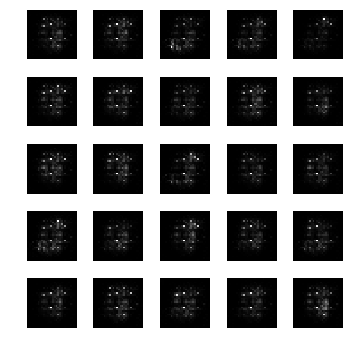

epoch: 1141, time: 4.886737 | train_G_Loss: 0.691578, train_D_loss: 1.387550, train_acc: 0.096364
cv_G_Loss: 0.691253, cv_D_loss: 4.372105, cv_acc: 0.101000

epoch: 1142, time: 4.888820 | train_G_Loss: 0.694110, train_D_loss: 1.383973, train_acc: 0.105455
cv_G_Loss: 0.593564, cv_D_loss: 4.295204, cv_acc: 0.103200

epoch: 1143, time: 4.898279 | train_G_Loss: 0.693469, train_D_loss: 1.385914, train_acc: 0.105455
cv_G_Loss: 0.686484, cv_D_loss: 4.392691, cv_acc: 0.103200

epoch: 1144, time: 4.900526 | train_G_Loss: 0.687334, train_D_loss: 1.393366, train_acc: 0.089091
cv_G_Loss: 0.684913, cv_D_loss: 4.427420, cv_acc: 0.093800

epoch: 1145, time: 4.873412 | train_G_Loss: 0.691794, train_D_loss: 1.390020, train_acc: 0.087273
cv_G_Loss: 0.912277, cv_D_loss: 4.632621, cv_acc: 0.088800

epoch: 1146, time: 4.878865 | train_G_Loss: 0.692738, train_D_loss: 1.387262, train_acc: 0.087273
cv_G_Loss: 0.855493, cv_D_loss: 4.598290, cv_acc: 0.113900

epoch: 1147, time: 4.867307 | train_G_Loss: 0.694790

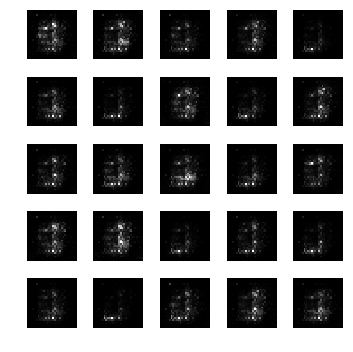

epoch: 1151, time: 4.903891 | train_G_Loss: 0.689905, train_D_loss: 1.390460, train_acc: 0.089091
cv_G_Loss: 0.664277, cv_D_loss: 4.409574, cv_acc: 0.097400

epoch: 1152, time: 4.878281 | train_G_Loss: 0.699696, train_D_loss: 1.366255, train_acc: 0.089091
cv_G_Loss: 0.801295, cv_D_loss: 4.510251, cv_acc: 0.097400

epoch: 1153, time: 4.877536 | train_G_Loss: 0.691160, train_D_loss: 1.397750, train_acc: 0.089091
cv_G_Loss: 0.841974, cv_D_loss: 4.599087, cv_acc: 0.102800

epoch: 1154, time: 4.874002 | train_G_Loss: 0.699930, train_D_loss: 1.381755, train_acc: 0.110909
cv_G_Loss: 0.566613, cv_D_loss: 4.274261, cv_acc: 0.103100

epoch: 1155, time: 4.877446 | train_G_Loss: 0.695309, train_D_loss: 1.386074, train_acc: 0.109091
cv_G_Loss: 0.764295, cv_D_loss: 4.463865, cv_acc: 0.102800

epoch: 1156, time: 4.867893 | train_G_Loss: 0.700667, train_D_loss: 1.374793, train_acc: 0.120000
cv_G_Loss: 0.890302, cv_D_loss: 4.512555, cv_acc: 0.113500

epoch: 1157, time: 4.866112 | train_G_Loss: 0.697078

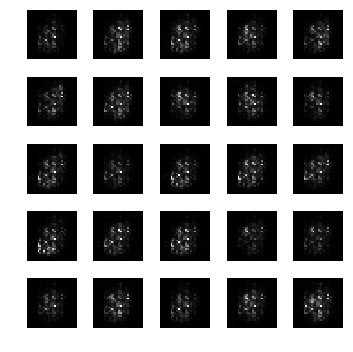

epoch: 1161, time: 4.884155 | train_G_Loss: 0.695801, train_D_loss: 1.377589, train_acc: 0.112727
cv_G_Loss: 0.701252, cv_D_loss: 4.364011, cv_acc: 0.161900

epoch: 1162, time: 4.871904 | train_G_Loss: 0.692860, train_D_loss: 1.384715, train_acc: 0.147273
cv_G_Loss: 0.636859, cv_D_loss: 4.311765, cv_acc: 0.117500

epoch: 1163, time: 4.870450 | train_G_Loss: 0.692141, train_D_loss: 1.387775, train_acc: 0.189091
cv_G_Loss: 0.722373, cv_D_loss: 4.423948, cv_acc: 0.155400

epoch: 1164, time: 4.872826 | train_G_Loss: 0.692819, train_D_loss: 1.386020, train_acc: 0.087273
cv_G_Loss: 0.797134, cv_D_loss: 4.517648, cv_acc: 0.101900

epoch: 1165, time: 4.891662 | train_G_Loss: 0.690203, train_D_loss: 1.383132, train_acc: 0.100000
cv_G_Loss: 0.837781, cv_D_loss: 4.520082, cv_acc: 0.118100

epoch: 1166, time: 4.905163 | train_G_Loss: 0.690245, train_D_loss: 1.390682, train_acc: 0.214545
cv_G_Loss: 0.634088, cv_D_loss: 4.323400, cv_acc: 0.105000

epoch: 1167, time: 4.891186 | train_G_Loss: 0.690097

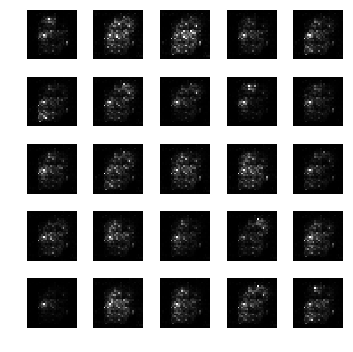

epoch: 1171, time: 4.905882 | train_G_Loss: 0.689810, train_D_loss: 1.392078, train_acc: 0.105455
cv_G_Loss: 0.733245, cv_D_loss: 4.457357, cv_acc: 0.103200

epoch: 1172, time: 4.877022 | train_G_Loss: 0.689299, train_D_loss: 1.393541, train_acc: 0.107273
cv_G_Loss: 0.793658, cv_D_loss: 4.525036, cv_acc: 0.113500

epoch: 1173, time: 4.858818 | train_G_Loss: 0.687767, train_D_loss: 1.395089, train_acc: 0.107273
cv_G_Loss: 0.789316, cv_D_loss: 4.497951, cv_acc: 0.113500

epoch: 1174, time: 4.864769 | train_G_Loss: 0.690904, train_D_loss: 1.388552, train_acc: 0.087273
cv_G_Loss: 0.760778, cv_D_loss: 4.436596, cv_acc: 0.088900

epoch: 1175, time: 4.875762 | train_G_Loss: 0.688703, train_D_loss: 1.396928, train_acc: 0.087273
cv_G_Loss: 0.870772, cv_D_loss: 4.530228, cv_acc: 0.114400

epoch: 1176, time: 4.865055 | train_G_Loss: 0.698645, train_D_loss: 1.378927, train_acc: 0.098182
cv_G_Loss: 0.890780, cv_D_loss: 4.645426, cv_acc: 0.100900

epoch: 1177, time: 4.875616 | train_G_Loss: 0.696802

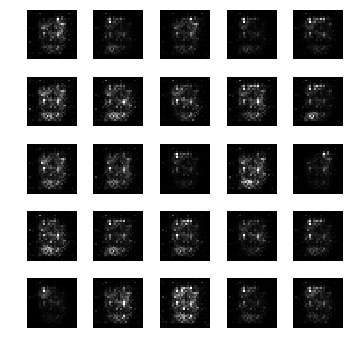

epoch: 1181, time: 4.913949 | train_G_Loss: 0.692783, train_D_loss: 1.385816, train_acc: 0.120000
cv_G_Loss: 0.730479, cv_D_loss: 4.444891, cv_acc: 0.160700

epoch: 1182, time: 4.873583 | train_G_Loss: 0.693376, train_D_loss: 1.385996, train_acc: 0.216364
cv_G_Loss: 0.742746, cv_D_loss: 4.452528, cv_acc: 0.164400

epoch: 1183, time: 4.870883 | train_G_Loss: 0.694308, train_D_loss: 1.382843, train_acc: 0.207273
cv_G_Loss: 0.745662, cv_D_loss: 4.439694, cv_acc: 0.152000

epoch: 1184, time: 4.869102 | train_G_Loss: 0.695997, train_D_loss: 1.381942, train_acc: 0.232727
cv_G_Loss: 0.774537, cv_D_loss: 4.476713, cv_acc: 0.207600

epoch: 1185, time: 4.883936 | train_G_Loss: 0.700458, train_D_loss: 1.383897, train_acc: 0.107273
cv_G_Loss: 0.684554, cv_D_loss: 4.405020, cv_acc: 0.113600

epoch: 1186, time: 4.876217 | train_G_Loss: 0.686995, train_D_loss: 1.392181, train_acc: 0.107273
cv_G_Loss: 0.686823, cv_D_loss: 4.406789, cv_acc: 0.113500

epoch: 1187, time: 4.868079 | train_G_Loss: 0.692532

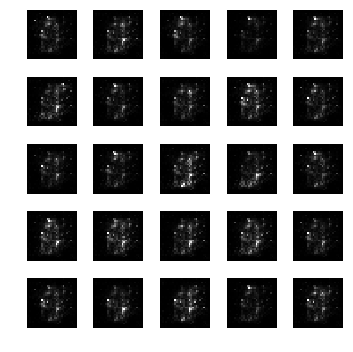

epoch: 1191, time: 4.900164 | train_G_Loss: 0.699562, train_D_loss: 1.378947, train_acc: 0.100000
cv_G_Loss: 0.812306, cv_D_loss: 4.531692, cv_acc: 0.098200

epoch: 1192, time: 4.877419 | train_G_Loss: 0.691503, train_D_loss: 1.392781, train_acc: 0.100000
cv_G_Loss: 0.804423, cv_D_loss: 4.528261, cv_acc: 0.098200

epoch: 1193, time: 4.877313 | train_G_Loss: 0.693658, train_D_loss: 1.386161, train_acc: 0.167273
cv_G_Loss: 0.779366, cv_D_loss: 4.510842, cv_acc: 0.140100

epoch: 1194, time: 4.881979 | train_G_Loss: 0.691869, train_D_loss: 1.388121, train_acc: 0.138182
cv_G_Loss: 0.742338, cv_D_loss: 4.478508, cv_acc: 0.158300

epoch: 1195, time: 4.874333 | train_G_Loss: 0.701344, train_D_loss: 1.373661, train_acc: 0.096364
cv_G_Loss: 0.611401, cv_D_loss: 4.295280, cv_acc: 0.101000

epoch: 1196, time: 4.869544 | train_G_Loss: 0.688881, train_D_loss: 1.391796, train_acc: 0.096364
cv_G_Loss: 0.671944, cv_D_loss: 4.392323, cv_acc: 0.101000

epoch: 1197, time: 4.875216 | train_G_Loss: 0.691125

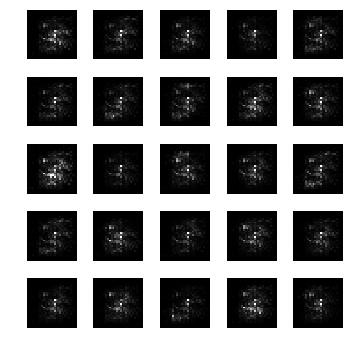

epoch: 1201, time: 4.894969 | train_G_Loss: 0.688560, train_D_loss: 1.384696, train_acc: 0.096364
cv_G_Loss: 0.843213, cv_D_loss: 4.501125, cv_acc: 0.101000

epoch: 1202, time: 4.869388 | train_G_Loss: 0.692096, train_D_loss: 1.387666, train_acc: 0.096364
cv_G_Loss: 0.708333, cv_D_loss: 4.421757, cv_acc: 0.101000

epoch: 1203, time: 4.872265 | train_G_Loss: 0.692216, train_D_loss: 1.391172, train_acc: 0.096364
cv_G_Loss: 0.708678, cv_D_loss: 4.414348, cv_acc: 0.101000

epoch: 1204, time: 4.879052 | train_G_Loss: 0.690633, train_D_loss: 1.389769, train_acc: 0.096364
cv_G_Loss: 0.834387, cv_D_loss: 4.526687, cv_acc: 0.160400

epoch: 1205, time: 4.869576 | train_G_Loss: 0.688865, train_D_loss: 1.395843, train_acc: 0.118182
cv_G_Loss: 0.744522, cv_D_loss: 4.454747, cv_acc: 0.111500

epoch: 1206, time: 4.880830 | train_G_Loss: 0.699853, train_D_loss: 1.381487, train_acc: 0.109091
cv_G_Loss: 0.724027, cv_D_loss: 4.387072, cv_acc: 0.102800

epoch: 1207, time: 4.877716 | train_G_Loss: 0.697182

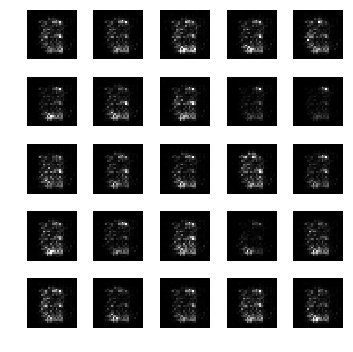

epoch: 1211, time: 4.894760 | train_G_Loss: 0.695896, train_D_loss: 1.381393, train_acc: 0.098182
cv_G_Loss: 0.696233, cv_D_loss: 4.465500, cv_acc: 0.100900

epoch: 1212, time: 4.898291 | train_G_Loss: 0.694776, train_D_loss: 1.384545, train_acc: 0.098182
cv_G_Loss: 0.665623, cv_D_loss: 4.403138, cv_acc: 0.100900

epoch: 1213, time: 4.896960 | train_G_Loss: 0.699361, train_D_loss: 1.376852, train_acc: 0.109091
cv_G_Loss: 0.720348, cv_D_loss: 4.411714, cv_acc: 0.112000

epoch: 1214, time: 4.879196 | train_G_Loss: 0.691645, train_D_loss: 1.384995, train_acc: 0.114545
cv_G_Loss: 0.737819, cv_D_loss: 4.403962, cv_acc: 0.115200

epoch: 1215, time: 4.869705 | train_G_Loss: 0.704849, train_D_loss: 1.374604, train_acc: 0.087273
cv_G_Loss: 0.654820, cv_D_loss: 4.303585, cv_acc: 0.100700

epoch: 1216, time: 4.874318 | train_G_Loss: 0.693891, train_D_loss: 1.385739, train_acc: 0.100000
cv_G_Loss: 0.674241, cv_D_loss: 4.363180, cv_acc: 0.096300

epoch: 1217, time: 4.869223 | train_G_Loss: 0.694287

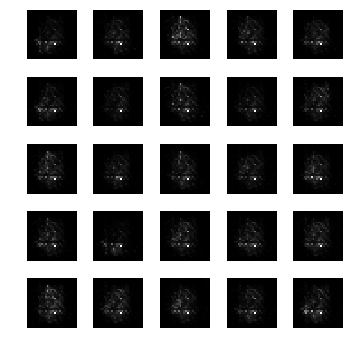

epoch: 1221, time: 4.910398 | train_G_Loss: 0.693702, train_D_loss: 1.385678, train_acc: 0.089091
cv_G_Loss: 0.699212, cv_D_loss: 4.420909, cv_acc: 0.097400

epoch: 1222, time: 4.871589 | train_G_Loss: 0.692545, train_D_loss: 1.384778, train_acc: 0.089091
cv_G_Loss: 0.749995, cv_D_loss: 4.477026, cv_acc: 0.097400

epoch: 1223, time: 4.880469 | train_G_Loss: 0.682672, train_D_loss: 1.403083, train_acc: 0.089091
cv_G_Loss: 0.645663, cv_D_loss: 4.369199, cv_acc: 0.097400

epoch: 1224, time: 4.869838 | train_G_Loss: 0.693786, train_D_loss: 1.384602, train_acc: 0.103636
cv_G_Loss: 0.746390, cv_D_loss: 4.473217, cv_acc: 0.096000

epoch: 1225, time: 4.884035 | train_G_Loss: 0.692408, train_D_loss: 1.385595, train_acc: 0.100000
cv_G_Loss: 0.705504, cv_D_loss: 4.414534, cv_acc: 0.098200

epoch: 1226, time: 4.881523 | train_G_Loss: 0.696421, train_D_loss: 1.383541, train_acc: 0.116364
cv_G_Loss: 0.712069, cv_D_loss: 4.410378, cv_acc: 0.115900

epoch: 1227, time: 4.894447 | train_G_Loss: 0.692738

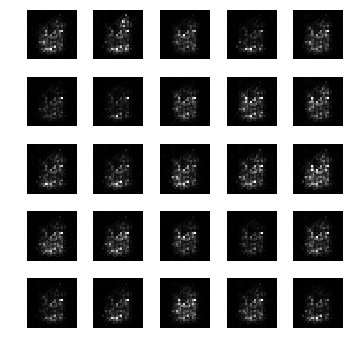

epoch: 1231, time: 4.915894 | train_G_Loss: 0.697498, train_D_loss: 1.376776, train_acc: 0.098182
cv_G_Loss: 0.859815, cv_D_loss: 4.555776, cv_acc: 0.100900

epoch: 1232, time: 4.884286 | train_G_Loss: 0.694884, train_D_loss: 1.384775, train_acc: 0.096364
cv_G_Loss: 0.841691, cv_D_loss: 4.587966, cv_acc: 0.101000

epoch: 1233, time: 4.873778 | train_G_Loss: 0.694083, train_D_loss: 1.386065, train_acc: 0.201818
cv_G_Loss: 0.929616, cv_D_loss: 4.690020, cv_acc: 0.101200

epoch: 1234, time: 4.867474 | train_G_Loss: 0.693154, train_D_loss: 1.385193, train_acc: 0.089091
cv_G_Loss: 0.671587, cv_D_loss: 4.475474, cv_acc: 0.098000

epoch: 1235, time: 4.901651 | train_G_Loss: 0.699688, train_D_loss: 1.372527, train_acc: 0.118182
cv_G_Loss: 0.789951, cv_D_loss: 4.489563, cv_acc: 0.115400

epoch: 1236, time: 4.909853 | train_G_Loss: 0.699016, train_D_loss: 1.371909, train_acc: 0.109091
cv_G_Loss: 0.687597, cv_D_loss: 4.370925, cv_acc: 0.102800

epoch: 1237, time: 4.871306 | train_G_Loss: 0.698460

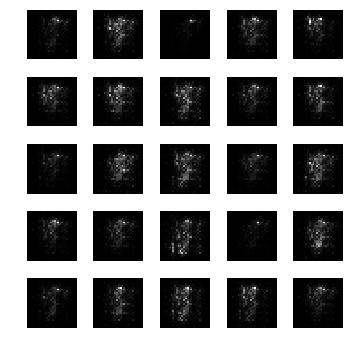

epoch: 1241, time: 4.905130 | train_G_Loss: 0.694111, train_D_loss: 1.380649, train_acc: 0.101818
cv_G_Loss: 0.826240, cv_D_loss: 4.525091, cv_acc: 0.100900

epoch: 1242, time: 4.874142 | train_G_Loss: 0.695803, train_D_loss: 1.383003, train_acc: 0.096364
cv_G_Loss: 0.686145, cv_D_loss: 4.375548, cv_acc: 0.114200

epoch: 1243, time: 4.879377 | train_G_Loss: 0.695366, train_D_loss: 1.382066, train_acc: 0.190909
cv_G_Loss: 0.680587, cv_D_loss: 4.393112, cv_acc: 0.140900

epoch: 1244, time: 4.886482 | train_G_Loss: 0.694750, train_D_loss: 1.387218, train_acc: 0.110909
cv_G_Loss: 0.779561, cv_D_loss: 4.492166, cv_acc: 0.095800

epoch: 1245, time: 4.871583 | train_G_Loss: 0.693545, train_D_loss: 1.388000, train_acc: 0.110909
cv_G_Loss: 0.719357, cv_D_loss: 4.393118, cv_acc: 0.106600

epoch: 1246, time: 4.888273 | train_G_Loss: 0.693465, train_D_loss: 1.385508, train_acc: 0.098182
cv_G_Loss: 0.698209, cv_D_loss: 4.377803, cv_acc: 0.100900

epoch: 1247, time: 4.872465 | train_G_Loss: 0.692570

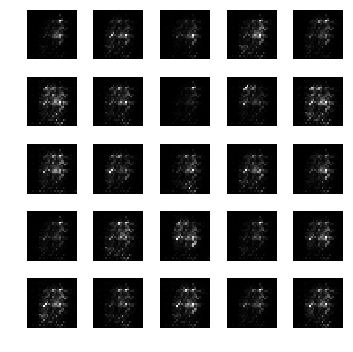

epoch: 1251, time: 4.913723 | train_G_Loss: 0.694924, train_D_loss: 1.384529, train_acc: 0.116364
cv_G_Loss: 0.654325, cv_D_loss: 4.348434, cv_acc: 0.113500

epoch: 1252, time: 4.883437 | train_G_Loss: 0.691276, train_D_loss: 1.388835, train_acc: 0.196364
cv_G_Loss: 0.695874, cv_D_loss: 4.395250, cv_acc: 0.209600

epoch: 1253, time: 4.877072 | train_G_Loss: 0.693489, train_D_loss: 1.386499, train_acc: 0.096364
cv_G_Loss: 0.696760, cv_D_loss: 4.416155, cv_acc: 0.101000

epoch: 1254, time: 4.881836 | train_G_Loss: 0.696443, train_D_loss: 1.380450, train_acc: 0.096364
cv_G_Loss: 0.729962, cv_D_loss: 4.446200, cv_acc: 0.101000

epoch: 1255, time: 4.865875 | train_G_Loss: 0.699230, train_D_loss: 1.374787, train_acc: 0.165455
cv_G_Loss: 0.831440, cv_D_loss: 4.556486, cv_acc: 0.118600

epoch: 1256, time: 4.883417 | train_G_Loss: 0.705019, train_D_loss: 1.372583, train_acc: 0.210909
cv_G_Loss: 0.920286, cv_D_loss: 4.605662, cv_acc: 0.163100

epoch: 1257, time: 4.873068 | train_G_Loss: 0.693667

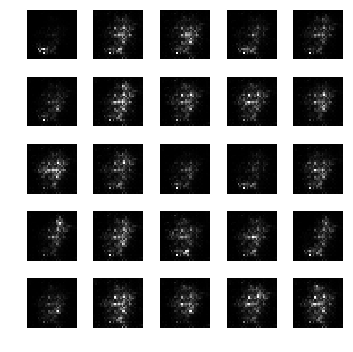

epoch: 1261, time: 4.898742 | train_G_Loss: 0.696928, train_D_loss: 1.379548, train_acc: 0.101818
cv_G_Loss: 0.670758, cv_D_loss: 4.344578, cv_acc: 0.202900

epoch: 1262, time: 4.870954 | train_G_Loss: 0.693663, train_D_loss: 1.378094, train_acc: 0.147273
cv_G_Loss: 0.744194, cv_D_loss: 4.388908, cv_acc: 0.114400

epoch: 1263, time: 4.867370 | train_G_Loss: 0.697197, train_D_loss: 1.381271, train_acc: 0.107273
cv_G_Loss: 0.687764, cv_D_loss: 4.385014, cv_acc: 0.113500

epoch: 1264, time: 4.873725 | train_G_Loss: 0.697701, train_D_loss: 1.376336, train_acc: 0.107273
cv_G_Loss: 0.852680, cv_D_loss: 4.542266, cv_acc: 0.113500

epoch: 1265, time: 4.883213 | train_G_Loss: 0.695856, train_D_loss: 1.380597, train_acc: 0.169091
cv_G_Loss: 0.901811, cv_D_loss: 4.613640, cv_acc: 0.126700

epoch: 1266, time: 4.882888 | train_G_Loss: 0.696098, train_D_loss: 1.382893, train_acc: 0.127273
cv_G_Loss: 0.620139, cv_D_loss: 4.316556, cv_acc: 0.204200

epoch: 1267, time: 4.882696 | train_G_Loss: 0.696610

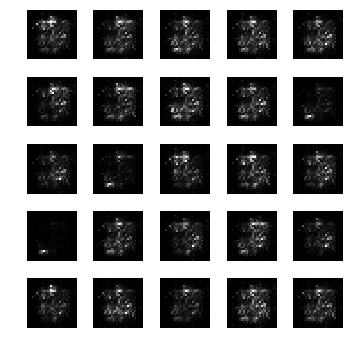

epoch: 1271, time: 4.972864 | train_G_Loss: 0.691808, train_D_loss: 1.392178, train_acc: 0.105455
cv_G_Loss: 0.662105, cv_D_loss: 4.412922, cv_acc: 0.103200

epoch: 1272, time: 4.870529 | train_G_Loss: 0.692987, train_D_loss: 1.388798, train_acc: 0.112727
cv_G_Loss: 0.892713, cv_D_loss: 4.659785, cv_acc: 0.140000

epoch: 1273, time: 4.873016 | train_G_Loss: 0.694670, train_D_loss: 1.382218, train_acc: 0.107273
cv_G_Loss: 0.785568, cv_D_loss: 4.498485, cv_acc: 0.113500

epoch: 1274, time: 4.870028 | train_G_Loss: 0.697606, train_D_loss: 1.379461, train_acc: 0.107273
cv_G_Loss: 0.780978, cv_D_loss: 4.483405, cv_acc: 0.113500

epoch: 1275, time: 4.874664 | train_G_Loss: 0.695912, train_D_loss: 1.373531, train_acc: 0.112727
cv_G_Loss: 0.924836, cv_D_loss: 4.592811, cv_acc: 0.113500

epoch: 1276, time: 4.868639 | train_G_Loss: 0.693574, train_D_loss: 1.387753, train_acc: 0.109091
cv_G_Loss: 0.590552, cv_D_loss: 4.315646, cv_acc: 0.102800

epoch: 1277, time: 4.869813 | train_G_Loss: 0.695919

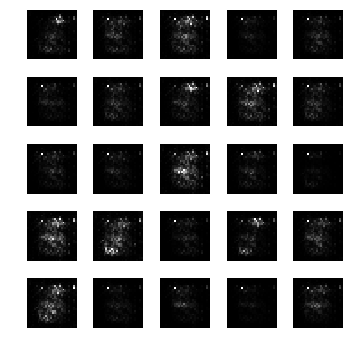

epoch: 1281, time: 4.936488 | train_G_Loss: 0.693166, train_D_loss: 1.390372, train_acc: 0.096364
cv_G_Loss: 0.870220, cv_D_loss: 4.556283, cv_acc: 0.101000

epoch: 1282, time: 4.896798 | train_G_Loss: 0.702485, train_D_loss: 1.372563, train_acc: 0.096364
cv_G_Loss: 0.904796, cv_D_loss: 4.660057, cv_acc: 0.101000

epoch: 1283, time: 4.876251 | train_G_Loss: 0.693687, train_D_loss: 1.382643, train_acc: 0.096364
cv_G_Loss: 1.051147, cv_D_loss: 4.819422, cv_acc: 0.101000

epoch: 1284, time: 4.866171 | train_G_Loss: 0.695056, train_D_loss: 1.385776, train_acc: 0.089091
cv_G_Loss: 0.911236, cv_D_loss: 4.644199, cv_acc: 0.146800

epoch: 1285, time: 4.873021 | train_G_Loss: 0.692219, train_D_loss: 1.387210, train_acc: 0.089091
cv_G_Loss: 0.720768, cv_D_loss: 4.457588, cv_acc: 0.133900

epoch: 1286, time: 4.875955 | train_G_Loss: 0.691826, train_D_loss: 1.382231, train_acc: 0.089091
cv_G_Loss: 0.762835, cv_D_loss: 4.539590, cv_acc: 0.097400

epoch: 1287, time: 4.879991 | train_G_Loss: 0.694100

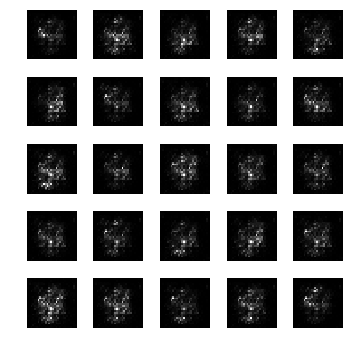

epoch: 1291, time: 4.897097 | train_G_Loss: 0.697420, train_D_loss: 1.379898, train_acc: 0.096364
cv_G_Loss: 0.783981, cv_D_loss: 4.511014, cv_acc: 0.098000

epoch: 1292, time: 4.876205 | train_G_Loss: 0.693539, train_D_loss: 1.380342, train_acc: 0.096364
cv_G_Loss: 0.702493, cv_D_loss: 4.420054, cv_acc: 0.098000

epoch: 1293, time: 4.878103 | train_G_Loss: 0.691228, train_D_loss: 1.376534, train_acc: 0.136364
cv_G_Loss: 0.925640, cv_D_loss: 4.692648, cv_acc: 0.121200

epoch: 1294, time: 4.877059 | train_G_Loss: 0.696742, train_D_loss: 1.376377, train_acc: 0.165455
cv_G_Loss: 0.838419, cv_D_loss: 4.560202, cv_acc: 0.123000

epoch: 1295, time: 4.871944 | train_G_Loss: 0.691040, train_D_loss: 1.383520, train_acc: 0.096364
cv_G_Loss: 0.739054, cv_D_loss: 4.421195, cv_acc: 0.098000

epoch: 1296, time: 4.869717 | train_G_Loss: 0.692274, train_D_loss: 1.386555, train_acc: 0.150909
cv_G_Loss: 0.647401, cv_D_loss: 4.355956, cv_acc: 0.098000

epoch: 1297, time: 4.871600 | train_G_Loss: 0.700351

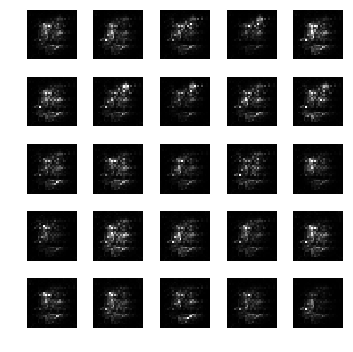

epoch: 1301, time: 4.904851 | train_G_Loss: 0.692772, train_D_loss: 1.386639, train_acc: 0.096364
cv_G_Loss: 0.619408, cv_D_loss: 4.318952, cv_acc: 0.098000

epoch: 1302, time: 4.881996 | train_G_Loss: 0.696841, train_D_loss: 1.378441, train_acc: 0.096364
cv_G_Loss: 0.788001, cv_D_loss: 4.532651, cv_acc: 0.098000

epoch: 1303, time: 4.875473 | train_G_Loss: 0.698447, train_D_loss: 1.372962, train_acc: 0.096364
cv_G_Loss: 0.702164, cv_D_loss: 4.468155, cv_acc: 0.098000

epoch: 1304, time: 4.901711 | train_G_Loss: 0.695780, train_D_loss: 1.372193, train_acc: 0.096364
cv_G_Loss: 0.658170, cv_D_loss: 4.339784, cv_acc: 0.098000

epoch: 1305, time: 4.905640 | train_G_Loss: 0.693153, train_D_loss: 1.386508, train_acc: 0.096364
cv_G_Loss: 0.743355, cv_D_loss: 4.471514, cv_acc: 0.098000

epoch: 1306, time: 4.877370 | train_G_Loss: 0.698217, train_D_loss: 1.375932, train_acc: 0.096364
cv_G_Loss: 1.038463, cv_D_loss: 4.826666, cv_acc: 0.098000

epoch: 1307, time: 4.878582 | train_G_Loss: 0.696298

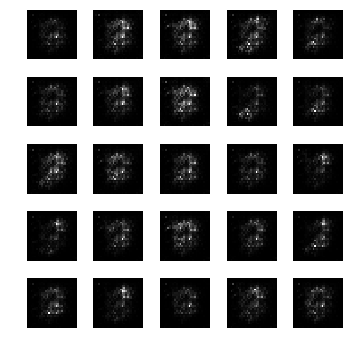

epoch: 1311, time: 4.900605 | train_G_Loss: 0.691656, train_D_loss: 1.387902, train_acc: 0.129091
cv_G_Loss: 0.882341, cv_D_loss: 4.631070, cv_acc: 0.147400

epoch: 1312, time: 4.879510 | train_G_Loss: 0.696298, train_D_loss: 1.372515, train_acc: 0.169091
cv_G_Loss: 0.743866, cv_D_loss: 4.464369, cv_acc: 0.102600

epoch: 1313, time: 4.876722 | train_G_Loss: 0.691761, train_D_loss: 1.388362, train_acc: 0.096364
cv_G_Loss: 0.785853, cv_D_loss: 4.467457, cv_acc: 0.103600

epoch: 1314, time: 4.871153 | train_G_Loss: 0.700328, train_D_loss: 1.375309, train_acc: 0.192727
cv_G_Loss: 0.852458, cv_D_loss: 4.527998, cv_acc: 0.170000

epoch: 1315, time: 4.876770 | train_G_Loss: 0.693447, train_D_loss: 1.392836, train_acc: 0.096364
cv_G_Loss: 0.827539, cv_D_loss: 4.627518, cv_acc: 0.101000

epoch: 1316, time: 4.881464 | train_G_Loss: 0.696705, train_D_loss: 1.377518, train_acc: 0.096364
cv_G_Loss: 0.628480, cv_D_loss: 4.367913, cv_acc: 0.101000

epoch: 1317, time: 4.878300 | train_G_Loss: 0.692624

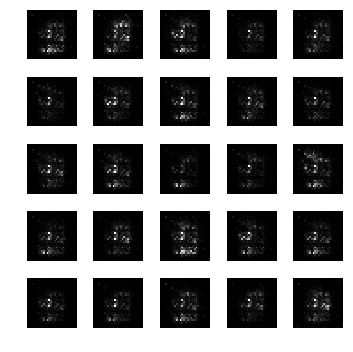

epoch: 1321, time: 4.902454 | train_G_Loss: 0.693645, train_D_loss: 1.381231, train_acc: 0.087273
cv_G_Loss: 0.803560, cv_D_loss: 4.540501, cv_acc: 0.089200

epoch: 1322, time: 4.877598 | train_G_Loss: 0.693372, train_D_loss: 1.387433, train_acc: 0.100000
cv_G_Loss: 0.712404, cv_D_loss: 4.387042, cv_acc: 0.101100

epoch: 1323, time: 4.875463 | train_G_Loss: 0.696214, train_D_loss: 1.379654, train_acc: 0.100000
cv_G_Loss: 0.774771, cv_D_loss: 4.473435, cv_acc: 0.097200

epoch: 1324, time: 4.876164 | train_G_Loss: 0.694559, train_D_loss: 1.384221, train_acc: 0.158182
cv_G_Loss: 0.683860, cv_D_loss: 4.383159, cv_acc: 0.117400

epoch: 1325, time: 4.872928 | train_G_Loss: 0.690854, train_D_loss: 1.390891, train_acc: 0.141818
cv_G_Loss: 0.716126, cv_D_loss: 4.416298, cv_acc: 0.124000

epoch: 1326, time: 4.885198 | train_G_Loss: 0.691696, train_D_loss: 1.385868, train_acc: 0.100000
cv_G_Loss: 0.785253, cv_D_loss: 4.508626, cv_acc: 0.098200

epoch: 1327, time: 4.874508 | train_G_Loss: 0.693354

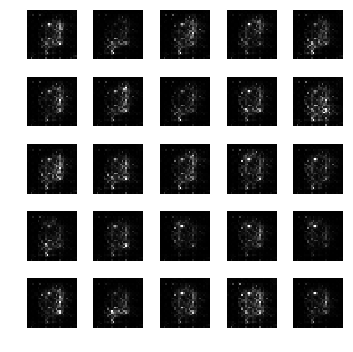

epoch: 1331, time: 4.921324 | train_G_Loss: 0.696732, train_D_loss: 1.382638, train_acc: 0.190909
cv_G_Loss: 0.765336, cv_D_loss: 4.424768, cv_acc: 0.101000

epoch: 1332, time: 4.876388 | train_G_Loss: 0.697948, train_D_loss: 1.379492, train_acc: 0.096364
cv_G_Loss: 0.803192, cv_D_loss: 4.484776, cv_acc: 0.135400

epoch: 1333, time: 4.874047 | train_G_Loss: 0.694932, train_D_loss: 1.382174, train_acc: 0.096364
cv_G_Loss: 0.684439, cv_D_loss: 4.361796, cv_acc: 0.101000

epoch: 1334, time: 4.881411 | train_G_Loss: 0.696049, train_D_loss: 1.385698, train_acc: 0.096364
cv_G_Loss: 0.781764, cv_D_loss: 4.484761, cv_acc: 0.101000

epoch: 1335, time: 4.873668 | train_G_Loss: 0.693269, train_D_loss: 1.388176, train_acc: 0.136364
cv_G_Loss: 0.691739, cv_D_loss: 4.416414, cv_acc: 0.104700

epoch: 1336, time: 4.876693 | train_G_Loss: 0.694755, train_D_loss: 1.384863, train_acc: 0.096364
cv_G_Loss: 0.604274, cv_D_loss: 4.330256, cv_acc: 0.101000

epoch: 1337, time: 4.878798 | train_G_Loss: 0.693068

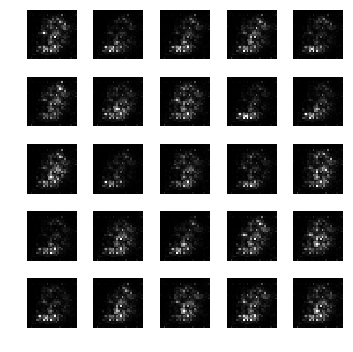

epoch: 1341, time: 4.922043 | train_G_Loss: 0.696453, train_D_loss: 1.375723, train_acc: 0.098182
cv_G_Loss: 0.703439, cv_D_loss: 4.429749, cv_acc: 0.096000

epoch: 1342, time: 4.879415 | train_G_Loss: 0.696589, train_D_loss: 1.378610, train_acc: 0.100000
cv_G_Loss: 0.819351, cv_D_loss: 4.531174, cv_acc: 0.098600

epoch: 1343, time: 4.873509 | train_G_Loss: 0.694182, train_D_loss: 1.385312, train_acc: 0.161818
cv_G_Loss: 0.737749, cv_D_loss: 4.433122, cv_acc: 0.133000

epoch: 1344, time: 4.878703 | train_G_Loss: 0.694211, train_D_loss: 1.381947, train_acc: 0.149091
cv_G_Loss: 0.720805, cv_D_loss: 4.420339, cv_acc: 0.165500

epoch: 1345, time: 4.887083 | train_G_Loss: 0.697290, train_D_loss: 1.377089, train_acc: 0.096364
cv_G_Loss: 0.699793, cv_D_loss: 4.388340, cv_acc: 0.098000

epoch: 1346, time: 4.879403 | train_G_Loss: 0.697084, train_D_loss: 1.376791, train_acc: 0.269091
cv_G_Loss: 0.637195, cv_D_loss: 4.337695, cv_acc: 0.272200
Model saved

epoch: 1347, time: 4.912889 | train_G_Lo

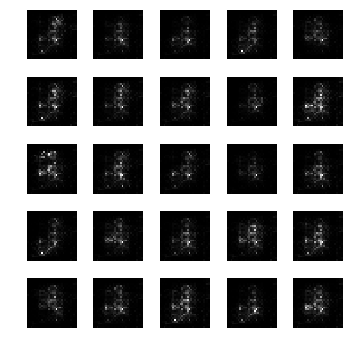

epoch: 1351, time: 4.929609 | train_G_Loss: 0.693781, train_D_loss: 1.388673, train_acc: 0.105455
cv_G_Loss: 0.900378, cv_D_loss: 4.707809, cv_acc: 0.161600

epoch: 1352, time: 4.887460 | train_G_Loss: 0.693199, train_D_loss: 1.382740, train_acc: 0.183636
cv_G_Loss: 0.657953, cv_D_loss: 4.375333, cv_acc: 0.211300

epoch: 1353, time: 4.875015 | train_G_Loss: 0.696775, train_D_loss: 1.380999, train_acc: 0.100000
cv_G_Loss: 0.779742, cv_D_loss: 4.440204, cv_acc: 0.151600

epoch: 1354, time: 4.883785 | train_G_Loss: 0.690019, train_D_loss: 1.390074, train_acc: 0.098182
cv_G_Loss: 0.698016, cv_D_loss: 4.391222, cv_acc: 0.092400

epoch: 1355, time: 4.879693 | train_G_Loss: 0.697678, train_D_loss: 1.384375, train_acc: 0.087273
cv_G_Loss: 0.671590, cv_D_loss: 4.378593, cv_acc: 0.089200

epoch: 1356, time: 4.881156 | train_G_Loss: 0.697043, train_D_loss: 1.375393, train_acc: 0.107273
cv_G_Loss: 0.591932, cv_D_loss: 4.309268, cv_acc: 0.114900

epoch: 1357, time: 4.886737 | train_G_Loss: 0.695645

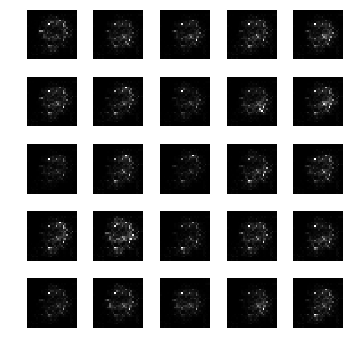

epoch: 1361, time: 4.907445 | train_G_Loss: 0.693296, train_D_loss: 1.385000, train_acc: 0.136364
cv_G_Loss: 0.700204, cv_D_loss: 4.422698, cv_acc: 0.179300

epoch: 1362, time: 4.872297 | train_G_Loss: 0.689461, train_D_loss: 1.390794, train_acc: 0.098182
cv_G_Loss: 0.811029, cv_D_loss: 4.498651, cv_acc: 0.098000

epoch: 1363, time: 4.889083 | train_G_Loss: 0.692533, train_D_loss: 1.389349, train_acc: 0.169091
cv_G_Loss: 0.814519, cv_D_loss: 4.475844, cv_acc: 0.192700

epoch: 1364, time: 4.875863 | train_G_Loss: 0.691334, train_D_loss: 1.388082, train_acc: 0.107273
cv_G_Loss: 0.700222, cv_D_loss: 4.378360, cv_acc: 0.114700

epoch: 1365, time: 4.875441 | train_G_Loss: 0.691232, train_D_loss: 1.383724, train_acc: 0.129091
cv_G_Loss: 0.636911, cv_D_loss: 4.353559, cv_acc: 0.162300

epoch: 1366, time: 4.867733 | train_G_Loss: 0.687366, train_D_loss: 1.388871, train_acc: 0.105455
cv_G_Loss: 0.767588, cv_D_loss: 4.517391, cv_acc: 0.146900

epoch: 1367, time: 4.868720 | train_G_Loss: 0.691133

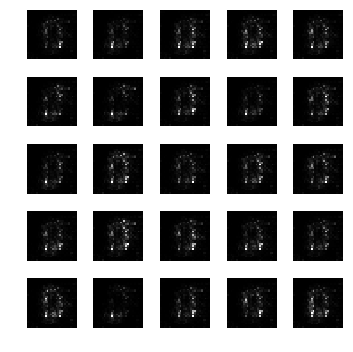

epoch: 1371, time: 4.905661 | train_G_Loss: 0.693383, train_D_loss: 1.391198, train_acc: 0.103636
cv_G_Loss: 0.666079, cv_D_loss: 4.366638, cv_acc: 0.099200

epoch: 1372, time: 4.882572 | train_G_Loss: 0.699672, train_D_loss: 1.385325, train_acc: 0.096364
cv_G_Loss: 0.823886, cv_D_loss: 4.523322, cv_acc: 0.098000

epoch: 1373, time: 4.893172 | train_G_Loss: 0.694281, train_D_loss: 1.384927, train_acc: 0.096364
cv_G_Loss: 0.773767, cv_D_loss: 4.486181, cv_acc: 0.098000

epoch: 1374, time: 4.890411 | train_G_Loss: 0.698185, train_D_loss: 1.377111, train_acc: 0.096364
cv_G_Loss: 1.043695, cv_D_loss: 4.799363, cv_acc: 0.098000

epoch: 1375, time: 4.874839 | train_G_Loss: 0.700515, train_D_loss: 1.368847, train_acc: 0.096364
cv_G_Loss: 0.815501, cv_D_loss: 4.504340, cv_acc: 0.098000

epoch: 1376, time: 4.885793 | train_G_Loss: 0.695872, train_D_loss: 1.380123, train_acc: 0.150909
cv_G_Loss: 0.723963, cv_D_loss: 4.419829, cv_acc: 0.166900

epoch: 1377, time: 4.880560 | train_G_Loss: 0.695538

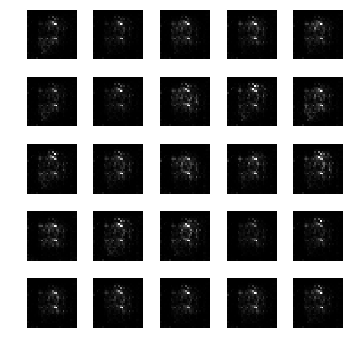

epoch: 1381, time: 4.908593 | train_G_Loss: 0.695436, train_D_loss: 1.382649, train_acc: 0.163636
cv_G_Loss: 0.751469, cv_D_loss: 4.497515, cv_acc: 0.135300

epoch: 1382, time: 4.879841 | train_G_Loss: 0.691800, train_D_loss: 1.386872, train_acc: 0.198182
cv_G_Loss: 0.759607, cv_D_loss: 4.437681, cv_acc: 0.195500

epoch: 1383, time: 4.881822 | train_G_Loss: 0.690037, train_D_loss: 1.388463, train_acc: 0.096364
cv_G_Loss: 0.795433, cv_D_loss: 4.466670, cv_acc: 0.100900

epoch: 1384, time: 4.881793 | train_G_Loss: 0.692836, train_D_loss: 1.385593, train_acc: 0.154545
cv_G_Loss: 0.785007, cv_D_loss: 4.493814, cv_acc: 0.172800

epoch: 1385, time: 4.879286 | train_G_Loss: 0.693444, train_D_loss: 1.385465, train_acc: 0.109091
cv_G_Loss: 0.741018, cv_D_loss: 4.437895, cv_acc: 0.114400

epoch: 1386, time: 4.877501 | train_G_Loss: 0.693118, train_D_loss: 1.387198, train_acc: 0.096364
cv_G_Loss: 0.756287, cv_D_loss: 4.446428, cv_acc: 0.133500

epoch: 1387, time: 4.872549 | train_G_Loss: 0.693546

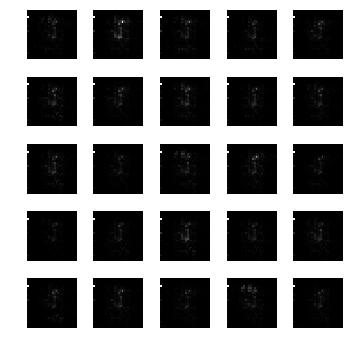

epoch: 1391, time: 4.915113 | train_G_Loss: 0.706422, train_D_loss: 1.359921, train_acc: 0.107273
cv_G_Loss: 0.816941, cv_D_loss: 4.518912, cv_acc: 0.113500

epoch: 1392, time: 4.877923 | train_G_Loss: 0.697648, train_D_loss: 1.374866, train_acc: 0.110909
cv_G_Loss: 0.753198, cv_D_loss: 4.442936, cv_acc: 0.114000

epoch: 1393, time: 4.886623 | train_G_Loss: 0.691601, train_D_loss: 1.392419, train_acc: 0.087273
cv_G_Loss: 0.713359, cv_D_loss: 4.340402, cv_acc: 0.089200

epoch: 1394, time: 4.876229 | train_G_Loss: 0.693719, train_D_loss: 1.382592, train_acc: 0.087273
cv_G_Loss: 0.656299, cv_D_loss: 4.348210, cv_acc: 0.089200

epoch: 1395, time: 4.886620 | train_G_Loss: 0.688200, train_D_loss: 1.395707, train_acc: 0.047273
cv_G_Loss: 0.593676, cv_D_loss: 4.354144, cv_acc: 0.095800

epoch: 1396, time: 4.898834 | train_G_Loss: 0.695395, train_D_loss: 1.381226, train_acc: 0.098182
cv_G_Loss: 0.710170, cv_D_loss: 4.401637, cv_acc: 0.100900

epoch: 1397, time: 4.904515 | train_G_Loss: 0.691953

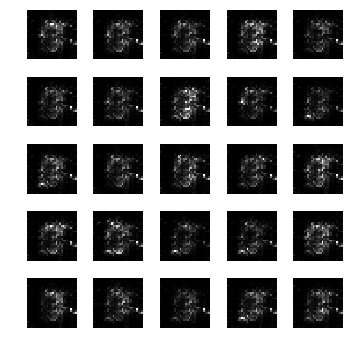

epoch: 1401, time: 4.887301 | train_G_Loss: 0.693017, train_D_loss: 1.376063, train_acc: 0.089091
cv_G_Loss: 0.486397, cv_D_loss: 4.231182, cv_acc: 0.097500

epoch: 1402, time: 4.884108 | train_G_Loss: 0.694837, train_D_loss: 1.381263, train_acc: 0.089091
cv_G_Loss: 0.729153, cv_D_loss: 4.489496, cv_acc: 0.097400

epoch: 1403, time: 4.872677 | train_G_Loss: 0.691945, train_D_loss: 1.386940, train_acc: 0.089091
cv_G_Loss: 0.687887, cv_D_loss: 4.454613, cv_acc: 0.097400

epoch: 1404, time: 4.879328 | train_G_Loss: 0.694444, train_D_loss: 1.384046, train_acc: 0.116364
cv_G_Loss: 0.741121, cv_D_loss: 4.470572, cv_acc: 0.097400

epoch: 1405, time: 4.877740 | train_G_Loss: 0.692743, train_D_loss: 1.386179, train_acc: 0.105455
cv_G_Loss: 0.687145, cv_D_loss: 4.387778, cv_acc: 0.103200

epoch: 1406, time: 4.876245 | train_G_Loss: 0.694195, train_D_loss: 1.382872, train_acc: 0.129091
cv_G_Loss: 0.697304, cv_D_loss: 4.385367, cv_acc: 0.134200

epoch: 1407, time: 4.876552 | train_G_Loss: 0.693276

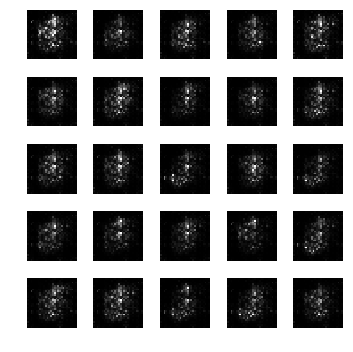

epoch: 1411, time: 4.905337 | train_G_Loss: 0.692394, train_D_loss: 1.386028, train_acc: 0.087273
cv_G_Loss: 0.716336, cv_D_loss: 4.393170, cv_acc: 0.086300

epoch: 1412, time: 4.883469 | train_G_Loss: 0.694647, train_D_loss: 1.384273, train_acc: 0.112727
cv_G_Loss: 0.728312, cv_D_loss: 4.389572, cv_acc: 0.102400

epoch: 1413, time: 4.878591 | train_G_Loss: 0.693721, train_D_loss: 1.382159, train_acc: 0.107273
cv_G_Loss: 0.598090, cv_D_loss: 4.301601, cv_acc: 0.162300

epoch: 1414, time: 4.881222 | train_G_Loss: 0.695069, train_D_loss: 1.383156, train_acc: 0.107273
cv_G_Loss: 0.692493, cv_D_loss: 4.393641, cv_acc: 0.113600

epoch: 1415, time: 4.894457 | train_G_Loss: 0.696340, train_D_loss: 1.378013, train_acc: 0.089091
cv_G_Loss: 0.693174, cv_D_loss: 4.403862, cv_acc: 0.097400

epoch: 1416, time: 4.878888 | train_G_Loss: 0.694698, train_D_loss: 1.382262, train_acc: 0.147273
cv_G_Loss: 0.713033, cv_D_loss: 4.413826, cv_acc: 0.158500

epoch: 1417, time: 4.884349 | train_G_Loss: 0.695219

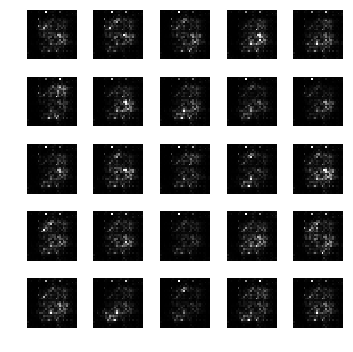

epoch: 1421, time: 4.902024 | train_G_Loss: 0.694207, train_D_loss: 1.382648, train_acc: 0.114545
cv_G_Loss: 0.776171, cv_D_loss: 4.481471, cv_acc: 0.102100

epoch: 1422, time: 4.896073 | train_G_Loss: 0.700970, train_D_loss: 1.369938, train_acc: 0.110909
cv_G_Loss: 0.773163, cv_D_loss: 4.462060, cv_acc: 0.095800

epoch: 1423, time: 4.874692 | train_G_Loss: 0.688288, train_D_loss: 1.369507, train_acc: 0.134545
cv_G_Loss: 0.866403, cv_D_loss: 4.576146, cv_acc: 0.101000

epoch: 1424, time: 4.879966 | train_G_Loss: 0.707402, train_D_loss: 1.368560, train_acc: 0.161818
cv_G_Loss: 0.808682, cv_D_loss: 4.507389, cv_acc: 0.101000

epoch: 1425, time: 4.884890 | train_G_Loss: 0.694777, train_D_loss: 1.379920, train_acc: 0.089091
cv_G_Loss: 0.730576, cv_D_loss: 4.406205, cv_acc: 0.118700

epoch: 1426, time: 4.864770 | train_G_Loss: 0.695885, train_D_loss: 1.377766, train_acc: 0.087273
cv_G_Loss: 0.710295, cv_D_loss: 4.398752, cv_acc: 0.088600

epoch: 1427, time: 4.887419 | train_G_Loss: 0.692689

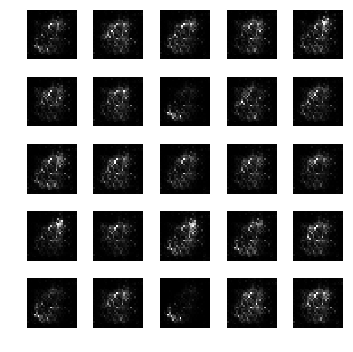

epoch: 1431, time: 4.890871 | train_G_Loss: 0.691233, train_D_loss: 1.390056, train_acc: 0.110909
cv_G_Loss: 0.657544, cv_D_loss: 4.409007, cv_acc: 0.095800

epoch: 1432, time: 4.879902 | train_G_Loss: 0.702669, train_D_loss: 1.381493, train_acc: 0.107273
cv_G_Loss: 0.829684, cv_D_loss: 4.615395, cv_acc: 0.113500

epoch: 1433, time: 4.898246 | train_G_Loss: 0.699019, train_D_loss: 1.376698, train_acc: 0.132727
cv_G_Loss: 0.738491, cv_D_loss: 4.480449, cv_acc: 0.126900

epoch: 1434, time: 4.884881 | train_G_Loss: 0.695691, train_D_loss: 1.386877, train_acc: 0.125455
cv_G_Loss: 0.941882, cv_D_loss: 4.726637, cv_acc: 0.098000

epoch: 1435, time: 4.877514 | train_G_Loss: 0.695334, train_D_loss: 1.380349, train_acc: 0.125455
cv_G_Loss: 0.761130, cv_D_loss: 4.497215, cv_acc: 0.100900

epoch: 1436, time: 4.887959 | train_G_Loss: 0.691795, train_D_loss: 1.383142, train_acc: 0.176364
cv_G_Loss: 0.761322, cv_D_loss: 4.392744, cv_acc: 0.117000

epoch: 1437, time: 4.876052 | train_G_Loss: 0.693761

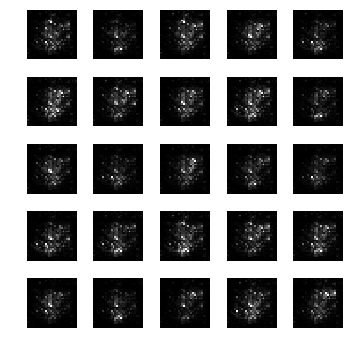

epoch: 1441, time: 4.904171 | train_G_Loss: 0.698349, train_D_loss: 1.378728, train_acc: 0.096364
cv_G_Loss: 0.716207, cv_D_loss: 4.466121, cv_acc: 0.098000

epoch: 1442, time: 4.919224 | train_G_Loss: 0.699730, train_D_loss: 1.377696, train_acc: 0.096364
cv_G_Loss: 0.753889, cv_D_loss: 4.482068, cv_acc: 0.098000

epoch: 1443, time: 4.903491 | train_G_Loss: 0.704696, train_D_loss: 1.368122, train_acc: 0.107273
cv_G_Loss: 0.829981, cv_D_loss: 4.555250, cv_acc: 0.113900

epoch: 1444, time: 4.883266 | train_G_Loss: 0.683689, train_D_loss: 1.398301, train_acc: 0.107273
cv_G_Loss: 0.669954, cv_D_loss: 4.410000, cv_acc: 0.113500

epoch: 1445, time: 4.874171 | train_G_Loss: 0.689246, train_D_loss: 1.396115, train_acc: 0.096364
cv_G_Loss: 0.580348, cv_D_loss: 4.315130, cv_acc: 0.098000

epoch: 1446, time: 4.880466 | train_G_Loss: 0.702941, train_D_loss: 1.373017, train_acc: 0.121818
cv_G_Loss: 0.905538, cv_D_loss: 4.666528, cv_acc: 0.097400

epoch: 1447, time: 4.892465 | train_G_Loss: 0.696170

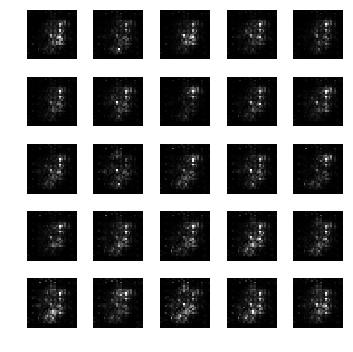

epoch: 1451, time: 4.910038 | train_G_Loss: 0.693237, train_D_loss: 1.384587, train_acc: 0.110909
cv_G_Loss: 0.665262, cv_D_loss: 4.362057, cv_acc: 0.096000

epoch: 1452, time: 4.884923 | train_G_Loss: 0.691022, train_D_loss: 1.385774, train_acc: 0.110909
cv_G_Loss: 0.634401, cv_D_loss: 4.317024, cv_acc: 0.095900

epoch: 1453, time: 4.882404 | train_G_Loss: 0.693956, train_D_loss: 1.382293, train_acc: 0.216364
cv_G_Loss: 0.841384, cv_D_loss: 4.560390, cv_acc: 0.187900

epoch: 1454, time: 4.873685 | train_G_Loss: 0.694695, train_D_loss: 1.382857, train_acc: 0.158182
cv_G_Loss: 0.688753, cv_D_loss: 4.391373, cv_acc: 0.106400

epoch: 1455, time: 4.886524 | train_G_Loss: 0.700980, train_D_loss: 1.370284, train_acc: 0.089091
cv_G_Loss: 1.099585, cv_D_loss: 4.889162, cv_acc: 0.097400

epoch: 1456, time: 4.878378 | train_G_Loss: 0.701095, train_D_loss: 1.375755, train_acc: 0.089091
cv_G_Loss: 0.929620, cv_D_loss: 4.661924, cv_acc: 0.097400

epoch: 1457, time: 4.886884 | train_G_Loss: 0.703236

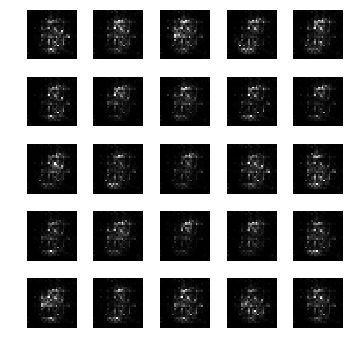

epoch: 1461, time: 4.903784 | train_G_Loss: 0.707462, train_D_loss: 1.365604, train_acc: 0.169091
cv_G_Loss: 0.536820, cv_D_loss: 4.315193, cv_acc: 0.100900

epoch: 1462, time: 4.883861 | train_G_Loss: 0.693886, train_D_loss: 1.390331, train_acc: 0.201818
cv_G_Loss: 0.695507, cv_D_loss: 4.486819, cv_acc: 0.190500

epoch: 1463, time: 4.873495 | train_G_Loss: 0.703719, train_D_loss: 1.366456, train_acc: 0.107273
cv_G_Loss: 0.733840, cv_D_loss: 4.616913, cv_acc: 0.113500

epoch: 1464, time: 4.874310 | train_G_Loss: 0.690883, train_D_loss: 1.384570, train_acc: 0.107273
cv_G_Loss: 0.648467, cv_D_loss: 4.407870, cv_acc: 0.113500

epoch: 1465, time: 4.912798 | train_G_Loss: 0.699115, train_D_loss: 1.369025, train_acc: 0.118182
cv_G_Loss: 0.654972, cv_D_loss: 4.332599, cv_acc: 0.114300

epoch: 1466, time: 4.908099 | train_G_Loss: 0.695569, train_D_loss: 1.381850, train_acc: 0.103636
cv_G_Loss: 0.825105, cv_D_loss: 4.497183, cv_acc: 0.133500

epoch: 1467, time: 4.870362 | train_G_Loss: 0.700141

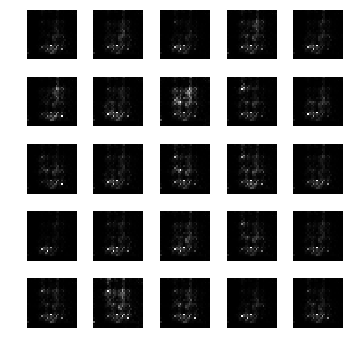

epoch: 1471, time: 4.912934 | train_G_Loss: 0.695076, train_D_loss: 1.382635, train_acc: 0.190909
cv_G_Loss: 0.800949, cv_D_loss: 4.517425, cv_acc: 0.204400

epoch: 1472, time: 4.889438 | train_G_Loss: 0.689340, train_D_loss: 1.393332, train_acc: 0.109091
cv_G_Loss: 0.718031, cv_D_loss: 4.389703, cv_acc: 0.101000

epoch: 1473, time: 4.885963 | train_G_Loss: 0.698068, train_D_loss: 1.378955, train_acc: 0.154545
cv_G_Loss: 0.768994, cv_D_loss: 4.444906, cv_acc: 0.169900

epoch: 1474, time: 4.876010 | train_G_Loss: 0.691499, train_D_loss: 1.386953, train_acc: 0.089091
cv_G_Loss: 0.668293, cv_D_loss: 4.396725, cv_acc: 0.153900

epoch: 1475, time: 4.872176 | train_G_Loss: 0.699427, train_D_loss: 1.379698, train_acc: 0.098182
cv_G_Loss: 0.750322, cv_D_loss: 4.440171, cv_acc: 0.098000

epoch: 1476, time: 4.879843 | train_G_Loss: 0.695885, train_D_loss: 1.372603, train_acc: 0.089091
cv_G_Loss: 0.676920, cv_D_loss: 4.384165, cv_acc: 0.097400

epoch: 1477, time: 4.883013 | train_G_Loss: 0.700215

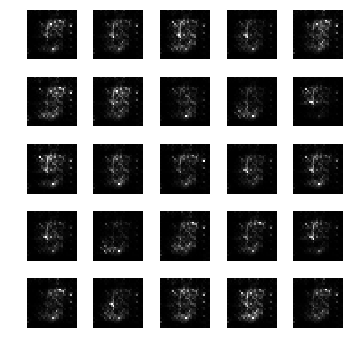

epoch: 1481, time: 4.911860 | train_G_Loss: 0.698801, train_D_loss: 1.377075, train_acc: 0.089091
cv_G_Loss: 0.584368, cv_D_loss: 4.280438, cv_acc: 0.140800

epoch: 1482, time: 4.882337 | train_G_Loss: 0.692502, train_D_loss: 1.384338, train_acc: 0.087273
cv_G_Loss: 0.623217, cv_D_loss: 4.378283, cv_acc: 0.089200

epoch: 1483, time: 4.878883 | train_G_Loss: 0.696717, train_D_loss: 1.379998, train_acc: 0.109091
cv_G_Loss: 0.866571, cv_D_loss: 4.661091, cv_acc: 0.110200

epoch: 1484, time: 4.881884 | train_G_Loss: 0.695065, train_D_loss: 1.375225, train_acc: 0.109091
cv_G_Loss: 0.704599, cv_D_loss: 4.398547, cv_acc: 0.102800

epoch: 1485, time: 4.880276 | train_G_Loss: 0.696841, train_D_loss: 1.381614, train_acc: 0.100000
cv_G_Loss: 0.770341, cv_D_loss: 4.472893, cv_acc: 0.126600

epoch: 1486, time: 4.884572 | train_G_Loss: 0.694938, train_D_loss: 1.385683, train_acc: 0.152727
cv_G_Loss: 0.832856, cv_D_loss: 4.493371, cv_acc: 0.132300

epoch: 1487, time: 4.876745 | train_G_Loss: 0.697906

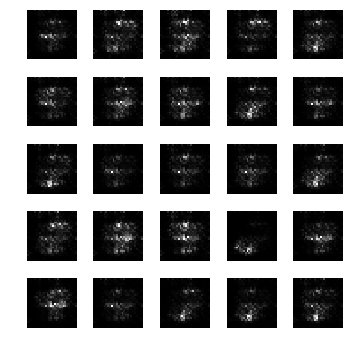

epoch: 1491, time: 4.920200 | train_G_Loss: 0.692370, train_D_loss: 1.389432, train_acc: 0.170909
cv_G_Loss: 0.755119, cv_D_loss: 4.433694, cv_acc: 0.133000

epoch: 1492, time: 4.882275 | train_G_Loss: 0.696510, train_D_loss: 1.394258, train_acc: 0.180000
cv_G_Loss: 0.834587, cv_D_loss: 4.460749, cv_acc: 0.122200

epoch: 1493, time: 4.879539 | train_G_Loss: 0.691303, train_D_loss: 1.388657, train_acc: 0.178182
cv_G_Loss: 0.654947, cv_D_loss: 4.341783, cv_acc: 0.107100

epoch: 1494, time: 4.891855 | train_G_Loss: 0.691174, train_D_loss: 1.388983, train_acc: 0.110909
cv_G_Loss: 0.787839, cv_D_loss: 4.522646, cv_acc: 0.104200

epoch: 1495, time: 4.873359 | train_G_Loss: 0.702062, train_D_loss: 1.364051, train_acc: 0.109091
cv_G_Loss: 1.134508, cv_D_loss: 5.025501, cv_acc: 0.102800

epoch: 1496, time: 4.873615 | train_G_Loss: 0.687487, train_D_loss: 1.391328, train_acc: 0.109091
cv_G_Loss: 0.719555, cv_D_loss: 4.461428, cv_acc: 0.102800

epoch: 1497, time: 4.875363 | train_G_Loss: 0.693711

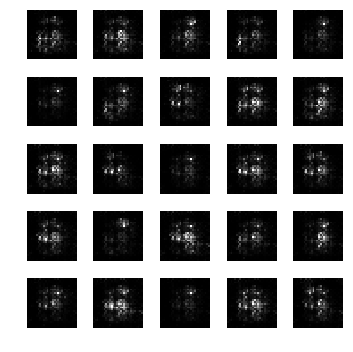

epoch: 1501, time: 4.913952 | train_G_Loss: 0.692791, train_D_loss: 1.385509, train_acc: 0.105455
cv_G_Loss: 0.692384, cv_D_loss: 4.398407, cv_acc: 0.103200

epoch: 1502, time: 4.882800 | train_G_Loss: 0.695200, train_D_loss: 1.381414, train_acc: 0.089091
cv_G_Loss: 0.834925, cv_D_loss: 4.555161, cv_acc: 0.097500

epoch: 1503, time: 5.003138 | train_G_Loss: 0.693323, train_D_loss: 1.384860, train_acc: 0.089091
cv_G_Loss: 0.715134, cv_D_loss: 4.407586, cv_acc: 0.097400

epoch: 1504, time: 4.898453 | train_G_Loss: 0.693323, train_D_loss: 1.384678, train_acc: 0.089091
cv_G_Loss: 0.641824, cv_D_loss: 4.319951, cv_acc: 0.097400

epoch: 1505, time: 4.880486 | train_G_Loss: 0.689551, train_D_loss: 1.386085, train_acc: 0.127273
cv_G_Loss: 0.644638, cv_D_loss: 4.363763, cv_acc: 0.118100

epoch: 1506, time: 4.877807 | train_G_Loss: 0.694488, train_D_loss: 1.383287, train_acc: 0.158182
cv_G_Loss: 0.964352, cv_D_loss: 4.709974, cv_acc: 0.178800

epoch: 1507, time: 4.881666 | train_G_Loss: 0.698631

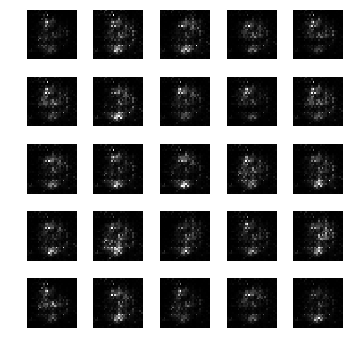

epoch: 1511, time: 4.941038 | train_G_Loss: 0.694779, train_D_loss: 1.381807, train_acc: 0.098182
cv_G_Loss: 0.646099, cv_D_loss: 4.322369, cv_acc: 0.108100

epoch: 1512, time: 4.906526 | train_G_Loss: 0.696110, train_D_loss: 1.378863, train_acc: 0.098182
cv_G_Loss: 0.627298, cv_D_loss: 4.334851, cv_acc: 0.100900

epoch: 1513, time: 4.882506 | train_G_Loss: 0.700183, train_D_loss: 1.377666, train_acc: 0.147273
cv_G_Loss: 0.779932, cv_D_loss: 4.427945, cv_acc: 0.164100

epoch: 1514, time: 4.878439 | train_G_Loss: 0.696366, train_D_loss: 1.382729, train_acc: 0.098182
cv_G_Loss: 0.894748, cv_D_loss: 4.612947, cv_acc: 0.100900

epoch: 1515, time: 4.879122 | train_G_Loss: 0.697140, train_D_loss: 1.372576, train_acc: 0.152727
cv_G_Loss: 0.642907, cv_D_loss: 4.288212, cv_acc: 0.130400

epoch: 1516, time: 4.879319 | train_G_Loss: 0.692718, train_D_loss: 1.385820, train_acc: 0.098182
cv_G_Loss: 0.850236, cv_D_loss: 4.595680, cv_acc: 0.100900

epoch: 1517, time: 4.890071 | train_G_Loss: 0.697332

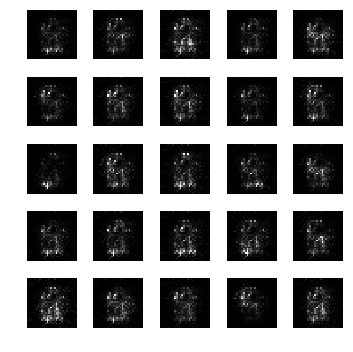

epoch: 1521, time: 4.912656 | train_G_Loss: 0.701433, train_D_loss: 1.371296, train_acc: 0.109091
cv_G_Loss: 0.791983, cv_D_loss: 4.403128, cv_acc: 0.102800

epoch: 1522, time: 4.878602 | train_G_Loss: 0.694419, train_D_loss: 1.382058, train_acc: 0.109091
cv_G_Loss: 0.937051, cv_D_loss: 4.652257, cv_acc: 0.102900

epoch: 1523, time: 4.879447 | train_G_Loss: 0.698913, train_D_loss: 1.374764, train_acc: 0.109091
cv_G_Loss: 0.733441, cv_D_loss: 4.388946, cv_acc: 0.113500

epoch: 1524, time: 4.883501 | train_G_Loss: 0.695650, train_D_loss: 1.380816, train_acc: 0.134545
cv_G_Loss: 0.737581, cv_D_loss: 4.436001, cv_acc: 0.163100

epoch: 1525, time: 4.886610 | train_G_Loss: 0.698812, train_D_loss: 1.375006, train_acc: 0.089091
cv_G_Loss: 0.635606, cv_D_loss: 4.346900, cv_acc: 0.099200

epoch: 1526, time: 4.872469 | train_G_Loss: 0.699187, train_D_loss: 1.374331, train_acc: 0.089091
cv_G_Loss: 0.613592, cv_D_loss: 4.357973, cv_acc: 0.143700

epoch: 1527, time: 4.878596 | train_G_Loss: 0.697614

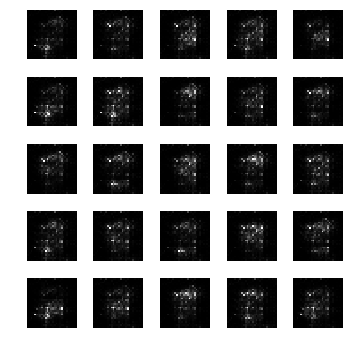

epoch: 1531, time: 4.907440 | train_G_Loss: 0.699402, train_D_loss: 1.380202, train_acc: 0.089091
cv_G_Loss: 0.596745, cv_D_loss: 4.302351, cv_acc: 0.097400

epoch: 1532, time: 4.888196 | train_G_Loss: 0.693388, train_D_loss: 1.385478, train_acc: 0.101818
cv_G_Loss: 0.762638, cv_D_loss: 4.397589, cv_acc: 0.168200

epoch: 1533, time: 4.885733 | train_G_Loss: 0.693852, train_D_loss: 1.389870, train_acc: 0.096364
cv_G_Loss: 0.723480, cv_D_loss: 4.409885, cv_acc: 0.098000

epoch: 1534, time: 4.903123 | train_G_Loss: 0.699375, train_D_loss: 1.373658, train_acc: 0.089091
cv_G_Loss: 0.684621, cv_D_loss: 4.369785, cv_acc: 0.097400

epoch: 1535, time: 4.894606 | train_G_Loss: 0.698363, train_D_loss: 1.374890, train_acc: 0.089091
cv_G_Loss: 0.722713, cv_D_loss: 4.427294, cv_acc: 0.097400

epoch: 1536, time: 4.876454 | train_G_Loss: 0.694708, train_D_loss: 1.377133, train_acc: 0.141818
cv_G_Loss: 0.849902, cv_D_loss: 4.544211, cv_acc: 0.107300

epoch: 1537, time: 4.867723 | train_G_Loss: 0.692507

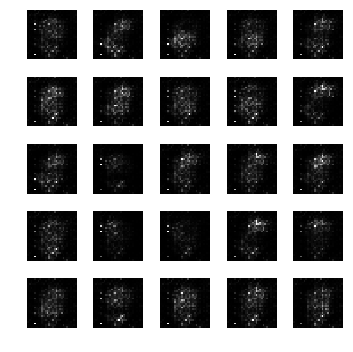

epoch: 1541, time: 4.900472 | train_G_Loss: 0.702427, train_D_loss: 1.374349, train_acc: 0.130909
cv_G_Loss: 0.724849, cv_D_loss: 4.364302, cv_acc: 0.186500

epoch: 1542, time: 4.882918 | train_G_Loss: 0.697844, train_D_loss: 1.375465, train_acc: 0.107273
cv_G_Loss: 0.729241, cv_D_loss: 4.413063, cv_acc: 0.113500

epoch: 1543, time: 4.868048 | train_G_Loss: 0.688277, train_D_loss: 1.384178, train_acc: 0.107273
cv_G_Loss: 0.661447, cv_D_loss: 4.414808, cv_acc: 0.113500

epoch: 1544, time: 4.882404 | train_G_Loss: 0.685727, train_D_loss: 1.399255, train_acc: 0.129091
cv_G_Loss: 0.916732, cv_D_loss: 4.628450, cv_acc: 0.131300

epoch: 1545, time: 4.892334 | train_G_Loss: 0.698399, train_D_loss: 1.379740, train_acc: 0.238182
cv_G_Loss: 0.601059, cv_D_loss: 4.290470, cv_acc: 0.162100

epoch: 1546, time: 4.876997 | train_G_Loss: 0.682137, train_D_loss: 1.405421, train_acc: 0.163636
cv_G_Loss: 0.511941, cv_D_loss: 4.264588, cv_acc: 0.100900

epoch: 1547, time: 4.894064 | train_G_Loss: 0.698773

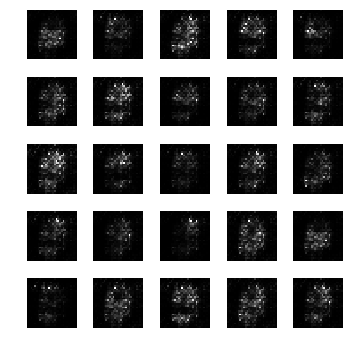

epoch: 1551, time: 4.911789 | train_G_Loss: 0.691808, train_D_loss: 1.390427, train_acc: 0.143636
cv_G_Loss: 0.681241, cv_D_loss: 4.349777, cv_acc: 0.174800

epoch: 1552, time: 4.887543 | train_G_Loss: 0.692884, train_D_loss: 1.385712, train_acc: 0.105455
cv_G_Loss: 0.750202, cv_D_loss: 4.439924, cv_acc: 0.103200

epoch: 1553, time: 4.871771 | train_G_Loss: 0.691039, train_D_loss: 1.388157, train_acc: 0.105455
cv_G_Loss: 0.782279, cv_D_loss: 4.459987, cv_acc: 0.103200

epoch: 1554, time: 4.883933 | train_G_Loss: 0.690505, train_D_loss: 1.381782, train_acc: 0.105455
cv_G_Loss: 0.741310, cv_D_loss: 4.412184, cv_acc: 0.103200

epoch: 1555, time: 4.882836 | train_G_Loss: 0.693085, train_D_loss: 1.385571, train_acc: 0.105455
cv_G_Loss: 0.979351, cv_D_loss: 4.746464, cv_acc: 0.103200

epoch: 1556, time: 4.887546 | train_G_Loss: 0.695634, train_D_loss: 1.380152, train_acc: 0.112727
cv_G_Loss: 0.684089, cv_D_loss: 4.359299, cv_acc: 0.123100

epoch: 1557, time: 4.912096 | train_G_Loss: 0.697457

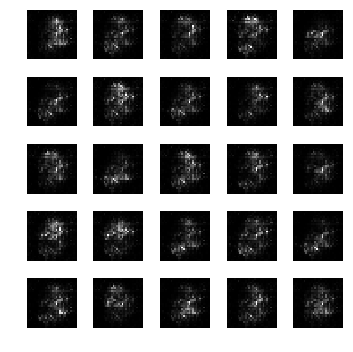

epoch: 1561, time: 4.914442 | train_G_Loss: 0.695262, train_D_loss: 1.381194, train_acc: 0.176364
cv_G_Loss: 0.766868, cv_D_loss: 4.470725, cv_acc: 0.122000

epoch: 1562, time: 4.883992 | train_G_Loss: 0.696001, train_D_loss: 1.380747, train_acc: 0.187273
cv_G_Loss: 0.701685, cv_D_loss: 4.333297, cv_acc: 0.114300

epoch: 1563, time: 4.888237 | train_G_Loss: 0.696241, train_D_loss: 1.371050, train_acc: 0.163636
cv_G_Loss: 0.830773, cv_D_loss: 4.548434, cv_acc: 0.099500

epoch: 1564, time: 4.877497 | train_G_Loss: 0.692273, train_D_loss: 1.391923, train_acc: 0.096364
cv_G_Loss: 0.863636, cv_D_loss: 4.596246, cv_acc: 0.099400

epoch: 1565, time: 4.869776 | train_G_Loss: 0.700915, train_D_loss: 1.380774, train_acc: 0.096364
cv_G_Loss: 0.964135, cv_D_loss: 4.718758, cv_acc: 0.101000

epoch: 1566, time: 4.872023 | train_G_Loss: 0.688883, train_D_loss: 1.395356, train_acc: 0.196364
cv_G_Loss: 0.752621, cv_D_loss: 4.504236, cv_acc: 0.190200

epoch: 1567, time: 4.873810 | train_G_Loss: 0.692249

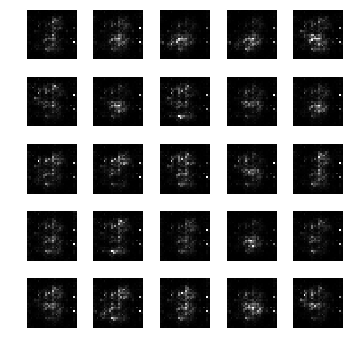

epoch: 1571, time: 4.914546 | train_G_Loss: 0.686922, train_D_loss: 1.389353, train_acc: 0.145455
cv_G_Loss: 0.761572, cv_D_loss: 4.454652, cv_acc: 0.159500

epoch: 1572, time: 4.904691 | train_G_Loss: 0.697077, train_D_loss: 1.379955, train_acc: 0.100000
cv_G_Loss: 0.615771, cv_D_loss: 4.348679, cv_acc: 0.098200

epoch: 1573, time: 4.884093 | train_G_Loss: 0.698231, train_D_loss: 1.379778, train_acc: 0.100000
cv_G_Loss: 0.955480, cv_D_loss: 4.712798, cv_acc: 0.098200

epoch: 1574, time: 4.881229 | train_G_Loss: 0.698037, train_D_loss: 1.377471, train_acc: 0.114545
cv_G_Loss: 0.767865, cv_D_loss: 4.420404, cv_acc: 0.128000

epoch: 1575, time: 4.875260 | train_G_Loss: 0.696114, train_D_loss: 1.381747, train_acc: 0.250909
cv_G_Loss: 0.619241, cv_D_loss: 4.292301, cv_acc: 0.167900

epoch: 1576, time: 4.891918 | train_G_Loss: 0.690311, train_D_loss: 1.386824, train_acc: 0.100000
cv_G_Loss: 0.666010, cv_D_loss: 4.391091, cv_acc: 0.098200

epoch: 1577, time: 4.882863 | train_G_Loss: 0.694421

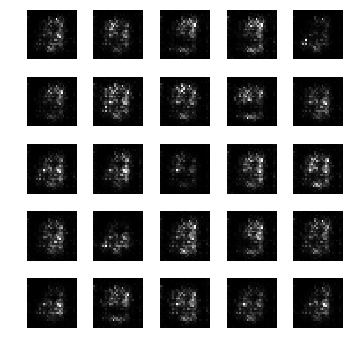

epoch: 1581, time: 4.919606 | train_G_Loss: 0.695108, train_D_loss: 1.384283, train_acc: 0.089091
cv_G_Loss: 0.731937, cv_D_loss: 4.430369, cv_acc: 0.097400

epoch: 1582, time: 4.881210 | train_G_Loss: 0.688858, train_D_loss: 1.390339, train_acc: 0.096364
cv_G_Loss: 0.717294, cv_D_loss: 4.405241, cv_acc: 0.112900

epoch: 1583, time: 4.872359 | train_G_Loss: 0.693021, train_D_loss: 1.386675, train_acc: 0.096364
cv_G_Loss: 0.684368, cv_D_loss: 4.407143, cv_acc: 0.098100

epoch: 1584, time: 4.885412 | train_G_Loss: 0.692289, train_D_loss: 1.389710, train_acc: 0.096364
cv_G_Loss: 0.729593, cv_D_loss: 4.447885, cv_acc: 0.098000

epoch: 1585, time: 4.884151 | train_G_Loss: 0.695089, train_D_loss: 1.386459, train_acc: 0.096364
cv_G_Loss: 0.672823, cv_D_loss: 4.356038, cv_acc: 0.098000

epoch: 1586, time: 4.889060 | train_G_Loss: 0.692647, train_D_loss: 1.386347, train_acc: 0.116364
cv_G_Loss: 0.692976, cv_D_loss: 4.357071, cv_acc: 0.098100

epoch: 1587, time: 4.885521 | train_G_Loss: 0.687253

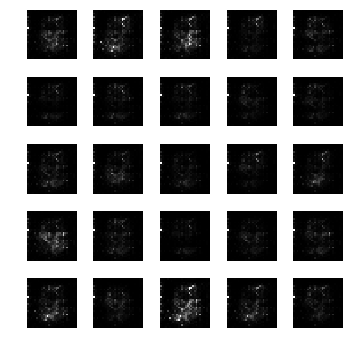

epoch: 1591, time: 4.908904 | train_G_Loss: 0.694664, train_D_loss: 1.379048, train_acc: 0.105455
cv_G_Loss: 0.856773, cv_D_loss: 4.642402, cv_acc: 0.103200

epoch: 1592, time: 4.881468 | train_G_Loss: 0.695906, train_D_loss: 1.378372, train_acc: 0.105455
cv_G_Loss: 0.791380, cv_D_loss: 4.506263, cv_acc: 0.103200

epoch: 1593, time: 4.891982 | train_G_Loss: 0.695626, train_D_loss: 1.377015, train_acc: 0.105455
cv_G_Loss: 0.681814, cv_D_loss: 4.344677, cv_acc: 0.103200

epoch: 1594, time: 4.895882 | train_G_Loss: 0.699823, train_D_loss: 1.376010, train_acc: 0.176364
cv_G_Loss: 0.699782, cv_D_loss: 4.336208, cv_acc: 0.164300

epoch: 1595, time: 4.873854 | train_G_Loss: 0.694589, train_D_loss: 1.384243, train_acc: 0.196364
cv_G_Loss: 0.825890, cv_D_loss: 4.489117, cv_acc: 0.198800

epoch: 1596, time: 4.891588 | train_G_Loss: 0.693811, train_D_loss: 1.380306, train_acc: 0.107273
cv_G_Loss: 0.910699, cv_D_loss: 4.624260, cv_acc: 0.113500

epoch: 1597, time: 4.888600 | train_G_Loss: 0.692782

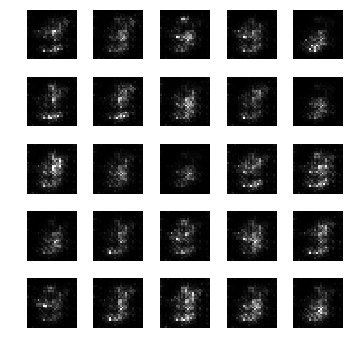

epoch: 1601, time: 4.909343 | train_G_Loss: 0.694427, train_D_loss: 1.383832, train_acc: 0.109091
cv_G_Loss: 0.683331, cv_D_loss: 4.369517, cv_acc: 0.102800

epoch: 1602, time: 4.891633 | train_G_Loss: 0.687574, train_D_loss: 1.389732, train_acc: 0.105455
cv_G_Loss: 0.993743, cv_D_loss: 4.715391, cv_acc: 0.103200

epoch: 1603, time: 4.913030 | train_G_Loss: 0.699231, train_D_loss: 1.379217, train_acc: 0.143636
cv_G_Loss: 1.059449, cv_D_loss: 4.826964, cv_acc: 0.098000

epoch: 1604, time: 4.899241 | train_G_Loss: 0.691233, train_D_loss: 1.389468, train_acc: 0.120000
cv_G_Loss: 0.732073, cv_D_loss: 4.464322, cv_acc: 0.102900

epoch: 1605, time: 4.871077 | train_G_Loss: 0.695734, train_D_loss: 1.385569, train_acc: 0.158182
cv_G_Loss: 0.742694, cv_D_loss: 4.448613, cv_acc: 0.141600

epoch: 1606, time: 4.885569 | train_G_Loss: 0.686897, train_D_loss: 1.393313, train_acc: 0.116364
cv_G_Loss: 0.842740, cv_D_loss: 4.541247, cv_acc: 0.107100

epoch: 1607, time: 4.878809 | train_G_Loss: 0.690468

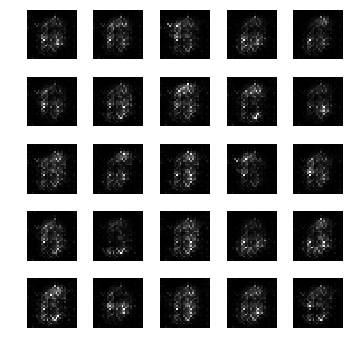

epoch: 1611, time: 4.908110 | train_G_Loss: 0.689262, train_D_loss: 1.380404, train_acc: 0.096364
cv_G_Loss: 0.746954, cv_D_loss: 4.470008, cv_acc: 0.101400

epoch: 1612, time: 4.884995 | train_G_Loss: 0.690878, train_D_loss: 1.383345, train_acc: 0.096364
cv_G_Loss: 0.763037, cv_D_loss: 4.430300, cv_acc: 0.101000

epoch: 1613, time: 4.892007 | train_G_Loss: 0.692025, train_D_loss: 1.385550, train_acc: 0.096364
cv_G_Loss: 0.687713, cv_D_loss: 4.387675, cv_acc: 0.101000

epoch: 1614, time: 4.887272 | train_G_Loss: 0.688570, train_D_loss: 1.393664, train_acc: 0.096364
cv_G_Loss: 0.667430, cv_D_loss: 4.368919, cv_acc: 0.101000

epoch: 1615, time: 4.889540 | train_G_Loss: 0.693407, train_D_loss: 1.387828, train_acc: 0.096364
cv_G_Loss: 0.802947, cv_D_loss: 4.486692, cv_acc: 0.101000

epoch: 1616, time: 4.881136 | train_G_Loss: 0.695519, train_D_loss: 1.381154, train_acc: 0.096364
cv_G_Loss: 0.770373, cv_D_loss: 4.440528, cv_acc: 0.098000

epoch: 1617, time: 4.869275 | train_G_Loss: 0.694340

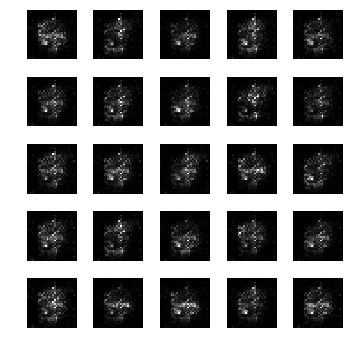

epoch: 1621, time: 4.917356 | train_G_Loss: 0.699225, train_D_loss: 1.369373, train_acc: 0.105455
cv_G_Loss: 0.668815, cv_D_loss: 4.361717, cv_acc: 0.103200

epoch: 1622, time: 4.890522 | train_G_Loss: 0.693071, train_D_loss: 1.381429, train_acc: 0.105455
cv_G_Loss: 0.715245, cv_D_loss: 4.417834, cv_acc: 0.103200

epoch: 1623, time: 4.882639 | train_G_Loss: 0.694653, train_D_loss: 1.379591, train_acc: 0.109091
cv_G_Loss: 0.886421, cv_D_loss: 4.574468, cv_acc: 0.109700

epoch: 1624, time: 4.887559 | train_G_Loss: 0.687805, train_D_loss: 1.390292, train_acc: 0.114545
cv_G_Loss: 0.564513, cv_D_loss: 4.294692, cv_acc: 0.098000

epoch: 1625, time: 4.883317 | train_G_Loss: 0.693902, train_D_loss: 1.387306, train_acc: 0.110909
cv_G_Loss: 0.778171, cv_D_loss: 4.484196, cv_acc: 0.113800

epoch: 1626, time: 4.910958 | train_G_Loss: 0.691189, train_D_loss: 1.387813, train_acc: 0.181818
cv_G_Loss: 0.694431, cv_D_loss: 4.384838, cv_acc: 0.185700

epoch: 1627, time: 4.908208 | train_G_Loss: 0.694836

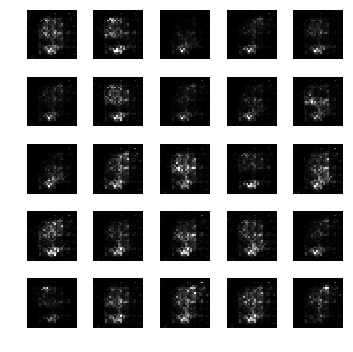

epoch: 1631, time: 4.903282 | train_G_Loss: 0.690744, train_D_loss: 1.389073, train_acc: 0.121818
cv_G_Loss: 0.810161, cv_D_loss: 4.513721, cv_acc: 0.122400

epoch: 1632, time: 4.892036 | train_G_Loss: 0.695786, train_D_loss: 1.381289, train_acc: 0.100000
cv_G_Loss: 0.622825, cv_D_loss: 4.315795, cv_acc: 0.098200

epoch: 1633, time: 4.881455 | train_G_Loss: 0.694593, train_D_loss: 1.381228, train_acc: 0.100000
cv_G_Loss: 0.657851, cv_D_loss: 4.330211, cv_acc: 0.098200

epoch: 1634, time: 4.877274 | train_G_Loss: 0.697573, train_D_loss: 1.377648, train_acc: 0.149091
cv_G_Loss: 0.688257, cv_D_loss: 4.342003, cv_acc: 0.188200

epoch: 1635, time: 4.864557 | train_G_Loss: 0.694398, train_D_loss: 1.381132, train_acc: 0.163636
cv_G_Loss: 0.754272, cv_D_loss: 4.429790, cv_acc: 0.152900

epoch: 1636, time: 4.880615 | train_G_Loss: 0.695831, train_D_loss: 1.385768, train_acc: 0.136364
cv_G_Loss: 0.705503, cv_D_loss: 4.396642, cv_acc: 0.195400

epoch: 1637, time: 4.885942 | train_G_Loss: 0.701798

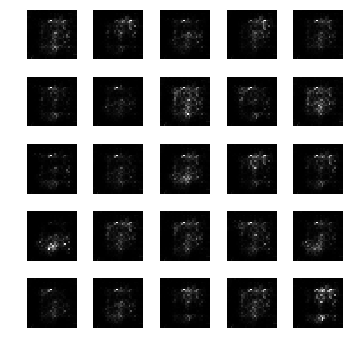

epoch: 1641, time: 4.890646 | train_G_Loss: 0.696131, train_D_loss: 1.376846, train_acc: 0.087273
cv_G_Loss: 0.756782, cv_D_loss: 4.424925, cv_acc: 0.086600

epoch: 1642, time: 4.884063 | train_G_Loss: 0.695426, train_D_loss: 1.379581, train_acc: 0.096364
cv_G_Loss: 0.652043, cv_D_loss: 4.312517, cv_acc: 0.099300

epoch: 1643, time: 4.879610 | train_G_Loss: 0.696142, train_D_loss: 1.383363, train_acc: 0.236364
cv_G_Loss: 0.762102, cv_D_loss: 4.415999, cv_acc: 0.105600

epoch: 1644, time: 4.882807 | train_G_Loss: 0.695270, train_D_loss: 1.383094, train_acc: 0.150909
cv_G_Loss: 0.749232, cv_D_loss: 4.395427, cv_acc: 0.107000

epoch: 1645, time: 4.890183 | train_G_Loss: 0.698616, train_D_loss: 1.379183, train_acc: 0.176364
cv_G_Loss: 0.738454, cv_D_loss: 4.398107, cv_acc: 0.151500

epoch: 1646, time: 4.888518 | train_G_Loss: 0.695377, train_D_loss: 1.381892, train_acc: 0.141818
cv_G_Loss: 0.983133, cv_D_loss: 4.704176, cv_acc: 0.186500

epoch: 1647, time: 4.874349 | train_G_Loss: 0.693932

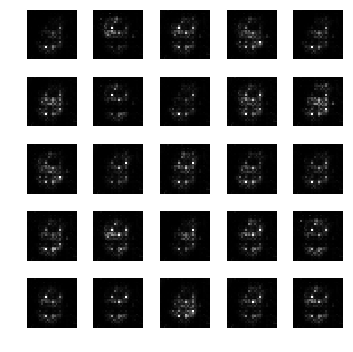

epoch: 1651, time: 4.927932 | train_G_Loss: 0.699504, train_D_loss: 1.380133, train_acc: 0.190909
cv_G_Loss: 0.642540, cv_D_loss: 4.291134, cv_acc: 0.167500

epoch: 1652, time: 4.893648 | train_G_Loss: 0.696029, train_D_loss: 1.382268, train_acc: 0.150909
cv_G_Loss: 0.743855, cv_D_loss: 4.427086, cv_acc: 0.095900

epoch: 1653, time: 4.886917 | train_G_Loss: 0.694050, train_D_loss: 1.384947, train_acc: 0.110909
cv_G_Loss: 0.685812, cv_D_loss: 4.363067, cv_acc: 0.095800

epoch: 1654, time: 4.880440 | train_G_Loss: 0.690337, train_D_loss: 1.393447, train_acc: 0.098182
cv_G_Loss: 0.629069, cv_D_loss: 4.370283, cv_acc: 0.101700

epoch: 1655, time: 4.884950 | train_G_Loss: 0.695162, train_D_loss: 1.386538, train_acc: 0.098182
cv_G_Loss: 0.706072, cv_D_loss: 4.443021, cv_acc: 0.100900

epoch: 1656, time: 4.882302 | train_G_Loss: 0.694187, train_D_loss: 1.385576, train_acc: 0.123636
cv_G_Loss: 0.706291, cv_D_loss: 4.390225, cv_acc: 0.131100

epoch: 1657, time: 4.890045 | train_G_Loss: 0.695780

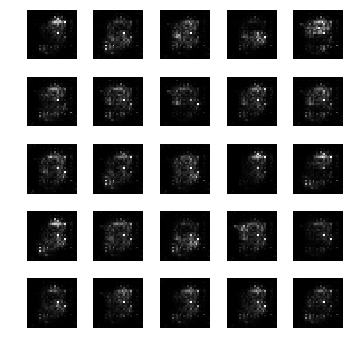

epoch: 1661, time: 4.912662 | train_G_Loss: 0.695581, train_D_loss: 1.384465, train_acc: 0.112727
cv_G_Loss: 0.746616, cv_D_loss: 4.465575, cv_acc: 0.113500

epoch: 1662, time: 4.882188 | train_G_Loss: 0.691830, train_D_loss: 1.385102, train_acc: 0.203636
cv_G_Loss: 0.713913, cv_D_loss: 4.414237, cv_acc: 0.204800

epoch: 1663, time: 4.892452 | train_G_Loss: 0.695480, train_D_loss: 1.386119, train_acc: 0.100000
cv_G_Loss: 0.964773, cv_D_loss: 4.738815, cv_acc: 0.098200

epoch: 1664, time: 4.896779 | train_G_Loss: 0.691480, train_D_loss: 1.380091, train_acc: 0.100000
cv_G_Loss: 0.598730, cv_D_loss: 4.305986, cv_acc: 0.098200

epoch: 1665, time: 4.876364 | train_G_Loss: 0.698062, train_D_loss: 1.382778, train_acc: 0.100000
cv_G_Loss: 0.759675, cv_D_loss: 4.407185, cv_acc: 0.098300

epoch: 1666, time: 4.878338 | train_G_Loss: 0.694953, train_D_loss: 1.384620, train_acc: 0.203636
cv_G_Loss: 0.820005, cv_D_loss: 4.522268, cv_acc: 0.196100

epoch: 1667, time: 4.876370 | train_G_Loss: 0.695117

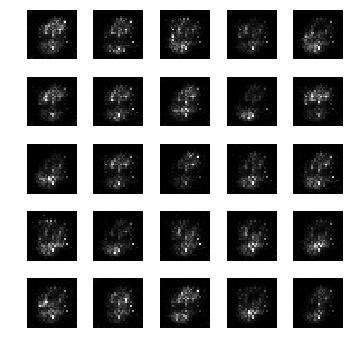

epoch: 1671, time: 4.919416 | train_G_Loss: 0.698006, train_D_loss: 1.379648, train_acc: 0.125455
cv_G_Loss: 0.787957, cv_D_loss: 4.481352, cv_acc: 0.161200

epoch: 1672, time: 5.029965 | train_G_Loss: 0.689248, train_D_loss: 1.394362, train_acc: 0.112727
cv_G_Loss: 0.763018, cv_D_loss: 4.442487, cv_acc: 0.104000

epoch: 1673, time: 4.898135 | train_G_Loss: 0.689329, train_D_loss: 1.391793, train_acc: 0.147273
cv_G_Loss: 0.689515, cv_D_loss: 4.334079, cv_acc: 0.198600

epoch: 1674, time: 4.889550 | train_G_Loss: 0.692111, train_D_loss: 1.391208, train_acc: 0.107273
cv_G_Loss: 0.735105, cv_D_loss: 4.419766, cv_acc: 0.113500

epoch: 1675, time: 4.890556 | train_G_Loss: 0.692176, train_D_loss: 1.388016, train_acc: 0.198182
cv_G_Loss: 0.773283, cv_D_loss: 4.435459, cv_acc: 0.207500

epoch: 1676, time: 4.884242 | train_G_Loss: 0.693421, train_D_loss: 1.387945, train_acc: 0.152727
cv_G_Loss: 0.706162, cv_D_loss: 4.374171, cv_acc: 0.157800

epoch: 1677, time: 4.876557 | train_G_Loss: 0.686338

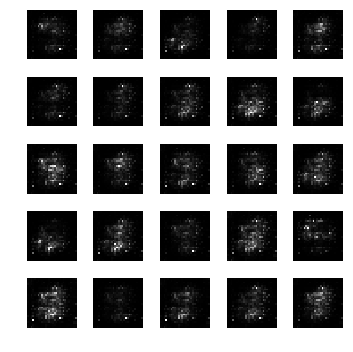

epoch: 1681, time: 4.919215 | train_G_Loss: 0.697654, train_D_loss: 1.372416, train_acc: 0.116364
cv_G_Loss: 0.703910, cv_D_loss: 4.349837, cv_acc: 0.126800

epoch: 1682, time: 4.877406 | train_G_Loss: 0.693503, train_D_loss: 1.378737, train_acc: 0.165455
cv_G_Loss: 0.686659, cv_D_loss: 4.316376, cv_acc: 0.192000

epoch: 1683, time: 4.892226 | train_G_Loss: 0.693618, train_D_loss: 1.382297, train_acc: 0.132727
cv_G_Loss: 0.814324, cv_D_loss: 4.483959, cv_acc: 0.101100

epoch: 1684, time: 4.888273 | train_G_Loss: 0.692830, train_D_loss: 1.384651, train_acc: 0.096364
cv_G_Loss: 0.790448, cv_D_loss: 4.479771, cv_acc: 0.100500

epoch: 1685, time: 4.880325 | train_G_Loss: 0.693826, train_D_loss: 1.383903, train_acc: 0.214545
cv_G_Loss: 0.732629, cv_D_loss: 4.391234, cv_acc: 0.243900

epoch: 1686, time: 4.882792 | train_G_Loss: 0.696013, train_D_loss: 1.380352, train_acc: 0.161818
cv_G_Loss: 0.833044, cv_D_loss: 4.509450, cv_acc: 0.139100

epoch: 1687, time: 4.888786 | train_G_Loss: 0.689892

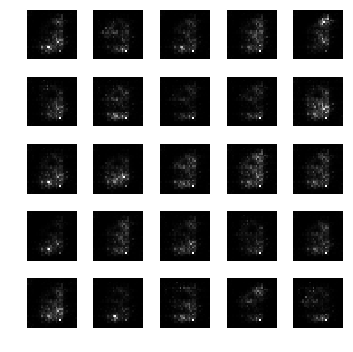

epoch: 1691, time: 4.900126 | train_G_Loss: 0.692816, train_D_loss: 1.383808, train_acc: 0.087273
cv_G_Loss: 0.712647, cv_D_loss: 4.383229, cv_acc: 0.090100

epoch: 1692, time: 4.890765 | train_G_Loss: 0.692363, train_D_loss: 1.392427, train_acc: 0.087273
cv_G_Loss: 0.800022, cv_D_loss: 4.507122, cv_acc: 0.089200

epoch: 1693, time: 4.875287 | train_G_Loss: 0.695234, train_D_loss: 1.383381, train_acc: 0.180000
cv_G_Loss: 0.838663, cv_D_loss: 4.529601, cv_acc: 0.178200

epoch: 1694, time: 4.880079 | train_G_Loss: 0.695603, train_D_loss: 1.380072, train_acc: 0.205455
cv_G_Loss: 0.687994, cv_D_loss: 4.347663, cv_acc: 0.169200

epoch: 1695, time: 4.922114 | train_G_Loss: 0.697668, train_D_loss: 1.379151, train_acc: 0.189091
cv_G_Loss: 0.722346, cv_D_loss: 4.414846, cv_acc: 0.157300

epoch: 1696, time: 4.895435 | train_G_Loss: 0.699369, train_D_loss: 1.377598, train_acc: 0.170909
cv_G_Loss: 0.865087, cv_D_loss: 4.545182, cv_acc: 0.098400

epoch: 1697, time: 4.887176 | train_G_Loss: 0.695488

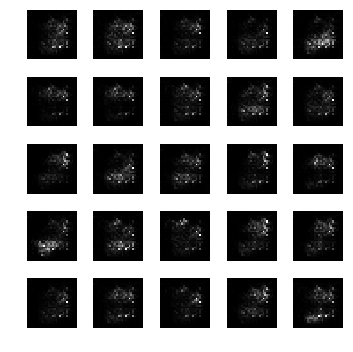

epoch: 1701, time: 4.908313 | train_G_Loss: 0.698450, train_D_loss: 1.382605, train_acc: 0.165455
cv_G_Loss: 0.706184, cv_D_loss: 4.370750, cv_acc: 0.101000

epoch: 1702, time: 4.879328 | train_G_Loss: 0.694815, train_D_loss: 1.386379, train_acc: 0.114545
cv_G_Loss: 0.988004, cv_D_loss: 4.748503, cv_acc: 0.218500

epoch: 1703, time: 4.889010 | train_G_Loss: 0.696456, train_D_loss: 1.380284, train_acc: 0.109091
cv_G_Loss: 0.890783, cv_D_loss: 4.707491, cv_acc: 0.102800

epoch: 1704, time: 4.881304 | train_G_Loss: 0.697724, train_D_loss: 1.379413, train_acc: 0.109091
cv_G_Loss: 0.890059, cv_D_loss: 4.655322, cv_acc: 0.176200

epoch: 1705, time: 4.876082 | train_G_Loss: 0.689437, train_D_loss: 1.396900, train_acc: 0.129091
cv_G_Loss: 0.540263, cv_D_loss: 4.301830, cv_acc: 0.174100

epoch: 1706, time: 4.882845 | train_G_Loss: 0.697047, train_D_loss: 1.381974, train_acc: 0.147273
cv_G_Loss: 0.652681, cv_D_loss: 4.302720, cv_acc: 0.141300

epoch: 1707, time: 4.888220 | train_G_Loss: 0.696312

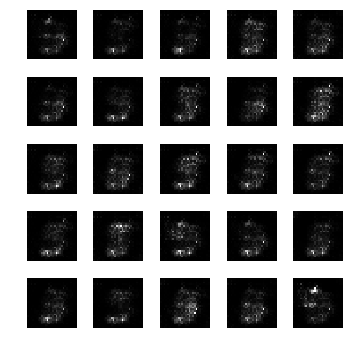

epoch: 1711, time: 4.905273 | train_G_Loss: 0.698648, train_D_loss: 1.377602, train_acc: 0.096364
cv_G_Loss: 0.914184, cv_D_loss: 4.630190, cv_acc: 0.098000

epoch: 1712, time: 4.885591 | train_G_Loss: 0.698067, train_D_loss: 1.373661, train_acc: 0.096364
cv_G_Loss: 0.736555, cv_D_loss: 4.388783, cv_acc: 0.098200

epoch: 1713, time: 4.887715 | train_G_Loss: 0.696185, train_D_loss: 1.378456, train_acc: 0.172727
cv_G_Loss: 0.646386, cv_D_loss: 4.282151, cv_acc: 0.201800

epoch: 1714, time: 4.886477 | train_G_Loss: 0.703319, train_D_loss: 1.375591, train_acc: 0.107273
cv_G_Loss: 0.982956, cv_D_loss: 4.699395, cv_acc: 0.113500

epoch: 1715, time: 4.883733 | train_G_Loss: 0.694141, train_D_loss: 1.380685, train_acc: 0.180000
cv_G_Loss: 0.711162, cv_D_loss: 4.401171, cv_acc: 0.175600

epoch: 1716, time: 4.865777 | train_G_Loss: 0.697546, train_D_loss: 1.386804, train_acc: 0.105455
cv_G_Loss: 0.893932, cv_D_loss: 4.625543, cv_acc: 0.098400

epoch: 1717, time: 4.905684 | train_G_Loss: 0.695102

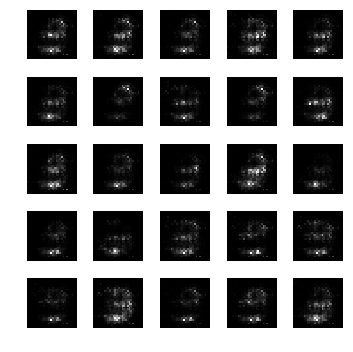

epoch: 1721, time: 4.919038 | train_G_Loss: 0.690878, train_D_loss: 1.383848, train_acc: 0.138182
cv_G_Loss: 0.536465, cv_D_loss: 4.257654, cv_acc: 0.101200

epoch: 1722, time: 4.888507 | train_G_Loss: 0.694524, train_D_loss: 1.381344, train_acc: 0.089091
cv_G_Loss: 0.662906, cv_D_loss: 4.413315, cv_acc: 0.097400

epoch: 1723, time: 4.902284 | train_G_Loss: 0.692520, train_D_loss: 1.387986, train_acc: 0.089091
cv_G_Loss: 0.669648, cv_D_loss: 4.387484, cv_acc: 0.097800

epoch: 1724, time: 4.888228 | train_G_Loss: 0.688988, train_D_loss: 1.389155, train_acc: 0.101818
cv_G_Loss: 0.748206, cv_D_loss: 4.429509, cv_acc: 0.098100

epoch: 1725, time: 4.889189 | train_G_Loss: 0.689952, train_D_loss: 1.385166, train_acc: 0.107273
cv_G_Loss: 0.696051, cv_D_loss: 4.353610, cv_acc: 0.220000

epoch: 1726, time: 4.886861 | train_G_Loss: 0.700657, train_D_loss: 1.381858, train_acc: 0.145455
cv_G_Loss: 0.618061, cv_D_loss: 4.262432, cv_acc: 0.113800

epoch: 1727, time: 4.876041 | train_G_Loss: 0.692504

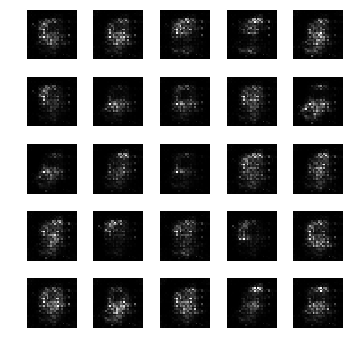

epoch: 1731, time: 4.919727 | train_G_Loss: 0.699306, train_D_loss: 1.377221, train_acc: 0.167273
cv_G_Loss: 0.803669, cv_D_loss: 4.499784, cv_acc: 0.178400

epoch: 1732, time: 4.884524 | train_G_Loss: 0.703580, train_D_loss: 1.376431, train_acc: 0.096364
cv_G_Loss: 0.791206, cv_D_loss: 4.479482, cv_acc: 0.098000

epoch: 1733, time: 4.890996 | train_G_Loss: 0.684606, train_D_loss: 1.400286, train_acc: 0.127273
cv_G_Loss: 0.560440, cv_D_loss: 4.245178, cv_acc: 0.098000

epoch: 1734, time: 4.890636 | train_G_Loss: 0.696898, train_D_loss: 1.380713, train_acc: 0.098182
cv_G_Loss: 0.775893, cv_D_loss: 4.479602, cv_acc: 0.111500

epoch: 1735, time: 4.890160 | train_G_Loss: 0.694783, train_D_loss: 1.382024, train_acc: 0.165455
cv_G_Loss: 0.696106, cv_D_loss: 4.384190, cv_acc: 0.156900

epoch: 1736, time: 4.886555 | train_G_Loss: 0.699187, train_D_loss: 1.377999, train_acc: 0.198182
cv_G_Loss: 0.659992, cv_D_loss: 4.365758, cv_acc: 0.133200

epoch: 1737, time: 4.889368 | train_G_Loss: 0.695327

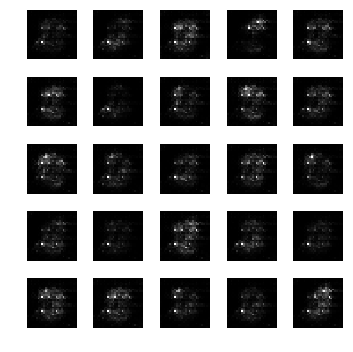

epoch: 1741, time: 4.966267 | train_G_Loss: 0.695412, train_D_loss: 1.383168, train_acc: 0.143636
cv_G_Loss: 0.756820, cv_D_loss: 4.420785, cv_acc: 0.200900

epoch: 1742, time: 4.900964 | train_G_Loss: 0.696507, train_D_loss: 1.383150, train_acc: 0.200000
cv_G_Loss: 0.879244, cv_D_loss: 4.583946, cv_acc: 0.203500

epoch: 1743, time: 4.878309 | train_G_Loss: 0.694373, train_D_loss: 1.382573, train_acc: 0.125455
cv_G_Loss: 0.751093, cv_D_loss: 4.439723, cv_acc: 0.132100

epoch: 1744, time: 4.902813 | train_G_Loss: 0.698105, train_D_loss: 1.375007, train_acc: 0.143636
cv_G_Loss: 0.800282, cv_D_loss: 4.471248, cv_acc: 0.214400

epoch: 1745, time: 4.887083 | train_G_Loss: 0.695414, train_D_loss: 1.379521, train_acc: 0.110909
cv_G_Loss: 0.874495, cv_D_loss: 4.565733, cv_acc: 0.112600

epoch: 1746, time: 4.887626 | train_G_Loss: 0.698121, train_D_loss: 1.376626, train_acc: 0.156364
cv_G_Loss: 0.652994, cv_D_loss: 4.319583, cv_acc: 0.136400

epoch: 1747, time: 4.886884 | train_G_Loss: 0.697283

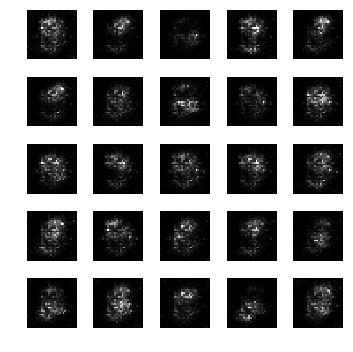

epoch: 1751, time: 4.911469 | train_G_Loss: 0.690492, train_D_loss: 1.392662, train_acc: 0.172727
cv_G_Loss: 0.739744, cv_D_loss: 4.435375, cv_acc: 0.162800

epoch: 1752, time: 4.875559 | train_G_Loss: 0.694260, train_D_loss: 1.387798, train_acc: 0.089091
cv_G_Loss: 0.854035, cv_D_loss: 4.609613, cv_acc: 0.097400

epoch: 1753, time: 4.877692 | train_G_Loss: 0.694521, train_D_loss: 1.382439, train_acc: 0.098182
cv_G_Loss: 0.646054, cv_D_loss: 4.389747, cv_acc: 0.102800

epoch: 1754, time: 4.889049 | train_G_Loss: 0.692160, train_D_loss: 1.385991, train_acc: 0.129091
cv_G_Loss: 0.749288, cv_D_loss: 4.466768, cv_acc: 0.123700

epoch: 1755, time: 4.875513 | train_G_Loss: 0.697105, train_D_loss: 1.378793, train_acc: 0.107273
cv_G_Loss: 0.748180, cv_D_loss: 4.466056, cv_acc: 0.100500

epoch: 1756, time: 4.879766 | train_G_Loss: 0.694591, train_D_loss: 1.382049, train_acc: 0.169091
cv_G_Loss: 0.835740, cv_D_loss: 4.550294, cv_acc: 0.153100

epoch: 1757, time: 4.875242 | train_G_Loss: 0.690894

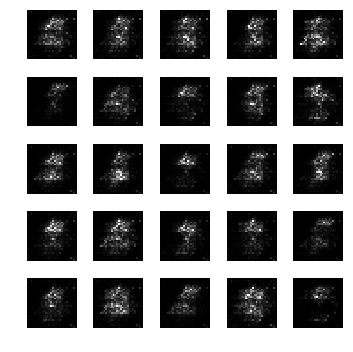

epoch: 1761, time: 4.927524 | train_G_Loss: 0.696849, train_D_loss: 1.382956, train_acc: 0.100000
cv_G_Loss: 0.765403, cv_D_loss: 4.459774, cv_acc: 0.098300

epoch: 1762, time: 4.889727 | train_G_Loss: 0.694989, train_D_loss: 1.386794, train_acc: 0.125455
cv_G_Loss: 0.718606, cv_D_loss: 4.395814, cv_acc: 0.174000

epoch: 1763, time: 4.871408 | train_G_Loss: 0.697239, train_D_loss: 1.379838, train_acc: 0.118182
cv_G_Loss: 0.690288, cv_D_loss: 4.394109, cv_acc: 0.140500

epoch: 1764, time: 4.931331 | train_G_Loss: 0.693921, train_D_loss: 1.385067, train_acc: 0.107273
cv_G_Loss: 0.776000, cv_D_loss: 4.438772, cv_acc: 0.113500

epoch: 1765, time: 4.885474 | train_G_Loss: 0.693187, train_D_loss: 1.388120, train_acc: 0.107273
cv_G_Loss: 0.651776, cv_D_loss: 4.306312, cv_acc: 0.116700

epoch: 1766, time: 4.886231 | train_G_Loss: 0.692343, train_D_loss: 1.384552, train_acc: 0.089091
cv_G_Loss: 0.719630, cv_D_loss: 4.383828, cv_acc: 0.097400

epoch: 1767, time: 4.888432 | train_G_Loss: 0.693458

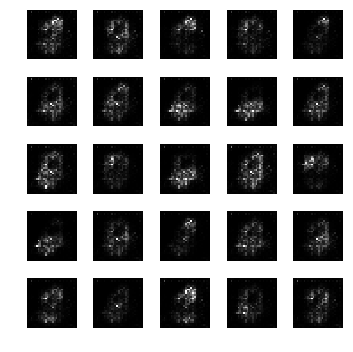

epoch: 1771, time: 4.913588 | train_G_Loss: 0.689547, train_D_loss: 1.384096, train_acc: 0.096364
cv_G_Loss: 0.701479, cv_D_loss: 4.376208, cv_acc: 0.098000

epoch: 1772, time: 4.892681 | train_G_Loss: 0.696190, train_D_loss: 1.384084, train_acc: 0.096364
cv_G_Loss: 0.625306, cv_D_loss: 4.278273, cv_acc: 0.098900

epoch: 1773, time: 4.882392 | train_G_Loss: 0.691582, train_D_loss: 1.385846, train_acc: 0.230909
cv_G_Loss: 0.738331, cv_D_loss: 4.416156, cv_acc: 0.201900

epoch: 1774, time: 4.881450 | train_G_Loss: 0.695905, train_D_loss: 1.382206, train_acc: 0.130909
cv_G_Loss: 0.749442, cv_D_loss: 4.454906, cv_acc: 0.136900

epoch: 1775, time: 4.890212 | train_G_Loss: 0.686983, train_D_loss: 1.394436, train_acc: 0.152727
cv_G_Loss: 0.667783, cv_D_loss: 4.334698, cv_acc: 0.119500

epoch: 1776, time: 4.883008 | train_G_Loss: 0.696315, train_D_loss: 1.374412, train_acc: 0.096364
cv_G_Loss: 0.794438, cv_D_loss: 4.491111, cv_acc: 0.101000

epoch: 1777, time: 4.910002 | train_G_Loss: 0.695033

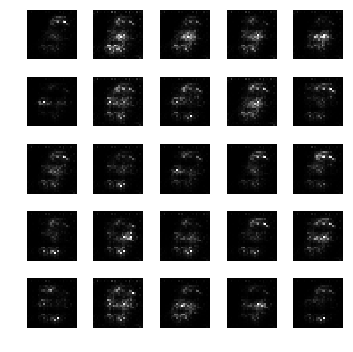

epoch: 1781, time: 4.920786 | train_G_Loss: 0.699081, train_D_loss: 1.377675, train_acc: 0.220000
cv_G_Loss: 0.687567, cv_D_loss: 4.360154, cv_acc: 0.253700

epoch: 1782, time: 4.885607 | train_G_Loss: 0.696580, train_D_loss: 1.378969, train_acc: 0.189091
cv_G_Loss: 0.680828, cv_D_loss: 4.334448, cv_acc: 0.207400

epoch: 1783, time: 4.881603 | train_G_Loss: 0.696885, train_D_loss: 1.375077, train_acc: 0.205455
cv_G_Loss: 0.637197, cv_D_loss: 4.273364, cv_acc: 0.141700

epoch: 1784, time: 4.883001 | train_G_Loss: 0.693055, train_D_loss: 1.390238, train_acc: 0.110909
cv_G_Loss: 0.719671, cv_D_loss: 4.453419, cv_acc: 0.095800

epoch: 1785, time: 4.882884 | train_G_Loss: 0.693143, train_D_loss: 1.386568, train_acc: 0.187273
cv_G_Loss: 0.664934, cv_D_loss: 4.367529, cv_acc: 0.142100

epoch: 1786, time: 4.893521 | train_G_Loss: 0.694742, train_D_loss: 1.384788, train_acc: 0.152727
cv_G_Loss: 0.681031, cv_D_loss: 4.395099, cv_acc: 0.135200

epoch: 1787, time: 4.931159 | train_G_Loss: 0.697702

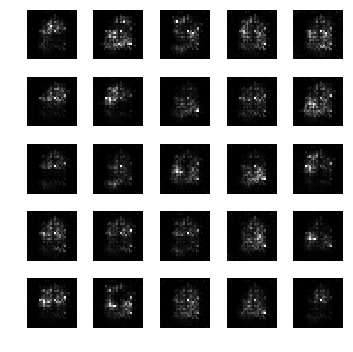

epoch: 1791, time: 4.907258 | train_G_Loss: 0.693033, train_D_loss: 1.387856, train_acc: 0.107273
cv_G_Loss: 0.815679, cv_D_loss: 4.541777, cv_acc: 0.113500

epoch: 1792, time: 4.883353 | train_G_Loss: 0.693037, train_D_loss: 1.390476, train_acc: 0.107273
cv_G_Loss: 0.606482, cv_D_loss: 4.314592, cv_acc: 0.113500

epoch: 1793, time: 4.881162 | train_G_Loss: 0.699451, train_D_loss: 1.381707, train_acc: 0.110909
cv_G_Loss: 0.776024, cv_D_loss: 4.494789, cv_acc: 0.095800

epoch: 1794, time: 4.877073 | train_G_Loss: 0.683774, train_D_loss: 1.391397, train_acc: 0.110909
cv_G_Loss: 0.654431, cv_D_loss: 4.378996, cv_acc: 0.095800

epoch: 1795, time: 4.896891 | train_G_Loss: 0.692616, train_D_loss: 1.385886, train_acc: 0.187273
cv_G_Loss: 0.699769, cv_D_loss: 4.427940, cv_acc: 0.107300

epoch: 1796, time: 4.889503 | train_G_Loss: 0.693017, train_D_loss: 1.383835, train_acc: 0.218182
cv_G_Loss: 0.770868, cv_D_loss: 4.482820, cv_acc: 0.200800

epoch: 1797, time: 4.884120 | train_G_Loss: 0.693488

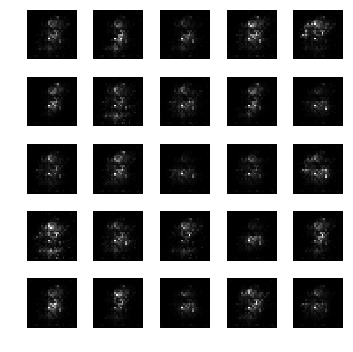

epoch: 1801, time: 4.916360 | train_G_Loss: 0.694576, train_D_loss: 1.379357, train_acc: 0.225455
cv_G_Loss: 0.731005, cv_D_loss: 4.381899, cv_acc: 0.178700

epoch: 1802, time: 4.890577 | train_G_Loss: 0.692564, train_D_loss: 1.380137, train_acc: 0.110909
cv_G_Loss: 0.614987, cv_D_loss: 4.291414, cv_acc: 0.095800

epoch: 1803, time: 4.886476 | train_G_Loss: 0.694250, train_D_loss: 1.380931, train_acc: 0.110909
cv_G_Loss: 0.685248, cv_D_loss: 4.380267, cv_acc: 0.095800

epoch: 1804, time: 4.919326 | train_G_Loss: 0.697674, train_D_loss: 1.379447, train_acc: 0.152727
cv_G_Loss: 0.803066, cv_D_loss: 4.521130, cv_acc: 0.135900

epoch: 1805, time: 4.871627 | train_G_Loss: 0.697365, train_D_loss: 1.379956, train_acc: 0.114545
cv_G_Loss: 0.687261, cv_D_loss: 4.380971, cv_acc: 0.109100

epoch: 1806, time: 4.887136 | train_G_Loss: 0.694710, train_D_loss: 1.385795, train_acc: 0.163636
cv_G_Loss: 0.777626, cv_D_loss: 4.499225, cv_acc: 0.171800

epoch: 1807, time: 4.887414 | train_G_Loss: 0.699821

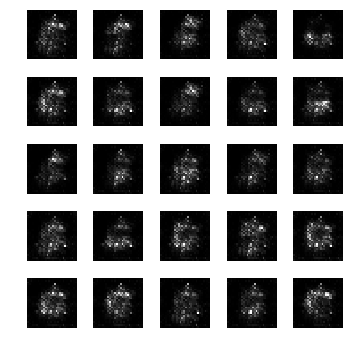

epoch: 1811, time: 4.919607 | train_G_Loss: 0.693932, train_D_loss: 1.384803, train_acc: 0.216364
cv_G_Loss: 0.738915, cv_D_loss: 4.410288, cv_acc: 0.170100

epoch: 1812, time: 4.884629 | train_G_Loss: 0.695950, train_D_loss: 1.378098, train_acc: 0.110909
cv_G_Loss: 0.742749, cv_D_loss: 4.405120, cv_acc: 0.095800

epoch: 1813, time: 4.893220 | train_G_Loss: 0.694594, train_D_loss: 1.382516, train_acc: 0.110909
cv_G_Loss: 0.764164, cv_D_loss: 4.423929, cv_acc: 0.095800

epoch: 1814, time: 4.885869 | train_G_Loss: 0.696686, train_D_loss: 1.379885, train_acc: 0.110909
cv_G_Loss: 0.788713, cv_D_loss: 4.519725, cv_acc: 0.095800

epoch: 1815, time: 4.887021 | train_G_Loss: 0.687409, train_D_loss: 1.384719, train_acc: 0.110909
cv_G_Loss: 0.561300, cv_D_loss: 4.274199, cv_acc: 0.095800

epoch: 1816, time: 4.872204 | train_G_Loss: 0.694902, train_D_loss: 1.378557, train_acc: 0.132727
cv_G_Loss: 0.685122, cv_D_loss: 4.322737, cv_acc: 0.128500

epoch: 1817, time: 4.876141 | train_G_Loss: 0.700051

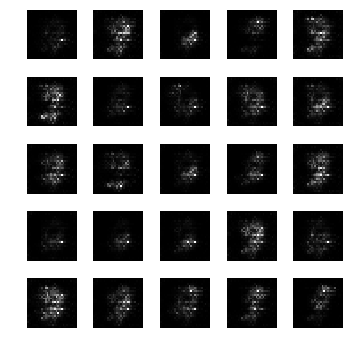

epoch: 1821, time: 4.914977 | train_G_Loss: 0.695560, train_D_loss: 1.382193, train_acc: 0.187273
cv_G_Loss: 0.710241, cv_D_loss: 4.377045, cv_acc: 0.214900

epoch: 1822, time: 4.895545 | train_G_Loss: 0.692024, train_D_loss: 1.387420, train_acc: 0.110909
cv_G_Loss: 0.569100, cv_D_loss: 4.261535, cv_acc: 0.095800

epoch: 1823, time: 4.892108 | train_G_Loss: 0.694816, train_D_loss: 1.382521, train_acc: 0.110909
cv_G_Loss: 0.742621, cv_D_loss: 4.433858, cv_acc: 0.095800

epoch: 1824, time: 4.891197 | train_G_Loss: 0.690916, train_D_loss: 1.390609, train_acc: 0.110909
cv_G_Loss: 0.755323, cv_D_loss: 4.492583, cv_acc: 0.095800

epoch: 1825, time: 4.877121 | train_G_Loss: 0.693720, train_D_loss: 1.389377, train_acc: 0.110909
cv_G_Loss: 0.628475, cv_D_loss: 4.328403, cv_acc: 0.095800

epoch: 1826, time: 4.876584 | train_G_Loss: 0.694321, train_D_loss: 1.389568, train_acc: 0.149091
cv_G_Loss: 0.805233, cv_D_loss: 4.509715, cv_acc: 0.130900

epoch: 1827, time: 4.891148 | train_G_Loss: 0.695291

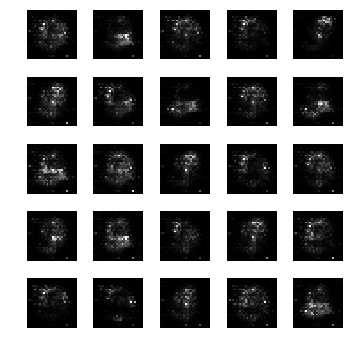

epoch: 1831, time: 4.915595 | train_G_Loss: 0.687115, train_D_loss: 1.394041, train_acc: 0.107273
cv_G_Loss: 0.866019, cv_D_loss: 4.614718, cv_acc: 0.127300

epoch: 1832, time: 4.895277 | train_G_Loss: 0.693527, train_D_loss: 1.386338, train_acc: 0.170909
cv_G_Loss: 0.908993, cv_D_loss: 4.676905, cv_acc: 0.151600

epoch: 1833, time: 4.941183 | train_G_Loss: 0.695557, train_D_loss: 1.390613, train_acc: 0.096364
cv_G_Loss: 0.681109, cv_D_loss: 4.357597, cv_acc: 0.101000

epoch: 1834, time: 4.891230 | train_G_Loss: 0.695602, train_D_loss: 1.385594, train_acc: 0.096364
cv_G_Loss: 0.671648, cv_D_loss: 4.334287, cv_acc: 0.148700

epoch: 1835, time: 4.895256 | train_G_Loss: 0.694239, train_D_loss: 1.383560, train_acc: 0.098182
cv_G_Loss: 0.680042, cv_D_loss: 4.339711, cv_acc: 0.106300

epoch: 1836, time: 4.891691 | train_G_Loss: 0.693759, train_D_loss: 1.383951, train_acc: 0.090909
cv_G_Loss: 0.685512, cv_D_loss: 4.354824, cv_acc: 0.088300

epoch: 1837, time: 4.889796 | train_G_Loss: 0.692350

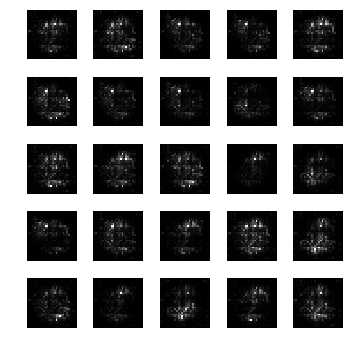

epoch: 1841, time: 4.921158 | train_G_Loss: 0.696901, train_D_loss: 1.379954, train_acc: 0.116364
cv_G_Loss: 0.701573, cv_D_loss: 4.403634, cv_acc: 0.089200

epoch: 1842, time: 4.887261 | train_G_Loss: 0.692490, train_D_loss: 1.385231, train_acc: 0.087273
cv_G_Loss: 0.749648, cv_D_loss: 4.459382, cv_acc: 0.089200

epoch: 1843, time: 4.896776 | train_G_Loss: 0.699181, train_D_loss: 1.376526, train_acc: 0.087273
cv_G_Loss: 0.755659, cv_D_loss: 4.457286, cv_acc: 0.089200

epoch: 1844, time: 4.888775 | train_G_Loss: 0.698238, train_D_loss: 1.379763, train_acc: 0.107273
cv_G_Loss: 0.797102, cv_D_loss: 4.496738, cv_acc: 0.103000

epoch: 1845, time: 4.888671 | train_G_Loss: 0.695076, train_D_loss: 1.382722, train_acc: 0.172727
cv_G_Loss: 0.790347, cv_D_loss: 4.475161, cv_acc: 0.150900

epoch: 1846, time: 4.880546 | train_G_Loss: 0.692064, train_D_loss: 1.384670, train_acc: 0.172727
cv_G_Loss: 0.664727, cv_D_loss: 4.374501, cv_acc: 0.143300

epoch: 1847, time: 4.951201 | train_G_Loss: 0.690304

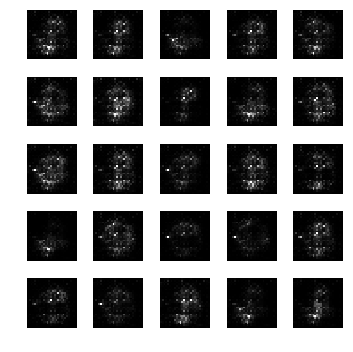

epoch: 1851, time: 4.903181 | train_G_Loss: 0.700698, train_D_loss: 1.381365, train_acc: 0.156364
cv_G_Loss: 0.588859, cv_D_loss: 4.260096, cv_acc: 0.173000

epoch: 1852, time: 4.894741 | train_G_Loss: 0.696165, train_D_loss: 1.381819, train_acc: 0.129091
cv_G_Loss: 0.712915, cv_D_loss: 4.382063, cv_acc: 0.175300

epoch: 1853, time: 4.889086 | train_G_Loss: 0.695060, train_D_loss: 1.378198, train_acc: 0.116364
cv_G_Loss: 0.714738, cv_D_loss: 4.410446, cv_acc: 0.187200

epoch: 1854, time: 4.893857 | train_G_Loss: 0.699304, train_D_loss: 1.376209, train_acc: 0.176364
cv_G_Loss: 0.731572, cv_D_loss: 4.446984, cv_acc: 0.202400

epoch: 1855, time: 4.888562 | train_G_Loss: 0.699597, train_D_loss: 1.375199, train_acc: 0.110909
cv_G_Loss: 0.780695, cv_D_loss: 4.470640, cv_acc: 0.096900

epoch: 1856, time: 4.920375 | train_G_Loss: 0.693154, train_D_loss: 1.384611, train_acc: 0.107273
cv_G_Loss: 0.776275, cv_D_loss: 4.461807, cv_acc: 0.113700

epoch: 1857, time: 4.893109 | train_G_Loss: 0.691444

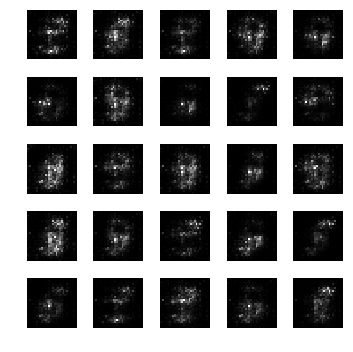

epoch: 1861, time: 4.906489 | train_G_Loss: 0.690175, train_D_loss: 1.388917, train_acc: 0.107273
cv_G_Loss: 0.667653, cv_D_loss: 4.327672, cv_acc: 0.113500

epoch: 1862, time: 4.886208 | train_G_Loss: 0.692416, train_D_loss: 1.387631, train_acc: 0.198182
cv_G_Loss: 0.734068, cv_D_loss: 4.420812, cv_acc: 0.203300

epoch: 1863, time: 4.879097 | train_G_Loss: 0.693383, train_D_loss: 1.386040, train_acc: 0.096364
cv_G_Loss: 0.662729, cv_D_loss: 4.337275, cv_acc: 0.121000

epoch: 1864, time: 4.870535 | train_G_Loss: 0.693728, train_D_loss: 1.389116, train_acc: 0.134545
cv_G_Loss: 0.696629, cv_D_loss: 4.392520, cv_acc: 0.121000

epoch: 1865, time: 4.873918 | train_G_Loss: 0.692445, train_D_loss: 1.389772, train_acc: 0.109091
cv_G_Loss: 0.634441, cv_D_loss: 4.313461, cv_acc: 0.157400

epoch: 1866, time: 4.884767 | train_G_Loss: 0.696029, train_D_loss: 1.383223, train_acc: 0.105455
cv_G_Loss: 0.679542, cv_D_loss: 4.391292, cv_acc: 0.140000

epoch: 1867, time: 4.883434 | train_G_Loss: 0.697033

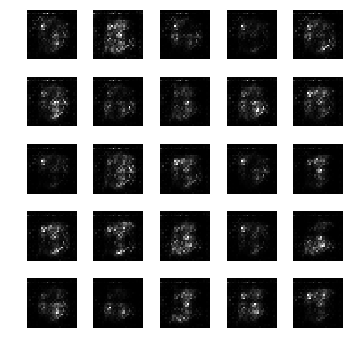

epoch: 1871, time: 4.906600 | train_G_Loss: 0.693988, train_D_loss: 1.386927, train_acc: 0.143636
cv_G_Loss: 0.638066, cv_D_loss: 4.335145, cv_acc: 0.220600

epoch: 1872, time: 4.893593 | train_G_Loss: 0.695605, train_D_loss: 1.377934, train_acc: 0.132727
cv_G_Loss: 0.648798, cv_D_loss: 4.316144, cv_acc: 0.162400

epoch: 1873, time: 4.884894 | train_G_Loss: 0.694135, train_D_loss: 1.382924, train_acc: 0.227273
cv_G_Loss: 0.822780, cv_D_loss: 4.484611, cv_acc: 0.208900

epoch: 1874, time: 4.882109 | train_G_Loss: 0.696118, train_D_loss: 1.379238, train_acc: 0.189091
cv_G_Loss: 1.032270, cv_D_loss: 4.827644, cv_acc: 0.166200

epoch: 1875, time: 4.876711 | train_G_Loss: 0.692386, train_D_loss: 1.383533, train_acc: 0.105455
cv_G_Loss: 0.606937, cv_D_loss: 4.308154, cv_acc: 0.134200

epoch: 1876, time: 4.888283 | train_G_Loss: 0.692719, train_D_loss: 1.388774, train_acc: 0.138182
cv_G_Loss: 0.800934, cv_D_loss: 4.475357, cv_acc: 0.165200

epoch: 1877, time: 4.892735 | train_G_Loss: 0.690203

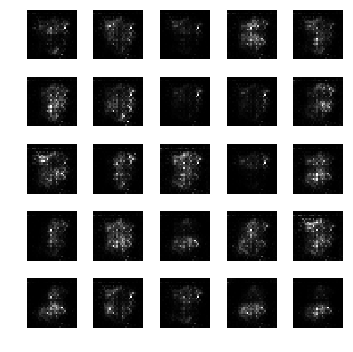

epoch: 1881, time: 4.919432 | train_G_Loss: 0.693410, train_D_loss: 1.383211, train_acc: 0.125455
cv_G_Loss: 0.596309, cv_D_loss: 4.246302, cv_acc: 0.125500

epoch: 1882, time: 4.887052 | train_G_Loss: 0.694016, train_D_loss: 1.386348, train_acc: 0.107273
cv_G_Loss: 0.635511, cv_D_loss: 4.330020, cv_acc: 0.113600

epoch: 1883, time: 4.885284 | train_G_Loss: 0.690657, train_D_loss: 1.386505, train_acc: 0.123636
cv_G_Loss: 0.640093, cv_D_loss: 4.337082, cv_acc: 0.118000

epoch: 1884, time: 4.888862 | train_G_Loss: 0.695444, train_D_loss: 1.382146, train_acc: 0.096364
cv_G_Loss: 0.732471, cv_D_loss: 4.403215, cv_acc: 0.101000

epoch: 1885, time: 4.875883 | train_G_Loss: 0.695904, train_D_loss: 1.383044, train_acc: 0.100000
cv_G_Loss: 0.702861, cv_D_loss: 4.380599, cv_acc: 0.101000

epoch: 1886, time: 4.880355 | train_G_Loss: 0.695497, train_D_loss: 1.381921, train_acc: 0.138182
cv_G_Loss: 0.677539, cv_D_loss: 4.335335, cv_acc: 0.128500

epoch: 1887, time: 4.881991 | train_G_Loss: 0.694173

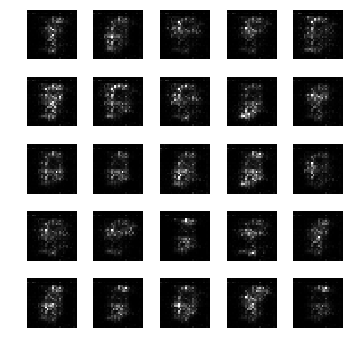

epoch: 1891, time: 4.909275 | train_G_Loss: 0.695930, train_D_loss: 1.388305, train_acc: 0.123636
cv_G_Loss: 0.744605, cv_D_loss: 4.425042, cv_acc: 0.122100

epoch: 1892, time: 4.885711 | train_G_Loss: 0.696963, train_D_loss: 1.385316, train_acc: 0.280000
cv_G_Loss: 0.721197, cv_D_loss: 4.391928, cv_acc: 0.302900
Model saved

epoch: 1893, time: 4.913783 | train_G_Loss: 0.692704, train_D_loss: 1.386319, train_acc: 0.243636
cv_G_Loss: 0.728100, cv_D_loss: 4.372340, cv_acc: 0.171200

epoch: 1894, time: 4.877133 | train_G_Loss: 0.694570, train_D_loss: 1.380958, train_acc: 0.176364
cv_G_Loss: 0.839967, cv_D_loss: 4.533071, cv_acc: 0.128600

epoch: 1895, time: 4.887128 | train_G_Loss: 0.692188, train_D_loss: 1.385251, train_acc: 0.203636
cv_G_Loss: 0.737623, cv_D_loss: 4.464367, cv_acc: 0.180900

epoch: 1896, time: 4.895826 | train_G_Loss: 0.696167, train_D_loss: 1.381868, train_acc: 0.110909
cv_G_Loss: 0.979802, cv_D_loss: 4.718853, cv_acc: 0.095800

epoch: 1897, time: 4.887194 | train_G_Lo

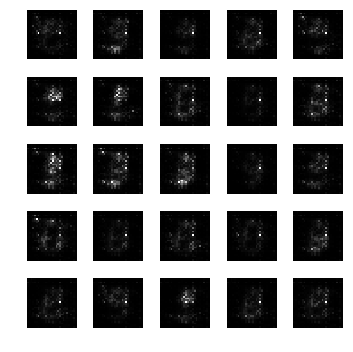

epoch: 1901, time: 4.920786 | train_G_Loss: 0.694905, train_D_loss: 1.379622, train_acc: 0.160000
cv_G_Loss: 0.623146, cv_D_loss: 4.303373, cv_acc: 0.231900

epoch: 1902, time: 4.924871 | train_G_Loss: 0.692908, train_D_loss: 1.381749, train_acc: 0.114545
cv_G_Loss: 0.671862, cv_D_loss: 4.333515, cv_acc: 0.098900

epoch: 1903, time: 4.882849 | train_G_Loss: 0.695578, train_D_loss: 1.387232, train_acc: 0.096364
cv_G_Loss: 0.753022, cv_D_loss: 4.449762, cv_acc: 0.098000

epoch: 1904, time: 4.885555 | train_G_Loss: 0.694820, train_D_loss: 1.379235, train_acc: 0.100000
cv_G_Loss: 0.845896, cv_D_loss: 4.542089, cv_acc: 0.111600

epoch: 1905, time: 4.883916 | train_G_Loss: 0.695756, train_D_loss: 1.384359, train_acc: 0.125455
cv_G_Loss: 0.859041, cv_D_loss: 4.595070, cv_acc: 0.145500

epoch: 1906, time: 4.876386 | train_G_Loss: 0.695508, train_D_loss: 1.382743, train_acc: 0.105455
cv_G_Loss: 1.077914, cv_D_loss: 4.893551, cv_acc: 0.107100

epoch: 1907, time: 4.885799 | train_G_Loss: 0.693613

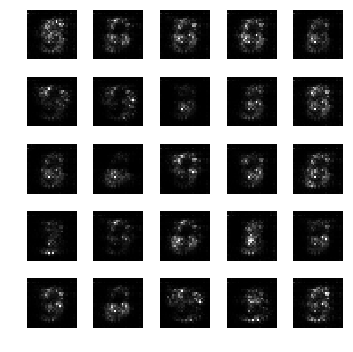

epoch: 1911, time: 4.928857 | train_G_Loss: 0.698547, train_D_loss: 1.378675, train_acc: 0.110909
cv_G_Loss: 0.545974, cv_D_loss: 4.256166, cv_acc: 0.101000

epoch: 1912, time: 4.889187 | train_G_Loss: 0.694195, train_D_loss: 1.387534, train_acc: 0.129091
cv_G_Loss: 0.755059, cv_D_loss: 4.456235, cv_acc: 0.136200

epoch: 1913, time: 4.891268 | train_G_Loss: 0.691957, train_D_loss: 1.387504, train_acc: 0.100000
cv_G_Loss: 0.784849, cv_D_loss: 4.475364, cv_acc: 0.112400

epoch: 1914, time: 4.888381 | train_G_Loss: 0.692919, train_D_loss: 1.387066, train_acc: 0.081818
cv_G_Loss: 0.834405, cv_D_loss: 4.523886, cv_acc: 0.086100

epoch: 1915, time: 4.886235 | train_G_Loss: 0.693126, train_D_loss: 1.384298, train_acc: 0.100000
cv_G_Loss: 0.793095, cv_D_loss: 4.497437, cv_acc: 0.098100

epoch: 1916, time: 4.875422 | train_G_Loss: 0.694052, train_D_loss: 1.385489, train_acc: 0.098182
cv_G_Loss: 0.795947, cv_D_loss: 4.528700, cv_acc: 0.101400

epoch: 1917, time: 4.915787 | train_G_Loss: 0.699032

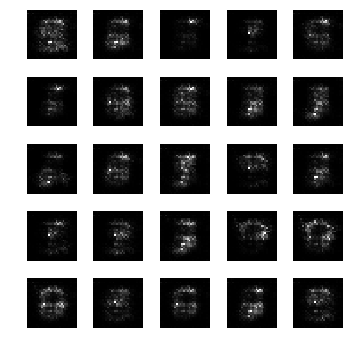

epoch: 1921, time: 4.915489 | train_G_Loss: 0.693859, train_D_loss: 1.388154, train_acc: 0.129091
cv_G_Loss: 0.698948, cv_D_loss: 4.372978, cv_acc: 0.107600

epoch: 1922, time: 4.886221 | train_G_Loss: 0.694227, train_D_loss: 1.381997, train_acc: 0.110909
cv_G_Loss: 0.649804, cv_D_loss: 4.346973, cv_acc: 0.089200

epoch: 1923, time: 4.888043 | train_G_Loss: 0.691740, train_D_loss: 1.388344, train_acc: 0.114545
cv_G_Loss: 0.626622, cv_D_loss: 4.361798, cv_acc: 0.088000

epoch: 1924, time: 4.881170 | train_G_Loss: 0.692209, train_D_loss: 1.391019, train_acc: 0.096364
cv_G_Loss: 0.658515, cv_D_loss: 4.353220, cv_acc: 0.102900

epoch: 1925, time: 4.920054 | train_G_Loss: 0.692387, train_D_loss: 1.385680, train_acc: 0.200000
cv_G_Loss: 0.647825, cv_D_loss: 4.350936, cv_acc: 0.223800

epoch: 1926, time: 4.886344 | train_G_Loss: 0.688136, train_D_loss: 1.391391, train_acc: 0.112727
cv_G_Loss: 0.775086, cv_D_loss: 4.478909, cv_acc: 0.106000

epoch: 1927, time: 4.876436 | train_G_Loss: 0.690486

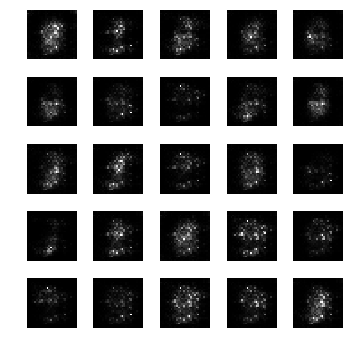

epoch: 1931, time: 4.914918 | train_G_Loss: 0.692974, train_D_loss: 1.384995, train_acc: 0.150909
cv_G_Loss: 0.798544, cv_D_loss: 4.515337, cv_acc: 0.185500

epoch: 1932, time: 4.895510 | train_G_Loss: 0.694512, train_D_loss: 1.383081, train_acc: 0.100000
cv_G_Loss: 0.740834, cv_D_loss: 4.421379, cv_acc: 0.101100

epoch: 1933, time: 4.887152 | train_G_Loss: 0.698791, train_D_loss: 1.380764, train_acc: 0.156364
cv_G_Loss: 0.739030, cv_D_loss: 4.417646, cv_acc: 0.137000

epoch: 1934, time: 4.874660 | train_G_Loss: 0.697143, train_D_loss: 1.379100, train_acc: 0.141818
cv_G_Loss: 0.844181, cv_D_loss: 4.571091, cv_acc: 0.116100

epoch: 1935, time: 4.889968 | train_G_Loss: 0.697557, train_D_loss: 1.380536, train_acc: 0.118182
cv_G_Loss: 0.863745, cv_D_loss: 4.567665, cv_acc: 0.120300

epoch: 1936, time: 4.889479 | train_G_Loss: 0.695357, train_D_loss: 1.381776, train_acc: 0.158182
cv_G_Loss: 1.038297, cv_D_loss: 4.799946, cv_acc: 0.175600

epoch: 1937, time: 4.888400 | train_G_Loss: 0.695189

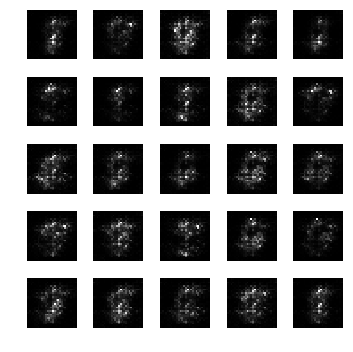

epoch: 1941, time: 4.914913 | train_G_Loss: 0.698216, train_D_loss: 1.380433, train_acc: 0.134545
cv_G_Loss: 0.804142, cv_D_loss: 4.485726, cv_acc: 0.158500

epoch: 1942, time: 4.898014 | train_G_Loss: 0.690261, train_D_loss: 1.384173, train_acc: 0.101818
cv_G_Loss: 0.637663, cv_D_loss: 4.355561, cv_acc: 0.146200

epoch: 1943, time: 4.885331 | train_G_Loss: 0.692602, train_D_loss: 1.385770, train_acc: 0.096364
cv_G_Loss: 0.692863, cv_D_loss: 4.393798, cv_acc: 0.098000

epoch: 1944, time: 4.893389 | train_G_Loss: 0.692709, train_D_loss: 1.385839, train_acc: 0.096364
cv_G_Loss: 0.877136, cv_D_loss: 4.570479, cv_acc: 0.098000

epoch: 1945, time: 4.886690 | train_G_Loss: 0.691231, train_D_loss: 1.389848, train_acc: 0.150909
cv_G_Loss: 0.718761, cv_D_loss: 4.374037, cv_acc: 0.207600

epoch: 1946, time: 4.880890 | train_G_Loss: 0.698606, train_D_loss: 1.375086, train_acc: 0.109091
cv_G_Loss: 0.823759, cv_D_loss: 4.487473, cv_acc: 0.105600

epoch: 1947, time: 4.896428 | train_G_Loss: 0.694491

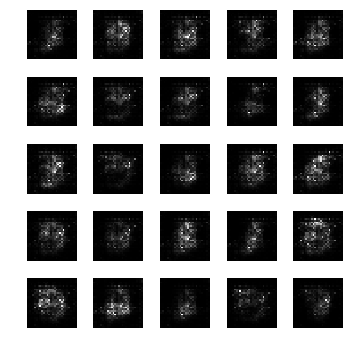

epoch: 1951, time: 4.914514 | train_G_Loss: 0.695242, train_D_loss: 1.381179, train_acc: 0.098182
cv_G_Loss: 0.659646, cv_D_loss: 4.387853, cv_acc: 0.101300

epoch: 1952, time: 4.872713 | train_G_Loss: 0.697683, train_D_loss: 1.381759, train_acc: 0.132727
cv_G_Loss: 0.891072, cv_D_loss: 4.596707, cv_acc: 0.120900

epoch: 1953, time: 4.895594 | train_G_Loss: 0.699566, train_D_loss: 1.370848, train_acc: 0.089091
cv_G_Loss: 0.748303, cv_D_loss: 4.377805, cv_acc: 0.097400

epoch: 1954, time: 4.880643 | train_G_Loss: 0.693022, train_D_loss: 1.390192, train_acc: 0.163636
cv_G_Loss: 0.674294, cv_D_loss: 4.356064, cv_acc: 0.110600

epoch: 1955, time: 4.875444 | train_G_Loss: 0.694882, train_D_loss: 1.382186, train_acc: 0.160000
cv_G_Loss: 0.538091, cv_D_loss: 4.266321, cv_acc: 0.107300

epoch: 1956, time: 4.898681 | train_G_Loss: 0.689482, train_D_loss: 1.393445, train_acc: 0.138182
cv_G_Loss: 0.625535, cv_D_loss: 4.304671, cv_acc: 0.114300

epoch: 1957, time: 4.896852 | train_G_Loss: 0.693681

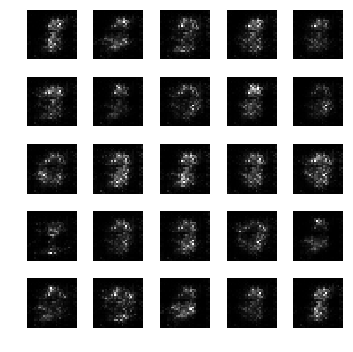

epoch: 1961, time: 4.924590 | train_G_Loss: 0.695259, train_D_loss: 1.382666, train_acc: 0.121818
cv_G_Loss: 0.658303, cv_D_loss: 4.337479, cv_acc: 0.101200

epoch: 1962, time: 4.883755 | train_G_Loss: 0.693347, train_D_loss: 1.381475, train_acc: 0.096364
cv_G_Loss: 0.717468, cv_D_loss: 4.399572, cv_acc: 0.101000

epoch: 1963, time: 4.892246 | train_G_Loss: 0.700687, train_D_loss: 1.373762, train_acc: 0.194545
cv_G_Loss: 0.847395, cv_D_loss: 4.541081, cv_acc: 0.225600

epoch: 1964, time: 4.886275 | train_G_Loss: 0.688093, train_D_loss: 1.392108, train_acc: 0.196364
cv_G_Loss: 0.684691, cv_D_loss: 4.376381, cv_acc: 0.137200

epoch: 1965, time: 4.885626 | train_G_Loss: 0.694975, train_D_loss: 1.384469, train_acc: 0.096364
cv_G_Loss: 0.743984, cv_D_loss: 4.425191, cv_acc: 0.101000

epoch: 1966, time: 4.892521 | train_G_Loss: 0.694071, train_D_loss: 1.385599, train_acc: 0.203636
cv_G_Loss: 0.630417, cv_D_loss: 4.291386, cv_acc: 0.182700

epoch: 1967, time: 4.884802 | train_G_Loss: 0.695468

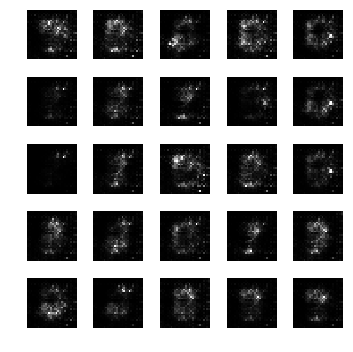

epoch: 1971, time: 4.976886 | train_G_Loss: 0.696136, train_D_loss: 1.381993, train_acc: 0.216364
cv_G_Loss: 0.712671, cv_D_loss: 4.361826, cv_acc: 0.210300

epoch: 1972, time: 4.893934 | train_G_Loss: 0.698654, train_D_loss: 1.373676, train_acc: 0.116364
cv_G_Loss: 0.694281, cv_D_loss: 4.329812, cv_acc: 0.101200

epoch: 1973, time: 4.900571 | train_G_Loss: 0.692564, train_D_loss: 1.375516, train_acc: 0.096364
cv_G_Loss: 0.850823, cv_D_loss: 4.504014, cv_acc: 0.101000

epoch: 1974, time: 4.889196 | train_G_Loss: 0.696224, train_D_loss: 1.385853, train_acc: 0.096364
cv_G_Loss: 0.911932, cv_D_loss: 4.614221, cv_acc: 0.101000

epoch: 1975, time: 4.891177 | train_G_Loss: 0.692923, train_D_loss: 1.387521, train_acc: 0.116364
cv_G_Loss: 0.680513, cv_D_loss: 4.361406, cv_acc: 0.107800

epoch: 1976, time: 4.889118 | train_G_Loss: 0.694745, train_D_loss: 1.380756, train_acc: 0.270909
cv_G_Loss: 0.635895, cv_D_loss: 4.285757, cv_acc: 0.244500

epoch: 1977, time: 4.889575 | train_G_Loss: 0.692575

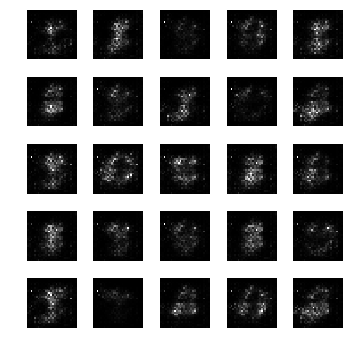

epoch: 1981, time: 4.921666 | train_G_Loss: 0.693750, train_D_loss: 1.380957, train_acc: 0.107273
cv_G_Loss: 0.739103, cv_D_loss: 4.419665, cv_acc: 0.176000

epoch: 1982, time: 4.887682 | train_G_Loss: 0.693892, train_D_loss: 1.382878, train_acc: 0.200000
cv_G_Loss: 0.862688, cv_D_loss: 4.573718, cv_acc: 0.204500

epoch: 1983, time: 4.888728 | train_G_Loss: 0.693943, train_D_loss: 1.382056, train_acc: 0.232727
cv_G_Loss: 0.815804, cv_D_loss: 4.503253, cv_acc: 0.187400

epoch: 1984, time: 4.887309 | train_G_Loss: 0.692432, train_D_loss: 1.383766, train_acc: 0.107273
cv_G_Loss: 0.728570, cv_D_loss: 4.377903, cv_acc: 0.113500

epoch: 1985, time: 4.898332 | train_G_Loss: 0.696175, train_D_loss: 1.377993, train_acc: 0.118182
cv_G_Loss: 0.802421, cv_D_loss: 4.461116, cv_acc: 0.116700

epoch: 1986, time: 4.900471 | train_G_Loss: 0.693050, train_D_loss: 1.388364, train_acc: 0.147273
cv_G_Loss: 0.779701, cv_D_loss: 4.414813, cv_acc: 0.151800

epoch: 1987, time: 4.877711 | train_G_Loss: 0.693821

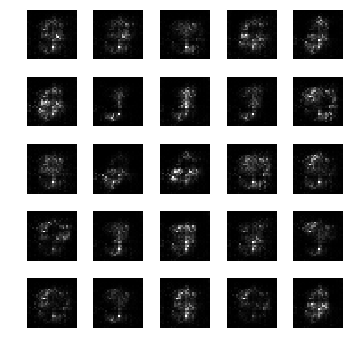

epoch: 1991, time: 4.913396 | train_G_Loss: 0.693861, train_D_loss: 1.389340, train_acc: 0.163636
cv_G_Loss: 0.681921, cv_D_loss: 4.351563, cv_acc: 0.154400

epoch: 1992, time: 4.885536 | train_G_Loss: 0.695301, train_D_loss: 1.382719, train_acc: 0.187273
cv_G_Loss: 0.649286, cv_D_loss: 4.302405, cv_acc: 0.187000

epoch: 1993, time: 4.885161 | train_G_Loss: 0.695677, train_D_loss: 1.382707, train_acc: 0.183636
cv_G_Loss: 0.743371, cv_D_loss: 4.430600, cv_acc: 0.185500

epoch: 1994, time: 4.945124 | train_G_Loss: 0.697323, train_D_loss: 1.379454, train_acc: 0.098182
cv_G_Loss: 0.740633, cv_D_loss: 4.425910, cv_acc: 0.098000

epoch: 1995, time: 4.887003 | train_G_Loss: 0.699325, train_D_loss: 1.376147, train_acc: 0.096364
cv_G_Loss: 0.598128, cv_D_loss: 4.288118, cv_acc: 0.098000

epoch: 1996, time: 4.885023 | train_G_Loss: 0.696482, train_D_loss: 1.377096, train_acc: 0.096364
cv_G_Loss: 0.821915, cv_D_loss: 4.694097, cv_acc: 0.098000

epoch: 1997, time: 4.899955 | train_G_Loss: 0.696170

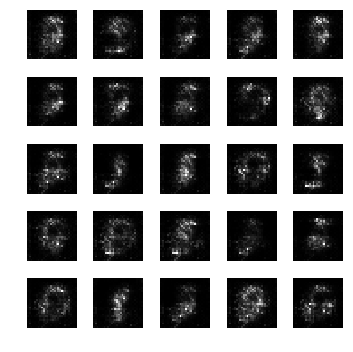

epoch: 2001, time: 4.920099 | train_G_Loss: 0.696283, train_D_loss: 1.382203, train_acc: 0.161818
cv_G_Loss: 0.810669, cv_D_loss: 4.496454, cv_acc: 0.102600

epoch: 2002, time: 4.886830 | train_G_Loss: 0.694332, train_D_loss: 1.382026, train_acc: 0.180000
cv_G_Loss: 0.618565, cv_D_loss: 4.301579, cv_acc: 0.158300

epoch: 2003, time: 4.880936 | train_G_Loss: 0.692923, train_D_loss: 1.386772, train_acc: 0.120000
cv_G_Loss: 0.730408, cv_D_loss: 4.378237, cv_acc: 0.106200

epoch: 2004, time: 4.880966 | train_G_Loss: 0.690981, train_D_loss: 1.389492, train_acc: 0.107273
cv_G_Loss: 0.767636, cv_D_loss: 4.444708, cv_acc: 0.103400

epoch: 2005, time: 4.893179 | train_G_Loss: 0.688612, train_D_loss: 1.394137, train_acc: 0.116364
cv_G_Loss: 0.618847, cv_D_loss: 4.297807, cv_acc: 0.143900

epoch: 2006, time: 4.888428 | train_G_Loss: 0.692510, train_D_loss: 1.385696, train_acc: 0.129091
cv_G_Loss: 0.623034, cv_D_loss: 4.312793, cv_acc: 0.143400

epoch: 2007, time: 4.894272 | train_G_Loss: 0.691295

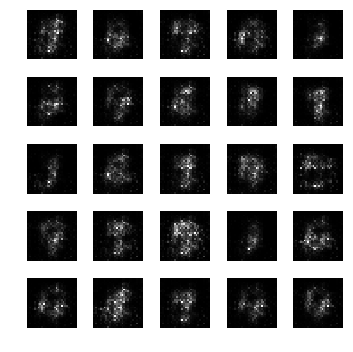

epoch: 2011, time: 4.911709 | train_G_Loss: 0.695464, train_D_loss: 1.381547, train_acc: 0.096364
cv_G_Loss: 0.733664, cv_D_loss: 4.374652, cv_acc: 0.098000

epoch: 2012, time: 4.922443 | train_G_Loss: 0.695389, train_D_loss: 1.380553, train_acc: 0.165455
cv_G_Loss: 0.731296, cv_D_loss: 4.374203, cv_acc: 0.167200

epoch: 2013, time: 4.891840 | train_G_Loss: 0.694568, train_D_loss: 1.381405, train_acc: 0.112727
cv_G_Loss: 0.726627, cv_D_loss: 4.382129, cv_acc: 0.182600

epoch: 2014, time: 4.886911 | train_G_Loss: 0.695379, train_D_loss: 1.382758, train_acc: 0.107273
cv_G_Loss: 0.687545, cv_D_loss: 4.328711, cv_acc: 0.118900

epoch: 2015, time: 4.889534 | train_G_Loss: 0.692526, train_D_loss: 1.385185, train_acc: 0.129091
cv_G_Loss: 0.708008, cv_D_loss: 4.373951, cv_acc: 0.153200

epoch: 2016, time: 4.889468 | train_G_Loss: 0.692512, train_D_loss: 1.385470, train_acc: 0.101818
cv_G_Loss: 0.673003, cv_D_loss: 4.337077, cv_acc: 0.109400

epoch: 2017, time: 4.955332 | train_G_Loss: 0.692855

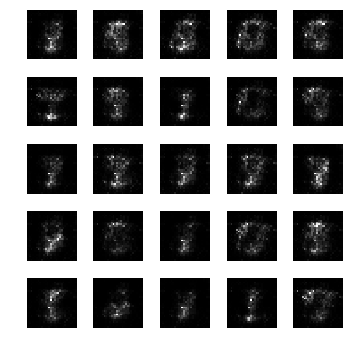

epoch: 2021, time: 4.903653 | train_G_Loss: 0.698528, train_D_loss: 1.374282, train_acc: 0.181818
cv_G_Loss: 0.598865, cv_D_loss: 4.252009, cv_acc: 0.183900

epoch: 2022, time: 4.889271 | train_G_Loss: 0.698547, train_D_loss: 1.376480, train_acc: 0.096364
cv_G_Loss: 0.729931, cv_D_loss: 4.399732, cv_acc: 0.103000

epoch: 2023, time: 4.883636 | train_G_Loss: 0.695196, train_D_loss: 1.383242, train_acc: 0.096364
cv_G_Loss: 0.708229, cv_D_loss: 4.376520, cv_acc: 0.099000

epoch: 2024, time: 4.877129 | train_G_Loss: 0.704854, train_D_loss: 1.373367, train_acc: 0.170909
cv_G_Loss: 0.906643, cv_D_loss: 4.582054, cv_acc: 0.177100

epoch: 2025, time: 4.899099 | train_G_Loss: 0.685825, train_D_loss: 1.393885, train_acc: 0.165455
cv_G_Loss: 0.701120, cv_D_loss: 4.405984, cv_acc: 0.111600

epoch: 2026, time: 4.892852 | train_G_Loss: 0.695159, train_D_loss: 1.382521, train_acc: 0.134545
cv_G_Loss: 0.641706, cv_D_loss: 4.306736, cv_acc: 0.123800

epoch: 2027, time: 4.888953 | train_G_Loss: 0.702704

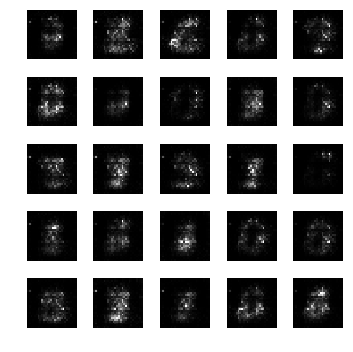

epoch: 2031, time: 4.913286 | train_G_Loss: 0.696363, train_D_loss: 1.380103, train_acc: 0.107273
cv_G_Loss: 0.686223, cv_D_loss: 4.344026, cv_acc: 0.114000

epoch: 2032, time: 4.887009 | train_G_Loss: 0.692589, train_D_loss: 1.386400, train_acc: 0.220000
cv_G_Loss: 1.029977, cv_D_loss: 4.872507, cv_acc: 0.137700

epoch: 2033, time: 4.893563 | train_G_Loss: 0.695156, train_D_loss: 1.386440, train_acc: 0.160000
cv_G_Loss: 0.859534, cv_D_loss: 4.539858, cv_acc: 0.215100

epoch: 2034, time: 4.884220 | train_G_Loss: 0.694777, train_D_loss: 1.384711, train_acc: 0.190909
cv_G_Loss: 0.881823, cv_D_loss: 4.603914, cv_acc: 0.241300

epoch: 2035, time: 4.887533 | train_G_Loss: 0.695923, train_D_loss: 1.382331, train_acc: 0.114545
cv_G_Loss: 0.652397, cv_D_loss: 4.353509, cv_acc: 0.124800

epoch: 2036, time: 4.894341 | train_G_Loss: 0.695391, train_D_loss: 1.384289, train_acc: 0.121818
cv_G_Loss: 0.764219, cv_D_loss: 4.474285, cv_acc: 0.137100

epoch: 2037, time: 4.888322 | train_G_Loss: 0.693028

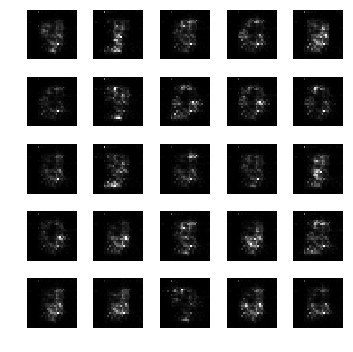

epoch: 2041, time: 4.920621 | train_G_Loss: 0.693367, train_D_loss: 1.383106, train_acc: 0.209091
cv_G_Loss: 0.700003, cv_D_loss: 4.353724, cv_acc: 0.187600

epoch: 2042, time: 4.881935 | train_G_Loss: 0.695900, train_D_loss: 1.383676, train_acc: 0.107273
cv_G_Loss: 0.777036, cv_D_loss: 4.458379, cv_acc: 0.113500

epoch: 2043, time: 4.886697 | train_G_Loss: 0.699662, train_D_loss: 1.379262, train_acc: 0.100000
cv_G_Loss: 0.773238, cv_D_loss: 4.445679, cv_acc: 0.100400

epoch: 2044, time: 4.878810 | train_G_Loss: 0.697169, train_D_loss: 1.382160, train_acc: 0.100000
cv_G_Loss: 0.714513, cv_D_loss: 4.359333, cv_acc: 0.098400

epoch: 2045, time: 4.892131 | train_G_Loss: 0.694279, train_D_loss: 1.387004, train_acc: 0.121818
cv_G_Loss: 0.694394, cv_D_loss: 4.313622, cv_acc: 0.124100

epoch: 2046, time: 4.894730 | train_G_Loss: 0.693298, train_D_loss: 1.379856, train_acc: 0.096364
cv_G_Loss: 0.718963, cv_D_loss: 4.410427, cv_acc: 0.098000

epoch: 2047, time: 4.879679 | train_G_Loss: 0.696104

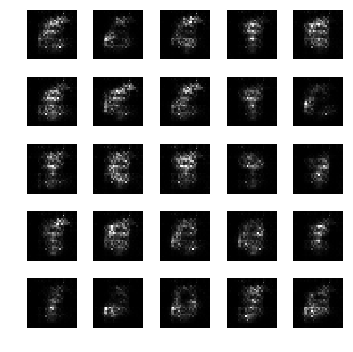

epoch: 2051, time: 4.917709 | train_G_Loss: 0.689496, train_D_loss: 1.392172, train_acc: 0.096364
cv_G_Loss: 0.796377, cv_D_loss: 4.593349, cv_acc: 0.101000

epoch: 2052, time: 4.886897 | train_G_Loss: 0.694931, train_D_loss: 1.382172, train_acc: 0.087273
cv_G_Loss: 0.637450, cv_D_loss: 4.319323, cv_acc: 0.089100

epoch: 2053, time: 4.892197 | train_G_Loss: 0.687125, train_D_loss: 1.384017, train_acc: 0.087273
cv_G_Loss: 0.707539, cv_D_loss: 4.379694, cv_acc: 0.089200

epoch: 2054, time: 4.900214 | train_G_Loss: 0.697641, train_D_loss: 1.379749, train_acc: 0.105455
cv_G_Loss: 0.609681, cv_D_loss: 4.270343, cv_acc: 0.103200

epoch: 2055, time: 4.901050 | train_G_Loss: 0.697835, train_D_loss: 1.380231, train_acc: 0.118182
cv_G_Loss: 0.730762, cv_D_loss: 4.420969, cv_acc: 0.119900

epoch: 2056, time: 4.886091 | train_G_Loss: 0.692422, train_D_loss: 1.386443, train_acc: 0.105455
cv_G_Loss: 0.720647, cv_D_loss: 4.419827, cv_acc: 0.103200

epoch: 2057, time: 4.893540 | train_G_Loss: 0.698053

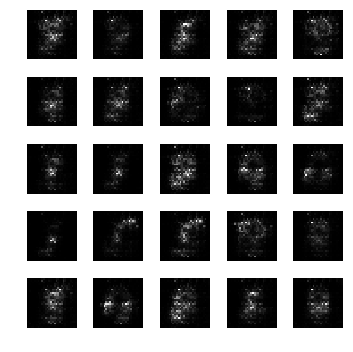

epoch: 2061, time: 4.899284 | train_G_Loss: 0.696154, train_D_loss: 1.379030, train_acc: 0.096364
cv_G_Loss: 0.734405, cv_D_loss: 4.483586, cv_acc: 0.101000

epoch: 2062, time: 4.902850 | train_G_Loss: 0.700044, train_D_loss: 1.372294, train_acc: 0.167273
cv_G_Loss: 0.546090, cv_D_loss: 4.243524, cv_acc: 0.168200

epoch: 2063, time: 4.908150 | train_G_Loss: 0.699089, train_D_loss: 1.378504, train_acc: 0.198182
cv_G_Loss: 0.938656, cv_D_loss: 4.649951, cv_acc: 0.168800

epoch: 2064, time: 4.889826 | train_G_Loss: 0.692082, train_D_loss: 1.386567, train_acc: 0.207273
cv_G_Loss: 0.627665, cv_D_loss: 4.278646, cv_acc: 0.208500

epoch: 2065, time: 4.883928 | train_G_Loss: 0.695062, train_D_loss: 1.384311, train_acc: 0.107273
cv_G_Loss: 0.733198, cv_D_loss: 4.446167, cv_acc: 0.113500

epoch: 2066, time: 4.888765 | train_G_Loss: 0.698725, train_D_loss: 1.379529, train_acc: 0.183636
cv_G_Loss: 0.727588, cv_D_loss: 4.379395, cv_acc: 0.099400

epoch: 2067, time: 4.889250 | train_G_Loss: 0.699570

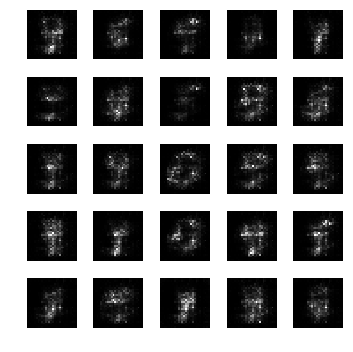

epoch: 2071, time: 4.917276 | train_G_Loss: 0.691790, train_D_loss: 1.390854, train_acc: 0.105455
cv_G_Loss: 0.757024, cv_D_loss: 4.413361, cv_acc: 0.103200

epoch: 2072, time: 4.884142 | train_G_Loss: 0.691455, train_D_loss: 1.384485, train_acc: 0.129091
cv_G_Loss: 0.761117, cv_D_loss: 4.408709, cv_acc: 0.138400

epoch: 2073, time: 4.890409 | train_G_Loss: 0.690119, train_D_loss: 1.388247, train_acc: 0.112727
cv_G_Loss: 0.785777, cv_D_loss: 4.425033, cv_acc: 0.111700

epoch: 2074, time: 4.881831 | train_G_Loss: 0.693275, train_D_loss: 1.388089, train_acc: 0.210909
cv_G_Loss: 0.640919, cv_D_loss: 4.280645, cv_acc: 0.189400

epoch: 2075, time: 4.899173 | train_G_Loss: 0.696173, train_D_loss: 1.383282, train_acc: 0.127273
cv_G_Loss: 0.728482, cv_D_loss: 4.365350, cv_acc: 0.119900

epoch: 2076, time: 4.873164 | train_G_Loss: 0.692068, train_D_loss: 1.383714, train_acc: 0.140000
cv_G_Loss: 0.626639, cv_D_loss: 4.289809, cv_acc: 0.103700

epoch: 2077, time: 4.898062 | train_G_Loss: 0.691276

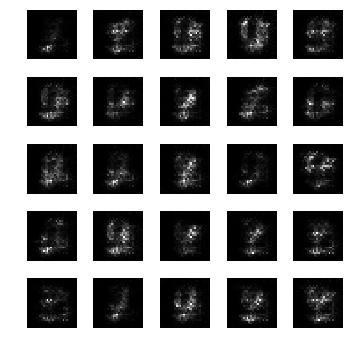

epoch: 2081, time: 4.917051 | train_G_Loss: 0.693843, train_D_loss: 1.385386, train_acc: 0.158182
cv_G_Loss: 0.704511, cv_D_loss: 4.357469, cv_acc: 0.178500

epoch: 2082, time: 4.904145 | train_G_Loss: 0.692865, train_D_loss: 1.383986, train_acc: 0.161818
cv_G_Loss: 0.729431, cv_D_loss: 4.393229, cv_acc: 0.141900

epoch: 2083, time: 4.891717 | train_G_Loss: 0.696145, train_D_loss: 1.378957, train_acc: 0.150909
cv_G_Loss: 0.888751, cv_D_loss: 4.645905, cv_acc: 0.177900

epoch: 2084, time: 4.888907 | train_G_Loss: 0.689453, train_D_loss: 1.393221, train_acc: 0.143636
cv_G_Loss: 0.639959, cv_D_loss: 4.315024, cv_acc: 0.144500

epoch: 2085, time: 4.888420 | train_G_Loss: 0.695646, train_D_loss: 1.386330, train_acc: 0.098182
cv_G_Loss: 0.767133, cv_D_loss: 4.441804, cv_acc: 0.101600

epoch: 2086, time: 4.913227 | train_G_Loss: 0.695004, train_D_loss: 1.383613, train_acc: 0.096364
cv_G_Loss: 0.859748, cv_D_loss: 4.564900, cv_acc: 0.098000

epoch: 2087, time: 4.884102 | train_G_Loss: 0.698539

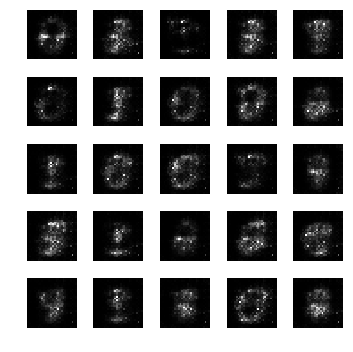

epoch: 2091, time: 4.923067 | train_G_Loss: 0.700461, train_D_loss: 1.380660, train_acc: 0.109091
cv_G_Loss: 0.861033, cv_D_loss: 4.487691, cv_acc: 0.145000

epoch: 2092, time: 4.901417 | train_G_Loss: 0.693599, train_D_loss: 1.385103, train_acc: 0.176364
cv_G_Loss: 0.794046, cv_D_loss: 4.412983, cv_acc: 0.202800

epoch: 2093, time: 4.881284 | train_G_Loss: 0.696031, train_D_loss: 1.382480, train_acc: 0.105455
cv_G_Loss: 0.864460, cv_D_loss: 4.541057, cv_acc: 0.103200

epoch: 2094, time: 4.886548 | train_G_Loss: 0.693278, train_D_loss: 1.381573, train_acc: 0.105455
cv_G_Loss: 0.786051, cv_D_loss: 4.428128, cv_acc: 0.103100

epoch: 2095, time: 4.895049 | train_G_Loss: 0.694380, train_D_loss: 1.380430, train_acc: 0.147273
cv_G_Loss: 0.692955, cv_D_loss: 4.334547, cv_acc: 0.117600

epoch: 2096, time: 4.886805 | train_G_Loss: 0.697001, train_D_loss: 1.381483, train_acc: 0.140000
cv_G_Loss: 0.823246, cv_D_loss: 4.508202, cv_acc: 0.106400

epoch: 2097, time: 4.890683 | train_G_Loss: 0.698425

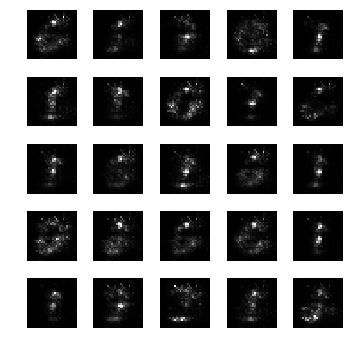

epoch: 2101, time: 4.902232 | train_G_Loss: 0.695695, train_D_loss: 1.383861, train_acc: 0.109091
cv_G_Loss: 0.656124, cv_D_loss: 4.396257, cv_acc: 0.123500

epoch: 2102, time: 4.881305 | train_G_Loss: 0.697577, train_D_loss: 1.378958, train_acc: 0.103636
cv_G_Loss: 0.727955, cv_D_loss: 4.398440, cv_acc: 0.130300

epoch: 2103, time: 4.895900 | train_G_Loss: 0.697029, train_D_loss: 1.381969, train_acc: 0.163636
cv_G_Loss: 1.014373, cv_D_loss: 4.779568, cv_acc: 0.153300

epoch: 2104, time: 4.889578 | train_G_Loss: 0.698488, train_D_loss: 1.380274, train_acc: 0.165455
cv_G_Loss: 0.620771, cv_D_loss: 4.250951, cv_acc: 0.158900

epoch: 2105, time: 4.896892 | train_G_Loss: 0.697154, train_D_loss: 1.381613, train_acc: 0.189091
cv_G_Loss: 0.539251, cv_D_loss: 4.273159, cv_acc: 0.105500

epoch: 2106, time: 4.896615 | train_G_Loss: 0.696315, train_D_loss: 1.386064, train_acc: 0.121818
cv_G_Loss: 0.843541, cv_D_loss: 4.489695, cv_acc: 0.182300

epoch: 2107, time: 4.895041 | train_G_Loss: 0.697156

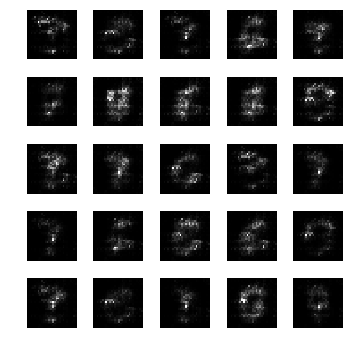

epoch: 2111, time: 4.920490 | train_G_Loss: 0.694600, train_D_loss: 1.381343, train_acc: 0.132727
cv_G_Loss: 0.780840, cv_D_loss: 4.433744, cv_acc: 0.151500

epoch: 2112, time: 4.889707 | train_G_Loss: 0.696769, train_D_loss: 1.383382, train_acc: 0.101818
cv_G_Loss: 0.739983, cv_D_loss: 4.409740, cv_acc: 0.114300

epoch: 2113, time: 4.888748 | train_G_Loss: 0.691776, train_D_loss: 1.381214, train_acc: 0.109091
cv_G_Loss: 0.709944, cv_D_loss: 4.374458, cv_acc: 0.106800

epoch: 2114, time: 4.895159 | train_G_Loss: 0.693178, train_D_loss: 1.388135, train_acc: 0.294545
cv_G_Loss: 0.616759, cv_D_loss: 4.270731, cv_acc: 0.183400

epoch: 2115, time: 4.884985 | train_G_Loss: 0.692070, train_D_loss: 1.388716, train_acc: 0.216364
cv_G_Loss: 0.601205, cv_D_loss: 4.261587, cv_acc: 0.221700

epoch: 2116, time: 4.880755 | train_G_Loss: 0.696401, train_D_loss: 1.382414, train_acc: 0.185455
cv_G_Loss: 0.650940, cv_D_loss: 4.278887, cv_acc: 0.199600

epoch: 2117, time: 4.894615 | train_G_Loss: 0.697404

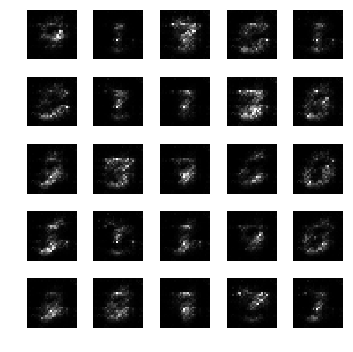

epoch: 2121, time: 4.916682 | train_G_Loss: 0.698528, train_D_loss: 1.379061, train_acc: 0.098182
cv_G_Loss: 0.709379, cv_D_loss: 4.378735, cv_acc: 0.101300

epoch: 2122, time: 4.885256 | train_G_Loss: 0.698053, train_D_loss: 1.376547, train_acc: 0.110909
cv_G_Loss: 0.715322, cv_D_loss: 4.350580, cv_acc: 0.100000

epoch: 2123, time: 4.900708 | train_G_Loss: 0.695126, train_D_loss: 1.384480, train_acc: 0.096364
cv_G_Loss: 0.679083, cv_D_loss: 4.327125, cv_acc: 0.102000

epoch: 2124, time: 4.908667 | train_G_Loss: 0.694618, train_D_loss: 1.381871, train_acc: 0.189091
cv_G_Loss: 0.752204, cv_D_loss: 4.405905, cv_acc: 0.178600

epoch: 2125, time: 4.885113 | train_G_Loss: 0.696927, train_D_loss: 1.381535, train_acc: 0.110909
cv_G_Loss: 0.961689, cv_D_loss: 4.680964, cv_acc: 0.095800

epoch: 2126, time: 4.887604 | train_G_Loss: 0.692373, train_D_loss: 1.386891, train_acc: 0.160000
cv_G_Loss: 0.707115, cv_D_loss: 4.383727, cv_acc: 0.169400

epoch: 2127, time: 4.896948 | train_G_Loss: 0.695646

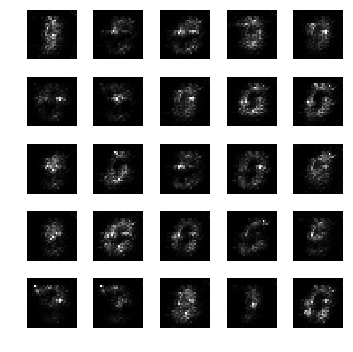

epoch: 2131, time: 4.957497 | train_G_Loss: 0.691563, train_D_loss: 1.388073, train_acc: 0.170909
cv_G_Loss: 0.727566, cv_D_loss: 4.357493, cv_acc: 0.194400

epoch: 2132, time: 4.923048 | train_G_Loss: 0.697969, train_D_loss: 1.383668, train_acc: 0.096364
cv_G_Loss: 0.866130, cv_D_loss: 4.557188, cv_acc: 0.098000

epoch: 2133, time: 4.890725 | train_G_Loss: 0.688620, train_D_loss: 1.390372, train_acc: 0.096364
cv_G_Loss: 0.738421, cv_D_loss: 4.448055, cv_acc: 0.101000

epoch: 2134, time: 4.890247 | train_G_Loss: 0.694640, train_D_loss: 1.387724, train_acc: 0.216364
cv_G_Loss: 0.635524, cv_D_loss: 4.307246, cv_acc: 0.178200

epoch: 2135, time: 4.886063 | train_G_Loss: 0.695532, train_D_loss: 1.380024, train_acc: 0.174545
cv_G_Loss: 0.734731, cv_D_loss: 4.406994, cv_acc: 0.174300

epoch: 2136, time: 4.888372 | train_G_Loss: 0.695828, train_D_loss: 1.380025, train_acc: 0.163636
cv_G_Loss: 0.826152, cv_D_loss: 4.502862, cv_acc: 0.137700

epoch: 2137, time: 4.887610 | train_G_Loss: 0.693041

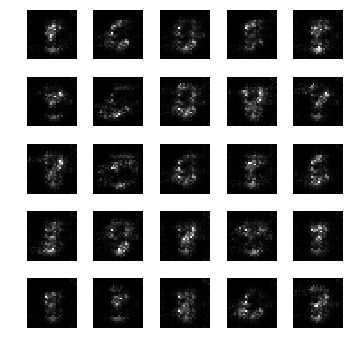

epoch: 2141, time: 4.924578 | train_G_Loss: 0.700988, train_D_loss: 1.374429, train_acc: 0.127273
cv_G_Loss: 0.738180, cv_D_loss: 4.363948, cv_acc: 0.176900

epoch: 2142, time: 4.889130 | train_G_Loss: 0.696872, train_D_loss: 1.387492, train_acc: 0.123636
cv_G_Loss: 0.679377, cv_D_loss: 4.337458, cv_acc: 0.144700

epoch: 2143, time: 4.881873 | train_G_Loss: 0.693861, train_D_loss: 1.386245, train_acc: 0.185455
cv_G_Loss: 0.733780, cv_D_loss: 4.370419, cv_acc: 0.177600

epoch: 2144, time: 4.895007 | train_G_Loss: 0.695837, train_D_loss: 1.381128, train_acc: 0.210909
cv_G_Loss: 0.714785, cv_D_loss: 4.359807, cv_acc: 0.131600

epoch: 2145, time: 4.891629 | train_G_Loss: 0.693756, train_D_loss: 1.385718, train_acc: 0.147273
cv_G_Loss: 0.737242, cv_D_loss: 4.408731, cv_acc: 0.176800

epoch: 2146, time: 4.884268 | train_G_Loss: 0.698355, train_D_loss: 1.378792, train_acc: 0.132727
cv_G_Loss: 1.003043, cv_D_loss: 4.750294, cv_acc: 0.102300

epoch: 2147, time: 4.895237 | train_G_Loss: 0.695649

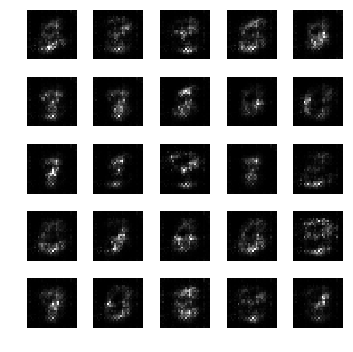

epoch: 2151, time: 4.919229 | train_G_Loss: 0.692609, train_D_loss: 1.387010, train_acc: 0.107273
cv_G_Loss: 0.698213, cv_D_loss: 4.346626, cv_acc: 0.097400

epoch: 2152, time: 4.892518 | train_G_Loss: 0.695543, train_D_loss: 1.383020, train_acc: 0.221818
cv_G_Loss: 0.750424, cv_D_loss: 4.381358, cv_acc: 0.171100

epoch: 2153, time: 4.914198 | train_G_Loss: 0.692594, train_D_loss: 1.384176, train_acc: 0.167273
cv_G_Loss: 0.633539, cv_D_loss: 4.259059, cv_acc: 0.144700

epoch: 2154, time: 4.915897 | train_G_Loss: 0.695894, train_D_loss: 1.383236, train_acc: 0.098182
cv_G_Loss: 0.734854, cv_D_loss: 4.407980, cv_acc: 0.098200

epoch: 2155, time: 4.913584 | train_G_Loss: 0.700714, train_D_loss: 1.378170, train_acc: 0.120000
cv_G_Loss: 0.831255, cv_D_loss: 4.505566, cv_acc: 0.108800

epoch: 2156, time: 4.894825 | train_G_Loss: 0.692447, train_D_loss: 1.383163, train_acc: 0.194545
cv_G_Loss: 0.613896, cv_D_loss: 4.256850, cv_acc: 0.207700

epoch: 2157, time: 4.889976 | train_G_Loss: 0.695044

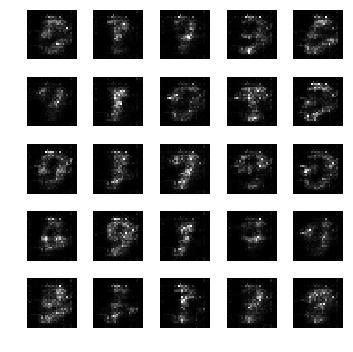

epoch: 2161, time: 4.932835 | train_G_Loss: 0.692725, train_D_loss: 1.382986, train_acc: 0.212727
cv_G_Loss: 0.626947, cv_D_loss: 4.269045, cv_acc: 0.186000

epoch: 2162, time: 4.885581 | train_G_Loss: 0.695260, train_D_loss: 1.383957, train_acc: 0.098182
cv_G_Loss: 0.751817, cv_D_loss: 4.403651, cv_acc: 0.106100

epoch: 2163, time: 4.895210 | train_G_Loss: 0.694197, train_D_loss: 1.383476, train_acc: 0.207273
cv_G_Loss: 0.810050, cv_D_loss: 4.462824, cv_acc: 0.218200

epoch: 2164, time: 4.897413 | train_G_Loss: 0.694990, train_D_loss: 1.386219, train_acc: 0.232727
cv_G_Loss: 0.712393, cv_D_loss: 4.332395, cv_acc: 0.237000

epoch: 2165, time: 4.886635 | train_G_Loss: 0.695707, train_D_loss: 1.381069, train_acc: 0.116364
cv_G_Loss: 0.619514, cv_D_loss: 4.298383, cv_acc: 0.089100

epoch: 2166, time: 4.891295 | train_G_Loss: 0.694853, train_D_loss: 1.379890, train_acc: 0.087273
cv_G_Loss: 0.669574, cv_D_loss: 4.307060, cv_acc: 0.089000

epoch: 2167, time: 4.896801 | train_G_Loss: 0.693123

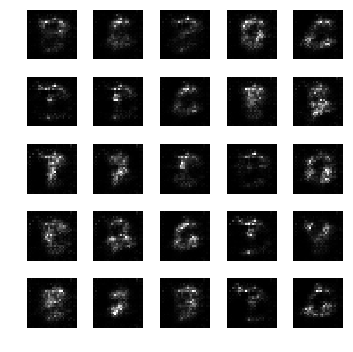

epoch: 2171, time: 4.917834 | train_G_Loss: 0.693599, train_D_loss: 1.386435, train_acc: 0.087273
cv_G_Loss: 0.646790, cv_D_loss: 4.304166, cv_acc: 0.089200

epoch: 2172, time: 4.891932 | train_G_Loss: 0.695330, train_D_loss: 1.384018, train_acc: 0.183636
cv_G_Loss: 0.740528, cv_D_loss: 4.374496, cv_acc: 0.186100

epoch: 2173, time: 4.888594 | train_G_Loss: 0.695967, train_D_loss: 1.378516, train_acc: 0.112727
cv_G_Loss: 0.675360, cv_D_loss: 4.296496, cv_acc: 0.123800

epoch: 2174, time: 4.898299 | train_G_Loss: 0.692775, train_D_loss: 1.387927, train_acc: 0.123636
cv_G_Loss: 0.744008, cv_D_loss: 4.434978, cv_acc: 0.115100

epoch: 2175, time: 4.891813 | train_G_Loss: 0.692179, train_D_loss: 1.385751, train_acc: 0.123636
cv_G_Loss: 0.825774, cv_D_loss: 4.511507, cv_acc: 0.153400

epoch: 2176, time: 4.895586 | train_G_Loss: 0.692219, train_D_loss: 1.389678, train_acc: 0.230909
cv_G_Loss: 0.733516, cv_D_loss: 4.365275, cv_acc: 0.212500

epoch: 2177, time: 4.911784 | train_G_Loss: 0.693666

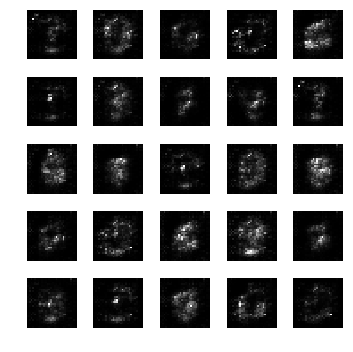

epoch: 2181, time: 4.917656 | train_G_Loss: 0.696368, train_D_loss: 1.384093, train_acc: 0.147273
cv_G_Loss: 0.746557, cv_D_loss: 4.372525, cv_acc: 0.144700

epoch: 2182, time: 4.879186 | train_G_Loss: 0.696001, train_D_loss: 1.377942, train_acc: 0.103636
cv_G_Loss: 0.699559, cv_D_loss: 4.337160, cv_acc: 0.133300

epoch: 2183, time: 4.889826 | train_G_Loss: 0.697532, train_D_loss: 1.378754, train_acc: 0.134545
cv_G_Loss: 0.794875, cv_D_loss: 4.439537, cv_acc: 0.113700

epoch: 2184, time: 4.880484 | train_G_Loss: 0.687025, train_D_loss: 1.392271, train_acc: 0.189091
cv_G_Loss: 0.806844, cv_D_loss: 4.480715, cv_acc: 0.185600

epoch: 2185, time: 4.886110 | train_G_Loss: 0.688901, train_D_loss: 1.389293, train_acc: 0.185455
cv_G_Loss: 0.743594, cv_D_loss: 4.399782, cv_acc: 0.134000

epoch: 2186, time: 4.888532 | train_G_Loss: 0.690744, train_D_loss: 1.385962, train_acc: 0.109091
cv_G_Loss: 0.939917, cv_D_loss: 4.672085, cv_acc: 0.102800

epoch: 2187, time: 4.897390 | train_G_Loss: 0.693622

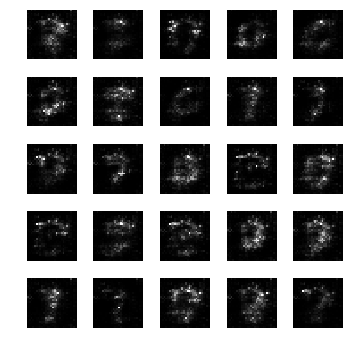

epoch: 2191, time: 4.926602 | train_G_Loss: 0.704502, train_D_loss: 1.376956, train_acc: 0.132727
cv_G_Loss: 0.617289, cv_D_loss: 4.278955, cv_acc: 0.108200

epoch: 2192, time: 4.961839 | train_G_Loss: 0.694859, train_D_loss: 1.384931, train_acc: 0.321818
cv_G_Loss: 0.783360, cv_D_loss: 4.450178, cv_acc: 0.228800

epoch: 2193, time: 4.888581 | train_G_Loss: 0.697530, train_D_loss: 1.388553, train_acc: 0.101818
cv_G_Loss: 0.762154, cv_D_loss: 4.410371, cv_acc: 0.101200

epoch: 2194, time: 4.891132 | train_G_Loss: 0.693352, train_D_loss: 1.380584, train_acc: 0.110909
cv_G_Loss: 0.821382, cv_D_loss: 4.505367, cv_acc: 0.133300

epoch: 2195, time: 4.884582 | train_G_Loss: 0.692085, train_D_loss: 1.385627, train_acc: 0.158182
cv_G_Loss: 0.790827, cv_D_loss: 4.448585, cv_acc: 0.170600

epoch: 2196, time: 4.921086 | train_G_Loss: 0.692006, train_D_loss: 1.387080, train_acc: 0.236364
cv_G_Loss: 0.713081, cv_D_loss: 4.327641, cv_acc: 0.222400

epoch: 2197, time: 4.893067 | train_G_Loss: 0.692126

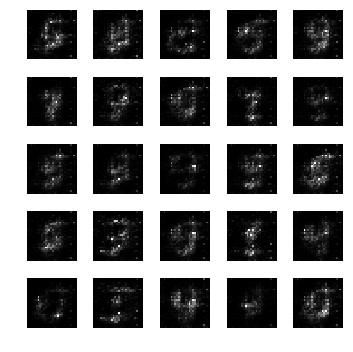

epoch: 2201, time: 4.910332 | train_G_Loss: 0.698268, train_D_loss: 1.387675, train_acc: 0.245455
cv_G_Loss: 0.812120, cv_D_loss: 4.485007, cv_acc: 0.245900

epoch: 2202, time: 4.888606 | train_G_Loss: 0.691592, train_D_loss: 1.385713, train_acc: 0.109091
cv_G_Loss: 0.658030, cv_D_loss: 4.337090, cv_acc: 0.108100

epoch: 2203, time: 4.903832 | train_G_Loss: 0.691165, train_D_loss: 1.389810, train_acc: 0.210909
cv_G_Loss: 0.711134, cv_D_loss: 4.342517, cv_acc: 0.168100

epoch: 2204, time: 4.889787 | train_G_Loss: 0.697555, train_D_loss: 1.382761, train_acc: 0.174545
cv_G_Loss: 0.716795, cv_D_loss: 4.361555, cv_acc: 0.180700

epoch: 2205, time: 4.898688 | train_G_Loss: 0.698073, train_D_loss: 1.380712, train_acc: 0.281818
cv_G_Loss: 0.881750, cv_D_loss: 4.504503, cv_acc: 0.228900

epoch: 2206, time: 4.894928 | train_G_Loss: 0.693663, train_D_loss: 1.386216, train_acc: 0.129091
cv_G_Loss: 0.627480, cv_D_loss: 4.303358, cv_acc: 0.117700

epoch: 2207, time: 4.893274 | train_G_Loss: 0.693010

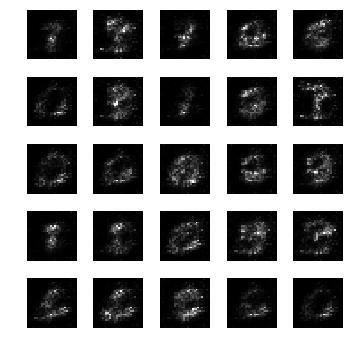

epoch: 2211, time: 4.910405 | train_G_Loss: 0.694844, train_D_loss: 1.387161, train_acc: 0.200000
cv_G_Loss: 0.850359, cv_D_loss: 4.525860, cv_acc: 0.232400

epoch: 2212, time: 4.897063 | train_G_Loss: 0.696048, train_D_loss: 1.381441, train_acc: 0.107273
cv_G_Loss: 0.798528, cv_D_loss: 4.495367, cv_acc: 0.139200

epoch: 2213, time: 4.901720 | train_G_Loss: 0.694439, train_D_loss: 1.383633, train_acc: 0.101818
cv_G_Loss: 0.730486, cv_D_loss: 4.390134, cv_acc: 0.098300

epoch: 2214, time: 4.891889 | train_G_Loss: 0.694674, train_D_loss: 1.384481, train_acc: 0.100000
cv_G_Loss: 0.660212, cv_D_loss: 4.332930, cv_acc: 0.097900

epoch: 2215, time: 4.892084 | train_G_Loss: 0.696523, train_D_loss: 1.384721, train_acc: 0.218182
cv_G_Loss: 0.650576, cv_D_loss: 4.332051, cv_acc: 0.226100

epoch: 2216, time: 4.885628 | train_G_Loss: 0.696278, train_D_loss: 1.385517, train_acc: 0.136364
cv_G_Loss: 0.658630, cv_D_loss: 4.326342, cv_acc: 0.121300

epoch: 2217, time: 4.887700 | train_G_Loss: 0.696446

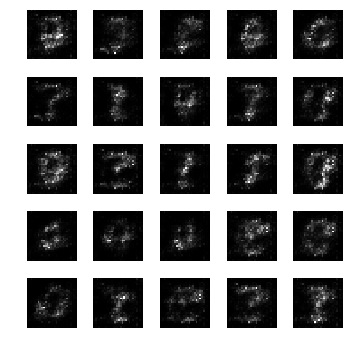

epoch: 2221, time: 4.920669 | train_G_Loss: 0.690754, train_D_loss: 1.389527, train_acc: 0.205455
cv_G_Loss: 0.815504, cv_D_loss: 4.479361, cv_acc: 0.169800

epoch: 2222, time: 4.893146 | train_G_Loss: 0.695637, train_D_loss: 1.387577, train_acc: 0.161818
cv_G_Loss: 0.698581, cv_D_loss: 4.362894, cv_acc: 0.169700

epoch: 2223, time: 4.945232 | train_G_Loss: 0.695780, train_D_loss: 1.379790, train_acc: 0.096364
cv_G_Loss: 0.852865, cv_D_loss: 4.554760, cv_acc: 0.098000

epoch: 2224, time: 4.909329 | train_G_Loss: 0.693007, train_D_loss: 1.383525, train_acc: 0.143636
cv_G_Loss: 0.691817, cv_D_loss: 4.329683, cv_acc: 0.204400

epoch: 2225, time: 4.904879 | train_G_Loss: 0.695557, train_D_loss: 1.386921, train_acc: 0.189091
cv_G_Loss: 0.747301, cv_D_loss: 4.423058, cv_acc: 0.171100

epoch: 2226, time: 4.892591 | train_G_Loss: 0.692526, train_D_loss: 1.385735, train_acc: 0.092727
cv_G_Loss: 0.732065, cv_D_loss: 4.389837, cv_acc: 0.111900

epoch: 2227, time: 4.893533 | train_G_Loss: 0.693562

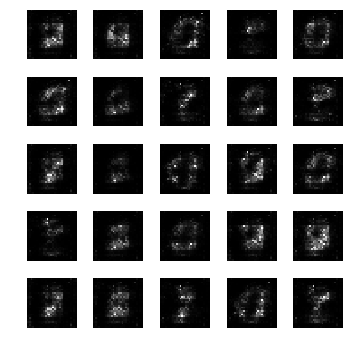

epoch: 2231, time: 4.926921 | train_G_Loss: 0.686003, train_D_loss: 1.398751, train_acc: 0.087273
cv_G_Loss: 0.799140, cv_D_loss: 4.554250, cv_acc: 0.089200

epoch: 2232, time: 4.898003 | train_G_Loss: 0.699909, train_D_loss: 1.372969, train_acc: 0.096364
cv_G_Loss: 0.917659, cv_D_loss: 4.626835, cv_acc: 0.098000

epoch: 2233, time: 4.882773 | train_G_Loss: 0.688031, train_D_loss: 1.392846, train_acc: 0.096364
cv_G_Loss: 0.576384, cv_D_loss: 4.230040, cv_acc: 0.098000

epoch: 2234, time: 4.904739 | train_G_Loss: 0.694320, train_D_loss: 1.386114, train_acc: 0.089091
cv_G_Loss: 0.703708, cv_D_loss: 4.402959, cv_acc: 0.098600

epoch: 2235, time: 4.900082 | train_G_Loss: 0.696930, train_D_loss: 1.386120, train_acc: 0.272727
cv_G_Loss: 0.871501, cv_D_loss: 4.556875, cv_acc: 0.255600

epoch: 2236, time: 4.917397 | train_G_Loss: 0.696039, train_D_loss: 1.383015, train_acc: 0.110909
cv_G_Loss: 0.684819, cv_D_loss: 4.383783, cv_acc: 0.095800

epoch: 2237, time: 4.895632 | train_G_Loss: 0.690936

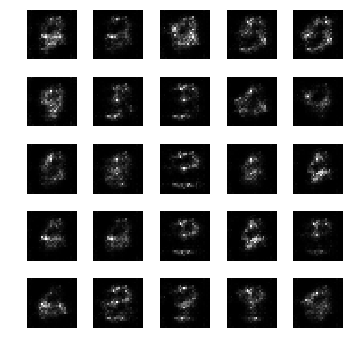

epoch: 2241, time: 4.929639 | train_G_Loss: 0.691058, train_D_loss: 1.388602, train_acc: 0.094545
cv_G_Loss: 0.611926, cv_D_loss: 4.324265, cv_acc: 0.141100

epoch: 2242, time: 4.880726 | train_G_Loss: 0.693154, train_D_loss: 1.385225, train_acc: 0.250909
cv_G_Loss: 0.599923, cv_D_loss: 4.255872, cv_acc: 0.190500

epoch: 2243, time: 4.882507 | train_G_Loss: 0.695559, train_D_loss: 1.386561, train_acc: 0.236364
cv_G_Loss: 0.834684, cv_D_loss: 4.531194, cv_acc: 0.159100

epoch: 2244, time: 4.891009 | train_G_Loss: 0.692439, train_D_loss: 1.387375, train_acc: 0.212727
cv_G_Loss: 0.791992, cv_D_loss: 4.465122, cv_acc: 0.179200

epoch: 2245, time: 4.893173 | train_G_Loss: 0.691323, train_D_loss: 1.388414, train_acc: 0.170909
cv_G_Loss: 0.800233, cv_D_loss: 4.466941, cv_acc: 0.180600

epoch: 2246, time: 4.934352 | train_G_Loss: 0.692358, train_D_loss: 1.386383, train_acc: 0.256364
cv_G_Loss: 0.728040, cv_D_loss: 4.368035, cv_acc: 0.218000

epoch: 2247, time: 4.905255 | train_G_Loss: 0.695687

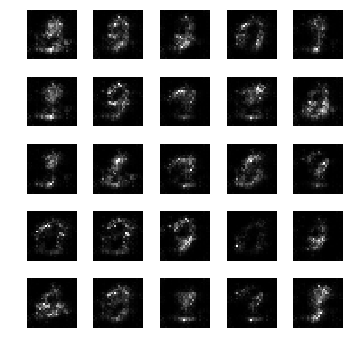

epoch: 2251, time: 4.920899 | train_G_Loss: 0.696177, train_D_loss: 1.383511, train_acc: 0.209091
cv_G_Loss: 0.791438, cv_D_loss: 4.466937, cv_acc: 0.100200

epoch: 2252, time: 4.881753 | train_G_Loss: 0.691320, train_D_loss: 1.390147, train_acc: 0.238182
cv_G_Loss: 0.820668, cv_D_loss: 4.508297, cv_acc: 0.212100

epoch: 2253, time: 4.884973 | train_G_Loss: 0.691829, train_D_loss: 1.388962, train_acc: 0.216364
cv_G_Loss: 0.750932, cv_D_loss: 4.397773, cv_acc: 0.187200

epoch: 2254, time: 4.890596 | train_G_Loss: 0.691366, train_D_loss: 1.388036, train_acc: 0.105455
cv_G_Loss: 0.667516, cv_D_loss: 4.347129, cv_acc: 0.103200

epoch: 2255, time: 4.881413 | train_G_Loss: 0.688837, train_D_loss: 1.388198, train_acc: 0.140000
cv_G_Loss: 0.732031, cv_D_loss: 4.398176, cv_acc: 0.138400

epoch: 2256, time: 4.898947 | train_G_Loss: 0.693958, train_D_loss: 1.387313, train_acc: 0.110909
cv_G_Loss: 0.682364, cv_D_loss: 4.339278, cv_acc: 0.123700

epoch: 2257, time: 4.893903 | train_G_Loss: 0.692719

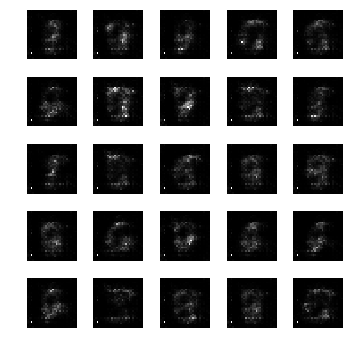

epoch: 2261, time: 4.955661 | train_G_Loss: 0.701778, train_D_loss: 1.376941, train_acc: 0.200000
cv_G_Loss: 0.706802, cv_D_loss: 4.369521, cv_acc: 0.208600

epoch: 2262, time: 4.885539 | train_G_Loss: 0.690739, train_D_loss: 1.384213, train_acc: 0.183636
cv_G_Loss: 0.767862, cv_D_loss: 4.379026, cv_acc: 0.213400

epoch: 2263, time: 4.895053 | train_G_Loss: 0.694800, train_D_loss: 1.383812, train_acc: 0.101818
cv_G_Loss: 0.673143, cv_D_loss: 4.306464, cv_acc: 0.107200

epoch: 2264, time: 4.873194 | train_G_Loss: 0.694799, train_D_loss: 1.380420, train_acc: 0.096364
cv_G_Loss: 0.773773, cv_D_loss: 4.527655, cv_acc: 0.098000

epoch: 2265, time: 4.892674 | train_G_Loss: 0.692841, train_D_loss: 1.385074, train_acc: 0.134545
cv_G_Loss: 0.735612, cv_D_loss: 4.419221, cv_acc: 0.107600

epoch: 2266, time: 4.884941 | train_G_Loss: 0.691172, train_D_loss: 1.384599, train_acc: 0.240000
cv_G_Loss: 0.773741, cv_D_loss: 4.428645, cv_acc: 0.221900

epoch: 2267, time: 4.892162 | train_G_Loss: 0.693626

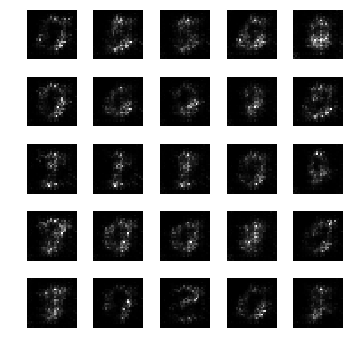

epoch: 2271, time: 4.916824 | train_G_Loss: 0.693099, train_D_loss: 1.382021, train_acc: 0.196364
cv_G_Loss: 0.587340, cv_D_loss: 4.262508, cv_acc: 0.159600

epoch: 2272, time: 4.896500 | train_G_Loss: 0.691975, train_D_loss: 1.393259, train_acc: 0.105455
cv_G_Loss: 0.641602, cv_D_loss: 4.287709, cv_acc: 0.118100

epoch: 2273, time: 4.893399 | train_G_Loss: 0.695970, train_D_loss: 1.383358, train_acc: 0.138182
cv_G_Loss: 0.632815, cv_D_loss: 4.305593, cv_acc: 0.120200

epoch: 2274, time: 4.900239 | train_G_Loss: 0.695830, train_D_loss: 1.380144, train_acc: 0.218182
cv_G_Loss: 0.658584, cv_D_loss: 4.319568, cv_acc: 0.203000

epoch: 2275, time: 4.887483 | train_G_Loss: 0.694646, train_D_loss: 1.386140, train_acc: 0.214545
cv_G_Loss: 0.843792, cv_D_loss: 4.470244, cv_acc: 0.204700

epoch: 2276, time: 4.892623 | train_G_Loss: 0.691176, train_D_loss: 1.385214, train_acc: 0.130909
cv_G_Loss: 0.838229, cv_D_loss: 4.516523, cv_acc: 0.203900

epoch: 2277, time: 4.889841 | train_G_Loss: 0.691871

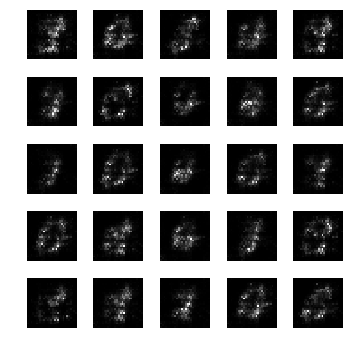

epoch: 2281, time: 4.920518 | train_G_Loss: 0.695229, train_D_loss: 1.382531, train_acc: 0.170909
cv_G_Loss: 0.930449, cv_D_loss: 4.639058, cv_acc: 0.163800

epoch: 2282, time: 4.882289 | train_G_Loss: 0.690931, train_D_loss: 1.391720, train_acc: 0.110909
cv_G_Loss: 0.764424, cv_D_loss: 4.454226, cv_acc: 0.095900

epoch: 2283, time: 4.888769 | train_G_Loss: 0.690141, train_D_loss: 1.395556, train_acc: 0.201818
cv_G_Loss: 0.777233, cv_D_loss: 4.463333, cv_acc: 0.158600

epoch: 2284, time: 4.887865 | train_G_Loss: 0.690797, train_D_loss: 1.390391, train_acc: 0.116364
cv_G_Loss: 0.761668, cv_D_loss: 4.449105, cv_acc: 0.187000

epoch: 2285, time: 4.893520 | train_G_Loss: 0.692458, train_D_loss: 1.388857, train_acc: 0.185455
cv_G_Loss: 0.729770, cv_D_loss: 4.395945, cv_acc: 0.187000

epoch: 2286, time: 4.888698 | train_G_Loss: 0.691946, train_D_loss: 1.389549, train_acc: 0.303636
cv_G_Loss: 0.711452, cv_D_loss: 4.363334, cv_acc: 0.222100

epoch: 2287, time: 4.890671 | train_G_Loss: 0.691291

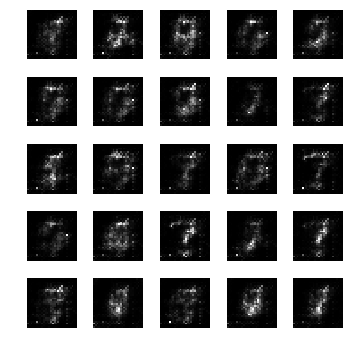

epoch: 2291, time: 4.923792 | train_G_Loss: 0.691532, train_D_loss: 1.386813, train_acc: 0.096364
cv_G_Loss: 0.751184, cv_D_loss: 4.491323, cv_acc: 0.098000

epoch: 2292, time: 4.947775 | train_G_Loss: 0.695424, train_D_loss: 1.381446, train_acc: 0.120000
cv_G_Loss: 0.873753, cv_D_loss: 4.638885, cv_acc: 0.131600

epoch: 2293, time: 4.884297 | train_G_Loss: 0.694313, train_D_loss: 1.386606, train_acc: 0.169091
cv_G_Loss: 0.663655, cv_D_loss: 4.338526, cv_acc: 0.176900

epoch: 2294, time: 4.881845 | train_G_Loss: 0.691662, train_D_loss: 1.384683, train_acc: 0.140000
cv_G_Loss: 0.802849, cv_D_loss: 4.444239, cv_acc: 0.110200

epoch: 2295, time: 4.888011 | train_G_Loss: 0.694668, train_D_loss: 1.384045, train_acc: 0.105455
cv_G_Loss: 0.735268, cv_D_loss: 4.371964, cv_acc: 0.103400

epoch: 2296, time: 4.905825 | train_G_Loss: 0.698433, train_D_loss: 1.379434, train_acc: 0.283636
cv_G_Loss: 0.776377, cv_D_loss: 4.375680, cv_acc: 0.302900

epoch: 2297, time: 4.901759 | train_G_Loss: 0.693067

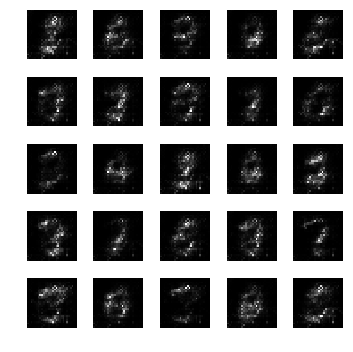

epoch: 2301, time: 4.925978 | train_G_Loss: 0.688275, train_D_loss: 1.383718, train_acc: 0.158182
cv_G_Loss: 0.688861, cv_D_loss: 4.369949, cv_acc: 0.101900

epoch: 2302, time: 4.888187 | train_G_Loss: 0.691734, train_D_loss: 1.389320, train_acc: 0.178182
cv_G_Loss: 0.765458, cv_D_loss: 4.494693, cv_acc: 0.123000

epoch: 2303, time: 4.897146 | train_G_Loss: 0.698152, train_D_loss: 1.390138, train_acc: 0.109091
cv_G_Loss: 0.937452, cv_D_loss: 4.723194, cv_acc: 0.102800

epoch: 2304, time: 4.892943 | train_G_Loss: 0.697744, train_D_loss: 1.382016, train_acc: 0.109091
cv_G_Loss: 0.761905, cv_D_loss: 4.489030, cv_acc: 0.102800

epoch: 2305, time: 4.897984 | train_G_Loss: 0.696093, train_D_loss: 1.388336, train_acc: 0.087273
cv_G_Loss: 0.678286, cv_D_loss: 4.327657, cv_acc: 0.112500

epoch: 2306, time: 4.893986 | train_G_Loss: 0.690371, train_D_loss: 1.388012, train_acc: 0.267273
cv_G_Loss: 0.586238, cv_D_loss: 4.241627, cv_acc: 0.167400

epoch: 2307, time: 4.903264 | train_G_Loss: 0.692694

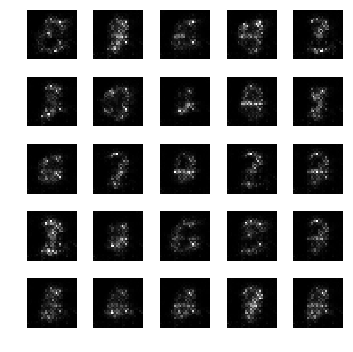

epoch: 2311, time: 4.930773 | train_G_Loss: 0.692281, train_D_loss: 1.386060, train_acc: 0.096364
cv_G_Loss: 0.798049, cv_D_loss: 4.484508, cv_acc: 0.098000

epoch: 2312, time: 4.893417 | train_G_Loss: 0.694992, train_D_loss: 1.382135, train_acc: 0.096364
cv_G_Loss: 0.678523, cv_D_loss: 4.339254, cv_acc: 0.098000

epoch: 2313, time: 4.905314 | train_G_Loss: 0.692931, train_D_loss: 1.384065, train_acc: 0.096364
cv_G_Loss: 0.721540, cv_D_loss: 4.365024, cv_acc: 0.098300

epoch: 2314, time: 4.890904 | train_G_Loss: 0.691080, train_D_loss: 1.387051, train_acc: 0.110909
cv_G_Loss: 0.748493, cv_D_loss: 4.405643, cv_acc: 0.102900

epoch: 2315, time: 4.941993 | train_G_Loss: 0.689966, train_D_loss: 1.388322, train_acc: 0.100000
cv_G_Loss: 0.722933, cv_D_loss: 4.368140, cv_acc: 0.135800

epoch: 2316, time: 4.907953 | train_G_Loss: 0.690619, train_D_loss: 1.391843, train_acc: 0.147273
cv_G_Loss: 0.744209, cv_D_loss: 4.406768, cv_acc: 0.200700

epoch: 2317, time: 4.881581 | train_G_Loss: 0.686147

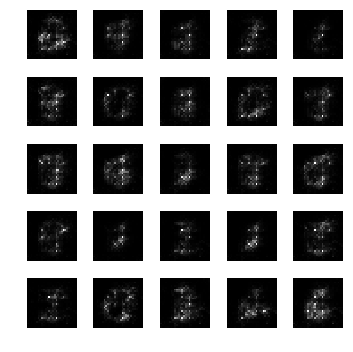

epoch: 2321, time: 4.923265 | train_G_Loss: 0.693650, train_D_loss: 1.383284, train_acc: 0.216364
cv_G_Loss: 0.755740, cv_D_loss: 4.420246, cv_acc: 0.185500

epoch: 2322, time: 4.893186 | train_G_Loss: 0.695525, train_D_loss: 1.374860, train_acc: 0.087273
cv_G_Loss: 0.676179, cv_D_loss: 4.328667, cv_acc: 0.089100

epoch: 2323, time: 4.893983 | train_G_Loss: 0.693544, train_D_loss: 1.385609, train_acc: 0.089091
cv_G_Loss: 0.713317, cv_D_loss: 4.409715, cv_acc: 0.172100

epoch: 2324, time: 4.892684 | train_G_Loss: 0.691791, train_D_loss: 1.386587, train_acc: 0.136364
cv_G_Loss: 0.686111, cv_D_loss: 4.324073, cv_acc: 0.144800

epoch: 2325, time: 4.897733 | train_G_Loss: 0.694010, train_D_loss: 1.388417, train_acc: 0.109091
cv_G_Loss: 0.756328, cv_D_loss: 4.429609, cv_acc: 0.102800

epoch: 2326, time: 4.893592 | train_G_Loss: 0.694786, train_D_loss: 1.382924, train_acc: 0.123636
cv_G_Loss: 0.755077, cv_D_loss: 4.464503, cv_acc: 0.113100

epoch: 2327, time: 4.899004 | train_G_Loss: 0.695115

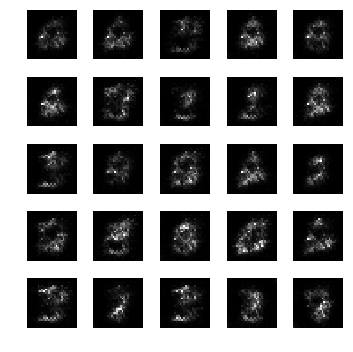

epoch: 2331, time: 4.932020 | train_G_Loss: 0.691021, train_D_loss: 1.394357, train_acc: 0.100000
cv_G_Loss: 0.872272, cv_D_loss: 4.578195, cv_acc: 0.115000

epoch: 2332, time: 4.893171 | train_G_Loss: 0.691796, train_D_loss: 1.389161, train_acc: 0.154545
cv_G_Loss: 0.730882, cv_D_loss: 4.398768, cv_acc: 0.156000

epoch: 2333, time: 4.899258 | train_G_Loss: 0.696865, train_D_loss: 1.380283, train_acc: 0.158182
cv_G_Loss: 0.797468, cv_D_loss: 4.464940, cv_acc: 0.102300

epoch: 2334, time: 4.890079 | train_G_Loss: 0.696016, train_D_loss: 1.383133, train_acc: 0.163636
cv_G_Loss: 0.782529, cv_D_loss: 4.460402, cv_acc: 0.161600

epoch: 2335, time: 4.878872 | train_G_Loss: 0.695109, train_D_loss: 1.386512, train_acc: 0.143636
cv_G_Loss: 0.704316, cv_D_loss: 4.378756, cv_acc: 0.141400

epoch: 2336, time: 4.896016 | train_G_Loss: 0.694801, train_D_loss: 1.388281, train_acc: 0.165455
cv_G_Loss: 0.680194, cv_D_loss: 4.310107, cv_acc: 0.192000

epoch: 2337, time: 4.889057 | train_G_Loss: 0.692631

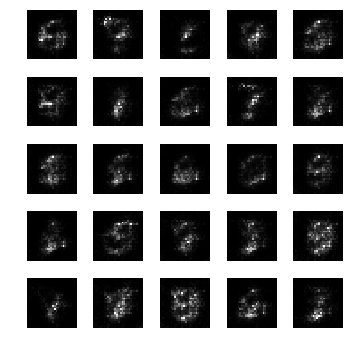

epoch: 2341, time: 4.919139 | train_G_Loss: 0.695368, train_D_loss: 1.383648, train_acc: 0.230909
cv_G_Loss: 0.642556, cv_D_loss: 4.286681, cv_acc: 0.166500

epoch: 2342, time: 4.897588 | train_G_Loss: 0.694105, train_D_loss: 1.379717, train_acc: 0.109091
cv_G_Loss: 0.652652, cv_D_loss: 4.331682, cv_acc: 0.169600

epoch: 2343, time: 4.894324 | train_G_Loss: 0.693356, train_D_loss: 1.380723, train_acc: 0.096364
cv_G_Loss: 0.730291, cv_D_loss: 4.435256, cv_acc: 0.098000

epoch: 2344, time: 4.900035 | train_G_Loss: 0.692500, train_D_loss: 1.385705, train_acc: 0.098182
cv_G_Loss: 0.722259, cv_D_loss: 4.393406, cv_acc: 0.098900

epoch: 2345, time: 4.902071 | train_G_Loss: 0.692694, train_D_loss: 1.388081, train_acc: 0.161818
cv_G_Loss: 0.775296, cv_D_loss: 4.458970, cv_acc: 0.171900

epoch: 2346, time: 4.886848 | train_G_Loss: 0.690530, train_D_loss: 1.390719, train_acc: 0.167273
cv_G_Loss: 0.797728, cv_D_loss: 4.523885, cv_acc: 0.186400

epoch: 2347, time: 4.900698 | train_G_Loss: 0.692757

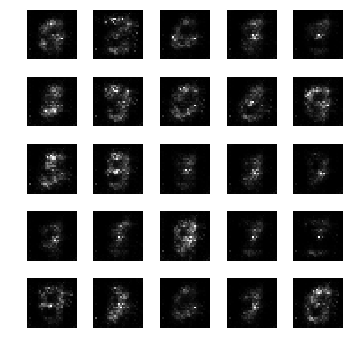

epoch: 2351, time: 4.923190 | train_G_Loss: 0.695282, train_D_loss: 1.383813, train_acc: 0.107273
cv_G_Loss: 0.695038, cv_D_loss: 4.327029, cv_acc: 0.239200

epoch: 2352, time: 4.888562 | train_G_Loss: 0.695919, train_D_loss: 1.385160, train_acc: 0.147273
cv_G_Loss: 0.728632, cv_D_loss: 4.369606, cv_acc: 0.135000

epoch: 2353, time: 4.885767 | train_G_Loss: 0.692842, train_D_loss: 1.383871, train_acc: 0.096364
cv_G_Loss: 0.707043, cv_D_loss: 4.382291, cv_acc: 0.105500

epoch: 2354, time: 4.900101 | train_G_Loss: 0.694667, train_D_loss: 1.382820, train_acc: 0.096364
cv_G_Loss: 0.628350, cv_D_loss: 4.344167, cv_acc: 0.101000

epoch: 2355, time: 4.901422 | train_G_Loss: 0.689859, train_D_loss: 1.387792, train_acc: 0.120000
cv_G_Loss: 0.678905, cv_D_loss: 4.353944, cv_acc: 0.117100

epoch: 2356, time: 4.899420 | train_G_Loss: 0.689931, train_D_loss: 1.384909, train_acc: 0.096364
cv_G_Loss: 0.733755, cv_D_loss: 4.387169, cv_acc: 0.101000

epoch: 2357, time: 4.902723 | train_G_Loss: 0.693249

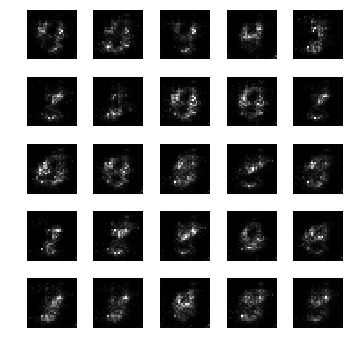

epoch: 2361, time: 4.966479 | train_G_Loss: 0.699040, train_D_loss: 1.374751, train_acc: 0.152727
cv_G_Loss: 0.684452, cv_D_loss: 4.310623, cv_acc: 0.103300

epoch: 2362, time: 4.902098 | train_G_Loss: 0.697113, train_D_loss: 1.378350, train_acc: 0.105455
cv_G_Loss: 0.827841, cv_D_loss: 4.491843, cv_acc: 0.101300

epoch: 2363, time: 4.905527 | train_G_Loss: 0.693538, train_D_loss: 1.384019, train_acc: 0.107273
cv_G_Loss: 0.617764, cv_D_loss: 4.237308, cv_acc: 0.102600

epoch: 2364, time: 4.890104 | train_G_Loss: 0.693399, train_D_loss: 1.386017, train_acc: 0.163636
cv_G_Loss: 0.836438, cv_D_loss: 4.505002, cv_acc: 0.154900

epoch: 2365, time: 4.905135 | train_G_Loss: 0.693559, train_D_loss: 1.387386, train_acc: 0.187273
cv_G_Loss: 0.673810, cv_D_loss: 4.324528, cv_acc: 0.163600

epoch: 2366, time: 4.889058 | train_G_Loss: 0.691702, train_D_loss: 1.383755, train_acc: 0.185455
cv_G_Loss: 0.732056, cv_D_loss: 4.421149, cv_acc: 0.212700

epoch: 2367, time: 4.884948 | train_G_Loss: 0.694312

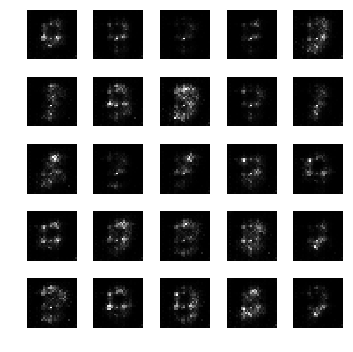

epoch: 2371, time: 4.933389 | train_G_Loss: 0.703444, train_D_loss: 1.369474, train_acc: 0.200000
cv_G_Loss: 0.789793, cv_D_loss: 4.461435, cv_acc: 0.176500

epoch: 2372, time: 4.908864 | train_G_Loss: 0.696771, train_D_loss: 1.374291, train_acc: 0.087273
cv_G_Loss: 0.683555, cv_D_loss: 4.401096, cv_acc: 0.095900

epoch: 2373, time: 4.890488 | train_G_Loss: 0.693117, train_D_loss: 1.389425, train_acc: 0.083636
cv_G_Loss: 0.684589, cv_D_loss: 4.379135, cv_acc: 0.089100

epoch: 2374, time: 4.900112 | train_G_Loss: 0.695836, train_D_loss: 1.382320, train_acc: 0.176364
cv_G_Loss: 0.609205, cv_D_loss: 4.260190, cv_acc: 0.110700

epoch: 2375, time: 4.888208 | train_G_Loss: 0.694579, train_D_loss: 1.384760, train_acc: 0.238182
cv_G_Loss: 0.645169, cv_D_loss: 4.279029, cv_acc: 0.201900

epoch: 2376, time: 4.903623 | train_G_Loss: 0.692411, train_D_loss: 1.382092, train_acc: 0.187273
cv_G_Loss: 0.632098, cv_D_loss: 4.267733, cv_acc: 0.172900

epoch: 2377, time: 4.891861 | train_G_Loss: 0.696599

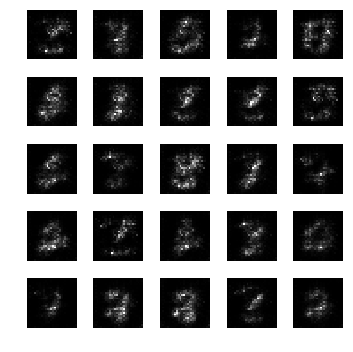

epoch: 2381, time: 4.926929 | train_G_Loss: 0.693780, train_D_loss: 1.380848, train_acc: 0.125455
cv_G_Loss: 0.743825, cv_D_loss: 4.396640, cv_acc: 0.102400

epoch: 2382, time: 4.879309 | train_G_Loss: 0.695929, train_D_loss: 1.382353, train_acc: 0.123636
cv_G_Loss: 0.634537, cv_D_loss: 4.317669, cv_acc: 0.091600

epoch: 2383, time: 4.898432 | train_G_Loss: 0.690802, train_D_loss: 1.389118, train_acc: 0.096364
cv_G_Loss: 0.660694, cv_D_loss: 4.350333, cv_acc: 0.092000

epoch: 2384, time: 4.941088 | train_G_Loss: 0.692430, train_D_loss: 1.386600, train_acc: 0.109091
cv_G_Loss: 0.810596, cv_D_loss: 4.511841, cv_acc: 0.113700

epoch: 2385, time: 4.910680 | train_G_Loss: 0.690266, train_D_loss: 1.390141, train_acc: 0.180000
cv_G_Loss: 0.580407, cv_D_loss: 4.250532, cv_acc: 0.184300

epoch: 2386, time: 4.900155 | train_G_Loss: 0.694182, train_D_loss: 1.383383, train_acc: 0.189091
cv_G_Loss: 0.669963, cv_D_loss: 4.310314, cv_acc: 0.161900

epoch: 2387, time: 4.897892 | train_G_Loss: 0.693443

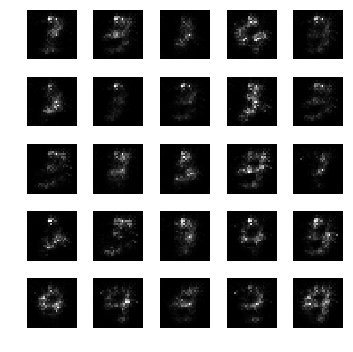

epoch: 2391, time: 4.929365 | train_G_Loss: 0.695541, train_D_loss: 1.388433, train_acc: 0.200000
cv_G_Loss: 0.607425, cv_D_loss: 4.267605, cv_acc: 0.140000

epoch: 2392, time: 4.908887 | train_G_Loss: 0.695609, train_D_loss: 1.386235, train_acc: 0.116364
cv_G_Loss: 0.660026, cv_D_loss: 4.337605, cv_acc: 0.177700

epoch: 2393, time: 4.897817 | train_G_Loss: 0.689984, train_D_loss: 1.391209, train_acc: 0.258182
cv_G_Loss: 0.797087, cv_D_loss: 4.461126, cv_acc: 0.182800

epoch: 2394, time: 4.901845 | train_G_Loss: 0.693481, train_D_loss: 1.388257, train_acc: 0.174545
cv_G_Loss: 0.735338, cv_D_loss: 4.382661, cv_acc: 0.156400

epoch: 2395, time: 4.894886 | train_G_Loss: 0.691936, train_D_loss: 1.387268, train_acc: 0.134545
cv_G_Loss: 0.724748, cv_D_loss: 4.375084, cv_acc: 0.103100

epoch: 2396, time: 4.898273 | train_G_Loss: 0.691420, train_D_loss: 1.391286, train_acc: 0.110909
cv_G_Loss: 0.726865, cv_D_loss: 4.412055, cv_acc: 0.103100

epoch: 2397, time: 4.878857 | train_G_Loss: 0.691275

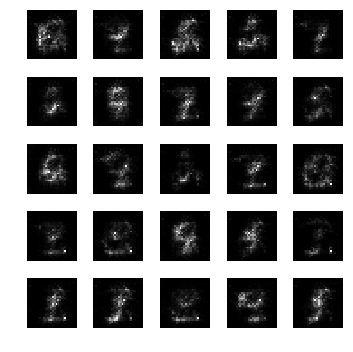

epoch: 2401, time: 4.912931 | train_G_Loss: 0.693154, train_D_loss: 1.383697, train_acc: 0.121818
cv_G_Loss: 0.628641, cv_D_loss: 4.289028, cv_acc: 0.106500

epoch: 2402, time: 4.897026 | train_G_Loss: 0.695618, train_D_loss: 1.386386, train_acc: 0.143636
cv_G_Loss: 0.727486, cv_D_loss: 4.404727, cv_acc: 0.121800

epoch: 2403, time: 4.895353 | train_G_Loss: 0.692415, train_D_loss: 1.386340, train_acc: 0.112727
cv_G_Loss: 0.619933, cv_D_loss: 4.276471, cv_acc: 0.100200

epoch: 2404, time: 4.903234 | train_G_Loss: 0.693382, train_D_loss: 1.386023, train_acc: 0.207273
cv_G_Loss: 0.704755, cv_D_loss: 4.350573, cv_acc: 0.095600

epoch: 2405, time: 4.897284 | train_G_Loss: 0.696276, train_D_loss: 1.384792, train_acc: 0.150909
cv_G_Loss: 0.632908, cv_D_loss: 4.256569, cv_acc: 0.146400

epoch: 2406, time: 4.903652 | train_G_Loss: 0.698397, train_D_loss: 1.380134, train_acc: 0.120000
cv_G_Loss: 0.673578, cv_D_loss: 4.301893, cv_acc: 0.187600

epoch: 2407, time: 4.941793 | train_G_Loss: 0.693418

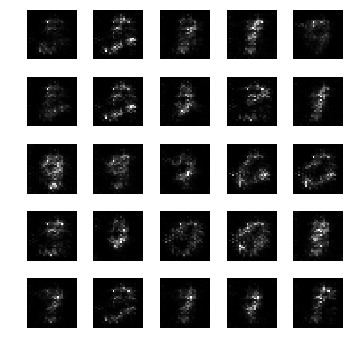

epoch: 2411, time: 4.916400 | train_G_Loss: 0.693754, train_D_loss: 1.388206, train_acc: 0.132727
cv_G_Loss: 0.611199, cv_D_loss: 4.282344, cv_acc: 0.150200

epoch: 2412, time: 4.893901 | train_G_Loss: 0.693281, train_D_loss: 1.389951, train_acc: 0.132727
cv_G_Loss: 0.794169, cv_D_loss: 4.478706, cv_acc: 0.100700

epoch: 2413, time: 4.897415 | train_G_Loss: 0.690990, train_D_loss: 1.384946, train_acc: 0.212727
cv_G_Loss: 0.703140, cv_D_loss: 4.376453, cv_acc: 0.123700

epoch: 2414, time: 4.881183 | train_G_Loss: 0.694542, train_D_loss: 1.388323, train_acc: 0.170909
cv_G_Loss: 0.718959, cv_D_loss: 4.378651, cv_acc: 0.182600

epoch: 2415, time: 4.891051 | train_G_Loss: 0.696963, train_D_loss: 1.386017, train_acc: 0.203636
cv_G_Loss: 0.690791, cv_D_loss: 4.328187, cv_acc: 0.174900

epoch: 2416, time: 4.887360 | train_G_Loss: 0.693915, train_D_loss: 1.380979, train_acc: 0.154545
cv_G_Loss: 1.022465, cv_D_loss: 4.802095, cv_acc: 0.180200

epoch: 2417, time: 4.907979 | train_G_Loss: 0.693252

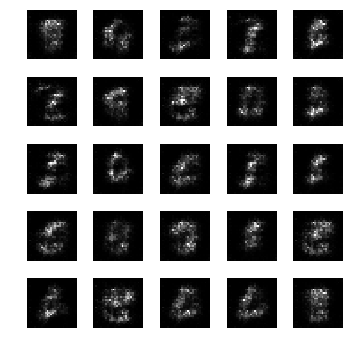

epoch: 2421, time: 4.923095 | train_G_Loss: 0.692016, train_D_loss: 1.392426, train_acc: 0.105455
cv_G_Loss: 0.673304, cv_D_loss: 4.373668, cv_acc: 0.109600

epoch: 2422, time: 4.889815 | train_G_Loss: 0.695541, train_D_loss: 1.380461, train_acc: 0.112727
cv_G_Loss: 0.622102, cv_D_loss: 4.291365, cv_acc: 0.112700

epoch: 2423, time: 4.888667 | train_G_Loss: 0.689601, train_D_loss: 1.391147, train_acc: 0.105455
cv_G_Loss: 0.682997, cv_D_loss: 4.334634, cv_acc: 0.103200

epoch: 2424, time: 4.895288 | train_G_Loss: 0.692903, train_D_loss: 1.388734, train_acc: 0.089091
cv_G_Loss: 0.780919, cv_D_loss: 4.508725, cv_acc: 0.097400

epoch: 2425, time: 4.890547 | train_G_Loss: 0.693436, train_D_loss: 1.386988, train_acc: 0.121818
cv_G_Loss: 0.891797, cv_D_loss: 4.605419, cv_acc: 0.140600

epoch: 2426, time: 4.892993 | train_G_Loss: 0.693233, train_D_loss: 1.388707, train_acc: 0.243636
cv_G_Loss: 0.729398, cv_D_loss: 4.360282, cv_acc: 0.246900

epoch: 2427, time: 4.894886 | train_G_Loss: 0.692895

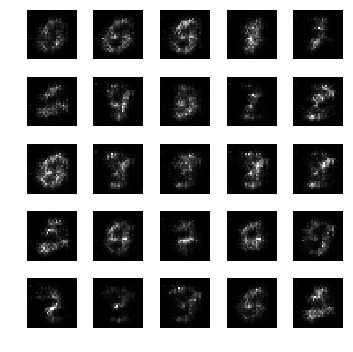

epoch: 2431, time: 4.914892 | train_G_Loss: 0.692150, train_D_loss: 1.389609, train_acc: 0.185455
cv_G_Loss: 0.852914, cv_D_loss: 4.518493, cv_acc: 0.237800

epoch: 2432, time: 4.895327 | train_G_Loss: 0.691582, train_D_loss: 1.391378, train_acc: 0.214545
cv_G_Loss: 0.699439, cv_D_loss: 4.333533, cv_acc: 0.238500

epoch: 2433, time: 4.916167 | train_G_Loss: 0.691485, train_D_loss: 1.387875, train_acc: 0.161818
cv_G_Loss: 0.758682, cv_D_loss: 4.415585, cv_acc: 0.111900

epoch: 2434, time: 4.899340 | train_G_Loss: 0.693215, train_D_loss: 1.386972, train_acc: 0.283636
cv_G_Loss: 0.676121, cv_D_loss: 4.328362, cv_acc: 0.310300
Model saved

epoch: 2435, time: 4.926325 | train_G_Loss: 0.693312, train_D_loss: 1.382728, train_acc: 0.121818
cv_G_Loss: 0.771451, cv_D_loss: 4.420061, cv_acc: 0.205100

epoch: 2436, time: 4.895994 | train_G_Loss: 0.692598, train_D_loss: 1.385979, train_acc: 0.238182
cv_G_Loss: 0.647347, cv_D_loss: 4.301219, cv_acc: 0.151600

epoch: 2437, time: 4.893831 | train_G_Lo

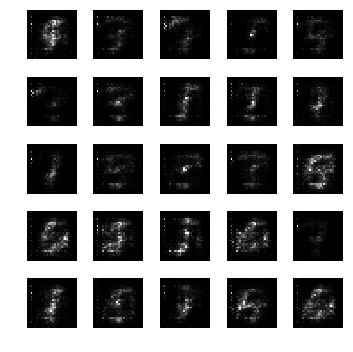

epoch: 2441, time: 4.934578 | train_G_Loss: 0.692061, train_D_loss: 1.379747, train_acc: 0.130909
cv_G_Loss: 0.708211, cv_D_loss: 4.370214, cv_acc: 0.147500

epoch: 2442, time: 4.886496 | train_G_Loss: 0.691750, train_D_loss: 1.390733, train_acc: 0.118182
cv_G_Loss: 0.849003, cv_D_loss: 4.589005, cv_acc: 0.120500

epoch: 2443, time: 4.886196 | train_G_Loss: 0.691679, train_D_loss: 1.386719, train_acc: 0.121818
cv_G_Loss: 0.845454, cv_D_loss: 4.561152, cv_acc: 0.101700

epoch: 2444, time: 4.892559 | train_G_Loss: 0.694897, train_D_loss: 1.385252, train_acc: 0.110909
cv_G_Loss: 0.686027, cv_D_loss: 4.325746, cv_acc: 0.142000

epoch: 2445, time: 4.893539 | train_G_Loss: 0.689203, train_D_loss: 1.391133, train_acc: 0.194545
cv_G_Loss: 0.624553, cv_D_loss: 4.267251, cv_acc: 0.139500

epoch: 2446, time: 4.887426 | train_G_Loss: 0.694376, train_D_loss: 1.385309, train_acc: 0.132727
cv_G_Loss: 0.789274, cv_D_loss: 4.512353, cv_acc: 0.112900

epoch: 2447, time: 4.893748 | train_G_Loss: 0.692564

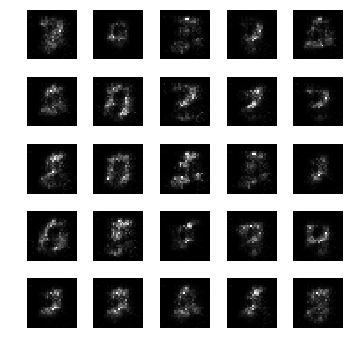

epoch: 2451, time: 4.928445 | train_G_Loss: 0.691600, train_D_loss: 1.387558, train_acc: 0.187273
cv_G_Loss: 0.645536, cv_D_loss: 4.326703, cv_acc: 0.183400

epoch: 2452, time: 4.919888 | train_G_Loss: 0.693255, train_D_loss: 1.386872, train_acc: 0.100000
cv_G_Loss: 0.638831, cv_D_loss: 4.310908, cv_acc: 0.100900

epoch: 2453, time: 4.927438 | train_G_Loss: 0.691909, train_D_loss: 1.389494, train_acc: 0.187273
cv_G_Loss: 0.631305, cv_D_loss: 4.299061, cv_acc: 0.138200

epoch: 2454, time: 4.880827 | train_G_Loss: 0.692162, train_D_loss: 1.388312, train_acc: 0.165455
cv_G_Loss: 0.965002, cv_D_loss: 4.706955, cv_acc: 0.122000

epoch: 2455, time: 4.893890 | train_G_Loss: 0.695887, train_D_loss: 1.378152, train_acc: 0.140000
cv_G_Loss: 0.608618, cv_D_loss: 4.239192, cv_acc: 0.210000

epoch: 2456, time: 4.895268 | train_G_Loss: 0.695857, train_D_loss: 1.383524, train_acc: 0.130909
cv_G_Loss: 0.999965, cv_D_loss: 4.744691, cv_acc: 0.128200

epoch: 2457, time: 4.893825 | train_G_Loss: 0.692167

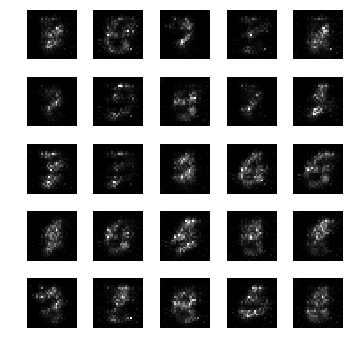

epoch: 2461, time: 4.922681 | train_G_Loss: 0.693661, train_D_loss: 1.394396, train_acc: 0.134545
cv_G_Loss: 0.675833, cv_D_loss: 4.358323, cv_acc: 0.098800

epoch: 2462, time: 4.890810 | train_G_Loss: 0.695000, train_D_loss: 1.383902, train_acc: 0.147273
cv_G_Loss: 0.738992, cv_D_loss: 4.421319, cv_acc: 0.139600

epoch: 2463, time: 4.884616 | train_G_Loss: 0.693563, train_D_loss: 1.386625, train_acc: 0.178182
cv_G_Loss: 0.676245, cv_D_loss: 4.342061, cv_acc: 0.179300

epoch: 2464, time: 4.899741 | train_G_Loss: 0.696142, train_D_loss: 1.379225, train_acc: 0.178182
cv_G_Loss: 0.726879, cv_D_loss: 4.374939, cv_acc: 0.124700

epoch: 2465, time: 4.899721 | train_G_Loss: 0.693378, train_D_loss: 1.384336, train_acc: 0.205455
cv_G_Loss: 0.773882, cv_D_loss: 4.402390, cv_acc: 0.171600

epoch: 2466, time: 4.897418 | train_G_Loss: 0.696149, train_D_loss: 1.391539, train_acc: 0.110909
cv_G_Loss: 0.940835, cv_D_loss: 4.645961, cv_acc: 0.097800

epoch: 2467, time: 4.893173 | train_G_Loss: 0.691267

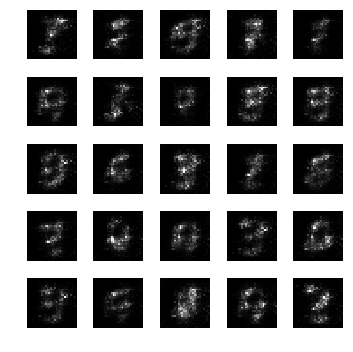

epoch: 2471, time: 4.952254 | train_G_Loss: 0.693109, train_D_loss: 1.390062, train_acc: 0.214545
cv_G_Loss: 0.762779, cv_D_loss: 4.445244, cv_acc: 0.190600

epoch: 2472, time: 4.891444 | train_G_Loss: 0.694477, train_D_loss: 1.387195, train_acc: 0.290909
cv_G_Loss: 0.800727, cv_D_loss: 4.468687, cv_acc: 0.218600

epoch: 2473, time: 4.900166 | train_G_Loss: 0.694829, train_D_loss: 1.385192, train_acc: 0.129091
cv_G_Loss: 0.801083, cv_D_loss: 4.454835, cv_acc: 0.122400

epoch: 2474, time: 4.891324 | train_G_Loss: 0.689232, train_D_loss: 1.395201, train_acc: 0.165455
cv_G_Loss: 0.702115, cv_D_loss: 4.359391, cv_acc: 0.094200

epoch: 2475, time: 4.946605 | train_G_Loss: 0.696059, train_D_loss: 1.380586, train_acc: 0.256364
cv_G_Loss: 0.891577, cv_D_loss: 4.556356, cv_acc: 0.275000

epoch: 2476, time: 4.891307 | train_G_Loss: 0.697308, train_D_loss: 1.382584, train_acc: 0.330909
cv_G_Loss: 0.650868, cv_D_loss: 4.264549, cv_acc: 0.314500

epoch: 2477, time: 4.896674 | train_G_Loss: 0.691160

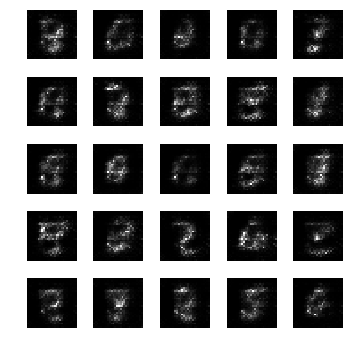

epoch: 2481, time: 4.912232 | train_G_Loss: 0.697669, train_D_loss: 1.379122, train_acc: 0.109091
cv_G_Loss: 0.715065, cv_D_loss: 4.367105, cv_acc: 0.120500

epoch: 2482, time: 4.891639 | train_G_Loss: 0.697826, train_D_loss: 1.381281, train_acc: 0.123636
cv_G_Loss: 0.669474, cv_D_loss: 4.307366, cv_acc: 0.147400

epoch: 2483, time: 4.903063 | train_G_Loss: 0.693763, train_D_loss: 1.389020, train_acc: 0.185455
cv_G_Loss: 0.838201, cv_D_loss: 4.564342, cv_acc: 0.149800

epoch: 2484, time: 4.881684 | train_G_Loss: 0.692269, train_D_loss: 1.385054, train_acc: 0.141818
cv_G_Loss: 0.657139, cv_D_loss: 4.295099, cv_acc: 0.136400

epoch: 2485, time: 4.905163 | train_G_Loss: 0.693455, train_D_loss: 1.384474, train_acc: 0.201818
cv_G_Loss: 0.686430, cv_D_loss: 4.335921, cv_acc: 0.206900

epoch: 2486, time: 4.896778 | train_G_Loss: 0.695217, train_D_loss: 1.382571, train_acc: 0.161818
cv_G_Loss: 0.729577, cv_D_loss: 4.365079, cv_acc: 0.142500

epoch: 2487, time: 4.892141 | train_G_Loss: 0.696178

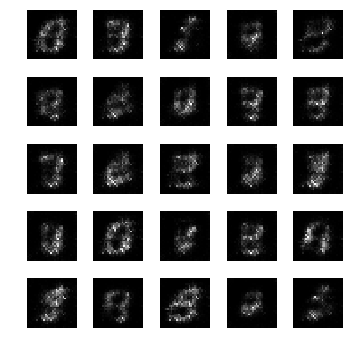

epoch: 2491, time: 4.919902 | train_G_Loss: 0.693459, train_D_loss: 1.389338, train_acc: 0.267273
cv_G_Loss: 0.786341, cv_D_loss: 4.436347, cv_acc: 0.270900

epoch: 2492, time: 4.903016 | train_G_Loss: 0.688226, train_D_loss: 1.398340, train_acc: 0.127273
cv_G_Loss: 0.654471, cv_D_loss: 4.287717, cv_acc: 0.108000

epoch: 2493, time: 4.910374 | train_G_Loss: 0.691287, train_D_loss: 1.389925, train_acc: 0.156364
cv_G_Loss: 0.636130, cv_D_loss: 4.304456, cv_acc: 0.176100

epoch: 2494, time: 4.876201 | train_G_Loss: 0.692141, train_D_loss: 1.387337, train_acc: 0.143636
cv_G_Loss: 0.708901, cv_D_loss: 4.336117, cv_acc: 0.150700

epoch: 2495, time: 4.899011 | train_G_Loss: 0.695390, train_D_loss: 1.383506, train_acc: 0.114545
cv_G_Loss: 0.774824, cv_D_loss: 4.400676, cv_acc: 0.087700

epoch: 2496, time: 4.886059 | train_G_Loss: 0.696017, train_D_loss: 1.378930, train_acc: 0.174545
cv_G_Loss: 0.807425, cv_D_loss: 4.446486, cv_acc: 0.150000

epoch: 2497, time: 4.901430 | train_G_Loss: 0.694979

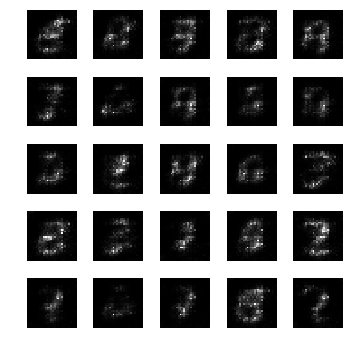

Best accuracy for 0.100% labeled data: 0.707
Best accuracy for 10.000% labeled data: 0.938
Best accuracy for 0.182% labeled data: 0.335


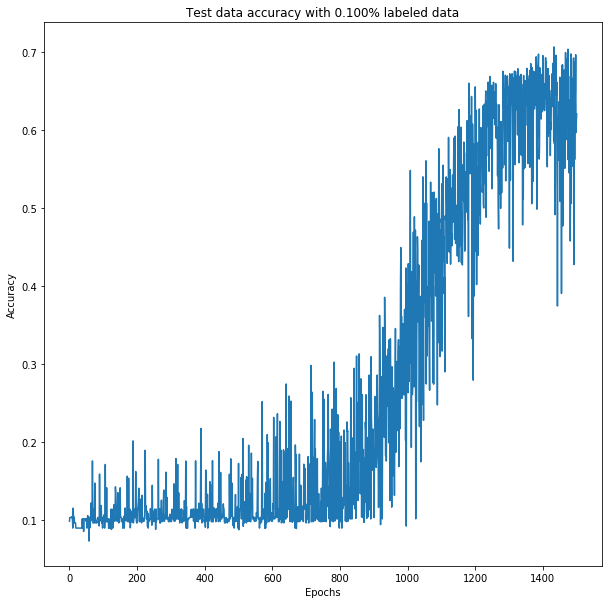

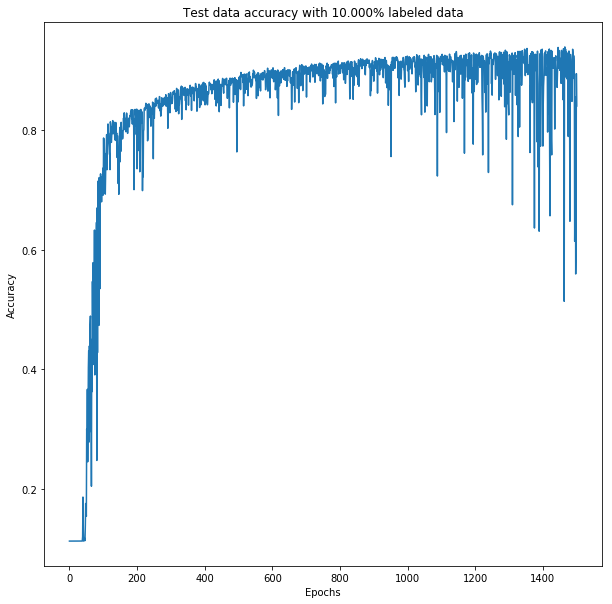

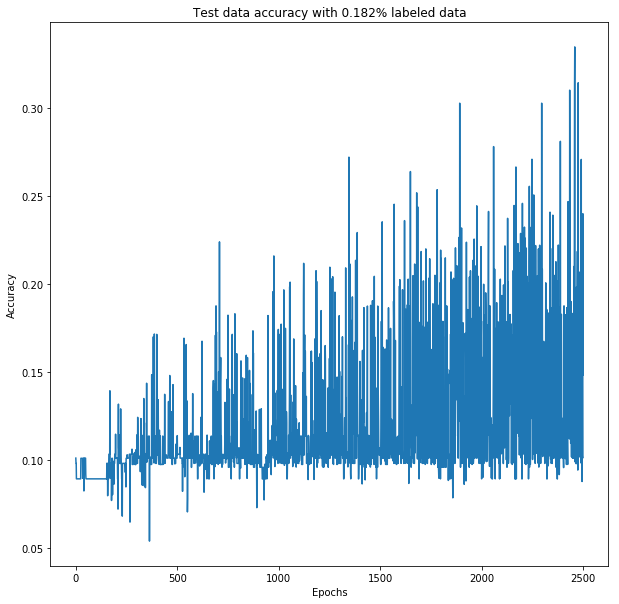

In [95]:
fractions = [0.001, 0.1]
special_indexes = []
losses = []
for fraction in fractions:
    labeled_rate = fraction
    loss_acc = train_SSL_GAN(512, 1501)
    losses.append(loss_acc)

special_indexes = [0,1,2,3,4,5,7,8,13,27]
labeled_rate = 10/55000
fractions.append(labeled_rate)
special_loss = train_SSL_GAN(550, 2501)
losses.append(special_loss)

for i, loss in enumerate(losses):
    plt.figure(figsize=(10,10))
    plt.plot(loss[5])
    plt.title("Test data accuracy with %.3f%% labeled data" % (fractions[i]*100))
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.savefig("Plot_%.2f.png" % fractions[i])
    
for i, loss in enumerate(losses):
    print("Best accuracy for %.3f%% labeled data: %.3f" % (fractions[i]*100, np.max(loss[-1])))

In [22]:
for i, loss in enumerate(losses):
    print("Best accuracy for %d%% labeled data: %.3f" % (int(fractions[i]*100), np.max(loss[-1])))

Best accuracy for 1% labeled data: 0.914
Best accuracy for 5% labeled data: 0.936
Best accuracy for 20% labeled data: 0.947


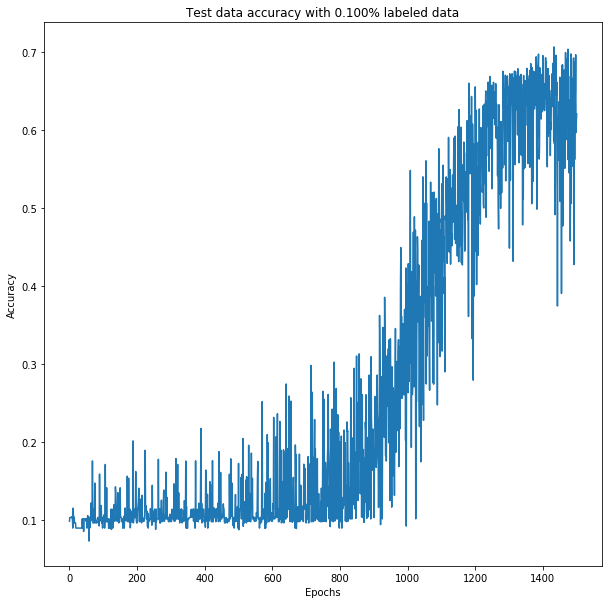

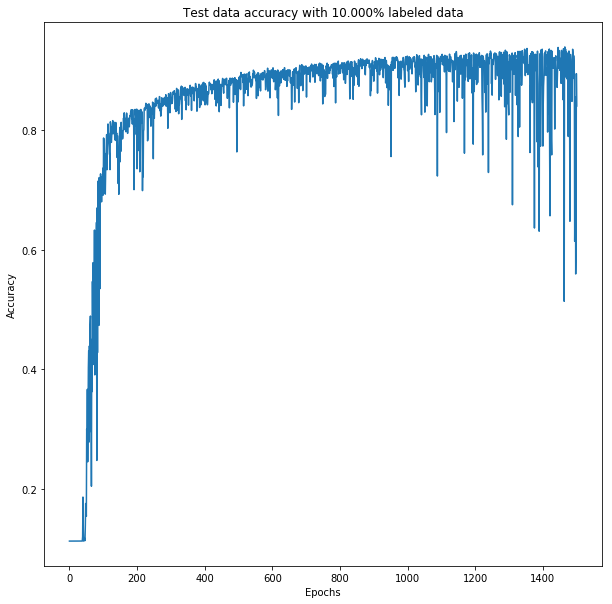

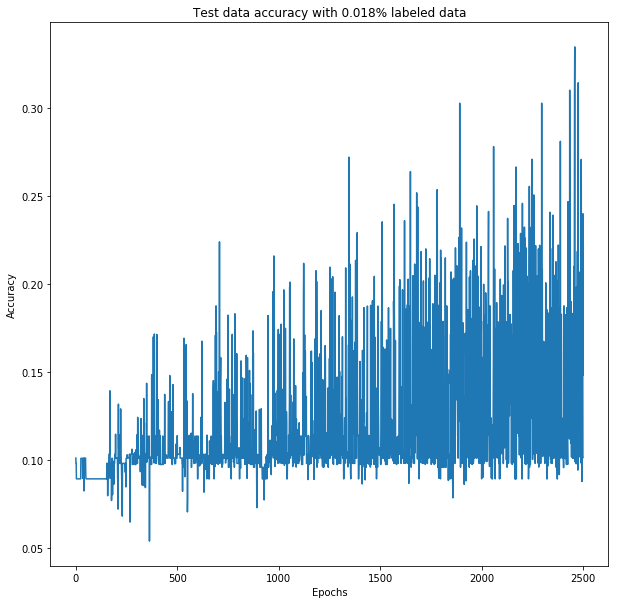

In [101]:
for i, loss in enumerate(losses):
    plt.figure(figsize=(10,10))
    plt.plot(loss[5])
    plt.title("Test data accuracy with %.3f%% labeled data" % (fractions[i]*100))
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.savefig("Plot_%.3f.png" % fractions[i])

In [27]:
print(losses)

[([4.772695, 4.072649, 3.5055995, 3.2447388, 2.9376569, 2.9917727, 2.7202425, 2.5598397, 2.5745077, 2.5863433, 2.463457, 2.4590085, 2.6082296, 2.397247, 2.5386682, 2.303018, 2.3779917, 2.4324892, 2.4716146, 2.4168315, 2.493832, 2.3200178, 2.2956817, 2.38439, 2.365979, 2.4248548, 2.357767, 2.2647998, 2.3866615, 2.4366043, 2.5493534, 2.40828, 2.3953876, 2.4756513, 2.5572784, 2.6495926, 2.6631212, 2.6657019, 2.8075361, 2.844002, 2.906787, 2.8697739, 2.9892023, 3.016481, 3.076643, 3.1803648, 3.332755, 3.4461174, 3.3747969, 3.485568, 3.534264, 3.4621546, 3.5344534, 3.7061007, 3.719521, 3.7029846, 3.760892, 3.7863412, 3.7663693, 3.7682822, 3.7151396, 3.7691255, 3.970217, 3.8908863, 4.092052, 3.9343443, 3.916492, 4.1729765, 3.8703554, 3.9231396, 3.9846563, 3.9650774, 3.8375535, 3.943161, 4.030421, 3.8427176, 3.8519018, 4.0366173, 3.9855154, 4.0618563, 4.108312, 4.048328, 4.1471148, 3.8725631, 4.135356, 4.0067077, 4.14219, 4.1728644, 4.1001415, 4.2593412, 4.019867, 4.088571, 4.090353, 4.106011